# 02/12/2020 Lab 01: Logistic regression and automatic differentiation with jax

Today in this lab session we will make a simple binary classifier. All the theoretical background on Logistic Regression used here can be found in lecture notes.

## Data

Logistic regerssion assumes modeling of binary variable dependent on the input. This can be any real-life binary classification task e.g. spam detection, rain predictor, medical testing etc.

Today we are going to create syntactic data on our own using sklearn utilities.
For data generation purpose we use make_blobs:

In [1]:
from sklearn.datasets.samples_generator import make_blobs

In [2]:
# If running on Google Colab you'll need ipympl
!pip install pandas

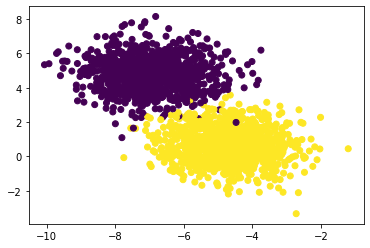

In [3]:
# Follow these instructions to set up matplotlib widget for Jupyter Lab
# https://github.com/matplotlib/jupyter-matplotlib#installation
%matplotlib widget
%matplotlib inline

import numpy
import matplotlib.pyplot as plot
from tqdm import tqdm

# random_seed = numpy.random.randint(0,100)
random_seed = 12

x, y = make_blobs(n_samples=2000, centers=2, n_features=2,
                  random_state=random_seed)

plot.figure()
plot.scatter(x[:,0], x[:,1], c=y)
plot.show()

Now we have a set of data points $\{(x_{1}, y_{1}), (x_{2}, y_{2}), ... , (x_{n}, y_{n})\}$, where $x_{i} \in R^{d}$ are the feature vectors (note that $d=2$) and $y_{i} \in \{0, 1\}$ are the class labels.

# Data splitting: ***TRAINING*** and ***VALIDATION*** sets

As we all know from the lecture, we use training data to train our model, and validation data to evaluate the model during training. There is usually also a test set which can be used to evaluate the model's performance on _unseen data after training is complete_.

Here we take 500 samples for the validation set and leave 1500 for the training set.

In [4]:
x_train, y_train = x[:1500], y[:1500]
x_val, y_val = x[1500:], y[1500:]

# Sanity check
assert len(x_train) == len(y_train) == 1500
assert len(x_val) == len(y_val) == 500

# Should we check anything else? 

## Model

Let $p_{+} = p(y = 1|x) = \frac{1}{1 + e^{-w^\top x + b}}$, where $w \in R^{d}, b \in R$.

Essentially our model outputs the posterior probability of the class label to be equal to 1. Sigmoid function fits really well in this case!

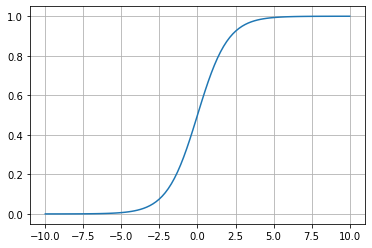

In [5]:
def sigmoid(a):
    return 1. / (1. + numpy.exp(-a))

def plot_function(f):
    x = numpy.linspace(-10,10,100)
    y = f(x)
    
    return plot.plot(x,y)

plot.figure()
plot_function(sigmoid)
plot.grid(True)
plot.show()

Given the sigmoid function we can define the actual logistic regression model.

In [6]:
def logistic_unit(x, w, b):
    """This function computes logistic unit $p_{+}$ .
    :param x: input x with n_dim features
    :param w: weght vector
    :param b: bias term
    """
    
    
    print("x is :")
    print(x)

    print("w is : ")
    print(w)
    
    # operator @ means matrix multiplication in python <3.5
    # https://docs.scipy.org/doc/numpy-1.15.0/reference/generated/numpy.matmul.html#numpy.matmul
    
    pre_sigmoid = x @ w + b
    print("and yet pre_sigmoid is")
    print(pre_sigmoid)
    logit = sigmoid(pre_sigmoid)
    print("finally logit is ")

    print(logit)
    return logit

In [7]:
# Sanity check
out = logistic_unit(x_train, [0,0], 0)
out, out.shape

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[0, 0]
and yet pre_sigmoid is
[0. 0. 0. ... 0. 0. 0.]
finally logit is 
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


(array([0.5, 0.5, 0.5, ..., 0.5, 0.5, 0.5]), (1500,))

## Distance function

The distance function is defined as:

$\Delta(x,y) = -(y \cdot \log(p_{+}) + (1 - y) \cdot \log(1 - p_{+}))$, note that $p_{+}$ depends on x.

In addition, we keep in mind that there are always some state of parameters in the model which are used at this time to compute $p_{+}$, we omit it in this notation for simplicity. Consider writing the whole thing up as an exercise.

In [8]:
NEAR_ZERO = 1e-5

def distance_function(x, y, w, b):
    """This function computes the distance between targets and predicions.
    :param logits: output from logistic unit
    :param labels: target label
    """
  
    logits = logistic_unit(x,w,b)
    labels = y
    
    distance = -(labels * numpy.log(logits + NEAR_ZERO) + (1 - labels) * numpy.log(1 - logits + NEAR_ZERO))
    
    return distance

Now lets make a sanity check and compute the distance between the target and prediction given randomly initialized model.

In [9]:
# Sanity check
n_dim=2
w0 = 0.01 * numpy.random.randn(n_dim)
b0 = 0.0

inp = x_train[0]
label = y_train[0]

out = logistic_unit(inp, w0, b0)
assert (out < 1) and (out > 0)  # why?

dist = distance_function(inp, label, w0, b0)
print(dist)

x is :
[-3.61780959  1.02640984]
w is : 
[ 0.00368909 -0.00350091]
and yet pre_sigmoid is
-0.016939794683902568
finally logit is 
0.49576515259667325
x is :
[-3.61780959  1.02640984]
w is : 
[ 0.00368909 -0.00350091]
and yet pre_sigmoid is
-0.016939794683902568
finally logit is 
0.49576515259667325
0.7016327764160832


## Part 1: Learning with hand-computed derivative

Here we estimate the gradient for *update rule*:

**1. First, we derive it by hand (aka old school).**

The derivative of the distance function w.r.t. parameters $(w,b)$ can be written as

$\nabla \Delta(x,y) = (p_{+} - y)\tilde{x}$

where $\tilde{x}$ is an input with augmented dimension filled with 1 in order to accomodate bias and simplify the notation. As you see below, we actually compute the bias derivative separately here.

### Derivative of the distance function

In [10]:
def distance_grad(x, y, w, b):
    
    dw = (logistic_unit(x,w,b) - y) @ x
    print("dw is : ")
    print(dw)
    db = (logistic_unit(x,w,b) - y)
    
    db = numpy.sum(db)
    return dw, db

In [11]:
# Training loop
n_iter = 10000
eta = 0.0001   # Learning rate
w = numpy.copy(w0)
b = numpy.copy(b0)

cost_log = []

for ni in tqdm(range(n_iter)):
    dw, db = distance_grad(x_train, y_train, w, b)
    w -= eta * dw
    b -= eta * db
    
    cost = numpy.mean(distance_function(x_train, y_train, w, b))
    cost_log.append(cost)

  0%|          | 0/10000 [00:00<?, ?it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00368909 -0.00350091]
and yet pre_sigmoid is
[-0.01693979 -0.01279867 -0.03635179 ... -0.01452455 -0.04025434
 -0.02177208]
finally logit is 
[0.49576515 0.49680038 0.49091305 ... 0.49636893 0.48993777 0.4945572 ]
dw is : 
[-692.93395765 1444.6963933 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00368909 -0.00350091]
and yet pre_sigmoid is
[-0.01693979 -0.01279867 -0.03635179 ... -0.01452455 -0.04025434
 -0.02177208]
finally logit is 
[0.49576515 0.49680038 0.49091305 ... 0.49636893 0.48993777 0.4945572 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406

  0%|          | 6/10000 [00:00<02:55, 56.80it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09695983 -0.39615025]
and yet pre_sigmoid is
[ 0.02195877  0.41099759 -1.02380104 ...  0.41834453 -1.16545757
  0.03561448]
finally logit is 
[0.50548947 0.60132706 0.26428766 ... 0.60308704 0.23767703 0.50890268]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12402642 -0.44863557]
and yet pre_sigmoid is
[ 0.08103796  0.51942062 -1.07145857 ...  0.5333429  -1.22359117
  0.11199659]
finally logit is 
[0.52024841 0.62701228 0.2551258  ... 0.63026245 0.22730509 0.52796992]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12402642 -

  0%|          | 10/10000 [00:00<03:18, 50.41it/s]

and yet pre_sigmoid is
[ 0.22926752  0.83898848 -1.32240134 ...  0.86952294 -1.51916607
  0.30314722]
finally logit is 
[0.55706713 0.69825213 0.21041905 ... 0.70464642 0.17958435 0.5752117 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2017343  -0.62841403]
and yet pre_sigmoid is
[ 0.22926752  0.83898848 -1.32240134 ...  0.86952294 -1.51916607
  0.30314722]
finally logit is 
[0.55706713 0.69825213 0.21041905 ... 0.70464642 0.17958435 0.5752117 ]
dw is : 
[162.18561638 378.41166076]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2017343  -0.62841403]
and yet pre_sigmoid is
[ 0.22926752  0.83898848 -1.32240134 ...  0.86952294 -1.51916607
  0.30314722]
finally logit is 
[0.55706713 0.69825213 0.21041905 ... 0.7

  0%|          | 19/10000 [00:00<02:52, 57.92it/s]


and yet pre_sigmoid is
[ 0.39395519  1.19296873 -1.60219041 ...  1.24109887 -1.84926938
  0.51316422]
finally logit is 
[0.59723447 0.7672716  0.1676757  ... 0.77575523 0.1359587  0.62554795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29704215 -0.85429604]
and yet pre_sigmoid is
[ 0.41683291  1.2421913  -1.64158275 ...  1.29268102 -1.89578275
  0.54210426]
finally logit is 
[0.60272515 0.77594521 0.16224981 ... 0.78460063 0.13058653 0.63230179]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29704215 -0.85429604]
and yet pre_sigmoid is
[ 0.41683291  1.2421913  -1.64158275 ...  1.29268102 -1.89578275
  0.54210426]
finally logit is 
[0.60272515 0.77594521 0.16224981 ... 0.78460063 0.13058653 0.63230179]
dw is

  0%|          | 24/10000 [00:00<03:09, 52.53it/s]

finally logit is 
[0.63499768 0.82288059 0.13266016 ... 0.83202981 0.10203191 0.67125319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36399794 -1.01829822]
and yet pre_sigmoid is
[ 0.55371762  1.53598694 -1.8776402  ...  1.60008173 -2.1748489
  0.7138585 ]
finally logit is 
[0.63499768 0.82288059 0.13266016 ... 0.83202981 0.10203191 0.67125319]
dw is : 
[ 80.90003536 201.42509611]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36399794 -1.01829822]
and yet pre_sigmoid is
[ 0.55371762  1.53598694 -1.8776402  ...  1.60008173 -2.1748489
  0.7138585 ]
finally logit is 
[0.63499768 0.82288059 0.13266016 ... 0.83202981 0.10203191 0.67125319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  0%|          | 30/10000 [00:00<03:07, 53.27it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37988363 -1.05792237]
and yet pre_sigmoid is
[ 0.58710276  1.60732799 -1.93501244 ...  1.67459511 -2.24278224
  0.75535097]
finally logit is 
[0.64270011 0.83304008 0.12619682 ... 0.84218751 0.09597387 0.68034353]
dw is : 
[ 75.20158948 188.61769088]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37988363 -1.05792237]
and yet pre_sigmoid is
[ 0.58710276  1.60732799 -1.93501244 ...  1.67459511 -2.24278224
  0.75535097]
finally logit is 
[0.64270011 0.83304008 0.12619682 ... 0.84218751 0.09597387 0.68034353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406 

and yet pre_sigmoid is
[ 0.69008315  1.8262282  -2.11062273 ...  1.90287622 -2.45105508
  0.88224301]
finally logit is 
[0.66598542 0.86131178 0.10806863 ... 0.87021671 0.07936143 0.70728681]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43358826 -1.1942213 ]
and yet pre_sigmoid is
[ 0.70335     1.85428095 -2.13305234 ...  1.93209036 -2.47769757
  0.89846282]
finally logit is 
[0.66893009 0.86462895 0.10592557 ... 0.87348061 0.07743653 0.71063351]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43358826 -1.1942213 ]
and yet pre_sigmoid is
[ 0.70335     1.85428095 -2.13305234 ...  1.93209036 -2.47769757
  0.89846282]
finally logit is 
[0.66893009 0.86462895 0.10592557 ... 0.87348061 0.07743653 0.71063351]
dw is 

  0%|          | 39/10000 [00:00<02:45, 60.12it/s]

and yet pre_sigmoid is
[ 0.72898221  1.90837278 -2.17623683 ...  1.98839389 -2.52902242
  0.9297134 ]
finally logit is 
[0.67458189 0.87083623 0.10190482 ... 0.87957312 0.07384848 0.71701714]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45055987 -1.23814033]
and yet pre_sigmoid is
[ 0.7413765   1.93447577 -2.19704316 ...  2.01555083 -2.55376501
  0.94478254]
finally logit is 
[0.67729679 0.87374399 0.10001633 ... 0.88242017 0.07217396 0.72006469]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45055987 -1.23814033]
and yet pre_sigmoid is
[ 0.7413765   1.93447577 -2.19704316 ...  2.01555083 -2.55376501
  0.94478254]
finally logit is 
[0.67729679 0.87374399 0.10001633 ... 0.88242017 0.07217396 0.72006469]
dw is 

  0%|          | 50/10000 [00:00<02:23, 69.20it/s]

finally logit is 
[0.69452761 0.89110284 0.0886676  ... 0.8993189  0.06226143 0.73911186]
dw is : 
[ 44.66848633 119.13462861]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48519728 -1.32926774]
and yet pre_sigmoid is
[ 0.82137251  2.10205587 -2.33001316 ...  2.18967957 -2.71212913
  1.04135754]
finally logit is 
[0.69452761 0.89110284 0.0886676  ... 0.8993189  0.06226143 0.73911186]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48966413 -1.34118121]
and yet pre_sigmoid is
[ 0.83195233  2.12409542 -2.34741273 ...  2.21255104 -2.7328844
  1.05403785]
finally logit is 
[0.69676758 0.89322316 0.08727164 ... 0.90137095 0.06106058 0.74154952]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

[-0.52554149 -1.43843232]
and yet pre_sigmoid is
[ 0.91952993  2.30531093 -2.48954567 ...  2.40032677 -2.90275213
  1.15812349]
finally logit is 
[0.71494632 0.90931593 0.07659433 ... 0.91685222 0.05201768 0.76099158]
dw is : 
[35.65961496 98.33803328]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52554149 -1.43843232]
and yet pre_sigmoid is
[ 0.91952993  2.30531093 -2.48954567 ...  2.40032677 -2.90275213
  1.15812349]
finally logit is 
[0.71494632 0.90931593 0.07659433 ... 0.91685222 0.05201768 0.76099158]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52910745 -1.44826613]
and yet pre_sigmoid is
[ 0.92851643  2.32377544 -2.50392537 ...  2.41943027 -2.91997239
  1.16871183]
finally logit is 
[0.7167742  0.910

  1%|          | 60/10000 [00:00<02:10, 75.91it/s]

finally logit is 
[0.72033023 0.91371246 0.07364889 ... 0.92105124 0.04956919 0.76662988]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53937138 -1.47676133]
and yet pre_sigmoid is
[ 0.9547056   2.37743952 -2.54559849 ...  2.4749187  -2.96991679
  1.19946737]
finally logit is 
[0.72206053 0.9150907  0.07272274 ... 0.92236472 0.04880359 0.76843002]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53937138 -1.47676133]
and yet pre_sigmoid is
[ 0.9547056   2.37743952 -2.54559849 ...  2.4749187  -2.96991679
  1.19946737]
finally logit is 
[0.72206053 0.9150907  0.07272274 ... 0.92236472 0.04880359 0.76843002]
dw is : 
[32.84191659 91.80120621]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  1%|          | 70/10000 [00:00<02:04, 79.96it/s]

finally logit is 
[0.73183489 0.9225662  0.06767426 ... 0.92946425 0.04466733 0.77848822]
dw is : 
[29.21507315 83.36190163]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5581385  -1.52966079]
and yet pre_sigmoid is
[ 1.00395208  2.47773579 -2.62297641 ...  2.57848862 -3.06281727
  1.25687809]
finally logit is 
[0.73183489 0.9225662  0.06767426 ... 0.92946425 0.04466733 0.77848822]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56106001 -1.53799698]
and yet pre_sigmoid is
[ 1.01179202  2.493626   -2.635171   ...  2.59488055 -3.07747893
  1.26596547]
finally logit is 
[0.7333707  0.92369377 0.06690889 ... 0.93053137 0.04404585 0.78005132]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57749412 -1.58545878]
and yet pre_sigmoid is
[ 1.05687455  2.58457325 -2.70460045 ...  2.68860584 -3.16107084
  1.31793296]
finally logit is 
[0.74209281 0.92986212 0.06270244 ... 0.93635094 0.04065727 0.7888376 ]
dw is : 
[25.69179087 75.13352944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57749412 -1.58545878]
and yet pre_sigmoid is
[ 1.05687455  2.58457325 -2.70460045 ...  2.68860584 -3.16107084
  1.31793296]
finally logit is 
[0.74209281 0.92986212 0.06270244 ... 0.93635094 0.04065727 0.7888376 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  1%|          | 79/10000 [00:01<02:39, 62.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58750396 -1.61488733]
and yet pre_sigmoid is
[ 1.08523419  2.64139903 -2.74764649 ...  2.74708319 -3.21300328
  1.35036541]
finally logit is 
[0.74748323 0.93347889 0.06021971 ... 0.93974841 0.03867931 0.79418936]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58750396 -1.61488733]
and yet pre_sigmoid is
[ 1.08523419  2.64139903 -2.74764649 ...  2.74708319 -3.21300328
  1.35036541]
finally logit is 
[0.74748323 0.93347889 0.06021971 ... 0.93974841 0.03867931 0.79418936]
dw is : 
[23.94891188 71.05105998]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[-0.60127806 -1.65612093]
and yet pre_sigmoid is
[ 1.12554284  2.72163164 -2.80794923 ...  2.82953097 -3.28590355
  1.39610703]
finally logit is 
[0.75501541 0.93829107 0.05689612 ... 0.94425092 0.03605796 0.80156541]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6034412  -1.66268182]
and yet pre_sigmoid is
[ 1.13202203  2.73446775 -2.81754265 ...  2.84270831 -3.29751807
  1.40341961]
finally logit is 
[0.75621187 0.93903013 0.05638353 ... 0.94494054 0.03565643 0.80272597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6034412  -1.66268182]
and yet pre_sigmoid is
[ 1.13202203  2.73446775 -2.81754265 ...  2.84270831 -3.29751807
  1.40341961]
finally logit is 
[0.75621187 0.93903013 0.05638353 ... 0.94494054 0.0

  1%|          | 87/10000 [00:01<02:57, 55.96it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60972019 -1.68186931]
and yet pre_sigmoid is
[ 1.15107942  2.77212341 -2.84559556 ...  2.88134331 -3.33150921
  1.42486287]
finally logit is 
[0.75970802 0.9411507  0.05490944 ... 0.94691643 0.03450592 0.80609963]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60972019 -1.68186931]
and yet pre_sigmoid is
[ 1.15107942  2.77212341 -2.84559556 ...  2.88134331 -3.33150921
  1.42486287]
finally logit is 
[0.75970802 0.9411507  0.05490944 ... 0.94691643 0.03450592 0.80609963]
dw is : 
[20.25398858 62.36626512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 1.19349243  2.85538105 -2.90712242 ...  2.96664752 -3.40621572
  1.472228  ]
finally logit is 
[0.7673651  0.94559617 0.0518026  ... 0.95104442 0.03210177 0.8133958 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62323703 -1.72396661]
and yet pre_sigmoid is
[ 1.19349243  2.85538105 -2.90712242 ...  2.96664752 -3.40621572
  1.472228  ]
finally logit is 
[0.7673651  0.94559617 0.0518026  ... 0.95104442 0.03210177 0.8133958 ]
dw is : 
[18.11042719 57.3068787 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62323703 -1.72396661]
and yet pre_sigmoid is
[ 1.19349243  2.85538105 -2.90712242 ...  2.96664752 -3.40621572
  1.472228  ]
finally logit is 
[0.7673651  0.94559617 0.0518026  ... 0.951

  1%|          | 94/10000 [00:01<02:51, 57.68it/s]

and yet pre_sigmoid is
[ 1.20512357  2.87807788 -2.92377023 ...  2.98987278 -3.42646871
  1.48512899]
finally logit is 
[0.76943498 0.94675205 0.05099095 ... 0.95211451 0.03147841 0.81534603]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62683093 -1.73536134]
and yet pre_sigmoid is
[ 1.20512357  2.87807788 -2.92377023 ...  2.98987278 -3.42646871
  1.48512899]
finally logit is 
[0.76943498 0.94675205 0.05099095 ... 0.95211451 0.03147841 0.81534603]
dw is : 
[17.55233659 55.98680069]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62683093 -1.73536134]
and yet pre_sigmoid is
[ 1.20512357  2.87807788 -2.92377023 ...  2.98987278 -3.42646871
  1.48512899]
finally logit is 
[0.76943498 0.94675205 0.05099095 ... 0.952

  1%|          | 101/10000 [00:01<03:01, 54.43it/s]

and yet pre_sigmoid is
[ 1.21655345  2.90032384 -2.94003312 ...  3.012624   -3.44627042
  1.49776901]
finally logit is 
[0.77145645 0.94786244 0.05020969 ... 0.95314119 0.03088028 0.8172415 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63201589 -1.75196625]
and yet pre_sigmoid is
[ 1.22219526  2.91128305 -2.94802474 ...  3.02382743 -3.45600731
  1.50399424]
finally logit is 
[0.77244964 0.94840139 0.04982995 ... 0.95363904 0.03059021 0.81816945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63201589 -1.75196625]
and yet pre_sigmoid is
[ 1.22219526  2.91128305 -2.94802474 ...  3.02382743 -3.45600731
  1.50399424]
finally logit is 
[0.77244964 0.94840139 0.04982995 ... 0.95363904 0.03059021 0.81816945]
dw is 

  1%|          | 107/10000 [00:01<02:57, 55.71it/s]

and yet pre_sigmoid is
[ 1.25507717  2.97486889 -2.99412202 ...  3.08876762 -3.51225644
  1.54009083]
finally logit is 
[0.77817751 0.95142579 0.04769213 ... 0.95642704 0.0289655  0.82347793]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64322414 -1.78860125]
and yet pre_sigmoid is
[ 1.26040356  2.98512201 -3.00151071 ...  3.09922888 -3.52128626
  1.54590772]
finally logit is 
[0.77909557 0.95189745 0.04735767 ... 0.95686093 0.0287126  0.82432189]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64322414 -1.78860125]
and yet pre_sigmoid is
[ 1.26040356  2.98512201 -3.00151071 ...  3.09922888 -3.52128626
  1.54590772]
finally logit is 
[0.77909557 0.95189745 0.04735767 ... 0.95686093 0.0287126  0.82432189]
dw is 

  1%|          | 119/10000 [00:01<02:30, 65.50it/s]

finally logit is 
[0.78267042 0.95370021 0.04607663 ... 0.95851703 0.02774719 0.82758994]
dw is : 
[14.18698025 47.99843988]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64911582 -1.80831681]
and yet pre_sigmoid is
[ 1.28129666  3.02521186 -3.03027756 ...  3.14010439 -3.55648137
  1.5686421 ]
finally logit is 
[0.78267042 0.95370021 0.04607663 ... 0.95851703 0.02774719 0.82758994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65053452 -1.81311665]
and yet pre_sigmoid is
[ 1.28642027  3.03501143 -3.03727893 ...  3.15008906 -3.56505686
  1.57419691]
finally logit is 
[0.78354067 0.954131   0.04576987 ... 0.95891223 0.02751678 0.82838109]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

[-0.66483219 -1.86279472]
and yet pre_sigmoid is
[ 1.34036648  3.13741315 -3.10968842 ...  3.25425461 -3.65398334
  1.63218576]
finally logit is 
[0.7925502  0.95840989 0.04270938 ... 0.9628257  0.02523454 0.83646885]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66483219 -1.86279472]
and yet pre_sigmoid is
[ 1.34036648  3.13741315 -3.10968842 ...  3.25425461 -3.65398334
  1.63218576]
finally logit is 
[0.7925502  0.95840989 0.04270938 ... 0.9628257  0.02523454 0.83646885]
dw is : 
[11.89078095 42.51585514]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66483219 -1.86279472]
and yet pre_sigmoid is
[ 1.34036648  3.13741315 -3.10968842 ...  3.25425461 -3.65398334
  1.63218576]
finally logit is 
[0.7925502  0.958

  1%|▏         | 128/10000 [00:01<02:19, 70.93it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66948638 -1.87955643]
and yet pre_sigmoid is
[ 1.35897379  3.17239596 -3.13409458 ...  3.2897656  -3.68406152
  1.65197193]
finally logit is 
[0.79559286 0.95978217 0.04172259 ... 0.96407604 0.02450515 0.83915738]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66948638 -1.87955643]
and yet pre_sigmoid is
[ 1.35897379  3.17239596 -3.13409458 ...  3.2897656  -3.68406152
  1.65197193]
finally logit is 
[0.79559286 0.95978217 0.04172259 ... 0.96407604 0.02450515 0.83915738]
dw is : 
[11.21863186 40.90518134]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

  1%|▏         | 137/10000 [00:02<02:11, 75.25it/s]

finally logit is 
[0.79852355 0.96107021 0.04079406 ... 0.96524743 0.02382175 0.84172628]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67493642 -1.89962675]
and yet pre_sigmoid is
[ 1.38154831  3.21459735 -3.16329882 ...  3.33255104 -3.72012903
  1.67582416]
finally logit is 
[0.79923955 0.96137992 0.04057045 ... 0.96552878 0.0236576  0.84235079]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67493642 -1.89962675]
and yet pre_sigmoid is
[ 1.38154831  3.21459735 -3.16329882 ...  3.33255104 -3.72012903
  1.67582416]
finally logit is 
[0.79923955 0.96137992 0.04057045 ... 0.96552878 0.0236576  0.84235079]
dw is : 
[10.43399264 39.02124025]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.80474308 0.96369657 0.03889387 ... 0.96762916 0.02243209 0.84711002]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68380452 -1.93348844]
and yet pre_sigmoid is
[ 1.42042063  3.28663375 -3.21251659 ...  3.40544403 -3.7811168
  1.71649595]
finally logit is 
[0.80540435 0.96396741 0.03869741 ... 0.96787424 0.02228909 0.84767694]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68380452 -1.93348844]
and yet pre_sigmoid is
[ 1.42042063  3.28663375 -3.21251659 ...  3.40544403 -3.7811168
  1.71649595]
finally logit is 
[0.80540435 0.96396741 0.03869741 ... 0.96787424 0.02228909 0.84767694]
dw is : 
[ 9.15810711 35.94848526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

  1%|▏         | 146/10000 [00:02<02:11, 75.01it/s]

and yet pre_sigmoid is
[ 1.4492295   3.33949004 -3.24809204 ...  3.45881035 -3.82537418
  1.74630315]
finally logit is 
[0.80987983 0.96575898 0.03739551 ... 0.9694928  0.02134474 0.85148591]
dw is : 
[ 8.27053065 33.80336663]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68994412 -1.95799761]
and yet pre_sigmoid is
[ 1.4492295   3.33949004 -3.24809204 ...  3.45881035 -3.82537418
  1.74630315]
finally logit is 
[0.80987983 0.96575898 0.03739551 ... 0.9694928  0.02134474 0.85148591]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69077117 -1.96137795]
and yet pre_sigmoid is
[ 1.45325054  3.34683077 -3.25299511 ...  3.46621365 -3.83148618
  1.75044038]
finally logit is 
[0.81049819 0.9660009  0.03721941 ... 0.969

  2%|▏         | 154/10000 [00:02<02:16, 72.27it/s]


w is : 
[-0.69623277 -1.98424604]
and yet pre_sigmoid is
[ 1.48077604  3.3968348  -3.28614004 ...  3.51658842 -3.87288735
  1.77860655]
finally logit is 
[0.81468977 0.96760547 0.03604974 ... 0.97115609 0.02037448 0.85552472]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69623277 -1.98424604]
and yet pre_sigmoid is
[ 1.48077604  3.3968348  -3.28614004 ...  3.51658842 -3.87288735
  1.77860655]
finally logit is 
[0.81468977 0.96760547 0.03604974 ... 0.97115609 0.02037448 0.85552472]
dw is : 
[ 7.35184714 31.575753  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69623277 -1.98424604]
and yet pre_sigmoid is
[ 1.48077604  3.3968348  -3.28614004 ...  3.51658842 -3.87288735
  1.77860655]
finally logit is 
[0.81468

  2%|▏         | 162/10000 [00:02<02:12, 74.37it/s]

finally logit is 
[0.8181034  0.96886757 0.03512782 ... 0.97229001 0.01971324 0.85835622]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70048401 -2.00280283]
and yet pre_sigmoid is
[ 1.50355035  3.43787773 -3.31300227 ...  3.55786101 -3.90655463
  1.80170387]
finally logit is 
[0.8181034  0.96886757 0.03512782 ... 0.97229001 0.01971324 0.85835622]
dw is : 
[ 6.7214937  30.04252657]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70048401 -2.00280283]
and yet pre_sigmoid is
[ 1.50355035  3.43787773 -3.31300227 ...  3.55786101 -3.90655463
  1.80170387]
finally logit is 
[0.8181034  0.96886757 0.03512782 ... 0.97229001 0.01971324 0.85835622]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  2%|▏         | 172/10000 [00:02<02:05, 78.56it/s]

and yet pre_sigmoid is
[ 1.53996989  3.50287506 -3.35487392 ...  3.62307723 -3.95925781
  1.83824143]
finally logit is 
[0.82346035 0.97076946 0.03373592 ... 0.97399398 0.01872014 0.86274059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70676694 -2.0317757 ]
and yet pre_sigmoid is
[ 1.53996989  3.50287506 -3.35487392 ...  3.62307723 -3.95925781
  1.83824143]
finally logit is 
[0.82346035 0.97076946 0.03373592 ... 0.97399398 0.01872014 0.86274059]
dw is : 
[ 5.76769198 27.71435534]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70676694 -2.0317757 ]
and yet pre_sigmoid is
[ 1.53996989  3.50287506 -3.35487392 ...  3.62307723 -3.95925781
  1.83824143]
finally logit is 
[0.82346035 0.97076946 0.03373592 ... 0.973

  2%|▏         | 182/10000 [00:02<01:58, 82.60it/s]

and yet pre_sigmoid is
[ 1.57124809  3.55805556 -3.38973986 ...  3.67829661 -4.00337458
  1.86922049]
finally logit is 
[0.82796146 0.97229525 0.03261766 ... 0.97535666 0.0179267  0.86636806]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71164459 -2.05595123]
and yet pre_sigmoid is
[ 1.57124809  3.55805556 -3.38973986 ...  3.67829661 -4.00337458
  1.86922049]
finally logit is 
[0.82796146 0.97229525 0.03261766 ... 0.97535666 0.0179267  0.86636806]
dw is : 
[ 4.99902243 25.83002599]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71164459 -2.05595123]
and yet pre_sigmoid is
[ 1.57124809  3.55805556 -3.38973986 ...  3.67829661 -4.00337458
  1.86922049]
finally logit is 
[0.82796146 0.97229525 0.03261766 ... 0.975

and yet pre_sigmoid is
[ 1.60449639  3.61604408 -3.42566034 ...  3.73617159 -4.04907434
  1.90173483]
finally logit is 
[0.83264588 0.97381524 0.03150307 ... 0.97671013 0.01713962 0.87008775]
dw is : 
[ 4.23016663 23.9370583 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71629075 -2.08091322]
and yet pre_sigmoid is
[ 1.60449639  3.61604408 -3.42566034 ...  3.73617159 -4.04907434
  1.90173483]
finally logit is 
[0.83264588 0.97381524 0.03150307 ... 0.97671013 0.01713962 0.87008775]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71671377 -2.08330693]
and yet pre_sigmoid is
[ 1.60773977  3.62166338 -3.42910023 ...  3.74177113 -4.05346513
  1.90488328]
finally logit is 
[0.83309735 0.97395815 0.03139829 ... 0.976

  2%|▏         | 193/10000 [00:02<01:52, 87.24it/s]

and yet pre_sigmoid is
[ 1.62057226  3.64383009 -3.44259687 ...  3.76384434 -4.07071863
  1.91729909]
finally logit is 
[0.83487404 0.97451451 0.03099041 ... 0.97733138 0.01677879 0.87183694]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71833415 -2.09270471]
and yet pre_sigmoid is
[ 1.62057226  3.64383009 -3.44259687 ...  3.76384434 -4.07071863
  1.91729909]
finally logit is 
[0.83487404 0.97451451 0.03099041 ... 0.97733138 0.01677879 0.87183694]
dw is : 
[ 3.8754387  23.06063146]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71833415 -2.09270471]
and yet pre_sigmoid is
[ 1.62057226  3.64383009 -3.44259687 ...  3.76384434 -4.07071863
  1.91729909]
finally logit is 
[0.83487404 0.97451451 0.03099041 ... 0.977

  2%|▏         | 202/10000 [00:02<01:59, 82.17it/s]

finally logit is 
[0.83703159 0.97517733 0.03050469 ... 0.97791941 0.01643758 0.87351827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72020381 -2.10406657]
and yet pre_sigmoid is
[ 1.63630546  3.67086211 -3.45889535 ...  3.79072812 -4.09161123
  1.93243115]
finally logit is 
[0.83703159 0.97517733 0.03050469 ... 0.97791941 0.01643758 0.87351827]
dw is : 
[ 3.53862806 22.22651818]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72020381 -2.10406657]
and yet pre_sigmoid is
[ 1.63630546  3.67086211 -3.45889535 ...  3.79072812 -4.09161123
  1.93243115]
finally logit is 
[0.83703159 0.97517733 0.03050469 ... 0.97791941 0.01643758 0.87351827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  2%|▏         | 211/10000 [00:03<02:31, 64.43it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72285543 -2.12140272]
and yet pre_sigmoid is
[ 1.66080443  3.71263216 -3.48372098 ...  3.83219273 -4.12356394
  1.95579373]
finally logit is 
[0.84034596 0.97616862 0.02977898 ... 0.97879723 0.01592889 0.87607702]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72315882 -2.1235    ]
and yet pre_sigmoid is
[ 1.66381089  3.71773072 -3.48672057 ...  3.83724749 -4.12743589
  1.95864376]
finally logit is 
[0.84074891 0.97628694 0.02969244 ... 0.97890188 0.01586831 0.8763861 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72315882 -

  1.98091029]
finally logit is 
[0.84388684 0.97719234 0.02903098 ... 0.9797017  0.01540582 0.87877817]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72537367 -2.13974912]
and yet pre_sigmoid is
[ 1.68743727  3.75758706 -3.50993115 ...  3.87671099 -4.1574844
  1.98091029]
finally logit is 
[0.84388684 0.97719234 0.02903098 ... 0.9797017  0.01540582 0.87877817]
dw is : 
[ 2.5116126  19.66994871]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72537367 -2.13974912]
and yet pre_sigmoid is
[ 1.68743727  3.75758706 -3.50993115 ...  3.87671099 -4.1574844
  1.98091029]
finally logit is 
[0.84388684 0.97719234 0.02903098 ... 0.9797017  0.01540582 0.87877817]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]


  2%|▏         | 219/10000 [00:03<02:33, 63.86it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72634535 -2.14753463]
and yet pre_sigmoid is
[ 1.69897731  3.77691728 -3.52103261 ...  3.89581772 -4.17191434
  1.99170123]
finally logit is 
[0.84540112 0.97761921 0.02871968 ... 0.9800782  0.01518846 0.879923  ]
dw is : 
[ 2.29352634 19.12421553]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72634535 -2.14753463]
and yet pre_sigmoid is
[ 1.69897731  3.77691728 -3.52103261 ...  3.89581772 -4.17191434
  1.99170123]
finally logit is 
[0.84540112 0.97761921 0.02871968 ... 0.9800782  0.01518846 0.879923  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  2%|▏         | 227/10000 [00:03<02:27, 66.21it/s]

finally logit is 
[0.84796868 0.97832829 0.0282036  ... 0.98070274 0.01482849 0.88184989]
dw is : 
[ 1.93095361 18.21443906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7278407  -2.16064546]
and yet pre_sigmoid is
[ 1.71875711  3.80983757 -3.53969652 ...  3.92830612 -4.19626563
  2.01006596]
finally logit is 
[0.84796868 0.97832829 0.0282036  ... 0.98070274 0.01482849 0.88184989]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72803379 -2.1624669 ]
and yet pre_sigmoid is
[ 1.72154106  3.81444935 -3.54228621 ...  3.93285212 -4.19965398
  2.01263736]
finally logit is 
[0.84832723 0.97842585 0.02813271 ... 0.98078858 0.01477907 0.88211755]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  2%|▏         | 235/10000 [00:03<02:40, 60.93it/s]

and yet pre_sigmoid is
[ 1.73257587  3.83267622 -3.55245998 ...  3.95080611 -4.21298903
  2.02279696]
finally logit is 
[0.84974161 0.97880726 0.02785588 ... 0.98112397 0.01458615 0.88316991]
dw is : 
[ 1.68586932 17.59759051]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72875671 -2.16962825]
and yet pre_sigmoid is
[ 1.73257587  3.83267622 -3.55245998 ...  3.95080611 -4.21298903
  2.02279696]
finally logit is 
[0.84974161 0.97880726 0.02785588 ... 0.98112397 0.01458615 0.88316991]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7289253  -2.17138801]
and yet pre_sigmoid is
[ 1.73530972  3.83717879 -3.55495798 ...  3.95523806 -4.21626912
  2.02530589]
finally logit is 
[0.85009033 0.97890046 0.02778831 ... 0.981

[-0.72983813 -2.18169756]
and yet pre_sigmoid is
[ 1.75151014  3.86375276 -3.56957578 ...  3.9813688  -4.2355125
  2.04010701]
finally logit is 
[0.85214317 0.9794424  0.02739611 ... 0.98168174 0.01426593 0.88494416]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7299742  -2.18337524]
and yet pre_sigmoid is
[ 1.75417713  3.86810976 -3.57195176 ...  3.98564876 -4.23864847
  2.04253269]
finally logit is 
[0.85247889 0.97952995 0.02733287 ... 0.98175855 0.0142219  0.88519091]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7299742  -2.18337524]
and yet pre_sigmoid is
[ 1.75417713  3.86810976 -3.57195176 ...  3.98564876 -4.23864847
  2.04253269]
finally logit is 
[0.85247889 0.97952995 0.02733287 ... 0.98175855 0.01

  2%|▏         | 242/10000 [00:03<02:34, 63.04it/s]

and yet pre_sigmoid is
[ 1.75948338  3.87676353 -3.57665327 ...  3.99414581 -4.24486081
  2.04734963]
finally logit is 
[0.85314495 0.97970274 0.02720816 ... 0.9819101  0.01413506 0.88567954]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73035569 -2.1883406 ]
and yet pre_sigmoid is
[ 1.7621228   3.88106062 -3.57897909 ...  3.99836324 -4.24793751
  2.04974107]
finally logit is 
[0.85347533 0.97978802 0.02714667 ... 0.98198486 0.01409225 0.88592145]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73035569 -2.1883406 ]
and yet pre_sigmoid is
[ 1.7621228   3.88106062 -3.57897909 ...  3.99836324 -4.24793751
  2.04974107]
finally logit is 
[0.85347533 0.97978802 0.02714667 ... 0.98198486 0.01409225 0.88592145]
dw is 

  2%|▏         | 249/10000 [00:03<02:36, 62.32it/s]


and yet pre_sigmoid is
[ 1.76737456  3.88959598 -3.58358152 ...  4.00673671 -4.25403276
  2.05449031]
finally logit is 
[0.85413087 0.97995636 0.02702538 ... 0.98213239 0.01400782 0.88640055]
dw is : 
[ 1.09760671 16.11016283]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73058812 -2.19159537]
and yet pre_sigmoid is
[ 1.76737456  3.88959598 -3.58358152 ...  4.00673671 -4.25403276
  2.05449031]
finally logit is 
[0.85413087 0.97995636 0.02702538 ... 0.98213239 0.01400782 0.88640055]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73069788 -2.19320639]
and yet pre_sigmoid is
[ 1.76998704  3.89383456 -3.5858584  ...  4.01089307 -4.25705163
  2.05684831]
finally logit is 
[0.85445606 0.98003944 0.02696558 ... 0.98

and yet pre_sigmoid is
[ 1.78803039  3.92297534 -3.60135432 ...  4.0394354  -4.27766089
  2.07305176]
finally logit is 
[0.85668563 0.98060159 0.02656195 ... 0.98269725 0.0136852  0.88825623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73134912 -2.20418603]
and yet pre_sigmoid is
[ 1.78803039  3.92297534 -3.60135432 ...  4.0394354  -4.27766089
  2.07305176]
finally logit is 
[0.85668563 0.98060159 0.02656195 ... 0.98269725 0.0136852  0.88825623]
dw is : 
[ 0.76732526 15.27034059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73134912 -2.20418603]
and yet pre_sigmoid is
[ 1.78803039  3.92297534 -3.60135432 ...  4.0394354  -4.27766089
  2.07305176]
finally logit is 
[0.85668563 0.98060159 0.02656195 ... 0.982

  3%|▎         | 257/10000 [00:03<02:25, 66.74it/s]


and yet pre_sigmoid is
[ 1.79815476  3.93922397 -3.60987259 ...  4.05532466 -4.28903965
  2.08208046]
finally logit is 
[0.85792417 0.98090828 0.02634259 ... 0.98296535 0.01353245 0.88914926]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73163235 -2.21023373]
and yet pre_sigmoid is
[ 1.79815476  3.93922397 -3.60987259 ...  4.05532466 -4.28903965
  2.08208046]
finally logit is 
[0.85792417 0.98090828 0.02634259 ... 0.98296535 0.01353245 0.88914926]
dw is : 
[ 0.61041432 14.87004358]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73163235 -2.21023373]
and yet pre_sigmoid is
[ 1.79815476  3.93922397 -3.60987259 ...  4.05532466 -4.28903965
  2.08208046]
finally logit is 
[0.85792417 0.98090828 0.02634259 ... 0.98

  3%|▎         | 264/10000 [00:03<02:44, 59.14it/s]


[ 1.81556067  3.96698481 -3.62421782 ...  4.08242775 -4.30828795
  2.09749552]
finally logit is 
[0.86003259 0.98142128 0.02597714 ... 0.98341329 0.01327789 0.89065952]
dw is : 
[ 0.34812258 14.19887141]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73198008 -2.22043933]
and yet pre_sigmoid is
[ 1.81556067  3.96698481 -3.62421782 ...  4.08242775 -4.30828795
  2.09749552]
finally logit is 
[0.86003259 0.98142128 0.02597714 ... 0.98341329 0.01327789 0.89065952]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73201489 -2.22185922]
and yet pre_sigmoid is
[ 1.81801576  3.97088266 -3.62621056 ...  4.08622875 -4.31097076
  2.09965884]
finally logit is 
[0.86032786 0.98149222 0.02592677 ... 0.98347518 0.01324279 0.890

  3%|▎         | 271/10000 [00:04<02:46, 58.40it/s]


finally logit is 
[0.86178278 0.98183854 0.02568146 ... 0.98377711 0.01307178 0.89190358]
dw is : 
[ 0.13502025 13.65156014]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73213517 -2.22882061]
and yet pre_sigmoid is
[ 1.83017673  3.99012497 -3.63596909 ...  4.10497634 -4.32414191
  2.11033444]
finally logit is 
[0.86178278 0.98183854 0.02568146 ... 0.98377711 0.01307178 0.89190358]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73214867 -2.23018577]
and yet pre_sigmoid is
[ 1.8325864   3.99392488 -3.63788048 ...  4.10867526 -4.3267284
  2.11244184]
finally logit is 
[0.86206955 0.98190617 0.02563367 ... 0.98383604 0.01303845 0.89210659]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  3%|▎         | 278/10000 [00:04<02:50, 57.16it/s]


finally logit is 
[0.86403903 0.98236513 0.02531059 ... 0.98423558 0.01281296 0.89349443]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73213473 -2.24079273]
and yet pre_sigmoid is
[ 1.85160204  4.02376073 -3.6527044  ...  4.13767963 -4.34686708
  2.12897938]
finally logit is 
[0.86431509 0.9824287  0.02526601 ... 0.98429087 0.01278182 0.89368808]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73213473 -2.24079273]
and yet pre_sigmoid is
[ 1.85160204  4.02376073 -3.6527044  ...  4.13767963 -4.34686708
  2.12897938]
finally logit is 
[0.86431509 0.9824287  0.02526601 ... 0.98429087 0.01278182 0.89368808]
dw is : 
[-0.16586568 12.87544706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  3%|▎         | 284/10000 [00:04<02:56, 55.12it/s]


and yet pre_sigmoid is
[ 1.85861615  4.03469817 -3.65805552 ...  4.14829483 -4.35417283
  2.13503768]
finally logit is 
[0.86513557 0.98261651 0.02513456 ... 0.98445417 0.01268996 0.8942623 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73207536 -2.2446305 ]
and yet pre_sigmoid is
[ 1.85861615  4.03469817 -3.65805552 ...  4.14829483 -4.35417283
  2.13503768]
finally logit is 
[0.86513557 0.98261651 0.02513456 ... 0.98445417 0.01268996 0.8942623 ]
dw is : 
[-0.26145892 12.62799008]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73207536 -2.2446305 ]
and yet pre_sigmoid is
[ 1.85861615  4.03469817 -3.65805552 ...  4.14829483 -4.35417283
  2.13503768]
finally logit is 
[0.86513557 0.98261651 0.02513456 ... 0.98

  3%|▎         | 290/10000 [00:04<02:53, 55.83it/s]


finally logit is 
[0.8670063  0.9830386  0.02484065 ... 0.98482078 0.01248431 0.8955643 ]
dw is : 
[-0.47593655 12.07111594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73182732 -2.25330142]
and yet pre_sigmoid is
[ 1.87474449  4.05970836 -3.67011957 ...  4.1725321  -4.37071954
  2.14888242]
finally logit is 
[0.8670063  0.9830386  0.02484065 ... 0.98482078 0.01248431 0.8955643 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73177973 -2.25450853]
and yet pre_sigmoid is
[ 1.877022    4.06322437 -3.67179606 ...  4.17593535 -4.37302769
  2.15082779]
finally logit is 
[0.86726869 0.98309713 0.02480007 ... 0.98487157 0.01245589 0.8957461 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  3%|▎         | 298/10000 [00:04<02:39, 60.73it/s]

dw is : 
[-0.56433628 11.84088619]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73167566 -2.25689962]
and yet pre_sigmoid is
[ 1.88155754  4.07021468 -3.67511466 ...  4.18269847 -4.37760323
  2.15469473]
finally logit is 
[0.86778993 0.9832129  0.02471994 ... 0.98497201 0.01239973 0.89610667]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73161922 -2.25808371]
and yet pre_sigmoid is
[ 1.88381565  4.07368917 -3.67675694 ...  4.18605853 -4.37987081
  2.15661641]
finally logit is 
[0.86804879 0.98327015 0.02468037 ... 0.98502166 0.01237199 0.89628544]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[-0.73106515 -2.26728847]
and yet pre_sigmoid is
[ 1.90165419  4.10100135 -3.68949701 ...  4.21243565 -4.39753905
  2.17171395]
finally logit is 
[0.87007863 0.98371355 0.02437555 ... 0.98540589 0.01215796 0.8976805 ]
dw is : 
[-0.81762472 11.17875473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73106515 -2.26728847]
and yet pre_sigmoid is
[ 1.90165419  4.10100135 -3.68949701 ...  4.21243565 -4.39753905
  2.17171395]
finally logit is 
[0.87007863 0.98371355 0.02437555 ... 0.98540589 0.01215796 0.8976805 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73098338 -2.26840634]
and yet pre_sigmoid is
[ 1.90385631  4.10435624 -3.6910409  ...  4.21567127 -4.39968989
  2.17356741]
finally logit is 
[0.87032736 0.983

  3%|▎         | 307/10000 [00:04<02:26, 66.02it/s]

finally logit is 
[0.87082157 0.98387341 0.0242664  ... 0.98554426 0.01208115 0.89818809]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73072193 -2.27171755]
and yet pre_sigmoid is
[ 1.91042662  4.11434409 -3.69560957 ...  4.22529827 -4.40606759
  2.17908401]
finally logit is 
[0.87106707 0.98392594 0.02423061 ... 0.98558972 0.01205595 0.89835546]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73072193 -2.27171755]
and yet pre_sigmoid is
[ 1.91042662  4.11434409 -3.69560957 ...  4.22529827 -4.40606759
  2.17908401]
finally logit is 
[0.87106707 0.98392594 0.02423061 ... 0.98558972 0.01205595 0.89835546]
dw is : 
[-0.92474793 10.89754938]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  3%|▎         | 317/10000 [00:04<02:12, 73.08it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73033634 -2.2760353 ]
and yet pre_sigmoid is
[ 1.91910437  4.12748515 -3.70155676 ...  4.23795121 -4.41439976
  2.18633908]
finally logit is 
[0.87203853 0.98413246 0.02409039 ... 0.98576832 0.01195711 0.89901603]
dw is : 
[-1.02869269 10.62397627]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73033634 -2.2760353 ]
and yet pre_sigmoid is
[ 1.91910437  4.12748515 -3.70155676 ...  4.23795121 -4.41439976
  2.18633908]
finally logit is 
[0.87203853 0.98413246 0.02409039 ... 0.98576832 0.01195711 0.89901603]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 [-4.7073406   1.2586072 ]]
w is : 
[-0.72919512 -2.28636211]
and yet pre_sigmoid is
[ 1.94039941  4.15948902 -3.71573029 ...  4.26870134 -4.43440519
  2.20399287]
finally logit is 
[0.87439602 0.98462456 0.02375941 ... 0.98619334 0.01172306 0.9006075 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72906758 -2.28735927]
and yet pre_sigmoid is
[ 1.94249847  4.16262482 -3.71709491 ...  4.27170925 -4.43634305
  2.20572143]
finally logit is 
[0.87462637 0.98467196 0.02372778 ... 0.98623424 0.01170063 0.90076212]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72906758 -2.28735927]
and yet pre_sigmoid is
[ 1.94249847  4.16262482 -3.71709491 ...  4.27170925 -4.43634305
  2.20572143]
finally logit is 
[0.87462637 0.98

  3%|▎         | 326/10000 [00:04<02:07, 75.77it/s]


w is : 
[-0.72867082 -2.29031323]
and yet pre_sigmoid is
[ 1.94876337  4.17196382 -3.72113301 ...  4.28066192 -4.44209034
  2.21086814]
finally logit is 
[0.87531174 0.98481228 0.02363442 ... 0.98635525 0.01163436 0.90122124]
dw is : 
[-1.36908929  9.72273815]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72867082 -2.29031323]
and yet pre_sigmoid is
[ 1.94876337  4.17196382 -3.72113301 ...  4.28066192 -4.44209034
  2.21086814]
finally logit is 
[0.87531174 0.98481228 0.02363442 ... 0.98635525 0.01163436 0.90122124]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72853391 -2.2912855 ]
and yet pre_sigmoid is
[ 1.950841    4.17505426 -3.72246067 ...  4.28362272 -4.44398426
  2.21257086]
finally logit is 
[0.87553

  3%|▎         | 336/10000 [00:04<02:00, 80.53it/s]

and yet pre_sigmoid is
[ 1.95909909  4.18730505 -3.72768103 ...  4.29535066 -4.45145252
  2.21931849]
finally logit is 
[0.87643542 0.98504004 0.02348379 ... 0.98655154 0.01152719 0.90197095]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72796345 -2.29511379]
and yet pre_sigmoid is
[ 1.95909909  4.18730505 -3.72768103 ...  4.29535066 -4.45145252
  2.21931849]
finally logit is 
[0.87643542 0.98504004 0.02348379 ... 0.98655154 0.01152719 0.90197095]
dw is : 
[-1.48242261  9.42068558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72796345 -2.29511379]
and yet pre_sigmoid is
[ 1.95909909  4.18730505 -3.72768103 ...  4.29535066 -4.45145252
  2.21931849]
finally logit is 
[0.87643542 0.98504004 0.02348379 ... 0.986

w is : 
[-0.72655076 -2.30338238]
and yet pre_sigmoid is
[ 1.97738101  4.21423859 -3.73891469 ...  4.32108381 -4.46764665
  2.23414129]
finally logit is 
[0.8784017  0.9854318  0.02322755 ... 0.98688871 0.01134412 0.90327379]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72638312 -2.3042725 ]
and yet pre_sigmoid is
[ 1.97938747  4.21717882 -3.74012043 ...  4.32388869 -4.46939545
  2.23575842]
finally logit is 
[0.87861585 0.98547395 0.02320021 ... 0.98692496 0.01132452 0.90341499]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72638312 -2.3042725 ]
and yet pre_sigmoid is
[ 1.97938747  4.21717882 -3.74012043 ...  4.32388869 -4.46939545
  2.23575842]
finally logit is 
[0.87861585 0.98547395 0.02320021 ... 0.9869

  3%|▎         | 345/10000 [00:05<02:08, 75.22it/s]

and yet pre_sigmoid is
[ 1.99132495  4.23460714 -3.74718257 ...  4.34049694 -4.47968309
  2.24533989]
finally logit is 
[0.87988324 0.98572133 0.0230407  ... 0.98713755 0.01120992 0.9042478 ]
dw is : 
[-1.81877986  8.51751578]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72533417 -2.30949714]
and yet pre_sigmoid is
[ 1.99132495  4.23460714 -3.74718257 ...  4.34049694 -4.47968309
  2.24533989]
finally logit is 
[0.87988324 0.98572133 0.0230407  ... 0.98713755 0.01120992 0.9042478 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72515229 -2.31034889]
and yet pre_sigmoid is
[ 1.99329789  4.23747692 -3.74833138 ...  4.34322874 -4.48136408
  2.2469169 ]
finally logit is 
[0.8800916  0.98576167 0.02301486 ... 0.987

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72382456 -2.31616342]
and yet pre_sigmoid is
[ 2.00697884  4.25729345 -3.75615392 ...  4.36206945 -4.49286978
  2.25780112]
finally logit is 
[0.88152787 0.98603715 0.02283962 ... 0.98740859 0.01106469 0.90532132]
dw is : 
[-1.97310528  8.09935545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72382456 -2.31616342]
and yet pre_sigmoid is
[ 2.00697884  4.25729345 -3.75615392 ...  4.36206945 -4.49286978
  2.25780112]
finally logit is 
[0.88152787 0.98603715 0.02283962 ... 0.98740859 0.01106469 0.90532132]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  4%|▎         | 353/10000 [00:05<02:38, 60.82it/s]


dw is : 
[-1.99179044  8.04854802]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72362725 -2.31697335]
and yet pre_sigmoid is
[ 2.00891504  4.26008622 -3.75724071 ...  4.36472142 -4.49447683
  2.25933428]
finally logit is 
[0.88172993 0.98607554 0.02281538 ... 0.98744152 0.01104712 0.90545266]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72342807 -2.31777821]
and yet pre_sigmoid is
[ 2.01084676  4.26286962 -3.75831998 ...  4.36736367 -4.49607489
  2.2608621 ]
finally logit is 
[0.88193122 0.98611371 0.02279133 ... 0.98747425 0.01102968 0.90558337]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

  4%|▎         | 360/10000 [00:05<02:55, 54.88it/s]

and yet pre_sigmoid is
[ 2.02424533  4.28209544 -3.76566782 ...  4.38559222 -4.50701438
  2.27141   ]
finally logit is 
[0.88331927 0.98637453 0.02262825 ... 0.98769772 0.01091098 0.90648139]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72198259 -2.32327255]
and yet pre_sigmoid is
[ 2.02424533  4.28209544 -3.76566782 ...  4.38559222 -4.50701438
  2.27141   ]
finally logit is 
[0.88331927 0.98637453 0.02262825 ... 0.98769772 0.01091098 0.90648139]
dw is : 
[-2.13664524  7.65327178]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72198259 -2.32327255]
and yet pre_sigmoid is
[ 2.02424533  4.28209544 -3.76566782 ...  4.38559222 -4.50701438
  2.27141   ]
finally logit is 
[0.88331927 0.98637453 0.02262825 ... 0.987

  4%|▎         | 367/10000 [00:05<02:49, 56.86it/s]

and yet pre_sigmoid is
[ 2.02803452  4.28750721 -3.76770204 ...  4.39071613 -4.51006217
  2.27437739]
finally logit is 
[0.88370924 0.98644707 0.02258331 ... 0.98775983 0.01087814 0.90673264]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7215535 -2.3247984]
and yet pre_sigmoid is
[ 2.02803452  4.28750721 -3.76770204 ...  4.39071613 -4.51006217
  2.27437739]
finally logit is 
[0.88370924 0.98644707 0.02258331 ... 0.98775983 0.01087814 0.90673264]
dw is : 
[-2.17161099  7.55747071]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7215535 -2.3247984]
and yet pre_sigmoid is
[ 2.02803452  4.28750721 -3.76770204 ...  4.39071613 -4.51006217
  2.27437739]
finally logit is 
[0.88370924 0.98644707 0.02258331 ... 0.9877598

[ 2.04116406  4.30617229 -3.77460118 ...  4.40836396 -4.52046594
  2.28460611]
finally logit is 
[0.88505175 0.98669436 0.02243152 ... 0.98797137 0.01076677 0.90759407]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71999746 -2.32998997]
and yet pre_sigmoid is
[ 2.04116406  4.30617229 -3.77460118 ...  4.40836396 -4.52046594
  2.28460611]
finally logit is 
[0.88505175 0.98669436 0.02243152 ... 0.98797137 0.01076677 0.90759407]
dw is : 
[-2.29023279  7.23126282]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71999746 -2.32998997]
and yet pre_sigmoid is
[ 2.04116406  4.30617229 -3.77460118 ...  4.40836396 -4.52046594
  2.28460611]
finally logit is 
[0.88505175 0.98669436 0.02243152 ... 0.98797137 0.01076677 0.9075

  4%|▍         | 375/10000 [00:05<02:36, 61.62it/s]

and yet pre_sigmoid is
[ 2.04857612  4.31664991 -3.77839352 ...  4.41825369 -4.52623169
  2.29034401]
finally logit is 
[0.88580366 0.98683122 0.02234851 ... 0.98808833 0.01070553 0.90807417]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71883598 -2.3335604 ]
and yet pre_sigmoid is
[ 2.05041906  4.31924841 -3.77932497 ...  4.4207045  -4.52765324
  2.29176659]
finally logit is 
[0.88598996 0.98686494 0.02232817 ... 0.98811714 0.01069048 0.90819285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71883598 -2.3335604 ]
and yet pre_sigmoid is
[ 2.05041906  4.31924841 -3.77932497 ...  4.4207045  -4.52765324
  2.29176659]
finally logit is 
[0.88598996 0.98686494 0.02232817 ... 0.98811714 0.01069048 0.90819285]
dw is 

  4%|▍         | 382/10000 [00:05<02:30, 63.82it/s]

dw is : 
[-2.41894991  6.87504555]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71811976 -2.33564918]
and yet pre_sigmoid is
[ 2.05592404  4.3269945  -3.78208004 ...  4.42800578 -4.53187094
  2.29600621]
finally logit is 
[0.88654484 0.98696497 0.02226811 ... 0.98820257 0.01064597 0.90854573]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71787786 -2.33633668]
and yet pre_sigmoid is
[ 2.05775115  4.32956021 -3.78298544 ...  4.43042266 -4.53326134
  2.29741013]
finally logit is 
[0.88672849 0.98699794 0.0222484  ... 0.98823071 0.01063133 0.90866232]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71614152 -2.34102932]
and yet pre_sigmoid is
[ 2.07043261  4.34729623 -3.78914575 ...  4.44710926 -4.54278179
  2.30711018]
finally logit is 
[0.887996   0.98722359 0.02211479 ... 0.98842322 0.01053166 0.90946419]
dw is : 
[-2.54077697  6.53553208]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71614152 -2.34102932]
and yet pre_sigmoid is
[ 2.07043261  4.34729623 -3.78914575 ...  4.44710926 -4.54278179
  2.30711018]
finally logit is 
[0.887996   0.98722359 0.02211479 ... 0.98842322 0.01053166 0.90946419]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  4%|▍         | 391/10000 [00:05<02:22, 67.36it/s]


w is : 
[-0.71537487 -2.34297761]
and yet pre_sigmoid is
[ 2.07581056  4.35477983 -3.79169289 ...  4.45413912 -4.54675068
  2.31120046]
finally logit is 
[0.88852977 0.98731764 0.02205977 ... 0.98850338 0.01049038 0.90980042]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71511639 -2.34361884]
and yet pre_sigmoid is
[ 2.07759576  4.35725899 -3.79252981 ...  4.45646653 -4.54805911
  2.31255514]
finally logit is 
[0.88870646 0.98734865 0.02204172 ... 0.9885298  0.01047681 0.90991153]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71511639 -2.34361884]
and yet pre_sigmoid is
[ 2.07759576  4.35725899 -3.79252981 ...  4.45646653 -4.54805911
  2.31255514]
finally logit is 
[0.88870646 0.98734865 0.02204172 ... 0.988

  4%|▍         | 398/10000 [00:05<02:22, 67.51it/s]

finally logit is 
[0.88940716 0.98747098 0.02197096 ... 0.988634   0.01042343 0.91035122]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7138025 -2.3467646]
and yet pre_sigmoid is
[ 2.08646668  4.36954147 -3.79662505 ...  4.46798646 -4.55449427
  2.3192641 ]
finally logit is 
[0.88958084 0.98750116 0.02195362 ... 0.98865969 0.0104103  0.91045997]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7138025 -2.3467646]
and yet pre_sigmoid is
[ 2.08646668  4.36954147 -3.79662505 ...  4.46798646 -4.55449427
  2.3192641 ]
finally logit is 
[0.88958084 0.98750116 0.02195362 ... 0.98865969 0.0104103  0.91045997]
dw is : 
[-2.67009702  6.17235284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4

  4%|▍         | 407/10000 [00:06<02:17, 69.78it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71135021 -2.35218058]
and yet pre_sigmoid is
[ 2.10220862  4.39118643 -3.80363216 ...  4.48824363 -4.56564087
  2.33107662]
finally logit is 
[0.89111766 0.98776551 0.02180367 ... 0.98888457 0.0102961  0.9114183 ]
dw is : 
[-2.79173361  5.82784204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71135021 -2.35218058]
and yet pre_sigmoid is
[ 2.10220862  4.39118643 -3.80363216 ...  4.48824363 -4.56564087
  2.33107662]
finally logit is 
[0.89111766 0.98776551 0.02180367 ... 0.98888457 0.0102961  0.9114183 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  4%|▍         | 415/10000 [00:06<02:21, 67.69it/s]


finally logit is 
[0.8929343  0.988072   0.02163457 ... 0.98914487 0.0101655  0.91254188]
dw is : 
[-2.93066904  5.43044765]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7082089  -2.35839022]
and yet pre_sigmoid is
[ 2.12107032  4.41686719 -3.81159071 ...  4.51220335 -4.57853773
  2.3450739 ]
finally logit is 
[0.8929343  0.988072   0.02163457 ... 0.98914487 0.0101655  0.91254188]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70791583 -2.35893326]
and yet pre_sigmoid is
[ 2.12276506  4.41916111 -3.81228251 ...  4.51433954 -4.57967209
  2.34632324]
finally logit is 
[0.89309621 0.98809901 0.02161993 ... 0.98916779 0.0101541  0.91264154]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  4%|▍         | 422/10000 [00:06<02:27, 65.15it/s]

and yet pre_sigmoid is
[ 2.13286563  4.4327866  -3.81632614 ...  4.52701434 -4.58634948
  2.35374084]
finally logit is 
[0.89405675 0.98825817 0.02153457 ... 0.98930276 0.0100872  0.91323111]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70613225 -2.36211894]
and yet pre_sigmoid is
[ 2.13286563  4.4327866  -3.81632614 ...  4.52701434 -4.58634948
  2.35374084]
finally logit is 
[0.89405675 0.98825817 0.02153457 ... 0.98930276 0.0100872  0.91323111]
dw is : 
[-3.01385344  5.19029644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70613225 -2.36211894]
and yet pre_sigmoid is
[ 2.13286563  4.4327866  -3.81632614 ...  4.52701434 -4.58634948
  2.35374084]
finally logit is 
[0.89405675 0.98825817 0.02153457 ... 0.989

  4%|▍         | 429/10000 [00:06<02:35, 61.63it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70368921 -2.36617833]
and yet pre_sigmoid is
[ 2.1461562   4.45059518 -3.82143999 ...  4.54354441 -4.59491873
  2.36342706]
finally logit is 
[0.89530904 0.98846304 0.02142708 ... 0.98947628 0.01000199 0.91399558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70368921 -2.36617833]
and yet pre_sigmoid is
[ 2.1461562   4.45059518 -3.82143999 ...  4.54354441 -4.59491873
  2.36342706]
finally logit is 
[0.89530904 0.98846304 0.02142708 ... 0.98947628 0.01000199 0.91399558]
dw is : 
[-3.10423276  4.92727072]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

  4%|▍         | 437/10000 [00:06<02:26, 65.06it/s]

and yet pre_sigmoid is
[ 2.15272777  4.45935039 -3.82388196 ...  4.55165591 -4.59906498
  2.36818545]
finally logit is 
[0.8959234  0.98856245 0.02137593 ... 0.98956041 0.00996102 0.91436889]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70244097 -2.36813008]
and yet pre_sigmoid is
[ 2.15272777  4.45935039 -3.82388196 ...  4.55165591 -4.59906498
  2.36818545]
finally logit is 
[0.8959234  0.98856245 0.02137593 ... 0.98956041 0.00996102 0.91436889]
dw is : 
[-3.14762664  4.80014051]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70244097 -2.36813008]
and yet pre_sigmoid is
[ 2.15272777  4.45935039 -3.82388196 ...  4.55165591 -4.59906498
  2.36818545]
finally logit is 
[0.8959234  0.98856245 0.02137593 ... 0.989

and yet pre_sigmoid is
[ 2.16572791  4.47657256 -3.82854457 ...  4.56758223 -4.60709082
  2.37753841]
finally logit is 
[0.89712937 0.98875555 0.02127861 ... 0.98972367 0.00988218 0.91509838]
dw is : 
[-3.23098076  4.55426742]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6998934  -2.37188342]
and yet pre_sigmoid is
[ 2.16572791  4.47657256 -3.82854457 ...  4.56758223 -4.60709082
  2.37753841]
finally logit is 
[0.89712937 0.98875555 0.02127861 ... 0.98972367 0.00988218 0.91509838]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69957031 -2.37233885]
and yet pre_sigmoid is
[ 2.16733978  4.4786989  -3.82910715 ...  4.56954582 -4.60806964
  2.37869251]
finally logit is 
[0.89727803 0.98877917 0.0212669  ... 0.989

  4%|▍         | 447/10000 [00:06<02:13, 71.43it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69859497 -2.37368721]
and yet pre_sigmoid is
[ 2.17215818  4.48504334 -3.83076852 ...  4.57540105 -4.61097429
  2.38213517]
finally logit is 
[0.8977213  0.98884934 0.02123235 ... 0.98980289 0.00984425 0.91545484]
dw is : 
[-3.27100098  4.43538097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69859497 -2.37368721]
and yet pre_sigmoid is
[ 2.17215818  4.48504334 -3.83076852 ...  4.57540105 -4.61097429
  2.38213517]
finally logit is 
[0.8977213  0.98884934 0.02123235 ... 0.98980289 0.00984425 0.91545484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  5%|▍         | 455/10000 [00:06<02:24, 66.10it/s]

and yet pre_sigmoid is
[ 2.17854303  4.49342304 -3.83292303 ...  4.58312621 -4.61477397
  2.38668019]
finally logit is 
[0.89830605 0.98894136 0.02118762 ... 0.98988056 0.00980729 0.91580595]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6969497  -2.37587575]
and yet pre_sigmoid is
[ 2.18013224  4.49550395 -3.83345099 ...  4.58504309 -4.61571101
  2.38780848]
finally logit is 
[0.89845114 0.98896409 0.02117667 ... 0.98989975 0.00979819 0.9158929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6969497  -2.37587575]
and yet pre_sigmoid is
[ 2.18013224  4.49550395 -3.83345099 ...  4.58504309 -4.61571101
  2.38780848]
finally logit is 
[0.89845114 0.98896409 0.02117667 ... 0.98989975 0.00979819 0.9158929 ]
dw is 

finally logit is 
[0.89959629 0.98914219 0.02109239 ... 0.99004992 0.00972747 0.91657704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6942678  -2.37922914]
and yet pre_sigmoid is
[ 2.19274695  4.51195356 -3.83752475 ...  4.60017508 -4.62302624
  2.39672254]
finally logit is 
[0.89959629 0.98914219 0.02109239 ... 0.99004992 0.00972747 0.91657704]
dw is : 
[-3.39384397  4.06667572]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6942678  -2.37922914]
and yet pre_sigmoid is
[ 2.19274695  4.51195356 -3.83752475 ...  4.60017508 -4.62302624
  2.39672254]
finally logit is 
[0.89959629 0.98914219 0.02109239 ... 0.99004992 0.00972747 0.91657704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  5%|▍         | 462/10000 [00:06<02:35, 61.38it/s]


w is : 
[-0.69324695 -2.38044097]
and yet pre_sigmoid is
[ 2.19743291  4.51803334 -3.83898522 ...  4.60575835 -4.62568822
  2.40001486]
finally logit is 
[0.90001875 0.98920729 0.02106226 ... 0.99010477 0.00970186 0.91682844]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69324695 -2.38044097]
and yet pre_sigmoid is
[ 2.19743291  4.51803334 -3.83898522 ...  4.60575835 -4.62568822
  2.40001486]
finally logit is 
[0.90001875 0.98920729 0.02106226 ... 0.99010477 0.00970186 0.91682844]
dw is : 
[-3.42069007  3.98526973]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69324695 -2.38044097]
and yet pre_sigmoid is
[ 2.19743291  4.51803334 -3.83898522 ...  4.60575835 -4.62568822
  2.40001486]
finally logit is 
[0.90001

  5%|▍         | 469/10000 [00:07<02:37, 60.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69048602 -2.38355485]
and yet pre_sigmoid is
[ 2.20981317  4.53401646 -3.84270687 ...  4.62041135 -4.6325776
  2.40866396]
finally logit is 
[0.90112728 0.98937661 0.02098566 ... 0.99024731 0.00963589 0.91748559]
dw is : 
[-3.48966345  3.77460269]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69048602 -2.38355485]
and yet pre_sigmoid is
[ 2.20981317  4.53401646 -3.84270687 ...  4.62041135 -4.6325776
  2.40866396]
finally logit is 
[0.90112728 0.98937661 0.02098566 ... 0.99024731 0.00963589 0.91748559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

  5%|▍         | 477/10000 [00:07<02:26, 64.87it/s]


and yet pre_sigmoid is
[ 2.21594158  4.54188574 -3.84447595 ...  4.62761241 -4.63591118
  2.41291908]
finally logit is 
[0.90167196 0.989459   0.02094935 ... 0.99031661 0.00960413 0.91780716]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68873288 -2.38541659]
and yet pre_sigmoid is
[ 2.21746738  4.54384059 -3.84490889 ...  4.62939989 -4.63673327
  2.41397578]
finally logit is 
[0.90180716 0.98947937 0.02094047 ... 0.99033373 0.00959632 0.91788684]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68873288 -2.38541659]
and yet pre_sigmoid is
[ 2.21746738  4.54384059 -3.84490889 ...  4.62939989 -4.63673327
  2.41397578]
finally logit is 
[0.90180716 0.98947937 0.02094047 ... 0.99033373 0.00959632 0.91788684]
dw is

  5%|▍         | 486/10000 [00:07<02:16, 69.45it/s]

dw is : 
[-3.59402608  3.45121913]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68588584 -2.38826535]
and yet pre_sigmoid is
[ 2.22958448  4.55930346 -3.84824128 ...  4.64351937 -4.64315094
  2.42232947]
finally logit is 
[0.90287493 0.98963912 0.02087226 ... 0.99046797 0.00953551 0.91851427]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68552644 -2.38861047]
and yet pre_sigmoid is
[ 2.23108812  4.56121468 -3.84864173 ...  4.64526213 -4.64393362
  2.42336139]
finally logit is 
[0.9030067  0.9896587  0.02086407 ... 0.99048441 0.00952812 0.91859147]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

w is : 
[-0.68335414 -2.39063136]
and yet pre_sigmoid is
[ 2.2400597   4.57258333 -3.85097139 ...  4.65561766 -4.64854096
  2.42949694]
finally logit is 
[0.90378965 0.98977441 0.02081654 ... 0.99058151 0.00948474 0.91904911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68298949 -2.39095999]
and yet pre_sigmoid is
[ 2.24154668  4.57446187 -3.85134767 ...  4.65732697 -4.64929427
  2.43051031]
finally logit is 
[0.90391887 0.9897934  0.02080887 ... 0.99059745 0.00947767 0.91912447]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68298949 -2.39095999]
and yet pre_sigmoid is
[ 2.24154668  4.57446187 -3.85134767 ...  4.65732697 -4.64929427
  2.43051031]
finally logit is 
[0.90391887 0.9897934  0.02080887 ... 0.9905

  5%|▍         | 494/10000 [00:07<02:32, 62.38it/s]


w is : 
[-0.68152365 -2.39225156]
and yet pre_sigmoid is
[ 2.24747127  4.58193044 -3.85281918 ...  4.66411752 -4.65226666
  2.43453794]
finally logit is 
[0.90443219 0.98986858 0.0207789  ... 0.99066048 0.0094498  0.91942336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68152365 -2.39225156]
and yet pre_sigmoid is
[ 2.24747127  4.58193044 -3.85281918 ...  4.66411752 -4.65226666
  2.43453794]
finally logit is 
[0.90443219 0.98986858 0.0207789  ... 0.99066048 0.0094498  0.91942336]
dw is : 
[-3.68243717  3.17219451]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68152365 -2.39225156]
and yet pre_sigmoid is
[ 2.24747127  4.58193044 -3.85281918 ...  4.66411752 -4.65226666
  2.43453794]
finally logit is 
[0.90443

  5%|▌         | 501/10000 [00:07<02:33, 62.04it/s]


w is : 
[-0.67930373 -2.39412144]
and yet pre_sigmoid is
[ 2.25628926  4.59299885 -3.85492766 ...  4.67416581 -4.65660503
  2.44050306]
finally logit is 
[0.90519165 0.98997898 0.02073605 ... 0.990753   0.00940928 0.91986418]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67893133 -2.39442537]
and yet pre_sigmoid is
[ 2.257751    4.59482816 -3.85526778 ...  4.67582476 -4.65731434
  2.4414885 ]
finally logit is 
[0.90531703 0.98999711 0.02072914 ... 0.99076818 0.00940267 0.91993679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67893133 -2.39442537]
and yet pre_sigmoid is
[ 2.257751    4.59482816 -3.85526778 ...  4.67582476 -4.65731434
  2.4414885 ]
finally logit is 
[0.90531703 0.98999711 0.02072914 ... 0.990

  5%|▌         | 510/10000 [00:07<02:21, 66.89it/s]


and yet pre_sigmoid is
[ 2.26792105  4.60751265 -3.85756051 ...  4.68731402 -4.66217216
  2.44831805]
finally logit is 
[0.9061852  0.99012195 0.02068265 ... 0.99087268 0.00935753 0.92043837]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6763059  -2.39649263]
and yet pre_sigmoid is
[ 2.26792105  4.60751265 -3.85756051 ...  4.68731402 -4.66217216
  2.44831805]
finally logit is 
[0.9061852  0.99012195 0.02068265 ... 0.99087268 0.00935753 0.92043837]
dw is : 
[-3.77670113  2.86854821]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6763059  -2.39649263]
and yet pre_sigmoid is
[ 2.26792105  4.60751265 -3.85756051 ...  4.68731402 -4.66217216
  2.44831805]
finally logit is 
[0.9061852  0.99012195 0.02068265 ... 0.99

  5%|▌         | 517/10000 [00:07<02:42, 58.32it/s]

dw is : 
[-3.80197931  2.78587407]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67479141 -2.39762759]
and yet pre_sigmoid is
[ 2.27368444  4.61466782 -3.85880292 ...  4.69378419 -4.66486547
  2.45216781]
finally logit is 
[0.90667402 0.99019168 0.0206575  ... 0.99093101 0.0093326  0.92071983]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67441121 -2.39790618]
and yet pre_sigmoid is
[ 2.27511991  4.61644622 -3.859106   ...  4.69539113 -4.66552961
  2.45312436]
finally logit is 
[0.90679541 0.99020894 0.02065137 ... 0.99094544 0.00932646 0.92078963]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  5%|▌         | 526/10000 [00:07<02:29, 63.28it/s]


[-3.83858184  2.66511081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67250099 -2.39926874]
and yet pre_sigmoid is
[ 2.28226544  4.62527686 -3.86057701 ...  4.70336316 -4.66879613
  2.45787227]
finally logit is 
[0.90739758 0.99029418 0.02062164 ... 0.99101669 0.00929633 0.92113523]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67211714 -2.39953525]
and yet pre_sigmoid is
[ 2.28368824  4.62703084 -3.86086246 ...  4.70494517 -4.66943873
  2.45881496]
finally logit is 
[0.90751707 0.99031103 0.02061588 ... 0.99103076 0.00929041 0.92120369]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

[-3.89063469  2.491016  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6690252  -2.40159709]
and yet pre_sigmoid is
[ 2.29499633  4.64091999 -3.86304353 ...  4.71745574 -4.6744542
  2.46627554]
finally logit is 
[0.90846179 0.99044339 0.02057188 ... 0.99114129 0.00924436 0.92174353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66863614 -2.40184619]
and yet pre_sigmoid is
[ 2.29640068  4.64263857 -3.86330359 ...  4.71900165 -4.67506573
  2.46719815]
finally logit is 

  5%|▌         | 533/10000 [00:07<02:26, 64.43it/s]


[0.90857851 0.99045965 0.02056665 ... 0.99115485 0.00923876 0.92181006]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66863614 -2.40184619]
and yet pre_sigmoid is
[ 2.29640068  4.64263857 -3.86330359 ...  4.71900165 -4.67506573
  2.46719815]
finally logit is 
[0.90857851 0.99045965 0.02056665 ... 0.99115485 0.00923876 0.92181006]
dw is : 
[-3.8962136   2.47217884]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66863614 -2.40184619]
and yet pre_sigmoid is
[ 2.29640068  4.64263857 -3.86330359 ...  4.71900165 -4.67506573
  2.46719815]
finally logit is 
[0.90857851 0.99045965 0.02056665 ... 0.99115485 0.00923876 0.92181006]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

  5%|▌         | 540/10000 [00:08<02:24, 65.25it/s]


finally logit is 
[0.90915761 0.99053996 0.02054129 ... 0.99122185 0.00921127 0.92213956]
dw is : 
[-3.92351145  2.37947117]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66668253 -2.40306364]
and yet pre_sigmoid is
[ 2.30339239  4.65117409 -3.86456299 ...  4.72667278 -4.67807333
  2.47177865]
finally logit is 
[0.90915761 0.99053996 0.02054129 ... 0.99122185 0.00921127 0.92213956]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66629018 -2.40330158]
and yet pre_sigmoid is
[ 2.30478478  4.65286985 -3.86480679 ...  4.72819545 -4.67866496
  2.47268832]
finally logit is 
[0.90927254 0.99055584 0.02053639 ... 0.99123509 0.00920587 0.92220485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

[-0.66313246 -2.40514026]
and yet pre_sigmoid is
[ 2.31585382  4.66630253 -3.86666279 ...  4.74024101 -4.68328206
  2.47988999]
finally logit is 
[0.91018156 0.99068068 0.02049909 ... 0.99133913 0.00916386 0.92271995]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66313246 -2.40514026]
and yet pre_sigmoid is
[ 2.31585382  4.66630253 -3.86666279 ...  4.74024101 -4.68328206
  2.47988999]
finally logit is 
[0.91018156 0.99068068 0.02049909 ... 0.99133913 0.00916386 0.92271995]
dw is : 
[-3.97021167  2.21863607]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66313246 -2.40514026]
and yet pre_sigmoid is
[ 2.31585382  4.66630253 -3.86666279 ...  4.74024101 -4.68328206
  2.47988999]
finally logit is 
[0.91018156 0.990

  6%|▌         | 556/10000 [00:08<02:13, 70.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66074291 -2.40644552]
and yet pre_sigmoid is
[ 2.32407536  4.67622486 -3.86794755 ...  4.74912037 -4.68661314
  2.48520496]
finally logit is 
[0.91085142 0.99077184 0.02047331 ... 0.99141503 0.00913366 0.9230981 ]
dw is : 
[-3.9996698   2.11557051]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66074291 -2.40644552]
and yet pre_sigmoid is
[ 2.32407536  4.67622486 -3.86794755 ...  4.74912037 -4.68661314
  2.48520496]
finally logit is 
[0.91085142 0.99077184 0.02047331 ... 0.99141503 0.00913366 0.9230981 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65712628 -2.40828956]
and yet pre_sigmoid is
[ 2.33628239  4.69087197 -3.86970934 ...  4.76219916 -4.6914063
  2.49304338]
finally logit is 
[0.91183768 0.9909048  0.02043801 ... 0.99152564 0.00909038 0.92365269]
dw is : 
[-4.0414546   1.96694254]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65712628 -2.40828956]
and yet pre_sigmoid is
[ 2.33628239  4.69087197 -3.86970934 ...  4.76219916 -4.6914063
  2.49304338]
finally logit is 
[0.91183768 0.9909048  0.02043801 ... 0.99152564 0.00909038 0.92365269]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

  6%|▌         | 573/10000 [00:08<02:03, 76.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65428799 -2.40963294]
and yet pre_sigmoid is
[ 2.34567563  4.70207428 -3.8709478  ...  4.77217876 -4.69497181
  2.49903229]
finally logit is 
[0.91258989 0.99100521 0.02041323 ... 0.99160908 0.00905832 0.92407395]
dw is : 
[-4.07204059  1.85610392]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65428799 -2.40963294]
and yet pre_sigmoid is
[ 2.34567563  4.70207428 -3.8709478  ...  4.77217876 -4.69497181
  2.49903229]
finally logit is 
[0.91258989 0.99100521 0.02041323 ... 0.99160908 0.00905832 0.92407395]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.91353852 0.99113062 0.02038464 ... 0.99171321 0.00901905 0.92460313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65019727 -2.41142024]
and yet pre_sigmoid is
[ 2.35894591  4.71780008 -3.87252614 ...  4.78615391 -4.69982956
  2.50743059]
finally logit is 
[0.91364267 0.99114431 0.02038169 ... 0.99172456 0.00901482 0.92466109]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65019727 -2.41142024]
and yet pre_sigmoid is
[ 2.35894591  4.71780008 -3.87252614 ...  4.78615391 -4.69982956
  2.50743059]
finally logit is 
[0.91364267 0.99114431 0.02038169 ... 0.99172456 0.00901482 0.92466109]
dw is : 
[-4.1129665   1.70466233]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  6%|▌         | 581/10000 [00:08<02:14, 69.92it/s]


finally logit is 
[0.91415974 0.99121203 0.02036755 ... 0.99178074 0.00899404 0.92494843]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6481369  -2.41225793]
and yet pre_sigmoid is
[ 2.36551721  4.7255444  -3.87323438 ...  4.79302134 -4.70215828
  2.51156254]
finally logit is 
[0.91415974 0.99121203 0.02036755 ... 0.99178074 0.00899404 0.92494843]
dw is : 
[-4.13225626  1.63186929]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6481369  -2.41225793]
and yet pre_sigmoid is
[ 2.36551721  4.7255444  -3.87323438 ...  4.79302134 -4.70215828
  2.51156254]
finally logit is 
[0.91415974 0.99121203 0.02036755 ... 0.99178074 0.00899404 0.92494843]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  6%|▌         | 589/10000 [00:08<02:26, 64.22it/s]


w is : 
[-0.64565196 -2.41321571]
and yet pre_sigmoid is
[ 2.373348    4.73473634 -3.87401573 ...  4.8011598  -4.70486773
  2.51646352]
finally logit is 
[0.91477225 0.99129174 0.02035197 ... 0.99184681 0.00896992 0.92528794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64523652 -2.41337041]
and yet pre_sigmoid is
[ 2.37464741  4.73625778 -3.87413884 ...  4.80250553 -4.70531047
  2.51727437]
finally logit is 
[0.9148735  0.99130486 0.02034951 ... 0.99185769 0.00896599 0.92534398]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64523652 -2.41337041]
and yet pre_sigmoid is
[ 2.37464741  4.73625778 -3.87413884 ...  4.80250553 -4.70531047
  2.51727437]
finally logit is 
[0.9148735  0.99130486 0.02034951 ... 0.991

  6%|▌         | 596/10000 [00:08<02:28, 63.49it/s]

finally logit is 
[0.91517585 0.99134396 0.02034239 ... 0.99189008 0.00895433 0.92551116]
dw is : 
[-4.16859326  1.49188827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64398805 -2.4138262 ]
and yet pre_sigmoid is
[ 2.37853593  4.74080425 -3.8744962  ...  4.8065247  -4.70662382
  2.51969682]
finally logit is 
[0.91517585 0.99134396 0.02034239 ... 0.99189008 0.00895433 0.92551116]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64357119 -2.41397539]
and yet pre_sigmoid is
[ 2.37982889  4.74231384 -3.87461136 ...  4.80785845 -4.70705669
  2.52050096]
finally logit is 
[0.91527617 0.9913569  0.0203401  ... 0.99190081 0.00895049 0.92556657]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.91597196 0.99144629 0.02032512 ... 0.99197481 0.00892425 0.92595028]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64022405 -2.41512054]
and yet pre_sigmoid is
[ 2.39011554  4.75428609 -3.87546301 ...  4.81842297 -4.71043292
  2.52687489]
finally logit is 
[0.91607045 0.99145889 0.02032313 ... 0.99198524 0.00892059 0.92600451]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64022405 -2.41512054]
and yet pre_sigmoid is
[ 2.39011554  4.75428609 -3.87546301 ...  4.81842297 -4.71043292
  2.52687489]
finally logit is 
[0.91607045 0.99145889 0.02032313 ... 0.99198524 0.00892059 0.92600451]
dw is : 
[-4.19884775  1.37203541]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  6%|▌         | 605/10000 [00:08<02:15, 69.15it/s]

finally logit is 
[0.91616872 0.99147144 0.02032118 ... 0.99199563 0.00891695 0.92605858]
dw is : 
[-4.20207119  1.35906474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63980416 -2.41525775]
and yet pre_sigmoid is
[ 2.39139433  4.75576975 -3.87556091 ...  4.81973054 -4.7108443
  2.52766434]
finally logit is 
[0.91616872 0.99147144 0.02032118 ... 0.99199563 0.00891695 0.92605858]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63938396 -2.41539365]
and yet pre_sigmoid is
[ 2.39267157  4.75725059 -3.87565695 ...  4.82103526 -4.71125335
  2.52845219]
finally logit is 
[0.91626676 0.99148395 0.02031927 ... 0.99200598 0.00891334 0.92611251]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

  6%|▌         | 615/10000 [00:09<02:04, 75.45it/s]

finally logit is 
[0.91685039 0.99155816 0.02030857 ... 0.99206736 0.00889211 0.92643307]
dw is : 
[-4.22388464  1.27015391]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6368561  -2.41618223]
and yet pre_sigmoid is
[ 2.40030281  4.76607705 -3.87619458 ...  4.8288045  -4.71365945
  2.53314614]
finally logit is 
[0.91685039 0.99155816 0.02030857 ... 0.99206736 0.00889211 0.92643307]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63643371 -2.41630925]
and yet pre_sigmoid is
[ 2.40156936  4.76753848 -3.87627784 ...  4.83008964 -4.71405255
  2.533923  ]
finally logit is 
[0.9169469  0.99157038 0.02030692 ... 0.99207746 0.00888864 0.926486  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

[-4.25283878  1.14868597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63261897 -2.4173972 ]
and yet pre_sigmoid is
[ 2.41290129  4.78056999 -3.87694799 ...  4.84153367 -4.71749131
  2.54084604]
finally logit is 
[0.91780582 0.99167861 0.02029359 ... 0.99216691 0.0088584  0.92695613]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63219369 -2.41751207]
and yet pre_sigmoid is
[ 2.41415304  4.78200466 -3.87701383 ...  4.84279186 -4.7178626
  2.54160775]
finally logit is 
[0.9179002  0.99169044 0.02029228 ... 0.99217668 0.00885514 0.92700769]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

  6%|▌         | 624/10000 [00:09<01:59, 78.57it/s]

finally logit is 
[0.91799437 0.99170224 0.020291   ... 0.99218642 0.0088519  0.92705911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63176813 -2.41762575]
and yet pre_sigmoid is
[ 2.41540333  4.78343671 -3.87707798 ...  4.84404743 -4.71823176
  2.54236798]
finally logit is 
[0.91799437 0.99170224 0.020291   ... 0.99218642 0.0088519  0.92705911]
dw is : 
[-4.25832815  1.1251508 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63176813 -2.41762575]
and yet pre_sigmoid is
[ 2.41540333  4.78343671 -3.87707798 ...  4.84404743 -4.71823176
  2.54236798]
finally logit is 
[0.91799437 0.99170224 0.020291   ... 0.99218642 0.0088519  0.92705911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  6%|▋         | 633/10000 [00:09<01:59, 78.65it/s]


and yet pre_sigmoid is
[ 2.4253539   4.79480034 -3.87753141 ...  4.85399855 -4.72111006
  2.54839728]
finally logit is 
[0.91874035 0.99179522 0.02028199 ... 0.99226319 0.00882668 0.92746577]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62835402 -2.41849353]
and yet pre_sigmoid is
[ 2.4253539   4.79480034 -3.87753141 ...  4.85399855 -4.72111006
  2.54839728]
finally logit is 
[0.91874035 0.99179522 0.02028199 ... 0.99226319 0.00882668 0.92746577]
dw is : 
[-4.27931536  1.03345484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62835402 -2.41849353]
and yet pre_sigmoid is
[ 2.4253539   4.79480034 -3.87753141 ...  4.85399855 -4.72111006
  2.54839728]
finally logit is 
[0.91874035 0.99179522 0.02028199 ... 0.99

and yet pre_sigmoid is
[ 2.43398655  4.80461113 -3.87784357 ...  4.86257273 -4.72352216
  2.55359799]
finally logit is 
[0.9193825  0.99187468 0.02027579 ... 0.99232873 0.00880561 0.92781486]
dw is : 
[-4.29644267  0.95634013]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6253533  -2.41919365]
and yet pre_sigmoid is
[ 2.43398655  4.80461113 -3.87784357 ...  4.86257273 -4.72352216
  2.55359799]
finally logit is 
[0.9193825  0.99187468 0.02027579 ... 0.99232873 0.00880561 0.92781486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62492365 -2.41928928]
and yet pre_sigmoid is
[ 2.43521424  4.80600281 -3.87788191 ...  4.8637877  -4.72385886
  2.55433537]
finally logit is 
[0.91947345 0.99188588 0.02027503 ... 0.992

finally logit is 
[0.92010466 0.99196337 0.02027054 ... 0.99240186 0.00878259 0.9282064 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62190967 -2.41992884]
and yet pre_sigmoid is
[ 2.44376992  4.8156769  -3.87810766 ...  4.87222468 -4.72616198
  2.55945871]
finally logit is 
[0.92010466 0.99196337 0.02027054 ... 0.99240186 0.00878259 0.9282064 ]
dw is : 
[-4.31465875  0.87164068]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62190967 -2.41992884]
and yet pre_sigmoid is
[ 2.44376992  4.8156769  -3.87810766 ...  4.87222468 -4.72616198
  2.55945871]
finally logit is 
[0.92010466 0.99196337 0.02027054 ... 0.99240186 0.00878259 0.9282064 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  6%|▋         | 642/10000 [00:09<02:35, 60.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62147821 -2.420016  ]
and yet pre_sigmoid is
[ 2.44498676  4.81704937 -3.87813392 ...  4.8734204  -4.72648343
  2.56018522]
finally logit is 
[0.92019407 0.99197431 0.02027002 ... 0.99241087 0.0087798  0.92825479]
dw is : 
[-4.31683669  0.86130391]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62147821 -2.420016  ]
and yet pre_sigmoid is
[ 2.44498676  4.81704937 -3.87813392 ...  4.8734204  -4.72648343
  2.56018522]
finally logit is 
[0.92019407 0.99197431 0.02027002 ... 0.99241087 0.0087798  0.92825479]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  6%|▋         | 649/10000 [00:09<02:31, 61.89it/s]

and yet pre_sigmoid is
[ 2.44984081  4.82251578 -3.87822435 ...  4.87817973 -4.72775073
  2.56307797]
finally logit is 
[0.92054981 0.99201771 0.02026823 ... 0.99244663 0.00876877 0.92844721]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61931765 -2.42043643]
and yet pre_sigmoid is
[ 2.45105102  4.82387656 -3.87824334 ...  4.87936373 -4.72806297
  2.56379786]
finally logit is 
[0.92063828 0.99202848 0.02026785 ... 0.9924555  0.00876606 0.92849502]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61931765 -2.42043643]
and yet pre_sigmoid is
[ 2.45105102  4.82387656 -3.87824334 ...  4.87936373 -4.72806297
  2.56379786]
finally logit is 
[0.92063828 0.99202848 0.02026785 ... 0.9924555  0.00876606 0.92849502]
dw is 

  7%|▋         | 656/10000 [00:09<02:56, 52.80it/s]

and yet pre_sigmoid is
[ 2.46068571  4.8346805  -3.87834441 ...  4.88875335 -4.73049641
  2.56951046]
finally logit is 
[0.92133937 0.99211346 0.02026584 ... 0.99252548 0.00874494 0.92887336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61541579 -2.42113022]
and yet pre_sigmoid is
[ 2.46188424  4.83602084 -3.8783508  ...  4.8899169  -4.73079266
  2.57021879]
finally logit is 
[0.92142619 0.99212394 0.02026572 ... 0.99253411 0.00874237 0.92892014]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61541579 -2.42113022]
and yet pre_sigmoid is
[ 2.46188424  4.83602084 -3.8783508  ...  4.8899169  -4.73079266
  2.57021879]
finally logit is 
[0.92142619 0.99212394 0.02026572 ... 0.99253411 0.00874237 0.92892014]
dw is 

  7%|▋         | 662/10000 [00:09<02:52, 54.16it/s]

finally logit is 
[0.92194334 0.99218618 0.02026552 ... 0.99258532 0.0087273  0.92919852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61280597 -2.42154934]
and yet pre_sigmoid is
[ 2.46904879  4.84401648 -3.87836088 ...  4.8968518  -4.73253417
  2.57444253]
finally logit is 
[0.92194334 0.99218618 0.02026552 ... 0.99258532 0.0087273  0.92919852]
dw is : 
[-4.35599531  0.66572713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61280597 -2.42154934]
and yet pre_sigmoid is
[ 2.46904879  4.84401648 -3.87836088 ...  4.8968518  -4.73253417
  2.57444253]
finally logit is 
[0.92194334 0.99218618 0.02026552 ... 0.99258532 0.0087273  0.92919852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  7%|▋         | 668/10000 [00:10<03:00, 51.65it/s]

finally logit is 
[0.92236945 0.9922372  0.02026607 ... 0.9926273  0.00871515 0.92942752]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61062624 -2.42187302]
and yet pre_sigmoid is
[ 2.47498479  4.85061971 -3.87833305 ...  4.90257115 -4.73393924
  2.57792851]
finally logit is 
[0.92236945 0.9922372  0.02026607 ... 0.9926273  0.00871515 0.92942752]
dw is : 
[-4.3645321   0.62001688]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.61062624 -2.42187302]
and yet pre_sigmoid is
[ 2.47498479  4.85061971 -3.87833305 ...  4.90257115 -4.73393924
  2.57792851]
finally logit is 
[0.92236945 0.9922372  0.02026607 ... 0.9926273  0.00871515 0.92942752]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  7%|▋         | 674/10000 [00:10<03:01, 51.35it/s]


w is : 
[-0.60800509 -2.42223163]
and yet pre_sigmoid is
[ 2.48206741  4.85847345 -3.87825756 ...  4.90936441 -4.73557151
  2.58207202]
finally logit is 
[0.92287508 0.99229747 0.02026757 ... 0.99267685 0.00870106 0.92969881]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60756767 -2.4222883 ]
and yet pre_sigmoid is
[ 2.4832436   4.85977509 -3.87824061 ...  4.91048932 -4.73583797
  2.58275847]
finally logit is 
[0.92295875 0.99230741 0.0202679  ... 0.99268502 0.00869876 0.92974367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60756767 -2.4222883 ]
and yet pre_sigmoid is
[ 2.4832436   4.85977509 -3.87824061 ...  4.91048932 -4.73583797
  2.58275847]
finally logit is 
[0.92295875 0.99230741 0.0202679  ... 0.992

  7%|▋         | 681/10000 [00:10<02:50, 54.63it/s]


w is : 
[-0.60581649 -2.42250635]
and yet pre_sigmoid is
[ 2.48793634  4.86496105 -3.87816061 ...  4.91496845 -4.73688815
  2.58549262]
finally logit is 
[0.92329177 0.99234689 0.02026949 ... 0.99271747 0.00868971 0.92992205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60581649 -2.42250635]
and yet pre_sigmoid is
[ 2.48793634  4.86496105 -3.87816061 ...  4.91496845 -4.73688815
  2.58549262]
finally logit is 
[0.92329177 0.99234689 0.02026949 ... 0.99271747 0.00868971 0.92992205]
dw is : 
[-4.38165397  0.52368361]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60581649 -2.42250635]
and yet pre_sigmoid is
[ 2.48793634  4.86496105 -3.87816061 ...  4.91496845 -4.73688815
  2.58549262]
finally logit is 
[0.92329

and yet pre_sigmoid is
[ 2.49842584  4.87651118 -3.87791107 ...  4.92492875 -4.73916166
  2.59157761]
finally logit is 
[0.92403139 0.99243411 0.02027445 ... 0.99278913 0.00867015 0.93031756]
dw is : 
[-4.39403601  0.44902162]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60186794 -2.42294753]
and yet pre_sigmoid is
[ 2.49842584  4.87651118 -3.87791107 ...  4.92492875 -4.73916166
  2.59157761]
finally logit is 
[0.92403139 0.99243411 0.02027445 ... 0.99278913 0.00867015 0.93031756]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60142854 -2.42299243]
and yet pre_sigmoid is
[ 2.49958551  4.8777846  -3.87787755 ...  4.92602558 -4.73940682
  2.59224812]
finally logit is 
[0.92411276 0.99244367 0.02027511 ... 0.992

  7%|▋         | 691/10000 [00:10<02:28, 62.58it/s]

and yet pre_sigmoid is
[ 2.50074403  4.87905607 -3.87784291 ...  4.92712047 -4.73965052
  2.59291752]
finally logit is 
[0.92419396 0.9924532  0.0202758  ... 0.9928048  0.00866595 0.93040437]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60054935 -2.42307982]
and yet pre_sigmoid is
[ 2.50190141  4.8803256  -3.87780714 ...  4.92821343 -4.73989277
  2.59358581]
finally logit is 
[0.92427501 0.9924627  0.02027651 ... 0.99281261 0.00866386 0.93044763]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60054935 -2.42307982]
and yet pre_sigmoid is
[ 2.50190141  4.8803256  -3.87780714 ...  4.92821343 -4.73989277
  2.59358581]
finally logit is 
[0.92427501 0.9924627  0.02027651 ... 0.99281261 0.00866386 0.93044763]
dw is 

  7%|▋         | 699/10000 [00:10<02:19, 66.89it/s]

finally logit is 
[0.92467785 0.99250982 0.0202804  ... 0.99285129 0.00865365 0.93066251]
dw is : 
[-4.40386979  0.38565866]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5983492  -2.42328439]
and yet pre_sigmoid is
[ 2.50767117  4.88664427 -3.8776116  ...  4.93364946 -4.74108245
  2.59691096]
finally logit is 
[0.92467785 0.99250982 0.0202804  ... 0.99285129 0.00865365 0.93066251]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59790882 -2.42332295]
and yet pre_sigmoid is
[ 2.50882173  4.88790228 -3.87756921 ...  4.93473098 -4.74131613
  2.59757274]
finally logit is 
[0.92475795 0.99251917 0.02028124 ... 0.99285897 0.00865165 0.9307052 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.92523526 0.99257471 0.02028674 ... 0.99290455 0.00863988 0.93095941]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59526413 -2.42353827]
and yet pre_sigmoid is
[ 2.51570161  4.89541078 -3.87729235 ...  4.94118087 -4.74268908
  2.60152116]
finally logit is 
[0.92523526 0.99257471 0.02028674 ... 0.99290455 0.00863988 0.93095941]
dw is : 
[-4.41160487  0.33244832]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59526413 -2.42353827]
and yet pre_sigmoid is
[ 2.51570161  4.89541078 -3.87729235 ...  4.94118087 -4.74268908
  2.60152116]
finally logit is 
[0.92523526 0.99257471 0.02028674 ... 0.99290455 0.00863988 0.93095941]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  7%|▋         | 707/10000 [00:10<02:45, 56.31it/s]


w is : 
[-0.59394034 -2.42363577]
and yet pre_sigmoid is
[ 2.51912662  4.89913996 -3.87713975 ...  4.94438098 -4.74335714
  2.60348121]
finally logit is 
[0.92547184 0.99260215 0.02028978 ... 0.99292706 0.00863416 0.93108529]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59394034 -2.42363577]
and yet pre_sigmoid is
[ 2.51912662  4.89913996 -3.87713975 ...  4.94438098 -4.74335714
  2.60348121]
finally logit is 
[0.92547184 0.99260215 0.02028978 ... 0.99292706 0.00863416 0.93108529]
dw is : 
[-4.41467886  0.31026381]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59394034 -2.42363577]
and yet pre_sigmoid is
[ 2.51912662  4.89913996 -3.87713975 ...  4.94438098 -4.74335714
  2.60348121]
finally logit is 
[0.92547

  7%|▋         | 714/10000 [00:10<02:48, 55.10it/s]

and yet pre_sigmoid is
[ 2.52708021  4.90777779 -3.87674805 ...  4.95178491 -4.74486956
  2.60801874]
finally logit is 
[0.92601857 0.99266531 0.02029756 ... 0.99297887 0.00862122 0.93137587]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59084803 -2.42383774]
and yet pre_sigmoid is
[ 2.52708021  4.90777779 -3.87674805 ...  4.95178491 -4.74486956
  2.60801874]
finally logit is 
[0.92601857 0.99266531 0.02029756 ... 0.99297887 0.00862122 0.93137587]
dw is : 
[-4.42130484  0.25990834]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59084803 -2.42383774]
and yet pre_sigmoid is
[ 2.52708021  4.90777779 -3.87674805 ...  4.95178491 -4.74486956
  2.60801874]
finally logit is 
[0.92601857 0.99266531 0.02029756 ... 0.992

  7%|▋         | 720/10000 [00:10<02:45, 56.11it/s]

finally logit is 
[0.92625066 0.99269202 0.0203012  ... 0.99300077 0.00861585 0.9314991 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58907898 -2.4239375 ]
and yet pre_sigmoid is
[ 2.53160151  4.91267443 -3.87650245 ...  4.9559769  -4.74570537
  2.61058945]
finally logit is 
[0.92632772 0.99270087 0.02030245 ... 0.99300803 0.00861408 0.93154   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58907898 -2.4239375 ]
and yet pre_sigmoid is
[ 2.53160151  4.91267443 -3.87650245 ...  4.9559769  -4.74570537
  2.61058945]
finally logit is 
[0.92632772 0.99270087 0.02030245 ... 0.99300803 0.00861408 0.93154   ]
dw is : 
[-4.42475542  0.23199988]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

dw is : 
[-4.42948631  0.19128729]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58642292 -2.42406645]
and yet pre_sigmoid is
[ 2.53835184  4.91996705 -3.87610533 ...  4.96221316 -4.74692148
  2.61441597]
finally logit is 
[0.92678707 0.99275352 0.02031035 ... 0.9930512  0.0086037  0.93178362]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58597997 -2.42408558]
and yet pre_sigmoid is
[ 2.53947324  4.92117647 -3.87603587 ...  4.9632466  -4.74711987
  2.61505033]
finally logit is 
[0.92686313 0.99276222 0.02031173 ... 0.99305833 0.00860201 0.93182393]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  7%|▋         | 726/10000 [00:11<02:42, 57.11it/s]


[ 2.54171294  4.92359021 -3.87589419 ...  4.96530844 -4.74751301
  2.61631616]
finally logit is 
[0.92701481 0.99277954 0.02031455 ... 0.99307253 0.00859866 0.93190431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58509386 -2.42412185]
and yet pre_sigmoid is
[ 2.54171294  4.92359021 -3.87589419 ...  4.96530844 -4.74751301
  2.61631616]
finally logit is 
[0.92701481 0.99277954 0.02031455 ... 0.99307253 0.00859866 0.93190431]
dw is : 
[-4.4316558   0.17143816]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58509386 -2.42412185]
and yet pre_sigmoid is
[ 2.54171294  4.92359021 -3.87589419 ...  4.96530844 -4.74751301
  2.61631616]
finally logit is 
[0.92701481 0.99277954 0.02031455 ... 0.99307253 0.00859866 0.931

  7%|▋         | 734/10000 [00:11<02:30, 61.57it/s]

and yet pre_sigmoid is
[ 2.5450648   4.92719816 -3.87567486 ...  4.96838872 -4.74809376
  2.61820777]
finally logit is 
[0.92724126 0.99280536 0.02031892 ... 0.99309368 0.00859371 0.93202425]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58332078 -2.42418651]
and yet pre_sigmoid is
[ 2.54618004  4.92839747 -3.87559995 ...  4.96941219 -4.74828497
  2.61883642]
finally logit is 
[0.92731647 0.99281392 0.02032041 ... 0.9931007  0.00859208 0.93206406]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58332078 -2.42418651]
and yet pre_sigmoid is
[ 2.54618004  4.92839747 -3.87559995 ...  4.96941219 -4.74828497
  2.61883642]
finally logit is 
[0.92731647 0.99281392 0.02032041 ... 0.9931007  0.00859208 0.93206406]
dw is 

finally logit is 
[0.92791309 0.99288163 0.02033297 ... 0.99315618 0.00857942 0.93237972]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57932768 -2.42429472]
and yet pre_sigmoid is
[ 2.55617184  4.9391172  -3.87488647 ...  4.97855047 -4.74995395
  2.62445249]
finally logit is 
[0.92798705 0.99289    0.02033461 ... 0.99316303 0.00857788 0.93241882]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57932768 -2.42429472]
and yet pre_sigmoid is
[ 2.55617184  4.9391172  -3.87488647 ...  4.97855047 -4.74995395
  2.62445249]
finally logit is 
[0.92798705 0.99289    0.02033461 ... 0.99316303 0.00857788 0.93241882]
dw is : 
[-4.43960144  0.08920147]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  7%|▋         | 744/10000 [00:11<02:14, 68.61it/s]

finally logit is 
[0.92820812 0.99291497 0.02033966 ... 0.99318349 0.00857332 0.93253565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57799565 -2.42431967]
and yet pre_sigmoid is
[ 2.55948453  4.94266133 -3.87463333 ...  4.98156792 -4.75048997
  2.62630809]
finally logit is 
[0.92820812 0.99291497 0.02033966 ... 0.99318349 0.00857332 0.93253565]
dw is : 
[-4.44110961  0.07106995]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57799565 -2.42431967]
and yet pre_sigmoid is
[ 2.55948453  4.94266133 -3.87463333 ...  4.98156792 -4.75048997
  2.62630809]
finally logit is 
[0.92820812 0.99291497 0.02033966 ... 0.99318349 0.00857332 0.93253565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  8%|▊         | 754/10000 [00:11<02:02, 75.22it/s]


and yet pre_sigmoid is
[ 2.56608349  4.94970692 -3.8741049  ...  4.98756092 -4.75153255
  2.62999523]
finally logit is 
[0.92864662 0.99296437 0.02035019 ... 0.99322394 0.00856446 0.93276725]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57488592 -2.42435698]
and yet pre_sigmoid is
[ 2.56717993  4.95087573 -3.87401401 ...  4.98855439 -4.75170257
  2.63060668]
finally logit is 
[0.92871923 0.99297253 0.020352   ... 0.99323063 0.00856302 0.93280559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57488592 -2.42435698]
and yet pre_sigmoid is
[ 2.56717993  4.95087573 -3.87401401 ...  4.98855439 -4.75170257
  2.63060668]
finally logit is 
[0.92871923 0.99297253 0.020352   ... 0.99323063 0.00856302 0.93280559]
dw is

  2.63546719]
finally logit is 
[0.92929547 0.99303709 0.02036706 ... 0.99328349 0.0085518  0.9331096 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57132957 -2.42436506]
and yet pre_sigmoid is
[ 2.57591707  4.96017112 -3.87325892 ...  4.99644818 -4.75302517
  2.63546719]
finally logit is 
[0.92929547 0.99303709 0.02036706 ... 0.99328349 0.0085518  0.9331096 ]
dw is : 
[-4.44691155 -0.01505001]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57132957 -2.42436506]
and yet pre_sigmoid is
[ 2.57591707  4.96017112 -3.87325892 ...  4.99644818 -4.75302517
  2.63546719]
finally logit is 
[0.92929547 0.99303709 0.02036706 ... 0.99328349 0.0085518  0.9331096 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812

  8%|▊         | 763/10000 [00:11<02:00, 76.55it/s]


and yet pre_sigmoid is
[ 2.57917793  4.96363204 -3.87296324 ...  4.99938401 -4.75350434
  2.63727587]
finally logit is 
[0.92950942 0.99306098 0.02037296 ... 0.99330305 0.00854774 0.9332224 ]
dw is : 
[-4.44773607 -0.03139531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56999541 -2.4243589 ]
and yet pre_sigmoid is
[ 2.57917793  4.96363204 -3.87296324 ...  4.99938401 -4.75350434
  2.63727587]
finally logit is 
[0.92950942 0.99306098 0.02037296 ... 0.99330305 0.00854774 0.9332224 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56955064 -2.42435576]
and yet pre_sigmoid is
[ 2.58026301  4.96478271 -3.8728632  ...  5.00035971 -4.75366207
  2.6378771 ]
finally logit is 
[0.92958049 0.99306891 0.02037496 ... 0.99

  8%|▊         | 774/10000 [00:11<01:50, 83.64it/s]

and yet pre_sigmoid is
[ 2.58567458  4.97051409 -3.87235211 ...  5.00521674 -4.75443602
  2.64087082]
finally logit is 
[0.92993391 0.99310825 0.02038516 ... 0.99334174 0.00853984 0.93344608]
dw is : 
[-4.44906241 -0.06323908]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56732642 -2.42433205]
and yet pre_sigmoid is
[ 2.58567458  4.97051409 -3.87235211 ...  5.00521674 -4.75443602
  2.64087082]
finally logit is 
[0.92993391 0.99310825 0.02038516 ... 0.99334174 0.00853984 0.93344608]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56688151 -2.42432573]
and yet pre_sigmoid is
[ 2.58675414  4.971656   -3.87224774 ...  5.00618388 -4.75458791
  2.6414671 ]
finally logit is 
[0.93000422 0.99311606 0.02038725 ... 0.993

[0.93063143 0.99318553 0.02040664 ... 0.99340499 0.00852735 0.93381334]
dw is : 
[-4.45034642 -0.11387459]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56287668 -2.42424578]
and yet pre_sigmoid is
[ 2.59642942  4.98186911 -3.8712773  ...  5.01482558 -4.75591262
  2.64679756]
finally logit is 
[0.93063143 0.99318553 0.02040664 ... 0.99340499 0.00852735 0.93381334]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56243165 -2.42423439]
and yet pre_sigmoid is
[ 2.59749997  4.98299688 -3.87116609 ...  5.01577891 -4.75605521
  2.64738587]
finally logit is 
[0.93070051 0.99319316 0.02040886 ... 0.99341124 0.00852615 0.93384969]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

  8%|▊         | 783/10000 [00:11<01:52, 81.63it/s]

finally logit is 
[0.9308383  0.99320836 0.02041335 ... 0.99342368 0.00852376 0.93392219]
dw is : 
[-4.4505128  -0.12848813]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56154156 -2.42421015]
and yet pre_sigmoid is
[ 2.59963841  4.98524825 -3.8709417  ...  5.01768154 -4.75633769
  2.64856016]
finally logit is 
[0.9308383  0.99320836 0.02041335 ... 0.99342368 0.00852376 0.93392219]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56109651 -2.4241973 ]
and yet pre_sigmoid is
[ 2.6007063   4.98637187 -3.87082853 ...  5.01863084 -4.75647759
  2.64914614]
finally logit is 
[0.93090702 0.99321594 0.02041561 ... 0.99342988 0.00852258 0.93395834]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  8%|▊         | 792/10000 [00:11<02:01, 75.70it/s]

and yet pre_sigmoid is
[ 2.61133729  4.99753359 -3.86966188 ...  5.02805138 -4.75782869
  2.65496402]
finally logit is 
[0.93158767 0.99329073 0.02043896 ... 0.99349108 0.00851117 0.93431629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55620096 -2.42402482]
and yet pre_sigmoid is
[ 2.61239564  4.99864243 -3.86954182 ...  5.0289863  -4.75795912
  2.65554168]
finally logit is 
[0.93165509 0.99329812 0.02044136 ... 0.99349712 0.00851007 0.93435173]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55620096 -2.42402482]
and yet pre_sigmoid is
[ 2.61239564  4.99864243 -3.86954182 ...  5.0289863  -4.75795912
  2.65554168]
finally logit is 
[0.93165509 0.99329812 0.02044136 ... 0.99349712 0.00851007 0.93435173]
dw is 

  8%|▊         | 800/10000 [00:11<02:07, 72.41it/s]


w is : 
[-0.553531   -2.42390753]
and yet pre_sigmoid is
[ 2.61872793  5.00526803 -3.86880897 ...  5.03456924 -4.7587244
  2.6589922 ]
finally logit is 
[0.9320572  0.99334208 0.02045604 ... 0.99353309 0.00850361 0.93456306]
dw is : 
[-4.44949638 -0.21083307]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.553531   -2.42390753]
and yet pre_sigmoid is
[ 2.61872793  5.00526803 -3.86880897 ...  5.03456924 -4.7587244
  2.6589922 ]
finally logit is 
[0.9320572  0.99334208 0.02045604 ... 0.99353309 0.00850361 0.93456306]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55308605 -2.42388645]
and yet pre_sigmoid is
[ 2.61978037  5.00636777 -3.86868479 ...  5.03549535 -4.75884911
  2.65956474]
finally logit is 
[0.9321238

and yet pre_sigmoid is
[ 2.62712409  5.01403043 -3.86779966 ...  5.04194365 -4.7597
  2.66355253]
finally logit is 
[0.93258697 0.99339978 0.02047627 ... 0.9935803  0.00849539 0.9348414 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54952709 -2.42370247]
and yet pre_sigmoid is
[ 2.62816989  5.01512007 -3.867671   ...  5.04285997 -4.75981846
  2.66411939]
finally logit is 
[0.93265269 0.99340692 0.02047885 ... 0.99358614 0.00849439 0.93487592]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54952709 -2.42370247]
and yet pre_sigmoid is
[ 2.62816989  5.01512007 -3.867671   ...  5.04285997 -4.75981846
  2.66411939]
finally logit is 
[0.93265269 0.99340692 0.02047885 ... 0.99358614 0.00849439 0.93487592]
dw is : 
[

  8%|▊         | 810/10000 [00:12<01:56, 78.78it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54730346 -2.42357405]
and yet pre_sigmoid is
[ 2.63338666  5.02054977 -3.86701964 ...  5.0474237  -4.76039941
  2.66694326]
finally logit is 
[0.93297962 0.99344239 0.02049192 ... 0.99361516 0.0084895  0.93504763]
dw is : 
[-4.44645271 -0.26888088]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54730346 -2.42357405]
and yet pre_sigmoid is
[ 2.63338666  5.02054977 -3.86701964 ...  5.0474237  -4.76039941
  2.66694326]
finally logit is 
[0.93297962 0.99344239 0.02049192 ... 0.99361516 0.0084895  0.93504763]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

  8%|▊         | 819/10000 [00:12<01:57, 77.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54552506 -2.42346414]
and yet pre_sigmoid is
[ 2.63754552  5.02487157 -3.8664891  ...  5.05105349 -4.76085085
  2.66919002]
finally logit is 
[0.9332392  0.99347048 0.02050258 ... 0.99363815 0.0084857  0.93518395]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54552506 -2.42346414]
and yet pre_sigmoid is
[ 2.63754552  5.02487157 -3.8664891  ...  5.05105349 -4.76085085
  2.66919002]
finally logit is 
[0.9332392  0.99347048 0.02050258 ... 0.99363815 0.0084857  0.93518395]
dw is : 
[-4.44524224 -0.28455346]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5424141  -2.42325693]
and yet pre_sigmoid is
[ 2.64479285  5.0323887  -3.86554122 ...  5.05736125 -4.76161325
  2.67309598]
finally logit is 
[0.93368932 0.99351907 0.02052162 ... 0.9936779  0.00847929 0.93542031]
dw is : 
[-4.44277438 -0.31104093]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5424141  -2.42325693]
and yet pre_sigmoid is
[ 2.64479285  5.0323887  -3.86554122 ...  5.05736125 -4.76161325
  2.67309598]
finally logit is 
[0.93368932 0.99351907 0.02052162 ... 0.9936779  0.00847929 0.93542031]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  8%|▊         | 828/10000 [00:12<02:14, 67.97it/s]


w is : 
[-0.54019311 -2.42309775]
and yet pre_sigmoid is
[ 2.64994594  5.03772293 -3.86484958 ...  5.06183295 -4.762137
  2.6758662 ]
finally logit is 
[0.93400766 0.99355332 0.02053553 ... 0.99370593 0.00847489 0.93558745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54019311 -2.42309775]
and yet pre_sigmoid is
[ 2.64994594  5.03772293 -3.86484958 ...  5.06183295 -4.762137
  2.6758662 ]
finally logit is 
[0.93400766 0.99355332 0.02053553 ... 0.99370593 0.00847489 0.93558745]
dw is : 
[-4.44074648 -0.32924596]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.54019311 -2.42309775]
and yet pre_sigmoid is
[ 2.64994594  5.03772293 -3.86484958 ...  5.06183295 -4.762137
  2.6758662 ]
finally logit is 
[0.93400766 0.

  8%|▊         | 837/10000 [00:12<02:05, 72.74it/s]

and yet pre_sigmoid is
[ 2.65712782  5.04514279 -3.86386179 ...  5.06804715 -4.76284218
  2.6797175 ]
finally logit is 
[0.93444895 0.99360067 0.0205554  ... 0.99374467 0.00846896 0.93581916]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53664177 -2.42282448]
and yet pre_sigmoid is
[ 2.65815075  5.04619827 -3.86371888 ...  5.06893057 -4.76294032
  2.68026516]
finally logit is 
[0.93451158 0.99360738 0.02055828 ... 0.99375016 0.00846814 0.93585204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53664177 -2.42282448]
and yet pre_sigmoid is
[ 2.65815075  5.04619827 -3.86371888 ...  5.06893057 -4.76294032
  2.68026516]
finally logit is 
[0.93451158 0.99360738 0.02055828 ... 0.99375016 0.00846814 0.93585204]
dw is 

  8%|▊         | 847/10000 [00:12<01:56, 78.37it/s]


and yet pre_sigmoid is
[ 2.66732322  5.05564795 -3.86241333 ...  5.07683383 -4.76379531
  2.68516621]
finally logit is 
[0.9350707  0.99366713 0.02058459 ... 0.99379906 0.00846096 0.93614564]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53220705 -2.42245233]
and yet pre_sigmoid is
[ 2.66833866  5.05669248 -3.86226617 ...  5.07770676 -4.76388724
  2.68570772]
finally logit is 
[0.93513233 0.99367369 0.02058755 ... 0.99380444 0.00846019 0.936178  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.53220705 -2.42245233]
and yet pre_sigmoid is
[ 2.66833866  5.05669248 -3.86226617 ...  5.07770676 -4.76388724
  2.68570772]
finally logit is 
[0.93513233 0.99367369 0.02058755 ... 0.99380444 0.00846019 0.936178  ]
dw is

  9%|▊         | 858/10000 [00:12<01:48, 84.15it/s]


finally logit is 
[0.93568251 0.99373222 0.02061464 ... 0.99385234 0.00845348 0.93646698]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52822067 -2.42209002]
and yet pre_sigmoid is
[ 2.67744458  5.06604541 -3.86092386 ...  5.08551753 -4.76468807
  2.69055448]
finally logit is 
[0.93568251 0.99373222 0.02061464 ... 0.99385234 0.00845348 0.93646698]
dw is : 
[-4.42621912 -0.4178478 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52822067 -2.42209002]
and yet pre_sigmoid is
[ 2.67744458  5.06604541 -3.86092386 ...  5.08551753 -4.76468807
  2.69055448]
finally logit is 
[0.93568251 0.99373222 0.02061464 ... 0.99385234 0.00845348 0.93646698]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  9%|▊         | 868/10000 [00:12<01:43, 87.99it/s]

finally logit is 
[0.93628463 0.99379601 0.0206455  ... 0.99390457 0.00844647 0.93678336]
dw is : 
[-4.41941211 -0.44676218]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52379745 -2.421659  ]
and yet pre_sigmoid is
[ 2.68749378  5.07633908 -3.85939651 ...  5.09410231 -4.76552419
  2.69588452]
finally logit is 
[0.93628463 0.99379601 0.0206455  ... 0.99390457 0.00844647 0.93678336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52335551 -2.42161432]
and yet pre_sigmoid is
[ 2.6884948   5.07736289 -3.8592418  ...  5.0949555  -4.76560483
  2.69641441]
finally logit is 
[0.93634432 0.99380232 0.02064862 ... 0.99390974 0.0084458  0.93681473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

[ 2.69647785  5.08551775 -3.85799195 ...  5.10174724 -4.7662312
  2.70063356]
finally logit is 
[0.93681849 0.99385234 0.02067391 ... 0.99395071 0.00844055 0.93706402]
dw is : 
[-4.41267677 -0.47110407]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51982263 -2.42124706]
and yet pre_sigmoid is
[ 2.69647785  5.08551775 -3.85799195 ...  5.10174724 -4.7662312
  2.70063356]
finally logit is 
[0.93681849 0.99385234 0.02067391 ... 0.99395071 0.00844055 0.93706402]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51938137 -2.42119995]
and yet pre_sigmoid is
[ 2.69747262  5.08653272 -3.85783424 ...  5.10259204 -4.76630722
  2.70115849]
finally logit is 
[0.93687734 0.99385854 0.02067711 ... 0.99395579 0.00843992 0.937094

  9%|▉         | 878/10000 [00:12<01:49, 83.63it/s]

and yet pre_sigmoid is
[ 2.70144484  5.09058297 -3.85720019 ...  5.10596216 -4.76660632
  2.70325284]
finally logit is 
[0.93711185 0.99388321 0.02068995 ... 0.993976   0.00843741 0.93721831]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51761708 -2.42100892]
and yet pre_sigmoid is
[ 2.70144484  5.09058297 -3.85720019 ...  5.10596216 -4.76660632
  2.70325284]
finally logit is 
[0.93711185 0.99388321 0.02068995 ... 0.993976   0.00843741 0.93721831]
dw is : 
[-4.40869573 -0.48396376]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51761708 -2.42100892]
and yet pre_sigmoid is
[ 2.70144484  5.09058297 -3.85720019 ...  5.10596216 -4.76660632
  2.70325284]
finally logit is 
[0.93711185 0.99388321 0.02068995 ... 0.993

  9%|▉         | 887/10000 [00:13<01:55, 78.81it/s]

[-0.51365225 -2.42056445]
and yet pre_sigmoid is
[ 2.71034278  5.09964077 -3.85575574 ...  5.11349269 -4.76725133
  2.70793417]
finally logit is 
[0.9376342  0.99393803 0.02071924 ... 0.99402093 0.00843202 0.9374932 ]
dw is : 
[-4.40111617 -0.50595761]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51365225 -2.42056445]
and yet pre_sigmoid is
[ 2.71034278  5.09964077 -3.85575574 ...  5.11349269 -4.76725133
  2.70793417]
finally logit is 
[0.9376342  0.99393803 0.02071924 ... 0.99402093 0.00843202 0.9374932 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51321214 -2.42051385]
and yet pre_sigmoid is
[ 2.71132809  5.10064255 -3.85559378 ...  5.11432503 -4.76732068
  2.70845171]
finally logit is 
[0.93769179 0.993

  9%|▉         | 896/10000 [00:13<01:57, 77.54it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50969445 -2.42010076]
and yet pre_sigmoid is
[ 2.71918689  5.10862407 -3.85428813 ...  5.12095297 -4.76785948
  2.71257379]
finally logit is 
[0.93814937 0.99399192 0.02074904 ... 0.9940651  0.00842694 0.93776453]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50969445 -2.42010076]
and yet pre_sigmoid is
[ 2.71918689  5.10862407 -3.85428813 ...  5.12095297 -4.76785948
  2.71257379]
finally logit is 
[0.93814937 0.99399192 0.02074904 ... 0.9940651  0.00842694 0.93776453]
dw is : 
[-4.3930256 -0.526519 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

  9%|▉         | 906/10000 [00:13<01:50, 82.16it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50618266 -2.41967348]
and yet pre_sigmoid is
[ 2.72700407  5.11654859 -3.85296566 ...  5.12752736 -4.76837092
  2.71666399]
finally logit is 
[0.93860141 0.99403906 0.02077592 ... 0.99410376 0.00842266 0.93800282]
dw is : 
[-4.38542415 -0.54363974]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50618266 -2.41967348]
and yet pre_sigmoid is
[ 2.72700407  5.11654859 -3.85296566 ...  5.12752736 -4.76837092
  2.71666399]
finally logit is 
[0.93860141 0.99403906 0.02077592 ... 0.99410376 0.00842266 0.93800282]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  9%|▉         | 916/10000 [00:13<01:45, 86.48it/s]

finally logit is 
[0.93921413 0.99410275 0.02081346 ... 0.99415602 0.00841714 0.93832615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50136416 -2.41906438]
and yet pre_sigmoid is
[ 2.73768622  5.12735473 -3.85112211 ...  5.13648275 -4.76903224
  2.72223766]
finally logit is 
[0.93921413 0.99410275 0.02081346 ... 0.99415602 0.00841714 0.93832615]
dw is : 
[-4.37437276 -0.5654781 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.50136416 -2.41906438]
and yet pre_sigmoid is
[ 2.73768622  5.12735473 -3.85112211 ...  5.13648275 -4.76903224
  2.72223766]
finally logit is 
[0.93921413 0.99410275 0.02081346 ... 0.99415602 0.00841714 0.93832615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

  9%|▉         | 925/10000 [00:13<01:44, 86.75it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4978676  -2.41860679]
and yet pre_sigmoid is
[ 2.74540772  5.1351503  -3.84976466 ...  5.14293654 -4.76948465
  2.7262558 ]
finally logit is 
[0.93965347 0.99414828 0.02084115 ... 0.9941934  0.00841337 0.93855828]
dw is : 
[-4.36591999 -0.5801721 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4978676  -2.41860679]
and yet pre_sigmoid is
[ 2.74540772  5.1351503  -3.84976466 ...  5.14293654 -4.76948465
  2.7262558 ]
finally logit is 
[0.93965347 0.99414828 0.02084115 ... 0.9941934  0.00841337 0.93855828]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

  9%|▉         | 935/10000 [00:13<01:42, 88.50it/s]


finally logit is 
[0.94019538 0.99420428 0.02087617 ... 0.9942394  0.00840891 0.93884495]
dw is : 
[-4.35488717 -0.59719316]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4935066  -2.41801884]
and yet pre_sigmoid is
[ 2.7550048   5.14482219 -3.84805004 ...  5.15093626 -4.77001871
  2.73123796]
finally logit is 
[0.94019538 0.99420428 0.02087617 ... 0.9942394  0.00840891 0.93884495]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.49307111 -2.41795912]
and yet pre_sigmoid is
[ 2.75596121  5.14578504 -3.84787756 ...  5.15173221 -4.77007028
  2.73173376]
finally logit is 
[0.94024913 0.99420982 0.02087969 ... 0.99424396 0.00840848 0.93887341]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

  9%|▉         | 944/10000 [00:13<01:55, 78.11it/s]


and yet pre_sigmoid is
[ 2.7645423   5.15441605 -3.84631763 ...  5.15886367 -4.77052023
  2.7361766 ]
finally logit is 
[0.94072941 0.9942593  0.02091161 ... 0.99428463 0.00840473 0.93912789]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48915686 -2.41741451]
and yet pre_sigmoid is
[ 2.7645423   5.15441605 -3.84631763 ...  5.15886367 -4.77052023
  2.7361766 ]
finally logit is 
[0.94072941 0.9942593  0.02091161 ... 0.99428463 0.00840473 0.93912789]
dw is : 
[-4.3433614  -0.61278085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48915686 -2.41741451]
and yet pre_sigmoid is
[ 2.7645423   5.15441605 -3.84631763 ...  5.15886367 -4.77052023
  2.7361766 ]
finally logit is 
[0.94072941 0.9942593  0.02091161 ... 0.99

 10%|▉         | 953/10000 [00:13<02:04, 72.55it/s]

[ 2.77307621  5.16298606 -3.84474497 ...  5.16593882 -4.77094584
  2.74058545]
finally logit is 
[0.94120345 0.994308   0.02094383 ... 0.99432469 0.00840119 0.93937944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48481886 -2.41679522]
and yet pre_sigmoid is
[ 2.77402156  5.1639346  -3.84456951 ...  5.16672155 -4.7709917
  2.74107327]
finally logit is 
[0.94125575 0.99431337 0.02094743 ... 0.99432911 0.0084008  0.93940722]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48481886 -2.41679522]
and yet pre_sigmoid is
[ 2.77402156  5.1639346  -3.84456951 ...  5.16672155 -4.7709917
  2.74107327]
finally logit is 
[0.94125575 0.99431337 0.02094743 ... 0.99432911 0.0084008  0.93940722]
dw is : 
[-4.33136918 -0.626999

 10%|▉         | 962/10000 [00:13<01:59, 75.71it/s]

and yet pre_sigmoid is
[ 2.78156391  5.17149696 -3.843161   ...  5.1729596  -4.77134882
  2.74496138]
finally logit is 
[0.9416714  0.99435597 0.02097633 ... 0.99436417 0.00839783 0.93962816]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48092507 -2.41622618]
and yet pre_sigmoid is
[ 2.78250417  5.17243904 -3.84298437 ...  5.17373641 -4.77139228
  2.74544561]
finally logit is 
[0.94172303 0.99436125 0.02097996 ... 0.99436852 0.00839747 0.93965562]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48092507 -2.41622618]
and yet pre_sigmoid is
[ 2.78250417  5.17243904 -3.84298437 ...  5.17373641 -4.77139228
  2.74544561]
finally logit is 
[0.94172303 0.99436125 0.02097996 ... 0.99436852 0.00839747 0.93965562]
dw is 

 10%|▉         | 972/10000 [00:14<01:52, 80.24it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47790359 -2.41577656]
and yet pre_sigmoid is
[ 2.78907046  5.17901405 -3.84174465 ...  5.17915617 -4.77168939
  2.74882431]
finally logit is 
[0.94208235 0.994398   0.02100544 ... 0.99439879 0.00839499 0.93984692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47747247 -2.41571185]
and yet pre_sigmoid is
[ 2.79000629  5.17995057 -3.8415671  ...  5.17992789 -4.77173085
  2.74930544]
finally logit is 
[0.94213339 0.99440322 0.02100909 ... 0.99440309 0.00839465 0.93987411]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47747247 -2.41571

 10%|▉         | 982/10000 [00:14<01:45, 85.10it/s]

finally logit is 
[0.94269012 0.99446001 0.02104944 ... 0.99444991 0.00839098 0.9401711 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47273867 -2.41499278]
and yet pre_sigmoid is
[ 2.80026452  5.19020753 -3.83960741 ...  5.18837604 -4.77217162
  2.75457302]
finally logit is 
[0.94269012 0.99446001 0.02104944 ... 0.99444991 0.00839098 0.9401711 ]
dw is : 
[-4.29552147 -0.66004581]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47273867 -2.41499278]
and yet pre_sigmoid is
[ 2.80026452  5.19020753 -3.83960741 ...  5.18837604 -4.77217162
  2.75457302]
finally logit is 
[0.94269012 0.99446001 0.02104944 ... 0.99444991 0.00839098 0.9401711 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 10%|▉         | 991/10000 [00:14<01:45, 85.28it/s]

and yet pre_sigmoid is
[ 2.80583251  5.19576838 -3.83853389 ...  5.19295334 -4.77240084
  2.75742745]
finally logit is 
[0.94299019 0.99449056 0.02107157 ... 0.99447512 0.00838907 0.94033146]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46973463 -2.41452867]
and yet pre_sigmoid is
[ 2.80675865  5.19669291 -3.83835469 ...  5.19371416 -4.77243832
  2.75790192]
finally logit is 
[0.94303996 0.99449563 0.02107526 ... 0.9944793  0.00838876 0.94035807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46973463 -2.41452867]
and yet pre_sigmoid is
[ 2.80675865  5.19669291 -3.83835469 ...  5.19371416 -4.77243832
  2.75790192]
finally logit is 
[0.94303996 0.99449563 0.02107526 ... 0.9944793  0.00838876 0.94035807]
dw is 

 10%|█         | 1000/10000 [00:14<01:48, 82.98it/s]

and yet pre_sigmoid is
[ 2.81599124  5.20590316 -3.83655875 ...  5.20129066 -4.77280228
  2.7626272 ]
finally logit is 
[0.94353387 0.99454582 0.02111235 ... 0.99452074 0.00838573 0.94062254]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46545473 -2.41385777]
and yet pre_sigmoid is
[ 2.81599124  5.20590316 -3.83655875 ...  5.20129066 -4.77280228
  2.7626272 ]
finally logit is 
[0.94353387 0.99454582 0.02111235 ... 0.99452074 0.00838573 0.94062254]
dw is : 
[-4.27228803 -0.67564166]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46545473 -2.41385777]
and yet pre_sigmoid is
[ 2.81599124  5.20590316 -3.83655875 ...  5.20129066 -4.77280228
  2.7626272 ]
finally logit is 
[0.94353387 0.99454582 0.02111235 ... 0.994

 10%|█         | 1009/10000 [00:14<01:47, 83.52it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46033728 -2.41304182]
and yet pre_sigmoid is
[ 2.82700226  5.21687344 -3.83439581 ...  5.21030853 -4.77321503
  2.76825207]
finally logit is 
[0.94411765 0.994605   0.0211571  ... 0.99456966 0.0083823  0.94093592]
dw is : 
[-4.25529136 -0.68479249]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46033728 -2.41304182]
and yet pre_sigmoid is
[ 2.82700226  5.21687344 -3.83439581 ...  5.21030853 -4.77321503
  2.76825207]
finally logit is 
[0.94411765 0.994605   0.0211571  ... 0.99456966 0.0083823  0.94093592]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 10%|█         | 1018/10000 [00:14<01:45, 85.03it/s]

finally logit is 
[0.94431013 0.99462449 0.02117206 ... 0.99458578 0.0083812  0.94103944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45821108 -2.41269874]
and yet pre_sigmoid is
[ 2.83156867  5.22141877 -3.83349265 ...  5.214043   -4.77337998
  2.77058158]
finally logit is 
[0.94435809 0.99462934 0.02117581 ... 0.99458979 0.00838093 0.94106525]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45821108 -2.41269874]
and yet pre_sigmoid is
[ 2.83156867  5.22141877 -3.83349265 ...  5.214043   -4.77337998
  2.77058158]
finally logit is 
[0.94435809 0.99462934 0.02117581 ... 0.99458979 0.00838093 0.94106525]
dw is : 
[-4.24807345 -0.68817532]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[-0.45524049 -2.41221569]
and yet pre_sigmoid is
[ 2.83794073  5.22775759 -3.83222678 ...  5.21924922 -4.77360455
  2.77382925]
finally logit is 
[0.94469197 0.99466309 0.02120206 ... 0.99461774 0.00837907 0.94124511]
dw is : 
[-4.23784051 -0.69250225]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45524049 -2.41221569]
and yet pre_sigmoid is
[ 2.83794073  5.22775759 -3.83222678 ...  5.21924922 -4.77360455
  2.77382925]
finally logit is 
[0.94469197 0.99466309 0.02120206 ... 0.99461774 0.00837907 0.94124511]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4548167  -2.41214644]
and yet pre_sigmoid is
[ 2.83884905  5.22866083 -3.83204583 ...  5.2199909  -4.77363606
  2.77429192]

 10%|█         | 1028/10000 [00:14<01:41, 88.15it/s]


finally logit is 
[0.94497565 0.99469174 0.02122461 ... 0.99464146 0.00837751 0.94139819]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45227711 -2.41172975]
and yet pre_sigmoid is
[ 2.8442887   5.23406827 -3.83095966 ...  5.22443035 -4.77382223
  2.77706136]
finally logit is 
[0.94502271 0.99469649 0.02122837 ... 0.9946454  0.00837726 0.9414236 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45227711 -2.41172975]
and yet pre_sigmoid is
[ 2.8442887   5.23406827 -3.83095966 ...  5.22443035 -4.77382223
  2.77706136]
finally logit is 
[0.94502271 0.99469649 0.02122837 ... 0.9946454  0.00837726 0.9414236 ]
dw is : 
[-4.22746422 -0.69636618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 10%|█         | 1037/10000 [00:14<01:41, 88.12it/s]

and yet pre_sigmoid is
[ 2.84790543  5.23766198 -3.83023522 ...  5.22737999 -4.77394374
  2.77890143]
finally logit is 
[0.94521031 0.99471541 0.02124343 ... 0.99466109 0.00837625 0.94152499]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45016487 -2.41138106]
and yet pre_sigmoid is
[ 2.84880841  5.23855902 -3.83005408 ...  5.22811617 -4.77397381
  2.77936068]
finally logit is 
[0.94525706 0.99472013 0.0212472  ... 0.994665   0.008376   0.94155027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45016487 -2.41138106]
and yet pre_sigmoid is
[ 2.84880841  5.23855902 -3.83005408 ...  5.22811617 -4.77397381
  2.77936068]
finally logit is 
[0.94525706 0.99472013 0.0212472  ... 0.994665   0.008376   0.94155027]
dw is 

and yet pre_sigmoid is
[ 2.85511587  5.24482294 -3.82878589 ...  5.23325583 -4.77418097
  2.78256697]
finally logit is 
[0.94558253 0.99475292 0.02127359 ... 0.9946922  0.00837428 0.94172647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44721407 -2.41089091]
and yet pre_sigmoid is
[ 2.85511587  5.24482294 -3.82878589 ...  5.23325583 -4.77418097
  2.78256697]
finally logit is 
[0.94558253 0.99475292 0.02127359 ... 0.9946922  0.00837428 0.94172647]
dw is : 
[-4.20936075 -0.70195678]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44721407 -2.41089091]
and yet pre_sigmoid is
[ 2.85511587  5.24482294 -3.82878589 ...  5.23325583 -4.77418097
  2.78256697]
finally logit is 
[0.94558253 0.99475292 0.02127359 ... 0.994

 10%|█         | 1047/10000 [00:14<01:39, 89.88it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44469074 -2.41046914]
and yet pre_sigmoid is
[ 2.8605038   5.25017095 -3.82769884 ...  5.23764266 -4.77435422
  2.78530359]
finally logit is 
[0.9458591  0.99478076 0.02129623 ... 0.99471531 0.00837284 0.94187647]
dw is : 
[-4.20016743 -0.70428197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44469074 -2.41046914]
and yet pre_sigmoid is
[ 2.8605038   5.25017095 -3.82769884 ...  5.23764266 -4.77435422
  2.78530359]
finally logit is 
[0.9458591  0.99478076 0.02129623 ... 0.99471531 0.00837284 0.94187647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 11%|█         | 1057/10000 [00:15<01:39, 90.14it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44217296 -2.41004605]
and yet pre_sigmoid is
[ 2.86587489  5.25549992 -3.82661202 ...  5.24201274 -4.77452382
  2.78802971]
finally logit is 
[0.9461335  0.99480836 0.0213189  ... 0.99473823 0.00837143 0.94202553]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44217296 -2.41004605]
and yet pre_sigmoid is
[ 2.86587489  5.25549992 -3.82661202 ...  5.24201274 -4.77452382
  2.78802971]
finally logit is 
[0.9461335  0.99480836 0.0213189  ... 0.99473823 0.00837143 0.94202553]
dw is : 
[-4.19088463 -0.70630572]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 11%|█         | 1067/10000 [00:15<01:41, 87.91it/s]


w is : 
[-0.43715422 -2.40919662]
and yet pre_sigmoid is
[ 2.87656732  5.26610221 -3.82444014 ...  5.25070412 -4.77485333
  2.79345131]
finally logit is 
[0.94667585 0.99486283 0.02136426 ... 0.99478353 0.0083687  0.94232092]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43715422 -2.40919662]
and yet pre_sigmoid is
[ 2.87656732  5.26610221 -3.82444014 ...  5.25070412 -4.77485333
  2.79345131]
finally logit is 
[0.94667585 0.99486283 0.02136426 ... 0.99478353 0.0083687  0.94232092]
dw is : 
[-4.17206465 -0.70948356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43715422 -2.40919662]
and yet pre_sigmoid is
[ 2.87656732  5.26610221 -3.82444014 ...  5.25070412 -4.77485333
  2.79345131]
finally logit is 
[0.94667

 11%|█         | 1076/10000 [00:15<01:47, 83.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43257369 -2.40841514]
and yet pre_sigmoid is
[ 2.88631153  5.27575779 -3.82245267 ...  5.25861612 -4.77514572
  2.79838635]
finally logit is 
[0.9471656  0.99491194 0.02140585 ... 0.99482443 0.00836627 0.94258856]
dw is : 
[-4.15453436 -0.71142523]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43257369 -2.40841514]
and yet pre_sigmoid is
[ 2.88631153  5.27575779 -3.82245267 ...  5.25861612 -4.77514572
  2.79838635]
finally logit is 
[0.9471656  0.99491194 0.02140585 ... 0.99482443 0.00836627 0.94258856]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 11%|█         | 1085/10000 [00:15<01:54, 77.61it/s]


w is : 
[-0.42925457 -2.40784567]
and yet pre_sigmoid is
[ 2.89336453  5.28274331 -3.82101014 ...  5.26433847 -4.77535361
  2.80195529]
finally logit is 
[0.94751745 0.99494718 0.02143609 ... 0.99485381 0.00836455 0.94278139]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42925457 -2.40784567]
and yet pre_sigmoid is
[ 2.89336453  5.28274331 -3.82101014 ...  5.26433847 -4.77535361
  2.80195529]
finally logit is 
[0.94751745 0.99494718 0.02143609 ... 0.99485381 0.00836455 0.94278139]
dw is : 
[-4.14162954 -0.71228301]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42925457 -2.40784567]
and yet pre_sigmoid is
[ 2.89336453  5.28274331 -3.82101014 ...  5.26433847 -4.77535361
  2.80195529]
finally logit is 
[0.94751

 11%|█         | 1093/10000 [00:15<02:03, 72.08it/s]

dw is : 
[-4.12696546 -0.71271551]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42553296 -2.4072044 ]
and yet pre_sigmoid is
[ 2.90126582  5.29056614 -3.81939093 ...  5.27074516 -4.7755836
  2.80595067]
finally logit is 
[0.94790898 0.99498636 0.02147008 ... 0.9948865  0.00836264 0.94299654]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42512026 -2.40713313]
and yet pre_sigmoid is
[ 2.90214158  5.29143304 -3.81921129 ...  5.27145504 -4.77560893
  2.80639334]
finally logit is 
[0.9479522  0.99499068 0.02147386 ... 0.99489011 0.00836243 0.94302033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 11%|█         | 1101/10000 [00:15<02:05, 71.01it/s]


[-4.12204473 -0.71273854]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42429536 -2.40699058]
and yet pre_sigmoid is
[ 2.90389183  5.29316548 -3.81885217 ...  5.27287362 -4.77565949
  2.80727793]
finally logit is 
[0.94803849 0.99499931 0.0214814  ... 0.99489732 0.00836201 0.94306784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42388315 -2.40691931]
and yet pre_sigmoid is
[ 2.90476631  5.29403102 -3.8186727  ...  5.27358233 -4.77568471
  2.80771985]
finally logit is 
[0.94808155 0.99500361 0.02148518 ... 0.99490092 0.0083618  0.94309157]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 11%|█         | 1109/10000 [00:15<02:05, 70.57it/s]


finally logit is 
[0.94850918 0.99504634 0.02152287 ... 0.99493664 0.00835972 0.94332756]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41977018 -2.40620671]
and yet pre_sigmoid is
[ 2.91348785  5.30266188 -3.81688144 ...  5.28064844 -4.77593515
  2.81212564]
finally logit is 
[0.94850918 0.99504634 0.02152287 ... 0.99493664 0.00835972 0.94332756]
dw is : 
[-4.10387017 -0.71232454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41977018 -2.40620671]
and yet pre_sigmoid is
[ 2.91348785  5.30266188 -3.81688144 ...  5.28064844 -4.77593515
  2.81212564]
finally logit is 
[0.94850918 0.99504634 0.02152287 ... 0.99493664 0.00835972 0.94332756]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 11%|█         | 1117/10000 [00:15<02:01, 72.91it/s]

finally logit is 
[0.94867872 0.99506326 0.02153792 ... 0.9949508  0.0083589  0.94342135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41771991 -2.40585063]
and yet pre_sigmoid is
[ 2.91783289  5.30696084 -3.81598833 ...  5.28416745 -4.77605938
  2.81431953]
finally logit is 
[0.94872097 0.99506748 0.02154168 ... 0.99495434 0.00835869 0.94344474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41771991 -2.40585063]
and yet pre_sigmoid is
[ 2.91783289  5.30696084 -3.81598833 ...  5.28416745 -4.77605938
  2.81431953]
finally logit is 
[0.94872097 0.99506748 0.02154168 ... 0.99495434 0.00835869 0.94344474]
dw is : 
[-4.09554385 -0.71188567]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.94897338 0.99509267 0.02156423 ... 0.99497543 0.00835746 0.94358463]
dw is : 
[-4.08550162 -0.71115991]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41526509 -2.40542367]
and yet pre_sigmoid is
[ 2.92303327  5.31210541 -3.81491903 ...  5.28837823 -4.77620784
  2.81694444]
finally logit is 
[0.94897338 0.99509267 0.02156423 ... 0.99497543 0.00835746 0.94358463]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41485654 -2.40535255]
and yet pre_sigmoid is
[ 2.92389856  5.31296135 -3.81474108 ...  5.28907877 -4.77623253
  2.81738111]
finally logit is 
[0.94901526 0.99509685 0.02156799 ... 0.99497893 0.00835726 0.94360787]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 11%|█▏        | 1126/10000 [00:15<02:01, 73.04it/s]

and yet pre_sigmoid is
[ 2.92735562  5.31638092 -3.81403009 ...  5.29187738 -4.77633119
  2.81912552]
finally logit is 
[0.94918227 0.9951135  0.021583   ... 0.99499289 0.00835644 0.94370062]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41281631 -2.40499719]
and yet pre_sigmoid is
[ 2.92821887  5.31723477 -3.81385254 ...  5.29257615 -4.77635584
  2.81956105]
finally logit is 
[0.9492239  0.99511765 0.02158675 ... 0.99499637 0.00835624 0.94372376]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41281631 -2.40499719]
and yet pre_sigmoid is
[ 2.92821887  5.31723477 -3.81385254 ...  5.29257615 -4.77635584
  2.81956105]
finally logit is 
[0.9492239  0.99511765 0.02158675 ... 0.99499637 0.00835624 0.94372376]
dw is 

finally logit is 
[0.94951381 0.99514655 0.02161296 ... 0.99502062 0.00835481 0.94388512]
dw is : 
[-4.06356616 -0.70887242]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40996707 -2.40450043]
and yet pre_sigmoid is
[ 2.93425028  5.32320018 -3.8126121  ...  5.29745783 -4.77652821
  2.82260348]
finally logit is 
[0.94951381 0.99514655 0.02161296 ... 0.99502062 0.00835481 0.94388512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40956072 -2.40442954]
and yet pre_sigmoid is
[ 2.9351103   5.32405075 -3.81243525 ...  5.29815384 -4.77655283
  2.82303722]
finally logit is 
[0.94955502 0.99515066 0.0216167  ... 0.99502407 0.0083546  0.94390809]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 11%|█▏        | 1134/10000 [00:16<02:57, 49.88it/s]

dw is : 
[-4.0601712  -0.70843678]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40915453 -2.40435867]
and yet pre_sigmoid is
[ 2.93596992  5.32490091 -3.81225848 ...  5.29884951 -4.77657745
  2.82347074]
finally logit is 
[0.94959618 0.99515476 0.02162044 ... 0.99502751 0.0083544  0.94393104]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40874851 -2.40428783]
and yet pre_sigmoid is
[ 2.93682914  5.32575067 -3.8120818  ...  5.29954485 -4.77660207
  2.82390404]
finally logit is 
[0.94963729 0.99515885 0.02162418 ... 0.99503095 0.0083542  0.94395397]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 11%|█▏        | 1141/10000 [00:16<02:49, 52.20it/s]

finally logit is 
[0.94984208 0.99517925 0.02164285 ... 0.99504808 0.00835318 0.9440683 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40672098 -2.40393396]
and yet pre_sigmoid is
[ 2.94111927  5.32999346 -3.81119979 ...  5.30301647 -4.77672525
  2.82606727]
finally logit is 
[0.94984208 0.99517925 0.02164285 ... 0.99504808 0.00835318 0.9440683 ]
dw is : 
[-4.04995588 -0.70700081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40672098 -2.40393396]
and yet pre_sigmoid is
[ 2.94111927  5.32999346 -3.81119979 ...  5.30301647 -4.77672525
  2.82606727]
finally logit is 
[0.94984208 0.99517925 0.02164285 ... 0.99504808 0.00835318 0.9440683 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 11%|█▏        | 1148/10000 [00:16<02:38, 55.73it/s]

and yet pre_sigmoid is
[ 2.94710884  5.33591675 -3.80996897 ...  5.30786288 -4.77689804
  2.82908676]
finally logit is 
[0.95012667 0.99520758 0.02166892 ... 0.99507191 0.00835174 0.94422753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4038896  -2.40343962]
and yet pre_sigmoid is
[ 2.94710884  5.33591675 -3.80996897 ...  5.30786288 -4.77689804
  2.82908676]
finally logit is 
[0.95012667 0.99520758 0.02166892 ... 0.99507191 0.00835174 0.94422753]
dw is : 
[-4.03798283 -0.70508722]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4038896  -2.40343962]
and yet pre_sigmoid is
[ 2.94710884  5.33591675 -3.80996897 ...  5.30786288 -4.77689804
  2.82908676]
finally logit is 
[0.95012667 0.99520758 0.02166892 ... 0.995

 12%|█▏        | 1156/10000 [00:16<02:27, 60.00it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40106661 -2.4029467 ]
and yet pre_sigmoid is
[ 2.95307925  5.34182102 -3.80874303 ...  5.31269346 -4.77707154
  2.8320959 ]
finally logit is 
[0.95040882 0.99523566 0.02169493 ... 0.99509554 0.00835031 0.94438578]
dw is : 
[-4.025954   -0.70292601]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40106661 -2.4029467 ]
and yet pre_sigmoid is
[ 2.95307925  5.34182102 -3.80874303 ...  5.31269346 -4.77707154
  2.8320959 ]
finally logit is 
[0.95040882 0.99523566 0.02169493 ... 0.99509554 0.00835031 0.94438578]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 12%|█▏        | 1163/10000 [00:16<02:23, 61.57it/s]

and yet pre_sigmoid is
[ 2.95903072  5.34770666 -3.80752221 ...  5.31750861 -4.77724602
  2.83509492]
finally logit is 
[0.95068857 0.99526349 0.02172085 ... 0.99511898 0.00834886 0.94454309]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39825207 -2.40245535]
and yet pre_sigmoid is
[ 2.95903072  5.34770666 -3.80752221 ...  5.31750861 -4.77724602
  2.83509492]
finally logit is 
[0.95068857 0.99526349 0.02172085 ... 0.99511898 0.00834886 0.94454309]
dw is : 
[-4.01387308 -0.70052636]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39825207 -2.40245535]
and yet pre_sigmoid is
[ 2.95903072  5.34770666 -3.80752221 ...  5.31750861 -4.77724602
  2.83509492]
finally logit is 
[0.95068857 0.99526349 0.02172085 ... 0.995

 [-4.7073406   1.2586072 ]]
w is : 
[-0.39544599 -2.40196576]
and yet pre_sigmoid is
[ 2.96496346  5.35357404 -3.80630675 ...  5.32230871 -4.7774218
  2.83808404]
finally logit is 
[0.95096596 0.99529107 0.0217467  ... 0.99514224 0.00834741 0.94469945]
dw is : 
[-4.00174367 -0.69789719]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39544599 -2.40196576]
and yet pre_sigmoid is
[ 2.96496346  5.35357404 -3.80630675 ...  5.32230871 -4.7774218
  2.83808404]
finally logit is 
[0.95096596 0.99529107 0.0217467  ... 0.99514224 0.00834741 0.94469945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39504582 -2.40189597]
and yet pre_sigmoid is
[ 2.96580948  5.35441077 -3.80613356 ...  5.32299323 -4.77744703
  2.83851026]
f

 12%|█▏        | 1171/10000 [00:16<02:14, 65.87it/s]


[-3.99479214 -0.6962951 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39384634 -2.40168684]
and yet pre_sigmoid is
[ 2.96834528  5.35691878 -3.80561468 ...  5.32504501 -4.77752292
  2.83978774]
finally logit is 
[0.95112341 0.99530672 0.02176142 ... 0.99515545 0.00834657 0.94478839]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39344686 -2.40161721]
and yet pre_sigmoid is
[ 2.96918979  5.35775406 -3.80544195 ...  5.32572834 -4.77754829
  2.84021317]
finally logit is 
[0.95116265 0.99531062 0.0217651  ... 0.99515875 0.00834636 0.94481058]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 12%|█▏        | 1179/10000 [00:16<02:09, 68.02it/s]


and yet pre_sigmoid is
[ 2.9725641   5.36109159 -3.80475221 ...  5.32845874 -4.77765012
  2.84191297]
finally logit is 
[0.95131916 0.99532617 0.02177979 ... 0.99517188 0.00834552 0.94489915]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39185068 -2.40133911]
and yet pre_sigmoid is
[ 2.9725641   5.36109159 -3.80475221 ...  5.32845874 -4.77765012
  2.84191297]
finally logit is 
[0.95131916 0.99532617 0.02177979 ... 0.99517188 0.00834552 0.94489915]
dw is : 
[-3.98608303 -0.69419349]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39185068 -2.40133911]
and yet pre_sigmoid is
[ 2.9725641   5.36109159 -3.80475221 ...  5.32845874 -4.77765012
  2.84191297]
finally logit is 
[0.95131916 0.99532617 0.02177979 ... 0.99

[-0.38946165 -2.40092325]
and yet pre_sigmoid is
[ 2.9776144   5.36608724 -3.80372119 ...  5.33254565 -4.77780406
  2.84445691]
finally logit is 
[0.95155251 0.99534935 0.02180177 ... 0.99519148 0.00834424 0.94503145]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38906409 -2.4008541 ]
and yet pre_sigmoid is
[ 2.97845482  5.36691862 -3.80354978 ...  5.3332258  -4.77782986
  2.84488024]
finally logit is 
[0.95159124 0.9953532  0.02180543 ... 0.99519473 0.00834403 0.94505343]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38906409 -2.4008541 ]
and yet pre_sigmoid is
[ 2.97845482  5.36691862 -3.80354978 ...  5.3332258  -4.77782986
  2.84488024]
finally logit is 
[0.95159124 0.9953532  0.02180543 ... 0.99519473 0.0

 12%|█▏        | 1187/10000 [00:17<02:17, 64.03it/s]

dw is : 
[-3.97210577 -0.69060924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38866671 -2.40078499]
and yet pre_sigmoid is
[ 2.97929487  5.36774965 -3.80337849 ...  5.33390567 -4.77785571
  2.84530337]
finally logit is 
[0.95162992 0.99535704 0.02180908 ... 0.99519798 0.00834382 0.9450754 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38826949 -2.40071593]
and yet pre_sigmoid is
[ 2.98013456  5.36858033 -3.80320733 ...  5.33458525 -4.7778816
  2.84572632]
finally logit is 
[0.95166856 0.99536088 0.02181273 ... 0.99520123 0.0083436  0.94509735]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 12%|█▏        | 1195/10000 [00:17<02:11, 66.75it/s]

finally logit is 
[0.9520524  0.99539899 0.02184913 ... 0.9952335  0.00834144 0.94531587]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38391175 -2.39995943]
and yet pre_sigmoid is
[ 2.989347    5.37769516 -3.80133285 ...  5.34204233 -4.77816958
  2.85036652]
finally logit is 
[0.95209053 0.99540278 0.02185276 ... 0.99523671 0.00834122 0.94533763]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38391175 -2.39995943]
and yet pre_sigmoid is
[ 2.989347    5.37769516 -3.80133285 ...  5.34204233 -4.77816958
  2.85036652]
finally logit is 
[0.95209053 0.99540278 0.02185276 ... 0.99523671 0.00834122 0.94533763]
dw is : 
[-3.95105077 -0.68474473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 12%|█▏        | 1204/10000 [00:17<02:02, 71.54it/s]

finally logit is 
[0.9524317  0.99543664 0.02188532 ... 0.99526543 0.00833923 0.94553264]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38036214 -2.39934504]
and yet pre_sigmoid is
[ 2.99685192  5.38512244 -3.79981087 ...  5.34811914 -4.77840996
  2.85414669]
finally logit is 
[0.9524317  0.99543664 0.02188532 ... 0.99526543 0.00833923 0.94553264]
dw is : 
[-3.93519759 -0.67998261]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38036214 -2.39934504]
and yet pre_sigmoid is
[ 2.99685192  5.38512244 -3.79981087 ...  5.34811914 -4.77840996
  2.85414669]
finally logit is 
[0.9524317  0.99543664 0.02188532 ... 0.99526543 0.00833923 0.94553264]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 12%|█▏        | 1213/10000 [00:17<01:56, 75.26it/s]

finally logit is 
[0.95273194 0.99546643 0.0219141  ... 0.99529073 0.00833743 0.94570481]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37721893 -2.39880261]
and yet pre_sigmoid is
[ 3.00349874  5.39170215 -3.79846717 ...  5.35350286 -4.77862763
  2.85749483]
finally logit is 
[0.95273194 0.99546643 0.0219141  ... 0.99529073 0.00833743 0.94570481]
dw is : 
[-3.92106702 -0.67550219]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37721893 -2.39880261]
and yet pre_sigmoid is
[ 3.00349874  5.39170215 -3.79846717 ...  5.35350286 -4.77862763
  2.85749483]
finally logit is 
[0.95273194 0.99546643 0.0219141  ... 0.99529073 0.00833743 0.94570481]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 12%|█▏        | 1221/10000 [00:17<01:57, 74.90it/s]


and yet pre_sigmoid is
[ 3.01012303  5.39826132 -3.79713233 ...  5.35887023 -4.77884942
  2.86083193]
finally logit is 
[0.95302936 0.99549594 0.02194273 ... 0.99531582 0.0083356  0.94587591]
dw is : 
[-3.90690432 -0.67080006]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37408703 -2.39826384]
and yet pre_sigmoid is
[ 3.01012303  5.39826132 -3.79713233 ...  5.35887023 -4.77884942
  2.86083193]
finally logit is 
[0.95302936 0.99549594 0.02194273 ... 0.99531582 0.0083356  0.94587591]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37369634 -2.39819676]
and yet pre_sigmoid is
[ 3.0109495   5.3990798  -3.79696611 ...  5.35954002 -4.77887745
  2.8612483 ]
finally logit is 
[0.95306634 0.99549961 0.0219463  ... 0.99

 12%|█▏        | 1230/10000 [00:17<01:54, 76.47it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37135592 -2.39779555]
and yet pre_sigmoid is
[ 3.01590103  5.4039841  -3.79597182 ...  5.36355359 -4.77904709
  2.86374303]
finally logit is 
[0.95328733 0.99552152 0.02196765 ... 0.99533761 0.00833396 0.94602475]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37096647 -2.3977289 ]
and yet pre_sigmoid is
[ 3.01672508  5.4048004  -3.79580661 ...  5.36422167 -4.77907562
  2.86415824]
finally logit is 
[0.95332402 0.99552516 0.0219712  ... 0.99534071 0.00833373 0.94604594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37096647 -

 12%|█▏        | 1238/10000 [00:17<01:58, 74.24it/s]

and yet pre_sigmoid is
[ 3.02248382  5.41050595 -3.79465425 ...  5.36889144 -4.7792774
  2.8670601 ]
finally logit is 
[0.9535796  0.99555051 0.02199598 ... 0.99536231 0.00833206 0.94619387]
dw is : 
[-3.8802769  -0.66142185]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3682453  -2.39726411]
and yet pre_sigmoid is
[ 3.02248382  5.41050595 -3.79465425 ...  5.36889144 -4.7792774
  2.8670601 ]
finally logit is 
[0.9535796  0.99555051 0.02199598 ... 0.99536231 0.00833206 0.94619387]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36785727 -2.39719797]
and yet pre_sigmoid is
[ 3.02330513  5.41131981 -3.79449022 ...  5.3695576  -4.77930653
  2.867474  ]
finally logit is 
[0.95361594 0.99555411 0.02199951 ... 0.99536

[-0.36553284 -2.39680249]
and yet pre_sigmoid is
[ 3.02822589  5.41619671 -3.79350918 ...  5.37354962 -4.77948298
  2.86995405]
finally logit is 
[0.95383311 0.99557565 0.02202062 ... 0.99538377 0.00833036 0.94634101]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36514606 -2.39673681]
and yet pre_sigmoid is
[ 3.02904483  5.41700849 -3.7933462  ...  5.37421414 -4.77951266
  2.87036683]
finally logit is 
[0.95386916 0.99557922 0.02202413 ... 0.99538682 0.00833012 0.94636197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36514606 -2.39673681]
and yet pre_sigmoid is
[ 3.02904483  5.41700849 -3.7933462  ...  5.37421414 -4.77951266
  2.87036683]
finally logit is 
[0.95386916 0.99557922 0.02202413 ... 0.99538682 0.0

 12%|█▏        | 1247/10000 [00:17<01:52, 77.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36360071 -2.39647476]
and yet pre_sigmoid is
[ 3.03231725  5.42025264 -3.7926958  ...  5.37686994 -4.77963224
  2.87201639]
finally logit is 
[0.95401294 0.99559348 0.02203815 ... 0.995399   0.00832913 0.94644564]
dw is : 
[-3.85892137 -0.65342806]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36360071 -2.39647476]
and yet pre_sigmoid is
[ 3.03231725  5.42025264 -3.7926958  ...  5.37686994 -4.77963224
  2.87201639]
finally logit is 
[0.95401294 0.99559348 0.02203815 ... 0.995399   0.00832913 0.94644564]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 13%|█▎        | 1256/10000 [00:17<01:50, 79.26it/s]

and yet pre_sigmoid is
[ 3.03640025  5.42430126 -3.79188626 ...  5.38018456 -4.77978359
  2.87407483]
finally logit is 
[0.95419174 0.9956112  0.0220556  ... 0.99541416 0.00832788 0.94654988]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36167303 -2.39614874]
and yet pre_sigmoid is
[ 3.03640025  5.42430126 -3.79188626 ...  5.38018456 -4.77978359
  2.87407483]
finally logit is 
[0.95419174 0.9956112  0.0220556  ... 0.99541416 0.00832788 0.94654988]
dw is : 
[-3.85001246 -0.64997679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36167303 -2.39614874]
and yet pre_sigmoid is
[ 3.03640025  5.42430126 -3.79188626 ...  5.38018456 -4.77978359
  2.87407483]
finally logit is 
[0.95419174 0.9956112  0.0220556  ... 0.995

finally logit is 
[0.95447569 0.99563935 0.02208338 ... 0.99543825 0.00832584 0.94671586]
dw is : 
[-3.83574805 -0.64431495]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35859801 -2.39563073]
and yet pre_sigmoid is
[ 3.04291581  5.43076407 -3.79059908 ...  5.38547635 -4.78003025
  2.87736034]
finally logit is 
[0.95447569 0.99563935 0.02208338 ... 0.99543825 0.00832584 0.94671586]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35821444 -2.39556629]
and yet pre_sigmoid is
[ 3.04372877  5.43157064 -3.79043889 ...  5.38613684 -4.78006148
  2.87777035]
finally logit is 
[0.95451101 0.99564285 0.02208684 ... 0.99544125 0.00832559 0.94673654]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 13%|█▎        | 1266/10000 [00:18<01:46, 81.79it/s]

and yet pre_sigmoid is
[ 3.04697734  5.4347941  -3.78979972 ...  5.38877661 -4.78018731
  2.87940887]
finally logit is 
[0.95465185 0.99565681 0.02210065 ... 0.99545321 0.00832455 0.94681911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35668192 -2.39530929]
and yet pre_sigmoid is
[ 3.04697734  5.4347941  -3.78979972 ...  5.38877661 -4.78018731
  2.87940887]
finally logit is 
[0.95465185 0.99565681 0.02210065 ... 0.99545321 0.00832455 0.94681911]
dw is : 
[-3.82682775 -0.64069226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35668192 -2.39530929]
and yet pre_sigmoid is
[ 3.04697734  5.4347941  -3.78979972 ...  5.38877661 -4.78018731
  2.87940887]
finally logit is 
[0.95465185 0.99565681 0.02210065 ... 0.995

 13%|█▎        | 1276/10000 [00:18<01:42, 85.24it/s]

and yet pre_sigmoid is
[ 3.05022069  5.4380131  -3.78916309 ...  5.39141294 -4.78031462
  2.88104501]
finally logit is 
[0.95479205 0.99567071 0.02211441 ... 0.99546513 0.0083235  0.94690143]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35477029 -2.39498968]
and yet pre_sigmoid is
[ 3.05103072  5.43881715 -3.78900434 ...  5.39207149 -4.78034668
  2.88145368]
finally logit is 
[0.954827   0.99567417 0.02211785 ... 0.9954681  0.00832323 0.94692197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35477029 -2.39498968]
and yet pre_sigmoid is
[ 3.05103072  5.43881715 -3.78900434 ...  5.39207149 -4.78034668
  2.88145368]
finally logit is 
[0.954827   0.99567417 0.02211785 ... 0.9954681  0.00832323 0.94692197]
dw is 

and yet pre_sigmoid is
[ 3.0574993   5.44523972 -3.78774013 ...  5.39733234 -4.78060658
  2.88471777]
finally logit is 
[0.95510519 0.99570175 0.02214521 ... 0.99549177 0.00832109 0.94708579]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3513406  -2.39441907]
and yet pre_sigmoid is
[ 3.05830642  5.44604132 -3.78758284 ...  5.39798901 -4.78063951
  2.88512513]
finally logit is 
[0.95513979 0.99570518 0.02214861 ... 0.99549472 0.00832081 0.9471062 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3513406  -2.39441907]
and yet pre_sigmoid is
[ 3.05830642  5.44604132 -3.78758284 ...  5.39798901 -4.78063951
  2.88512513]
finally logit is 
[0.95513979 0.99570518 0.02214861 ... 0.99549472 0.00832081 0.9471062 ]
dw is 

 13%|█▎        | 1285/10000 [00:18<01:42, 85.42it/s]

finally logit is 
[0.95527778 0.99571886 0.02216221 ... 0.99550647 0.00831972 0.9471877 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34982094 -2.39416744]
and yet pre_sigmoid is
[ 3.06153173  5.44924501 -3.78695531 ...  5.40061365 -4.78077218
  2.88675314]
finally logit is 
[0.95527778 0.99571886 0.02216221 ... 0.99550647 0.00831972 0.9471877 ]
dw is : 
[-3.79469636 -0.62715049]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34982094 -2.39416744]
and yet pre_sigmoid is
[ 3.06153173  5.44924501 -3.78695531 ...  5.40061365 -4.78077218
  2.88675314]
finally logit is 
[0.95527778 0.99571886 0.02216221 ... 0.99550647 0.00831972 0.9471877 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 13%|█▎        | 1294/10000 [00:18<01:43, 84.39it/s]

finally logit is 
[0.95541515 0.99573247 0.02217575 ... 0.99551818 0.00831861 0.94726896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34792538 -2.39385464]
and yet pre_sigmoid is
[ 3.0655562   5.45324362 -3.78617462 ...  5.40388989 -4.78094027
  2.88878496]
finally logit is 
[0.9554494  0.99573587 0.02217913 ... 0.9955211  0.00831833 0.94728924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34792538 -2.39385464]
and yet pre_sigmoid is
[ 3.0655562   5.45324362 -3.78617462 ...  5.40388989 -4.78094027
  2.88878496]
finally logit is 
[0.9554494  0.99573587 0.02217913 ... 0.9955211  0.00831833 0.94728924]
dw is : 
[-3.7857692  -0.62325849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

dw is : 
[-3.77327239 -0.61772085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34527909 -2.39342002]
and yet pre_sigmoid is
[ 3.07117718  5.45883059 -3.78508864 ...  5.40846824 -4.78117986
  2.89162365]
finally logit is 
[0.95568805 0.99575953 0.0222027  ... 0.99554147 0.00831636 0.94743081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34490176 -2.39335824]
and yet pre_sigmoid is
[ 3.07197892  5.45962768 -3.78493417 ...  5.4091215  -4.7812145
  2.89202862]
finally logit is 
[0.95572199 0.99576289 0.02220605 ... 0.99554437 0.00831607 0.94745097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 13%|█▎        | 1303/10000 [00:18<01:46, 81.47it/s]

and yet pre_sigmoid is
[ 3.07358146  5.4612211  -3.78462574 ...  5.41042744 -4.78128409
  2.89283816]
finally logit is 
[0.95578976 0.99576961 0.02221275 ... 0.99555016 0.0083155  0.94749126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34377085 -2.39317341]
and yet pre_sigmoid is
[ 3.07438226  5.46201742 -3.78447177 ...  5.41108012 -4.78131905
  2.89324272]
finally logit is 
[0.95582358 0.99577296 0.02221609 ... 0.99555305 0.00831521 0.94751139]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34377085 -2.39317341]
and yet pre_sigmoid is
[ 3.07438226  5.46201742 -3.78447177 ...  5.41108012 -4.78131905
  2.89324272]
finally logit is 
[0.95582358 0.99577296 0.02221609 ... 0.99555305 0.00831521 0.94751139]
dw is 

 13%|█▎        | 1313/10000 [00:18<01:43, 83.87it/s]


finally logit is 
[0.9562599  0.99581621 0.02225928 ... 0.99559038 0.00831138 0.94777173]
dw is : 
[-3.74293991 -0.60386944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3388888  -2.39238089]
and yet pre_sigmoid is
[ 3.08476445  5.47234636 -3.78248574 ...  5.41954757 -4.78178318
  2.89848978]
finally logit is 
[0.9562599  0.99581621 0.02225928 ... 0.99559038 0.00831138 0.94777173]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3385145  -2.39232051]
and yet pre_sigmoid is
[ 3.08556092  5.47313913 -3.78233417 ...  5.4201976  -4.78181964
  2.89889247]
finally logit is 
[0.9562932  0.99581952 0.02226257 ... 0.99559323 0.00831108 0.94779166]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 13%|█▎        | 1322/10000 [00:18<01:46, 81.85it/s]


[-0.33552657 -2.39184042]
and yet pre_sigmoid is
[ 3.0919217   5.47947237 -3.78112783 ...  5.42539117 -4.78211533
  2.90210927]
finally logit is 
[0.95655829 0.9958458  0.02228885 ... 0.99561596 0.00830865 0.94795061]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33552657 -2.39184042]
and yet pre_sigmoid is
[ 3.0919217   5.47947237 -3.78112783 ...  5.42539117 -4.78211533
  2.90210927]
finally logit is 
[0.95655829 0.9958458  0.02228885 ... 0.99561596 0.00830865 0.94795061]
dw is : 
[-3.72689818 -0.59632324]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33552657 -2.39184042]
and yet pre_sigmoid is
[ 3.0919217   5.47947237 -3.78112783 ...  5.42539117 -4.78211533
  2.90210927]
finally logit is 
[0.95655829 0.99

 13%|█▎        | 1331/10000 [00:18<01:47, 80.51it/s]

and yet pre_sigmoid is
[ 3.09747144  5.4850011  -3.78008141 ...  5.42992603 -4.78237996
  2.9049172 ]
finally logit is 
[0.95678832 0.99586861 0.02231166 ... 0.99563571 0.00830647 0.94808898]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33292148 -2.39142478]
and yet pre_sigmoid is
[ 3.09747144  5.4850011  -3.78008141 ...  5.42992603 -4.78237996
  2.9049172 ]
finally logit is 
[0.95678832 0.99586861 0.02231166 ... 0.99563571 0.00830647 0.94808898]
dw is : 
[-3.7144324  -0.59036019]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33292148 -2.39142478]
and yet pre_sigmoid is
[ 3.09747144  5.4850011  -3.78008141 ...  5.42992603 -4.78237996
  2.9049172 ]
finally logit is 
[0.95678832 0.99586861 0.02231166 ... 0.995

 13%|█▎        | 1340/10000 [00:18<01:47, 80.52it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32995492 -2.3909549 ]
and yet pre_sigmoid is
[ 3.10379597  5.4913052  -3.77889605 ...  5.43509809 -4.78268928
  2.90811868]
finally logit is 
[0.95704905 0.99589446 0.02233753 ... 0.99565813 0.00830392 0.94824632]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3295849  -2.39089656]
and yet pre_sigmoid is
[ 3.10458519  5.49209214 -3.77874867 ...  5.43574381 -4.78272846
  2.9085183 ]
finally logit is 
[0.95708148 0.99589768 0.02234075 ... 0.99566092 0.00830359 0.94826592]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3295849  -

[-3.68776104 -0.57732753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32736851 -2.39054832]
and yet pre_sigmoid is
[ 3.10931429  5.49680885 -3.77786814 ...  5.43961453 -4.78296606
  2.91091343]
finally logit is 
[0.95727532 0.99591691 0.02235999 ... 0.99567761 0.00830164 0.9483833 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32699973 -2.39049059]
and yet pre_sigmoid is
[ 3.11010144  5.49759415 -3.77772201 ...  5.44025905 -4.78300607
  2.91131219]
finally logit is 
[0.9573075  0.9959201  0.02236319 ... 0.99568038 0.00830131 0.94840281]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 13%|█▎        | 1349/10000 [00:19<01:54, 75.87it/s]


[-3.68065966 -0.57379751]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32589447 -2.39031792]
and yet pre_sigmoid is
[ 3.11246111  5.49994865 -3.77728468 ...  5.4421916  -4.78312682
  2.91250774]
finally logit is 
[0.95740384 0.99592965 0.02237275 ... 0.99568868 0.00830032 0.94846129]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3255264  -2.39026054]
and yet pre_sigmoid is
[ 3.11324708  5.50073303 -3.77713927 ...  5.44283544 -4.78316731
  2.91290601]
finally logit is 
[0.95743588 0.99593283 0.02237593 ... 0.99569145 0.00829998 0.94848075]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 14%|█▎        | 1357/10000 [00:19<02:09, 66.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32295491 -2.38986137]
and yet pre_sigmoid is
[ 3.11874067  5.50621719 -3.77612636 ...  5.44733769 -4.7834541
  2.91569056]
finally logit is 
[0.95765919 0.99595499 0.0223981  ... 0.99571072 0.00829762 0.94861665]
dw is : 
[-3.66647268 -0.56667352]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32295491 -2.38986137]
and yet pre_sigmoid is
[ 3.11874067  5.50621719 -3.77612636 ...  5.44733769 -4.7834541
  2.91569056]
finally logit is 
[0.95765919 0.99595499 0.0223981  ... 0.99571072 0.00829762 0.94861665]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 14%|█▎        | 1364/10000 [00:19<02:11, 65.77it/s]


and yet pre_sigmoid is
[ 3.12421998  5.51169022 -3.77512228 ...  5.45183188 -4.78374684
  2.91846928]
finally logit is 
[0.95788081 0.99597698 0.0224201  ... 0.99572987 0.00829521 0.94875192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3203921  -2.38946658]
and yet pre_sigmoid is
[ 3.12421998  5.51169022 -3.77512228 ...  5.45183188 -4.78374684
  2.91846928]
finally logit is 
[0.95788081 0.99597698 0.0224201  ... 0.99572987 0.00829521 0.94875192]
dw is : 
[-3.65407776 -0.56037385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3203921  -2.38946658]
and yet pre_sigmoid is
[ 3.12421998  5.51169022 -3.77512228 ...  5.45183188 -4.78374684
  2.91846928]
finally logit is 
[0.95788081 0.99597698 0.0224201  ... 0.99

 14%|█▎        | 1371/10000 [00:19<02:24, 59.90it/s]

dw is : 
[-3.64523576 -0.55583847]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31856683 -2.3891873 ]
and yet pre_sigmoid is
[ 3.1281251   5.5155928  -3.7744105  ...  5.45503717 -4.78395963
  2.92045056]
finally logit is 
[0.95803808 0.99599258 0.0224357  ... 0.99574348 0.00829346 0.94884817]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3182023  -2.38913172]
and yet pre_sigmoid is
[ 3.12890526  5.51637265 -3.77426869 ...  5.45567775 -4.78400256
  2.92084647]
finally logit is 
[0.95806944 0.99599569 0.02243881 ... 0.99574619 0.00829311 0.94886738]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 14%|█▍        | 1378/10000 [00:19<02:24, 59.58it/s]

finally logit is 
[0.95822569 0.9960112  0.02245431 ... 0.99575973 0.00829133 0.94896326]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31638234 -2.38885517]
and yet pre_sigmoid is
[ 3.13280178  5.52026857 -3.77356236 ...  5.45887826 -4.78421907
  2.92282429]
finally logit is 
[0.95822569 0.9960112  0.02245431 ... 0.99575973 0.00829133 0.94896326]
dw is : 
[-3.63463881 -0.55035896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31638234 -2.38885517]
and yet pre_sigmoid is
[ 3.13280178  5.52026857 -3.77356236 ...  5.45887826 -4.78421907
  2.92282429]
finally logit is 
[0.95822569 0.9960112  0.02245431 ... 0.99575973 0.00829133 0.94896326]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.95841208 0.9960297  0.02247279 ... 0.99577589 0.00828916 0.9490779 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31384179 -2.38847184]
and yet pre_sigmoid is
[ 3.13824492  5.52571368 -3.77258116 ...  5.46335241 -4.78452745
  2.92558844]
finally logit is 
[0.95844303 0.99603278 0.02247586 ... 0.99577858 0.00828879 0.94909697]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31384179 -2.38847184]
and yet pre_sigmoid is
[ 3.13824492  5.52571368 -3.77258116 ...  5.46335241 -4.78452745
  2.92558844]
finally logit is 
[0.95844303 0.99603278 0.02247586 ... 0.99577858 0.00828879 0.94909697]
dw is : 
[-3.62229532 -0.54391795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 14%|█▍        | 1386/10000 [00:19<02:15, 63.66it/s]


finally logit is 
[0.95859728 0.99604809 0.02249114 ... 0.99579197 0.00828695 0.94919211]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31167106 -2.38814688]
and yet pre_sigmoid is
[ 3.14289943  5.53037248 -3.77174728 ...  5.46718139 -4.78479671
  2.92795332]
finally logit is 
[0.95862803 0.99605114 0.02249419 ... 0.99579464 0.00828658 0.9492111 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31167106 -2.38814688]
and yet pre_sigmoid is
[ 3.14289943  5.53037248 -3.77174728 ...  5.46718139 -4.78479671
  2.92795332]
finally logit is 
[0.95862803 0.99605114 0.02249419 ... 0.99579464 0.00828658 0.9492111 ]
dw is : 
[-3.61173292 -0.53835823]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 14%|█▍        | 1393/10000 [00:19<02:18, 62.25it/s]

[ 3.1436742   5.5311482  -3.77160894 ...  5.46781902 -4.78484203
  2.92834708]
finally logit is 
[0.95865874 0.99605419 0.02249723 ... 0.99579731 0.00828621 0.94923008]
dw is : 
[-3.60997417 -0.53742828]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31130988 -2.38809305]
and yet pre_sigmoid is
[ 3.1436742   5.5311482  -3.77160894 ...  5.46781902 -4.78484203
  2.92834708]
finally logit is 
[0.95865874 0.99605419 0.02249723 ... 0.99579731 0.00828621 0.94923008]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31094889 -2.3880393 ]
and yet pre_sigmoid is
[ 3.14444868  5.5319237  -3.77147078 ...  5.4684565  -4.78488748
  2.92874072]
finally logit is 
[0.95868943 0.99605724 0.02250027 ... 0.99579998 0.00828584 0.9492

dw is : 
[-3.59241378 -0.52807958]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30770782 -2.38755982]
and yet pre_sigmoid is
[ 3.15140646  5.53889371 -3.77023567 ...  5.47418707 -4.7853023
  2.93227859]
finally logit is 
[0.9589641  0.99608452 0.02252745 ... 0.99582388 0.00828243 0.94941921]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30734857 -2.38750701]
and yet pre_sigmoid is
[ 3.15217816  5.5396671  -3.77009936 ...  5.47482306 -4.78534904
  2.93267114]
finally logit is 
[0.95899446 0.99608753 0.02253045 ... 0.99582652 0.00828204 0.94943806]


 14%|█▍        | 1400/10000 [00:19<02:24, 59.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30734857 -2.38750701]
and yet pre_sigmoid is
[ 3.15217816  5.5396671  -3.77009936 ...  5.47482306 -4.78534904
  2.93267114]
finally logit is 
[0.95899446 0.99608753 0.02253045 ... 0.99582652 0.00828204 0.94943806]
dw is : 
[-3.59066052 -0.52713999]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30734857 -2.38750701]
and yet pre_sigmoid is
[ 3.15217816  5.5396671  -3.77009936 ...  5.47482306 -4.78534904
  2.93267114]
finally logit is 
[0.95899446 0.99608753 0.02253045 ... 0.99582652 0.00828204 0.94943806]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 14%|█▍        | 1407/10000 [00:20<02:22, 60.27it/s]


w is : 
[-0.30448095 -2.38708793]
and yet pre_sigmoid is
[ 3.15834174  5.54584677 -3.76901551 ...  5.4799057  -4.7857276
  2.93580767]
finally logit is 
[0.95923615 0.99611154 0.02255433 ... 0.99584759 0.00827893 0.94958842]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30448095 -2.38708793]
and yet pre_sigmoid is
[ 3.15834174  5.54584677 -3.76901551 ...  5.4799057  -4.7857276
  2.93580767]
finally logit is 
[0.95923615 0.99611154 0.02255433 ... 0.99584759 0.00827893 0.94958842]
dw is : 
[-3.57665347 -0.51959452]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30448095 -2.38708793]
and yet pre_sigmoid is
[ 3.15834174  5.54584677 -3.76901551 ...  5.4799057  -4.7857276
  2.93580767]
finally logit is 
[0.95923615

 14%|█▍        | 1414/10000 [00:20<02:17, 62.33it/s]

finally logit is 
[0.95938617 0.99612645 0.02256914 ... 0.99586069 0.00827696 0.94968201]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30233758 -2.3867776 ]
and yet pre_sigmoid is
[ 3.16295287  5.55047287 -3.76821041 ...  5.48371162 -4.78601701
  2.93815559]
finally logit is 
[0.95941608 0.99612942 0.02257209 ... 0.9958633  0.00827656 0.94970069]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30233758 -2.3867776 ]
and yet pre_sigmoid is
[ 3.16295287  5.55047287 -3.76821041 ...  5.48371162 -4.78601701
  2.93815559]
finally logit is 
[0.95941608 0.99612942 0.02257209 ... 0.9958633  0.00827656 0.94970069]
dw is : 
[-3.56617103 -0.51390375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 14%|█▍        | 1423/10000 [00:20<02:10, 65.79it/s]

and yet pre_sigmoid is
[ 3.16832008  5.55586074 -3.76727957 ...  5.4881454  -4.78636063
  2.94089004]
finally logit is 
[0.95962455 0.99615014 0.02259263 ... 0.99588153 0.00827374 0.94983116]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29948953 -2.38636914]
and yet pre_sigmoid is
[ 3.16908574  5.55662963 -3.76714734 ...  5.48877824 -4.78641024
  2.94128026]
finally logit is 
[0.9596542  0.99615309 0.02259555 ... 0.99588412 0.00827333 0.94984975]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29948953 -2.38636914]
and yet pre_sigmoid is
[ 3.16908574  5.55662963 -3.76714734 ...  5.48877824 -4.78641024
  2.94128026]
finally logit is 
[0.9596542  0.99615309 0.02259555 ... 0.99588412 0.00827333 0.94984975]
dw is 

[0.95983148 0.99617071 0.022613   ... 0.99589964 0.00827087 0.94996106]
dw is : 
[-3.54179231 -0.50053101]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2973608  -2.38606681]
and yet pre_sigmoid is
[ 3.173674    5.56123876 -3.76635785 ...  5.49257234 -4.78671073
  2.94361941]
finally logit is 
[0.95983148 0.99617071 0.022613   ... 0.99589964 0.00827087 0.94996106]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29700662 -2.38601676]
and yet pre_sigmoid is
[ 3.17443777  5.56200626 -3.76622692 ...  5.49320421 -4.78676128
  2.94400891]
finally logit is 
[0.95986091 0.99617363 0.02261589 ... 0.99590222 0.00827045 0.94997957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 14%|█▍        | 1432/10000 [00:20<02:03, 69.57it/s]

and yet pre_sigmoid is
[ 3.17443777  5.56200626 -3.76622692 ...  5.49320421 -4.78676128
  2.94400891]
finally logit is 
[0.95986091 0.99617363 0.02261589 ... 0.99590222 0.00827045 0.94997957]
dw is : 
[-3.54005543 -0.49957121]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29700662 -2.38601676]
and yet pre_sigmoid is
[ 3.17443777  5.56200626 -3.76622692 ...  5.49320421 -4.78676128
  2.94400891]
finally logit is 
[0.95986091 0.99617363 0.02261589 ... 0.99590222 0.00827045 0.94997957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29665262 -2.3859668 ]
and yet pre_sigmoid is
[ 3.17520126  5.56277355 -3.76609618 ...  5.49383594 -4.78681196
  2.9443983 ]
finally logit is 
[0.95989032 0.99617656 0.02261878 ... 0.995

 14%|█▍        | 1443/10000 [00:20<01:50, 77.25it/s]

and yet pre_sigmoid is
[ 3.18282149  5.57043568 -3.76479902 ...  5.50014576 -4.7873261
  2.94828669]
finally logit is 
[0.96018268 0.99620563 0.02264748 ... 0.99593045 0.00826582 0.95018245]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2931221  -2.38547252]
and yet pre_sigmoid is
[ 3.18282149  5.57043568 -3.76479902 ...  5.50014576 -4.7873261
  2.94828669]
finally logit is 
[0.96018268 0.99620563 0.02264748 ... 0.99593045 0.00826582 0.95018245]
dw is : 
[-3.52099071 -0.48897744]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2931221  -2.38547252]
and yet pre_sigmoid is
[ 3.18282149  5.57043568 -3.76479902 ...  5.50014576 -4.7873261
  2.94828669]
finally logit is 
[0.96018268 0.99620563 0.02264748 ... 0.995930

 [-4.7073406   1.2586072 ]]
w is : 
[-0.29031014 -2.38508405]
and yet pre_sigmoid is
[ 3.1888985   5.57655137 -3.76377474 ...  5.50518398 -4.78774708
  2.95139019]
finally logit is 
[0.96041436 0.99622868 0.02267016 ... 0.99595082 0.00826237 0.95032915]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28995943 -2.38503592]
and yet pre_sigmoid is
[ 3.18965693  5.57731496 -3.76364754 ...  5.50581316 -4.7878003
  2.95177768]
finally logit is 
[0.96044319 0.99623155 0.02267298 ... 0.99595336 0.00826193 0.95034744]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28995943 -2.38503592]
and yet pre_sigmoid is
[ 3.18965693  5.57731496 -3.76364754 ...  5.50581316 -4.7878003
  2.95177768]
finally logit is 
[0.96044319 0.9962

 15%|█▍        | 1454/10000 [00:20<01:43, 82.86it/s]


and yet pre_sigmoid is
[ 3.18965693  5.57731496 -3.76364754 ...  5.50581316 -4.7878003
  2.95177768]
finally logit is 
[0.96044319 0.99623155 0.02267298 ... 0.99595336 0.00826193 0.95034744]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28960888 -2.3849879 ]
and yet pre_sigmoid is
[ 3.19041511  5.57807837 -3.76352054 ...  5.50644221 -4.78785367
  2.95216508]
finally logit is 
[0.96047198 0.99623441 0.02267579 ... 0.99595589 0.0082615  0.95036572]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28960888 -2.3849879 ]
and yet pre_sigmoid is
[ 3.19041511  5.57807837 -3.76352054 ...  5.50644221 -4.78785367
  2.95216508]
finally logit is 
[0.96047198 0.99623441 0.02267579 ... 0.99595589 0.0082615  0.95036572]
dw is 

 15%|█▍        | 1464/10000 [00:20<01:38, 86.61it/s]

and yet pre_sigmoid is
[ 3.19798238  5.58570194 -3.76226077 ...  5.51272558 -4.78839475
  2.95603364]
finally logit is 
[0.96075828 0.9962629  0.02270373 ... 0.99598112 0.00825706 0.95054788]
dw is : 
[-3.4865288  -0.46957267]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2861129  -2.38451297]
and yet pre_sigmoid is
[ 3.19798238  5.58570194 -3.76226077 ...  5.51272558 -4.78839475
  2.95603364]
finally logit is 
[0.96075828 0.9962629  0.02270373 ... 0.99598112 0.00825706 0.95054788]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28576425 -2.38446602]
and yet pre_sigmoid is
[ 3.19873766  5.58646326 -3.76213582 ...  5.51335321 -4.7884496
  2.95641997]
finally logit is 
[0.96078675 0.99626574 0.0227065  ... 0.9959

and yet pre_sigmoid is
[ 3.2040174   5.59178724 -3.76126643 ...  5.51774304 -4.78883739
  2.95912154]
finally logit is 
[0.96098518 0.99628549 0.0227258  ... 0.99600116 0.00825344 0.95069283]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2829812  -2.38409387]
and yet pre_sigmoid is
[ 3.20477061  5.59254707 -3.76114298 ...  5.51836965 -4.78889334
  2.9595071 ]
finally logit is 
[0.96101341 0.9962883  0.02272854 ... 0.99600365 0.00825298 0.9507109 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]

 15%|█▍        | 1474/10000 [00:20<01:35, 89.18it/s]


w is : 
[-0.2829812  -2.38409387]
and yet pre_sigmoid is
[ 3.20477061  5.59254707 -3.76114298 ...  5.51836965 -4.78889334
  2.9595071 ]
finally logit is 
[0.96101341 0.9962883  0.02272854 ... 0.99600365 0.00825298 0.9507109 ]
dw is : 
[-3.47111014 -0.46079289]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2829812  -2.38409387]
and yet pre_sigmoid is
[ 3.20477061  5.59254707 -3.76114298 ...  5.51836965 -4.78889334
  2.9595071 ]
finally logit is 
[0.96101341 0.9962883  0.02272854 ... 0.99600365 0.00825298 0.9507109 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28263409 -2.38404779]
and yet pre_sigmoid is
[ 3.20552356  5.5933067  -3.76101972 ...  5.51899614 -4.78894942
  2.95989257]
finally logit is 
[0.96104

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27986335 -2.38368267]
and yet pre_sigmoid is
[ 3.21153789  5.59937717 -3.76004036 ...  5.52400355 -4.78940297
  2.96297287]
finally logit is 
[0.96126617 0.99631347 0.02275305 ... 0.99602601 0.00824881 0.95087305]
dw is : 
[-3.45574929 -0.45199061]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27986335 -2.38368267]
and yet pre_sigmoid is
[ 3.21153789  5.59937717 -3.76004036 ...  5.52400355 -4.78940297
  2.96297287]
finally logit is 
[0.96126617 0.99631347 0.02275305 ... 0.99602601 0.00824881 0.95087305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 15%|█▍        | 1484/10000 [00:20<01:55, 73.86it/s]

dw is : 
[-3.44724108 -0.44709249]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27813717 -2.38345766]
and yet pre_sigmoid is
[ 3.21528851  5.60316526 -3.75943435 ...  5.52712916 -4.78969089
  2.96489502]
finally logit is 
[0.96140557 0.99632736 0.02276652 ... 0.99603837 0.00824646 0.95096277]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27779245 -2.38341295]
and yet pre_sigmoid is
[ 3.21603787  5.60392233 -3.75931371 ...  5.52775392 -4.78974888
  2.96527917]
finally logit is 
[0.96143337 0.99633013 0.02276921 ... 0.99604083 0.00824598 0.95098068]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 15%|█▍        | 1492/10000 [00:21<01:56, 72.88it/s]

and yet pre_sigmoid is
[ 3.21978084  5.60770498 -3.75871331 ...  5.53087587 -4.79004092
  2.96719854]
finally logit is 
[0.96157192 0.99634393 0.02278257 ... 0.99605312 0.0082436  0.95107007]
dw is : 
[-3.43705583 -0.44120863]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27607138 -2.38319087]
and yet pre_sigmoid is
[ 3.21978084  5.60770498 -3.75871331 ...  5.53087587 -4.79004092
  2.96719854]
finally logit is 
[0.96157192 0.99634393 0.02278257 ... 0.99605312 0.0082436  0.95107007]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27572767 -2.38314675]
and yet pre_sigmoid is
[ 3.22052867  5.60846097 -3.75859379 ...  5.53149989 -4.79009973
  2.96758214]
finally logit is 
[0.96159954 0.99634669 0.02278523 ... 0.996

[0.96176469 0.99636315 0.02280112 ... 0.99607025 0.00824021 0.95119479]
dw is : 
[-3.42520753 -0.43433736]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27366899 -2.38288409]
and yet pre_sigmoid is
[ 3.22501034  5.61299314 -3.75788061 ...  5.53524154 -4.79045552
  2.96988181]
finally logit is 
[0.96176469 0.99636315 0.02280112 ... 0.99607025 0.00824021 0.95119479]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27332647 -2.38284065]
and yet pre_sigmoid is
[ 3.22575641  5.61374788 -3.7577624  ...  5.53586472 -4.7905153
  2.97026477]
finally logit is 
[0.96179211 0.99636588 0.02280375 ... 0.99607269 0.00823972 0.95121257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...

 15%|█▌        | 1500/10000 [00:21<01:53, 74.70it/s]

finally logit is 
[0.96179211 0.99636588 0.02280375 ... 0.99607269 0.00823972 0.95121257]
dw is : 
[-3.42351799 -0.43335526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27332647 -2.38284065]
and yet pre_sigmoid is
[ 3.22575641  5.61374788 -3.7577624  ...  5.53586472 -4.7905153
  2.97026477]
finally logit is 
[0.96179211 0.99636588 0.02280375 ... 0.99607269 0.00823972 0.95121257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27298412 -2.38279732]
and yet pre_sigmoid is
[ 3.22650222  5.61450244 -3.75764438 ...  5.53648779 -4.79057522
  2.97064764]
finally logit is 
[0.96181951 0.99636861 0.02280638 ... 0.99607512 0.00823923 0.95123033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 15%|█▌        | 1509/10000 [00:21<01:48, 78.19it/s]

and yet pre_sigmoid is
[ 3.23171585  5.61977939 -3.75682345 ...  5.54084597 -4.79099849
  2.97332521]
finally logit is 
[0.96201051 0.99638766 0.02282468 ... 0.99609212 0.00823577 0.9513544 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27025138 -2.38245417]
and yet pre_sigmoid is
[ 3.23245966  5.62053254 -3.75670693 ...  5.54146809 -4.79105951
  2.97370736]
finally logit is 
[0.96203768 0.99639037 0.02282728 ... 0.99609455 0.00823527 0.95137208]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27025138 -2.38245417]
and yet pre_sigmoid is
[ 3.23245966  5.62053254 -3.75670693 ...  5.54146809 -4.79105951
  2.97370736]
finally logit is 
[0.96203768 0.99639037 0.02282728 ... 0.99609455 0.00823527 0.95137208]
dw is 

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26786907 -2.38215908]
and yet pre_sigmoid is
[ 3.2376593   5.62579966 -3.75589645 ...  5.54581971 -4.7914905
  2.97637991]
finally logit is 
[0.96222713 0.99640926 0.02284537 ... 0.99611144 0.00823175 0.95149557]
dw is : 
[-3.39659172 -0.41763159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26786907 -2.38215908]
and yet pre_sigmoid is


 15%|█▌        | 1518/10000 [00:21<01:48, 78.31it/s]

[ 3.2376593   5.62579966 -3.75589645 ...  5.54581971 -4.7914905
  2.97637991]
finally logit is 
[0.96222713 0.99640926 0.02284537 ... 0.99611144 0.00823175 0.95149557]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26752941 -2.38211731]
and yet pre_sigmoid is
[ 3.23840111  5.6265514  -3.75578142 ...  5.54644091 -4.79155262
  2.97676135]
finally logit is 
[0.96225408 0.99641195 0.02284794 ... 0.99611384 0.00823125 0.95151317]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26752941 -2.38211731]
and yet pre_sigmoid is
[ 3.23840111  5.6265514  -3.75578142 ...  5.54644091 -4.79155262
  2.97676135]
finally logit is 
[0.96225408 0.99641195 0.02284794 ... 0.99611384 0.00823125 0.95151317]
dw is : 
[-3.39491558 -0.41664

 15%|█▌        | 1527/10000 [00:21<01:44, 81.31it/s]

and yet pre_sigmoid is
[ 3.24506628  5.63330935 -3.75475447 ...  5.55202652 -4.7921179
  2.98019036]
finally logit is 
[0.96249542 0.99643603 0.02287088 ... 0.99613541 0.00822663 0.95167113]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26448001 -2.38174587]
and yet pre_sigmoid is
[ 3.24506628  5.63330935 -3.75475447 ...  5.55202652 -4.7921179
  2.98019036]
finally logit is 
[0.96249542 0.99643603 0.02287088 ... 0.99613541 0.00822663 0.95167113]
dw is : 
[-3.3798667  -0.40780102]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26448001 -2.38174587]
and yet pre_sigmoid is
[ 3.24506628  5.63330935 -3.75475447 ...  5.55202652 -4.7921179
  2.98019036]
finally logit is 
[0.96249542 0.99643603 0.02287088 ... 0.996135

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2621176  -2.38146247]
and yet pre_sigmoid is
[ 3.25023652  5.63855591 -3.75396615 ...  5.55636451 -4.79256528
  2.98285248]
finally logit is 
[0.96268161 0.99645461 0.0228885  ... 0.99615207 0.00822298 0.95179342]
dw is : 
[-3.36820786 -0.40092159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2621176  -2.38146247]
and yet pre_sigmoid is
[ 3.25023652  5.63855591 -3.75396615 ...  5.55636451 -4.79256528
  2.98285248]
finally logit is 
[0.96268161 0.99645461 0.0228885  ... 0.99615207 0.00822298 0.95179342]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 15%|█▌        | 1537/10000 [00:21<01:39, 85.38it/s]

[-3.36654562 -0.39993907]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26178078 -2.38142238]
and yet pre_sigmoid is
[ 3.25097414  5.63930474 -3.75385428 ...  5.55698378 -4.79262974
  2.98323244]
finally logit is 
[0.9627081  0.99645726 0.022891   ... 0.99615444 0.00822246 0.95181085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26144413 -2.38138239]
and yet pre_sigmoid is
[ 3.25171153  5.64005339 -3.75374259 ...  5.55760293 -4.79269434
  2.98361231]
finally logit is 
[0.96273457 0.9964599  0.0228935  ... 0.99615681 0.00822193 0.95182827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 15%|█▌        | 1546/10000 [00:21<01:38, 85.47it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2584217  -2.38102686]
and yet pre_sigmoid is
[ 3.258337    5.6467837  -3.75274574 ...  5.56317028 -4.79328195
  2.98702731]
finally logit is 
[0.96297154 0.99648356 0.02291581 ... 0.99617807 0.00821714 0.95198461]
dw is : 
[-3.34996929 -0.39011894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2584217  -2.38102686]
and yet pre_sigmoid is
[ 3.258337    5.6467837  -3.75274574 ...  5.56317028 -4.79328195
  2.98702731]
finally logit is 
[0.96297154 0.99648356 0.02291581 ... 0.99617807 0.00821714 0.95198461]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 [-4.7073406   1.2586072 ]]
w is : 
[-0.25608019 -2.38075584]
and yet pre_sigmoid is
[ 3.26347657  5.65200899 -3.75198077 ...  5.56749428 -4.7937467
  2.98967867]
finally logit is 
[0.96315437 0.99650182 0.02293294 ... 0.9961945  0.00821335 0.95210566]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25574635 -2.38071751]
and yet pre_sigmoid is
[ 3.26420983  5.6527548  -3.75187223 ...  5.56811155 -4.79381364
  2.9900571 ]
finally logit is 
[0.96318038 0.99650442 0.02293538 ... 0.99619684 0.00821281 0.95212291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25574635 -2.38071751]
and yet pre_sigmoid is
[ 3.26420983  5.6527548  -3.75187223 ...  5.56811155 -4.79381364
  2.9900571 ]
finally logit is 
[0.96318038 0.996

 16%|█▌        | 1555/10000 [00:21<01:41, 83.52it/s]

finally logit is 
[0.96318038 0.99650442 0.02293538 ... 0.99619684 0.00821281 0.95212291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25541267 -2.38067929]
and yet pre_sigmoid is
[ 3.26494285  5.65350043 -3.75176387 ...  5.56872872 -4.79388072
  2.99043544]
finally logit is 
[0.96320637 0.99650702 0.02293781 ... 0.99619917 0.00821226 0.95214016]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25541267 -2.38067929]
and yet pre_sigmoid is
[ 3.26494285  5.65350043 -3.75176387 ...  5.56872872 -4.79388072
  2.99043544]
finally logit is 
[0.96320637 0.99650702 0.02293781 ... 0.99619917 0.00821226 0.95214016]
dw is : 
[-3.33512303 -0.38129145]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.96341332 0.9965277  0.02295709 ... 0.99621781 0.00820785 0.95227776]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25274918 -2.380377  ]
and yet pre_sigmoid is
[ 3.27079838  5.65945958 -3.75090365 ...  5.57366216 -4.7944223
  2.99345919]
finally logit is 
[0.96341332 0.9965277  0.02295709 ... 0.99621781 0.00820785 0.95227776]
dw is : 
[-3.32198482 -0.37345601]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25274918 -2.380377  ]
and yet pre_sigmoid is
[ 3.27079838  5.65945958 -3.75090365 ...  5.57366216 -4.7944223
  2.99345919]
finally logit is 
[0.96341332 0.9965277  0.02295709 ... 0.99621781 0.00820785 0.95227776]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 16%|█▌        | 1565/10000 [00:21<01:38, 85.75it/s]


and yet pre_sigmoid is
[ 3.27590942  5.6646652  -3.75016061 ...  5.57797328 -4.7949034
  2.99610062]
finally logit is 
[0.96359305 0.99654567 0.02297376 ... 0.99623402 0.00820394 0.95239765]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25009617 -2.38008097]
and yet pre_sigmoid is
[ 3.27663862  5.66540821 -3.7500552  ...  5.57858873 -4.79497268
  2.99647764]
finally logit is 
[0.96361862 0.99654822 0.02297613 ... 0.99623633 0.00820337 0.95241474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25009617 -2.38008097]
and yet pre_sigmoid is
[ 3.27663862  5.66540821 -3.7500552  ...  5.57858873 -4.79497268
  2.99647764]
finally logit is 
[0.96361862 0.99654822 0.02297613 ... 0.99623633 0.00820337 0.95241474]
dw is 

 16%|█▌        | 1574/10000 [00:22<01:40, 84.00it/s]


[-0.24712402 -2.37975541]
and yet pre_sigmoid is
[ 3.28319076  5.67208798 -3.74911472 ...  5.58412302 -4.79560234
  2.99986713]
finally logit is 
[0.96384763 0.99657112 0.02299725 ... 0.99625702 0.00819825 0.95256812]
dw is : 
[-3.29425198 -0.35685114]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24712402 -2.37975541]
and yet pre_sigmoid is
[ 3.28319076  5.67208798 -3.74911472 ...  5.58412302 -4.79560234
  2.99986713]
finally logit is 
[0.96384763 0.99657112 0.02299725 ... 0.99625702 0.00819825 0.95256812]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2467946  -2.37971973]
and yet pre_sigmoid is
[ 3.28391759  5.67282937 -3.74901114 ...  5.58473741 -4.79567299
  3.00024333]
finally logit is 
[0.96387295 0.99

finally logit is 
[0.96402433 0.9965888  0.02301346 ... 0.99627301 0.00819421 0.95268689]
dw is : 
[-3.28290712 -0.35003544]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24482145 -2.37950766]
and yet pre_sigmoid is
[ 3.28827368  5.67727432 -3.74839347 ...  5.58842159 -4.79609974
  3.00249885]
finally logit is 
[0.96402433 0.9965888  0.02301346 ... 0.99627301 0.00819421 0.95268689]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24449316 -2.37947266]
and yet pre_sigmoid is
[ 3.28899887  5.67801459 -3.74829116 ...  5.58903526 -4.79617134
  3.00287449]
finally logit is 
[0.96404947 0.99659132 0.02301576 ... 0.99627529 0.00819363 0.95270382]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 16%|█▌        | 1583/10000 [00:22<01:40, 83.59it/s]

[0.96407459 0.99659383 0.02301806 ... 0.99627757 0.00819304 0.95272074]
dw is : 
[-3.27967381 -0.34809071]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24416503 -2.37943775]
and yet pre_sigmoid is
[ 3.28972383  5.67875469 -3.74818904 ...  5.58964882 -4.79624308
  3.00325005]
finally logit is 
[0.96407459 0.99659383 0.02301806 ... 0.99627757 0.00819304 0.95272074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24383707 -2.37940295]
and yet pre_sigmoid is
[ 3.29044856  5.67949464 -3.7480871  ...  5.59026228 -4.79631496
  3.00362553]
finally logit is 
[0.96409968 0.99659634 0.02302035 ... 0.99627984 0.00819246 0.95273765]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 16%|█▌        | 1592/10000 [00:22<01:39, 84.43it/s]

finally logit is 
[0.96427463 0.99661385 0.02303629 ... 0.99629571 0.00818834 0.95285576]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24154581 -2.379162  ]
and yet pre_sigmoid is
[ 3.29551511  5.68466981 -3.74737859 ...  5.59455361 -4.7968219
  3.00625163]
finally logit is 
[0.96427463 0.99661385 0.02303629 ... 0.99629571 0.00818834 0.95285576]
dw is : 
[-3.2667767  -0.34032428]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24154581 -2.379162  ]
and yet pre_sigmoid is
[ 3.29551511  5.68466981 -3.74737859 ...  5.59455361 -4.7968219
  3.00625163]
finally logit is 
[0.96427463 0.99661385 0.02303629 ... 0.99629571 0.00818834 0.95285576]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

finally logit is 
[0.96447309 0.99663372 0.02305428 ... 0.99631375 0.00818357 0.95299018]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23893689 -2.37889245]
and yet pre_sigmoid is
[ 3.30129153  5.69057481 -3.74657974 ...  5.59945185 -4.79740943
  3.00924814]
finally logit is 
[0.96447309 0.99663372 0.02305428 ... 0.99631375 0.00818357 0.95299018]
dw is : 
[-3.2539378  -0.33257918]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23893689 -2.37889245]
and yet pre_sigmoid is
[ 3.30129153  5.69057481 -3.74657974 ...  5.59945185 -4.79740943
  3.00924814]
finally logit is 
[0.96447309 0.99663372 0.02305428 ... 0.99631375 0.00818357 0.95299018]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 16%|█▌        | 1601/10000 [00:22<01:39, 84.11it/s]

finally logit is 
[0.96449779 0.99663619 0.02305651 ... 0.99631599 0.00818297 0.95300694]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23828626 -2.37882604]
and yet pre_sigmoid is
[ 3.30273332  5.69204949 -3.74638184 ...  5.6006754  -4.79755767
  3.00999647]
finally logit is 
[0.96452246 0.99663866 0.02305874 ... 0.99631824 0.00818237 0.9530237 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23828626 -2.37882604]
and yet pre_sigmoid is
[ 3.30273332  5.69204949 -3.74638184 ...  5.6006754  -4.79755767
  3.00999647]
finally logit is 
[0.96452246 0.99663866 0.02305874 ... 0.99631824 0.00818237 0.9530237 ]
dw is : 
[-3.25073722 -0.33064645]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 16%|█▌        | 1611/10000 [00:22<01:35, 87.76it/s]

and yet pre_sigmoid is
[ 3.3084913   5.69794194 -3.74559743 ...  5.60556554 -4.79815603
  3.01298669]
finally logit is 
[0.96471897 0.99665835 0.02307641 ... 0.99633613 0.00817751 0.95315739]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23536635 -2.37853193]
and yet pre_sigmoid is
[ 3.30921001  5.6986778  -3.74550019 ...  5.60617636 -4.79823144
  3.01336012]
finally logit is 
[0.96474342 0.9966608  0.02307861 ... 0.99633836 0.0081769  0.95317406]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23536635 -2.37853193]
and yet pre_sigmoid is
[ 3.30921001  5.6986778  -3.74550019 ...  5.60617636 -4.79823144
  3.01336012]
finally logit is 
[0.96474342 0.9966608  0.02307861 ... 0.99633836 0.0081769  0.95317406]
dw is 

and yet pre_sigmoid is
[ 3.31423462  5.70382446 -3.74482453 ...  5.61044928 -4.79876304
  3.01597193]
finally logit is 
[0.96491393 0.99667788 0.02309384 ... 0.99635392 0.00817259 0.95329049]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23278169 -2.37827705]
and yet pre_sigmoid is
[ 3.31495151  5.70455908 -3.74472872 ...  5.6110593  -4.79883952
  3.01634474]
finally logit is 
[0.96493819 0.99668031 0.02309601 ... 0.99635613 0.00817197 0.95330709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23278169 -2.37827705]
and yet pre_sigmoid is
[ 3.31495151  5.70455908 -3.74472872 ...  5.6110593  -4.79883952
  3.01634474]
finally logit is 
[0.96493819 0.99668031 0.02309601 ... 0.99635613 0.00817197 0.95330709]
dw is 

 16%|█▌        | 1621/10000 [00:22<01:32, 90.66it/s]


w is : 
[-0.23181506 -2.37818305]
and yet pre_sigmoid is
[ 3.31710082  5.70676201 -3.74444237 ...  5.61288876 -4.79906977
  3.01746269]
finally logit is 
[0.96501083 0.99668759 0.02310247 ... 0.99636277 0.00817011 0.95335683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23149317 -2.37815191]
and yet pre_sigmoid is
[ 3.3178168   5.70749602 -3.74434727 ...  5.61349839 -4.79914679
  3.01783519]
finally logit is 
[0.965035   0.99669001 0.02310461 ... 0.99636498 0.00816948 0.95337339]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23149317 -2.37815191]
and yet pre_sigmoid is
[ 3.3178168   5.70749602 -3.74434727 ...  5.61349839 -4.79914679
  3.01783519]
finally logit is 
[0.965035   0.99669001 0.02310461 ... 0.996

 16%|█▋        | 1631/10000 [00:22<01:35, 87.55it/s]

and yet pre_sigmoid is
[ 3.32210793  5.71189683 -3.74378046 ...  5.61715406 -4.79961172
  3.02006858]
finally logit is 
[0.9651795  0.9967045  0.02311741 ... 0.99637819 0.00816572 0.95347257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22956512 -2.37796708]
and yet pre_sigmoid is
[ 3.32210793  5.71189683 -3.74378046 ...  5.61715406 -4.79961172
  3.02006858]
finally logit is 
[0.9651795  0.9967045  0.02311741 ... 0.99637819 0.00816572 0.95347257]
dw is : 
[-3.20789198 -0.30470899]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22956512 -2.37796708]
and yet pre_sigmoid is
[ 3.32210793  5.71189683 -3.74378046 ...  5.61715406 -4.79961172
  3.02006858]
finally logit is 
[0.9651795  0.9967045  0.02311741 ... 0.996

 16%|█▋        | 1640/10000 [00:22<01:39, 84.24it/s]


w is : 
[-0.22668368 -2.37769627]
and yet pre_sigmoid is
[ 3.32852941  5.71848775 -3.74294223 ...  5.62263097 -4.80031813
  3.02341352]
finally logit is 
[0.96539467 0.99672608 0.02313635 ... 0.9963979  0.00816    0.95362073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22668368 -2.37769627]
and yet pre_sigmoid is
[ 3.32852941  5.71848775 -3.74294223 ...  5.62263097 -4.80031813
  3.02341352]
finally logit is 
[0.96539467 0.99672608 0.02313635 ... 0.9963979  0.00816    0.95362073]
dw is : 
[-3.19376185 -0.29613336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22668368 -2.37769627]
and yet pre_sigmoid is
[ 3.32852941  5.71848775 -3.74294223 ...  5.62263097 -4.80031813
  3.02341352]
finally logit is 
[0.96539

 16%|█▋        | 1650/10000 [00:22<01:35, 87.28it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22445133 -2.37749097]
and yet pre_sigmoid is
[ 3.33351134  5.72360554 -3.74230018 ...  5.62688535 -4.80087502
  3.0260109 ]
finally logit is 
[0.96556072 0.99674274 0.02315086 ... 0.99641314 0.00815549 0.95373548]
dw is : 
[-3.18282474 -0.28948998]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22445133 -2.37749097]
and yet pre_sigmoid is
[ 3.33351134  5.72360554 -3.74230018 ...  5.62688535 -4.80087502
  3.0260109 ]
finally logit is 
[0.96556072 0.99674274 0.02315086 ... 0.99641314 0.00815549 0.95373548]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.96574911 0.99676164 0.02316722 ... 0.99643046 0.00815028 0.95386608]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22190943 -2.37726203]
and yet pre_sigmoid is
[ 3.3391916   5.72944542 -3.74157697 ...  5.63174172 -4.80151942
  3.02897484]
finally logit is 
[0.96574911 0.99676164 0.02316722 ... 0.99643046 0.00815028 0.95386608]
dw is : 
[-3.17038225 -0.28192729]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22190943 -2.37726203]
and yet pre_sigmoid is
[ 3.3391916   5.72944542 -3.74157697 ...  5.63174172 -4.80151942
  3.02897484]
finally logit is 
[0.96574911 0.99676164 0.02316722 ... 0.99643046 0.00815028 0.95386608]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 17%|█▋        | 1659/10000 [00:23<01:37, 85.50it/s]


[ 3.34060945  5.7309039  -3.74139792 ...  5.63295486 -4.80168184
  3.02971508]
finally logit is 
[0.96579598 0.99676635 0.02317128 ... 0.99643477 0.00814897 0.95389865]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22095878 -2.37717773]
and yet pre_sigmoid is
[ 3.34131804  5.73163291 -3.74130866 ...  5.63356128 -4.80176324
  3.03008509]
finally logit is 
[0.96581938 0.9967687  0.0231733  ... 0.99643692 0.00814831 0.95391491]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22095878 -2.37717773]
and yet pre_sigmoid is
[ 3.34131804  5.73163291 -3.74130866 ...  5.63356128 -4.80176324
  3.03008509]
finally logit is 
[0.96581938 0.9967687  0.0231733  ... 0.99643692 0.00814831 0.95391491]
dw is : 
[-3.16573206 -0.279

 17%|█▋        | 1668/10000 [00:23<01:36, 86.57it/s]


w is : 
[-0.21906166 -2.37701168]
and yet pre_sigmoid is
[ 3.34556494  5.73600386 -3.74077675 ...  5.63719782 -4.80225445
  3.03230358]
finally logit is 
[0.9659593  0.99678274 0.02318534 ... 0.99644981 0.00814434 0.95401234]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21874601 -2.37698434]
and yet pre_sigmoid is
[ 3.34627199  5.73673184 -3.74068871 ...  5.63780358 -4.80233678
  3.03267307]
finally logit is 
[0.96598254 0.99678508 0.02318733 ... 0.99645195 0.00814367 0.95402855]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21874601 -2.37698434]
and yet pre_sigmoid is
[ 3.34627199  5.73673184 -3.74068871 ...  5.63780358 -4.80233678
  3.03267307]
finally logit is 
[0.96598254 0.99678508 0.02318733 ... 0.996

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21622639 -2.37676895]
and yet pre_sigmoid is
[ 3.35192045  5.74255029 -3.73999065 ...  5.64264624 -4.8030001
  3.03562634]
finally logit is 
[0.96616767 0.99680367 0.02320315 ... 0.99646903 0.00813832 0.9541579 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21622639 -2.37676895]
and yet pre_sigmoid is
[ 3.35192045  5.74255029 -3.73999065 ...  5.64264624 -4.8030001
  3.03562634]
finally logit is 
[0.96616767 0.99680367 0.02320315 ... 0.99646903 0.00813832 0.9541579 ]
dw is : 
[-3.1426106  -0.26503358]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 17%|█▋        | 1677/10000 [00:23<01:36, 85.90it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21559802 -2.37671603]
and yet pre_sigmoid is
[ 3.35333037  5.74400343 -3.73981787 ...  5.64385596 -4.80316724
  3.03636392]
finally logit is 
[0.96621372 0.9968083  0.02320707 ... 0.99647329 0.00813697 0.95419015]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21559802 -2.37671603]
and yet pre_sigmoid is
[ 3.35333037  5.74400343 -3.73981787 ...  5.64385596 -4.80316724
  3.03636392]
finally logit is 
[0.96621372 0.9968083  0.02320707 ... 0.99647329 0.00813697 0.95419015]
dw is : 
[-3.13954409 -0.2631674 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 17%|█▋        | 1687/10000 [00:23<01:33, 88.48it/s]

and yet pre_sigmoid is
[ 3.35825823  5.74908479 -3.73921857 ...  5.64808704 -4.80375632
  3.03894316]
finally logit is 
[0.96637422 0.99682442 0.02322066 ... 0.99648812 0.00813222 0.95430276]
dw is : 
[-3.12884175 -0.25665356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21340355 -2.37653377]
and yet pre_sigmoid is
[ 3.35825823  5.74908479 -3.73921857 ...  5.64808704 -4.80375632
  3.03894316]
finally logit is 
[0.96637422 0.99682442 0.02322066 ... 0.99648812 0.00813222 0.95430276]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21309067 -2.37650811]
and yet pre_sigmoid is
[ 3.35896134  5.74981011 -3.73913364 ...  5.6486911  -4.80384099
  3.03931133]
finally logit is 
[0.96639706 0.99682672 0.02322258 ... 0.996

finally logit is 
[0.96657899 0.996845   0.02323786 ... 0.99650709 0.00812603 0.95444693]
dw is : 
[-3.11515129 -0.24832021]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21059308 -2.37630612]
and yet pre_sigmoid is
[ 3.3645784   5.75560744 -3.73846042 ...  5.65352027 -4.80452302
  3.04225409]
finally logit is 
[0.96657899 0.996845   0.02323786 ... 0.99650709 0.00812603 0.95444693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21028156 -2.37628129]
and yet pre_sigmoid is
[ 3.36527956  5.75633145 -3.73837704 ...  5.6541235  -4.80460886
  3.04262161]
finally logit is 
[0.96660164 0.99684728 0.02323975 ... 0.99650919 0.00812534 0.95446291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 17%|█▋        | 1696/10000 [00:23<01:33, 88.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2099702  -2.37625655]
and yet pre_sigmoid is
[ 3.3659805   5.75705531 -3.73829382 ...  5.65472663 -4.80469482
  3.04298906]
finally logit is 
[0.96662426 0.99684955 0.02324164 ... 0.99651128 0.00812465 0.95447888]
dw is : 
[-3.11211964 -0.24647484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2099702  -2.37625655]
and yet pre_sigmoid is
[ 3.3659805   5.75705531 -3.73829382 ...  5.65472663 -4.80469482
  3.04298906]
finally logit is 
[0.96662426 0.99684955 0.02324164 ... 0.99651128 0.00812465 0.95447888]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 3.37158029  5.76284103 -3.73763427 ...  5.65954839 -4.80538714
  3.04592605]
finally logit is 
[0.96680445 0.99686767 0.02325662 ... 0.99652801 0.00811907 0.95460632]
dw is : 
[-3.10003192 -0.23911745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20748474 -2.37606195]
and yet pre_sigmoid is
[ 3.37158029  5.76284103 -3.73763427 ...  5.65954839 -4.80538714
  3.04592605]
finally logit is 
[0.96680445 0.99686767 0.02325662 ... 0.99652801 0.00811907 0.95460632]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20717474 -2.37603803]
and yet pre_sigmoid is
[ 3.3722793   5.76356359 -3.73755259 ...  5.66015069 -4.80547426
  3.04629285]
finally logit is 
[0.96682687 0.99686993 0.02325847 ... 0.996

 17%|█▋        | 1707/10000 [00:23<01:28, 93.38it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20439147 -2.37582695]
and yet pre_sigmoid is
[ 3.37856074  5.77006019 -3.73682509 ...  5.66556731 -4.80626403
  3.04959085]
finally logit is 
[0.96702774 0.99689013 0.02327501 ... 0.99654877 0.00811201 0.95476486]
dw is : 
[-3.08500996 -0.22997601]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20439147 -2.37582695]
and yet pre_sigmoid is
[ 3.37856074  5.77006019 -3.73682509 ...  5.66556731 -4.80626403
  3.04959085]
finally logit is 
[0.96702774 0.99689013 0.02327501 ... 0.99654877 0.00811201 0.95476486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 17%|█▋        | 1717/10000 [00:23<01:28, 93.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20377462 -2.37578104]
and yet pre_sigmoid is
[ 3.37995426  5.7715023  -3.73666528 ...  5.66676999 -4.80644093
  3.05032295]
finally logit is 
[0.96707215 0.9968946  0.02327864 ... 0.9965529  0.00811059 0.95479647]
dw is : 
[-3.08201728 -0.22815524]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20377462 -2.37578104]
and yet pre_sigmoid is
[ 3.37995426  5.7715023  -3.73666528 ...  5.66676999 -4.80644093
  3.05032295]
finally logit is 
[0.96707215 0.9968946  0.02327864 ... 0.9965529  0.00811059 0.95479647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-3.07008565 -0.22089766]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20131319 -2.37560106]
and yet pre_sigmoid is
[ 3.38551987  5.77726502 -3.73603276 ...  5.67157708 -4.80715359
  3.05324854]
finally logit is 
[0.96724892 0.99691239 0.02329302 ... 0.99656938 0.00810486 0.95492257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20100618 -2.37557897]
and yet pre_sigmoid is
[ 3.38621462  5.77798472 -3.73595445 ...  5.67217756 -4.80724324
  3.05361393]
finally logit is 
[0.96727092 0.9969146  0.02329481 ... 0.99657143 0.00810414 0.95493829]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 17%|█▋        | 1727/10000 [00:23<01:28, 93.86it/s]

and yet pre_sigmoid is
[ 3.39176499  5.78373719 -3.73533396 ...  5.67697812 -4.80796495
  3.05653444]
finally logit is 
[0.96744618 0.99693225 0.02330893 ... 0.99658779 0.00809834 0.9550638 ]
dw is : 
[-3.05673743 -0.21278243]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19855546 -2.3754055 ]
and yet pre_sigmoid is
[ 3.39176499  5.78373719 -3.73533396 ...  5.67697812 -4.80796495
  3.05653444]
finally logit is 
[0.96744618 0.99693225 0.02330893 ... 0.99658779 0.00809834 0.9550638 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19824978 -2.37538423]
and yet pre_sigmoid is
[ 3.39245784  5.78445561 -3.73525715 ...  5.67757778 -4.80805572
  3.05689919]
finally logit is 
[0.96746799 0.99693444 0.02331068 ... 0.996

 17%|█▋        | 1737/10000 [00:23<01:31, 90.19it/s]


w is : 
[-0.19580971 -2.37521723]
and yet pre_sigmoid is
[ 3.39799307  5.7901979  -3.73464861 ...  5.68237184 -4.8087864
  3.05981466]
finally logit is 
[0.96764175 0.99695194 0.02332454 ... 0.99660609 0.00809174 0.95520437]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19550536 -2.37519676]
and yet pre_sigmoid is
[ 3.39868403  5.79091505 -3.73457328 ...  5.68297069 -4.8088783
  3.06017878]
finally logit is 
[0.96766338 0.99695412 0.02332625 ... 0.99660811 0.00809101 0.95521994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19550536 -2.37519676]
and yet pre_sigmoid is
[ 3.39868403  5.79091505 -3.73457328 ...  5.68297069 -4.8088783
  3.06017878]
finally logit is 
[0.96766338 0.99695412 0.02332625 ... 0.996608

finally logit is 
[0.9678142  0.99696931 0.02333816 ... 0.99662224 0.00808582 0.95532876]
dw is : 
[-3.03174076 -0.19760063]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19337904 -2.37505595]
and yet pre_sigmoid is
[ 3.40351492  5.79593117 -3.73405061 ...  5.68716015 -4.80952501
  3.06272567]
finally logit is 
[0.9678142  0.99696931 0.02333816 ... 0.99662224 0.00808582 0.95532876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19307587 -2.37503619]
and yet pre_sigmoid is
[ 3.40420421  5.7966472  -3.7339766  ...  5.68775829 -4.80961789
  3.06308923]
finally logit is 
[0.96783567 0.99697148 0.02333985 ... 0.99662426 0.00808507 0.95534427]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 17%|█▋        | 1747/10000 [00:24<01:33, 88.61it/s]

finally logit is 
[0.96787854 0.9969758  0.02334321 ... 0.99662828 0.00808358 0.95537528]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19216722 -2.37497744]
and yet pre_sigmoid is
[ 3.40627084  5.79879444 -3.73375555 ...  5.68955216 -4.80989726
  3.06417951]
finally logit is 
[0.96789994 0.99697795 0.02334489 ... 0.99663029 0.00808283 0.95539076]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19216722 -2.37497744]
and yet pre_sigmoid is
[ 3.40627084  5.79879444 -3.73375555 ...  5.68955216 -4.80989726
  3.06417951]
finally logit is 
[0.96789994 0.99697795 0.02334489 ... 0.99663029 0.00808283 0.95539076]
dw is : 
[-3.02590041 -0.19405695]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 18%|█▊        | 1757/10000 [00:24<01:32, 89.21it/s]

and yet pre_sigmoid is
[ 3.41039851  5.80308516 -3.73331785 ...  5.69313749 -4.81045931
  3.0663582 ]
finally logit is 
[0.96802794 0.99699085 0.02335487 ... 0.99664231 0.00807833 0.95548353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19005215 -2.37484345]
and yet pre_sigmoid is
[ 3.41108573  5.80379979 -3.73324547 ...  5.69373474 -4.81055342
  3.06672107]
finally logit is 
[0.9680492  0.996993   0.02335652 ... 0.9966443  0.00807757 0.95549896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19005215 -2.37484345]
and yet pre_sigmoid is
[ 3.41108573  5.80379979 -3.73324547 ...  5.69373474 -4.81055342
  3.06672107]
finally logit is 
[0.9680492  0.996993   0.02335652 ... 0.9966443  0.00807757 0.95549896]
dw is 

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18764363 -2.3746956 ]
and yet pre_sigmoid is
[ 3.41657607  5.80951184 -3.73267225 ...  5.6985095  -4.8113106
  3.06962158]
finally logit is 
[0.96821858 0.99701007 0.0233696  ... 0.99666024 0.00807151 0.95562213]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18764363 -2.3746956 ]
and yet pre_sigmoid is
[ 3.41657607  5.80951184 -3.73267225 ...  5.6985095  -4.8113106
  3.06962158]
finally logit is 
[0.96821858 0.99701007 0.0233696  ... 0.99666024 0.00807151 0.95562213]
dw is : 
[-3.00413901 -0.18086713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 18%|█▊        | 1766/10000 [00:24<01:32, 89.39it/s]

[0.96828177 0.99701644 0.02337445 ... 0.99666618 0.00806922 0.95566818]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18674282 -2.37464161]
and yet pre_sigmoid is
[ 3.41863156  5.81165156 -3.73245996 ...  5.70029857 -4.81159654
  3.07070815]
finally logit is 
[0.96828177 0.99701644 0.02337445 ... 0.99666618 0.00806922 0.95566818]
dw is : 
[-2.99981325 -0.17824815]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18674282 -2.37464161]
and yet pre_sigmoid is
[ 3.41863156  5.81165156 -3.73245996 ...  5.70029857 -4.81159654
  3.07070815]
finally logit is 
[0.96828177 0.99701644 0.02337445 ... 0.99666618 0.00806922 0.95566818]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 18%|█▊        | 1776/10000 [00:24<01:31, 90.29it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18464597 -2.37451866]
and yet pre_sigmoid is
[ 3.42342051  5.81663941 -3.73197023 ...  5.70446997 -4.81226795
  3.07324107]
finally logit is 
[0.96842852 0.99703124 0.02338563 ... 0.99668002 0.00806385 0.95577537]
dw is : 
[-2.98975418 -0.17216213]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18464597 -2.37451866]
and yet pre_sigmoid is
[ 3.42342051  5.81663941 -3.73197023 ...  5.70446997 -4.81226795
  3.07324107]
finally logit is 
[0.96842852 0.99703124 0.02338563 ... 0.99668002 0.00806385 0.95577537]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.96857431 0.99704595 0.02339664 ... 0.99669378 0.00805843 0.95588217]
dw is : 
[-2.9797432 -0.1661113]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18255615 -2.37439996]
and yet pre_sigmoid is
[ 3.42819946  5.82162051 -3.73148833 ...  5.70863706 -4.81294521
  3.07577065]
finally logit is 
[0.96857431 0.99704595 0.02339664 ... 0.99669378 0.00805843 0.95588217]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18225818 -2.37438335]
and yet pre_sigmoid is
[ 3.42888135  5.82233154 -3.73142013 ...  5.709232   -4.81304244
  3.07613175]
finally logit is 
[0.96859506 0.99704805 0.02339819 ... 0.99669574 0.00805765 0.9558974 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 18%|█▊        | 1786/10000 [00:24<01:34, 86.49it/s]


finally logit is 
[0.9686365  0.99705223 0.0234013  ... 0.99669965 0.0080561  0.95592782]
dw is : 
[-2.97546751 -0.16352895]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18166266 -2.37435039]
and yet pre_sigmoid is
[ 3.43024453  5.8237532  -3.73128419 ...  5.71042163 -4.81323725
  3.07685374]
finally logit is 
[0.9686365  0.99705223 0.0234013  ... 0.99669965 0.0080561  0.95592782]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18136511 -2.37433404]
and yet pre_sigmoid is
[ 3.43092581  5.82446382 -3.73121646 ...  5.71101631 -4.81333483
  3.07721463]
finally logit is 
[0.96865719 0.99705431 0.02340285 ... 0.99670161 0.00805532 0.95594303]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 18%|█▊        | 1795/10000 [00:24<01:33, 87.34it/s]


and yet pre_sigmoid is
[ 3.43432919  5.82801488 -3.73088018 ...  5.71398841 -4.81382452
  3.07901809]
finally logit is 
[0.96876035 0.99706473 0.02341054 ... 0.99671136 0.00805141 0.95601892]
dw is : 
[-2.9669426  -0.15838393]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17987951 -2.37425356]
and yet pre_sigmoid is
[ 3.43432919  5.82801488 -3.73088018 ...  5.71398841 -4.81382452
  3.07901809]
finally logit is 
[0.96876035 0.99706473 0.02341054 ... 0.99671136 0.00805141 0.95601892]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17958281 -2.37423772]
and yet pre_sigmoid is
[ 3.43500926  5.82872468 -3.7308134  ...  5.71458256 -4.81392281
  3.07937858]
finally logit is 
[0.96878093 0.9970668  0.02341206 ... 0.99

 [-4.7073406   1.2586072 ]]
w is : 
[-0.17750992 -2.37412924]
and yet pre_sigmoid is
[ 3.43976409  5.83368946 -3.73035032 ...  5.7187392  -4.81461413
  3.08190011]
finally logit is 
[0.96892441 0.99708129 0.02342265 ... 0.9967269  0.0080451  0.95613994]
dw is : 
[-2.95563096 -0.15156501]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17750992 -2.37412924]
and yet pre_sigmoid is
[ 3.43976409  5.83368946 -3.73035032 ...  5.7187392  -4.81461413
  3.08190011]
finally logit is 
[0.96892441 0.99708129 0.02342265 ... 0.9967269  0.0080451  0.95613994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17721435 -2.37411409]
and yet pre_sigmoid is
[ 3.44044254  5.83439817 -3.73028479 ...  5.71933266 -4.81471336
  3.08226006]

 18%|█▊        | 1804/10000 [00:24<01:39, 82.53it/s]

and yet pre_sigmoid is
[ 3.44179885  5.83581518 -3.7301542  ...  5.72051931 -4.81491217
  3.08297976]
finally logit is 
[0.96898562 0.99708747 0.02342714 ... 0.9967327  0.00804272 0.95618519]
dw is : 
[-2.95140526 -0.1490201 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17662365 -2.37408403]
and yet pre_sigmoid is
[ 3.44179885  5.83581518 -3.7301542  ...  5.72051931 -4.81491217
  3.08297976]
finally logit is 
[0.96898562 0.99708747 0.02342714 ... 0.9967327  0.00804272 0.95618519]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17632851 -2.37406913]
and yet pre_sigmoid is
[ 3.4424767   5.83652348 -3.73008914 ...  5.7211125  -4.81501175
  3.08333951]
finally logit is 
[0.96900599 0.99708952 0.02342863 ... 0.996

 18%|█▊        | 1813/10000 [00:24<01:37, 83.78it/s]

and yet pre_sigmoid is
[ 3.45059532  5.84501248 -3.72932056 ...  5.72822404 -4.81621571
  3.08765127]
finally logit is 
[0.96924889 0.99711405 0.02344622 ... 0.9967577  0.00803233 0.95638049]
dw is : 
[-2.93319565 -0.13806968]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17279777 -2.37389689]
and yet pre_sigmoid is
[ 3.45059532  5.84501248 -3.72932056 ...  5.72822404 -4.81621571
  3.08765127]
finally logit is 
[0.96924889 0.99711405 0.02344622 ... 0.9967577  0.00803233 0.95638049]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17250445 -2.37388308]
and yet pre_sigmoid is
[ 3.45127057  5.84571902 -3.72925752 ...  5.7288161  -4.81631679
  3.08801014]
finally logit is 
[0.96926901 0.99711609 0.02344766 ... 0.996

 18%|█▊        | 1822/10000 [00:24<01:40, 81.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1701629  -2.37377563]
and yet pre_sigmoid is
[ 3.45666545  5.85136644 -3.72875871 ...  5.73354947 -4.81712955
  3.09087878]
finally logit is 
[0.9694293  0.99713228 0.02345909 ... 0.99677486 0.00802505 0.95651493]
dw is : 
[-2.92068574 -0.13056299]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1701629  -2.37377563]
and yet pre_sigmoid is
[ 3.45666545  5.85136644 -3.72875871 ...  5.73354947 -4.81712955
  3.09087878]
finally logit is 
[0.9694293  0.99713228 0.02345909 ... 0.99677486 0.00802505 0.95651493]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 18%|█▊        | 1831/10000 [00:25<01:37, 83.69it/s]

and yet pre_sigmoid is
[ 3.46137556  5.85630086 -3.72833028 ...  5.73768662 -4.81784668
  3.09338535]
finally logit is 
[0.96956858 0.99714636 0.0234689  ... 0.99678814 0.00801935 0.95661907]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16783023 -2.3736735 ]
and yet pre_sigmoid is
[ 3.46204764  5.85700523 -3.72826968 ...  5.7382773  -4.81794958
  3.09374316]
finally logit is 
[0.9695884  0.99714836 0.02347029 ... 0.99679003 0.00801853 0.95663392]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16783023 -2.3736735 ]
and yet pre_sigmoid is
[ 3.46204764  5.85700523 -3.72826968 ...  5.7382773  -4.81794958
  3.09374316]
finally logit is 
[0.9695884  0.99714836 0.02347029 ... 0.99679003 0.00801853 0.95663392]
dw is 

 18%|█▊        | 1840/10000 [00:25<01:37, 83.62it/s]


and yet pre_sigmoid is
[ 3.46808752  5.8633386  -3.72773114 ...  5.74358948 -4.81888073
  3.09696053]
finally logit is 
[0.969766   0.99716631 0.02348264 ... 0.99680698 0.00801112 0.9567672 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16492678 -2.37355326]
and yet pre_sigmoid is
[ 3.46875764  5.86404164 -3.72767206 ...  5.7441793  -4.81898475
  3.09731769]
finally logit is 
[0.96978564 0.9971683  0.02348399 ... 0.99680886 0.0080103  0.95678197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16492678 -2.37355326]
and yet pre_sigmoid is
[ 3.46875764  5.86404164 -3.72767206 ...  5.7441793  -4.81898475
  3.09731769]
finally logit is 
[0.96978564 0.9971683  0.02348399 ... 0.99680886 0.0080103  0.95678197]
dw is

 18%|█▊        | 1850/10000 [00:25<01:35, 85.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16261388 -2.37346295]
and yet pre_sigmoid is
[ 3.47411152  5.86966112 -3.72720479 ...  5.74889468 -4.81982092
  3.10017256]
finally logit is 
[0.96994212 0.99718412 0.02349471 ... 0.99682382 0.00800366 0.95689986]
dw is : 
[-2.88498903 -0.10922338]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16261388 -2.37346295]
and yet pre_sigmoid is
[ 3.47411152  5.86966112 -3.72720479 ...  5.74889468 -4.81982092
  3.10017256]
finally logit is 
[0.96994212 0.99718412 0.02349471 ... 0.99682382 0.00800366 0.95689986]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 19%|█▊        | 1859/10000 [00:25<01:37, 83.81it/s]

and yet pre_sigmoid is
[ 3.48011971  5.87597283 -3.72669052 ...  5.7541929  -4.82077005
  3.10337927]
finally logit is 
[0.97011679 0.99720179 0.02350651 ... 0.99684055 0.00799612 0.95703192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16002228 -2.37336756]
and yet pre_sigmoid is
[ 3.48011971  5.87597283 -3.72669052 ...  5.7541929  -4.82077005
  3.10337927]
finally logit is 
[0.97011679 0.99720179 0.02350651 ... 0.99684055 0.00799612 0.95703192]
dw is : 
[-2.87278527 -0.10195771]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16002228 -2.37336756]
and yet pre_sigmoid is
[ 3.48011971  5.87597283 -3.72669052 ...  5.7541929  -4.82077005
  3.10337927]
finally logit is 
[0.97011679 0.99720179 0.02350651 ... 0.996

dw is : 
[-2.86334757 -0.09635004]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15801416 -2.37329788]
and yet pre_sigmoid is
[ 3.48478188  5.8808745  -3.72629882 ...  5.75830892 -4.82151439
  3.10586972]
finally logit is 
[0.97025165 0.99721543 0.02351551 ... 0.99685349 0.00799022 0.95713422]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15772783 -2.37328824]
and yet pre_sigmoid is
[ 3.48544713  5.8815742  -3.72624346 ...  5.75889658 -4.82162116
  3.10622523]
finally logit is 
[0.97027085 0.99721738 0.02351678 ... 0.99685533 0.00798938 0.9571488 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 19%|█▊        | 1868/10000 [00:25<01:41, 79.88it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15715556 -2.37326921]
and yet pre_sigmoid is
[ 3.48677705  5.88297322 -3.72613316 ...  5.76007164 -4.82183503
  3.10693607]
finally logit is 
[0.97030919 0.99722125 0.02351931 ... 0.99685901 0.00798768 0.95717795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15686963 -2.37325981]
and yet pre_sigmoid is
[ 3.48744172  5.88367253 -3.72607823 ...  5.76065904 -4.82194212
  3.10729139]
finally logit is 
[0.97032833 0.99722319 0.02352057 ... 0.99686085 0.00798683 0.95719251]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15686963 -2

 19%|█▉        | 1877/10000 [00:25<01:39, 81.55it/s]

and yet pre_sigmoid is
[ 3.49076218  5.88716708 -3.72580578 ...  5.76359477 -4.82247921
  3.10906701]
finally logit is 
[0.97042378 0.99723285 0.02352683 ... 0.99687002 0.00798258 0.9572652 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15544198 -2.37321403]
and yet pre_sigmoid is
[ 3.49076218  5.88716708 -3.72580578 ...  5.76359477 -4.82247921
  3.10906701]
finally logit is 
[0.97042378 0.99723285 0.02352683 ... 0.99687002 0.00798258 0.9572652 ]
dw is : 
[-2.85128275 -0.08919622]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15544198 -2.37321403]
and yet pre_sigmoid is
[ 3.49076218  5.88716708 -3.72580578 ...  5.76359477 -4.82247921
  3.10906701]
finally logit is 
[0.97042378 0.99723285 0.02352683 ... 0.996

finally logit is 
[0.97055668 0.9972463  0.02353545 ... 0.99688281 0.00797659 0.95736667]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15316469 -2.37314488]
and yet pre_sigmoid is
[ 3.49606492  5.8927515  -3.72537743 ...  5.76828747 -4.82334411
  3.11190463]
finally logit is 
[0.9705756  0.99724822 0.02353667 ... 0.99688463 0.00797573 0.95738114]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15316469 -2.37314488]
and yet pre_sigmoid is
[ 3.49606492  5.8927515  -3.72537743 ...  5.76828747 -4.82334411
  3.11190463]
finally logit is 
[0.9705756  0.99724822 0.02353667 ... 0.99688463 0.00797573 0.95738114]
dw is : 
[-2.84062381 -0.08289035]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 19%|█▉        | 1886/10000 [00:25<01:36, 83.85it/s]

and yet pre_sigmoid is
[ 3.49805029  5.89484349 -3.72521919 ...  5.77004582 -4.82367021
  3.11296767]
finally logit is 
[0.97063224 0.99725395 0.02354031 ... 0.99689009 0.00797315 0.95742449]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15202924 -2.3731122 ]
and yet pre_sigmoid is
[ 3.4987117   5.89554055 -3.72516673 ...  5.77063176 -4.82377912
  3.11332189]
finally logit is 
[0.97065109 0.99725586 0.02354152 ... 0.9968919  0.00797229 0.95743893]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15202924 -2.3731122 ]
and yet pre_sigmoid is
[ 3.4987117   5.89554055 -3.72516673 ...  5.77063176 -4.82377912
  3.11332189]
finally logit is 
[0.97065109 0.99725586 0.02354152 ... 0.9968919  0.00797229 0.95743893]
dw is 

 19%|█▉        | 1895/10000 [00:25<01:34, 85.44it/s]

finally logit is 
[0.97074507 0.99726538 0.0235475  ... 0.99690096 0.00796797 0.957511  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1506129 -2.3730731]
and yet pre_sigmoid is
[ 3.50201587  5.89902389 -3.72490658 ...  5.77356021 -4.82432526
  3.115092  ]
finally logit is 
[0.97074507 0.99726538 0.0235475  ... 0.99690096 0.00796797 0.957511  ]
dw is : 
[-2.82870578 -0.07585615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1506129 -2.3730731]
and yet pre_sigmoid is
[ 3.50201587  5.89902389 -3.72490658 ...  5.77356021 -4.82432526
  3.115092  ]
finally logit is 
[0.97074507 0.99726538 0.0235475  ... 0.99690096 0.00796797 0.957511  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4

and yet pre_sigmoid is
[ 3.50795139  5.90528563 -3.72444733 ...  5.77882602 -4.82531493
  3.11827412]
finally logit is 
[0.97091317 0.9972824  0.02355806 ... 0.99691719 0.00796015 0.95764027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14807181 -2.37300762]
and yet pre_sigmoid is
[ 3.50795139  5.90528563 -3.72444733 ...  5.77882602 -4.82531493
  3.11827412]
finally logit is 
[0.97091317 0.9972824  0.02355806 ... 0.99691719 0.00796015 0.95764027]
dw is : 
[-2.81686508 -0.06888553]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14807181 -2.37300762]
and yet pre_sigmoid is
[ 3.50795139  5.90528563 -3.72444733 ...  5.77882602 -4.82531493
  3.11827412]
finally logit is 
[0.97091317 0.9972824  0.02355806 ... 0.996

 19%|█▉        | 1905/10000 [00:25<01:32, 87.45it/s]


[ 3.51058447  5.90806521 -3.72424691 ...  5.78116416 -4.82575748
  3.11968672]
finally logit is 
[0.97098743 0.99728992 0.02356267 ... 0.99692437 0.00795666 0.95769754]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14694585 -2.37298053]
and yet pre_sigmoid is
[ 3.51058447  5.90806521 -3.72424691 ...  5.78116416 -4.82575748
  3.11968672]
finally logit is 
[0.97098743 0.99728992 0.02356267 ... 0.99692437 0.00795666 0.95769754]
dw is : 
[-2.8116273  -0.06580792]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14694585 -2.37298053]
and yet pre_sigmoid is
[ 3.51058447  5.90806521 -3.72424691 ...  5.78116416 -4.82575748
  3.11968672]
finally logit is 
[0.97098743 0.99728992 0.02356267 ... 0.99692437 0.00795666 0.957

 19%|█▉        | 1915/10000 [00:25<01:29, 90.56it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14526083 -2.37294219]
and yet pre_sigmoid is
[ 3.51452841  5.91223066 -3.72395052 ...  5.7846688  -4.82642442
  3.12180369]
finally logit is 
[0.97109833 0.99730116 0.02356949 ... 0.99693509 0.0079514  0.95778322]
dw is : 
[-2.8037991  -0.06121511]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14526083 -2.37294219]
and yet pre_sigmoid is
[ 3.51452841  5.91223066 -3.72395052 ...  5.7846688  -4.82642442
  3.12180369]
finally logit is 
[0.97109833 0.99730116 0.02356949 ... 0.99693509 0.0079514  0.95778322]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 3.52043162  5.91847001 -3.72351541 ...  5.78992001 -4.82743176
  3.12497481]
finally logit is 
[0.97126355 0.9973179  0.02357951 ... 0.9969511  0.00794346 0.95791126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14246288 -2.3728844 ]
and yet pre_sigmoid is
[ 3.52108659  5.91916262 -3.72346776 ...  5.79050305 -4.82754419
  3.12532683]
finally logit is 
[0.97128183 0.99731975 0.0235806  ... 0.99695287 0.00794257 0.95792545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14246288 -2.3728844 ]
and yet pre_sigmoid is
[ 3.52108659  5.91916262 -3.72346776 ...  5.79050305 -4.82754419
  3.12532683]
finally logit is 
[0.97128183 0.99731975 0.0235806  ... 0.99695287 0.00794257 0.95792545]
dw is 

 19%|█▉        | 1925/10000 [00:26<01:28, 90.89it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14134732 -2.3728634 ]
and yet pre_sigmoid is
[ 3.52370461  5.92193175 -3.72327855 ...  5.79283436 -4.82799495
  3.12673429]
finally logit is 
[0.97135476 0.99732715 0.02358496 ... 0.99695994 0.00793902 0.95798214]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14134732 -2.3728634 ]
and yet pre_sigmoid is
[ 3.52370461  5.92193175 -3.72327855 ...  5.79283436 -4.82799495
  3.12673429]
finally logit is 
[0.97135476 0.99732715 0.02358496 ... 0.99695994 0.00793902 0.95798214]
dw is : 
[-2.78566577 -0.05060888]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 19%|█▉        | 1936/10000 [00:26<01:25, 94.72it/s]


and yet pre_sigmoid is
[ 3.52697293  5.92539024 -3.72304516 ...  5.79574659 -4.82856066
  3.12849218]
finally logit is 
[0.97144556 0.99733635 0.02359033 ... 0.99696876 0.00793456 0.95805284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13967785 -2.37283416]
and yet pre_sigmoid is
[ 3.52762604  5.92608155 -3.72299889 ...  5.79632877 -4.8286741
  3.12884357]
finally logit is 
[0.97146367 0.99733818 0.0235914  ... 0.99697052 0.00793367 0.95806696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13967785 -2.37283416]
and yet pre_sigmoid is
[ 3.52762604  5.92608155 -3.72299889 ...  5.79632877 -4.8286741
  3.12884357]
finally logit is 
[0.97146367 0.99733818 0.0235914  ... 0.99697052 0.00793367 0.95806696]
dw is :

and yet pre_sigmoid is
[ 3.5334956   5.93229748 -3.72258868 ...  5.80156464 -4.82969958
  3.13200317]
finally logit is 
[0.97162594 0.99735464 0.02360085 ... 0.99698629 0.0079256  0.95819371]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13690566 -2.37279141]
and yet pre_sigmoid is
[ 3.53414684  5.93298749 -3.72254378 ...  5.80214598 -4.82981402
  3.13235391]
finally logit is 
[0.97164389 0.99735646 0.02360189 ... 0.99698803 0.0079247  0.95820776]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13690566 -2.37279141]
and yet pre_sigmoid is
[ 3.53414684  5.93298749 -3.72254378 ...  5.80214598 -4.82981402
  3.13235391]
finally logit is 
[0.97164389 0.99735646 0.02360189 ... 0.99698803 0.0079247  0.95820776]
dw is 

 19%|█▉        | 1946/10000 [00:26<01:27, 91.59it/s]

finally logit is 
[0.97169764 0.99736191 0.02360497 ... 0.99699327 0.007922   0.95824986]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13607649 -2.37278002]
and yet pre_sigmoid is
[ 3.53609947  5.93505674 -3.72240991 ...  5.80388948 -4.83015793
  3.13340577]
finally logit is 
[0.97169764 0.99736191 0.02360497 ... 0.99699327 0.007922   0.95824986]
dw is : 
[-2.76135107 -0.03646192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13607649 -2.37278002]
and yet pre_sigmoid is
[ 3.53609947  5.93505674 -3.72240991 ...  5.80388948 -4.83015793
  3.13340577]
finally logit is 
[0.97169764 0.99736191 0.02360497 ... 0.99699327 0.007922   0.95824986]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 20%|█▉        | 1956/10000 [00:26<01:30, 88.62it/s]

and yet pre_sigmoid is
[ 3.54454162  5.94401004 -3.72184386 ...  5.81143579 -4.8316584
  3.13795722]
finally logit is 
[0.97192889 0.99738536 0.02361802 ... 0.9970158  0.00791022 0.95843157]
dw is : 
[-2.74490888 -0.02694644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13249662 -2.37273835]
and yet pre_sigmoid is
[ 3.54454162  5.94401004 -3.72184386 ...  5.81143579 -4.8316584
  3.13795722]
finally logit is 
[0.97192889 0.99738536 0.02361802 ... 0.9970158  0.00791022 0.95843157]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13222213 -2.37273565]
and yet pre_sigmoid is
[ 3.54518973  5.94469785 -3.72180126 ...  5.81201568 -4.8317745
  3.13830689]
finally logit is 
[0.97194656 0.99738715 0.023619   ... 0.997017

 20%|█▉        | 1965/10000 [00:26<01:38, 81.82it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13030421 -2.37271882]
and yet pre_sigmoid is
[ 3.54972135  5.94950892 -3.72150678 ...  5.81607252 -4.83258991
  3.14075279]
finally logit is 
[0.97206986 0.99739966 0.0236258  ... 0.99702957 0.00790291 0.95854281]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13003072 -2.3727167 ]
and yet pre_sigmoid is
[ 3.55036799  5.9501957  -3.72146524 ...  5.81665173 -4.83270678
  3.14110195]
finally logit is 
[0.97208741 0.99740144 0.02362675 ... 0.99703128 0.00790199 0.95855668]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13003072 -

finally logit is 
[0.97220983 0.99741386 0.02363338 ... 0.99704325 0.00789556 0.95865359]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12811981 -2.37270391]
and yet pre_sigmoid is
[ 3.55488936  5.95499956 -3.7211782  ...  5.82070381 -4.83352755
  3.14354429]
finally logit is 
[0.97220983 0.99741386 0.02363338 ... 0.99704325 0.00789556 0.95865359]
dw is : 
[-2.72488716 -0.01541776]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12811981 -2.37270391]
and yet pre_sigmoid is
[ 3.55488936  5.95499956 -3.7211782  ...  5.82070381 -4.83352755
  3.14354429]
finally logit is 
[0.97220983 0.99741386 0.02363338 ... 0.99704325 0.00789556 0.95865359]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 20%|█▉        | 1975/10000 [00:26<01:33, 85.84it/s]

and yet pre_sigmoid is
[ 3.55746899  5.95774179 -3.72101706 ...  5.82301741 -4.83399865
  3.14493853]
finally logit is 
[0.97227944 0.99742092 0.02363709 ... 0.99705006 0.00789187 0.95870882]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1270306  -2.37269817]
and yet pre_sigmoid is
[ 3.55746899  5.95774179 -3.72101706 ...  5.82301741 -4.83399865
  3.14493853]
finally logit is 
[0.97227944 0.99742092 0.02363709 ... 0.99705006 0.00789187 0.95870882]
dw is : 
[-2.71991855 -0.01256704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1270306  -2.37269817]
and yet pre_sigmoid is
[ 3.55746899  5.95774179 -3.72101706 ...  5.82301741 -4.83399865
  3.14493853]
finally logit is 
[0.97227944 0.99742092 0.02363709 ... 0.997

 20%|█▉        | 1985/10000 [00:26<01:30, 88.93it/s]

finally logit is 
[0.97240067 0.99743323 0.02364349 ... 0.99706194 0.00788539 0.9588052 ]
dw is : 
[-2.71125875 -0.00760848]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12512926 -2.37269086]
and yet pre_sigmoid is
[ 3.56197635  5.96253575 -3.72074012 ...  5.82706294 -4.8348267
  3.14737602]
finally logit is 
[0.97240067 0.99743323 0.02364349 ... 0.99706194 0.00788539 0.9588052 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12485813 -2.3726901 ]
and yet pre_sigmoid is
[ 3.56261954  5.96322009 -3.72070108 ...  5.82764053 -4.83494537
  3.14772398]
finally logit is 
[0.97241792 0.99743498 0.02364439 ... 0.99706363 0.00788446 0.95881895]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 [-4.7073406   1.2586072 ]]
w is : 
[-0.12269356 -2.37268654]
and yet pre_sigmoid is
[ 3.5677585   5.96869019 -3.72039341 ...  5.83225821 -4.83589805
  3.15050539]
finally logit is 
[0.97255542 0.99744894 0.02365149 ... 0.99707712 0.00787702 0.95892863]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12269356 -2.37268654]
and yet pre_sigmoid is
[ 3.5677585   5.96869019 -3.72039341 ...  5.83225821 -4.83589805
  3.15050539]
finally logit is 
[0.97255542 0.99744894 0.02365149 ... 0.99707712 0.00787702 0.95892863]
dw is : 
[-2.70019043e+00 -1.28960447e-03]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12269356 -2.37268654]
and yet pre_sigmoid is
[ 3.5677585   5.96869019 -3.72039341 ...  5.83225821 -4.83589805
  3.1

 20%|█▉        | 1995/10000 [00:26<01:29, 89.93it/s]

and yet pre_sigmoid is
[ 3.56968263  5.97073937 -3.72028016 ...  5.83398843 -4.83625683
  3.15154738]
finally logit is 
[0.97260673 0.99745414 0.02365411 ... 0.99708216 0.00787421 0.95896965]
dw is : 
[-2.69651736e+00  8.02607574e-04]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12188387 -2.37268637]
and yet pre_sigmoid is
[ 3.56968263  5.97073937 -3.72028016 ...  5.83398843 -4.83625683
  3.15154738]
finally logit is 
[0.97260673 0.99745414 0.02365411 ... 0.99708216 0.00787421 0.95896965]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12161422 -2.37268645]
and yet pre_sigmoid is
[ 3.57032365  5.97142217 -3.72024267 ...  5.834565   -4.83637661
  3.15189459]
finally logit is 
[0.97262381 0.99745588 0.02365497 .

 20%|██        | 2005/10000 [00:26<01:31, 87.21it/s]

and yet pre_sigmoid is
[ 3.57416598  5.9755163  -3.7200204  ...  5.83802264 -4.83709719
  3.1539765 ]
finally logit is 
[0.97272593 0.99746625 0.02366011 ... 0.99709387 0.00786765 0.95906512]
dw is : 
[-2.68797856  0.00565711]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11999887 -2.37268839]
and yet pre_sigmoid is
[ 3.57416598  5.9755163  -3.7200204  ...  5.83802264 -4.83709719
  3.1539765 ]
finally logit is 
[0.97272593 0.99746625 0.02366011 ... 0.99709387 0.00786765 0.95906512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11973007 -2.37268895]
and yet pre_sigmoid is
[ 3.57480574  5.97619821 -3.7199838  ...  5.83859862 -4.83721761
  3.15432326]
finally logit is 
[0.9727429  0.99746797 0.02366095 ... 0.997

[0.97284439 0.99747827 0.02366596 ... 0.99710552 0.00786106 0.95916026]
dw is : 
[-2.679484    0.01047342]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11811984 -2.37269379]
and yet pre_sigmoid is
[ 3.57864054  5.98028698 -3.71976687 ...  5.84205268 -4.83794201
  3.15640254]
finally logit is 
[0.97284439 0.99747827 0.02366596 ... 0.99710552 0.00786106 0.95916026]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11785189 -2.37269484]
and yet pre_sigmoid is
[ 3.57927904  5.980968   -3.71973116 ...  5.84262806 -4.83806306
  3.15674886]
finally logit is 
[0.97286125 0.99747999 0.02366679 ... 0.99710718 0.00786011 0.95917382]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 20%|██        | 2015/10000 [00:27<01:29, 89.60it/s]


w is : 
[-0.11704877 -2.37269839]
and yet pre_sigmoid is
[ 3.58119349  5.98301028 -3.71962478 ...  5.84435369 -4.83842674
  3.15778746]
finally logit is 
[0.97291175 0.99748512 0.02366925 ... 0.99711216 0.00785728 0.95921448]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11678131 -2.37269972]
and yet pre_sigmoid is
[ 3.58183129  5.98369079 -3.71958958 ...  5.84492873 -4.83854815
  3.15813354]
finally logit is 
[0.97292856 0.99748682 0.02367006 ... 0.99711381 0.00785633 0.95922801]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11678131 -2.37269972]
and yet pre_sigmoid is
[ 3.58183129  5.98369079 -3.71958958 ...  5.84492873 -4.83854815
  3.15813354]
finally logit is 
[0.97292856 0.99748682 0.02367006 ... 0.997

 20%|██        | 2025/10000 [00:27<01:28, 90.46it/s]


and yet pre_sigmoid is
[ 3.58565431  5.98777115 -3.71938097 ...  5.84837718 -4.83927847
  3.16020868]
finally logit is 
[0.97302907 0.99749703 0.02367488 ... 0.99712372 0.00785064 0.95930909]
dw is : 
[-2.66622434  0.01796496]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11517905 -2.37270907]
and yet pre_sigmoid is
[ 3.58565431  5.98777115 -3.71938097 ...  5.84837718 -4.83927847
  3.16020868]
finally logit is 
[0.97302907 0.99749703 0.02367488 ... 0.99712372 0.00785064 0.95930909]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11491242 -2.37271087]
and yet pre_sigmoid is
[ 3.58629086  5.98845077 -3.71934664 ...  5.84895163 -4.83940051
  3.16055432]
finally logit is 
[0.97304577 0.99749873 0.02367568 ... 0.99

finally logit is 
[0.97317884 0.99751224 0.02368192 ... 0.9971385  0.00784207 0.95943026]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11278376 -2.37272767]
and yet pre_sigmoid is
[ 3.59137686  5.99388311 -3.71907647 ...  5.85354411 -4.84037994
  3.16331717]
finally logit is 
[0.97317884 0.99751224 0.02368192 ... 0.9971385  0.00784207 0.95943026]
dw is : 
[-2.65545593  0.02402469]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11278376 -2.37272767]
and yet pre_sigmoid is
[ 3.59137686  5.99388311 -3.71907647 ...  5.85354411 -4.84037994
  3.16331717]
finally logit is 
[0.97317884 0.99751224 0.02368192 ... 0.9971385  0.00784207 0.95943026]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 20%|██        | 2035/10000 [00:27<01:27, 91.42it/s]

and yet pre_sigmoid is
[ 3.59328119  5.99591815 -3.7189772  ...  5.85526489 -4.84074867
  3.16435221]
finally logit is 
[0.9732285  0.99751729 0.02368422 ... 0.99714341 0.0078392  0.95947053]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11172229 -2.37273768]
and yet pre_sigmoid is
[ 3.59391561  5.99659624 -3.71894435 ...  5.85583831 -4.84087176
  3.1646971 ]
finally logit is 
[0.97324503 0.99751897 0.02368498 ... 0.99714504 0.00783824 0.95948394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11172229 -2.37273768]
and yet pre_sigmoid is
[ 3.59391561  5.99659624 -3.71894435 ...  5.85583831 -4.84087176
  3.1646971 ]
finally logit is 
[0.97324503 0.99751897 0.02368498 ... 0.99714504 0.00783824 0.95948394]
dw is 

 20%|██        | 2045/10000 [00:27<01:26, 92.33it/s]

and yet pre_sigmoid is
[ 3.59771845  6.00066213 -3.71874987 ...  5.85927705 -4.8416121
  3.16676512]
finally logit is 
[0.97334387 0.99752901 0.02368947 ... 0.99715481 0.00783249 0.95956426]
dw is : 
[-2.64357538  0.03068442]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11013365 -2.37275469]
and yet pre_sigmoid is
[ 3.59771845  6.00066213 -3.71874987 ...  5.85927705 -4.8416121
  3.16676512]
finally logit is 
[0.97334387 0.99752901 0.02368947 ... 0.99715481 0.00783249 0.95956426]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1098693  -2.37275776]
and yet pre_sigmoid is
[ 3.59835164  6.00133933 -3.71871788 ...  5.85984988 -4.84173579
  3.16710957]
finally logit is 
[0.9733603  0.99753068 0.02369021 ... 0.99715

dw is : 
[-2.63413449  0.03595688]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1080221  -2.37278109]
and yet pre_sigmoid is
[ 3.60277905  6.00607622 -3.7184974  ...  5.86385727 -4.84260404
  3.16951899]
finally logit is 
[0.97347486 0.99754232 0.02369531 ... 0.99716778 0.00782478 0.95967097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10775869 -2.37278469]
and yet pre_sigmoid is
[ 3.60341084  6.00675241 -3.71846638 ...  5.86442942 -4.84272842
  3.16986294]
finally logit is 
[0.97349117 0.99754398 0.02369603 ... 0.99716939 0.00782381 0.95968428]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 21%|██        | 2055/10000 [00:27<01:27, 91.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10670621 -2.37279972]
and yet pre_sigmoid is
[ 3.60593623  6.00945591 -3.71834354 ...  5.86671714 -4.84322679
  3.17123813]
finally logit is 
[0.97355626 0.99755059 0.02369887 ... 0.99717584 0.00781995 0.95973746]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10670621 -2.37279972]
and yet pre_sigmoid is
[ 3.60593623  6.00945591 -3.71834354 ...  5.86671714 -4.84322679
  3.17123813]
finally logit is 
[0.97355626 0.99755059 0.02369887 ... 0.99717584 0.00781995 0.95973746]
dw is : 
[-2.62826248  0.03922729]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 21%|██        | 2065/10000 [00:27<01:27, 90.90it/s]

finally logit is 
[0.97376625 0.99757193 0.02370781 ... 0.99719668 0.00780732 0.95990954]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10303727 -2.37286055]
and yet pre_sigmoid is
[ 3.61475313  6.01890226 -3.7179287  ...  5.87471344 -4.84498168
  3.17604349]
finally logit is 
[0.9737823  0.99757356 0.02370847 ... 0.99719827 0.00780634 0.95992273]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10303727 -2.37286055]
and yet pre_sigmoid is
[ 3.61475313  6.01890226 -3.7179287  ...  5.87471344 -4.84498168
  3.17604349]
finally logit is 
[0.9737823  0.99757356 0.02370847 ... 0.99719827 0.00780634 0.95992273]
dw is : 
[-2.61193697  0.04828301]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 21%|██        | 2075/10000 [00:27<01:27, 90.12it/s]

and yet pre_sigmoid is
[ 3.62103007  6.02563453 -3.71764664 ...  5.88041484 -4.84624515
  3.17946844]
finally logit is 
[0.97394208 0.99758981 0.023715   ... 0.99721416 0.00779656 0.96005429]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10017051 -2.37291717]
and yet pre_sigmoid is
[ 3.62165681  6.02630707 -3.71761908 ...  5.88098451 -4.84637195
  3.17981059]
finally logit is 
[0.97395798 0.99759142 0.02371564 ... 0.99721574 0.00779558 0.96006741]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10017051 -2.37291717]
and yet pre_sigmoid is
[ 3.62165681  6.02630707 -3.71761908 ...  5.88098451 -4.84637195
  3.17981059]
finally logit is 
[0.97395798 0.99759142 0.02371564 ... 0.99721574 0.00779558 0.96006741]
dw is 

 21%|██        | 2085/10000 [00:27<01:32, 85.86it/s]


and yet pre_sigmoid is
[ 3.62728974  6.03235422 -3.71737628 ...  5.88610771 -4.8475168
  3.1828872 ]
finally logit is 
[0.97410047 0.99760591 0.02372126 ... 0.99722993 0.00778673 0.96018519]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09757644 -2.3729753 ]
and yet pre_sigmoid is
[ 3.62791477  6.0330255  -3.71734989 ...  5.88667652 -4.84764441
  3.18322873]
finally logit is 
[0.97411624 0.99760751 0.02372188 ... 0.9972315  0.00778575 0.96019824]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09757644 -2.3729753 ]
and yet pre_sigmoid is
[ 3.62791477  6.0330255  -3.71734989 ...  5.88667652 -4.84764441
  3.18322873]
finally logit is 
[0.97411624 0.99760751 0.02372188 ... 0.9972315  0.00778575 0.96019824]
dw is 

 21%|██        | 2095/10000 [00:27<01:28, 88.94it/s]

and yet pre_sigmoid is
[ 3.63166129  6.03705053 -3.71719394 ...  5.89008763 -4.84841175
  3.18527665]
finally logit is 
[0.97421053 0.9976171  0.02372549 ... 0.9972409  0.00777982 0.96027644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0957674  -2.37301973]
and yet pre_sigmoid is
[ 3.63228511  6.03772093 -3.71716835 ...  5.89065585 -4.84853992
  3.18561776]
finally logit is 
[0.9742262  0.99761869 0.02372608 ... 0.99724246 0.00777883 0.96028945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0957674  -2.37301973]
and yet pre_sigmoid is
[ 3.63228511  6.03772093 -3.71716835 ...  5.89065585 -4.84853992
  3.18561776]
finally logit is 
[0.9742262  0.99761869 0.02372608 ... 0.99724246 0.00777883 0.96028945]
dw is 

and yet pre_sigmoid is
[ 3.63664707  6.04241022 -3.71699243 ...  5.89463099 -4.84943933
  3.18800375]
finally logit is 
[0.9743355  0.99762981 0.02373015 ... 0.99725337 0.00777189 0.96038033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09370674 -2.37307422]
and yet pre_sigmoid is
[ 3.63726953  6.04307962 -3.71696776 ...  5.89519853 -4.84956813
  3.18834436]
finally logit is 
[0.97435106 0.99763139 0.02373073 ... 0.99725493 0.0077709  0.96039329]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09370674 -2.37307422]
and yet pre_sigmoid is
[ 3.63726953  6.04307962 -3.71696776 ...  5.89519853 -4.84956813
  3.18834436]
finally logit is 
[0.97435106 0.99763139 0.02373073 ... 0.99725493 0.0077709  0.96039329]
dw is 

 21%|██        | 2104/10000 [00:28<01:33, 84.79it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09293586 -2.37309567]
and yet pre_sigmoid is
[ 3.63913587  6.04508706 -3.71689442 ...  5.89690062 -4.84995501
  3.18936582]
finally logit is 
[0.97439766 0.99763613 0.02373243 ... 0.99725958 0.00776792 0.96043213]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09293586 -2.37309567]
and yet pre_sigmoid is
[ 3.63913587  6.04508706 -3.71689442 ...  5.89690062 -4.84995501
  3.18936582]
finally logit is 
[0.97439766 0.99763613 0.02373243 ... 0.99725958 0.00776792 0.96043213]
dw is : 
[-2.56734939  0.07272999]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 21%|██        | 2113/10000 [00:28<01:33, 84.12it/s]


and yet pre_sigmoid is
[ 3.64224303  6.04843029 -3.71677445 ...  5.89973573 -4.85060137
  3.19106703]
finally logit is 
[0.97447506 0.997644   0.02373521 ... 0.99726732 0.00776294 0.96049673]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09139714 -2.37314022]
and yet pre_sigmoid is
[ 3.64286396  6.04909856 -3.71675079 ...  5.9003025  -4.85073088
  3.19140708]
finally logit is 
[0.9744905  0.99764557 0.02373575 ... 0.99726886 0.00776194 0.96050963]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09139714 -2.37314022]
and yet pre_sigmoid is
[ 3.64286396  6.04909856 -3.71675079 ...  5.9003025  -4.85073088
  3.19140708]
finally logit is 
[0.9744905  0.99764557 0.02373575 ... 0.99726886 0.00776194 0.96050963]
dw is

 21%|██        | 2122/10000 [00:28<01:37, 80.92it/s]

finally logit is 
[0.97462887 0.99765964 0.02374057 ... 0.99728271 0.00775294 0.96062545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08909662 -2.37321116]
and yet pre_sigmoid is
[ 3.64844464  6.05510738 -3.71654294 ...  5.90539954 -4.85189991
  3.19446482]
finally logit is 
[0.97462887 0.99765964 0.02374057 ... 0.99728271 0.00775294 0.96062545]
dw is : 
[-2.55054383  0.08183121]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08909662 -2.37321116]
and yet pre_sigmoid is
[ 3.64844464  6.05510738 -3.71654294 ...  5.90539954 -4.85189991
  3.19446482]
finally logit is 
[0.97462887 0.99765964 0.02374057 ... 0.99728271 0.00775294 0.96062545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 21%|██▏       | 2131/10000 [00:28<01:36, 81.87it/s]


dw is : 
[-2.53723463  0.08899331]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0860433 -2.3733133]
and yet pre_sigmoid is
[ 3.65586428  6.06310342 -3.71627981 ...  5.91218482 -4.85346823
  3.19853405]
finally logit is 
[0.97481169 0.99767824 0.02374667 ... 0.99730104 0.00774089 0.96077907]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08578958 -2.3733222 ]
and yet pre_sigmoid is
[ 3.65648149  6.06376895 -3.7162586  ...  5.9127497  -4.85359942
  3.19887275]
finally logit is 
[0.97482684 0.99767978 0.02374716 ... 0.99730256 0.00773988 0.96079183]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 21%|██▏       | 2140/10000 [00:28<01:37, 80.49it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08502907 -2.37334925]
and yet pre_sigmoid is
[ 3.65833211  6.06576478 -3.71619563 ...  5.91444383 -4.85399342
  3.19988849]
finally logit is 
[0.97487221 0.99768439 0.02374862 ... 0.99730711 0.00773685 0.96083008]
dw is : 
[-2.53282475  0.09135736]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08502907 -2.37334925]
and yet pre_sigmoid is
[ 3.65833211  6.06576478 -3.71619563 ...  5.91444383 -4.85399342
  3.19988849]
finally logit is 
[0.97487221 0.99768439 0.02374862 ... 0.99730711 0.00773685 0.96083008]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 22%|██▏       | 2150/10000 [00:28<01:34, 83.12it/s]

and yet pre_sigmoid is
[ 3.66633407  6.07440044 -3.71593406 ...  5.92177616 -4.85570848
  3.20428367]
finally logit is 
[0.97506749 0.99770426 0.02375469 ... 0.99732673 0.0077237  0.96099516]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0814931  -2.37348249]
and yet pre_sigmoid is
[ 3.66694844  6.07506385 -3.7159147  ...  5.92233959 -4.85584092
  3.20462133]
finally logit is 
[0.97508242 0.99770578 0.02375514 ... 0.99732823 0.00772268 0.96100782]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0814931  -2.37348249]
and yet pre_sigmoid is
[ 3.66694844  6.07506385 -3.7159147  ...  5.92233959 -4.85584092
  3.20462133]
finally logit is 
[0.97508242 0.99770578 0.02375514 ... 0.99732823 0.00772268 0.96100782]
dw is 

 22%|██▏       | 2160/10000 [00:28<01:31, 85.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07872983 -2.37359516]
and yet pre_sigmoid is
[ 3.6736955   6.08235319 -3.71570877 ...  5.9285316  -4.85730257
  3.20833157]
finally logit is 
[0.97524583 0.9977224  0.02375991 ... 0.99734468 0.00771149 0.96114661]
dw is : 
[-2.50556023  0.10587111]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07872983 -2.37359516]
and yet pre_sigmoid is
[ 3.6736955   6.08235319 -3.71570877 ...  5.9285316  -4.85730257
  3.20833157]
finally logit is 
[0.97524583 0.9977224  0.02375991 ... 0.99734468 0.00771149 0.96114661]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 22%|██▏       | 2170/10000 [00:28<01:29, 87.43it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0769782  -2.37367046]
and yet pre_sigmoid is
[ 3.67797865  6.08698404 -3.71558441 ...  5.93246657 -4.85823724
  3.21068878]
finally logit is 
[0.97534902 0.9977329  0.0237628  ... 0.99735508 0.00770434 0.96123454]
dw is : 
[-2.49801718  0.10985487]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0769782  -2.37367046]
and yet pre_sigmoid is
[ 3.67797865  6.08698404 -3.71558441 ...  5.93246657 -4.85823724
  3.21068878]
finally logit is 
[0.97534902 0.9977329  0.0237628  ... 0.99735508 0.00770434 0.96123454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 22%|██▏       | 2180/10000 [00:28<01:28, 88.81it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07423628 -2.37379441]
and yet pre_sigmoid is
[ 3.68469299  6.09424884 -3.7153994  ...  5.93864158 -4.85971301
  3.21438693]
finally logit is 
[0.97550994 0.99774927 0.02376709 ... 0.99737132 0.00769307 0.96137211]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07398766 -2.37380601]
and yet pre_sigmoid is
[ 3.68530239  6.09490854 -3.71538321 ...  5.93920243 -4.85984759
  3.21472276]
finally logit is 
[0.97552449 0.99775075 0.02376746 ... 0.99737279 0.00769204 0.96138458]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07398766 -2.37380

 22%|██▏       | 2189/10000 [00:29<01:32, 84.58it/s]

[ 3.69138746  6.10149869 -3.71522695 ...  5.94480619 -4.86119721
  3.2180777 ]
finally logit is 
[0.97566936 0.9977655  0.02377109 ... 0.99738743 0.00768174 0.96150893]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07150726 -2.37392512]
and yet pre_sigmoid is
[ 3.69138746  6.10149869 -3.71522695 ...  5.94480619 -4.86119721
  3.2180777 ]
finally logit is 
[0.97566936 0.9977655  0.02377109 ... 0.99738743 0.00768174 0.96150893]
dw is : 
[-2.47456613  0.12215031]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07150726 -2.37392512]
and yet pre_sigmoid is
[ 3.69138746  6.10149869 -3.71522695 ...  5.94480619 -4.86119721
  3.2180777 ]
finally logit is 
[0.97566936 0.9977655  0.02377109 ... 0.99738743 0.00768174 0.9615

 22%|██▏       | 2198/10000 [00:29<01:38, 79.40it/s]

[ 3.69442386  6.10478913 -3.71515268 ...  5.94760484 -4.86187459
  3.21975288]
finally logit is 
[0.97574134 0.99777282 0.02377281 ... 0.99739472 0.00767658 0.96157088]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07027103 -2.37398674]
and yet pre_sigmoid is
[ 3.69442386  6.10478913 -3.71515268 ...  5.94760484 -4.86187459
  3.21975288]
finally logit is 
[0.97574134 0.99777282 0.02377281 ... 0.99739472 0.00767658 0.96157088]
dw is : 
[-2.46928996  0.12489757]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07027103 -2.37398674]
and yet pre_sigmoid is
[ 3.69442386  6.10478913 -3.71515268 ...  5.94760484 -4.86187459
  3.21975288]
finally logit is 
[0.97574134 0.99777282 0.02377281 ... 0.99739472 0.00767658 0.9615

 22%|██▏       | 2207/10000 [00:29<01:37, 80.10it/s]

[ 3.69987913  6.11070417 -3.71502539 ...  5.952637   -4.86309814
  3.22276439]
finally logit is 
[0.97587013 0.99778593 0.02377577 ... 0.99740776 0.00766727 0.96168201]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06805246 -2.37410112]
and yet pre_sigmoid is
[ 3.69987913  6.11070417 -3.71502539 ...  5.952637   -4.86309814
  3.22276439]
finally logit is 
[0.97587013 0.99778593 0.02377577 ... 0.99740776 0.00766727 0.96168201]
dw is : 
[-2.45984244  0.12979903]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06805246 -2.37410112]
and yet pre_sigmoid is
[ 3.69987913  6.11070417 -3.71502539 ...  5.952637   -4.86309814
  3.22276439]
finally logit is 
[0.97587013 0.99778593 0.02377577 ... 0.99740776 0.00766727 0.9616

finally logit is 
[0.97595545 0.99779461 0.02377763 ... 0.99741641 0.00766104 0.96175582]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06633276 -2.37419311]
and yet pre_sigmoid is
[ 3.70411303  6.11529786 -3.71493204 ...  5.95654607 -4.86405354
  3.22510326]
finally logit is 
[0.97596963 0.99779605 0.02377794 ... 0.99741785 0.00766    0.96176811]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06633276 -2.37419311]
and yet pre_sigmoid is
[ 3.70411303  6.11529786 -3.71493204 ...  5.95654607 -4.86405354
  3.22510326]
finally logit is 
[0.97596963 0.99779605 0.02377794 ... 0.99741785 0.00766    0.96176811]
dw is : 
[-2.45253819  0.13357276]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 22%|██▏       | 2217/10000 [00:29<01:34, 82.72it/s]

and yet pre_sigmoid is
[ 3.70773578  6.1192305  -3.71485592 ...  5.95989335 -4.86487504
  3.22710565]
finally logit is 
[0.97605445 0.99780468 0.0237797  ... 0.99742645 0.00765376 0.96184167]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06461816 -2.37428773]
and yet pre_sigmoid is
[ 3.70833901  6.11988552 -3.71484358 ...  5.96045092 -4.86501218
  3.22743916]
finally logit is 
[0.97606854 0.99780612 0.02377999 ... 0.99742788 0.00765272 0.9618539 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06461816 -2.37428773]
and yet pre_sigmoid is
[ 3.70833901  6.11988552 -3.71484358 ...  5.96045092 -4.86501218
  3.22743916]
finally logit is 
[0.97606854 0.99780612 0.02377999 ... 0.99742788 0.00765272 0.9618539 ]
dw is 

 22%|██▏       | 2228/10000 [00:29<01:28, 87.80it/s]

finally logit is 
[0.9761248  0.99781184 0.02378111 ... 0.9974336  0.00764855 0.9619028 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06339656 -2.37435692]
and yet pre_sigmoid is
[ 3.71135273  6.12315873 -3.71478337 ...  5.96323752 -4.86569888
  3.22910585]
finally logit is 
[0.97613884 0.99781327 0.02378139 ... 0.99743502 0.00764751 0.96191501]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06339656 -2.37435692]
and yet pre_sigmoid is
[ 3.71135273  6.12315873 -3.71478337 ...  5.96323752 -4.86569888
  3.22910585]
finally logit is 
[0.97613884 0.99781327 0.02378139 ... 0.99743502 0.00764751 0.96191501]
dw is : 
[-2.44010516  0.13996423]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[-0.06169065 -2.374456  ]
and yet pre_sigmoid is
[ 3.71556518  6.12773607 -3.71470321 ...  5.96713513 -4.86666299
  3.23143665]
finally logit is 
[0.97623676 0.99782323 0.02378325 ... 0.99744498 0.00764019 0.96200031]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06144736 -2.37447037]
and yet pre_sigmoid is
[ 3.71616632  6.12838949 -3.71469215 ...  5.96769158 -4.86680097
  3.23176938]
finally logit is 
[0.9762507  0.99782465 0.0237835  ... 0.99744639 0.00763915 0.96201247]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06144736 -2.37447037]
and yet pre_sigmoid is
[ 3.71616632  6.12838949 -3.71469215 ...  5.96769158 -4.86680097
  3.23176938]
finally logit is 
[0.9762507  0.99

 22%|██▏       | 2238/10000 [00:29<01:27, 88.60it/s]

and yet pre_sigmoid is
[ 3.71976979  6.1323074  -3.71462784 ...  5.97102851 -4.86763023
  3.23376449]
finally logit is 
[0.9763341  0.99783314 0.023785   ... 0.99745488 0.00763286 0.96208531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05998977 -2.37455765]
and yet pre_sigmoid is
[ 3.71976979  6.1323074  -3.71462784 ...  5.97102851 -4.86763023
  3.23376449]
finally logit is 
[0.9763341  0.99783314 0.023785   ... 0.99745488 0.00763286 0.96208531]
dw is : 
[-2.42574007  0.14729795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05998977 -2.37455765]
and yet pre_sigmoid is
[ 3.71976979  6.1323074  -3.71462784 ...  5.97102851 -4.86763023
  3.23376449]
finally logit is 
[0.9763341  0.99783314 0.023785   ... 0.997

 22%|██▏       | 2248/10000 [00:29<01:25, 90.74it/s]

and yet pre_sigmoid is
[ 3.72695949  6.14013001 -3.71450965 ...  5.97769303 -4.86929555
  3.23774818]
finally logit is 
[0.97649966 0.99784999 0.02378774 ... 0.99747174 0.00762026 0.96223036]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0570856  -2.37473782]
and yet pre_sigmoid is
[ 3.72695949  6.14013001 -3.71450965 ...  5.97769303 -4.86929555
  3.23774818]
finally logit is 
[0.97649966 0.99784999 0.02378774 ... 0.99747174 0.00762026 0.96223036]
dw is : 
[-2.413546    0.15347975]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0570856  -2.37473782]
and yet pre_sigmoid is
[ 3.72695949  6.14013001 -3.71450965 ...  5.97769303 -4.86929555
  3.23774818]
finally logit is 
[0.97649966 0.99784999 0.02378774 ... 0.997

 23%|██▎       | 2258/10000 [00:29<01:27, 88.78it/s]


w is : 
[-0.05563899 -2.37483067]
and yet pre_sigmoid is
[ 3.73054576  6.14403471 -3.71445572 ...  5.98102063 -4.87013157
  3.23973676]
finally logit is 
[0.97658182 0.99785835 0.02378899 ... 0.99748012 0.00761394 0.96230256]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05539824 -2.37484633]
and yet pre_sigmoid is
[ 3.73114292  6.14468506 -3.71444706 ...  5.98157492 -4.87027112
  3.24006798]
finally logit is 
[0.97659547 0.99785974 0.0237892  ... 0.99748151 0.00761288 0.96231457]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05539824 -2.37484633]
and yet pre_sigmoid is
[ 3.73114292  6.14468506 -3.71444706 ...  5.98157492 -4.87027112
  3.24006798]
finally logit is 
[0.97659547 0.99785974 0.0237892  ... 0.997

 23%|██▎       | 2267/10000 [00:30<01:29, 86.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05299627 -2.37500564]
and yet pre_sigmoid is
[ 3.73710579  6.1511819  -3.71436568 ...  5.98711314 -4.87167
  3.24337685]
finally logit is 
[0.97673138 0.99787357 0.02379109 ... 0.99749539 0.00760232 0.96243439]
dw is : 
[-2.39645666  0.16207474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05299627 -2.37500564]
and yet pre_sigmoid is
[ 3.73710579  6.1511819  -3.71436568 ...  5.98711314 -4.87167
  3.24337685]
finally logit is 
[0.97673138 0.99787357 0.02379109 ... 0.99749539 0.00760232 0.96243439]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.25860

 23%|██▎       | 2276/10000 [00:30<01:29, 85.92it/s]


finally logit is 
[0.97687957 0.99788865 0.02379291 ... 0.99751054 0.00759067 0.96256551]
dw is : 
[-2.38551354  0.1675359 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05036565 -2.37518666]
and yet pre_sigmoid is
[ 3.74364676  6.15831434 -3.71428696 ...  5.99319518 -4.87321571
  3.24700964]
finally logit is 
[0.97687957 0.99788865 0.02379291 ... 0.99751054 0.00759067 0.96256551]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0501271  -2.37520341]
and yet pre_sigmoid is
[ 3.74424045  6.15896201 -3.71428036 ...  5.99374758 -4.87335659
  3.24733953]
finally logit is 
[0.97689298 0.99789001 0.02379307 ... 0.99751191 0.00758961 0.96257739]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 23%|██▎       | 2286/10000 [00:30<01:26, 88.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04869787 -2.37530497]
and yet pre_sigmoid is
[ 3.74779932  6.16284549 -3.71424268 ...  5.99706012 -4.87420308
  3.24931762]
finally logit is 
[0.97697317 0.99789818 0.02379394 ... 0.99752011 0.00758324 0.96264858]
dw is : 
[-2.37859619  0.1709706 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04869787 -2.37530497]
and yet pre_sigmoid is
[ 3.74779932  6.16284549 -3.71424268 ...  5.99706012 -4.87420308
  3.24931762]
finally logit is 
[0.97697317 0.99789818 0.02379394 ... 0.99752011 0.00758324 0.96264858]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 23%|██▎       | 2295/10000 [00:30<01:27, 88.11it/s]

and yet pre_sigmoid is
[ 3.75490018  6.17059931 -3.71417718 ...  6.00367586 -4.87590235
  3.25326731]
finally logit is 
[0.97713238 0.99791438 0.02379546 ... 0.99753643 0.00757046 0.96279034]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04585004 -2.37551334]
and yet pre_sigmoid is
[ 3.75490018  6.17059931 -3.71417718 ...  6.00367586 -4.87590235
  3.25326731]
finally logit is 
[0.97713238 0.99791438 0.02379546 ... 0.99753643 0.00757046 0.96279034]
dw is : 
[-2.36682125  0.17678593]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04585004 -2.37551334]
and yet pre_sigmoid is
[ 3.75490018  6.17059931 -3.71417718 ...  6.00367586 -4.87590235
  3.25326731]
finally logit is 
[0.97713238 0.99791438 0.02379546 ... 0.997

 23%|██▎       | 2304/10000 [00:30<01:29, 85.84it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04466761 -2.37560221]
and yet pre_sigmoid is
[ 3.75785227  6.17382491 -3.71415372 ...  6.00642873 -4.87661282
  3.25491045]
finally logit is 
[0.97719825 0.99792108 0.02379601 ... 0.99754318 0.00756512 0.96284916]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04466761 -2.37560221]
and yet pre_sigmoid is
[ 3.75785227  6.17382491 -3.71415372 ...  6.00642873 -4.87661282
  3.25491045]
finally logit is 
[0.97719825 0.99792108 0.02379601 ... 0.99754318 0.00756512 0.96284916]
dw is : 
[-2.36194589  0.17918208]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 3.76197868  6.17833565 -3.71412464 ...  6.01027912 -4.87760986
  3.25720834]
finally logit is 
[0.97729001 0.99793042 0.02379668 ... 0.9975526  0.00755764 0.96293127]
dw is : 
[-2.35515069  0.18251032]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04301628 -2.37572864]
and yet pre_sigmoid is
[ 3.76197868  6.17833565 -3.71412464 ...  6.01027912 -4.87760986
  3.25720834]
finally logit is 
[0.97729001 0.99793042 0.02379668 ... 0.9975526  0.00755764 0.96293127]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04278077 -2.37574689]
and yet pre_sigmoid is
[ 3.76256755  6.17897955 -3.71412085 ...  6.01082883 -4.87775252
  3.25753637]
finally logit is 
[0.97730308 0.99793174 0.02379677 ... 0.997

 23%|██▎       | 2314/10000 [00:30<01:27, 87.59it/s]

and yet pre_sigmoid is
[ 3.76492148  6.18155397 -3.71410654 ...  6.01302679 -4.87832371
  3.25884789]
finally logit is 
[0.97735523 0.99793705 0.0237971  ... 0.9975593  0.00755229 0.96298975]
dw is : 
[-2.35031851  0.18486889]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04183968 -2.37582037]
and yet pre_sigmoid is
[ 3.76492148  6.18155397 -3.71410654 ...  6.01302679 -4.87832371
  3.25884789]
finally logit is 
[0.97735523 0.99793705 0.0237971  ... 0.9975593  0.00755229 0.96298975]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04160464 -2.37583885]
and yet pre_sigmoid is
[ 3.76550957  6.18219727 -3.71410318 ...  6.01357607 -4.87846664
  3.25917562]
finally logit is 
[0.97736825 0.99793838 0.02379718 ... 0.997

 23%|██▎       | 2323/10000 [00:30<01:29, 86.02it/s]


w is : 
[-0.04043093 -2.37593199]
and yet pre_sigmoid is
[ 3.76844775  6.18541196 -3.71408772 ...  6.01632114 -4.87918215
  3.26081337]
finally logit is 
[0.97743315 0.99794498 0.02379754 ... 0.99756731 0.00754586 0.96305974]
dw is : 
[-2.34454346  0.1876787 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04043093 -2.37593199]
and yet pre_sigmoid is
[ 3.76844775  6.18541196 -3.71408772 ...  6.01632114 -4.87918215
  3.26081337]
finally logit is 
[0.97743315 0.99794498 0.02379754 ... 0.99756731 0.00754586 0.96305974]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04019648 -2.37595076]
and yet pre_sigmoid is
[ 3.76903492  6.18605454 -3.71408489 ...  6.01686989 -4.87932542
  3.26114074]
finally logit is 
[0.97744

 23%|██▎       | 2332/10000 [00:30<01:32, 83.34it/s]

[-0.0378572  -2.37614099]
and yet pre_sigmoid is
[ 3.77489822  6.19247364 -3.7140614  ...  6.02235266 -4.88076109
  3.26441116]
finally logit is 
[0.97757499 0.99795941 0.02379815 ... 0.9975819  0.00753404 0.96318752]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0378572  -2.37614099]
and yet pre_sigmoid is
[ 3.77489822  6.19247364 -3.7140614  ...  6.02235266 -4.88076109
  3.26441116]
finally logit is 
[0.97757499 0.99795941 0.02379815 ... 0.9975819  0.00753404 0.96318752]
dw is : 
[-2.33402224  0.1927724 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0378572  -2.37614099]
and yet pre_sigmoid is
[ 3.77489822  6.19247364 -3.7140614  ...  6.02235266 -4.88076109
  3.26441116]
finally logit is 
[0.97757499 0.997

 23%|██▎       | 2341/10000 [00:30<01:33, 81.70it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.035295   -2.37635556]
and yet pre_sigmoid is
[ 3.78133019  6.1995207  -3.71404552 ...  6.02837367 -4.88234654
  3.26800171]
finally logit is 
[0.97771556 0.99797371 0.02379852 ... 0.99759638 0.0075222  0.96331462]
dw is : 
[-2.32358622  0.19779226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.035295   -2.37635556]
and yet pre_sigmoid is
[ 3.78133019  6.1995207  -3.71404552 ...  6.02837367 -4.88234654
  3.26800171]
finally logit is 
[0.97771556 0.99797371 0.02379852 ... 0.99759638 0.0075222  0.96331462]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 24%|██▎       | 2350/10000 [00:31<01:34, 80.72it/s]

and yet pre_sigmoid is
[ 3.78716145  6.20591447 -3.71404004 ...  6.0338382  -4.8837934
  3.27125957]
finally logit is 
[0.97784226 0.9979866  0.02379865 ... 0.99760945 0.0075114  0.96342958]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03274424 -2.37657561]
and yet pre_sigmoid is
[ 3.78774374  6.20655318 -3.71403995 ...  6.03438418 -4.88393838
  3.27158503]
finally logit is 
[0.97785487 0.99798788 0.02379865 ... 0.99761075 0.00751032 0.96344104]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03274424 -2.37657561]
and yet pre_sigmoid is
[ 3.78774374  6.20655318 -3.71403995 ...  6.03438418 -4.88393838
  3.27158503]
finally logit is 
[0.97785487 0.99798788 0.02379865 ... 0.99761075 0.00751032 0.96344104]
dw is :

 24%|██▎       | 2359/10000 [00:31<01:33, 81.58it/s]

finally logit is 
[0.97791778 0.99799428 0.02379863 ... 0.99761725 0.00750491 0.96349828]
dw is : 
[-2.30855696  0.20496375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03158856 -2.37667742]
and yet pre_sigmoid is
[ 3.79065293  6.20974494 -3.71404079 ...  6.03711275 -4.88466401
  3.27321143]
finally logit is 
[0.97791778 0.99799428 0.02379863 ... 0.99761725 0.00750491 0.96349828]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0313577  -2.37669792]
and yet pre_sigmoid is
[ 3.79123431  6.21038294 -3.71404121 ...  6.03765821 -4.8848093
  3.27353653]
finally logit is 
[0.97793033 0.99799556 0.02379862 ... 0.99761854 0.00750383 0.96350972]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 24%|██▎       | 2368/10000 [00:31<01:33, 81.98it/s]

finally logit is 
[0.97805529 0.99800827 0.02379842 ... 0.99763145 0.007493   0.96362373]
dw is : 
[-2.29832663  0.20980587]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02905427 -2.37690531]
and yet pre_sigmoid is
[ 3.79703986  6.21675625 -3.71404997 ...  6.04310796 -4.88626491
  3.27678426]
finally logit is 
[0.97805529 0.99800827 0.02379842 ... 0.99763145 0.007493   0.96362373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02882444 -2.37692629]
and yet pre_sigmoid is
[ 3.79761959  6.21739292 -3.7140513  ...  6.04365246 -4.88641075
  3.27710871]
finally logit is 
[0.97806772 0.99800953 0.02379839 ... 0.99763274 0.00749191 0.9636351 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 24%|██▍       | 2377/10000 [00:31<01:35, 79.54it/s]


w is : 
[-0.0267601  -2.37711708]
and yet pre_sigmoid is
[ 3.80283038  6.22311755 -3.71406697 ...  6.04854903 -4.88772555
  3.28002604]
finally logit is 
[0.97817922 0.99802087 0.02379802 ... 0.99764428 0.00748214 0.96373719]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0267601  -2.37711708]
and yet pre_sigmoid is
[ 3.80283038  6.22311755 -3.71406697 ...  6.04854903 -4.88772555
  3.28002604]
finally logit is 
[0.97817922 0.99802087 0.02379802 ... 0.99764428 0.00748214 0.96373719]
dw is : 
[-2.28909787  0.2141462 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0267601  -2.37711708]
and yet pre_sigmoid is
[ 3.80283038  6.22311755 -3.71406697 ...  6.04854903 -4.88772555
  3.28002604]
finally logit is 
[0.97817

 24%|██▍       | 2385/10000 [00:31<01:36, 78.90it/s]

and yet pre_sigmoid is
[ 3.80629751  6.22692858 -3.71408108 ...  6.05180949 -4.8886043
  3.28196826]
finally logit is 
[0.97825311 0.99802838 0.0237977  ... 0.99765193 0.00747562 0.96380501]
dw is : 
[-2.28359306  0.2167225 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02538802 -2.37724621]
and yet pre_sigmoid is
[ 3.80629751  6.22692858 -3.71408108 ...  6.05180949 -4.8886043
  3.28196826]
finally logit is 
[0.97825311 0.99802838 0.0237977  ... 0.99765193 0.00747562 0.96380501]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02515966 -2.37726788]
and yet pre_sigmoid is
[ 3.80687484  6.22756334 -3.71408371 ...  6.0523526  -4.88875093
  3.28229175]
finally logit is 
[0.97826539 0.99802963 0.02379763 ... 0.99765

 24%|██▍       | 2393/10000 [00:31<01:36, 78.45it/s]

and yet pre_sigmoid is
[ 3.81148813  6.23263705 -3.71410768 ...  6.05669431 -4.88992572
  3.28487757]
finally logit is 
[0.97836326 0.99803959 0.02379708 ... 0.99766334 0.00746582 0.96390636]
dw is : 
[-2.27538114  0.22054807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02333607 -2.37744279]
and yet pre_sigmoid is
[ 3.81148813  6.23263705 -3.71410768 ...  6.05669431 -4.88992572
  3.28487757]
finally logit is 
[0.97836326 0.99803959 0.02379708 ... 0.99766334 0.00746582 0.96390636]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02310854 -2.37746485]
and yet pre_sigmoid is
[ 3.81206412  6.23327072 -3.71411104 ...  6.05723664 -4.89007278
  3.28520053]
finally logit is 
[0.97837545 0.99804083 0.023797   ... 0.997

 24%|██▍       | 2401/10000 [00:31<01:39, 76.36it/s]


[-0.02197221 -2.37757575]
and yet pre_sigmoid is
[ 3.81494185  6.23643731 -3.71412902 ...  6.05994695 -4.89080882
  3.28681445]
finally logit is 
[0.97843625 0.99804701 0.02379658 ... 0.99767091 0.00745928 0.96397369]
dw is : 
[-2.26993654  0.22307273]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02197221 -2.37757575]
and yet pre_sigmoid is
[ 3.81494185  6.23643731 -3.71412902 ...  6.05994695 -4.89080882
  3.28681445]
finally logit is 
[0.97843625 0.99804701 0.02379658 ... 0.99767091 0.00745928 0.96397369]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02174521 -2.37759806]
and yet pre_sigmoid is
[ 3.81551695  6.23707027 -3.71413285 ...  6.06048875 -4.89095617
  3.28713705]
finally logit is 
[0.97844838 0.99

 24%|██▍       | 2409/10000 [00:31<01:42, 73.76it/s]


and yet pre_sigmoid is
[ 3.82011244  6.24212964 -3.71416636 ...  6.06482002 -4.89213667
  3.28971576]
finally logit is 
[0.97854507 0.99805807 0.02379571 ... 0.99768221 0.00744946 0.96407431]
dw is : 
[-2.26181434  0.22682147]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01993252 -2.37777802]
and yet pre_sigmoid is
[ 3.82011244  6.24212964 -3.71416636 ...  6.06482002 -4.89213667
  3.28971576]
finally logit is 
[0.97854507 0.99805807 0.02379571 ... 0.99768221 0.00744946 0.96407431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01970634 -2.3778007 ]
and yet pre_sigmoid is
[ 3.82068621  6.24276152 -3.7141709  ...  6.06536104 -4.89228444
  3.29003783]
finally logit is 
[0.97855711 0.9980593  0.02379561 ... 0.99

 24%|██▍       | 2417/10000 [00:31<01:40, 75.45it/s]

[-2.25732505  0.22888442]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01880251 -2.37789185]
and yet pre_sigmoid is
[ 3.82297981  6.24528787 -3.71418986 ...  6.06752424 -4.892876
  3.29132553]
finally logit is 
[0.97860519 0.99806418 0.02379517 ... 0.99768845 0.00744399 0.96413002]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01857678 -2.37791473]
and yet pre_sigmoid is
[ 3.82355285  6.24591916 -3.71419479 ...  6.06806482 -4.89302401
  3.29164731]
finally logit is 
[0.97861718 0.9980654  0.02379505 ... 0.9976897  0.0074429  0.96414115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]

 24%|██▍       | 2425/10000 [00:31<01:42, 73.75it/s]

and yet pre_sigmoid is
[ 3.82870353  6.25159539 -3.71424267 ...  6.07292614 -4.89435811
  3.29454063]
finally logit is 
[0.9787247  0.99807633 0.02379394 ... 0.99770088 0.00743305 0.96424105]
dw is : 
[-2.24839548  0.23296849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01654921 -2.37812257]
and yet pre_sigmoid is
[ 3.82870353  6.25159539 -3.71424267 ...  6.07292614 -4.89435811
  3.29454063]
finally logit is 
[0.9787247  0.99807633 0.02379394 ... 0.99770088 0.00743305 0.96424105]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01632437 -2.37814587]
and yet pre_sigmoid is
[ 3.8292751   6.25222549 -3.71424837 ...  6.07346585 -4.89450657
  3.29486182]
finally logit is 
[0.9787366  0.99807754 0.02379381 ... 0.997

 24%|██▍       | 2434/10000 [00:32<01:37, 77.34it/s]


and yet pre_sigmoid is
[ 3.83555265  6.25914872 -3.71431618 ...  6.07939693 -4.89614261
  3.29839096]
finally logit is 
[0.97886685 0.99809078 0.02379223 ... 0.99771567 0.0074199  0.96437357]
dw is : 
[-2.23776559  0.23779652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01385699 -2.3784048 ]
and yet pre_sigmoid is
[ 3.83555265  6.25914872 -3.71431618 ...  6.07939693 -4.89614261
  3.29839096]
finally logit is 
[0.97886685 0.99809078 0.02379223 ... 0.99771567 0.0074199  0.96437357]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01363321 -2.37842858]
and yet pre_sigmoid is
[ 3.83612246  6.25977739 -3.7143228  ...  6.0799356  -4.89629161
  3.29871144]
finally logit is 
[0.97887863 0.99809198 0.02379208 ... 0.99

 24%|██▍       | 2442/10000 [00:32<01:39, 75.88it/s]

and yet pre_sigmoid is
[ 3.83783101  6.2616627  -3.71434312 ...  6.08155108 -4.89673887
  3.29967251]
finally logit is 
[0.97891393 0.99809556 0.02379161 ... 0.99772058 0.00741551 0.96441757]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01273899 -2.37852409]
and yet pre_sigmoid is
[ 3.83840024  6.26229089 -3.71435004 ...  6.08208939 -4.89688805
  3.29999275]
finally logit is 
[0.97892567 0.99809676 0.02379145 ... 0.9977218  0.00741441 0.96442856]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01273899 -2.37852409]
and yet pre_sigmoid is
[ 3.83840024  6.26229089 -3.71435004 ...  6.08208939 -4.89688805
  3.29999275]
finally logit is 
[0.97892567 0.99809676 0.02379145 ... 0.9977218  0.00741441 0.96442856]
dw is 

 25%|██▍       | 2452/10000 [00:32<01:32, 81.29it/s]

finally logit is 
[0.9790659  0.99811101 0.02378938 ... 0.99773642 0.00740122 0.96456   ]
dw is : 
[-2.22286457  0.24450212]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01006473 -2.37881444]
and yet pre_sigmoid is
[ 3.84521964  6.26982001 -3.71443895 ...  6.08854242 -4.89868153
  3.30383106]
finally logit is 
[0.9790659  0.99811101 0.02378938 ... 0.99773642 0.00740122 0.96456   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00984245 -2.37883889]
and yet pre_sigmoid is
[ 3.84578698  6.27044666 -3.71444684 ...  6.0890796  -4.89883127
  3.30415053]
finally logit is 
[0.97907753 0.99811219 0.0237892  ... 0.99773763 0.00740012 0.96457092]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 25%|██▍       | 2461/10000 [00:32<01:31, 82.46it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00895417 -2.37893708]
and yet pre_sigmoid is
[ 3.8480549   6.2729521  -3.71447916 ...  6.09122748 -4.89943065
  3.30542785]
finally logit is 
[0.97912393 0.9981169  0.02378845 ... 0.99774248 0.00739572 0.96461455]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00873232 -2.37896172]
and yet pre_sigmoid is
[ 3.84862152  6.27357817 -3.71448742 ...  6.09176423 -4.8995806
  3.30574703]
finally logit is 
[0.97913551 0.99811808 0.02378826 ... 0.99774369 0.00739462 0.96462544]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00873232 -2

 25%|██▍       | 2470/10000 [00:32<01:31, 82.74it/s]

finally logit is 
[0.97926227 0.99813096 0.02378604 ... 0.99775693 0.0073825  0.96474492]
dw is : 
[-2.20814624  0.2510532 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00629767 -2.37923535]
and yet pre_sigmoid is
[ 3.85484481  6.28045707 -3.71458314 ...  6.09766273 -4.90123282
  3.30925415]
finally logit is 
[0.97926227 0.99813096 0.02378604 ... 0.99775693 0.0073825  0.96474492]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00607685 -2.37926046]
and yet pre_sigmoid is
[ 3.8554097   6.28108172 -3.71459228 ...  6.09819843 -4.90138328
  3.30957263]
finally logit is 
[0.97927374 0.99813212 0.02378582 ... 0.99775813 0.0073814  0.96475575]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 25%|██▍       | 2479/10000 [00:32<01:28, 84.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00365355 -2.37953912]
and yet pre_sigmoid is
[ 3.86161404  6.28794505 -3.71469756 ...  6.10408544 -4.90304096
  3.31307201]
finally logit is 
[0.97939929 0.99814487 0.02378338 ... 0.99777126 0.00736926 0.96487455]
dw is : 
[-2.19786531  0.25558606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00365355 -2.37953912]
and yet pre_sigmoid is
[ 3.86161404  6.28794505 -3.71469756 ...  6.10408544 -4.90304096
  3.31307201]
finally logit is 
[0.97939929 0.99814487 0.02378338 ... 0.99777126 0.00736926 0.96487455]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 25%|██▍       | 2488/10000 [00:32<01:28, 84.62it/s]


and yet pre_sigmoid is
[ 3.86499094  6.29168267 -3.71475864 ...  6.10729209 -4.90394722
  3.31497777]
finally logit is 
[0.97946732 0.99815178 0.02378196 ... 0.99777837 0.00736264 0.96493908]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-2.33611157e-03 -2.37969303e+00]
and yet pre_sigmoid is
[ 3.86499094  6.29168267 -3.71475864 ...  6.10729209 -4.90394722
  3.31497777]
finally logit is 
[0.97946732 0.99815178 0.02378196 ... 0.99777837 0.00736264 0.96493908]
dw is : 
[-2.19275817  0.2578245 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-2.33611157e-03 -2.37969303e+00]
and yet pre_sigmoid is
[ 3.86499094  6.29168267 -3.71475864 ...  6.10729209 -4.90394722
  3.31497777]
finally logit is 
[0.97946732 0.99815178 0.0

 25%|██▍       | 2497/10000 [00:32<01:28, 84.89it/s]


and yet pre_sigmoid is
[ 3.8711686   6.29852397 -3.71487723 ...  6.1131628  -4.90561242
  3.3184662 ]
finally logit is 
[0.97959119 0.99816436 0.02377921 ... 0.99779135 0.00735048 0.96505691]
dw is : 
[-2.18345225  0.26188037]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 7.12627525e-05 -2.37997867e+00]
and yet pre_sigmoid is
[ 3.8711686   6.29852397 -3.71487723 ...  6.1131628  -4.90561242
  3.3184662 ]
finally logit is 
[0.97959119 0.99816436 0.02377921 ... 0.99779135 0.00735048 0.96505691]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 2.89607977e-04 -2.38000486e+00]
and yet pre_sigmoid is
[ 3.87172936  6.2991452  -3.71488844 ...  6.11369598 -4.90576404
  3.31878298]
finally logit is 
[0.9796024  0.9981655  0.0

 25%|██▌       | 2507/10000 [00:32<01:25, 87.38it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 1.38007180e-03 -2.38013635e+00]
and yet pre_sigmoid is
[ 3.874531    6.3022496  -3.71494549 ...  6.11636057 -4.90652271
  3.320366  ]
finally logit is 
[0.9796583  0.99817117 0.02377762 ... 0.99779839 0.00734384 0.96512091]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 1.59791252e-03 -2.38016275e+00]
and yet pre_sigmoid is
[ 3.8750909   6.30287013 -3.71495711 ...  6.11689322 -4.90667457
  3.32068243]
finally logit is 
[0.97966946 0.9981723  0.02377735 ... 0.99779956 0.00734273 0.96513156]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is :

 25%|██▌       | 2517/10000 [00:33<01:24, 88.46it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00420548 -2.38048245]
and yet pre_sigmoid is
[ 3.88179875  6.31030731 -3.71510193 ...  6.1232783  -4.90849975
  3.32447503]
finally logit is 
[0.97980263 0.99818582 0.02377399 ... 0.99781353 0.00732944 0.96525897]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00420548 -2.38048245]
and yet pre_sigmoid is
[ 3.88179875  6.31030731 -3.71510193 ...  6.1232783  -4.90849975
  3.32447503]
finally logit is 
[0.97980263 0.99818582 0.02377399 ... 0.99781353 0.00732944 0.96525897]
dw is : 
[-2.1675508   0.26874189]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

[ 0.00572102 -2.38067131]
and yet pre_sigmoid is
[ 3.88570231  6.31463788 -3.71519095 ...  6.12699714 -4.90956695
  3.3266835 ]
finally logit is 
[0.97987973 0.99819365 0.02377193 ... 0.99782163 0.00732168 0.96533295]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00593719 -2.38069844]
and yet pre_sigmoid is
[ 3.8862594   6.31525607 -3.71520394 ...  6.12752805 -4.90971956
  3.32699876]
finally logit is 
[0.97989071 0.99819476 0.02377162 ... 0.99782278 0.00732057 0.9653435 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00593719 -2.38069844]
and yet pre_sigmoid is
[ 3.8862594   6.31525607 -3.71520394 ...  6.12752805 -4.90971956
  3.32699876]
finally logit is 
[0.97989071 0.99819476 0.02377162 ... 0.99782278 0.0

 25%|██▌       | 2526/10000 [00:33<01:25, 86.93it/s]


finally logit is 
[0.9799236  0.9981981  0.02377071 ... 0.99782624 0.00731724 0.96537512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00658522 -2.38078002]
and yet pre_sigmoid is
[ 3.88792983  6.31710992 -3.71524331 ...  6.12912027 -4.9101776
  3.3279442 ]
finally logit is 
[0.9799236  0.9981981  0.02377071 ... 0.99782624 0.00731724 0.96537512]
dw is : 
[-2.15844328  0.27263226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00658522 -2.38078002]
and yet pre_sigmoid is
[ 3.88792983  6.31710992 -3.71524331 ...  6.12912027 -4.9101776
  3.3279442 ]
finally logit is 
[0.9799236  0.9981981  0.02377071 ... 0.99782624 0.00731724 0.96537512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 25%|██▌       | 2535/10000 [00:33<01:25, 87.43it/s]


dw is : 
[-2.15350569  0.27472927]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00787905 -2.38094412]
and yet pre_sigmoid is
[ 3.89126691  6.32081448 -3.71532386 ...  6.13230236 -4.91109467
  3.32983351]
finally logit is 
[0.97998915 0.99820475 0.02376884 ... 0.99783313 0.00731058 0.96543821]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0080944  -2.38097159]
and yet pre_sigmoid is
[ 3.89182261  6.32143149 -3.71533752 ...  6.13283241 -4.91124764
  3.33014819]
finally logit is 
[0.98000005 0.99820586 0.02376852 ... 0.99783428 0.00730947 0.96544871]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 25%|██▌       | 2545/10000 [00:33<01:24, 88.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01045785 -2.38127608]
and yet pre_sigmoid is
[ 3.89792603  6.32821098 -3.71549216 ...  6.13865714 -4.91293271
  3.33360586]
finally logit is 
[0.98011932 0.99821796 0.02376494 ... 0.99784683 0.00729726 0.96556387]
dw is : 
[-2.14369377  0.27887091]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01045785 -2.38127608]
and yet pre_sigmoid is
[ 3.89792603  6.32821098 -3.71549216 ...  6.13865714 -4.91293271
  3.33360586]
finally logit is 
[0.98011932 0.99821796 0.02376494 ... 0.99784683 0.00729726 0.96556387]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 26%|██▌       | 2555/10000 [00:33<01:22, 90.51it/s]

finally logit is 
[0.98019469 0.9982256  0.02376256 ... 0.99785476 0.00728948 0.96563683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01195673 -2.38147201]
and yet pre_sigmoid is
[ 3.90180127  6.33251787 -3.71559472 ...  6.14235831 -4.91400726
  3.33580254]
finally logit is 
[0.98019469 0.9982256  0.02376256 ... 0.99785476 0.00728948 0.96563683]
dw is : 
[-2.13800881  0.28125494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01195673 -2.38147201]
and yet pre_sigmoid is
[ 3.90180127  6.33251787 -3.71559472 ...  6.14235831 -4.91400726
  3.33580254]
finally logit is 
[0.98019469 0.9982256  0.02376256 ... 0.99785476 0.00728948 0.96563683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

and yet pre_sigmoid is
[ 3.90622182  6.33743304 -3.71571583 ...  6.14658299 -4.91523741
  3.33830955]
finally logit is 
[0.98028033 0.99823429 0.02375975 ... 0.99786379 0.00728058 0.96571992]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01366488 -2.38169796]
and yet pre_sigmoid is
[ 3.90622182  6.33743304 -3.71571583 ...  6.14658299 -4.91523741
  3.33830955]
finally logit is 
[0.98028033 0.99823429 0.02375975 ... 0.99786379 0.00728058 0.96571992]
dw is : 
[-2.1315463   0.28395105]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01366488 -2.38169796]
and yet pre_sigmoid is
[ 3.90622182  6.33743304 -3.71571583 ...  6.14658299 -4.91523741
  3.33830955]
finally logit is 
[0.98028033 0.99823429 0.02375975 ... 0.997

 26%|██▌       | 2566/10000 [00:33<01:20, 92.68it/s]

and yet pre_sigmoid is
[ 3.90842879  6.33988784 -3.71577794 ...  6.14869324 -4.91585331
  3.33956167]
finally logit is 
[0.98032294 0.99823861 0.02375831 ... 0.99786828 0.00727613 0.96576135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01472984 -2.38184027]
and yet pre_sigmoid is
[ 3.90898019  6.34050125 -3.71579363 ...  6.14922059 -4.91600737
  3.33987455]
finally logit is 
[0.98033358 0.99823969 0.02375794 ... 0.9978694  0.00727502 0.9657717 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01472984 -2.38184027]
and yet pre_sigmoid is
[ 3.90898019  6.34050125 -3.71579363 ...  6.14922059 -4.91600737
  3.33987455]
finally logit is 
[0.98033358 0.99823969 0.02375794 ... 0.9978694  0.00727502 0.9657717 ]
dw is 

 26%|██▌       | 2576/10000 [00:33<01:20, 92.70it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01600516 -2.38201214]
and yet pre_sigmoid is
[ 3.91228568  6.34417927 -3.7158891  ...  6.15238284 -4.91693244
  3.34175065]
finally logit is 
[0.98039721 0.99824614 0.02375573 ... 0.99787612 0.00726834 0.96583366]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01621743 -2.3820409 ]
and yet pre_sigmoid is
[ 3.91283612  6.34479187 -3.71590523 ...  6.15290957 -4.91708673
  3.34206313]
finally logit is 
[0.98040778 0.99824721 0.02375536 ... 0.99787723 0.00726723 0.96584397]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01621743 -

and yet pre_sigmoid is
[ 3.91668533  6.34907682 -3.71601995 ...  6.1565943  -4.91816774
  3.34424887]
finally logit is 
[0.98048158 0.99825469 0.02375269 ... 0.99788502 0.00725943 0.965916  ]
dw is : 
[-2.11634424  0.29023413]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0177011  -2.38224314]
and yet pre_sigmoid is
[ 3.91668533  6.34907682 -3.71601995 ...  6.1565943  -4.91816774
  3.34424887]
finally logit is 
[0.98048158 0.99825469 0.02375269 ... 0.99788502 0.00725943 0.965916  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01791273 -2.38227217]
and yet pre_sigmoid is
[ 3.91723467  6.34968849 -3.71603659 ...  6.15712034 -4.9183223
  3.34456089]
finally logit is 
[0.98049209 0.99825576 0.02375231 ... 0.9978

 26%|██▌       | 2586/10000 [00:33<01:26, 85.81it/s]

and yet pre_sigmoid is
[ 3.91888187  6.35152281 -3.71608688 ...  6.15869794 -4.91878618
  3.3454966 ]
finally logit is 
[0.98052357 0.99825895 0.02375114 ... 0.99788946 0.00725498 0.96595706]
dw is : 
[-2.11316981  0.2915356 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01854716 -2.38235943]
and yet pre_sigmoid is
[ 3.91888187  6.35152281 -3.71608688 ...  6.15869794 -4.91878618
  3.3454966 ]
finally logit is 
[0.98052357 0.99825895 0.02375114 ... 0.99788946 0.00725498 0.96595706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01875848 -2.38238859]
and yet pre_sigmoid is
[ 3.91943066  6.35213402 -3.71610377 ...  6.15922364 -4.91894087
  3.34580839]
finally logit is 
[0.98053405 0.99826001 0.02375075 ... 0.997

 26%|██▌       | 2596/10000 [00:33<01:23, 88.83it/s]

and yet pre_sigmoid is
[ 3.92600556  6.35945952 -3.71631132 ...  6.16552518 -4.92079969
  3.34954535]
finally logit is 
[0.98065915 0.99827269 0.02374594 ... 0.99790379 0.00724049 0.96608994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02128812 -2.38274094]
and yet pre_sigmoid is
[ 3.92600556  6.35945952 -3.71631132 ...  6.16552518 -4.92079969
  3.34954535]
finally logit is 
[0.98065915 0.99827269 0.02374594 ... 0.99790379 0.00724049 0.96608994]
dw is : 
[-2.10291469  0.29571497]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02128812 -2.38274094]
and yet pre_sigmoid is
[ 3.92600556  6.35945952 -3.71631132 ...  6.16552518 -4.92079969
  3.34954535]
finally logit is 
[0.98065915 0.99827269 0.02374594 ... 0.997

 26%|██▌       | 2605/10000 [00:34<01:25, 86.90it/s]


and yet pre_sigmoid is
[ 3.93146972  6.36555141 -3.71649105 ...  6.17076692 -4.92235221
  3.35265316]
finally logit is 
[0.98076252 0.99828316 0.02374177 ... 0.99791472 0.00722934 0.96619161]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02338751 -2.38303809]
and yet pre_sigmoid is
[ 3.93146972  6.36555141 -3.71649105 ...  6.17076692 -4.92235221
  3.35265316]
finally logit is 
[0.98076252 0.99828316 0.02374177 ... 0.99791472 0.00722934 0.96619161]
dw is : 
[-2.09508991  0.29887799]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02338751 -2.38303809]
and yet pre_sigmoid is
[ 3.93146972  6.36555141 -3.71649105 ...  6.17076692 -4.92235221
  3.35265316]
finally logit is 
[0.98076252 0.99828316 0.02374177 ... 0.99

 26%|██▌       | 2615/10000 [00:34<01:23, 88.69it/s]

finally logit is 
[0.9808344  0.99829044 0.02373877 ... 0.99792234 0.00722153 0.96626249]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0250614  -2.38327807]
and yet pre_sigmoid is
[ 3.93583131  6.37041664 -3.71663922 ...  6.17495405 -4.92359646
  3.35513527]
finally logit is 
[0.98084464 0.99829148 0.02373834 ... 0.99792342 0.00722041 0.96627259]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0250614  -2.38327807]
and yet pre_sigmoid is
[ 3.93583131  6.37041664 -3.71663922 ...  6.17495405 -4.92359646
  3.35513527]
finally logit is 
[0.98084464 0.99829148 0.02373834 ... 0.99792342 0.00722041 0.96627259]
dw is : 
[-2.08886963  0.30137634]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 26%|██▋       | 2625/10000 [00:34<01:20, 91.49it/s]


finally logit is 
[0.98095673 0.99830283 0.02373347 ... 0.9979353  0.00720814 0.96638345]
dw is : 
[-2.08037363  0.30476558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0273549  -2.38361128]
and yet pre_sigmoid is
[ 3.94181443  6.37709431 -3.71684923 ...  6.18070229 -4.92531048
  3.35854218]
finally logit is 
[0.98095673 0.99830283 0.02373347 ... 0.9979353  0.00720814 0.96638345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02756294 -2.38364176]
and yet pre_sigmoid is
[ 3.94235755  6.37770068 -3.71686867 ...  6.18122433 -4.92546648
  3.35885156]
finally logit is 
[0.98096687 0.99830386 0.02373302 ... 0.99793637 0.00720702 0.9663935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 26%|██▋       | 2635/10000 [00:34<01:18, 93.53it/s]

and yet pre_sigmoid is
[ 3.94615561  6.38194208 -3.71700647 ...  6.18487623 -4.9265593
  3.36101559]
finally logit is 
[0.98103765 0.99831102 0.02372983 ... 0.99794388 0.00719921 0.96646371]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02922447 -2.38388666]
and yet pre_sigmoid is
[ 3.94669766  6.38254754 -3.71702639 ...  6.18539758 -4.92671554
  3.3613245 ]
finally logit is 
[0.98104773 0.99831204 0.02372937 ... 0.99794495 0.00719809 0.96647372]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02922447 -2.38388666]
and yet pre_sigmoid is
[ 3.94669766  6.38254754 -3.71702639 ...  6.18539758 -4.92671554
  3.3613245 ]
finally logit is 
[0.98104773 0.99831204 0.02372937 ... 0.99794495 0.00719809 0.96647372]
dw is :

 26%|██▋       | 2645/10000 [00:34<01:25, 86.47it/s]

and yet pre_sigmoid is
[ 3.95102922  6.38738707 -3.71718786 ...  6.18956528 -4.92796646
  3.36379379]
finally logit is 
[0.9811281  0.99832018 0.02372563 ... 0.99795348 0.00718916 0.96655364]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03088111 -2.38413351]
and yet pre_sigmoid is
[ 3.95102922  6.38738707 -3.71718786 ...  6.18956528 -4.92796646
  3.36379379]
finally logit is 
[0.9811281  0.99832018 0.02372563 ... 0.99795348 0.00718916 0.96655364]
dw is : 
[-2.06737161  0.30990025]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03088111 -2.38413351]
and yet pre_sigmoid is
[ 3.95102922  6.38738707 -3.71718786 ...  6.18956528 -4.92796646
  3.36379379]
finally logit is 
[0.9811281  0.99832018 0.02372563 ... 0.997

and yet pre_sigmoid is
[ 3.95535227  6.39221928 -3.71735305 ...  6.19372743 -4.92921922
  3.36625943]
finally logit is 
[0.98120798 0.99832826 0.0237218  ... 0.99796196 0.00718022 0.96663326]
dw is : 
[-2.06130627  0.31227383]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03253289 -2.38438226]
and yet pre_sigmoid is
[ 3.95535227  6.39221928 -3.71735305 ...  6.19372743 -4.92921922
  3.36625943]
finally logit is 
[0.98120798 0.99832826 0.0237218  ... 0.99796196 0.00718022 0.96663326]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03273902 -2.38441349]
and yet pre_sigmoid is
[ 3.95589206  6.3928228  -3.71737395 ...  6.19424731 -4.92937594
  3.36656738]
finally logit is 
[0.98121793 0.99832927 0.02372132 ... 0.997

 27%|██▋       | 2656/10000 [00:34<01:22, 89.53it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03356278 -2.38453869]
and yet pre_sigmoid is
[ 3.95804987  6.39523571 -3.71745815 ...  6.19632596 -4.93000311
  3.3677986 ]
finally logit is 
[0.98125766 0.99833329 0.02371937 ... 0.99796724 0.00717463 0.96668286]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03356278 -2.38453869]
and yet pre_sigmoid is
[ 3.95804987  6.39523571 -3.71745815 ...  6.19632596 -4.93000311
  3.3677986 ]
finally logit is 
[0.98125766 0.99833329 0.02371937 ... 0.99796724 0.00717463 0.96668286]
dw is : 
[-2.05753258  0.3137436 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 27%|██▋       | 2666/10000 [00:34<01:23, 87.55it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03479618 -2.38472737]
and yet pre_sigmoid is
[ 3.96128263  6.39885166 -3.71758617 ...  6.19944134 -4.93094469
  3.36964372]
finally logit is 
[0.98131702 0.9983393  0.0237164  ... 0.99797355 0.00716793 0.96674224]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03479618 -2.38472737]
and yet pre_sigmoid is
[ 3.96128263  6.39885166 -3.71758617 ...  6.19944134 -4.93094469
  3.36964372]
finally logit is 
[0.98131702 0.9983393  0.0237164  ... 0.99797355 0.00716793 0.96674224]
dw is : 
[-2.05302146  0.3154935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[ 0.03602686 -2.3849171 ]
and yet pre_sigmoid is
[ 3.96451063  6.4024635  -3.71771622 ...  6.2025536  -4.93188726
  3.3714868 ]
finally logit is 
[0.98137611 0.99834527 0.02371339 ... 0.99797983 0.00716122 0.96680145]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03623172 -2.38494883]
and yet pre_sigmoid is
[ 3.96504817  6.40306508 -3.71773809 ...  6.20307201 -4.93204445
  3.37179378]
finally logit is 
[0.98138593 0.99834627 0.02371289 ... 0.99798088 0.00716011 0.9668113 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03623172 -2.38494883]
and yet pre_sigmoid is
[ 3.96504817  6.40306508 -3.71773809 ...  6.20307201 -4.93204445
  3.37179378]
finally logit is 
[0.98138593 0.99834627 0.02371289 ... 0.99798088 0.0

 27%|██▋       | 2675/10000 [00:34<01:30, 80.76it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03786786 -2.38520364]
and yet pre_sigmoid is
[ 3.96934377  6.4078736  -3.71791508 ...  6.20721616 -4.93330293
  3.37424758]
finally logit is 
[0.98146424 0.99835419 0.02370879 ... 0.99798921 0.00715117 0.96688994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03786786 -2.38520364]
and yet pre_sigmoid is
[ 3.96934377  6.4078736  -3.71791508 ...  6.20721616 -4.93330293
  3.37424758]
finally logit is 
[0.98146424 0.99835419 0.02370879 ... 0.99798921 0.00715117 0.96688994]
dw is : 
[-2.04182564  0.31980301]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 27%|██▋       | 2684/10000 [00:34<01:36, 75.65it/s]

and yet pre_sigmoid is
[ 3.97363098  6.41267485 -3.71809562 ...  6.21135477 -4.9345631
  3.37669776]
finally logit is 
[0.98154207 0.99836206 0.02370461 ... 0.9979975  0.00714222 0.96696829]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03949924 -2.38546028]
and yet pre_sigmoid is
[ 3.97363098  6.41267485 -3.71809562 ...  6.21135477 -4.9345631
  3.37669776]
finally logit is 
[0.98154207 0.99836206 0.02370461 ... 0.9979975  0.00714222 0.96696829]
dw is : 
[-2.03590199  0.32206375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03949924 -2.38546028]
and yet pre_sigmoid is
[ 3.97363098  6.41267485 -3.71809562 ...  6.21135477 -4.9345631
  3.37669776]
finally logit is 
[0.98154207 0.99836206 0.02370461 ... 0.997997

 27%|██▋       | 2692/10000 [00:35<01:38, 73.90it/s]

[0.98159048 0.99836695 0.02370196 ... 0.99800266 0.00713664 0.96701711]
dw is : 
[-2.03221633  0.32346357]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04051645 -2.38562159]
and yet pre_sigmoid is
[ 3.97630623  6.41567195 -3.71821025 ...  6.21393859 -4.93535156
  3.37822727]
finally logit is 
[0.98159048 0.99836695 0.02370196 ... 0.99800266 0.00713664 0.96701711]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04071968 -2.38565394]
and yet pre_sigmoid is
[ 3.97684089  6.41627103 -3.71823334 ...  6.2144551  -4.93550933
  3.37853301]
finally logit is 
[0.98160014 0.99836793 0.02370142 ... 0.99800369 0.00713552 0.96702686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 27%|██▋       | 2700/10000 [00:35<01:38, 74.37it/s]


w is : 
[ 0.0423428  -2.38591371]
and yet pre_sigmoid is
[ 3.98111349  6.4210596  -3.71842002 ...  6.21858403 -4.93677239
  3.38097684]
finally logit is 
[0.98167715 0.99837571 0.0236971  ... 0.9980119  0.00712658 0.9671047 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04254537 -2.3859463 ]
and yet pre_sigmoid is
[ 3.98164698  6.42165767 -3.71844359 ...  6.21909976 -4.93693038
  3.38128206]
finally logit is 
[0.98168674 0.99837668 0.02369656 ... 0.99801292 0.00712546 0.9671144 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04254537 -2.3859463 ]
and yet pre_sigmoid is
[ 3.98164698  6.42165767 -3.71844359 ...  6.21909976 -4.93693038
  3.38128206]
finally logit is 
[0.98168674 0.99837668 0.02369656 ... 0.998

 27%|██▋       | 2708/10000 [00:35<01:37, 75.11it/s]

[0.9817346  0.99838152 0.02369381 ... 0.99801802 0.00711987 0.96716288]
dw is : 
[-2.0212354   0.32760304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04355708 -2.38610969]
and yet pre_sigmoid is
[ 3.98431249  6.42464628 -3.71856229 ...  6.2216771  -4.93772074
  3.38280734]
finally logit is 
[0.9817346  0.99838152 0.02369381 ... 0.99801802 0.00711987 0.96716288]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0437592  -2.38614245]
and yet pre_sigmoid is
[ 3.9848452   6.42524367 -3.71858619 ...  6.22219231 -4.93787888
  3.38311223]
finally logit is 
[0.98174415 0.99838248 0.02369326 ... 0.99801904 0.00711875 0.96717256]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 27%|██▋       | 2716/10000 [00:35<01:39, 73.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04557504 -2.38643852]
and yet pre_sigmoid is
[ 3.9896338   6.43061506 -3.71880369 ...  6.22682532 -4.93930329
  3.38585366]
finally logit is 
[0.98182978 0.99839113 0.02368823 ... 0.99802818 0.00710869 0.96725949]
dw is : 
[-2.01397758  0.33031332]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04557504 -2.38643852]
and yet pre_sigmoid is
[ 3.9896338   6.43061506 -3.71880369 ...  6.22682532 -4.93930329
  3.38585366]
finally logit is 
[0.98182978 0.99839113 0.02368823 ... 0.99802818 0.00710869 0.96725949]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 27%|██▋       | 2724/10000 [00:35<01:41, 71.43it/s]

finally logit is 
[0.98192424 0.99840067 0.02368253 ... 0.99803827 0.00709751 0.96735565]
dw is : 
[-2.00676946  0.3329847 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04758577 -2.38677004]
and yet pre_sigmoid is
[ 3.99494222  6.43657257 -3.71905038 ...  6.23196492 -4.94088826
  3.38889435]
finally logit is 
[0.98192424 0.99840067 0.02368253 ... 0.99803827 0.00709751 0.96735565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04778645 -2.38680334]
and yet pre_sigmoid is
[ 3.99547236  6.4371677  -3.71907534 ...  6.23247841 -4.94104689
  3.38919811]
finally logit is 
[0.98193364 0.99840162 0.02368195 ... 0.99803928 0.00709639 0.96736524]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 27%|██▋       | 2732/10000 [00:35<01:56, 62.33it/s]

dw is : 
[-2.0031839   0.33430595]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04858844 -2.3869368 ]
and yet pre_sigmoid is
[ 3.99759162  6.43954711 -3.71917568 ...  6.23453149 -4.94168164
  3.39041259]
finally logit is 
[0.9819712  0.99840542 0.02367963 ... 0.99804329 0.00709192 0.96740356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04878876 -2.38697023]
and yet pre_sigmoid is
[ 3.99812111  6.44014168 -3.7192009  ...  6.23504454 -4.94184038
  3.39071607]
finally logit is 
[0.98198057 0.99840636 0.02367904 ... 0.99804429 0.0070908  0.96741313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 27%|██▋       | 2739/10000 [00:35<01:53, 63.99it/s]


[ 4.00235246  6.4448942  -3.71940449 ...  6.23914588 -4.94311117
  3.39314188]
finally logit is 
[0.98205529 0.99841391 0.02367434 ... 0.99805228 0.00708186 0.96748951]
dw is : 
[-1.99676074  0.33666018]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05038873 -2.38723862]
and yet pre_sigmoid is
[ 4.00235246  6.4448942  -3.71940449 ...  6.23914588 -4.94311117
  3.39314188]
finally logit is 
[0.98205529 0.99841391 0.02367434 ... 0.99805228 0.00708186 0.96748951]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05058841 -2.38727228]
and yet pre_sigmoid is
[ 4.0028808   6.44548777 -3.71943017 ...  6.23965817 -4.94327012
  3.39344485]
finally logit is 
[0.9820646  0.99841485 0.02367375 ... 0.99805327 0.00708075 0.967

 27%|██▋       | 2747/10000 [00:35<01:46, 68.07it/s]


w is : 
[ 0.05178497 -2.38747482]
and yet pre_sigmoid is
[ 4.00604819  6.44904678 -3.71958532 ...  6.24273004 -4.9442243
  3.39526152]
finally logit is 
[0.98212031 0.99842047 0.02367016 ... 0.99805923 0.00707404 0.96755612]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05198415 -2.38750867]
and yet pre_sigmoid is
[ 4.00657565  6.44963956 -3.71961136 ...  6.24324172 -4.94438341
  3.3955641 ]
finally logit is 
[0.98212957 0.9984214  0.02366956 ... 0.99806023 0.00707292 0.96756561]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05198415 -2.38750867]
and yet pre_sigmoid is
[ 4.00657565  6.44963956 -3.71961136 ...  6.24324172 -4.94438341
  3.3955641 ]
finally logit is 
[0.98212957 0.9984214  0.02366956 ... 0.9980

 28%|██▊       | 2755/10000 [00:36<01:44, 69.22it/s]


[-1.9854388   0.34077022]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05357504 -2.38778037]
and yet pre_sigmoid is
[ 4.0107907   6.45437776 -3.71982148 ...  6.24733205 -4.94565708
  3.39798274]
finally logit is 
[0.98220339 0.99842885 0.0236647  ... 0.99806813 0.00706398 0.96764143]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05377359 -2.38781444]
and yet pre_sigmoid is
[ 4.01131701  6.45496953 -3.71984797 ...  6.24784296 -4.94581638
  3.39828482]
finally logit is 
[0.98221259 0.99842978 0.02366409 ... 0.99806911 0.00706287 0.96765089]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 28%|██▊       | 2764/10000 [00:36<01:40, 72.26it/s]

and yet pre_sigmoid is
[ 4.01394666  6.45792672 -3.71998117 ...  6.25039619 -4.94661325
  3.39979437]
finally logit is 
[0.98225848 0.99843441 0.02366101 ... 0.99807403 0.00705728 0.96769811]
dw is : 
[-1.9812248   0.34228696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05476525 -2.38798521]
and yet pre_sigmoid is
[ 4.01394666  6.45792672 -3.71998117 ...  6.25039619 -4.94661325
  3.39979437]
finally logit is 
[0.98225848 0.99843441 0.02366101 ... 0.99807403 0.00705728 0.96769811]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05496337 -2.38801944]
and yet pre_sigmoid is
[ 4.01447221  6.45851782 -3.72000796 ...  6.25090658 -4.94677268
  3.40009611]
finally logit is 
[0.98226763 0.99843534 0.02366039 ... 0.998

dw is : 
[-1.97633012  0.34403981]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05615064 -2.38822534]
and yet pre_sigmoid is
[ 4.01762287  6.46206209 -3.72016975 ...  6.25396712 -4.94772976
  3.4019054 ]
finally logit is 
[0.98232243 0.99844086 0.02365666 ... 0.99808088 0.00704946 0.96776403]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05634827 -2.38825974]
and yet pre_sigmoid is
[ 4.01814754  6.46265241 -3.72019689 ...  6.25447691 -4.94788934
  3.40220675]
finally logit is 
[0.98233154 0.99844178 0.02365603 ... 0.99808186 0.00704834 0.96777343]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 28%|██▊       | 2772/10000 [00:36<01:41, 71.34it/s]

finally logit is 
[0.98237698 0.99844636 0.02365288 ... 0.99808673 0.00704276 0.96782036]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05733539 -2.38843213]
and yet pre_sigmoid is
[ 4.02076899  6.46560236 -3.72033331 ...  6.25702457 -4.94868759
  3.40371268]
finally logit is 
[0.98237698 0.99844636 0.02365288 ... 0.99808673 0.00704276 0.96782036]
dw is : 
[-1.97215316  0.34552805]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05733539 -2.38843213]
and yet pre_sigmoid is
[ 4.02076899  6.46560236 -3.72033331 ...  6.25702457 -4.94868759
  3.40371268]
finally logit is 
[0.98237698 0.99844636 0.02365288 ... 0.99808673 0.00704276 0.96782036]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 28%|██▊       | 2780/10000 [00:36<01:41, 71.00it/s]

and yet pre_sigmoid is
[ 4.02234036  6.46737099 -3.72041575 ...  6.25855213 -4.94916679
  3.40461557]
finally logit is 
[0.98240416 0.9984491  0.02365098 ... 0.99808964 0.00703941 0.96784847]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05812384 -2.38857049]
and yet pre_sigmoid is
[ 4.0228639   6.46796031 -3.72044333 ...  6.25906115 -4.94932656
  3.40491642]
finally logit is 
[0.98241321 0.99845002 0.02365034 ... 0.99809061 0.00703829 0.96785783]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05812384 -2.38857049]
and yet pre_sigmoid is
[ 4.0228639   6.46796031 -3.72044333 ...  6.25906115 -4.94932656
  3.40491642]
finally logit is 
[0.98241321 0.99845002 0.02365034 ... 0.99809061 0.00703829 0.96785783]
dw is 

finally logit is 
[0.98246735 0.99845548 0.02364649 ... 0.99809642 0.00703159 0.9679139 ]
dw is : 
[-1.96522917  0.34797963]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05930443 -2.38877877]
and yet pre_sigmoid is
[ 4.02600249  6.47149391 -3.72060982 ...  6.26211345 -4.95028564
  3.40672036]
finally logit is 
[0.98246735 0.99845548 0.02364649 ... 0.99809642 0.00703159 0.9679139 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05950095 -2.38881357]
and yet pre_sigmoid is
[ 4.02652515  6.47208245 -3.72063774 ...  6.26262187 -4.95044555
  3.40702082]
finally logit is 
[0.98247635 0.99845638 0.02364585 ... 0.99809739 0.00703048 0.96792323]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 28%|██▊       | 2790/10000 [00:36<01:33, 76.73it/s]


w is : 
[ 0.06087468 -2.38905783]
and yet pre_sigmoid is
[ 4.03018027  6.47619915 -3.72083451 ...  6.26617839 -4.95156553
  3.4091225 ]
finally logit is 
[0.98253917 0.99846272 0.02364131 ... 0.99810413 0.00702266 0.96798842]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06087468 -2.38905783]
and yet pre_sigmoid is
[ 4.03018027  6.47619915 -3.72083451 ...  6.26617839 -4.95156553
  3.4091225 ]
finally logit is 
[0.98253917 0.99846272 0.02364131 ... 0.99810413 0.00702266 0.96798842]
dw is : 
[-1.95972358  0.3499152 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06087468 -2.38905783]
and yet pre_sigmoid is
[ 4.03018027  6.47619915 -3.72083451 ...  6.26617839 -4.95156553
  3.4091225 ]
finally logit is 
[0.98253

 28%|██▊       | 2798/10000 [00:36<01:36, 75.00it/s]


dw is : 
[-1.95766664  0.35063521]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06146239 -2.38916288]
and yet pre_sigmoid is
[ 4.03174488  6.47796179 -3.72091956 ...  6.26770133 -4.95204582
  3.41002239]
finally logit is 
[0.98256599 0.99846542 0.02363934 ... 0.99810701 0.00701931 0.9680163 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06165816 -2.38919794]
and yet pre_sigmoid is
[ 4.03226616  6.47854912 -3.72094801 ...  6.26820881 -4.95220596
  3.41032224]
finally logit is 
[0.98257492 0.99846632 0.02363869 ... 0.99810797 0.0070182  0.96802558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

and yet pre_sigmoid is
[ 4.03643198  6.48324374 -3.72117728 ...  6.27226553 -4.95348775
  3.41271906]
finally logit is 
[0.9826461  0.99847349 0.0236334  ... 0.99811561 0.00700927 0.96809968]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06341698 -2.38951458]
and yet pre_sigmoid is
[ 4.03695215  6.48383007 -3.72120615 ...  6.27277224 -4.95364806
  3.41301841]
finally logit is 
[0.98265497 0.99847438 0.02363273 ... 0.99811656 0.00700815 0.96810892]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06341698 -2.38951458]
and yet pre_sigmoid is
[ 4.03695215  6.48383007 -3.72120615 ...  6.27277224 -4.95364806
  3.41301841]
finally logit is 
[0.98265497 0.99847438 0.02363273 ... 0.99811656 0.00700815 0.96810892]
dw is 

 28%|██▊       | 2808/10000 [00:36<01:28, 81.08it/s]


w is : 
[ 0.06419691 -2.38965593]
and yet pre_sigmoid is
[ 4.03903159  6.48617429 -3.7213221  ...  6.27479821 -4.95428949
  3.41421527]
finally logit is 
[0.98269038 0.99847795 0.02363006 ... 0.99812037 0.00700369 0.96814586]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06419691 -2.38965593]
and yet pre_sigmoid is
[ 4.03903159  6.48617429 -3.7213221  ...  6.27479821 -4.95428949
  3.41421527]
finally logit is 
[0.98269038 0.99847795 0.02363006 ... 0.99812037 0.00700369 0.96814586]
dw is : 
[-1.94812235  0.35395362]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06419691 -2.38965593]
and yet pre_sigmoid is
[ 4.03903159  6.48617429 -3.7213221  ...  6.27479821 -4.95428949
  3.41421527]
finally logit is 
[0.98269

 28%|██▊       | 2817/10000 [00:36<01:28, 81.45it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06478114 -2.38976219]
and yet pre_sigmoid is
[ 4.04058987  6.48793129 -3.72140956 ...  6.27631678 -4.95477077
  3.41511234]
finally logit is 
[0.98271686 0.99848062 0.02362804 ... 0.99812322 0.00700035 0.96817351]
dw is : 
[-1.94608881  0.35465586]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06478114 -2.38976219]
and yet pre_sigmoid is
[ 4.04058987  6.48793129 -3.72140956 ...  6.27631678 -4.95477077
  3.41511234]
finally logit is 
[0.98271686 0.99848062 0.02362804 ... 0.99812322 0.00700035 0.96817351]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[ 0.06711199 -2.39018931]
and yet pre_sigmoid is
[ 4.04681186  6.49494939 -3.72176356 ...  6.28238342 -4.95669754
  3.41869563]
finally logit is 
[0.98282223 0.99849123 0.02361987 ... 0.99813455 0.00698696 0.96828374]
dw is : 
[-1.93799545  0.35743401]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06711199 -2.39018931]
and yet pre_sigmoid is
[ 4.04681186  6.49494939 -3.72176356 ...  6.28238342 -4.95669754
  3.41869563]
finally logit is 
[0.98282223 0.99849123 0.02361987 ... 0.99813455 0.00698696 0.96828374]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06730579 -2.39022505]
and yet pre_sigmoid is
[ 4.04732956  6.49553351 -3.72179336 ...  6.28288842 -4.95685822
  3.41899387]
finally logit is 
[0.98283096 0.998

 28%|██▊       | 2827/10000 [00:36<01:24, 84.98it/s]


w is : 
[ 0.06769319 -2.39029661]
and yet pre_sigmoid is
[ 4.04836459  6.49670144 -3.7218531  ...  6.28389816 -4.95717965
  3.41959021]
finally logit is 
[0.98284842 0.99849387 0.02361781 ... 0.99813736 0.00698362 0.9683112 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06788679 -2.39033242]
and yet pre_sigmoid is
[ 4.04888192  6.49728523 -3.72188304 ...  6.2844029  -4.95734038
  3.41988829]
finally logit is 
[0.98285714 0.99849474 0.02361712 ... 0.9981383  0.00698251 0.96832034]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06788679 -2.39033242]
and yet pre_sigmoid is
[ 4.04888192  6.49728523 -3.72188304 ...  6.2844029  -4.95734038
  3.41988829]
finally logit is 
[0.98285714 0.99849474 0.02361712 ... 0.998

 28%|██▊       | 2836/10000 [00:37<01:24, 84.62it/s]

[ 0.06885377 -2.39051182]
and yet pre_sigmoid is
[ 4.05146673  6.50020257 -3.72203341 ...  6.28692533 -4.95814434
  3.42137788]
finally logit is 
[0.98290064 0.99849912 0.02361365 ... 0.99814298 0.00697693 0.96836601]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06885377 -2.39051182]
and yet pre_sigmoid is
[ 4.05146673  6.50020257 -3.72203341 ...  6.28692533 -4.95814434
  3.42137788]
finally logit is 
[0.98290064 0.99849912 0.02361365 ... 0.99814298 0.00697693 0.96836601]
dw is : 
[-1.93196797  0.35948558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06885377 -2.39051182]
and yet pre_sigmoid is
[ 4.05146673  6.50020257 -3.72203341 ...  6.28692533 -4.95814434
  3.42137788]
finally logit is 
[0.98290064 0.998

[ 0.07078274 -2.39087232]
and yet pre_sigmoid is
[ 4.05662717  6.50602901 -3.72233753 ...  6.29196381 -4.95975358
  3.42435294]
finally logit is 
[0.98298715 0.99850783 0.02360664 ... 0.9981523  0.00696579 0.96845702]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07078274 -2.39087232]
and yet pre_sigmoid is
[ 4.05662717  6.50602901 -3.72233753 ...  6.29196381 -4.95975358
  3.42435294]
finally logit is 
[0.98298715 0.99850783 0.02360664 ... 0.9981523  0.00696579 0.96845702]
dw is : 
[-1.92531313  0.36173332]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07078274 -2.39087232]
and yet pre_sigmoid is
[ 4.05662717  6.50602901 -3.72233753 ...  6.29196381 -4.95975358
  3.42435294]
finally logit is 
[0.98298715 0.998

 28%|██▊       | 2847/10000 [00:37<01:20, 88.66it/s]

and yet pre_sigmoid is
[ 4.05817292  6.5077748  -3.72242965 ...  6.2934737  -4.96023669
  3.42524439]
finally logit is 
[0.98301298 0.99851043 0.02360452 ... 0.99815508 0.00696245 0.96848424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07155247 -2.39101715]
and yet pre_sigmoid is
[ 4.05868792  6.50835652 -3.72246044 ...  6.29397682 -4.96039776
  3.42554143]
finally logit is 
[0.98302158 0.99851129 0.02360381 ... 0.99815601 0.00696134 0.9684933 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07155247 -2.39101715]
and yet pre_sigmoid is
[ 4.05868792  6.50835652 -3.72246044 ...  6.29397682 -4.96039776
  3.42554143]
finally logit is 
[0.98302158 0.99851129 0.02360381 ... 0.99815601 0.00696134 0.9684933 ]
dw is 

 29%|██▊       | 2856/10000 [00:37<01:20, 88.21it/s]

and yet pre_sigmoid is
[ 4.06074673  6.51068227 -3.72258406 ...  6.29598847 -4.96104221
  3.42672903]
finally logit is 
[0.98305591 0.99851474 0.02360096 ... 0.99815971 0.00695689 0.96852952]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07251314 -2.39119868]
and yet pre_sigmoid is
[ 4.06126113  6.51126344 -3.72261508 ...  6.29649117 -4.96120337
  3.4270258 ]
finally logit is 
[0.98306447 0.99851561 0.02360024 ... 0.99816063 0.00695577 0.96853857]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07251314 -2.39119868]
and yet pre_sigmoid is
[ 4.06126113  6.51126344 -3.72261508 ...  6.29649117 -4.96120337
  3.4270258 ]
finally logit is 
[0.98306447 0.99851561 0.02360024 ... 0.99816063 0.00695577 0.96853857]
dw is 

and yet pre_sigmoid is
[ 4.06537194  6.51590884 -3.72286479 ...  6.30050971 -4.96249321
  3.42939795]
finally logit is 
[0.98313278 0.99852248 0.02359449 ... 0.99816799 0.00694687 0.96861077]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0742382  -2.39152682]
and yet pre_sigmoid is
[ 4.06588525  6.51648903 -3.7228962  ...  6.30101164 -4.96265451
  3.42969422]
finally logit is 
[0.98314129 0.99852333 0.02359377 ... 0.99816891 0.00694576 0.96861977]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0742382  -2.39152682]
and yet pre_sigmoid is
[ 4.06588525  6.51648903 -3.7228962  ...  6.30101164 -4.96265451
  3.42969422]
finally logit is 
[0.98314129 0.99852333 0.02359377 ... 0.99816891 0.00694576 0.96861977]
dw is 

 29%|██▊       | 2865/10000 [00:37<01:24, 84.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07462082 -2.39159999]
and yet pre_sigmoid is
[ 4.06691149  6.51764907 -3.72295915 ...  6.30201526 -4.96297717
  3.4302866 ]
finally logit is 
[0.98315829 0.99852504 0.02359232 ... 0.99817074 0.00694353 0.96863778]
dw is : 
[-1.91213563  0.36613011]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07462082 -2.39159999]
and yet pre_sigmoid is
[ 4.06691149  6.51764907 -3.72295915 ...  6.30201526 -4.96297717
  3.4302866 ]
finally logit is 
[0.98315829 0.99852504 0.02359232 ... 0.99817074 0.00694353 0.96863778]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 29%|██▉       | 2875/10000 [00:37<01:21, 87.66it/s]


finally logit is 
[0.98320068 0.9985293  0.02358867 ... 0.99817532 0.00693797 0.9686827 ]
dw is : 
[-1.9088685   0.36720905]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07557624 -2.39178327]
and yet pre_sigmoid is
[ 4.069475    6.52054726 -3.7231173  ...  6.30452281 -4.9637841
  3.43176659]
finally logit is 
[0.98320068 0.9985293  0.02358867 ... 0.99817532 0.00693797 0.9686827 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07576712 -2.39181999]
and yet pre_sigmoid is
[ 4.06998734  6.52112657 -3.72314906 ...  6.30502406 -4.96394554
  3.43206243]
finally logit is 
[0.98320914 0.99853015 0.02358794 ... 0.99817623 0.00693686 0.96869168]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07748218 -2.39215144]
and yet pre_sigmoid is
[ 4.07459296  6.52633549 -3.72343683 ...  6.30953155 -4.96539915
  3.43472249]
finally logit is 
[0.98328501 0.99853778 0.02358131 ... 0.99818442 0.00692685 0.96877225]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07767241 -2.39218837]
and yet pre_sigmoid is
[ 4.0751041   6.52691372 -3.72346902 ...  6.31003196 -4.96556074
  3.43501778]
finally logit is 
[0.98329341 0.99853862 0.02358057 ... 0.99818532 0.00692574 0.96878118]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07767241 -2.39218837]
and yet pre_sigmoid is
[ 4.0751041   6.52691372 -3.72346902 ...  6.31003196 -4.96556074
  3.43501778]
finally logit is 
[0.98329341 0.99

 29%|██▉       | 2884/10000 [00:37<01:21, 86.84it/s]

finally logit is 
[0.98331019 0.99854031 0.02357909 ... 0.99818714 0.00692352 0.96879904]
dw is : 
[-1.90042438  0.36997701]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07805269 -2.3922623 ]
and yet pre_sigmoid is
[ 4.07612601  6.52806984 -3.72353353 ...  6.31103252 -4.96588397
  3.43560819]
finally logit is 
[0.98331019 0.99854031 0.02357909 ... 0.99818714 0.00692352 0.96879904]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07824273 -2.3922993 ]
and yet pre_sigmoid is
[ 4.07663678  6.52864774 -3.72356584 ...  6.31153268 -4.96604561
  3.43590332]
finally logit is 
[0.98331857 0.99854115 0.02357834 ... 0.99818804 0.0069224  0.96880796]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 29%|██▉       | 2893/10000 [00:37<01:24, 84.31it/s]

[0.98342696 0.99855204 0.02356859 ... 0.99819975 0.00690796 0.96892354]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08070742 -2.39278218]
and yet pre_sigmoid is
[ 4.08326594  6.53615057 -3.72398981 ...  6.31802698 -4.96814828
  3.43973501]
finally logit is 
[0.98342696 0.99855204 0.02356859 ... 0.99819975 0.00690796 0.96892354]
dw is : 
[-1.89141138  0.37289846]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08070742 -2.39278218]
and yet pre_sigmoid is
[ 4.08326594  6.53615057 -3.72398981 ...  6.31802698 -4.96814828
  3.43973501]
finally logit is 
[0.98342696 0.99855204 0.02356859 ... 0.99819975 0.00690796 0.96892354]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 29%|██▉       | 2903/10000 [00:37<01:21, 86.84it/s]


w is : 
[ 0.08240739 -2.39311853]
and yet pre_sigmoid is
[ 4.08784354  6.54133412 -3.72428747 ...  6.32251466 -4.96960544
  3.44238235]
finally logit is 
[0.9835014  0.99855952 0.02356174 ... 0.99820779 0.00689798 0.96900315]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08259595 -2.393156  ]
and yet pre_sigmoid is
[ 4.08835157  6.54190954 -3.72432076 ...  6.32301287 -4.96976742
  3.44267622]
finally logit is 
[0.98350964 0.99856034 0.02356097 ... 0.99820869 0.00689687 0.96901198]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08259595 -2.393156  ]
and yet pre_sigmoid is
[ 4.08835157  6.54190954 -3.72432076 ...  6.32301287 -4.96976742
  3.44267622]
finally logit is 
[0.98350964 0.99856034 0.02356097 ... 0.998

 29%|██▉       | 2912/10000 [00:37<01:23, 85.19it/s]


[0.98357536 0.99856694 0.02355481 ... 0.99821579 0.00688799 0.96908244]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08410219 -2.39345653]
and yet pre_sigmoid is
[ 4.09241151  6.54650894 -3.72458848 ...  6.32699551 -4.97106376
  3.44502529]
finally logit is 
[0.98357536 0.99856694 0.02355481 ... 0.99821579 0.00688799 0.96908244]
dw is : 
[-1.87994447  0.3765658 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08410219 -2.39345653]
and yet pre_sigmoid is
[ 4.09241151  6.54650894 -3.72458848 ...  6.32699551 -4.97106376
  3.44502529]
finally logit is 
[0.98357536 0.99856694 0.02355481 ... 0.99821579 0.00688799 0.96908244]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 29%|██▉       | 2921/10000 [00:38<01:30, 77.94it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08541682 -2.39372054]
and yet pre_sigmoid is
[ 4.09595775  6.55052776 -3.72482488 ...  6.3304759  -4.9721988
  3.44707789]
finally logit is 
[0.98363255 0.99857268 0.02354938 ... 0.99822198 0.00688023 0.96914388]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08541682 -2.39372054]
and yet pre_sigmoid is
[ 4.09595775  6.55052776 -3.72482488 ...  6.3304759  -4.9721988
  3.44707789]
finally logit is 
[0.98363255 0.99857268 0.02354938 ... 0.99822198 0.00688023 0.96914388]
dw is : 
[-1.87552152  0.37796547]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

and yet pre_sigmoid is
[ 4.09899277  6.55396827 -3.72502909 ...  6.33345579 -4.97317221
  3.44883515]
finally logit is 
[0.98368134 0.99857757 0.02354468 ... 0.99822726 0.00687358 0.96919638]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08672837 -2.39398554]
and yet pre_sigmoid is
[ 4.0994982   6.55454131 -3.72506327 ...  6.33395215 -4.9733345
  3.44912784]
finally logit is 
[0.98368945 0.99857839 0.02354389 ... 0.99822814 0.00687248 0.96920512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08672837 -2.39398554]
and yet pre_sigmoid is
[ 4.0994982   6.55454131 -3.72506327 ...  6.33395215 -4.9733345
  3.44912784]
finally logit is 
[0.98368945 0.99857839 0.02354389 ... 0.99822814 0.00687248 0.96920512]
dw is : 

 29%|██▉       | 2929/10000 [00:38<01:32, 76.58it/s]

[0.98370566 0.99858001 0.02354232 ... 0.99822989 0.00687026 0.96922258]
dw is : 
[-1.86986452  0.37974352]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08710253 -2.39406143]
and yet pre_sigmoid is
[ 4.10050869  6.55568707 -3.72513174 ...  6.33494461 -4.9736591
  3.44971305]
finally logit is 
[0.98370566 0.99858001 0.02354232 ... 0.99822989 0.00687026 0.96922258]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08728951 -2.3940994 ]
and yet pre_sigmoid is
[ 4.10101376  6.55625979 -3.72516604 ...  6.33544071 -4.97382143
  3.45000558]
finally logit is 
[0.98371375 0.99858083 0.02354153 ... 0.99823077 0.00686915 0.96923131]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...

 29%|██▉       | 2937/10000 [00:38<01:32, 76.13it/s]

[0.98374607 0.99858407 0.02353837 ... 0.99823427 0.00686473 0.96926617]
dw is : 
[-1.86673607  0.38072097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08803683 -2.39425149]
and yet pre_sigmoid is
[ 4.10303287  6.5585496  -3.72530362 ...  6.33742428 -4.97447085
  3.45117515]
finally logit is 
[0.98374607 0.99858407 0.02353837 ... 0.99823427 0.00686473 0.96926617]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08822351 -2.39428957]
and yet pre_sigmoid is
[ 4.10353736  6.55912179 -3.72533811 ...  6.33791996 -4.97463324
  3.4514674 ]
finally logit is 
[0.98375413 0.99858488 0.02353758 ... 0.99823514 0.00686362 0.96927487]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

and yet pre_sigmoid is
[ 4.1065618   6.56255264 -3.72554591 ...  6.34089229 -4.97560784
  3.45321982]
finally logit is 
[0.9838024  0.99858972 0.0235328  ... 0.99824037 0.00685698 0.96932702]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08952848 -2.39455661]
and yet pre_sigmoid is
[ 4.10706547  6.56312408 -3.72558068 ...  6.34138739 -4.97577032
  3.4535117 ]
finally logit is 
[0.98381042 0.99859052 0.023532   ... 0.99824124 0.00685587 0.96933569]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08952848 -2.39455661]
and yet pre_sigmoid is
[ 4.10706547  6.56312408 -3.72558068 ...  6.34138739 -4.97577032
  3.4535117 ]
finally logit is 
[0.98381042 0.99859052 0.023532   ... 0.99824124 0.00685587 0.96933569]
dw is 

 29%|██▉       | 2945/10000 [00:38<01:35, 74.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08990077 -2.39463309]
and yet pre_sigmoid is
[ 4.10807244  6.56426663 -3.72565034 ...  6.34237732 -4.97609532
  3.4540953 ]
finally logit is 
[0.98382645 0.99859213 0.0235304  ... 0.99824298 0.00685366 0.96935304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08990077 -2.39463309]
and yet pre_sigmoid is
[ 4.10807244  6.56426663 -3.72565034 ...  6.34237732 -4.97609532
  3.4540953 ]
finally logit is 
[0.98382645 0.99859213 0.0235304  ... 0.99824298 0.00685366 0.96935304]
dw is : 
[-1.86050962  0.3826539 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 30%|██▉       | 2955/10000 [00:38<01:28, 79.60it/s]

and yet pre_sigmoid is
[ 4.11058784  6.56712113 -3.72582518 ...  6.3448507  -4.97690802
  3.45555336]
finally logit is 
[0.98386643 0.99859613 0.02352638 ... 0.99824731 0.00684813 0.96939632]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09101614 -2.39486297]
and yet pre_sigmoid is
[ 4.11109057  6.56769171 -3.72586026 ...  6.34534512 -4.9770706
  3.45584481]
finally logit is 
[0.98387441 0.99859693 0.02352558 ... 0.99824818 0.00684702 0.96940497]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09101614 -2.39486297]
and yet pre_sigmoid is
[ 4.11109057  6.56769171 -3.72586026 ...  6.34534512 -4.9770706
  3.45584481]
finally logit is 
[0.98387441 0.99859693 0.02352558 ... 0.99824818 0.00684702 0.96940497]
dw is : 

and yet pre_sigmoid is
[ 4.11510821  6.57225251 -3.72614233 ...  6.34929749 -4.97837167
  3.45817449]
finally logit is 
[0.98393802 0.99860331 0.0235191  ... 0.99825508 0.00683818 0.96947399]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09268503 -2.39520907]
and yet pre_sigmoid is
[ 4.1156099   6.57282213 -3.72617776 ...  6.34979115 -4.97853436
  3.45846546]
finally logit is 
[0.98394595 0.9986041  0.02351829 ... 0.99825594 0.00683708 0.9694826 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09268503 -2.39520907]
and yet pre_sigmoid is
[ 4.1156099   6.57282213 -3.72617776 ...  6.34979115 -4.97853436
  3.45846546]
finally logit is 
[0.98394595 0.9986041  0.02351829 ... 0.99825594 0.00683708 0.9694826 ]
dw is 

 30%|██▉       | 2964/10000 [00:38<01:27, 80.63it/s]

and yet pre_sigmoid is
[ 4.11661291  6.57396105 -3.72624874 ...  6.35077824 -4.97885977
  3.45904724]
finally logit is 
[0.98396179 0.99860569 0.02351666 ... 0.99825765 0.00683487 0.96949981]
dw is : 
[-1.85001699  0.38587357]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09305522 -2.39528619]
and yet pre_sigmoid is
[ 4.11661291  6.57396105 -3.72624874 ...  6.35077824 -4.97885977
  3.45904724]
finally logit is 
[0.98396179 0.99860569 0.02351666 ... 0.99825765 0.00683487 0.96949981]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09324022 -2.39532477]
and yet pre_sigmoid is
[ 4.11711425  6.57453035 -3.72628428 ...  6.35127166 -4.97902249
  3.45933805]
finally logit is 
[0.9839697  0.99860648 0.02351584 ... 0.998

 30%|██▉       | 2973/10000 [00:38<01:24, 83.20it/s]

and yet pre_sigmoid is
[ 4.11961918  6.57737526 -3.72646259 ...  6.35373749 -4.97983629
  3.46079129]
finally logit is 
[0.98400916 0.99861044 0.02351175 ... 0.99826279 0.00682824 0.96955134]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09434895 -2.39555669]
and yet pre_sigmoid is
[ 4.12011981  6.57794392 -3.72649837 ...  6.3542304  -4.97999908
  3.46108178]
finally logit is 
[0.98401704 0.99861123 0.02351092 ... 0.99826365 0.00682714 0.96955991]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09434895 -2.39555669]
and yet pre_sigmoid is
[ 4.12011981  6.57794392 -3.72649837 ...  6.3542304  -4.97999908
  3.46108178]
finally logit is 
[0.98401704 0.99861123 0.02351092 ... 0.99826365 0.00682714 0.96955991]
dw is 

w is : 
[ 0.09600791 -2.39590581]
and yet pre_sigmoid is
[ 4.12462036  6.58305711 -3.72682205 ...  6.35866288 -4.98146475
  3.46369377]
finally logit is 
[0.98408766 0.9986183  0.02350349 ... 0.99827131 0.00681721 0.9696369 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09619193 -2.39594469]
and yet pre_sigmoid is
[ 4.12511984  6.58362471 -3.72685821 ...  6.35915496 -4.98162766
  3.46398373]
finally logit is 
[0.98409548 0.99861908 0.02350266 ... 0.99827216 0.0068161  0.96964544]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09619193 -2.39594469]
and yet pre_sigmoid is
[ 4.12511984  6.58362471 -3.72685821 ...  6.35915496 -4.98162766
  3.46398373]
finally logit is 
[0.98409548 0.99861908 0.02350266 ... 0.9982

 30%|██▉       | 2983/10000 [00:38<01:22, 84.62it/s]


w is : 
[ 0.0965598  -2.39602251]
and yet pre_sigmoid is
[ 4.12611847  6.58475959 -3.72693063 ...  6.36013887 -4.98195351
  3.46456348]
finally logit is 
[0.98411111 0.99862065 0.023501   ... 0.99827386 0.0068139  0.9696625 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09674364 -2.39606145]
and yet pre_sigmoid is
[ 4.1266176   6.58532688 -3.72696689 ...  6.3606307  -4.98211645
  3.46485327]
finally logit is 
[0.98411891 0.99862143 0.02350017 ... 0.99827471 0.0068128  0.96967102]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09674364 -2.39606145]
and yet pre_sigmoid is
[ 4.1266176   6.58532688 -3.72696689 ...  6.3606307  -4.98211645
  3.46485327]
finally logit is 
[0.98411891 0.99862143 0.02350017 ... 0.998

 30%|██▉       | 2994/10000 [00:38<01:18, 89.33it/s]

and yet pre_sigmoid is
[ 4.12861301  6.58759495 -3.72711233 ...  6.36259718 -4.98276833
  3.46601192]
finally logit is 
[0.98415007 0.99862455 0.02349683 ... 0.99827809 0.00680839 0.96970508]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09766195 -2.39625641]
and yet pre_sigmoid is
[ 4.12911157  6.5881617  -3.72714878 ...  6.36308859 -4.98293132
  3.46630145]
finally logit is 
[0.98415784 0.99862532 0.023496   ... 0.99827893 0.00680729 0.96971358]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09766195 -2.39625641]
and yet pre_sigmoid is
[ 4.12911157  6.5881617  -3.72714878 ...  6.36308859 -4.98293132
  3.46630145]
finally logit is 
[0.98415784 0.99862532 0.023496   ... 0.99827893 0.00680729 0.96971358]
dw is 

finally logit is 
[0.98423529 0.99863307 0.02348759 ... 0.99828735 0.00679627 0.96979841]
dw is : 
[-1.82877389  0.39224637]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09949403 -2.39664768]
and yet pre_sigmoid is
[ 4.13409089  6.59382343 -3.72751532 ...  6.36799812 -4.98456188
  3.46919381]
finally logit is 
[0.98423529 0.99863307 0.02348759 ... 0.99828735 0.00679627 0.96979841]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09967691 -2.3966869 ]
and yet pre_sigmoid is
[ 4.1345882   6.59438902 -3.72755218 ...  6.36848862 -4.98472499
  3.46948275]
finally logit is 
[0.984243   0.99863385 0.02348674 ... 0.99828819 0.00679517 0.96980688]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 30%|███       | 3014/10000 [00:39<01:15, 92.34it/s]

and yet pre_sigmoid is
[ 4.13905878  6.5994746  -3.72788553 ...  6.37289933 -4.98619348
  3.47208087]
finally logit is 
[0.98431218 0.99864077 0.0234791  ... 0.99829571 0.00678527 0.96988286]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10132011 -2.39704072]
and yet pre_sigmoid is
[ 4.13905878  6.5994746  -3.72788553 ...  6.37289933 -4.98619348
  3.47208087]
finally logit is 
[0.98431218 0.99864077 0.0234791  ... 0.99829571 0.00678527 0.96988286]
dw is : 
[-1.82279165  0.39400559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10132011 -2.39704072]
and yet pre_sigmoid is
[ 4.13905878  6.5994746  -3.72788553 ...  6.37289933 -4.98619348
  3.47208087]
finally logit is 
[0.98431218 0.99864077 0.0234791  ... 0.998

and yet pre_sigmoid is
[ 4.14401529  6.60511524 -3.72825935 ...  6.37779222 -4.98782609
  3.47496263]
finally logit is 
[0.98438854 0.9986484  0.02347053 ... 0.99830401 0.00677427 0.96996692]
dw is : 
[-1.81684753  0.39573808]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10314022 -2.3974355 ]
and yet pre_sigmoid is
[ 4.14401529  6.60511524 -3.72825935 ...  6.37779222 -4.98782609
  3.47496263]
finally logit is 
[0.98438854 0.9986484  0.02347053 ... 0.99830401 0.00677427 0.96996692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1033219  -2.39747508]
and yet pre_sigmoid is
[ 4.14451031  6.60567872 -3.72829692 ...  6.37828105 -4.9879894
  3.47525052]
finally logit is 
[0.98439614 0.99864916 0.02346967 ... 0.9983

 30%|███       | 3034/10000 [00:39<01:13, 94.27it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10477325 -2.39779228]
and yet pre_sigmoid is
[ 4.14846644  6.61018283 -3.72859883 ...  6.38218873 -4.98929626
  3.47755171]
finally logit is 
[0.98445679 0.99865522 0.02346275 ... 0.99831144 0.00676439 0.97004225]
dw is : 
[-1.81153014  0.39727476]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10477325 -2.39779228]
and yet pre_sigmoid is
[ 4.14846644  6.61018283 -3.72859883 ...  6.38218873 -4.98929626
  3.47755171]
finally logit is 
[0.98445679 0.99865522 0.02346275 ... 0.99831144 0.00676439 0.97004225]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.98453963 0.9986635  0.02345316 ... 0.99832046 0.00675232 0.97013391]
dw is : 
[-1.80507232  0.39912428]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1067627  -2.39823021]
and yet pre_sigmoid is
[ 4.15389432  6.61636504 -3.72901762 ...  6.38755312 -4.99109417
  3.48071033]
finally logit is 
[0.98453963 0.9986635  0.02345316 ... 0.99832046 0.00675232 0.97013391]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10694321 -2.39827013]
and yet pre_sigmoid is
[ 4.15438709  6.61692643 -3.7290559  ...  6.38804029 -4.99125767
  3.48099716]
finally logit is 
[0.98454713 0.99866425 0.02345228 ... 0.99832127 0.00675122 0.97014222]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 30%|███       | 3044/10000 [00:39<01:17, 90.10it/s]


w is : 
[ 0.10802503 -2.39850995]
and yet pre_sigmoid is
[ 4.15734134  6.62029259 -3.72928632 ...  6.39096161 -4.99223885
  3.48271705]
finally logit is 
[0.98459201 0.99866873 0.023447   ... 0.99832616 0.00674465 0.970192  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10820513 -2.39854998]
and yet pre_sigmoid is
[ 4.15783332  6.62085325 -3.72932484 ...  6.39144821 -4.99240242
  3.48300352]
finally logit is 
[0.98459947 0.99866948 0.02344612 ... 0.99832698 0.00674355 0.97020028]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10820513 -2.39854998]
and yet pre_sigmoid is
[ 4.15783332  6.62085325 -3.72932484 ...  6.39144821 -4.99240242
  3.48300352]
finally logit is 
[0.98459947 0.99866948 0.02344612 ... 0.998

 31%|███       | 3054/10000 [00:39<01:16, 91.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11000292 -2.39895117]
and yet pre_sigmoid is
[ 4.16274699  6.62645413 -3.72971195 ...  6.39630963 -4.9940385
  3.48586528]
finally logit is 
[0.98467381 0.9986769  0.02343726 ... 0.99833508 0.0067326  0.97028291]
dw is : 
[-1.79460165  0.40208392]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11000292 -2.39895117]
and yet pre_sigmoid is
[ 4.16274699  6.62645413 -3.72971195 ...  6.39630963 -4.9940385
  3.48586528]
finally logit is 
[0.98467381 0.9986769  0.02343726 ... 0.99833508 0.0067326  0.97028291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 31%|███       | 3064/10000 [00:39<01:14, 92.66it/s]

and yet pre_sigmoid is
[ 4.16666988  6.63092734 -3.73002408 ...  6.40019283 -4.99534797
  3.48815092]
finally logit is 
[0.98473289 0.9986828  0.02343012 ... 0.99834152 0.00672385 0.97034874]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11161598 -2.39931362]
and yet pre_sigmoid is
[ 4.16715975  6.63148603 -3.73006325 ...  6.40067786 -4.99551169
  3.48843639]
finally logit is 
[0.98474026 0.99868353 0.02342922 ... 0.99834232 0.00672276 0.97035695]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11161598 -2.39931362]
and yet pre_sigmoid is
[ 4.16715975  6.63148603 -3.73006325 ...  6.40067786 -4.99551169
  3.48843639]
finally logit is 
[0.98474026 0.99868353 0.02342922 ... 0.99834232 0.00672276 0.97035695]
dw is 

 31%|███       | 3075/10000 [00:39<01:12, 95.75it/s]

and yet pre_sigmoid is
[ 4.17205225  6.63706717 -3.73045675 ...  6.40552363 -4.99714931
  3.49128823]
finally logit is 
[0.9848136  0.99869085 0.02342022 ... 0.99835032 0.00671183 0.97043887]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11358117 -2.39975838]
and yet pre_sigmoid is
[ 4.17254089  6.63762471 -3.73049629 ...  6.40600775 -4.99731312
  3.49157312]
finally logit is 
[0.98482091 0.99869158 0.02341931 ... 0.99835112 0.00671074 0.97044705]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11358117 -2.39975838]
and yet pre_sigmoid is
[ 4.17254089  6.63762471 -3.73049629 ...  6.40600775 -4.99731312
  3.49157312]
finally logit is 
[0.98482091 0.99869158 0.02341931 ... 0.99835112 0.00671074 0.97044705]
dw is 

 31%|███       | 3085/10000 [00:39<01:12, 95.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11500606 -2.40008304]
and yet pre_sigmoid is
[ 4.17644603  6.64208134 -3.73081374 ...  6.40987779 -4.99862383
  3.49385042]
finally logit is 
[0.98487917 0.99869739 0.02341206 ... 0.99835748 0.00670201 0.97051229]
dw is : 
[-1.77854848  0.40652691]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11500606 -2.40008304]
and yet pre_sigmoid is
[ 4.17644603  6.64208134 -3.73081374 ...  6.40987779 -4.99862383
  3.49385042]
finally logit is 
[0.98487917 0.99869739 0.02341206 ... 0.99835748 0.00670201 0.97051229]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 31%|███       | 3095/10000 [00:39<01:12, 95.71it/s]


finally logit is 
[0.98495876 0.99870532 0.023402   ... 0.99836617 0.00669001 0.97060161]
dw is : 
[-1.77231869  0.40822011]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11695935 -2.40053107]
and yet pre_sigmoid is
[ 4.18180408  6.64819842 -3.73125364 ...  6.41519052 -5.00042681
  3.49697627]
finally logit is 
[0.98495876 0.99870532 0.023402   ... 0.99836617 0.00669001 0.97060161]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11713658 -2.40057189]
and yet pre_sigmoid is
[ 4.18229051  6.6487539  -3.73129383 ...  6.415673   -5.00059076
  3.49726013]
finally logit is 
[0.98496597 0.99870604 0.02340108 ... 0.99836695 0.00668892 0.97060971]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 31%|███       | 3105/10000 [00:40<01:11, 96.18it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11837562 -2.40085807]
and yet pre_sigmoid is
[ 4.18569249  6.65263939 -3.73157602 ...  6.41904809 -5.0017386
  3.49924568]
finally logit is 
[0.98501626 0.99871105 0.02339463 ... 0.99837245 0.0066813  0.9706663 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11855241 -2.40089902]
and yet pre_sigmoid is
[ 4.18617805  6.65319404 -3.73161646 ...  6.41952992 -5.0019026
  3.49952912]
finally logit is 
[0.98502342 0.99871177 0.02339371 ... 0.99837323 0.00668021 0.97067437]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11855241 -2.

[ 4.19054316  6.65818134 -3.73198186 ...  6.4238627  -5.00337892
  3.50207778]
finally logit is 
[0.98508768 0.99871817 0.02338536 ... 0.99838025 0.00667043 0.97074683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12031714 -2.40130928]
and yet pre_sigmoid is
[ 4.19102763  6.65873497 -3.73202262 ...  6.42434371 -5.00354299
  3.50236071]
finally logit is 
[0.9850948  0.99871888 0.02338443 ... 0.99838103 0.00666934 0.97075486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12031714 -2.40130928]
and yet pre_sigmoid is
[ 4.19102763  6.65873497 -3.73202262 ...  6.42434371 -5.00354299
  3.50236071]
finally logit is 
[0.9850948  0.99871888 0.02338443 ... 0.99838103 0.00666934 0.97075486]
dw is : 
[-1.76165846  0.4110

 31%|███       | 3115/10000 [00:40<01:20, 85.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12084547 -2.40143264]
and yet pre_sigmoid is
[ 4.19248037  6.66039525 -3.73214508 ...  6.42578626 -5.00403523
  3.50320918]
finally logit is 
[0.98511611 0.998721   0.02338163 ... 0.99838336 0.00666608 0.97077894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12084547 -2.40143264]
and yet pre_sigmoid is
[ 4.19248037  6.66039525 -3.73214508 ...  6.42578626 -5.00403523
  3.50320918]
finally logit is 
[0.98511611 0.998721   0.02338163 ... 0.99838336 0.00666608 0.97077894]
dw is : 
[-1.75998677  0.41152038]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 31%|███▏      | 3125/10000 [00:40<01:17, 88.55it/s]


and yet pre_sigmoid is
[ 4.19344833  6.66150159 -3.73222687 ...  6.42674755 -5.00436343
  3.50377456]
finally logit is 
[0.9851303  0.99872241 0.02337977 ... 0.99838491 0.0066639  0.97079498]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1213733  -2.40155614]
and yet pre_sigmoid is
[ 4.19393214  6.66205461 -3.73226782 ...  6.42722807 -5.00452753
  3.50405718]
finally logit is 
[0.98513739 0.99872312 0.02337883 ... 0.99838568 0.00666282 0.97080299]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1213733  -2.40155614]
and yet pre_sigmoid is
[ 4.19393214  6.66205461 -3.73226782 ...  6.42722807 -5.00452753
  3.50405718]
finally logit is 
[0.98513739 0.99872312 0.02337883 ... 0.99838568 0.00666282 0.97080299]
dw is

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12312912 -2.40196876]
and yet pre_sigmoid is
[ 4.19876431  6.66757916 -3.73267897 ...  6.43202881 -5.00616891
  3.50688052]
finally logit is 
[0.98520797 0.99873014 0.02336945 ... 0.9983934  0.00665196 0.97088291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1233044 -2.4020101]
and yet pre_sigmoid is
[ 4.19924693  6.66813105 -3.73272025 ...  6.43250843 -5.00633308
  3.50716257]
finally logit is 
[0.985215   0.99873084 0.0233685  ... 0.99839417 0.00665088 0.97089088]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1233044 -2.4020101]
and yet pre_sigmoid is
[ 4.19924693  6.66813105 -3.73272025 ...  6.43250843 -5.00633308
  3.50716257]
finally logit is 
[0.985215   0.998730

 31%|███▏      | 3145/10000 [00:40<01:15, 90.64it/s]

and yet pre_sigmoid is
[ 4.20262225  6.67199145 -3.7330101  ...  6.43586354 -5.00748243
  3.50913549]
finally logit is 
[0.98526409 0.99873573 0.02336189 ... 0.99839954 0.00664329 0.97094659]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12470464 -2.40234136]
and yet pre_sigmoid is
[ 4.20310401  6.67254253 -3.73305163 ...  6.43634251 -5.00764664
  3.50941713]
finally logit is 
[0.98527108 0.99873642 0.02336094 ... 0.99840031 0.00664221 0.97095453]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12470464 -2.40234136]
and yet pre_sigmoid is
[ 4.20310401  6.67254253 -3.73305163 ...  6.43634251 -5.00764664
  3.50941713]
finally logit is 
[0.98527108 0.99873642 0.02336094 ... 0.99840031 0.00664221 0.97095453]
dw is 

and yet pre_sigmoid is
[ 4.20791565  6.67804772 -3.73346859 ...  6.4411278  -5.00928908
  3.51223071]
finally logit is 
[0.98534075 0.99874335 0.02335143 ... 0.99840793 0.00663138 0.97103377]
dw is : 
[-1.74234753  0.41612155]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12644999 -2.4027567 ]
and yet pre_sigmoid is
[ 4.20791565  6.67804772 -3.73346859 ...  6.4411278  -5.00928908
  3.51223071]
finally logit is 
[0.98534075 0.99874335 0.02335143 ... 0.99840793 0.00663138 0.97103377]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12662423 -2.40279831]
and yet pre_sigmoid is
[ 4.20839623  6.67859768 -3.73351045 ...  6.44160588 -5.00945335
  3.51251179]
finally logit is 
[0.98534769 0.99874404 0.02335048 ... 0.998

 32%|███▏      | 3155/10000 [00:40<01:15, 90.30it/s]

[-1.73799193  0.41723594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12784235 -2.40308999]
and yet pre_sigmoid is
[ 4.21175724  6.68244456 -3.73380431 ...  6.44495019 -5.0106034
  3.51447789]
finally logit is 
[0.98539613 0.99874886 0.02334378 ... 0.998414   0.00662273 0.97109691]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12801614 -2.40313171]
and yet pre_sigmoid is
[ 4.21223695  6.68299371 -3.73384641 ...  6.44542763 -5.01076772
  3.51475856]
finally logit is 
[0.98540303 0.99874954 0.02334282 ... 0.99841475 0.00662165 0.97110479]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

 32%|███▏      | 3166/10000 [00:40<01:12, 94.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12992436 -2.40359158]
and yet pre_sigmoid is
[ 4.21750678  6.68902767 -3.73431144 ...  6.45067407 -5.01257547
  3.51784255]
finally logit is 
[0.98547864 0.99875705 0.02333222 ... 0.99842303 0.00660977 0.9711912 ]
dw is : 
[-1.73149857  0.41888121]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12992436 -2.40359158]
and yet pre_sigmoid is
[ 4.21750678  6.68902767 -3.73431144 ...  6.45067407 -5.01257547
  3.51784255]
finally logit is 
[0.98547864 0.99875705 0.02333222 ... 0.99842303 0.00660977 0.9711912 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 32%|███▏      | 3176/10000 [00:40<01:13, 92.74it/s]

finally logit is 
[0.98553327 0.99876248 0.02332446 ... 0.99842902 0.00660114 0.97125378]
dw is : 
[-1.72719615  0.41996072]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13130805 -2.40392707]
and yet pre_sigmoid is
[ 4.22133128  6.69340833 -3.73465186 ...  6.45448352 -5.01389055
  3.52008158]
finally logit is 
[0.98553327 0.99876248 0.02332446 ... 0.99842902 0.00660114 0.97125378]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13148077 -2.40396906]
and yet pre_sigmoid is
[ 4.22180886  6.69395546 -3.73469455 ...  6.45495934 -5.01405495
  3.52036123]
finally logit is 
[0.98554008 0.99876316 0.02332349 ... 0.99842977 0.00660006 0.97126159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

and yet pre_sigmoid is
[ 4.22562573  6.69832887 -3.73503705 ...  6.45876298 -5.01537033
  3.5225966 ]
finally logit is 
[0.98559437 0.99876855 0.02331569 ... 0.99843572 0.00659144 0.97132392]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13303284 -2.40434763]
and yet pre_sigmoid is
[ 4.22610236  6.69887509 -3.73507999 ...  6.45923807 -5.01553477
  3.52287579]
finally logit is 
[0.98560113 0.99876922 0.02331471 ... 0.99843646 0.00659036 0.97133169]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13303284 -2.40434763]
and yet pre_sigmoid is
[ 4.22610236  6.69887509 -3.73507999 ...  6.45923807 -5.01553477
  3.52287579]
finally logit is 
[0.98560113 0.99876922 0.02331471 ... 0.99843646 0.00659036 0.97133169]
dw is 

 32%|███▏      | 3186/10000 [00:40<01:15, 89.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13354923 -2.40447405]
and yet pre_sigmoid is
[ 4.22753162  6.70051316 -3.73520898 ...  6.46066287 -5.01602812
  3.52371307]
finally logit is 
[0.9856214  0.99877123 0.02331177 ... 0.99843868 0.00658713 0.971355  ]
dw is : 
[-1.72024945  0.42168579]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13354923 -2.40447405]
and yet pre_sigmoid is
[ 4.22753162  6.70051316 -3.73520898 ...  6.46066287 -5.01602812
  3.52371307]
finally logit is 
[0.9856214  0.99877123 0.02331177 ... 0.99843868 0.00658713 0.971355  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 32%|███▏      | 3196/10000 [00:41<01:14, 90.99it/s]

and yet pre_sigmoid is
[ 4.22943582  6.70269584 -3.73538137 ...  6.46256147 -5.01668597
  3.52482873]
finally logit is 
[0.98564837 0.99877391 0.02330785 ... 0.99844164 0.00658283 0.97138603]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13440883 -2.40468503]
and yet pre_sigmoid is
[ 4.22991161  6.70324126 -3.73542454 ...  6.46303592 -5.01685044
  3.52510752]
finally logit is 
[0.98565509 0.99877457 0.02330687 ... 0.99844238 0.00658175 0.97139377]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13440883 -2.40468503]
and yet pre_sigmoid is
[ 4.22991161  6.70324126 -3.73542454 ...  6.46303592 -5.01685044
  3.52510752]
finally logit is 
[0.98565509 0.99877457 0.02330687 ... 0.99844238 0.00658175 0.97139377]
dw is 

finally logit is 
[0.98570876 0.9987799  0.02329898 ... 0.99844826 0.00657316 0.97145563]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13595275 -2.4050656 ]
and yet pre_sigmoid is
[ 4.23418896  6.70814554 -3.73581431 ...  6.46730235 -5.01833086
  3.52761434]
finally logit is 
[0.98571545 0.99878056 0.02329799 ... 0.998449   0.00657208 0.97146335]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13595275 -2.4050656 ]
and yet pre_sigmoid is
[ 4.23418896  6.70814554 -3.73581431 ...  6.46730235 -5.01833086
  3.52761434]
finally logit is 
[0.98571545 0.99878056 0.02329799 ... 0.998449   0.00657208 0.97146335]
dw is : 
[-1.71282971  0.4235038 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 32%|███▏      | 3216/10000 [00:41<01:18, 86.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13697966 -2.40531989]
and yet pre_sigmoid is
[ 4.23703579  6.71141055 -3.73607542 ...  6.47014303 -5.01931796
  3.52928329]
finally logit is 
[0.98575548 0.99878453 0.02329205 ... 0.99845339 0.00656564 0.97150958]
dw is : 
[-1.70966911  0.42427052]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13697966 -2.40531989]
and yet pre_sigmoid is
[ 4.23703579  6.71141055 -3.73607542 ...  6.47014303 -5.01931796
  3.52928329]
finally logit is 
[0.98575548 0.99878453 0.02329205 ... 0.99845339 0.00656564 0.97150958]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-1.70442693  0.42553202]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13868697 -2.40574473]
and yet pre_sigmoid is
[ 4.24177216  6.71684425 -3.73651279 ...  6.47487108 -5.02096338
  3.53206084]
finally logit is 
[0.98582183 0.99879111 0.02328211 ... 0.99846068 0.00655492 0.97158636]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13885741 -2.40578729]
and yet pre_sigmoid is
[ 4.24224522  6.71738707 -3.73655668 ...  6.47534345 -5.02112794
  3.53233832]
finally logit is 
[0.98582844 0.99879177 0.02328111 ... 0.9984614  0.00655385 0.97159402]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 32%|███▏      | 3225/10000 [00:41<01:23, 81.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13987897 -2.40604287]
and yet pre_sigmoid is
[ 4.2450814   6.72064191 -3.73682058 ...  6.47817596 -5.02211536
  3.53400213]
finally logit is 
[0.98586801 0.99879569 0.02327511 ... 0.99846575 0.00654742 0.9716399 ]
dw is : 
[-1.70077623  0.42640302]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13987897 -2.40604287]
and yet pre_sigmoid is
[ 4.2450814   6.72064191 -3.73682058 ...  6.47817596 -5.02211536
  3.53400213]
finally logit is 
[0.98586801 0.99879569 0.02327511 ... 0.99846575 0.00654742 0.9716399 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 32%|███▏      | 3234/10000 [00:41<01:25, 78.93it/s]

and yet pre_sigmoid is
[ 4.24885716  6.72497614 -3.73717395 ...  6.48194817 -5.02343208
  3.53621775]
finally logit is 
[0.98592052 0.99880089 0.02326708 ... 0.99847151 0.00653886 0.97170089]
dw is : 
[-1.69662286  0.42738643]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14123813 -2.40638434]
and yet pre_sigmoid is
[ 4.24885716  6.72497614 -3.73717395 ...  6.48194817 -5.02343208
  3.53621775]
finally logit is 
[0.98592052 0.99880089 0.02326708 ... 0.99847151 0.00653886 0.97170089]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1414078  -2.40642707]
and yet pre_sigmoid is
[ 4.24932866  6.72551747 -3.73721825 ...  6.48241933 -5.02359668
  3.53649447]
finally logit is 
[0.98592706 0.99880154 0.02326607 ... 0.998

 32%|███▏      | 3243/10000 [00:41<01:29, 75.82it/s]

[ 0.14242468 -2.40668376]
and yet pre_sigmoid is
[ 4.2521555   6.72876338 -3.73748456 ...  6.48524467 -5.02458435
  3.53815378]
finally logit is 
[0.98596623 0.99880542 0.02326002 ... 0.99847654 0.00653138 0.97175408]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14242468 -2.40668376]
and yet pre_sigmoid is
[ 4.2521555   6.72876338 -3.73748456 ...  6.48524467 -5.02458435
  3.53815378]
finally logit is 
[0.98596623 0.99880542 0.02326002 ... 0.99847654 0.00653138 0.97175408]
dw is : 
[-1.69300505  0.4282365 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14242468 -2.40668376]
and yet pre_sigmoid is
[ 4.2521555   6.72876338 -3.73748456 ...  6.48524467 -5.02458435
  3.53815378]
finally logit is 
[0.98596623 0.998

[ 0.14360871 -2.40698378]
and yet pre_sigmoid is
[ 4.25544878  6.73254576 -3.73779646 ...  6.48853726 -5.02573673
  3.54008737]
finally logit is 
[0.98601173 0.99880992 0.02325293 ... 0.99848154 0.00652391 0.97180711]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14377765 -2.40702669]
and yet pre_sigmoid is
[ 4.25591884  6.73308571 -3.73784112 ...  6.48900732 -5.02590136
  3.5403634 ]
finally logit is 
[0.98601821 0.99881056 0.02325192 ... 0.99848225 0.00652284 0.97181467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14377765 -2.40702669]
and yet pre_sigmoid is
[ 4.25591884  6.73308571 -3.73784112 ...  6.48900732 -5.02590136
  3.5403634 ]
finally logit is 
[0.98601821 0.99881056 0.02325192 ... 0.99848225 0.0

 33%|███▎      | 3251/10000 [00:41<01:27, 76.73it/s]

finally logit is 
[0.98603116 0.99881185 0.02324989 ... 0.99848367 0.00652071 0.97182978]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14428416 -2.40715548]
and yet pre_sigmoid is
[ 4.25732839  6.73470495 -3.73797526 ...  6.490417   -5.02639528
  3.54119118]
finally logit is 
[0.98603763 0.99881249 0.02324887 ... 0.99848438 0.00651964 0.97183733]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14428416 -2.40715548]
and yet pre_sigmoid is
[ 4.25732839  6.73470495 -3.73797526 ...  6.490417   -5.02639528
  3.54119118]
finally logit is 
[0.98603763 0.99881249 0.02324887 ... 0.99848438 0.00651964 0.97183733]
dw is : 
[-1.68735061  0.42955291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 33%|███▎      | 3259/10000 [00:41<01:30, 74.16it/s]


[0.98605701 0.9988144  0.02324582 ... 0.99848652 0.00651644 0.97185997]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14495879 -2.40732737]
and yet pre_sigmoid is
[ 4.25920635  6.73686257 -3.73815449 ...  6.49229546 -5.02705387
  3.5422942 ]
finally logit is 
[0.98606346 0.99881504 0.0232448  ... 0.99848722 0.00651537 0.97186751]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14495879 -2.40732737]
and yet pre_sigmoid is
[ 4.25920635  6.73686257 -3.73815449 ...  6.49229546 -5.02705387
  3.5422942 ]
finally logit is 
[0.98606346 0.99881504 0.0232448  ... 0.99848722 0.00651537 0.97186751]
dw is : 
[-1.68530368  0.43002578]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

finally logit is 
[0.98610849 0.9988195  0.02323766 ... 0.99849218 0.00650792 0.97192018]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14630561 -2.40767172]
and yet pre_sigmoid is
[ 4.26295735  6.74117306 -3.73851417 ...  6.49604858 -5.02837114
  3.54449784]
finally logit is 
[0.98611491 0.99882013 0.02323664 ... 0.99849288 0.00650685 0.97192769]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14630561 -2.40767172]
and yet pre_sigmoid is
[ 4.26295735  6.74117306 -3.73851417 ...  6.49604858 -5.02837114
  3.54449784]
finally logit is 
[0.98611491 0.99882013 0.02323664 ... 0.99849288 0.00650685 0.97192769]
dw is : 
[-1.68122452  0.43096229]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 33%|███▎      | 3268/10000 [00:42<01:26, 77.74it/s]

finally logit is 
[0.98613413 0.99882203 0.02323357 ... 0.998495   0.00650366 0.97195021]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14697779 -2.40784418]
and yet pre_sigmoid is
[ 4.26483038  6.74332594 -3.73869463 ...  6.49792324 -5.02902982
  3.54559847]
finally logit is 
[0.98614053 0.99882267 0.02323254 ... 0.9984957  0.0065026  0.97195771]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14697779 -2.40784418]
and yet pre_sigmoid is
[ 4.26483038  6.74332594 -3.73869463 ...  6.49792324 -5.02902982
  3.54559847]
finally logit is 
[0.98614053 0.99882267 0.02323254 ... 0.9984957  0.0065026  0.97195771]
dw is : 
[-1.67919225  0.43142597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 33%|███▎      | 3278/10000 [00:42<01:21, 82.54it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14764916 -2.40801682]
and yet pre_sigmoid is
[ 4.26670179  6.74547725 -3.7388755  ...  6.49979663 -5.02968853
  3.54669831]
finally logit is 
[0.98616609 0.99882519 0.02322844 ... 0.99849851 0.00649834 0.97198767]
dw is : 
[-1.67716483  0.43188661]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14764916 -2.40801682]
and yet pre_sigmoid is
[ 4.26670179  6.74547725 -3.7388755  ...  6.49979663 -5.02968853
  3.54669831]
finally logit is 
[0.98616609 0.99882519 0.02322844 ... 0.99849851 0.00649834 0.97198767]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14965843 -2.40853583]
and yet pre_sigmoid is
[ 4.27230621  6.75192177 -3.73942053 ...  6.50540921 -5.03166479
  3.54999306]
finally logit is 
[0.98624234 0.99883273 0.02321608 ... 0.9985069  0.0064856  0.97207724]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14965843 -2.40853583]
and yet pre_sigmoid is
[ 4.27230621  6.75192177 -3.73942053 ...  6.50540921 -5.03166479
  3.54999306]
finally logit is 
[0.98624234 0.99883273 0.02321608 ... 0.9985069  0.0064856  0.97207724]
dw is : 
[-1.6711115   0.43325049]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14965843 -2.40853583]
and yet pre_sigmoid is
[ 4.27230621  6.75192177 -3.73942053 ...  6.50540921 -5.03166479
  3.54999306]

 33%|███▎      | 3289/10000 [00:42<01:16, 87.94it/s]

and yet pre_sigmoid is
[ 4.2741711   6.75406681 -3.73960301 ...  6.50727754 -5.03232359
  3.55108973]
finally logit is 
[0.98626762 0.99883523 0.02321194 ... 0.99850969 0.00648135 0.97210699]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15049348 -2.40875257]
and yet pre_sigmoid is
[ 4.27463707  6.75460282 -3.73964869 ...  6.50774443 -5.03248829
  3.55136378]
finally logit is 
[0.98627393 0.99883585 0.0232109  ... 0.99851038 0.00648029 0.97211442]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15049348 -2.40875257]
and yet pre_sigmoid is
[ 4.27463707  6.75460282 -3.73964869 ...  6.50774443 -5.03248829
  3.55136378]
finally logit is 
[0.98627393 0.99883585 0.0232109  ... 0.99851038 0.00648029 0.97211442]
dw is 

 33%|███▎      | 3298/10000 [00:42<01:17, 86.74it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15099391 -2.40888275]
and yet pre_sigmoid is
[ 4.27603437  6.75621028 -3.73978589 ...  6.50914462 -5.03298241
  3.55218561]
finally logit is 
[0.98629283 0.99883772 0.02320779 ... 0.99851246 0.00647711 0.97213669]
dw is : 
[-1.66709989  0.43414486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15099391 -2.40888275]
and yet pre_sigmoid is
[ 4.27603437  6.75621028 -3.73978589 ...  6.50914462 -5.03298241
  3.55218561]
finally logit is 
[0.98629283 0.99883772 0.02320779 ... 0.99851246 0.00647711 0.97213669]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15265876 -2.40931739]
and yet pre_sigmoid is
[ 4.28068546  6.76156214 -3.7402448  ...  6.51380679 -5.03462952
  3.55492187]
finally logit is 
[0.98635557 0.99884392 0.02319739 ... 0.99851937 0.00646652 0.97221071]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15265876 -2.40931739]
and yet pre_sigmoid is
[ 4.28068546  6.76156214 -3.7402448  ...  6.51380679 -5.03462952
  3.55492187]
finally logit is 
[0.98635557 0.99884392 0.02319739 ... 0.99851937 0.00646652 0.97221071]
dw is : 
[-1.6621121   0.43524631]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 33%|███▎      | 3307/10000 [00:42<01:16, 87.51it/s]

and yet pre_sigmoid is
[ 4.28207881  6.7631658  -3.74038295 ...  6.5152039  -5.03512367
  3.55574179]
finally logit is 
[0.98637431 0.99884577 0.02319426 ... 0.99852144 0.00646335 0.97223285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15332331 -2.40949155]
and yet pre_sigmoid is
[ 4.28254307  6.76370016 -3.74042905 ...  6.51566945 -5.03528839
  3.55601499]
finally logit is 
[0.98638055 0.99884638 0.02319322 ... 0.99852212 0.00646229 0.97224023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15332331 -2.40949155]
and yet pre_sigmoid is
[ 4.28254307  6.76370016 -3.74042905 ...  6.51566945 -5.03528839
  3.55601499]
finally logit is 
[0.98638055 0.99884638 0.02319322 ... 0.99852212 0.00646229 0.97224023]
dw is 

 33%|███▎      | 3316/10000 [00:42<01:15, 88.07it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15398706 -2.40966589]
and yet pre_sigmoid is
[ 4.28439906  6.76583662 -3.74061368 ...  6.51753086 -5.03594727
  3.55710733]
finally logit is 
[0.98640546 0.99884884 0.02318903 ... 0.99852487 0.00645806 0.97226969]
dw is : 
[-1.65814307  0.43611441]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15398706 -2.40966589]
and yet pre_sigmoid is
[ 4.28439906  6.76583662 -3.74061368 ...  6.51753086 -5.03594727
  3.55710733]
finally logit is 
[0.98640546 0.99884884 0.02318903 ... 0.99852487 0.00645806 0.97226969]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[0.98646744 0.99885496 0.02317854 ... 0.9985317  0.0064475  0.97234313]
dw is : 
[-1.65320809  0.4371834 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15564298 -2.41010249]
and yet pre_sigmoid is
[ 4.28903204  6.77117098 -3.74107696 ...  6.5221789  -5.03759451
  3.55983475]
finally logit is 
[0.98646744 0.99885496 0.02317854 ... 0.9985317  0.0064475  0.97234313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1558083  -2.41014621]
and yet pre_sigmoid is
[ 4.28949478  6.77170388 -3.74112342 ...  6.52264327 -5.03775924
  3.56010722]
finally logit is 
[0.98647362 0.99885557 0.02317749 ... 0.99853238 0.00644644 0.97235046]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 33%|███▎      | 3327/10000 [00:42<01:13, 90.43it/s]


and yet pre_sigmoid is
[ 4.29319315  6.77596362 -3.74149594 ...  6.52635543 -5.03907707
  3.56228525]
finally logit is 
[0.98652288 0.99886043 0.02316906 ... 0.99853781 0.00643801 0.97240896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15729398 -2.41054015]
and yet pre_sigmoid is
[ 4.293655    6.77649565 -3.74154261 ...  6.5268191  -5.0392418
  3.56255728]
finally logit is 
[0.98652902 0.99886103 0.023168   ... 0.99853848 0.00643696 0.97241625]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15729398 -2.41054015]
and yet pre_sigmoid is
[ 4.293655    6.77649565 -3.74154261 ...  6.5268191  -5.0392418
  3.56255728]
finally logit is 
[0.98652902 0.99886103 0.023168   ... 0.99853848 0.00643696 0.97241625]
dw is :

 33%|███▎      | 3337/10000 [00:42<01:13, 90.14it/s]

finally logit is 
[0.98658409 0.99886646 0.02315847 ... 0.99854456 0.00642748 0.97248179]
dw is : 
[-1.64391132  0.4391659 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1587757  -2.41093493]
and yet pre_sigmoid is
[ 4.29780715  6.7812796  -3.7419637  ...  6.5309886  -5.04072436
  3.56500339]
finally logit is 
[0.98658409 0.99886646 0.02315847 ... 0.99854456 0.00642748 0.97248179]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15894009 -2.41097885]
and yet pre_sigmoid is
[ 4.298268    6.78181066 -3.74201061 ...  6.53145149 -5.04088909
  3.56527493]
finally logit is 
[0.98659019 0.99886707 0.02315741 ... 0.99854523 0.00642643 0.97248906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 33%|███▎      | 3347/10000 [00:42<01:15, 88.27it/s]

finally logit is 
[0.98662669 0.99887066 0.02315104 ... 0.99854926 0.00642012 0.97253258]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16008946 -2.41128655]
and yet pre_sigmoid is
[ 4.30149119  6.78552544 -3.74233958 ...  6.53468953 -5.0420422
  3.56717439]
finally logit is 
[0.98663276 0.99887126 0.02314997 ... 0.99854993 0.00641907 0.97253983]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16008946 -2.41128655]
and yet pre_sigmoid is
[ 4.30149119  6.78552544 -3.74233958 ...  6.53468953 -5.0420422
  3.56717439]
finally logit is 
[0.98663276 0.99887126 0.02314997 ... 0.99854993 0.00641907 0.97253983]
dw is : 
[-1.6400278   0.43998189]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 34%|███▎      | 3356/10000 [00:42<01:14, 88.71it/s]

and yet pre_sigmoid is
[ 4.30608734  6.79082409 -3.74281149 ...  6.53930868 -5.04368946
  3.56988378]
finally logit is 
[0.98669324 0.99887722 0.0231393  ... 0.9985566  0.00640857 0.97261209]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16172732 -2.41172699]
and yet pre_sigmoid is
[ 4.30608734  6.79082409 -3.74281149 ...  6.53930868 -5.04368946
  3.56988378]
finally logit is 
[0.98669324 0.99887722 0.0231393  ... 0.9985566  0.00640857 0.97261209]
dw is : 
[-1.63519889  0.44098652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16172732 -2.41172699]
and yet pre_sigmoid is
[ 4.30608734  6.79082409 -3.74281149 ...  6.53930868 -5.04368946
  3.56988378]
finally logit is 
[0.98669324 0.99887722 0.0231393  ... 0.998

 34%|███▎      | 3366/10000 [00:43<01:13, 90.53it/s]

and yet pre_sigmoid is
[ 4.30975716  6.79505611 -3.74319065 ...  6.5429984  -5.04500724
  3.5720478 ]
finally logit is 
[0.98674134 0.99888196 0.02313073 ... 0.99856191 0.00640019 0.97266968]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16319727 -2.41212423]
and yet pre_sigmoid is
[ 4.31021544  6.79558468 -3.74323815 ...  6.54345927 -5.04517196
  3.57231809]
finally logit is 
[0.98674734 0.99888255 0.02312966 ... 0.99856257 0.00639914 0.97267686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16319727 -2.41212423]
and yet pre_sigmoid is
[ 4.31021544  6.79558468 -3.74323815 ...  6.54345927 -5.04517196
  3.57231809]
finally logit is 
[0.98674734 0.99888255 0.02312966 ... 0.99856257 0.00639914 0.97267686]
dw is 

 34%|███▍      | 3376/10000 [00:43<01:11, 92.99it/s]

and yet pre_sigmoid is
[ 4.31479289  6.80086515 -3.74371433 ...  6.54806368 -5.04681912
  3.57501829]
finally logit is 
[0.98680706 0.99888842 0.0231189  ... 0.99856916 0.00638868 0.97274853]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16482599 -2.41256655]
and yet pre_sigmoid is
[ 4.31479289  6.80086515 -3.74371433 ...  6.54806368 -5.04681912
  3.57501829]
finally logit is 
[0.98680706 0.99888842 0.0231189  ... 0.99856916 0.00638868 0.97274853]
dw is : 
[-1.62610119  0.44284904]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16482599 -2.41256655]
and yet pre_sigmoid is
[ 4.31479289  6.80086515 -3.74371433 ...  6.54806368 -5.04681912
  3.57501829]
finally logit is 
[0.98680706 0.99888842 0.0231189  ... 0.998

 34%|███▍      | 3386/10000 [00:43<01:09, 94.60it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16612554 -2.41292109]
and yet pre_sigmoid is
[ 4.31844781  6.80508265 -3.74409686 ...  6.55174163 -5.04813678
  3.57717498]
finally logit is 
[0.98685456 0.9988931  0.02311027 ... 0.99857441 0.00638032 0.97280565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16628777 -2.41296546]
and yet pre_sigmoid is
[ 4.31890423  6.80560941 -3.74414478 ...  6.55220103 -5.04830148
  3.57744435]
finally logit is 
[0.98686048 0.99889368 0.02310918 ... 0.99857506 0.00637927 0.97281277]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16628777 -

 34%|███▍      | 3396/10000 [00:43<01:11, 91.74it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16790747 -2.41340959]
and yet pre_sigmoid is
[ 4.32346313  6.81087178 -3.74462512 ...  6.55679076 -5.04994845
  3.58013541]
finally logit is 
[0.98691946 0.99889948 0.02309834 ... 0.99858158 0.00636884 0.97288386]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16790747 -2.41340959]
and yet pre_sigmoid is
[ 4.32346313  6.81087178 -3.74462512 ...  6.55679076 -5.04994845
  3.58013541]
finally logit is 
[0.98691946 0.99889948 0.02309834 ... 0.99858158 0.00636884 0.97288386]
dw is : 
[-1.61710332  0.44465218]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 34%|███▍      | 3406/10000 [00:43<01:15, 87.02it/s]

and yet pre_sigmoid is
[ 4.32710325  6.81507484 -3.74501094 ...  6.56045699 -5.05126592
  3.5822848 ]
finally logit is 
[0.98696637 0.99890409 0.02308964 ... 0.99858676 0.00636051 0.9729405 ]
dw is : 
[-1.61334423  0.44539398]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16919984 -2.41376557]
and yet pre_sigmoid is
[ 4.32710325  6.81507484 -3.74501094 ...  6.56045699 -5.05126592
  3.5822848 ]
finally logit is 
[0.98696637 0.99890409 0.02308964 ... 0.99858676 0.00636051 0.9729405 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16936117 -2.41381011]
and yet pre_sigmoid is
[ 4.32755783  6.8155998  -3.74505927 ...  6.56091493 -5.0514306
  3.58255326]
finally logit is 
[0.98697222 0.99890467 0.02308855 ... 0.9985

and yet pre_sigmoid is
[ 4.33073719  6.81927185 -3.74539813 ...  6.56411831 -5.05258331
  3.58443113]
finally logit is 
[0.98701304 0.99890868 0.02308091 ... 0.99859192 0.00635219 0.97299695]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1704892  -2.41412215]
and yet pre_sigmoid is
[ 4.33073719  6.81927185 -3.74539813 ...  6.56411831 -5.05258331
  3.58443113]
finally logit is 
[0.98701304 0.99890868 0.02308091 ... 0.99859192 0.00635219 0.97299695]
dw is : 
[-1.60960244  0.44612562]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1704892  -2.41412215]
and yet pre_sigmoid is
[ 4.33073719  6.81927185 -3.74539813 ...  6.56411831 -5.05258331
  3.58443113]
finally logit is 
[0.98701304 0.99890868 0.02308091 ... 0.998

 34%|███▍      | 3415/10000 [00:43<01:21, 80.57it/s]

and yet pre_sigmoid is
[ 4.33391181  6.82293928 -3.74573801 ...  6.56731793 -5.05373593
  3.58630667]
finally logit is 
[0.98705367 0.99891267 0.02307324 ... 0.99859641 0.00634492 0.97304618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17161494 -2.41443462]
and yet pre_sigmoid is
[ 4.33391181  6.82293928 -3.74573801 ...  6.56731793 -5.05373593
  3.58630667]
finally logit is 
[0.98705367 0.99891267 0.02307324 ... 0.99859641 0.00634492 0.97304618]
dw is : 
[-1.60634248  0.44675756]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17161494 -2.41443462]
and yet pre_sigmoid is
[ 4.33391181  6.82293928 -3.74573801 ...  6.56731793 -5.05373593
  3.58630667]
finally logit is 
[0.98705367 0.99891267 0.02307324 ... 0.998

 34%|███▍      | 3425/10000 [00:43<01:18, 83.60it/s]


and yet pre_sigmoid is
[ 4.33798655  6.82764776 -3.74617651 ...  6.57142622 -5.05521774
  3.58871465]
finally logit is 
[0.98710563 0.99891777 0.02306336 ... 0.99860216 0.00633558 0.97310927]
dw is : 
[-1.60217032  0.44755886]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17305898 -2.41483703]
and yet pre_sigmoid is
[ 4.33798655  6.82764776 -3.74617651 ...  6.57142622 -5.05521774
  3.58871465]
finally logit is 
[0.98710563 0.99891777 0.02306336 ... 0.99860216 0.00633558 0.97310927]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1732192  -2.41488178]
and yet pre_sigmoid is
[ 4.33843882  6.82817045 -3.74622533 ...  6.57188232 -5.05538238
  3.58898196]
finally logit is 
[0.98711139 0.99891833 0.02306226 ... 0.99

 34%|███▍      | 3434/10000 [00:43<01:19, 82.84it/s]

and yet pre_sigmoid is
[ 4.34160202  6.83182668 -3.74656768 ...  6.57507283 -5.05653477
  3.59085184]
finally logit is 
[0.98715157 0.99892228 0.02305455 ... 0.99860724 0.0063273  0.97316514]
dw is : 
[-1.59847975  0.44826065]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17433942 -2.41519532]
and yet pre_sigmoid is
[ 4.34160202  6.83182668 -3.74656768 ...  6.57507283 -5.05653477
  3.59085184]
finally logit is 
[0.98715157 0.99892228 0.02305455 ... 0.99860724 0.0063273  0.97316514]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17449927 -2.41524015]
and yet pre_sigmoid is
[ 4.34205352  6.83234863 -3.74661667 ...  6.57552832 -5.05669939
  3.59111878]
finally logit is 
[0.9871573  0.99892284 0.02305345 ... 0.998

 34%|███▍      | 3444/10000 [00:43<01:16, 85.35it/s]


[0.98720296 0.99892732 0.02304461 ... 0.99861292 0.00631799 0.97322776]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17593584 -2.41564397]
and yet pre_sigmoid is
[ 4.34611276  6.8370419  -3.74705847 ...  6.57962423 -5.05818087
  3.59351907]
finally logit is 
[0.98720866 0.99892788 0.0230435  ... 0.99861355 0.00631696 0.9732347 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17593584 -2.41564397]
and yet pre_sigmoid is
[ 4.34611276  6.8370419  -3.74705847 ...  6.57962423 -5.05818087
  3.59351907]
finally logit is 
[0.98720866 0.99892788 0.0230435  ... 0.99861355 0.00631696 0.9732347 ]
dw is : 
[-1.59389022  0.44912421]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 35%|███▍      | 3454/10000 [00:44<01:14, 87.89it/s]

and yet pre_sigmoid is
[ 4.3497145   6.84120734 -3.74745255 ...  6.58325987 -5.05949757
  3.59564944]
finally logit is 
[0.98725406 0.99893233 0.02303463 ... 0.99861858 0.0063087  0.97329014]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17736869 -2.41604849]
and yet pre_sigmoid is
[ 4.35016429  6.8417276  -3.7475019  ...  6.58371398 -5.05966215
  3.59591553]
finally logit is 
[0.98725972 0.99893288 0.02303352 ... 0.9986192  0.00630766 0.97329706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17736869 -2.41604849]
and yet pre_sigmoid is
[ 4.35016429  6.8417276  -3.7475019  ...  6.58371398 -5.05966215
  3.59591553]
finally logit is 
[0.98725972 0.99893288 0.02303352 ... 0.9986192  0.00630766 0.97329706]
dw is 

 35%|███▍      | 3463/10000 [00:44<01:15, 86.45it/s]

and yet pre_sigmoid is
[ 4.3537592   6.84588633 -3.7478974  ...  6.58734414 -5.06097868
  3.59804251]
finally logit is 
[0.98730485 0.99893731 0.02302462 ... 0.9986242  0.00629942 0.97335228]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17879786 -2.41645369]
and yet pre_sigmoid is
[ 4.35420814  6.84640575 -3.74794693 ...  6.58779757 -5.06114323
  3.59830817]
finally logit is 
[0.98731048 0.99893786 0.02302351 ... 0.99862482 0.00629839 0.97335917]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17879786 -2.41645369]
and yet pre_sigmoid is
[ 4.35420814  6.84640575 -3.74794693 ...  6.58779757 -5.06114323
  3.59830817]
finally logit is 
[0.98731048 0.99893786 0.02302351 ... 0.99862482 0.00629839 0.97335917]
dw is 

 35%|███▍      | 3472/10000 [00:44<01:17, 84.74it/s]

and yet pre_sigmoid is
[ 4.35779625  6.85055777 -3.74834385 ...  6.59142228 -5.06245956
  3.60043176]
finally logit is 
[0.98735536 0.99894226 0.02301458 ... 0.99862979 0.00629015 0.97341418]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18006515 -2.41681443]
and yet pre_sigmoid is
[ 4.35779625  6.85055777 -3.74834385 ...  6.59142228 -5.06245956
  3.60043176]
finally logit is 
[0.98735536 0.99894226 0.02301458 ... 0.99862979 0.00629015 0.97341418]
dw is : 
[-1.58207909  0.45129962]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18006515 -2.41681443]
and yet pre_sigmoid is
[ 4.35779625  6.85055777 -3.74834385 ...  6.59142228 -5.06245956
  3.60043176]
finally logit is 
[0.98735536 0.99894226 0.02301458 ... 0.998

finally logit is 
[0.98739443 0.99894608 0.02300675 ... 0.99863412 0.00628296 0.97346216]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18132955 -2.4171757 ]
and yet pre_sigmoid is
[ 4.36137833  6.85470386 -3.748742   ...  6.59504214 -5.06377571
  3.60255235]
finally logit is 
[0.9874     0.99894663 0.02300563 ... 0.99863474 0.00628193 0.97346901]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18132955 -2.4171757 ]
and yet pre_sigmoid is
[ 4.36137833  6.85470386 -3.748742   ...  6.59504214 -5.06377571
  3.60255235]
finally logit is 
[0.9874     0.99894663 0.02300563 ... 0.99863474 0.00628193 0.97346901]
dw is : 
[-1.57847982  0.45194908]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 35%|███▍      | 3481/10000 [00:44<01:19, 81.78it/s]

and yet pre_sigmoid is
[ 4.36316712  6.85677468 -3.74894154 ...  6.59685026 -5.06443371
  3.60361152]
finally logit is 
[0.98742223 0.9989488  0.02300114 ... 0.9986372  0.00627783 0.97349635]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18211834 -2.41740176]
and yet pre_sigmoid is
[ 4.36361408  6.85729216 -3.74899147 ...  6.5973021  -5.0645982
  3.6038762 ]
finally logit is 
[0.98742778 0.99894935 0.02300002 ... 0.99863781 0.0062768  0.97350318]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18211834 -2.41740176]
and yet pre_sigmoid is
[ 4.36361408  6.85729216 -3.74899147 ...  6.5973021  -5.0645982
  3.6038762 ]
finally logit is 
[0.98742778 0.99894935 0.02300002 ... 0.99863781 0.0062768  0.97350318]
dw is : 

 35%|███▍      | 3490/10000 [00:44<01:18, 83.40it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18259108 -2.41753749]
and yet pre_sigmoid is
[ 4.3649544   6.85884402 -3.74914138 ...  6.59865717 -5.06509166
  3.60466995]
finally logit is 
[0.98744441 0.99895097 0.02299665 ... 0.99863966 0.00627372 0.97352364]
dw is : 
[-1.57489679  0.45258934]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18259108 -2.41753749]
and yet pre_sigmoid is
[ 4.3649544   6.85884402 -3.74914138 ...  6.59865717 -5.06509166
  3.60466995]
finally logit is 
[0.98744441 0.99895097 0.02299665 ... 0.99863966 0.00627372 0.97352364]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

[ 0.18400688 -2.4179451 ]
and yet pre_sigmoid is
[ 4.36897033  6.86349464 -3.74959212 ...  6.60271831 -5.06657187
  3.60704867]
finally logit is 
[0.9874941  0.99895584 0.02298653 ... 0.99864516 0.0062645  0.97358489]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18416397 -2.41799043]
and yet pre_sigmoid is
[ 4.36941608  6.86401091 -3.7496423  ...  6.60316917 -5.06673632
  3.60731273]
finally logit is 
[0.98749961 0.99895638 0.0229854  ... 0.99864577 0.00626348 0.97359168]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18416397 -2.41799043]
and yet pre_sigmoid is
[ 4.36941608  6.86401091 -3.7496423  ...  6.60316917 -5.06673632
  3.60731273]
finally logit is 
[0.98749961 0.99895638 0.0229854  ... 0.99864577 0.0

 35%|███▍      | 3499/10000 [00:44<01:16, 84.47it/s]

and yet pre_sigmoid is
[ 4.37119813  6.86607509 -3.74984319 ...  6.60497187 -5.06739409
  3.60836854]
finally logit is 
[0.98752159 0.99895852 0.02298089 ... 0.99864821 0.00625939 0.97361881]
dw is : 
[-1.56866527  0.45368794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18479188 -2.41817183]
and yet pre_sigmoid is
[ 4.37119813  6.86607509 -3.74984319 ...  6.60497187 -5.06739409
  3.60836854]
finally logit is 
[0.98752159 0.99895852 0.02298089 ... 0.99864821 0.00625939 0.97361881]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18494875 -2.4182172 ]
and yet pre_sigmoid is
[ 4.37164342  6.8665909  -3.74989346 ...  6.60542235 -5.06755853
  3.60863238]
finally logit is 
[0.98752707 0.99895906 0.02297976 ... 0.998

 35%|███▌      | 3509/10000 [00:44<01:15, 85.94it/s]

and yet pre_sigmoid is
[ 4.37342361  6.86865324 -3.75009473 ...  6.60722354 -5.06821623
  3.60968726]
finally logit is 
[0.98754898 0.9989612  0.02297524 ... 0.99865124 0.00625427 0.97365266]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18573241 -2.41844416]
and yet pre_sigmoid is
[ 4.37386843  6.86916859 -3.75014509 ...  6.60767365 -5.06838065
  3.60995086]
finally logit is 
[0.98755445 0.99896174 0.02297411 ... 0.99865185 0.00625325 0.97365942]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18573241 -2.41844416]
and yet pre_sigmoid is
[ 4.37386843  6.86916859 -3.75014509 ...  6.60767365 -5.06838065
  3.60995086]
finally logit is 
[0.98755445 0.99896174 0.02297411 ... 0.99865185 0.00625325 0.97365942]
dw is 

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18698399 -2.41880769]
and yet pre_sigmoid is
[ 4.37742362  6.87328812 -3.75054865 ...  6.61127183 -5.06969585
  3.61205802]
finally logit is 
[0.98759807 0.998966   0.02296506 ... 0.99865669 0.00624509 0.97371341]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18714024 -2.41885317]
and yet pre_sigmoid is
[ 4.37786761  6.87380265 -3.75059918 ...  6.61172127 -5.06986024
  3.6123212 ]
finally logit is 
[0.98760351 0.99896653 0.02296392 ... 0.99865729 0.00624406 0.97372014]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18714024 -2.41885317]
and yet pre_sigmoid is
[ 4.37786761  6.87380265 -3.75059918 ...  6.61172127 -5.06986024
  3.6123212 ]
finally logit is 
[0.98760351 0.99

 35%|███▌      | 3518/10000 [00:44<01:15, 86.24it/s]

[ 4.379199    6.87534568 -3.75075087 ...  6.61306913 -5.07035337
  3.61311048]
finally logit is 
[0.9876198  0.99896813 0.02296052 ... 0.9986591  0.00624101 0.97374033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18776479 -2.41903515]
and yet pre_sigmoid is
[ 4.37964261  6.87585984 -3.75080147 ...  6.61351826 -5.07051774
  3.61337348]
finally logit is 
[0.98762522 0.99896866 0.02295938 ... 0.9986597  0.00623999 0.97374706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18776479 -2.41903515]
and yet pre_sigmoid is
[ 4.37964261  6.87585984 -3.75080147 ...  6.61351826 -5.07051774
  3.61337348]
finally logit is 
[0.98762522 0.99896866 0.02295938 ... 0.9986597  0.00623999 0.97374706]
dw is : 
[-1.56028624  0.4551

 35%|███▌      | 3527/10000 [00:44<01:18, 82.71it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18823274 -2.41917171]
and yet pre_sigmoid is
[ 4.38097289  6.87740178 -3.75095338 ...  6.61486522 -5.07101083
  3.61416221]
finally logit is 
[0.98764147 0.99897024 0.02295598 ... 0.9986615  0.00623693 0.97376721]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18838864 -2.41921724]
and yet pre_sigmoid is
[ 4.38141614  6.87791558 -3.75100405 ...  6.61531406 -5.07117518
  3.61442502]
finally logit is 
[0.98764687 0.99897077 0.02295484 ... 0.9986621  0.00623591 0.97377393]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18838864 -2.419217

[0.98767926 0.99897393 0.02294801 ... 0.99866569 0.0062298  0.97381414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1894787 -2.4195362]
and yet pre_sigmoid is
[ 4.38451626  6.88150959 -3.75135925 ...  6.61845383 -5.07232556
  3.61626344]
finally logit is 
[0.98768464 0.99897446 0.02294688 ... 0.99866629 0.00622879 0.97382083]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1894787 -2.4195362]
and yet pre_sigmoid is
[ 4.38451626  6.88150959 -3.75135925 ...  6.61845383 -5.07232556
  3.61626344]
finally logit is 
[0.98768464 0.99897446 0.02294688 ... 0.99866629 0.00622879 0.97382083]
dw is : 
[-1.55547582  0.45595059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [

 35%|███▌      | 3537/10000 [00:45<01:14, 86.53it/s]

finally logit is 
[0.98770615 0.99897656 0.02294232 ... 0.99866867 0.00622472 0.97384758]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.190256   -2.41976425]
and yet pre_sigmoid is
[ 4.38672788  6.88407401 -3.75161351 ...  6.62069428 -5.07314713
  3.61757521]
finally logit is 
[0.98771151 0.99897708 0.02294118 ... 0.99866927 0.0062237  0.97385426]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.190256   -2.41976425]
and yet pre_sigmoid is
[ 4.38672788  6.88407401 -3.75161351 ...  6.62069428 -5.07314713
  3.61757521]
finally logit is 
[0.98771151 0.99897708 0.02294118 ... 0.99866927 0.0062237  0.97385426]
dw is : 
[-1.553299    0.45631582]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 35%|███▌      | 3546/10000 [00:45<01:21, 79.19it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19196224 -2.4202666 ]
and yet pre_sigmoid is
[ 4.39158536  6.88970772 -3.75217441 ...  6.62561672 -5.07495425
  3.62045704]
finally logit is 
[0.98777033 0.99898282 0.02292861 ... 0.99867579 0.00621254 0.97392753]
dw is : 
[-1.5485313   0.45710762]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19196224 -2.4202666 ]
and yet pre_sigmoid is
[ 4.39158536  6.88970772 -3.75217441 ...  6.62561672 -5.07495425
  3.62045704]
finally logit is 
[0.98777033 0.99898282 0.02292861 ... 0.99867579 0.00621254 0.97392753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 36%|███▌      | 3556/10000 [00:45<01:16, 84.31it/s]

finally logit is 
[0.98782345 0.99898801 0.02291714 ... 0.99868169 0.0062024  0.97399385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19350883 -2.42072402]
and yet pre_sigmoid is
[ 4.39599166  6.89481974 -3.75268616 ...  6.63008386 -5.07659663
  3.62307207]
finally logit is 
[0.98782345 0.99898801 0.02291714 ... 0.99868169 0.0062024  0.97399385]
dw is : 
[-1.54422225  0.45781363]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19350883 -2.42072402]
and yet pre_sigmoid is
[ 4.39599166  6.89481974 -3.75268616 ...  6.63008386 -5.07659663
  3.62307207]
finally logit is 
[0.98782345 0.99898801 0.02291714 ... 0.99868169 0.0062024  0.97399385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 36%|███▌      | 3565/10000 [00:45<01:15, 85.33it/s]


[-1.54079216  0.45836909]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19474301 -2.42109047]
and yet pre_sigmoid is
[ 4.39951014  6.89890283 -3.75309679 ...  6.63365224 -5.07791023
  3.62516079]
finally logit is 
[0.98786569 0.99899213 0.02290795 ... 0.99868638 0.00619431 0.97404671]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19489709 -2.42113631]
and yet pre_sigmoid is
[ 4.39994954  6.89941281 -3.7531482  ...  6.63409795 -5.07807441
  3.62542168]
finally logit is 
[0.98787096 0.99899264 0.0229068  ... 0.99868696 0.0061933  0.9740533 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 36%|███▌      | 3574/10000 [00:45<01:15, 85.35it/s]


finally logit is 
[0.98791297 0.99899673 0.02289758 ... 0.99869163 0.00618522 0.97410596]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19628188 -2.42154915]
and yet pre_sigmoid is
[ 4.40390008  6.90399858 -3.75361161 ...  6.63810605 -5.07955181
  3.62776758]
finally logit is 
[0.9879182  0.99899724 0.02289643 ... 0.99869221 0.00618421 0.97411253]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19628188 -2.42154915]
and yet pre_sigmoid is
[ 4.40390008  6.90399858 -3.75361161 ...  6.63810605 -5.07955181
  3.62776758]
finally logit is 
[0.9879182  0.99899724 0.02289643 ... 0.99869221 0.00618421 0.97411253]
dw is : 
[-1.53652583  0.45905187]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 36%|███▌      | 3583/10000 [00:45<01:15, 84.74it/s]

and yet pre_sigmoid is
[ 4.40696766  6.90756024 -3.75397298 ...  6.64121932 -5.08070065
  3.62958962]
finally logit is 
[0.98795476 0.9990008  0.02288835 ... 0.99869627 0.00617716 0.97415843]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19750991 -2.42191658]
and yet pre_sigmoid is
[ 4.40740553  6.90806869 -3.75402467 ...  6.64166378 -5.08086475
  3.62984973]
finally logit is 
[0.98795997 0.99900131 0.02288719 ... 0.99869685 0.00617615 0.97416498]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19750991 -2.42191658]
and yet pre_sigmoid is
[ 4.40740553  6.90806869 -3.75402467 ...  6.64166378 -5.08086475
  3.62984973]
finally logit is 
[0.98795997 0.99900131 0.02288719 ... 0.99869685 0.00617615 0.97416498]
dw is 

 36%|███▌      | 3592/10000 [00:45<01:27, 73.38it/s]

and yet pre_sigmoid is
[ 4.41003082  6.91111749 -3.75433517 ...  6.64432899 -5.08184924
  3.63140943]
finally logit is 
[0.98799116 0.99900435 0.02288025 ... 0.99870031 0.00617011 0.9742042 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19858221 -2.42223843]
and yet pre_sigmoid is
[ 4.41046806  6.91162531 -3.75438697 ...  6.64477293 -5.08201331
  3.63166922]
finally logit is 
[0.98799635 0.99900485 0.02287909 ... 0.99870089 0.0061691  0.97421073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19858221 -2.42223843]
and yet pre_sigmoid is
[ 4.41046806  6.91162531 -3.75438697 ...  6.64477293 -5.08201331
  3.63166922]
finally logit is 
[0.98799635 0.99900485 0.02287909 ... 0.99870089 0.0061691  0.97421073]
dw is 

 36%|███▌      | 3603/10000 [00:45<01:21, 78.24it/s]

and yet pre_sigmoid is
[ 4.41701582  6.91923188 -3.75516602 ...  6.65142326 -5.0844737
  3.63556065]
finally logit is 
[0.98807375 0.99901239 0.02286168 ... 0.99870949 0.00615404 0.97430832]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20087305 -2.42292919]
and yet pre_sigmoid is
[ 4.41701582  6.91923188 -3.75516602 ...  6.65142326 -5.0844737
  3.63556065]
finally logit is 
[0.98807375 0.99901239 0.02286168 ... 0.99870949 0.00615404 0.97430832]
dw is : 
[-1.52386694  0.46102479]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20087305 -2.42292919]
and yet pre_sigmoid is
[ 4.41701582  6.91923188 -3.75516602 ...  6.65142326 -5.0844737
  3.63556065]
finally logit is 
[0.98807375 0.99901239 0.02286168 ... 0.998709

 36%|███▌      | 3613/10000 [00:46<01:19, 80.16it/s]

[ 0.202547   -2.42343667]
and yet pre_sigmoid is
[ 4.42180473  6.92479726 -3.75573963 ...  6.65628969 -5.08627725
  3.6384079 ]
finally logit is 
[0.98813005 0.99901786 0.02284887 ... 0.99871574 0.00614302 0.9743795 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.202547   -2.42343667]
and yet pre_sigmoid is
[ 4.42180473  6.92479726 -3.75573963 ...  6.65628969 -5.08627725
  3.6384079 ]
finally logit is 
[0.98813005 0.99901786 0.02284887 ... 0.99871574 0.00614302 0.9743795 ]
dw is : 
[-1.51927728  0.46172048]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.202547   -2.42343667]
and yet pre_sigmoid is
[ 4.42180473  6.92479726 -3.75573963 ...  6.65628969 -5.08627725
  3.6384079 ]
finally logit is 
[0.98813005 0.999

 36%|███▌      | 3622/10000 [00:46<01:32, 69.09it/s]

dw is : 
[-1.51595662  0.4622173 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20376126 -2.42380622]
and yet pre_sigmoid is
[ 4.42528082  6.92883804 -3.756158   ...  6.65982336 -5.08758852
  3.64047521]
finally logit is 
[0.98817076 0.99902182 0.02283953 ... 0.99872027 0.00613502 0.97443105]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20391286 -2.42385244]
and yet pre_sigmoid is
[ 4.42571493  6.92934274 -3.75621036 ...  6.66026474 -5.08775241
  3.64073342]
finally logit is 
[0.98817583 0.99902231 0.02283836 ... 0.99872083 0.00613402 0.97443749]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 36%|███▋      | 3630/10000 [00:46<01:31, 69.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20512413 -2.42422243]
and yet pre_sigmoid is
[ 4.42918463  6.93337713 -3.75662986 ...  6.66379315 -5.08906328
  3.64279748]
finally logit is 
[0.9882163  0.99902625 0.022829   ... 0.99872533 0.00612603 0.97448885]
dw is : 
[-1.51223814  0.46276712]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20512413 -2.42422243]
and yet pre_sigmoid is
[ 4.42918463  6.93337713 -3.75662986 ...  6.66379315 -5.08906328
  3.64279748]
finally logit is 
[0.9882163  0.99902625 0.022829   ... 0.99872533 0.00612603 0.97448885]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 36%|███▋      | 3639/10000 [00:46<01:26, 73.18it/s]

and yet pre_sigmoid is
[ 4.43178319  6.9363992  -3.75694513 ...  6.66643641 -5.09004621
  3.64434365]
finally logit is 
[0.98824652 0.99902918 0.02282197 ... 0.99872869 0.00612005 0.97452726]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20618184 -2.4245465 ]
and yet pre_sigmoid is
[ 4.43221598  6.93690257 -3.75699773 ...  6.6668767  -5.09021001
  3.64460119]
finally logit is 
[0.98825155 0.99902967 0.0228208  ... 0.99872925 0.00611905 0.97453365]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20618184 -2.4245465 ]
and yet pre_sigmoid is
[ 4.43221598  6.93690257 -3.75699773 ...  6.6668767  -5.09021001
  3.64460119]
finally logit is 
[0.98825155 0.99902967 0.0228208  ... 0.99872925 0.00611905 0.97453365]
dw is 

 36%|███▋      | 3647/10000 [00:46<01:25, 74.25it/s]

and yet pre_sigmoid is
[ 4.43653899  6.94193141 -3.75752455 ...  6.67127559 -5.09184771
  3.64717411]
finally logit is 
[0.98830164 0.99903453 0.02280905 ... 0.99873482 0.0061091  0.97459743]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20768935 -2.42500995]
and yet pre_sigmoid is
[ 4.43653899  6.94193141 -3.75752455 ...  6.67127559 -5.09184771
  3.64717411]
finally logit is 
[0.98830164 0.99903453 0.02280905 ... 0.99873482 0.0061091  0.97459743]
dw is : 
[-1.50526375  0.46377979]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20768935 -2.42500995]
and yet pre_sigmoid is
[ 4.43653899  6.94193141 -3.75752455 ...  6.67127559 -5.09184771
  3.64717411]
finally logit is 
[0.98830164 0.99903453 0.02280905 ... 0.998

 37%|███▋      | 3657/10000 [00:46<01:20, 78.38it/s]

and yet pre_sigmoid is
[ 4.43955988  6.94544636 -3.75789422 ...  6.6743505  -5.09299375
  3.64897249]
finally logit is 
[0.98833651 0.99903792 0.02280082 ... 0.9987387  0.00610215 0.97464191]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20874218 -2.42533472]
and yet pre_sigmoid is
[ 4.43955988  6.94544636 -3.75789422 ...  6.6743505  -5.09299375
  3.64897249]
finally logit is 
[0.98833651 0.99903792 0.02280082 ... 0.9987387  0.00610215 0.97464191]
dw is : 
[-1.50241056  0.46418707]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20874218 -2.42533472]
and yet pre_sigmoid is
[ 4.43955988  6.94544636 -3.75789422 ...  6.6743505  -5.09299375
  3.64897249]
finally logit is 
[0.98833651 0.99903792 0.02280082 ... 0.998

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20994297 -2.42570623]
and yet pre_sigmoid is
[ 4.44300707  6.94945817 -3.7583176  ...  6.67786034 -5.09430316
  3.65102512]
finally logit is 
[0.98837618 0.99904176 0.02279138 ... 0.99874311 0.00609421 0.9746926 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20994297 -2.42570623]
and yet pre_sigmoid is
[ 4.44300707  6.94945817 -3.7583176  ...  6.67786034 -5.09430316
  3.65102512]
finally logit is 
[0.98837618 0.99904176 0.02279138 ... 0.99874311 0.00609421 0.9746926 ]
dw is : 
[-1.49916296  0.46464571]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 37%|███▋      | 3666/10000 [00:46<01:20, 78.86it/s]

and yet pre_sigmoid is
[ 4.443868    6.95046024 -3.7584236  ...  6.67873708 -5.09463045
  3.65153783]
finally logit is 
[0.98838607 0.99904272 0.02278902 ... 0.99874421 0.00609223 0.97470524]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2103926  -2.42584564]
and yet pre_sigmoid is
[ 4.44429833  6.95096114 -3.75847661 ...  6.67917534 -5.09479409
  3.65179412]
finally logit is 
[0.98839101 0.9990432  0.02278784 ... 0.99874476 0.00609124 0.97471156]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2103926  -2.42584564]
and yet pre_sigmoid is
[ 4.44429833  6.95096114 -3.75847661 ...  6.67917534 -5.09479409
  3.65179412]
finally logit is 
[0.98839101 0.9990432  0.02278784 ... 0.99874476 0.00609124 0.97471156]
dw is 

 37%|███▋      | 3675/10000 [00:46<01:23, 75.80it/s]

and yet pre_sigmoid is
[ 4.44644868  6.95346436 -3.75874193 ...  6.68136556 -5.09561218
  3.65307491]
finally logit is 
[0.98841565 0.99904559 0.02278194 ... 0.99874751 0.00608629 0.97474311]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21114117 -2.42607811]
and yet pre_sigmoid is
[ 4.44644868  6.95346436 -3.75874193 ...  6.68136556 -5.09561218
  3.65307491]
finally logit is 
[0.98841565 0.99904559 0.02278194 ... 0.99874751 0.00608629 0.97474311]
dw is : 
[-1.49592934  0.46509713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21114117 -2.42607811]
and yet pre_sigmoid is
[ 4.44644868  6.95346436 -3.75874193 ...  6.68136556 -5.09561218
  3.65307491]
finally logit is 
[0.98841565 0.99904559 0.02278194 ... 0.998

dw is : 
[-1.49311132  0.46548626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21218747 -2.42640379]
and yet pre_sigmoid is
[ 4.44945552  6.95696518 -3.75911397 ...  6.68442885 -5.09675725
  3.65486614]
finally logit is 
[0.98845003 0.99904892 0.02277365 ... 0.99875133 0.00607936 0.97478717]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21233678 -2.42645034]
and yet pre_sigmoid is
[ 4.44988472  6.95746495 -3.75916718 ...  6.68486617 -5.09692081
  3.65512186]
finally logit is 
[0.98845493 0.9990494  0.02277247 ... 0.99875188 0.00607838 0.97479345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 37%|███▋      | 3683/10000 [00:47<01:36, 65.35it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21278448 -2.42659002]
and yet pre_sigmoid is
[ 4.4511718   6.95896373 -3.75932689 ...  6.68617771 -5.09741144
  3.65588873]
finally logit is 
[0.98846961 0.99905082 0.02276892 ... 0.99875351 0.00607541 0.97481229]
dw is : 
[-1.49150577  0.46570619]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21278448 -2.42659002]
and yet pre_sigmoid is
[ 4.4511718   6.95896373 -3.75932689 ...  6.68617771 -5.09741144
  3.65588873]
finally logit is 
[0.98846961 0.99905082 0.02276892 ... 0.99875351 0.00607541 0.97481229]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 37%|███▋      | 3693/10000 [00:47<01:26, 72.55it/s]


[-1.48790587  0.46619461]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21412539 -2.42700935]
and yet pre_sigmoid is
[ 4.45502838  6.96345537 -3.75980679 ...  6.69010846 -5.098883
  3.65818697]
finally logit is 
[0.98851348 0.99905507 0.02275824 ... 0.9987584  0.00606653 0.97486866]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21427418 -2.42705597]
and yet pre_sigmoid is
[ 4.45545646  6.963954   -3.75986019 ...  6.69054485 -5.09904647
  3.65844211]
finally logit is 
[0.98851834 0.99905554 0.02275705 ... 0.99875894 0.00606555 0.97487491]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

 37%|███▋      | 3701/10000 [00:47<01:24, 74.31it/s]


w is : 
[ 0.21546307 -2.42742912]
and yet pre_sigmoid is
[ 4.45887797  6.96793996 -3.76028784 ...  6.69403341 -5.10035404
  3.66048165]
finally logit is 
[0.98855711 0.9990593  0.02274754 ... 0.99876325 0.00605767 0.97492482]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2156115  -2.42747579]
and yet pre_sigmoid is
[ 4.45930527  6.96843781 -3.76034136 ...  6.69446915 -5.10051745
  3.66073639]
finally logit is 
[0.98856194 0.99905976 0.02274635 ... 0.99876379 0.00605669 0.97493104]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2156115  -2.42747579]
and yet pre_sigmoid is
[ 4.45930527  6.96843781 -3.76034136 ...  6.69446915 -5.10051745
  3.66073639]
finally logit is 
[0.98856194 0.99905976 0.02274635 ... 0.998

 37%|███▋      | 3710/10000 [00:47<01:20, 78.23it/s]

and yet pre_sigmoid is
[ 4.46229397  6.97192036 -3.76071639 ...  6.69751738 -5.10166118
  3.66251837]
finally logit is 
[0.98859569 0.99906303 0.02273802 ... 0.99876755 0.0060498  0.97497456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21679753 -2.42784932]
and yet pre_sigmoid is
[ 4.46272059  6.97241752 -3.76077002 ...  6.69795256 -5.10182455
  3.66277276]
finally logit is 
[0.9886005  0.99906349 0.02273683 ... 0.99876808 0.00604882 0.97498076]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21679753 -2.42784932]
and yet pre_sigmoid is
[ 4.46272059  6.97241752 -3.76077002 ...  6.69795256 -5.10182455
  3.66277276]
finally logit is 
[0.9886005  0.99906349 0.02273683 ... 0.99876808 0.00604882 0.97498076]
dw is 

 37%|███▋      | 3719/10000 [00:47<01:17, 80.75it/s]


[-1.47720951  0.46760743]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2181288  -2.42826993]
and yet pre_sigmoid is
[ 4.46655627  6.97688807 -3.76125332 ...  6.70186593 -5.10329452
  3.66506032]
finally logit is 
[0.98864364 0.99906767 0.02272609 ... 0.99877289 0.00603999 0.9750365 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21827652 -2.42831669]
and yet pre_sigmoid is
[ 4.46698202  6.97738437 -3.76130709 ...  6.70230039 -5.10345782
  3.66531427]
finally logit is 
[0.98864842 0.99906813 0.0227249  ... 0.99877342 0.00603901 0.97504268]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 37%|███▋      | 3728/10000 [00:47<01:15, 82.95it/s]

[-1.47367811  0.46806124]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21945687 -2.42869096]
and yet pre_sigmoid is
[ 4.47038503  6.98135164 -3.76173773 ...  6.70577353 -5.10476394
  3.66734434]
finally logit is 
[0.98868655 0.99907182 0.02271533 ... 0.99877767 0.00603118 0.97509204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21960424 -2.42873777]
and yet pre_sigmoid is
[ 4.47081002  6.98184716 -3.76179162 ...  6.70620735 -5.10492718
  3.6675979 ]
finally logit is 
[0.9886913  0.99907228 0.02271414 ... 0.9987782  0.0060302  0.9750982 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 37%|███▋      | 3738/10000 [00:47<01:12, 86.36it/s]

finally logit is 
[0.98872922 0.99907594 0.02270456 ... 0.99878242 0.00602238 0.97514737]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22092879 -2.42915924]
and yet pre_sigmoid is
[ 4.47463112  6.98630298 -3.76227723 ...  6.71010856 -5.10639598
  3.669878  ]
finally logit is 
[0.98873395 0.9990764  0.02270336 ... 0.99878295 0.0060214  0.9751535 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22092879 -2.42915924]
and yet pre_sigmoid is
[ 4.47463112  6.98630298 -3.76227723 ...  6.71010856 -5.10639598
  3.669878  ]
finally logit is 
[0.98873395 0.9990764  0.02270336 ... 0.99878295 0.0060214  0.9751535 ]
dw is : 
[-1.46977405  0.46855561]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

and yet pre_sigmoid is
[ 4.47759834  6.98976381 -3.76265568 ...  6.71313887 -5.107538
  3.67164897]
finally logit is 
[0.98876695 0.99907958 0.02269497 ... 0.99878663 0.00601457 0.97519637]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22210352 -2.42953423]
and yet pre_sigmoid is
[ 4.47802189  6.99025787 -3.76270979 ...  6.71357149 -5.10770111
  3.67190179]
finally logit is 
[0.98877165 0.99908004 0.02269377 ... 0.99878715 0.00601359 0.97520249]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22210352 -2.42953423]
and yet pre_sigmoid is
[ 4.47802189  6.99025787 -3.76270979 ...  6.71357149 -5.10770111
  3.67190179]
finally logit is 
[0.98877165 0.99908004 0.02269377 ... 0.99878715 0.00601359 0.97520249]
dw is : 

 37%|███▋      | 3747/10000 [00:47<01:14, 84.43it/s]

and yet pre_sigmoid is
[ 4.47886873  6.99124574 -3.76281807 ...  6.71443651 -5.10802732
  3.6724073 ]
finally logit is 
[0.98878105 0.99908095 0.02269136 ... 0.9987882  0.00601164 0.97521471]
dw is : 
[-1.4658906   0.46903975]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22239681 -2.42962802]
and yet pre_sigmoid is
[ 4.47886873  6.99124574 -3.76281807 ...  6.71443651 -5.10802732
  3.6724073 ]
finally logit is 
[0.98878105 0.99908095 0.02269136 ... 0.9987882  0.00601164 0.97521471]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2225434  -2.42967492]
and yet pre_sigmoid is
[ 4.47929203  6.99173954 -3.76287222 ...  6.71486892 -5.10819042
  3.67266   ]
finally logit is 
[0.98878575 0.9990814  0.02269016 ... 0.998

 38%|███▊      | 3756/10000 [00:47<01:14, 83.48it/s]

and yet pre_sigmoid is
[ 4.48183004  6.99470058 -3.76319743 ...  6.71746187 -5.10916884
  3.67417524]
finally logit is 
[0.98881385 0.99908411 0.02268295 ... 0.99879186 0.00600483 0.97525741]
dw is : 
[-1.46318437  0.46937262]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22342213 -2.42995645]
and yet pre_sigmoid is
[ 4.48183004  6.99470058 -3.76319743 ...  6.71746187 -5.10916884
  3.67417524]
finally logit is 
[0.98881385 0.99908411 0.02268295 ... 0.99879186 0.00600483 0.97525741]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22356844 -2.43000338]
and yet pre_sigmoid is
[ 4.48225274  6.99519378 -3.76325167 ...  6.71789378 -5.10933188
  3.67442763]
finally logit is 
[0.98881853 0.99908456 0.02268175 ... 0.998

and yet pre_sigmoid is
[ 4.48478721  6.99815123 -3.76357742 ...  6.72048377 -5.11031
  3.67594105]
finally logit is 
[0.98884652 0.99908726 0.02267453 ... 0.9987955  0.00599802 0.97529998]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22459159 -2.43033208]
and yet pre_sigmoid is
[ 4.48520933  6.99864384 -3.76363176 ...  6.72091519 -5.110473
  3.67619314]
finally logit is 
[0.98885117 0.99908771 0.02267333 ... 0.99879602 0.00599705 0.97530605]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22459159 -2.43033208]
and yet pre_sigmoid is
[ 4.48520933  6.99864384 -3.76363176 ...  6.72091519 -5.110473
  3.67619314]
finally logit is 
[0.98885117 0.99908771 0.02267333 ... 0.99879602 0.00599705 0.97530605]
dw is : 
[-1.

 38%|███▊      | 3765/10000 [00:47<01:14, 83.28it/s]


and yet pre_sigmoid is
[ 4.48605331  6.9996288  -3.76374047 ...  6.72177781 -5.11079896
  3.67669718]
finally logit is 
[0.98886047 0.99908861 0.02267092 ... 0.99879705 0.0059951  0.97531819]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22502951 -2.43047301]
and yet pre_sigmoid is
[ 4.48647518  7.00012116 -3.76379484 ...  6.72220902 -5.11096193
  3.67694914]
finally logit is 
[0.98886512 0.99908906 0.02266971 ... 0.99879757 0.00599413 0.97532425]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22502951 -2.43047301]
and yet pre_sigmoid is
[ 4.48647518  7.00012116 -3.76379484 ...  6.72220902 -5.11096193
  3.67694914]
finally logit is 
[0.98886512 0.99908906 0.02266971 ... 0.99879757 0.00599413 0.97532425]
dw is

 38%|███▊      | 3774/10000 [00:48<01:13, 84.35it/s]


w is : 
[ 0.2257586 -2.430708 ]
and yet pre_sigmoid is
[ 4.48858325  7.00258165 -3.76406691 ...  6.724364   -5.11177668
  3.67820828]
finally logit is 
[0.98888831 0.9990913  0.02266369 ... 0.99880016 0.00598928 0.97535454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22590431 -2.43075501]
and yet pre_sigmoid is
[ 4.48900461  7.0030735  -3.76412136 ...  6.72479479 -5.11193961
  3.67845998]
finally logit is 
[0.98889293 0.99909174 0.02266248 ... 0.99880067 0.00598831 0.97536059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22590431 -2.43075501]
and yet pre_sigmoid is
[ 4.48900461  7.0030735  -3.76412136 ...  6.72479479 -5.11193961
  3.67845998]
finally logit is 
[0.98889293 0.99909174 0.02266248 ... 0.99880

and yet pre_sigmoid is
[ 4.49195181  7.00651403 -3.76450286 ...  6.72780832 -5.1130799
  3.68022066]
finally logit is 
[0.98892526 0.99909486 0.02265403 ... 0.99880428 0.00598153 0.97540287]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22706856 -2.43113127]
and yet pre_sigmoid is
[ 4.4923725   7.00700519 -3.76455742 ...  6.72823854 -5.11324277
  3.68047201]
finally logit is 
[0.98892987 0.9990953  0.02265282 ... 0.99880479 0.00598056 0.9754089 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22706856 -2.43113127]
and yet pre_sigmoid is
[ 4.4923725   7.00700519 -3.76455742 ...  6.72823854 -5.11324277
  3.68047201]
finally logit is 
[0.98892987 0.9990953  0.02265282 ... 0.99880479 0.00598056 0.9754089 ]
dw is :

 38%|███▊      | 3783/10000 [00:48<01:13, 84.52it/s]

finally logit is 
[0.98893907 0.99909619 0.02265041 ... 0.99880582 0.00597862 0.97542095]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22750453 -2.43127244]
and yet pre_sigmoid is
[ 4.49363408  7.00847818 -3.76472114 ...  6.72952879 -5.11373133
  3.68122582]
finally logit is 
[0.98894367 0.99909663 0.0226492  ... 0.99880633 0.00597766 0.97542697]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22750453 -2.43127244]
and yet pre_sigmoid is
[ 4.49363408  7.00847818 -3.76472114 ...  6.72952879 -5.11373133
  3.68122582]
finally logit is 
[0.98894367 0.99909663 0.0226492  ... 0.99880633 0.00597766 0.97542697]
dw is : 
[-1.45245856  0.47065547]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 38%|███▊      | 3792/10000 [00:48<01:12, 85.19it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22837543 -2.4315549 ]
and yet pre_sigmoid is
[ 4.496155    7.01142187 -3.76504894 ...  6.73210741 -5.11470825
  3.68273227]
finally logit is 
[0.9889712  0.99909929 0.02264194 ... 0.9988094  0.00597185 0.97546305]
dw is : 
[-1.45018059  0.47092041]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22837543 -2.4315549 ]
and yet pre_sigmoid is
[ 4.496155    7.01142187 -3.76504894 ...  6.73210741 -5.11470825
  3.68273227]
finally logit is 
[0.9889712  0.99909929 0.02264194 ... 0.9988094  0.00597185 0.97546305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

finally logit is 
[0.98900775 0.99910281 0.02263226 ... 0.99881348 0.00596413 0.97551103]
dw is : 
[-1.44715439  0.47126831]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22953451 -2.43193176]
and yet pre_sigmoid is
[ 4.49951157  7.01534205 -3.76548668 ...  6.73554164 -5.11601038
  3.68473847]
finally logit is 
[0.98900775 0.99910281 0.02263226 ... 0.99881348 0.00596413 0.97551103]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22967923 -2.43197889]
and yet pre_sigmoid is
[ 4.49993076  7.01583169 -3.76554145 ...  6.7359706  -5.11617311
  3.68498905]
finally logit is 
[0.9890123  0.99910325 0.02263105 ... 0.99881399 0.00596316 0.97551701]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 38%|███▊      | 3801/10000 [00:48<01:11, 86.18it/s]

and yet pre_sigmoid is
[ 4.50118786  7.01730012 -3.76570584 ...  6.73725708 -5.11666126
  3.68574054]
finally logit is 
[0.98902596 0.99910456 0.02262741 ... 0.99881551 0.00596027 0.97553495]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23011315 -2.43212029]
and yet pre_sigmoid is
[ 4.50118786  7.01730012 -3.76570584 ...  6.73725708 -5.11666126
  3.68574054]
finally logit is 
[0.98902596 0.99910456 0.02262741 ... 0.99881551 0.00596027 0.97553495]
dw is : 
[-1.44564602  0.47143998]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23011315 -2.43212029]
and yet pre_sigmoid is
[ 4.50118786  7.01730012 -3.76570584 ...  6.73725708 -5.11666126
  3.68574054]
finally logit is 
[0.98902596 0.99910456 0.02262741 ... 0.998

 38%|███▊      | 3811/10000 [00:48<01:09, 88.45it/s]

finally logit is 
[0.98905772 0.99910762 0.02261892 ... 0.99881905 0.00595353 0.97557673]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23112431 -2.43245039]
and yet pre_sigmoid is
[ 4.50411818  7.0207235  -3.76608985 ...  6.74025642 -5.1178
  3.68749253]
finally logit is 
[0.98905772 0.99910762 0.02261892 ... 0.99881905 0.00595353 0.97557673]
dw is : 
[-1.44301392  0.47173678]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23112431 -2.43245039]
and yet pre_sigmoid is
[ 4.50411818  7.0207235  -3.76608985 ...  6.74025642 -5.1178
  3.68749253]
finally logit is 
[0.98905772 0.99910762 0.02261892 ... 0.99881905 0.00595353 0.97557673]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.213

[-1.43964384  0.47211164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23242168 -2.4328751 ]
and yet pre_sigmoid is
[ 4.50787981  7.02511893 -3.76658443 ...  6.7441077  -5.11926353
  3.68974202]
finally logit is 
[0.98909835 0.99911153 0.02260799 ... 0.99882359 0.00594487 0.97563027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23256564 -2.43292231]
and yet pre_sigmoid is
[ 4.50829735  7.02560689 -3.76663944 ...  6.74453528 -5.11942611
  3.68999175]
finally logit is 
[0.98910285 0.99911196 0.02260677 ... 0.99882409 0.00594391 0.97563621]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 38%|███▊      | 3823/10000 [00:48<01:05, 94.03it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23299731 -2.43306397]
and yet pre_sigmoid is
[ 4.5095495   7.02707028 -3.76680455 ...  6.74581758 -5.11991379
  3.69074068]
finally logit is 
[0.98911634 0.99911326 0.02260313 ... 0.99882559 0.00594103 0.97565401]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23299731 -2.43306397]
and yet pre_sigmoid is
[ 4.5095495   7.02707028 -3.76680455 ...  6.74581758 -5.11991379
  3.69074068]
finally logit is 
[0.98911634 0.99911326 0.02260313 ... 0.99882559 0.00594103 0.97565401]
dw is : 
[-1.43815108  0.47227583]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 38%|███▊      | 3833/10000 [00:48<01:04, 95.47it/s]


w is : 
[ 0.23400323 -2.43339465]
and yet pre_sigmoid is
[ 4.5124683   7.03048191 -3.76719021 ...  6.74880719 -5.12105143
  3.69248671]
finally logit is 
[0.98914772 0.99911628 0.02259461 ... 0.9988291  0.00593432 0.97569545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23414679 -2.43344191]
and yet pre_sigmoid is
[ 4.51288494  7.03096895 -3.76724535 ...  6.74923401 -5.12121392
  3.69273598]
finally logit is 
[0.98915219 0.99911671 0.02259339 ... 0.99882959 0.00593336 0.97570136]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23414679 -2.43344191]
and yet pre_sigmoid is
[ 4.51288494  7.03096895 -3.76724535 ...  6.74923401 -5.12121392
  3.69273598]
finally logit is 
[0.98915219 0.99911671 0.02259339 ... 0.998

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23543711 -2.43386739]
and yet pre_sigmoid is
[ 4.51663105  7.03534857 -3.76774215 ...  6.75307219 -5.12267595
  3.69497745]
finally logit is 
[0.98919231 0.99912056 0.02258242 ... 0.99883407 0.00592474 0.97575444]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23543711 -2.43386739]
and yet pre_sigmoid is
[ 4.51663105  7.03534857 -3.76774215 ...  6.75307219 -5.12267595
  3.69497745]
finally logit is 
[0.98919231 0.99912056 0.02258242 ... 0.99883407 0.00592474 0.97575444]
dw is : 
[-1.43184123  0.47295734]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 38%|███▊      | 3843/10000 [00:48<01:08, 89.61it/s]

and yet pre_sigmoid is
[ 4.51746262  7.0363209  -3.76785267 ...  6.75392436 -5.12300075
  3.69547509]
finally logit is 
[0.9892012  0.99912142 0.02257998 ... 0.99883506 0.00592283 0.97576621]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23572344 -2.43396198]
and yet pre_sigmoid is
[ 4.51746262  7.0363209  -3.76785267 ...  6.75392436 -5.12300075
  3.69547509]
finally logit is 
[0.9892012  0.99912142 0.02257998 ... 0.99883506 0.00592283 0.97576621]
dw is : 
[-1.43110253  0.4730358 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23572344 -2.43396198]
and yet pre_sigmoid is
[ 4.51746262  7.0363209  -3.76785267 ...  6.75392436 -5.12300075
  3.69547509]
finally logit is 
[0.9892012  0.99912142 0.02257998 ... 0.998

 39%|███▊      | 3853/10000 [00:48<01:07, 91.11it/s]

finally logit is 
[0.98922337 0.99912355 0.02257388 ... 0.99883754 0.00591805 0.97579559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23658155 -2.43424586]
and yet pre_sigmoid is
[ 4.51995538  7.0392359  -3.76818452 ...  6.75647921 -5.12397497
  3.69696699]
finally logit is 
[0.98922779 0.99912397 0.02257266 ... 0.99883803 0.0059171  0.97580146]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23658155 -2.43424586]
and yet pre_sigmoid is
[ 4.51995538  7.0392359  -3.76818452 ...  6.75647921 -5.12397497
  3.69696699]
finally logit is 
[0.98922779 0.99912397 0.02257266 ... 0.99883803 0.0059171  0.97580146]
dw is : 
[-1.42889101  0.47326902]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23786623 -2.43467195]
and yet pre_sigmoid is
[ 4.52368902  7.04360279 -3.76868305 ...  6.76030684 -5.12543575
  3.699202  ]
finally logit is 
[0.98926751 0.99912779 0.02256166 ... 0.99884247 0.00590851 0.97585418]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23800879 -2.43471931]
and yet pre_sigmoid is
[ 4.52410347  7.04408758 -3.7687385  ...  6.76073179 -5.12559802
  3.69945013]
finally logit is 
[0.98927191 0.99912821 0.02256044 ... 0.99884296 0.00590756 0.97586003]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23800879 -2.43471931]
and yet pre_sigmoid is
[ 4.52410347  7.04408758 -3.7687385  ...  6.76073179 -5.12559802
  3.69945013]
finally logit is 
[0.98927191 0.99

 39%|███▊      | 3863/10000 [00:49<01:08, 90.07it/s]


and yet pre_sigmoid is
[ 4.52782982  7.04844701 -3.76923804 ...  6.76455323 -5.12705805
  3.70168136]
finally logit is 
[0.98931138 0.999132   0.02254943 ... 0.99884737 0.00589899 0.97591253]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23929017 -2.43514573]
and yet pre_sigmoid is
[ 4.52782982  7.04844701 -3.76923804 ...  6.76455323 -5.12705805
  3.70168136]
finally logit is 
[0.98931138 0.999132   0.02254943 ... 0.99884737 0.00589899 0.97591253]
dw is : 
[-1.42193276  0.47398651]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23929017 -2.43514573]
and yet pre_sigmoid is
[ 4.52782982  7.04844701 -3.76923804 ...  6.76455323 -5.12705805
  3.70168136]
finally logit is 
[0.98931138 0.999132   0.02254943 ... 0.99

 39%|███▊      | 3874/10000 [00:49<01:05, 93.34it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24071047 -2.43561988]
and yet pre_sigmoid is
[ 4.53196253  7.05328298 -3.76979413 ...  6.76879277 -5.12867951
  3.70415652]
finally logit is 
[0.989355   0.99913618 0.02253717 ... 0.99885224 0.00588949 0.97597065]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24071047 -2.43561988]
and yet pre_sigmoid is
[ 4.53196253  7.05328298 -3.76979413 ...  6.76879277 -5.12867951
  3.70415652]
finally logit is 
[0.989355   0.99913618 0.02253717 ... 0.99885224 0.00588949 0.97597065]
dw is : 
[-1.41829769  0.47435149]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 39%|███▉      | 3884/10000 [00:49<01:05, 93.56it/s]

and yet pre_sigmoid is
[ 4.5360872   7.0581107  -3.7703513  ...  6.77302547 -5.13030011
  3.7066275 ]
finally logit is 
[0.98939835 0.99914034 0.0225249  ... 0.99885708 0.00588001 0.97602853]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24212713 -2.43609439]
and yet pre_sigmoid is
[ 4.5360872   7.0581107  -3.7703513  ...  6.77302547 -5.13030011
  3.7066275 ]
finally logit is 
[0.98939835 0.99914034 0.0225249  ... 0.99885708 0.00588001 0.97602853]
dw is : 
[-1.41468117  0.4747079 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24212713 -2.43609439]
and yet pre_sigmoid is
[ 4.5360872   7.0581107  -3.7703513  ...  6.77302547 -5.13030011
  3.7066275 ]
finally logit is 
[0.98939835 0.99914034 0.0225249  ... 0.998

[0.98943284 0.99914364 0.02251507 ... 0.99886093 0.00587244 0.97607467]
dw is : 
[-1.41180123  0.47498692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24325787 -2.43647426]
and yet pre_sigmoid is
[ 4.53938117  7.06196696 -3.77079781 ...  6.77640671 -5.13159598
  3.70860129]
finally logit is 
[0.98943284 0.99914364 0.02251507 ... 0.99886093 0.00587244 0.97607467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24339905 -2.43652175]
and yet pre_sigmoid is
[ 4.53979255  7.06244863 -3.77085367 ...  6.77682906 -5.13175792
  3.70884783]
finally logit is 
[0.98943714 0.99914406 0.02251385 ... 0.99886141 0.00587149 0.97608043]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 39%|███▉      | 3894/10000 [00:49<01:08, 89.72it/s]

[0.98944144 0.99914447 0.02251262 ... 0.99886189 0.00587055 0.97608618]
dw is : 
[-1.41108307  0.47505583]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24354019 -2.43656926]
and yet pre_sigmoid is
[ 4.54020386  7.06293021 -3.77090954 ...  6.77725134 -5.13191986
  3.70909432]
finally logit is 
[0.98944144 0.99914447 0.02251262 ... 0.99886189 0.00587055 0.97608618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2436813  -2.43661676]
and yet pre_sigmoid is
[ 4.54061508  7.06341171 -3.77096542 ...  6.77767356 -5.13208178
  3.70934078]
finally logit is 
[0.98944574 0.99914488 0.02251139 ... 0.99886237 0.0058696  0.97609193]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 39%|███▉      | 3904/10000 [00:49<01:12, 84.04it/s]


w is : 
[ 0.24424538 -2.43680682]
and yet pre_sigmoid is
[ 4.54225919  7.06533689 -3.77118905 ...  6.77936173 -5.13272941
  3.71032617]
finally logit is 
[0.98946289 0.99914652 0.02250647 ... 0.99886429 0.00586582 0.97611492]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24438631 -2.43685434]
and yet pre_sigmoid is
[ 4.54267001  7.06581798 -3.77124499 ...  6.7797836  -5.13289129
  3.71057242]
finally logit is 
[0.98946717 0.99914693 0.02250524 ... 0.99886477 0.00586488 0.97612066]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24438631 -2.43685434]
and yet pre_sigmoid is
[ 4.54267001  7.06581798 -3.77124499 ...  6.7797836  -5.13289129
  3.71057242]
finally logit is 
[0.98946717 0.99914693 0.02250524 ... 0.998

and yet pre_sigmoid is
[ 4.54554357  7.06918333 -3.77163682 ...  6.78273482 -5.13402423
  3.71229498]
finally logit is 
[0.98949708 0.9991498  0.02249662 ... 0.99886811 0.00585828 0.97616078]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24537181 -2.43718709]
and yet pre_sigmoid is
[ 4.54554357  7.06918333 -3.77163682 ...  6.78273482 -5.13402423
  3.71229498]
finally logit is 
[0.98949708 0.9991498  0.02249662 ... 0.99886811 0.00585828 0.97616078]
dw is : 
[-1.40643284  0.47549567]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24537181 -2.43718709]
and yet pre_sigmoid is
[ 4.54554357  7.06918333 -3.77163682 ...  6.78273482 -5.13402423
  3.71229498]
finally logit is 
[0.98949708 0.9991498  0.02249662 ... 0.998

 39%|███▉      | 3913/10000 [00:49<01:12, 83.65it/s]

and yet pre_sigmoid is
[ 4.54636387  7.07014412 -3.77174886 ...  6.78357741 -5.13434784
  3.71278676]
finally logit is 
[0.9895056  0.99915061 0.02249415 ... 0.99886906 0.00585639 0.97617222]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24565306 -2.4372822 ]
and yet pre_sigmoid is
[ 4.54636387  7.07014412 -3.77174886 ...  6.78357741 -5.13434784
  3.71278676]
finally logit is 
[0.9895056  0.99915061 0.02249415 ... 0.99886906 0.00585639 0.97617222]
dw is : 
[-1.40572015  0.47556209]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24565306 -2.4372822 ]
and yet pre_sigmoid is
[ 4.54636387  7.07014412 -3.77174886 ...  6.78357741 -5.13434784
  3.71278676]
finally logit is 
[0.9895056  0.99915061 0.02249415 ... 0.998

 39%|███▉      | 3924/10000 [00:49<01:09, 87.23it/s]


w is : 
[ 0.24663632 -2.43761516]
and yet pre_sigmoid is
[ 4.54923243  7.07350433 -3.77214134 ...  6.78652435 -5.13548023
  3.71450672]
finally logit is 
[0.98953535 0.99915346 0.02248552 ... 0.99887239 0.0058498  0.97621219]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24663632 -2.43761516]
and yet pre_sigmoid is
[ 4.54923243  7.07350433 -3.77214134 ...  6.78652435 -5.13548023
  3.71450672]
finally logit is 
[0.98953535 0.99915346 0.02248552 ... 0.99887239 0.0058498  0.97621219]
dw is : 
[-1.40323139  0.47579201]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24663632 -2.43761516]
and yet pre_sigmoid is
[ 4.54923243  7.07350433 -3.77214134 ...  6.78652435 -5.13548023
  3.71450672]
finally logit is 
[0.98953

and yet pre_sigmoid is
[ 4.55291487  7.07781875 -3.77264669 ...  6.79030841 -5.1369355
  3.71671511]
finally logit is 
[0.98957341 0.9991571  0.02247442 ... 0.99887664 0.00584135 0.97626342]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24803795 -2.4380911 ]
and yet pre_sigmoid is
[ 4.55332363  7.07829772 -3.77270289 ...  6.79072852 -5.13709716
  3.71696028]
finally logit is 
[0.98957763 0.9991575  0.02247319 ... 0.99887711 0.00584041 0.9762691 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24803795 -2.4380911 ]
and yet pre_sigmoid is
[ 4.55332363  7.07829772 -3.77270289 ...  6.79072852 -5.13709716
  3.71696028]
finally logit is 
[0.98957763 0.9991575  0.02247319 ... 0.99887711 0.00584041 0.9762691 ]
dw is :

 39%|███▉      | 3933/10000 [00:49<01:10, 86.18it/s]

and yet pre_sigmoid is
[ 4.55414093  7.07925543 -3.77281532 ...  6.79156855 -5.13742043
  3.7174505 ]
finally logit is 
[0.98958605 0.99915831 0.02247072 ... 0.99887805 0.00583853 0.97628045]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24831786 -2.43818632]
and yet pre_sigmoid is
[ 4.55414093  7.07925543 -3.77281532 ...  6.79156855 -5.13742043
  3.7174505 ]
finally logit is 
[0.98958605 0.99915831 0.02247072 ... 0.99887805 0.00583853 0.97628045]
dw is : 
[-1.39898542  0.47617692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24831786 -2.43818632]
and yet pre_sigmoid is
[ 4.55414093  7.07925543 -3.77281532 ...  6.79156855 -5.13742043
  3.7174505 ]
finally logit is 
[0.98958605 0.99915831 0.02247072 ... 0.998

 39%|███▉      | 3942/10000 [00:49<01:10, 85.65it/s]

finally logit is 
[0.98961127 0.99916072 0.0224633  ... 0.99888087 0.00583291 0.97631446]
dw is : 
[-1.39687206  0.47636504]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24915672 -2.43847208]
and yet pre_sigmoid is
[ 4.55659091  7.08212659 -3.77315285 ...  6.794087   -5.13839005
  3.71892017]
finally logit is 
[0.98961127 0.99916072 0.0224633  ... 0.99888087 0.00583291 0.97631446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24929641 -2.43851971]
and yet pre_sigmoid is
[ 4.55699897  7.08260483 -3.77320914 ...  6.79450651 -5.13855163
  3.71916497]
finally logit is 
[0.98961547 0.99916112 0.02246207 ... 0.99888134 0.00583197 0.97632012]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

and yet pre_sigmoid is
[ 4.56026059  7.08642788 -3.77365981 ...  6.79786014 -5.13984387
  3.72112191]
finally logit is 
[0.98964893 0.99916432 0.02245217 ... 0.99888508 0.00582448 0.97636532]
dw is : 
[-1.393714    0.47664186]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25041264 -2.43890092]
and yet pre_sigmoid is
[ 4.56026059  7.08642788 -3.77365981 ...  6.79786014 -5.13984387
  3.72112191]
finally logit is 
[0.98964893 0.99916432 0.02245217 ... 0.99888508 0.00582448 0.97636532]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25055201 -2.43894858]
and yet pre_sigmoid is
[ 4.56066794  7.08690539 -3.77371619 ...  6.79827905 -5.14000536
  3.72136634]
finally logit is 
[0.9896531  0.99916472 0.02245094 ... 0.998

 40%|███▉      | 3951/10000 [00:50<01:12, 83.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25152663 -2.43928231]
and yet pre_sigmoid is
[ 4.56351719  7.09024575 -3.77411111 ...  6.80120948 -5.14113553
  3.72307622]
finally logit is 
[0.98968224 0.9991675  0.02244227 ... 0.99888881 0.00581701 0.97641038]
dw is : 
[-1.39091881  0.47688259]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25152663 -2.43928231]
and yet pre_sigmoid is
[ 4.56351719  7.09024575 -3.77411111 ...  6.80120948 -5.14113553
  3.72307622]
finally logit is 
[0.98968224 0.9991675  0.02244227 ... 0.99888881 0.00581701 0.97641038]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 4.56676879  7.09405848 -3.77456302 ...  6.80455453 -5.1424266
  3.72502792]
finally logit is 
[0.98971539 0.99917067 0.02243236 ... 0.99889251 0.00580954 0.97645529]
dw is : 
[-1.38813484  0.47711835]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25263839 -2.4396639 ]
and yet pre_sigmoid is
[ 4.56676879  7.09405848 -3.77456302 ...  6.80455453 -5.1424266
  3.72502792]
finally logit is 
[0.98971539 0.99917067 0.02243236 ... 0.99889251 0.00580954 0.97645529]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25277721 -2.43971161]
and yet pre_sigmoid is
[ 4.56717489  7.0945347  -3.77461955 ...  6.80497236 -5.14258794
  3.7252717 ]
finally logit is 
[0.98971952 0.99917106 0.02243112 ... 0.99889

 40%|███▉      | 3960/10000 [00:50<01:14, 81.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25291598 -2.43975933]
and yet pre_sigmoid is
[ 4.56758091  7.09501085 -3.77467609 ...  6.80539012 -5.14274928
  3.72551544]
finally logit is 
[0.98972365 0.99917146 0.02242988 ... 0.99889344 0.00580768 0.9764665 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25291598 -2.43975933]
and yet pre_sigmoid is
[ 4.56758091  7.09501085 -3.77467609 ...  6.80539012 -5.14274928
  3.72551544]
finally logit is 
[0.98972365 0.99917146 0.02242988 ... 0.99889344 0.00580768 0.9764665 ]
dw is : 
[-1.38744059  0.47717652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 40%|███▉      | 3970/10000 [00:50<01:11, 84.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25388646 -2.44009341]
and yet pre_sigmoid is
[ 4.57042088  7.09834165 -3.77507215 ...  6.80831259 -5.14387835
  3.72722046]
finally logit is 
[0.9897525  0.99917421 0.0224212  ... 0.99889666 0.00580117 0.97650565]
dw is : 
[-1.38501618  0.4773777 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25388646 -2.44009341]
and yet pre_sigmoid is
[ 4.57042088  7.09834165 -3.77507215 ...  6.80831259 -5.14387835
  3.72722046]
finally logit is 
[0.9897525  0.99917421 0.0224212  ... 0.99889666 0.00580117 0.97650565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25499351 -2.44047539]
and yet pre_sigmoid is
[ 4.5736619   7.10214346 -3.77552535 ...  6.81164856 -5.14516815
  3.72916662]
finally logit is 
[0.98978532 0.99917734 0.02241126 ... 0.99890033 0.00579373 0.97655026]
dw is : 
[-1.3822558   0.47760306]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25499351 -2.44047539]
and yet pre_sigmoid is
[ 4.5736619   7.10214346 -3.77552535 ...  6.81164856 -5.14516815
  3.72916662]
finally logit is 
[0.98978532 0.99917734 0.02241126 ... 0.99890033 0.00579373 0.97655026]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 40%|███▉      | 3979/10000 [00:50<01:15, 80.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25526993 -2.44057092]
and yet pre_sigmoid is
[ 4.57447138  7.10309311 -3.77563874 ...  6.81248188 -5.14549051
  3.72965276]
finally logit is 
[0.9897935  0.99917812 0.02240878 ... 0.99890125 0.00579187 0.97656139]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25526993 -2.44057092]
and yet pre_sigmoid is
[ 4.57447138  7.10309311 -3.77563874 ...  6.81248188 -5.14549051
  3.72965276]
finally logit is 
[0.9897935  0.99917812 0.02240878 ... 0.99890125 0.00579187 0.97656139]
dw is : 
[-1.38156742  0.47765864]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 40%|███▉      | 3988/10000 [00:50<01:17, 77.56it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25596037 -2.44080977]
and yet pre_sigmoid is
[ 4.57649372  7.10546585 -3.77592239 ...  6.81456403 -5.14629624
  3.73086739]
finally logit is 
[0.98981391 0.99918007 0.02240257 ... 0.99890353 0.00578724 0.97658917]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25596037 -2.44080977]
and yet pre_sigmoid is
[ 4.57649372  7.10546585 -3.77592239 ...  6.81456403 -5.14629624
  3.73086739]
finally logit is 
[0.98981391 0.99918007 0.02240257 ... 0.99890353 0.00578724 0.97658917]
dw is : 
[-1.37984949  0.47779629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

and yet pre_sigmoid is
[ 4.57972546  7.10925808 -3.77637669 ...  6.81789201 -5.14758491
  3.73280869]
finally logit is 
[0.98984644 0.99918317 0.02239262 ... 0.99890717 0.00577983 0.97663351]
dw is : 
[-1.37710969  0.47801267]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25706329 -2.44119209]
and yet pre_sigmoid is
[ 4.57972546  7.10925808 -3.77637669 ...  6.81789201 -5.14758491
  3.73280869]
finally logit is 
[0.98984644 0.99918317 0.02239262 ... 0.99890717 0.00577983 0.97663351]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.257201   -2.44123989]
and yet pre_sigmoid is
[ 4.58012908  7.10973176 -3.77643352 ...  6.81830771 -5.14774595
  3.73305117]
finally logit is 
[0.9898505  0.99918355 0.02239138 ... 0.998

 40%|███▉      | 3996/10000 [00:50<01:17, 77.10it/s]

[-1.37676798  0.47803938]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.257201   -2.44123989]
and yet pre_sigmoid is
[ 4.58012908  7.10973176 -3.77643352 ...  6.81830771 -5.14774595
  3.73305117]
finally logit is 
[0.9898505  0.99918355 0.02239138 ... 0.99890762 0.0057789  0.97663905]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25733868 -2.44128769]
and yet pre_sigmoid is
[ 4.58053262  7.11020535 -3.77649036 ...  6.81872335 -5.14790698
  3.73329361]
finally logit is 
[0.98985455 0.99918394 0.02239013 ... 0.99890808 0.00577798 0.97664458]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 40%|████      | 4004/10000 [00:50<01:21, 73.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25802655 -2.44152675]
and yet pre_sigmoid is
[ 4.58254919  7.11257211 -3.77677468 ...  6.82080052 -5.148712
  3.7345052 ]
finally logit is 
[0.98987478 0.99918587 0.02238391 ... 0.99891034 0.00577335 0.9766722 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25802655 -2.44152675]
and yet pre_sigmoid is
[ 4.58254919  7.11257211 -3.77677468 ...  6.82080052 -5.148712
  3.7345052 ]
finally logit is 
[0.98987478 0.99918587 0.02238391 ... 0.99891034 0.00577335 0.9766722 ]
dw is : 
[-1.37472129  0.47819812]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25898814 -2.44186155]
and yet pre_sigmoid is
[ 4.58536915  7.11588225 -3.77717312 ...  6.82370578 -5.14983861
  3.73619975]
finally logit is 
[0.98990301 0.99918856 0.02237519 ... 0.9989135  0.00576689 0.97671077]
dw is : 
[-1.37234117  0.47837999]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25898814 -2.44186155]
and yet pre_sigmoid is
[ 4.58536915  7.11588225 -3.77717312 ...  6.82370578 -5.14983861
  3.73619975]
finally logit is 
[0.98990301 0.99918856 0.02237519 ... 0.9989135  0.00576689 0.97671077]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 40%|████      | 4021/10000 [00:51<01:16, 77.71it/s]

finally logit is 
[0.98993111 0.99919123 0.02236647 ... 0.99891664 0.00576044 0.97674924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26008506 -2.44224432]
and yet pre_sigmoid is
[ 4.58858737  7.11966051 -3.777629   ...  6.82702212 -5.1511256
  3.73813396]
finally logit is 
[0.98993512 0.99919161 0.02236522 ... 0.99891709 0.00575952 0.97675473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26008506 -2.44224432]
and yet pre_sigmoid is
[ 4.58858737  7.11966051 -3.777629   ...  6.82702212 -5.1511256
  3.73813396]
finally logit is 
[0.98993512 0.99919161 0.02236522 ... 0.99891709 0.00575952 0.97675473]
dw is : 
[-1.36963114  0.47858349]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

and yet pre_sigmoid is
[ 4.59220203  7.12390501 -3.77814254 ...  6.83074795 -5.15257271
  3.74030687]
finally logit is 
[0.98997107 0.99919503 0.022354   ... 0.99892112 0.00575124 0.97680402]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26145317 -2.44272302]
and yet pre_sigmoid is
[ 4.59260327  7.12437622 -3.77819964 ...  6.83116161 -5.15273345
  3.74054811]
finally logit is 
[0.98997506 0.99919541 0.02235275 ... 0.99892156 0.00575032 0.97680948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26145317 -2.44272302]
and yet pre_sigmoid is
[ 4.59260327  7.12437622 -3.77819964 ...  6.83116161 -5.15273345
  3.74054811]
finally logit is 
[0.98997506 0.99919541 0.02235275 ... 0.99892156 0.00575032 0.97680948]
dw is 

 40%|████      | 4030/10000 [00:51<01:17, 76.91it/s]

finally logit is 
[0.9899989  0.99919768 0.02234526 ... 0.99892423 0.00574481 0.97684223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26227242 -2.44301035]
and yet pre_sigmoid is
[ 4.59500916  7.12720187 -3.77854244 ...  6.83364214 -5.15369769
  3.74199468]
finally logit is 
[0.9899989  0.99919768 0.02234526 ... 0.99892423 0.00574481 0.97684223]
dw is : 
[-1.36424313  0.47897677]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26227242 -2.44301035]
and yet pre_sigmoid is
[ 4.59500916  7.12720187 -3.77854244 ...  6.83364214 -5.15369769
  3.74199468]
finally logit is 
[0.9899989  0.99919768 0.02234526 ... 0.99892423 0.00574481 0.97684223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26377125 -2.44353736]
and yet pre_sigmoid is
[ 4.59941286  7.13237486 -3.7791717  ...  6.83818366 -5.15546455
  3.74464299]
finally logit is 
[0.99004241 0.99920182 0.02233152 ... 0.9989291  0.00573472 0.97690206]
dw is : 
[-1.36056346  0.47923669]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26377125 -2.44353736]
and yet pre_sigmoid is
[ 4.59941286  7.13237486 -3.7791717  ...  6.83818366 -5.15546455
  3.74464299]
finally logit is 
[0.99004241 0.99920182 0.02233152 ... 0.9989291  0.00573472 0.97690206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 40%|████      | 4041/10000 [00:51<01:12, 82.42it/s]

and yet pre_sigmoid is
[ 4.59981274  7.13284466 -3.77922895 ...  6.83859613 -5.15562512
  3.7448835 ]
finally logit is 
[0.99004635 0.99920219 0.02233027 ... 0.99892954 0.00573381 0.97690749]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26404333 -2.44363321]
and yet pre_sigmoid is
[ 4.60021255  7.13331439 -3.77928622 ...  6.83900854 -5.15578567
  3.74512398]
finally logit is 
[0.99005029 0.99920257 0.02232902 ... 0.99892998 0.00573289 0.97691291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26404333 -2.44363321]
and yet pre_sigmoid is
[ 4.60021255  7.13331439 -3.77928622 ...  6.83900854 -5.15578567
  3.74512398]
finally logit is 
[0.99005029 0.99920257 0.02232902 ... 0.99892998 0.00573289 0.97691291]
dw is 

 40%|████      | 4050/10000 [00:51<01:22, 72.51it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26472294 -2.44387287]
and yet pre_sigmoid is
[ 4.60221045  7.13566183 -3.77957266 ...  6.84106959 -5.1565883
  3.74632577]
finally logit is 
[0.99006995 0.99920443 0.02232276 ... 0.99893218 0.00572832 0.97694   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26472294 -2.44387287]
and yet pre_sigmoid is
[ 4.60221045  7.13566183 -3.77957266 ...  6.84106959 -5.1565883
  3.74632577]
finally logit is 
[0.99006995 0.99920443 0.02232276 ... 0.99893218 0.00572832 0.97694   ]
dw is : 
[-1.35823219  0.47939772]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 41%|████      | 4058/10000 [00:51<01:20, 73.65it/s]

and yet pre_sigmoid is
[ 4.60460544  7.13847617 -3.77991667 ...  6.8435407  -5.15755111
  3.7477666 ]
finally logit is 
[0.99009347 0.99920667 0.02231526 ... 0.99893481 0.00572284 0.97697244]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26567301 -2.4442085 ]
and yet pre_sigmoid is
[ 4.60500434  7.13894496 -3.77997403 ...  6.84395233 -5.15771155
  3.7480066 ]
finally logit is 
[0.99009738 0.99920704 0.02231401 ... 0.99893525 0.00572193 0.97697784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26567301 -2.4442085 ]
and yet pre_sigmoid is
[ 4.60500434  7.13894496 -3.77997403 ...  6.84395233 -5.15771155
  3.7480066 ]
finally logit is 
[0.99009738 0.99920704 0.02231401 ... 0.99893525 0.00572193 0.97697784]
dw is 

 41%|████      | 4066/10000 [00:51<01:19, 74.39it/s]

and yet pre_sigmoid is
[ 4.60819285  7.14269243 -3.78043324 ...  6.84724297 -5.15899467
  3.74992518]
finally logit is 
[0.9901286  0.99921    0.02230399 ... 0.99893875 0.00571463 0.97702095]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26675681 -2.4445922 ]
and yet pre_sigmoid is
[ 4.60819285  7.14269243 -3.78043324 ...  6.84724297 -5.15899467
  3.74992518]
finally logit is 
[0.9901286  0.99921    0.02230399 ... 0.99893875 0.00571463 0.97702095]
dw is : 
[-1.35326349  0.47973149]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26675681 -2.4445922 ]
and yet pre_sigmoid is
[ 4.60819285  7.14269243 -3.78043324 ...  6.84724297 -5.15899467
  3.74992518]
finally logit is 
[0.9901286  0.99921    0.02230399 ... 0.998

 41%|████      | 4074/10000 [00:51<01:22, 71.81it/s]


finally logit is 
[0.99015191 0.99921222 0.02229647 ... 0.99894136 0.00570917 0.9770532 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2677034  -2.44492806]
and yet pre_sigmoid is
[ 4.61097885  7.14596737 -3.78083547 ...  6.85011886 -5.16011687
  3.75160186]
finally logit is 
[0.99015579 0.99921258 0.02229522 ... 0.99894179 0.00570826 0.97705856]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2677034  -2.44492806]
and yet pre_sigmoid is
[ 4.61097885  7.14596737 -3.78083547 ...  6.85011886 -5.16011687
  3.75160186]
finally logit is 
[0.99015579 0.99921258 0.02229522 ... 0.99894179 0.00570826 0.97705856]
dw is : 
[-1.35095722  0.47988205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26864838 -2.44526402]
and yet pre_sigmoid is
[ 4.61376119  7.1492385  -3.78123809 ...  6.85299157 -5.16123857
  3.7532766 ]
finally logit is 
[0.99018287 0.99921515 0.02228645 ... 0.99894482 0.00570189 0.97709607]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26864838 -2.44526402]
and yet pre_sigmoid is
[ 4.61376119  7.1492385  -3.78123809 ...  6.85299157 -5.16123857
  3.7532766 ]
finally logit is 
[0.99018287 0.99921515 0.02228645 ... 0.99894482 0.00570189 0.97709607]
dw is : 
[-1.34865881  0.48002933]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.99020985 0.99921771 0.02227767 ... 0.99894784 0.00569554 0.97713348]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26959176 -2.44560009]
and yet pre_sigmoid is
[ 4.61653987  7.15250584 -3.78164109 ...  6.85586111 -5.16235978
  3.75494942]
finally logit is 
[0.99020985 0.99921771 0.02227767 ... 0.99894784 0.00569554 0.97713348]
dw is : 
[-1.34636824  0.48017337]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26959176 -2.44560009]
and yet pre_sigmoid is
[ 4.61653987  7.15250584 -3.78164109 ...  6.85586111 -5.16235978
  3.75494942]
finally logit is 
[0.99020985 0.99921771 0.02227767 ... 0.99894784 0.00569554 0.97713348]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 41%|████      | 4092/10000 [00:51<01:16, 77.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26972639 -2.4456481 ]
and yet pre_sigmoid is
[ 4.61693653  7.15297229 -3.7816987  ...  6.85627078 -5.16251991
  3.75518823]
finally logit is 
[0.99021369 0.99921808 0.02227641 ... 0.99894827 0.00569463 0.97713882]
dw is : 
[-1.34604165  0.48019369]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26972639 -2.4456481 ]
and yet pre_sigmoid is
[ 4.61693653  7.15297229 -3.7816987  ...  6.85627078 -5.16251991
  3.75518823]
finally logit is 
[0.99021369 0.99921808 0.02227641 ... 0.99894827 0.00569463 0.97713882]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27093666 -2.44608035]
and yet pre_sigmoid is
[ 4.6205031   7.15716688 -3.78221748 ...  6.85995495 -5.16396063
  3.75733581]
finally logit is 
[0.99024819 0.99922135 0.02226511 ... 0.99895214 0.00568648 0.97718674]
dw is : 
[-1.34310949  0.48037358]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27093666 -2.44608035]
and yet pre_sigmoid is
[ 4.6205031   7.15716688 -3.78221748 ...  6.85995495 -5.16396063
  3.75733581]
finally logit is 
[0.99024819 0.99922135 0.02226511 ... 0.99895214 0.00568648 0.97718674]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.99027491 0.99922388 0.02225632 ... 0.99895513 0.00568015 0.9772239 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27201024 -2.4464647 ]
and yet pre_sigmoid is
[ 4.62366833  7.16089016 -3.78267915 ...  6.86322538 -5.16524058
  3.75924211]
finally logit is 
[0.99027871 0.99922424 0.02225507 ... 0.99895556 0.00567925 0.9772292 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27201024 -2.4464647 ]
and yet pre_sigmoid is
[ 4.62366833  7.16089016 -3.78267915 ...  6.86322538 -5.16524058
  3.75924211]
finally logit is 
[0.99027871 0.99922424 0.02225507 ... 0.99895556 0.00567925 0.9772292 ]
dw is : 
[-1.34051387  0.48052908]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 41%|████      | 4101/10000 [00:52<01:13, 80.77it/s]

and yet pre_sigmoid is
[ 4.62406366  7.16135522 -3.78273689 ...  6.86363389 -5.16540052
  3.75948022]
finally logit is 
[0.99028252 0.9992246  0.02225381 ... 0.99895598 0.00567835 0.9772345 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27214429 -2.44651276]
and yet pre_sigmoid is
[ 4.62406366  7.16135522 -3.78273689 ...  6.86363389 -5.16540052
  3.75948022]
finally logit is 
[0.99028252 0.9992246  0.02225381 ... 0.99895598 0.00567835 0.9772345 ]
dw is : 
[-1.34019012  0.48054823]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27214429 -2.44651276]
and yet pre_sigmoid is
[ 4.62406366  7.16135522 -3.78273689 ...  6.86363389 -5.16540052
  3.75948022]
finally logit is 
[0.99028252 0.9992246  0.02225381 ... 0.998

 41%|████      | 4110/10000 [00:52<01:11, 82.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27334929 -2.44694532]
and yet pre_sigmoid is
[ 4.62761823  7.16553733 -3.78325691 ...  6.86730762 -5.16683958
  3.76162146]
finally logit is 
[0.99031666 0.99922783 0.0222425  ... 0.99895981 0.00567023 0.97728208]
dw is : 
[-1.33728345  0.48071769]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27334929 -2.44694532]
and yet pre_sigmoid is
[ 4.62761823  7.16553733 -3.78325691 ...  6.86730762 -5.16683958
  3.76162146]
finally logit is 
[0.99031666 0.99922783 0.0222425  ... 0.99895981 0.00567023 0.97728208]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-1.33503144  0.48084595]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27428472 -2.44728186]
and yet pre_sigmoid is
[ 4.63037877  7.16878578 -3.7836618  ...  6.87016136 -5.16795826
  3.76328469]
finally logit is 
[0.9903431  0.99923034 0.02223369 ... 0.99896277 0.00566392 0.97731898]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27441822 -2.44732994]
and yet pre_sigmoid is
[ 4.63077284  7.16924953 -3.78371967 ...  6.87056879 -5.16811803
  3.76352214]
finally logit is 
[0.99034687 0.99923069 0.02223244 ... 0.99896319 0.00566302 0.97732424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 41%|████      | 4119/10000 [00:52<01:09, 84.54it/s]


and yet pre_sigmoid is
[ 4.63077284  7.16924953 -3.78371967 ...  6.87056879 -5.16811803
  3.76352214]
finally logit is 
[0.99034687 0.99923069 0.02223244 ... 0.99896319 0.00566302 0.97732424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27455169 -2.44737803]
and yet pre_sigmoid is
[ 4.63116683  7.16971322 -3.78377754 ...  6.87097614 -5.16827779
  3.76375954]
finally logit is 
[0.99035063 0.99923105 0.02223118 ... 0.99896361 0.00566213 0.9773295 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27455169 -2.44737803]
and yet pre_sigmoid is
[ 4.63116683  7.16971322 -3.78377754 ...  6.87097614 -5.16827779
  3.76375954]
finally logit is 
[0.99035063 0.99923105 0.02223118 ... 0.99896361 0.00566213 0.9773295 ]
dw is

 41%|████▏     | 4128/10000 [00:52<01:10, 83.64it/s]

and yet pre_sigmoid is
[ 4.63470949  7.1738829  -3.78429877 ...  6.87463948 -5.16971515
  3.76589448]
finally logit is 
[0.99038443 0.99923425 0.02221985 ... 0.9989674  0.00565404 0.97737676]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27575149 -2.44781089]
and yet pre_sigmoid is
[ 4.63470949  7.1738829  -3.78429877 ...  6.87463948 -5.16971515
  3.76589448]
finally logit is 
[0.99038443 0.99923425 0.02221985 ... 0.9989674  0.00565404 0.97737676]
dw is : 
[-1.33150789  0.48104131]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27575149 -2.44781089]
and yet pre_sigmoid is
[ 4.63470949  7.1738829  -3.78429877 ...  6.87463948 -5.16971515
  3.76589448]
finally logit is 
[0.99038443 0.99923425 0.02221985 ... 0.998

and yet pre_sigmoid is
[ 4.6374608   7.17712172 -3.78470457 ...  6.87748517 -5.17083252
  3.76755281]
finally logit is 
[0.9904106  0.99923672 0.02221104 ... 0.99897033 0.00564776 0.9774134 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2768158  -2.44819577]
and yet pre_sigmoid is
[ 4.63785355  7.1775841  -3.78476257 ...  6.87789144 -5.1709921
  3.76778956]
finally logit is 
[0.99041432 0.99923707 0.02220978 ... 0.99897075 0.00564686 0.97741862]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2768158  -2.44819577]
and yet pre_sigmoid is
[ 4.63785355  7.1775841  -3.78476257 ...  6.87789144 -5.1709921
  3.76778956]
finally logit is 
[0.99041432 0.99923707 0.02220978 ... 0.99897075 0.00564686 0.97741862]
dw is : 

 41%|████▏     | 4138/10000 [00:52<01:07, 87.35it/s]

and yet pre_sigmoid is
[ 4.63824622  7.17804641 -3.78482058 ...  6.87829765 -5.17115167
  3.76802627]
finally logit is 
[0.99041805 0.99923742 0.02220852 ... 0.99897116 0.00564597 0.97742385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2769487  -2.44824389]
and yet pre_sigmoid is
[ 4.63824622  7.17804641 -3.78482058 ...  6.87829765 -5.17115167
  3.76802627]
finally logit is 
[0.99041805 0.99923742 0.02220852 ... 0.99897116 0.00564597 0.97742385]
dw is : 
[-1.32863884  0.48119557]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2769487  -2.44824389]
and yet pre_sigmoid is
[ 4.63824622  7.17804641 -3.78482058 ...  6.87829765 -5.17115167
  3.76802627]
finally logit is 
[0.99041805 0.99923742 0.02220852 ... 0.998

 41%|████▏     | 4147/10000 [00:52<01:10, 83.00it/s]


[0.99044779 0.99924024 0.02219844 ... 0.9989745  0.00563881 0.97746557]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27801072 -2.44862889]
and yet pre_sigmoid is
[ 4.64138503  7.18174212 -3.7852849  ...  6.88154501 -5.17242785
  3.76991857]
finally logit is 
[0.99044779 0.99924024 0.02219844 ... 0.9989745  0.00563881 0.97746557]
dw is : 
[-1.32609897  0.48132854]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27801072 -2.44862889]
and yet pre_sigmoid is
[ 4.64138503  7.18174212 -3.7852849  ...  6.88154501 -5.17242785
  3.76991857]
finally logit is 
[0.99044779 0.99924024 0.02219844 ... 0.9989745  0.00563881 0.97746557]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 42%|████▏     | 4156/10000 [00:52<01:13, 79.31it/s]

finally logit is 
[0.99047371 0.99924268 0.02218961 ... 0.9989774  0.00563255 0.97750196]
dw is : 
[-1.32388456  0.48144171]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27893832 -2.44896586]
and yet pre_sigmoid is
[ 4.64412766  7.18497189 -3.78569155 ...  6.88438312 -5.17354395
  3.77157231]
finally logit is 
[0.99047371 0.99924268 0.02218961 ... 0.9989774  0.00563255 0.97750196]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27907071 -2.449014  ]
and yet pre_sigmoid is
[ 4.64451917  7.18543298 -3.78574967 ...  6.88478831 -5.17370335
  3.7718084 ]
finally logit is 
[0.9904774  0.99924303 0.02218835 ... 0.99897781 0.00563166 0.97750716]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 42%|████▏     | 4166/10000 [00:52<01:09, 84.17it/s]


w is : 
[ 0.28012868 -2.44939921]
and yet pre_sigmoid is
[ 4.64764868  7.18911898 -3.78621488 ...  6.88802755 -5.17497818
  3.77369577]
finally logit is 
[0.99050687 0.99924582 0.02217826 ... 0.99898112 0.00562453 0.97754862]
dw is : 
[-1.32104834  0.4815829 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28012868 -2.44939921]
and yet pre_sigmoid is
[ 4.64764868  7.18911898 -3.78621488 ...  6.88802755 -5.17497818
  3.77369577]
finally logit is 
[0.99050687 0.99924582 0.02217826 ... 0.99898112 0.00562453 0.97754862]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28026079 -2.44944737]
and yet pre_sigmoid is
[ 4.64803954  7.18957939 -3.78627307 ...  6.88843216 -5.17513748
  3.77393152]
finally logit is 
[0.99051

finally logit is 
[0.99053621 0.99924858 0.02216816 ... 0.9989844  0.0056174  0.97758995]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28118464 -2.44978452]
and yet pre_sigmoid is
[ 4.65077355  7.19280015 -3.78668054 ...  6.89126273 -5.17625231
  3.77558068]
finally logit is 
[0.99053621 0.99924858 0.02216816 ... 0.9989844  0.0056174  0.97758995]
dw is : 
[-1.31853747  0.48170437]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28118464 -2.44978452]
and yet pre_sigmoid is
[ 4.65077355  7.19280015 -3.78668054 ...  6.89126273 -5.17625231
  3.77558068]
finally logit is 
[0.99053621 0.99924858 0.02216816 ... 0.9989844  0.0056174  0.97758995]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 42%|████▏     | 4176/10000 [00:52<01:06, 87.44it/s]

and yet pre_sigmoid is
[ 4.65116384  7.19325995 -3.78673877 ...  6.89166684 -5.17641153
  3.77581612]
finally logit is 
[0.99053987 0.99924893 0.0221669  ... 0.99898481 0.00561652 0.9775951 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28144832 -2.44988086]
and yet pre_sigmoid is
[ 4.65155405  7.19371968 -3.78679702 ...  6.89207089 -5.17657074
  3.77605152]
finally logit is 
[0.99054352 0.99924927 0.02216564 ... 0.99898522 0.00561563 0.97760026]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28144832 -2.44988086]
and yet pre_sigmoid is
[ 4.65155405  7.19371968 -3.78679702 ...  6.89207089 -5.17657074
  3.77605152]
finally logit is 
[0.99054352 0.99924927 0.02216564 ... 0.99898522 0.00561563 0.97760026]
dw is 

 42%|████▏     | 4186/10000 [00:53<01:05, 88.44it/s]

and yet pre_sigmoid is
[ 4.65506273  7.19785387 -3.78732152 ...  6.8957045  -5.17800313
  3.77816842]
finally logit is 
[0.99057633 0.99925237 0.02215427 ... 0.9989889  0.00560763 0.97764657]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28276482 -2.45036266]
and yet pre_sigmoid is
[ 4.65545222  7.19831285 -3.78737983 ...  6.89610792 -5.17816223
  3.77840345]
finally logit is 
[0.99057997 0.99925271 0.02215301 ... 0.99898931 0.00560675 0.97765171]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28276482 -2.45036266]
and yet pre_sigmoid is
[ 4.65545222  7.19831285 -3.78737983 ...  6.89610792 -5.17816223
  3.77840345]
finally logit is 
[0.99057997 0.99925271 0.02215301 ... 0.99898931 0.00560675 0.97765171]
dw is 

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28355323 -2.45065181]
and yet pre_sigmoid is
[ 4.65778768  7.20106514 -3.78772984 ...  6.89852711 -5.1791166
  3.77981277]
finally logit is 
[0.99060174 0.99925476 0.02214543 ... 0.99899175 0.00560143 0.97768248]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28368452 -2.45070001]
and yet pre_sigmoid is
[ 4.65817667  7.20152359 -3.78778819 ...  6.89893009 -5.17927563
  3.78004752]
finally logit is 
[0.99060536 0.99925511 0.02214417 ... 0.99899215 0.00560054 0.9776876 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28368452 -2.45070001]
and yet pre_sigmoid is
[ 4.65817667  7.20152359 -3.78778819 ...  6.89893009 -5.17927563
  3.78004752]
finally logit is 
[0.99060536 0.999

 42%|████▏     | 4195/10000 [00:53<01:05, 88.68it/s]

and yet pre_sigmoid is
[ 4.65856559  7.20198197 -3.78784656 ...  6.89933301 -5.17943464
  3.78028224]
finally logit is 
[0.99060898 0.99925545 0.0221429  ... 0.99899256 0.00559966 0.97769272]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28381578 -2.4507482 ]
and yet pre_sigmoid is
[ 4.65856559  7.20198197 -3.78784656 ...  6.89933301 -5.17943464
  3.78028224]
finally logit is 
[0.99060898 0.99925545 0.0221429  ... 0.99899256 0.00559966 0.97769272]
dw is : 
[-1.31230203  0.48199171]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28381578 -2.4507482 ]
and yet pre_sigmoid is
[ 4.65856559  7.20198197 -3.78784656 ...  6.89933301 -5.17943464
  3.78028224]
finally logit is 
[0.99060898 0.99925545 0.0221429  ... 0.998

 42%|████▏     | 4204/10000 [00:53<01:05, 87.90it/s]

and yet pre_sigmoid is
[ 4.66245086  7.20656163 -3.78843055 ...  6.90335871 -5.18102418
  3.7826273 ]
finally logit is 
[0.99064505 0.99925885 0.02213026 ... 0.9989966  0.00559081 0.97774381]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28512669 -2.45123026]
and yet pre_sigmoid is
[ 4.66245086  7.20656163 -3.78843055 ...  6.90335871 -5.18102418
  3.7826273 ]
finally logit is 
[0.99064505 0.99925885 0.02213026 ... 0.9989966  0.00559081 0.97774381]
dw is : 
[-1.30920645  0.48212676]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28512669 -2.45123026]
and yet pre_sigmoid is
[ 4.66245086  7.20656163 -3.78843055 ...  6.90335871 -5.18102418
  3.7826273 ]
finally logit is 
[0.99064505 0.99925885 0.02213026 ... 0.998

 42%|████▏     | 4213/10000 [00:53<01:09, 83.66it/s]


w is : 
[ 0.28604249 -2.45156777]
and yet pre_sigmoid is
[ 4.6651663   7.20976294 -3.78883973 ...  6.90617298 -5.1821362
  3.78426658]
finally logit is 
[0.99067018 0.99926121 0.02212141 ... 0.99899942 0.00558463 0.97777945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28604249 -2.45156777]
and yet pre_sigmoid is
[ 4.6651663   7.20976294 -3.78883973 ...  6.90617298 -5.1821362
  3.78426658]
finally logit is 
[0.99067018 0.99926121 0.02212141 ... 0.99899942 0.00558463 0.97777945]
dw is : 
[-1.30704825  0.48221793]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28604249 -2.45156777]
and yet pre_sigmoid is
[ 4.6651663   7.20976294 -3.78883973 ...  6.90617298 -5.1821362
  3.78426658]
finally logit is 
[0.99067018

finally logit is 
[0.99070235 0.99926424 0.02211002 ... 0.99900302 0.0055767  0.97782514]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28721772 -2.45200182]
and yet pre_sigmoid is
[ 4.66865246  7.21387354 -3.78936628 ...  6.90978681 -5.18356516
  3.78637151]
finally logit is 
[0.99070235 0.99926424 0.02211002 ... 0.99900302 0.0055767  0.97782514]
dw is : 
[-1.3042839   0.48233113]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28721772 -2.45200182]
and yet pre_sigmoid is
[ 4.66865246  7.21387354 -3.78936628 ...  6.90978681 -5.18356516
  3.78637151]
finally logit is 
[0.99070235 0.99926424 0.02211002 ... 0.99900302 0.0055767  0.97782514]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 42%|████▏     | 4223/10000 [00:53<01:06, 86.27it/s]

and yet pre_sigmoid is
[ 4.67174645  7.21752235 -3.78983475 ...  6.91299487 -5.1848346
  3.78823998]
finally logit is 
[0.99073081 0.99926692 0.02209989 ... 0.99900621 0.00556967 0.97786562]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28826029 -2.45238771]
and yet pre_sigmoid is
[ 4.67174645  7.21752235 -3.78983475 ...  6.91299487 -5.1848346
  3.78823998]


 42%|████▏     | 4232/10000 [00:53<01:08, 84.07it/s]

finally logit is 
[0.99073081 0.99926692 0.02209989 ... 0.99900621 0.00556967 0.97786562]
dw is : 
[-1.30183653  0.48242799]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28826029 -2.45238771]
and yet pre_sigmoid is
[ 4.67174645  7.21752235 -3.78983475 ...  6.91299487 -5.1848346
  3.78823998]
finally logit is 
[0.99073081 0.99926692 0.02209989 ... 0.99900621 0.00556967 0.97786562]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28839048 -2.45243596]
and yet pre_sigmoid is
[ 4.67213288  7.21797812 -3.78989334 ...  6.91339559 -5.18499323
  3.78847337]
finally logit is 
[0.99073435 0.99926725 0.02209863 ... 0.99900661 0.00556879 0.97787067]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

[ 0.28943085 -2.45282194]
and yet pre_sigmoid is
[ 4.67522178  7.22162158 -3.79036225 ...  6.91659917 -5.18626187
  3.79033913]
finally logit is 
[0.99076267 0.99926992 0.0220885  ... 0.99900979 0.00556177 0.977911  ]
dw is : 
[-1.29909424  0.48253276]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28943085 -2.45282194]
and yet pre_sigmoid is
[ 4.67522178  7.22162158 -3.79036225 ...  6.91659917 -5.18626187
  3.79033913]
finally logit is 
[0.99076267 0.99926992 0.0220885  ... 0.99900979 0.00556177 0.977911  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28956076 -2.4528702 ]
and yet pre_sigmoid is
[ 4.67560758  7.22207668 -3.79042089 ...  6.91699933 -5.1864204
  3.79057218]
finally logit is 
[0.9907662  0.9992

 42%|████▏     | 4241/10000 [00:53<01:09, 83.32it/s]

finally logit is 
[0.99078734 0.99927224 0.02207963 ... 0.99901255 0.00555564 0.9779462 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29046927 -2.453208  ]
and yet pre_sigmoid is
[ 4.67830617  7.22526031 -3.79083155 ...  6.91979876 -5.18752981
  3.79220248]
finally logit is 
[0.99079085 0.99927257 0.02207836 ... 0.99901295 0.00555476 0.97795122]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29046927 -2.453208  ]
and yet pre_sigmoid is
[ 4.67830617  7.22526031 -3.79083155 ...  6.91979876 -5.18752981
  3.79220248]
finally logit is 
[0.99079085 0.99927257 0.02207836 ... 0.99901295 0.00555476 0.97795122]
dw is : 
[-1.29666637  0.48262222]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 43%|████▎     | 4251/10000 [00:53<01:06, 86.06it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29176458 -2.45369067]
and yet pre_sigmoid is
[ 4.68215534  7.22980208 -3.79141871 ...  6.92379268 -5.18911372
  3.79452829]
finally logit is 
[0.99082591 0.99927586 0.02206569 ... 0.99901688 0.00554602 0.97800131]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29189394 -2.45373894]
and yet pre_sigmoid is
[ 4.68253987  7.23025586 -3.79147746 ...  6.92419173 -5.18927205
  3.79476067]
finally logit is 
[0.9908294  0.99927619 0.02206442 ... 0.99901727 0.00554514 0.97800631]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29189394 -

 43%|████▎     | 4260/10000 [00:53<01:07, 85.12it/s]

finally logit is 
[0.99085033 0.99927815 0.02205681 ... 0.99901962 0.00553991 0.97803627]
dw is : 
[-1.29153729  0.48280096]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2926695 -2.4540286]
and yet pre_sigmoid is
[ 4.68484559  7.23297694 -3.79183008 ...  6.92658474 -5.1902218
  3.79615414]
finally logit is 
[0.99085033 0.99927815 0.02205681 ... 0.99901962 0.00553991 0.97803627]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29279865 -2.45407688]
and yet pre_sigmoid is
[ 4.68522963  7.2334302  -3.79188886 ...  6.92698336 -5.19038005
  3.79638625]
finally logit is 
[0.99085381 0.99927848 0.02205554 ... 0.99902001 0.00553904 0.97804125]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  

 43%|████▎     | 4270/10000 [00:53<01:04, 88.43it/s]

finally logit is 
[0.99088851 0.99928174 0.02204286 ... 0.9990239  0.00553033 0.978091  ]
dw is : 
[-1.28824012  0.48290853]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29408854 -2.45455974]
and yet pre_sigmoid is
[ 4.68906621  7.23795873 -3.79247708 ...  6.93096616 -5.19196195
  3.79870534]
finally logit is 
[0.99088851 0.99928174 0.02204286 ... 0.9990239  0.00553033 0.978091  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29421736 -2.45460803]
and yet pre_sigmoid is
[ 4.68944948  7.23841118 -3.79253593 ...  6.93136411 -5.19212008
  3.79893705]
finally logit is 
[0.99089197 0.99928206 0.02204159 ... 0.99902429 0.00552946 0.97809597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.99091269 0.99928401 0.02203398 ... 0.99902661 0.00552425 0.97812572]
dw is : 
[-1.28615071  0.48297372]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29498968 -2.45489779]
and yet pre_sigmoid is
[ 4.69174767  7.24112435 -3.79288917 ...  6.93375047 -5.19306861
  3.80032649]
finally logit is 
[0.99091269 0.99928401 0.02203398 ... 0.99902661 0.00552425 0.97812572]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2951183  -2.45494609]


 43%|████▎     | 4279/10000 [00:54<01:08, 83.10it/s]

and yet pre_sigmoid is
[ 4.69213046  7.24157629 -3.79294806 ...  6.93414798 -5.19322666
  3.80055794]
finally logit is 
[0.99091614 0.99928433 0.02203271 ... 0.999027   0.00552338 0.97813067]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2951183  -2.45494609]
and yet pre_sigmoid is
[ 4.69213046  7.24157629 -3.79294806 ...  6.93414798 -5.19322666
  3.80055794]
finally logit is 
[0.99091614 0.99928433 0.02203271 ... 0.999027   0.00552338 0.97813067]
dw is : 
[-1.28585278  0.48298282]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2951183  -2.45494609]
and yet pre_sigmoid is
[ 4.69213046  7.24157629 -3.79294806 ...  6.93414798 -5.19322666
  3.80055794]
finally logit is 
[0.99091614 0.99928433 0.02203271 ... 0.999

finally logit is 
[0.99094021 0.99928659 0.02202383 ... 0.99902969 0.00551731 0.97816527]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29614614 -2.4553325 ]
and yet pre_sigmoid is
[ 4.69519028  7.24518917 -3.7934194  ...  6.93732586 -5.19449064
  3.80240815]
finally logit is 
[0.99094364 0.99928691 0.02202256 ... 0.99903008 0.00551644 0.97817021]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29614614 -2.4553325 ]
and yet pre_sigmoid is
[ 4.69519028  7.24518917 -3.7934194  ...  6.93732586 -5.19449064
  3.80240815]
finally logit is 
[0.99094364 0.99928691 0.02202256 ... 0.99903008 0.00551644 0.97817021]
dw is : 
[-1.28347431  0.48305385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 43%|████▎     | 4288/10000 [00:54<01:14, 76.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29665936 -2.45552573]
and yet pre_sigmoid is
[ 4.69671852  7.24699386 -3.79365521 ...  6.93891333 -5.19512236
  3.80333237]


 43%|████▎     | 4296/10000 [00:54<01:15, 75.56it/s]

finally logit is 
[0.99095734 0.99928819 0.02201748 ... 0.99903162 0.00551298 0.97818994]
dw is : 
[-1.28228839  0.48308814]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29665936 -2.45552573]
and yet pre_sigmoid is
[ 4.69671852  7.24699386 -3.79365521 ...  6.93891333 -5.19512236
  3.80333237]
finally logit is 
[0.99095734 0.99928819 0.02201748 ... 0.99903162 0.00551298 0.97818994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29678759 -2.45557404]
and yet pre_sigmoid is
[ 4.69710041  7.24744485 -3.79371417 ...  6.93931005 -5.19528026
  3.80356334]
finally logit is 
[0.99096077 0.99928852 0.02201621 ... 0.999032   0.00551211 0.97819486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29794031 -2.45600885]
and yet pre_sigmoid is
[ 4.70053431  7.25150049 -3.7942451  ...  6.94287773 -5.19670087
  3.80564033]
finally logit is 
[0.99099147 0.99929139 0.02200478 ... 0.99903544 0.00550433 0.97823912]
dw is : 
[-1.27933319  0.48317035]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29794031 -2.45600885]
and yet pre_sigmoid is
[ 4.70053431  7.25150049 -3.7942451  ...  6.94287773 -5.19670087
  3.80564033]
finally logit is 
[0.99099147 0.99929139 0.02200478 ... 0.99903544 0.00550433 0.97823912]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 43%|████▎     | 4313/10000 [00:54<01:16, 74.22it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29883523 -2.45634709]
and yet pre_sigmoid is
[ 4.70320126  7.25465082 -3.79465835 ...  6.94564918 -5.19780514
  3.80725371]
finally logit is 
[0.99101525 0.99929362 0.02199589 ... 0.99903811 0.00549829 0.97827344]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29883523 -2.45634709]
and yet pre_sigmoid is
[ 4.70320126  7.25465082 -3.79465835 ...  6.94564918 -5.19780514
  3.80725371]
finally logit is 
[0.99101525 0.99929362 0.02199589 ... 0.99903811 0.00549829 0.97827344]
dw is : 
[-1.27727267  0.48322494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 4.70624509  7.25824685 -3.79513095 ...  6.9488129  -5.19906649
  3.80909537]
finally logit is 
[0.99104231 0.99929615 0.02198572 ... 0.99904115 0.00549139 0.97831255]
dw is : 
[-1.27492595  0.48328436]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29985622 -2.45673369]
and yet pre_sigmoid is
[ 4.70624509  7.25824685 -3.79513095 ...  6.9488129  -5.19906649
  3.80909537]
finally logit is 
[0.99104231 0.99929615 0.02198572 ... 0.99904115 0.00549139 0.97831255]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29998372 -2.45678202]
and yet pre_sigmoid is
[ 4.70662526  7.25869602 -3.79519005 ...  6.94920809 -5.19922411
  3.80932541]
finally logit is 
[0.99104569 0.99929647 0.02198445 ... 0.999

 43%|████▎     | 4321/10000 [00:54<01:19, 71.06it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30062074 -2.45702367]
and yet pre_sigmoid is
[ 4.70852509  7.26094083 -3.79548562 ...  6.95118313 -5.20001202
  3.81047506]
finally logit is 
[0.99106253 0.99929805 0.0219781  ... 0.99904341 0.00548623 0.9783418 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30062074 -2.45702367]
and yet pre_sigmoid is
[ 4.70852509  7.26094083 -3.79548562 ...  6.95118313 -5.20001202
  3.81047506]
finally logit is 
[0.99106253 0.99929805 0.0219781  ... 0.99904341 0.00548623 0.9783418 ]
dw is : 
[-1.27317158  0.48332688]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 43%|████▎     | 4329/10000 [00:54<01:20, 70.51it/s]

and yet pre_sigmoid is
[ 4.71156125  7.26452877 -3.79595881 ...  6.95434005 -5.20127207
  3.81231261]
finally logit is 
[0.99108938 0.99930056 0.02196793 ... 0.99904643 0.00547936 0.9783807 ]
dw is : 
[-1.27083996  0.48338086]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30163846 -2.45741035]
and yet pre_sigmoid is
[ 4.71156125  7.26452877 -3.79595881 ...  6.95434005 -5.20127207
  3.81231261]
finally logit is 
[0.99108938 0.99930056 0.02196793 ... 0.99904643 0.00547936 0.9783807 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30176555 -2.45745869]
and yet pre_sigmoid is
[ 4.71194047  7.26497694 -3.79601798 ...  6.95473439 -5.20142953
  3.81254214]
finally logit is 
[0.99109273 0.99930087 0.02196666 ... 0.999

 43%|████▎     | 4339/10000 [00:54<01:14, 75.49it/s]

and yet pre_sigmoid is
[ 4.71421433  7.26766445 -3.79637311 ...  6.95709917 -5.20237402
  3.81391854]
finally logit is 
[0.99111278 0.99930275 0.02195903 ... 0.99904905 0.00547336 0.97841465]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30265432 -2.45779708]
and yet pre_sigmoid is
[ 4.71459306  7.26811211 -3.79643232 ...  6.95749309 -5.20253139
  3.81414781]
finally logit is 
[0.99111612 0.99930306 0.02195776 ... 0.99904943 0.0054725  0.97841949]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30265432 -2.45779708]
and yet pre_sigmoid is
[ 4.71459306  7.26811211 -3.79643232 ...  6.95749309 -5.20253139
  3.81414781]
finally logit is 
[0.99111612 0.99930306 0.02195776 ... 0.99904943 0.0054725  0.97841949]
dw is 

 43%|████▎     | 4348/10000 [00:55<01:11, 78.70it/s]

finally logit is 
[0.99114937 0.99930617 0.02194504 ... 0.99905316 0.00546395 0.9784678 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30392153 -2.45828054]
and yet pre_sigmoid is
[ 4.71837672  7.27258483 -3.79702467 ...  6.96142895 -5.20410451
  3.81643854]
finally logit is 
[0.99114937 0.99930617 0.02194504 ... 0.99905316 0.00546395 0.9784678 ]
dw is : 
[-1.26562505  0.48349115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30392153 -2.45828054]
and yet pre_sigmoid is
[ 4.71837672  7.27258483 -3.79702467 ...  6.96142895 -5.20410451
  3.81643854]
finally logit is 
[0.99114937 0.99930617 0.02194504 ... 0.99905316 0.00546395 0.9784678 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 44%|████▎     | 4358/10000 [00:55<01:07, 83.30it/s]

and yet pre_sigmoid is
[ 4.72102124  7.27571147 -3.7974396  ...  6.96418048 -5.20520499
  3.81803988]
finally logit is 
[0.99117254 0.99930833 0.02193614 ... 0.99905576 0.00545797 0.97850152]
dw is : 
[-1.26360862  0.48352992]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30480687 -2.45861899]
and yet pre_sigmoid is
[ 4.72102124  7.27571147 -3.7974396  ...  6.96418048 -5.20520499
  3.81803988]
finally logit is 
[0.99117254 0.99930833 0.02193614 ... 0.99905576 0.00545797 0.97850152]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30493323 -2.45866734]
and yet pre_sigmoid is
[ 4.72139876  7.27615785 -3.7974989  ...  6.96457331 -5.20536216
  3.8182685 ]
finally logit is 
[0.99117584 0.99930864 0.02193486 ... 0.999

 44%|████▎     | 4367/10000 [00:55<01:08, 82.70it/s]


w is : 
[ 0.30619526 -2.4591509 ]
and yet pre_sigmoid is
[ 4.72517025  7.2806177  -3.79809212 ...  6.96849835 -5.20693318
  3.82055268]
finally logit is 
[0.99120877 0.99931171 0.02192214 ... 0.99905982 0.0054486  0.97855431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3063213  -2.45919926]
and yet pre_sigmoid is
[ 4.72554703  7.28106329 -3.79815147 ...  6.96889052 -5.20709022
  3.8207809 ]
finally logit is 
[0.99121205 0.99931202 0.02192087 ... 0.99906019 0.00544775 0.9785591 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3063213  -2.45919926]
and yet pre_sigmoid is
[ 4.72554703  7.28106329 -3.79815147 ...  6.96889052 -5.20709022
  3.8207809 ]
finally logit is 
[0.99121205 0.99931202 0.02192087 ... 0.999

 44%|████▍     | 4377/10000 [00:55<01:04, 86.74it/s]


dw is : 
[-1.25816786  0.48362375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30720282 -2.45953778]
and yet pre_sigmoid is
[ 4.72818259  7.28418045 -3.79856705 ...  6.97163406 -5.20818916
  3.82237742]
finally logit is 
[0.99123498 0.99931416 0.02191196 ... 0.99906276 0.0054418  0.97859257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30732864 -2.45958615]
and yet pre_sigmoid is
[ 4.72855883  7.28462547 -3.79862644 ...  6.97202575 -5.2083461
  3.82260535]
finally logit is 
[0.99123825 0.99931447 0.02191069 ... 0.99906313 0.00544095 0.97859735]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 44%|████▍     | 4386/10000 [00:55<01:05, 85.27it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30845971 -2.46002143]
and yet pre_sigmoid is
[ 4.73194199  7.2886275  -3.79916113 ...  6.97554832 -5.20975807
  3.8246551 ]
finally logit is 
[0.99126758 0.9993172  0.02189923 ... 0.99906642 0.00543331 0.97864024]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30858524 -2.46006979]
and yet pre_sigmoid is
[ 4.73231756  7.28907182 -3.79922056 ...  6.97593942 -5.2099149
  3.82488267]
finally logit is 
[0.99127083 0.9993175  0.02189796 ... 0.99906678 0.00543247 0.97864499]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30858524 -2.460069

 44%|████▍     | 4395/10000 [00:55<01:17, 71.93it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31008942 -2.46065022]
and yet pre_sigmoid is
[ 4.73681922  7.29439809 -3.79993412 ...  6.98062794 -5.21179591
  3.82761071]
finally logit is 
[0.9913097  0.99932113 0.02188268 ... 0.99907114 0.00542231 0.97870193]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31008942 -2.46065022]
and yet pre_sigmoid is
[ 4.73681922  7.29439809 -3.79993412 ...  6.98062794 -5.21179591
  3.82761071]
finally logit is 
[0.9913097  0.99932113 0.02188268 ... 0.99907114 0.00542231 0.97870193]
dw is : 
[-1.25164434  0.48371547]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 44%|████▍     | 4403/10000 [00:55<01:19, 70.22it/s]

finally logit is 
[0.9913226  0.99932233 0.02187759 ... 0.99907259 0.00541893 0.97872085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31071496 -2.46089209]
and yet pre_sigmoid is
[ 4.73869208  7.29661437 -3.80023163 ...  6.98257896 -5.21257916
  3.82874586]
finally logit is 
[0.99132582 0.99932263 0.02187631 ... 0.99907295 0.00541809 0.97872558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31071496 -2.46089209]
and yet pre_sigmoid is
[ 4.73869208  7.29661437 -3.80023163 ...  6.98257896 -5.21257916
  3.82874586]
finally logit is 
[0.99132582 0.99932263 0.02187631 ... 0.99907295 0.00541809 0.97872558]
dw is : 
[-1.25023516  0.48373231]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 44%|████▍     | 4411/10000 [00:55<01:16, 72.83it/s]

finally logit is 
[0.99135472 0.99932532 0.02186485 ... 0.9990762  0.0054105  0.97876804]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31196393 -2.46137583]
and yet pre_sigmoid is
[ 4.74243283  7.30104165 -3.80082698 ...  6.98647656 -5.21414478
  3.83101349]
finally logit is 
[0.99135792 0.99932562 0.02186358 ... 0.99907656 0.00540966 0.97877274]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31196393 -2.46137583]
and yet pre_sigmoid is
[ 4.74243283  7.30104165 -3.80082698 ...  6.98647656 -5.21414478
  3.83101349]
finally logit is 
[0.99135792 0.99932562 0.02186358 ... 0.99907656 0.00540966 0.97877274]
dw is : 
[-1.24742637  0.48376271]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 44%|████▍     | 4419/10000 [00:55<01:18, 70.73it/s]


w is : 
[ 0.31258736 -2.46161772]
and yet pre_sigmoid is
[ 4.74430072  7.30325265 -3.80112482 ...  6.98842314 -5.21492715
  3.83214597]
finally logit is 
[0.99137391 0.99932711 0.02185721 ... 0.99907835 0.00540545 0.97879626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31271196 -2.46166609]
and yet pre_sigmoid is
[ 4.7446741   7.30369465 -3.8011844  ...  6.98881228 -5.21508359
  3.83237236]
finally logit is 
[0.9913771  0.99932741 0.02185594 ... 0.99907871 0.00540461 0.97880096]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31271196 -2.46166609]
and yet pre_sigmoid is
[ 4.7446741   7.30369465 -3.8011844  ...  6.98881228 -5.21508359
  3.83237236]
finally logit is 
[0.9913771  0.99932741 0.02185594 ... 0.999

[0.99140893 0.99933037 0.0218432  ... 0.99908228 0.00539621 0.97884784]
dw is : 
[-1.24295858  0.48380239]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31395645 -2.46214988]
and yet pre_sigmoid is
[ 4.74840426  7.3081107  -3.80178045 ...  6.99270041 -5.21664732
  3.83463428]
finally logit is 
[0.99140893 0.99933037 0.0218432  ... 0.99908228 0.00539621 0.97884784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31408075 -2.46219826]
and yet pre_sigmoid is
[ 4.74877692  7.30855192 -3.80184007 ...  6.9930889  -5.21680362
  3.83486028]


 44%|████▍     | 4435/10000 [00:56<01:21, 68.55it/s]

finally logit is 
[0.99141211 0.99933066 0.02184192 ... 0.99908264 0.00539537 0.97885252]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31408075 -2.46219826]
and yet pre_sigmoid is
[ 4.74877692  7.30855192 -3.80184007 ...  6.9930889  -5.21680362
  3.83486028]
finally logit is 
[0.99141211 0.99933066 0.02184192 ... 0.99908264 0.00539537 0.97885252]
dw is : 
[-1.24268041  0.48380451]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31408075 -2.46219826]
and yet pre_sigmoid is
[ 4.74877692  7.30855192 -3.80184007 ...  6.9930889  -5.21680362
  3.83486028]
finally logit is 
[0.99141211 0.99933066 0.02184192 ... 0.99908264 0.00539537 0.97885252]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31519816 -2.4626337 ]
and yet pre_sigmoid is
[ 4.75212785  7.31251977 -3.80237691 ...  6.99658265 -5.21820985
  3.83689265]
finally logit is 
[0.99144059 0.99933331 0.02183046 ... 0.99908583 0.00538783 0.97889455]
dw is : 
[-1.24018251  0.48382168]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31519816 -2.4626337 ]
and yet pre_sigmoid is
[ 4.75212785  7.31251977 -3.80237691 ...  6.99658265 -5.21820985
  3.83689265]
finally logit is 
[0.99144059 0.99933331 0.02183046 ... 0.99908583 0.00538783 0.97889455]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 44%|████▍     | 4445/10000 [00:56<01:14, 74.42it/s]


[-1.23824667  0.48383269]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31606571 -2.46297237]
and yet pre_sigmoid is
[ 4.75473046  7.31560197 -3.80279468 ...  6.99929672 -5.21930292
  3.8384714 ]
finally logit is 
[0.99146265 0.99933536 0.02182154 ... 0.99908831 0.00538198 0.97892714]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31618953 -2.46302076]
and yet pre_sigmoid is
[ 4.755102    7.31604201 -3.80285438 ...  6.99968421 -5.21945902
  3.83869679]
finally logit is 
[0.99146579 0.99933565 0.02182026 ... 0.99908866 0.00538114 0.97893179]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 45%|████▍     | 4454/10000 [00:56<01:12, 76.67it/s]


w is : 
[ 0.31742626 -2.4635046 ]
and yet pre_sigmoid is
[ 4.75881381  7.32043855 -3.80345159 ...  7.00355589 -5.22101941
  3.8409488 ]
finally logit is 
[0.99149714 0.99933857 0.02180752 ... 0.99909218 0.0053728  0.97897819]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31754979 -2.46355298]
and yet pre_sigmoid is
[ 4.75918463  7.32087782 -3.80351133 ...  7.00394273 -5.22117538
  3.8411738 ]
finally logit is 
[0.99150027 0.99933886 0.02180625 ... 0.99909253 0.00537196 0.97898282]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31754979 -2.46355298]
and yet pre_sigmoid is
[ 4.75918463  7.32087782 -3.80351133 ...  7.00394273 -5.22117538
  3.8411738 ]
finally logit is 
[0.99150027 0.99933886 0.02180625 ... 0.999

 45%|████▍     | 4465/10000 [00:56<01:07, 81.99it/s]

finally logit is 
[0.99152832 0.99934146 0.02179478 ... 0.99909568 0.00536447 0.97902441]
dw is : 
[-1.23247541  0.48385363]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31866025 -2.46398845]
and yet pre_sigmoid is
[ 4.7625191   7.32482816 -3.80404919 ...  7.00742171 -5.2225786
  3.84319727]
finally logit is 
[0.99152832 0.99934146 0.02179478 ... 0.99909568 0.00536447 0.97902441]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31878349 -2.46403683]
and yet pre_sigmoid is
[ 4.76288927  7.32526674 -3.80410898 ...  7.00780797 -5.22273445
  3.84342193]
finally logit is 
[0.99153143 0.99934175 0.0217935  ... 0.99909603 0.00536364 0.97902902]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 45%|████▍     | 4475/10000 [00:56<01:04, 85.11it/s]

and yet pre_sigmoid is
[ 4.76621789  7.32921086 -3.80464719 ...  7.0112817  -5.22413659
  3.84544224]
finally logit is 
[0.99155934 0.99934434 0.02178203 ... 0.99909916 0.00535616 0.97907046]
dw is : 
[-1.22974616  0.48385733]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31989149 -2.4644723 ]
and yet pre_sigmoid is
[ 4.76621789  7.32921086 -3.80464719 ...  7.0112817  -5.22413659
  3.84544224]
finally logit is 
[0.99155934 0.99934434 0.02178203 ... 0.99909916 0.00535616 0.97907046]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32001447 -2.46452069]
and yet pre_sigmoid is
[ 4.76658742  7.32964875 -3.80470701 ...  7.01166738 -5.22429232
  3.84566654]
finally logit is 
[0.99156243 0.99934463 0.02178076 ... 0.999

 45%|████▍     | 4485/10000 [00:56<01:03, 87.22it/s]

and yet pre_sigmoid is
[ 4.76954127  7.3331494  -3.80518571 ...  7.01475072 -5.22553775
  3.84745971]
finally logit is 
[0.99158711 0.99934691 0.02177056 ... 0.99910228 0.0053487  0.97911176]
dw is : 
[-1.22730021  0.48385726]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32099728 -2.46490777]
and yet pre_sigmoid is
[ 4.76954127  7.3331494  -3.80518571 ...  7.01475072 -5.22553775
  3.84745971]
finally logit is 
[0.99158711 0.99934691 0.02177056 ... 0.99910228 0.0053487  0.97911176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32112001 -2.46495616]
and yet pre_sigmoid is
[ 4.76991022  7.33358667 -3.80524557 ...  7.01513588 -5.22569337
  3.8476837 ]
finally logit is 
[0.99159018 0.9993472  0.02176928 ... 0.999

 45%|████▍     | 4495/10000 [00:56<01:01, 89.68it/s]

and yet pre_sigmoid is
[ 4.77285943  7.33708238 -3.80572454 ...  7.01821504 -5.22693793
  3.84947435]
finally logit is 
[0.99161474 0.99934948 0.02175909 ... 0.99910538 0.00534126 0.97915293]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32222337 -2.46539163]
and yet pre_sigmoid is
[ 4.7732278   7.33751903 -3.80578443 ...  7.01859968 -5.22709345
  3.84969803]
finally logit is 
[0.9916178  0.99934976 0.02175781 ... 0.99910572 0.00534043 0.97915749]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32222337 -2.46539163]
and yet pre_sigmoid is
[ 4.7732278   7.33751903 -3.80578443 ...  7.01859968 -5.22709345
  3.84969803]
finally logit is 
[0.9916178  0.99934976 0.02175781 ... 0.99910572 0.00534043 0.97915749]
dw is 

finally logit is 
[0.99164224 0.99935202 0.02174761 ... 0.99910847 0.00533383 0.97919396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32320229 -2.46577871]
and yet pre_sigmoid is
[ 4.77617238  7.3410098  -3.80626367 ...  7.02167467 -5.22833713
  3.85148617]
finally logit is 
[0.99164224 0.99935202 0.02174761 ... 0.99910847 0.00533383 0.97919396]
dw is : 
[-1.22243753  0.48384759]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32320229 -2.46577871]
and yet pre_sigmoid is
[ 4.77617238  7.3410098  -3.80626367 ...  7.02167467 -5.22833713
  3.85148617]
finally logit is 
[0.99164224 0.99935202 0.02174761 ... 0.99910847 0.00533383 0.97919396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 45%|████▌     | 4505/10000 [00:57<01:02, 87.47it/s]


[ 0.32332453 -2.4658271 ]
and yet pre_sigmoid is
[ 4.77654017  7.34144584 -3.80632359 ...  7.02205878 -5.22849254
  3.85170953]
finally logit is 
[0.99164529 0.99935231 0.02174634 ... 0.99910881 0.00533301 0.97919851]
dw is : 
[-1.22216851  0.48384669]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32332453 -2.4658271 ]
and yet pre_sigmoid is
[ 4.77654017  7.34144584 -3.80632359 ...  7.02205878 -5.22849254
  3.85170953]
finally logit is 
[0.99164529 0.99935231 0.02174634 ... 0.99910881 0.00533301 0.97919851]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32344675 -2.46587548]
and yet pre_sigmoid is
[ 4.77690789  7.34188181 -3.80638351 ...  7.02244284 -5.22864793
  3.85193286]
finally logit is 
[0.99164834 0.99

 45%|████▌     | 4514/10000 [00:57<01:08, 80.34it/s]

and yet pre_sigmoid is
[ 4.77948014  7.34493169 -3.80680309 ...  7.02512962 -5.22973535
  3.85349518]
finally logit is 
[0.99166961 0.99935456 0.02173614 ... 0.99911154 0.00532642 0.97923485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32430151 -2.46621417]
and yet pre_sigmoid is
[ 4.77948014  7.34493169 -3.80680309 ...  7.02512962 -5.22973535
  3.85349518]
finally logit is 
[0.99166961 0.99935456 0.02173614 ... 0.99911154 0.00532642 0.97923485]
dw is : 
[-1.22002069  0.48383807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32430151 -2.46621417]
and yet pre_sigmoid is
[ 4.77948014  7.34493169 -3.80680309 ...  7.02512962 -5.22973535
  3.85349518]
finally logit is 
[0.99166961 0.99935456 0.02173614 ... 0.999

 45%|████▌     | 4523/10000 [00:57<01:06, 82.21it/s]


and yet pre_sigmoid is
[ 4.78204926  7.34797822 -3.80722283 ...  7.02781358 -5.23082218
  3.85505579]
finally logit is 
[0.99169081 0.99935652 0.02172722 ... 0.99911392 0.00532066 0.97926656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32527678 -2.46660124]
and yet pre_sigmoid is
[ 4.78241602  7.34841317 -3.80728281 ...  7.02819678 -5.23097739
  3.8552786 ]
finally logit is 
[0.99169383 0.9993568  0.02172594 ... 0.99911426 0.00531984 0.97927108]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32527678 -2.46660124]
and yet pre_sigmoid is
[ 4.78241602  7.34841317 -3.80728281 ...  7.02819678 -5.23097739
  3.8552786 ]
finally logit is 
[0.99169383 0.9993568  0.02172594 ... 0.99911426 0.00531984 0.97927108]
dw is

 45%|████▌     | 4532/10000 [00:57<01:04, 84.37it/s]

and yet pre_sigmoid is
[ 4.78571402  7.35232464 -3.80782277 ...  7.03164293 -5.23237375
  3.85728231]
finally logit is 
[0.99172095 0.99935931 0.02171447 ... 0.9991173  0.00531246 0.97931171]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32649346 -2.46708506]
and yet pre_sigmoid is
[ 4.78608015  7.35275891 -3.80788278 ...  7.03202554 -5.23252884
  3.85750477]
finally logit is 
[0.99172396 0.99935959 0.02171319 ... 0.99911764 0.00531164 0.97931622]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32649346 -2.46708506]
and yet pre_sigmoid is
[ 4.78608015  7.35275891 -3.80788278 ...  7.03202554 -5.23252884
  3.85750477]
finally logit is 
[0.99172396 0.99935959 0.02171319 ... 0.99911764 0.00531164 0.97931622]
dw is 

 45%|████▌     | 4542/10000 [00:57<01:02, 86.97it/s]

[-1.21282748  0.48379119]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3275862  -2.46752048]
and yet pre_sigmoid is
[ 4.78937242  7.35666427 -3.80842304 ...  7.03546653 -5.2339241
  3.85950537]
finally logit is 
[0.99175094 0.99936208 0.02170172 ... 0.99912067 0.00530427 0.97935671]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32770748 -2.46756886]
and yet pre_sigmoid is
[ 4.78973792  7.35709786 -3.80848309 ...  7.03584858 -5.23407907
  3.85972749]
finally logit is 
[0.99175393 0.99936236 0.02170045 ... 0.999121   0.00530346 0.9793612 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

 46%|████▌     | 4552/10000 [00:57<01:00, 90.07it/s]

and yet pre_sigmoid is
[ 4.79265957  7.36056416 -3.80896357 ...  7.03890289 -5.23531837
  3.86150319]
finally logit is 
[0.99177779 0.99936456 0.02169025 ... 0.99912368 0.00529692 0.97939706]
dw is : 
[-1.21044866  0.48376957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32867679 -2.46795588]
and yet pre_sigmoid is
[ 4.79265957  7.36056416 -3.80896357 ...  7.03890289 -5.23531837
  3.86150319]
finally logit is 
[0.99177779 0.99936456 0.02169025 ... 0.99912368 0.00529692 0.97939706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32879784 -2.46800426]
and yet pre_sigmoid is
[ 4.7930245   7.36099714 -3.80902365 ...  7.03928443 -5.23547323
  3.861725  ]
finally logit is 
[0.99178076 0.99936484 0.02168897 ... 0.999

and yet pre_sigmoid is
[ 4.79521271  7.36359363 -3.80938417 ...  7.04157242 -5.23640212
  3.86305512]
finally logit is 
[0.99179858 0.99936649 0.02168132 ... 0.99912601 0.00529121 0.97942835]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32964441 -2.46834289]
and yet pre_sigmoid is
[ 4.79557719  7.36402614 -3.80944427 ...  7.04195356 -5.23655689
  3.86327669]
finally logit is 
[0.99180154 0.99936676 0.02168005 ... 0.99912635 0.0052904  0.97943281]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32964441 -2.46834289]
and yet pre_sigmoid is
[ 4.79557719  7.36402614 -3.80944427 ...  7.04195356 -5.23655689
  3.86327669]
finally logit is 
[0.99180154 0.99936676 0.02168005 ... 0.99912635 0.0052904  0.97943281]
dw is 

 46%|████▌     | 4562/10000 [00:57<00:59, 92.01it/s]


w is : 
[ 0.32988605 -2.46843964]
and yet pre_sigmoid is
[ 4.79630597  7.36489096 -3.80956448 ...  7.04271565 -5.2368664
  3.86371973]
finally logit is 
[0.99180747 0.99936731 0.0216775  ... 0.99912701 0.00528877 0.97944174]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33000684 -2.46848801]
and yet pre_sigmoid is
[ 4.79667026  7.36532327 -3.80962459 ...  7.04309662 -5.23702113
  3.86394119]
finally logit is 
[0.99181043 0.99936758 0.02167623 ... 0.99912734 0.00528796 0.97944619]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33000684 -2.46848801]
and yet pre_sigmoid is
[ 4.79667026  7.36532327 -3.80962459 ...  7.04309662 -5.23702113
  3.86394119]
finally logit is 
[0.99181043 0.99936758 0.02167623 ... 0.9991

 46%|████▌     | 4572/10000 [00:57<00:57, 93.95it/s]

and yet pre_sigmoid is
[ 4.80030974  7.36964268 -3.81022584 ...  7.04690312 -5.23856781
  3.86615397]
finally logit is 
[0.99183994 0.9993703  0.02166348 ... 0.99913066 0.00527983 0.97949069]
dw is : 
[-1.2049344   0.48370775]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33121321 -2.46897174]
and yet pre_sigmoid is
[ 4.80030974  7.36964268 -3.81022584 ...  7.04690312 -5.23856781
  3.86615397]
finally logit is 
[0.99183994 0.9993703  0.02166348 ... 0.99913066 0.00527983 0.97949069]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3313337  -2.46902011]
and yet pre_sigmoid is
[ 4.80067334  7.37007425 -3.81028598 ...  7.04728346 -5.23872241
  3.86637506]
finally logit is 
[0.99184288 0.99937058 0.0216622  ... 0.999

and yet pre_sigmoid is
[ 4.80285365  7.37266227 -3.8106469  ...  7.0495643  -5.23964975
  3.86770088]
finally logit is 
[0.9918605  0.9993722  0.02165456 ... 0.99913297 0.00527415 0.97952175]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33205612 -2.46931033]
and yet pre_sigmoid is
[ 4.80285365  7.37266227 -3.8106469  ...  7.0495643  -5.23964975
  3.86770088]
finally logit is 
[0.9918605  0.9993722  0.02165456 ... 0.99913297 0.00527415 0.97952175]
dw is : 
[-1.20310753  0.48368367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33205612 -2.46931033]
and yet pre_sigmoid is
[ 4.80285365  7.37266227 -3.8106469  ...  7.0495643  -5.23964975
  3.86770088]
finally logit is 
[0.9918605  0.9993722  0.02165456 ... 0.999

 46%|████▌     | 4582/10000 [00:57<00:57, 94.04it/s]

and yet pre_sigmoid is
[ 4.80357991  7.37352441 -3.81076723 ...  7.05032412 -5.23995877
  3.86814255]
finally logit is 
[0.99186636 0.99937274 0.02165201 ... 0.99913362 0.00527253 0.9795306 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33241697 -2.46945543]
and yet pre_sigmoid is
[ 4.80394295  7.37395538 -3.8108274  ...  7.05070395 -5.24011326
  3.86836333]
finally logit is 
[0.99186929 0.99937301 0.02165073 ... 0.99913395 0.00527172 0.97953503]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33241697 -2.46945543]
and yet pre_sigmoid is
[ 4.80394295  7.37395538 -3.8108274  ...  7.05070395 -5.24011326
  3.86836333]
finally logit is 
[0.99186929 0.99937301 0.02165073 ... 0.99913395 0.00527172 0.97953503]
dw is 

 46%|████▌     | 4592/10000 [00:57<00:57, 93.65it/s]

and yet pre_sigmoid is
[ 4.80720751  7.37783109 -3.81136907 ...  7.05411986 -5.24150311
  3.87034886]
finally logit is 
[0.99189557 0.99937544 0.02163926 ... 0.9991369  0.00526443 0.97957479]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33361813 -2.46993909]
and yet pre_sigmoid is
[ 4.80756992  7.37826139 -3.81142927 ...  7.05449913 -5.24165748
  3.8705693 ]
finally logit is 
[0.99189849 0.9993757  0.02163799 ... 0.99913723 0.00526363 0.9795792 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33361813 -2.46993909]
and yet pre_sigmoid is
[ 4.80756992  7.37826139 -3.81142927 ...  7.05449913 -5.24165748
  3.8705693 ]
finally logit is 
[0.99189849 0.9993757  0.02163799 ... 0.99913723 0.00526363 0.9795792 ]
dw is 

 46%|████▌     | 4602/10000 [00:58<00:59, 91.17it/s]


and yet pre_sigmoid is
[ 4.81082887  7.38213111 -3.81197121 ...  7.05790996 -5.24304622
  3.87255177]
finally logit is 
[0.99192463 0.99937811 0.02162652 ... 0.99914017 0.00525636 0.97961882]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33469695 -2.47037434]
and yet pre_sigmoid is
[ 4.81082887  7.38213111 -3.81197121 ...  7.05790996 -5.24304622
  3.87255177]
finally logit is 
[0.99192463 0.99937811 0.02162652 ... 0.99914017 0.00525636 0.97961882]
dw is : 
[-1.19740203  0.48359687]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33469695 -2.47037434]
and yet pre_sigmoid is
[ 4.81082887  7.38213111 -3.81197121 ...  7.05790996 -5.24304622
  3.87255177]
finally logit is 
[0.99192463 0.99937811 0.02162652 ... 0.99

[0.99194777 0.99938024 0.02161632 ... 0.99914276 0.00524991 0.97965393]
dw is : 
[-1.19534077  0.4835612 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33565415 -2.47076121]
and yet pre_sigmoid is
[ 4.8137215   7.38556634 -3.81245313 ...  7.06093799 -5.24427981
  3.87431167]
finally logit is 
[0.99194777 0.99938024 0.02161632 ... 0.99914276 0.00524991 0.97965393]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33577368 -2.47080956]
and yet pre_sigmoid is
[ 4.8140828   7.38599544 -3.81251338 ...  7.06131624 -5.24443396
  3.87453151]
finally logit is 
[0.99195066 0.99938051 0.02161505 ... 0.99914309 0.00524911 0.97965831]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 46%|████▌     | 4612/10000 [00:58<00:59, 90.58it/s]

and yet pre_sigmoid is
[ 4.8162493   7.38856868 -3.81287496 ...  7.06358457 -5.24535856
  3.87584981]
finally logit is 
[0.99196794 0.9993821  0.0216074  ... 0.99914503 0.00524428 0.97968457]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3366097  -2.47114804]
and yet pre_sigmoid is
[ 4.81661017  7.38899732 -3.81293523 ...  7.06396243 -5.24551261
  3.87606941]
finally logit is 
[0.99197081 0.99938237 0.02160613 ... 0.99914535 0.00524348 0.97968894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3366097  -2.47114804]
and yet pre_sigmoid is
[ 4.81661017  7.38899732 -3.81293523 ...  7.06396243 -5.24551261
  3.87606941]
finally logit is 
[0.99197081 0.99938237 0.02160613 ... 0.99914535 0.00524348 0.97968894]
dw is 

 46%|████▌     | 4622/10000 [00:58<01:04, 82.92it/s]

and yet pre_sigmoid is
[ 4.81949488  7.39242407 -3.81341751 ...  7.06698328 -5.24674462
  3.877825  ]
finally logit is 
[0.99199375 0.99938448 0.02159594 ... 0.99914792 0.00523706 0.97972384]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33768274 -2.4715832 ]
and yet pre_sigmoid is
[ 4.8198552   7.39285212 -3.81347781 ...  7.06736063 -5.24689857
  3.8780443 ]
finally logit is 
[0.99199662 0.99938474 0.02159466 ... 0.99914825 0.00523626 0.9797282 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33768274 -2.4715832 ]
and yet pre_sigmoid is
[ 4.8198552   7.39285212 -3.81347781 ...  7.06736063 -5.24689857
  3.8780443 ]
finally logit is 
[0.99199662 0.99938474 0.02159466 ... 0.99914825 0.00523626 0.9797282 ]
dw is 

 46%|████▋     | 4631/10000 [00:58<01:09, 77.62it/s]

w is : 
[ 0.33851589 -2.47192162]
and yet pre_sigmoid is
[ 4.82237567  7.3958466  -3.81389997 ...  7.07000055 -5.24797584
  3.87957844]
finally logit is 
[0.9920166  0.99938658 0.02158575 ... 0.99915049 0.00523065 0.97975864]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33863481 -2.47196996]
and yet pre_sigmoid is
[ 4.82273549  7.39627412 -3.81396028 ...  7.07037746 -5.24812968
  3.87979746]
finally logit is 
[0.99201945 0.99938684 0.02158447 ... 0.99915081 0.00522985 0.97976299]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33863481 -2.47196996]
and yet pre_sigmoid is
[ 4.82273549  7.39627412 -3.81396028 ...  7.07037746 -5.24812968
  3.87979746]
finally logit is 
[0.99201945 0.99938684 0.02158447 ... 0.9991

 46%|████▋     | 4639/10000 [00:58<01:14, 72.10it/s]

and yet pre_sigmoid is
[ 4.82633033  7.4005457  -3.81456362 ...  7.07414347 -5.24966746
  3.88198591]
finally logit is 
[0.99204786 0.99938945 0.02157173 ... 0.999154   0.00522185 0.97980633]
dw is : 
[-1.18640608  0.4833801 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33982262 -2.47245338]
and yet pre_sigmoid is
[ 4.82633033  7.4005457  -3.81456362 ...  7.07414347 -5.24966746
  3.88198591]
finally logit is 
[0.99204786 0.99938945 0.02157173 ... 0.999154   0.00522185 0.97980633]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33994126 -2.47250171]
and yet pre_sigmoid is
[ 4.82668948  7.40097249 -3.81462397 ...  7.07451977 -5.24982117
  3.88220457]
finally logit is 
[0.99205069 0.99938971 0.02157046 ... 0.999

 46%|████▋     | 4647/10000 [00:58<01:15, 70.48it/s]

and yet pre_sigmoid is
[ 4.8292018   7.40395823 -3.81504648 ...  7.07715228 -5.25089678
  3.88373427]
finally logit is 
[0.99207048 0.99939153 0.02156155 ... 0.99915654 0.00521547 0.9798409 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34088947 -2.4728884 ]
and yet pre_sigmoid is
[ 4.82956046  7.4043845  -3.81510685 ...  7.07752813 -5.25105039
  3.88395266]
finally logit is 
[0.9920733  0.99939179 0.02156027 ... 0.99915686 0.00521467 0.97984521]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34088947 -2.4728884 ]
and yet pre_sigmoid is
[ 4.82956046  7.4043845  -3.81510685 ...  7.07752813 -5.25105039
  3.88395266]
finally logit is 
[0.9920733  0.99939179 0.02156027 ... 0.99915686 0.00521467 0.97984521]
dw is 

 47%|████▋     | 4656/10000 [00:58<01:11, 75.13it/s]

and yet pre_sigmoid is
[ 4.83171114  7.40694076 -3.81546911 ...  7.07978207 -5.25197179
  3.88526233]
finally logit is 
[0.9920902  0.99939334 0.02155263 ... 0.99915875 0.0052099  0.97987106]
dw is : 
[-1.18261792  0.48329031]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34159957 -2.47317838]
and yet pre_sigmoid is
[ 4.83171114  7.40694076 -3.81546911 ...  7.07978207 -5.25197179
  3.88526233]
finally logit is 
[0.9920902  0.99939334 0.02155263 ... 0.99915875 0.0052099  0.97987106]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34171783 -2.47322671]
and yet pre_sigmoid is
[ 4.83206937  7.40736657 -3.8155295  ...  7.08015754 -5.25212531
  3.88548049]
finally logit is 
[0.99209301 0.9993936  0.02155136 ... 0.999

 47%|████▋     | 4667/10000 [00:58<01:05, 81.51it/s]

[ 0.34313501 -2.47380661]
and yet pre_sigmoid is
[ 4.83636343  7.41247125 -3.81625433 ...  7.08465878 -5.2539666
  3.88809584]
finally logit is 
[0.99212662 0.99939669 0.02153608 ... 0.99916284 0.00519957 0.97992687]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34325295 -2.47385493]
and yet pre_sigmoid is
[ 4.83672088  7.41289622 -3.81631475 ...  7.08503352 -5.25411996
  3.88831357]
finally logit is 
[0.99212941 0.99939694 0.02153481 ... 0.99916315 0.00519877 0.97993115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34325295 -2.47385493]
and yet pre_sigmoid is
[ 4.83672088  7.41289622 -3.81631475 ...  7.08503352 -5.25411996
  3.88831357]
finally logit is 
[0.99212941 0.99939694 0.02153481 ... 0.99916315 0.00

 47%|████▋     | 4676/10000 [00:59<01:05, 81.20it/s]

finally logit is 
[0.99214891 0.99939873 0.02152589 ... 0.99916534 0.00519323 0.97996109]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34419553 -2.47424147]
and yet pre_sigmoid is
[ 4.83957825  7.41629361 -3.81679819 ...  7.0880295  -5.25534639
  3.89005422]
finally logit is 
[0.99215169 0.99939899 0.02152462 ... 0.99916566 0.00519244 0.97996536]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34419553 -2.47424147]
and yet pre_sigmoid is
[ 4.83957825  7.41629361 -3.81679819 ...  7.0880295  -5.25534639
  3.89005422]
finally logit is 
[0.99215169 0.99939899 0.02152462 ... 0.99916566 0.00519244 0.97996536]
dw is : 
[-1.17710578  0.4831458 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 47%|████▋     | 4685/10000 [00:59<01:09, 76.84it/s]


[-1.17561142  0.48310379]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34490142 -2.47453135]
and yet pre_sigmoid is
[ 4.84171875  7.41883892 -3.81716086 ...  7.09027416 -5.25626568
  3.89135832]
finally logit is 
[0.99216834 0.99940051 0.02151698 ... 0.99916752 0.00518769 0.97999094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34501898 -2.47457966]
and yet pre_sigmoid is
[ 4.84207529  7.41926291 -3.81722132 ...  7.09064808 -5.25641885
  3.89157555]
finally logit is 
[0.99217111 0.99940077 0.02151571 ... 0.99916784 0.0051869  0.9799952 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 47%|████▋     | 4693/10000 [00:59<01:10, 75.20it/s]


finally logit is 
[0.9921877  0.99940229 0.02150807 ... 0.9991697  0.00518216 0.98002073]
dw is : 
[-1.17387283  0.48305339]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34572383 -2.47486951]
and yet pre_sigmoid is
[ 4.84421326  7.4218055  -3.81758409 ...  7.09289044 -5.25733762
  3.89287827]
finally logit is 
[0.9921877  0.99940229 0.02150807 ... 0.9991697  0.00518216 0.98002073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34584121 -2.47491781]
and yet pre_sigmoid is
[ 4.84456937  7.42222904 -3.81764456 ...  7.09326397 -5.2574907
  3.89309527]
finally logit is 
[0.99219046 0.99940254 0.0215068  ... 0.99917001 0.00518137 0.98002497]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 47%|████▋     | 4701/10000 [00:59<01:11, 74.06it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34666223 -2.47525593]
and yet pre_sigmoid is
[ 4.84706051  7.425192   -3.81806792 ...  7.09587718 -5.25856194
  3.89461338]
finally logit is 
[0.99220974 0.99940431 0.02149789 ... 0.99917217 0.00517585 0.98005467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34677942 -2.47530423]
and yet pre_sigmoid is
[ 4.84741615  7.42561503 -3.81812841 ...  7.09625028 -5.25871492
  3.89483012]
finally logit is 
[0.99221249 0.99940456 0.02149662 ... 0.99917248 0.00517506 0.98005891]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34677942 -

 47%|████▋     | 4710/10000 [00:59<01:08, 77.20it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34759905 -2.4756423 ]
and yet pre_sigmoid is
[ 4.84990394  7.42857438 -3.81855189 ...  7.09886042 -5.25978546
  3.89634639]
finally logit is 
[0.99223169 0.99940632 0.02148772 ... 0.99917464 0.00516956 0.98008852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34771605 -2.4756906 ]
and yet pre_sigmoid is
[ 4.85025909  7.42899688 -3.81861239 ...  7.09923307 -5.25993834
  3.89656287]
finally logit is 
[0.99223443 0.99940657 0.02148644 ... 0.99917494 0.00516877 0.98009274]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34771605 -

 47%|████▋     | 4718/10000 [00:59<01:08, 77.21it/s]

finally logit is 
[0.99225627 0.99940857 0.02147627 ... 0.9991774  0.00516249 0.98012648]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3486511  -2.47607692]
and yet pre_sigmoid is
[ 4.85309821  7.43237462 -3.81909652 ...  7.10221238 -5.26116095
  3.89829352]
finally logit is 
[0.99225627 0.99940857 0.02147627 ... 0.9991774  0.00516249 0.98012648]
dw is : 
[-1.16770558  0.48286143]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3486511  -2.47607692]
and yet pre_sigmoid is
[ 4.85309821  7.43237462 -3.81909652 ...  7.10221238 -5.26116095
  3.89829352]
finally logit is 
[0.99225627 0.99940857 0.02147627 ... 0.9991774  0.00516249 0.98012648]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 47%|████▋     | 4727/10000 [00:59<01:07, 77.72it/s]

finally logit is 
[0.99227531 0.99941031 0.02146737 ... 0.99917953 0.005157   0.98015592]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34958457 -2.47646318]
and yet pre_sigmoid is
[ 4.85593352  7.43574825 -3.81958078 ...  7.1051882  -5.26238276
  3.90002208]
finally logit is 
[0.99227803 0.99941056 0.02146609 ... 0.99917984 0.00515622 0.98016012]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34958457 -2.47646318]
and yet pre_sigmoid is
[ 4.85593352  7.43574825 -3.81958078 ...  7.1051882  -5.26238276
  3.90002208]
finally logit is 
[0.99227803 0.99941056 0.02146609 ... 0.99917984 0.00515622 0.98016012]
dw is : 
[-1.16574581  0.48279611]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 47%|████▋     | 4742/10000 [00:59<00:58, 90.39it/s]


[-1.16379265  0.48272894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35051649 -2.4768494 ]
and yet pre_sigmoid is
[ 4.85876502  7.43911777 -3.82006518 ...  7.10816054 -5.26360376
  3.90174855]
finally logit is 
[0.99229969 0.99941254 0.02145592 ... 0.99918227 0.00514996 0.98019367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35063287 -2.47689767]
and yet pre_sigmoid is
[ 4.85911869  7.43953867 -3.82012574 ...  7.10853183 -5.26375633
  3.90196422]
finally logit is 
[0.9923024  0.99941279 0.02145465 ... 0.99918257 0.00514917 0.98019786]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

  3.90476488]
finally logit is 
[0.99233739 0.99941599 0.02143812 ... 0.9991865  0.00513903 0.98025214]
dw is : 
[-1.16039041  0.482607  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35214358 -2.47752514]
and yet pre_sigmoid is
[ 4.86371102  7.44500461 -3.82091318 ...  7.11335378 -5.26573857
  3.90476488]
finally logit is 
[0.99233739 0.99941599 0.02143812 ... 0.9991865  0.00513903 0.98025214]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35225962 -2.4775734 ]
and yet pre_sigmoid is
[ 4.86406386  7.44542462 -3.82097377 ...  7.11372432 -5.26589096
  3.90498009]
finally logit is 
[0.99234008 0.99941623 0.02143685 ... 0.9991868  0.00513825 0.98025631]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812

 48%|████▊     | 4752/10000 [00:59<01:02, 84.00it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35237564 -2.47762166]
and yet pre_sigmoid is
[ 4.86441665  7.44584456 -3.82103435 ...  7.11409481 -5.26604334
  3.90519526]
finally logit is 
[0.99234276 0.99941648 0.02143558 ... 0.9991871  0.00513747 0.98026047]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35237564 -2.47762166]
and yet pre_sigmoid is
[ 4.86441665  7.44584456 -3.82103435 ...  7.11409481 -5.26604334
  3.90519526]
finally logit is 
[0.99234276 0.99941648 0.02143558 ... 0.9991871  0.00513747 0.98026047]
dw is : 
[-1.15990601  0.48258913]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

  3.90691551]
finally logit is 
[0.99236416 0.99941843 0.02142542 ... 0.99918951 0.00513125 0.98029373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35330288 -2.4780077 ]
and yet pre_sigmoid is
[ 4.86723679  7.44920185 -3.82151913 ...  7.11705675 -5.26726192
  3.90691551]
finally logit is 
[0.99236416 0.99941843 0.02142542 ... 0.99918951 0.00513125 0.98029373]
dw is : 
[-1.15797248  0.48251652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35330288 -2.4780077 ]
and yet pre_sigmoid is
[ 4.86723679  7.44920185 -3.82151913 ...  7.11705675 -5.26726192
  3.90691551]
finally logit is 
[0.99236416 0.99941843 0.02142542 ... 0.99918951 0.00513125 0.98029373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812

 48%|████▊     | 4762/10000 [01:00<01:05, 79.80it/s]

and yet pre_sigmoid is
[ 4.86934944  7.45171714 -3.82188279 ...  7.11927595 -5.26817532
  3.90820434]
finally logit is 
[0.99238015 0.99941989 0.02141779 ... 0.9991913  0.00512659 0.98031861]
dw is : 
[-1.15652657  0.4824609 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35399731 -2.4782972 ]
and yet pre_sigmoid is
[ 4.86934944  7.45171714 -3.82188279 ...  7.11927595 -5.26817532
  3.90820434]
finally logit is 
[0.99238015 0.99941989 0.02141779 ... 0.9991913  0.00512659 0.98031861]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35411296 -2.47834545]
and yet pre_sigmoid is
[ 4.86970134  7.45213614 -3.82194341 ...  7.11964562 -5.26832751
  3.90841903]
finally logit is 
[0.99238281 0.99942014 0.02141652 ... 0.999

 48%|████▊     | 4771/10000 [01:00<01:07, 76.94it/s]


[-1.15460435  0.48238519]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35492185 -2.47868314]
and yet pre_sigmoid is
[ 4.872163    7.45506732 -3.82236778 ...  7.12223186 -5.26939248
  3.90992097]
finally logit is 
[0.9924014  0.99942183 0.02140763 ... 0.99919369 0.00512038 0.98035171]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35503731 -2.47873138]
and yet pre_sigmoid is
[ 4.87251444  7.45548581 -3.82242841 ...  7.12260111 -5.26954457
  3.9101354 ]
finally logit is 
[0.99240404 0.99942207 0.02140636 ... 0.99919398 0.00511961 0.98035584]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 48%|████▊     | 4780/10000 [01:00<01:10, 73.53it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35561426 -2.47897256]
and yet pre_sigmoid is
[ 4.87427072  7.4575773  -3.82273159 ...  7.12444654 -5.27030482
  3.91120709]
finally logit is 
[0.99241727 0.99942328 0.02140001 ... 0.99919547 0.00511574 0.98037647]
dw is : 
[-1.15316689  0.48232727]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35561426 -2.47897256]
and yet pre_sigmoid is
[ 4.87427072  7.4575773  -3.82273159 ...  7.12444654 -5.27030482
  3.91120709]
finally logit is 
[0.99241727 0.99942328 0.02140001 ... 0.99919547 0.00511574 0.98037647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.99243837 0.9994252  0.02138985 ... 0.99919784 0.00510955 0.98040939]
dw is : 
[-1.15125588  0.48224852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35653612 -2.47935839]
and yet pre_sigmoid is
[ 4.87707774  7.46092041 -3.82321678 ...  7.12739645 -5.27152056
  3.91292012]
finally logit is 
[0.99243837 0.9994252  0.02138985 ... 0.99919784 0.00510955 0.98040939]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35665125 -2.47940662]
and yet pre_sigmoid is
[ 4.87742836  7.46133801 -3.82327744 ...  7.12776495 -5.27167247
  3.9131341 ]
finally logit is 
[0.992441   0.99942544 0.02138858 ... 0.99919813 0.00510878 0.9804135 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 48%|████▊     | 4788/10000 [01:00<01:09, 74.63it/s]

and yet pre_sigmoid is
[ 4.87918056  7.46342509 -3.82358074 ...  7.12960663 -5.27243184
  3.91420355]
finally logit is 
[0.99245413 0.99942664 0.02138223 ... 0.99919961 0.00510492 0.98043403]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3573415  -2.47969595]
and yet pre_sigmoid is
[ 4.87953083  7.46384232 -3.82364141 ...  7.12997481 -5.27258367
  3.91441734]
finally logit is 
[0.99245675 0.99942688 0.02138096 ... 0.9991999  0.00510415 0.98043813]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3573415  -2.47969595]
and yet pre_sigmoid is
[ 4.87953083  7.46384232 -3.82364141 ...  7.12997481 -5.27258367
  3.91441734]
finally logit is 
[0.99245675 0.99942688 0.02138096 ... 0.9991999  0.00510415 0.98043813]
dw is 

 48%|████▊     | 4798/10000 [01:00<01:05, 78.98it/s]

and yet pre_sigmoid is
[ 4.87953083  7.46384232 -3.82364141 ...  7.12997481 -5.27258367
  3.91441734]
finally logit is 
[0.99245675 0.99942688 0.02138096 ... 0.9991999  0.00510415 0.98043813]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35745646 -2.47974416]
and yet pre_sigmoid is
[ 4.87988104  7.46425949 -3.82370208 ...  7.13034293 -5.27273549
  3.9146311 ]
finally logit is 
[0.99245938 0.99942712 0.0213797  ... 0.9992002  0.00510338 0.98044223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35745646 -2.47974416]
and yet pre_sigmoid is
[ 4.87988104  7.46425949 -3.82370208 ...  7.13034293 -5.27273549
  3.9146311 ]
finally logit is 
[0.99245938 0.99942712 0.0213797  ... 0.9992002  0.00510338 0.98044223]
dw is 

and yet pre_sigmoid is
[ 4.88337992  7.46842768 -3.82430885 ...  7.13402123 -5.27425302
  3.91676695]
finally logit is 
[0.99248551 0.9994295  0.021367   ... 0.99920313 0.00509568 0.98048314]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35871944 -2.48027449]
and yet pre_sigmoid is
[ 4.88372949  7.46884415 -3.82436953 ...  7.13438877 -5.2744047
  3.91698036]
finally logit is 
[0.99248812 0.99942974 0.02136573 ... 0.99920342 0.00509491 0.98048723]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35871944 -2.48027449]
and yet pre_sigmoid is
[ 4.88372949  7.46884415 -3.82436953 ...  7.13438877 -5.2744047
  3.91698036]
finally logit is 
[0.99248812 0.99942974 0.02136573 ... 0.99920342 0.00509491 0.98048723]
dw is : 

 48%|████▊     | 4817/10000 [01:00<01:01, 83.83it/s]


and yet pre_sigmoid is
[ 4.88617486  7.47175773 -3.82479438 ...  7.13696004 -5.27546612
  3.91847334]
finally logit is 
[0.99250633 0.9994314  0.02135685 ... 0.99920547 0.00508954 0.98051577]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35963617 -2.48066011]
and yet pre_sigmoid is
[ 4.88652397  7.4721737  -3.82485508 ...  7.13732716 -5.2756177
  3.91868649]
finally logit is 
[0.99250893 0.99943163 0.02135558 ... 0.99920576 0.00508877 0.98051984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35963617 -2.48066011]
and yet pre_sigmoid is
[ 4.88652397  7.4721737  -3.82485508 ...  7.13732716 -5.2756177
  3.91868649]
finally logit is 
[0.99250893 0.99943163 0.02135558 ... 0.99920576 0.00508877 0.98051984]
dw is :

[0.99253223 0.99943375 0.02134417 ... 0.99920837 0.00508187 0.98055642]
dw is : 
[-1.14273463  0.48187322]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36066569 -2.48109384]
and yet pre_sigmoid is
[ 4.88966334  7.47591466 -3.82540144 ...  7.14062878 -5.27698135
  3.92060346]
finally logit is 
[0.99253223 0.99943375 0.02134417 ... 0.99920837 0.00508187 0.98055642]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36077996 -2.48114203]
and yet pre_sigmoid is
[ 4.89001187  7.47633001 -3.82546216 ...  7.14099536 -5.27713281
  3.92081629]
finally logit is 
[0.99253481 0.99943399 0.0213429  ... 0.99920866 0.0050811  0.98056048]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 48%|████▊     | 4826/10000 [01:00<01:01, 83.63it/s]

and yet pre_sigmoid is
[ 4.89244998  7.47923572 -3.8258872  ...  7.14355995 -5.27819263
  3.92230527]
finally logit is 
[0.99255286 0.99943563 0.02133402 ... 0.99921069 0.00507575 0.98058884]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36157922 -2.48147931]
and yet pre_sigmoid is
[ 4.89244998  7.47923572 -3.8258872  ...  7.14355995 -5.27819263
  3.92230527]
finally logit is 
[0.99255286 0.99943563 0.02133402 ... 0.99921069 0.00507575 0.98058884]
dw is : 
[-1.14085823  0.48178526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36157922 -2.48147931]
and yet pre_sigmoid is
[ 4.89244998  7.47923572 -3.8258872  ...  7.14355995 -5.27819263
  3.92230527]
finally logit is 
[0.99255286 0.99943563 0.02133402 ... 0.999

 48%|████▊     | 4835/10000 [01:01<01:01, 83.43it/s]

finally logit is 
[0.99257852 0.99943796 0.02132135 ... 0.99921357 0.00506811 0.98062924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36271903 -2.48196104]
and yet pre_sigmoid is
[ 4.89592811  7.48338145 -3.82649453 ...  7.14721916 -5.27970557
  3.92442969]
finally logit is 
[0.99257852 0.99943796 0.02132135 ... 0.99921357 0.00506811 0.98062924]
dw is : 
[-1.13852143  0.48167305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36271903 -2.48196104]
and yet pre_sigmoid is
[ 4.89592811  7.48338145 -3.82649453 ...  7.14721916 -5.27970557
  3.92442969]
finally logit is 
[0.99257852 0.99943796 0.02132135 ... 0.99921357 0.00506811 0.98062924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 48%|████▊     | 4844/10000 [01:01<01:02, 82.74it/s]


and yet pre_sigmoid is
[ 4.89801224  7.48586591 -3.82685899 ...  7.14941215 -5.28061272
  3.92570282]
finally logit is 
[0.99259386 0.99943936 0.02131374 ... 0.99921529 0.00506354 0.98065341]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3635155  -2.48229819]
and yet pre_sigmoid is
[ 4.89835939  7.48627977 -3.82691974 ...  7.14977746 -5.28076387
  3.9259149 ]
finally logit is 
[0.99259641 0.99943959 0.02131248 ... 0.99921558 0.00506278 0.98065743]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3635155  -2.48229819]
and yet pre_sigmoid is
[ 4.89835939  7.48627977 -3.82691974 ...  7.14977746 -5.28076387
  3.9259149 ]
finally logit is 
[0.99259641 0.99943959 0.02131248 ... 0.99921558 0.00506278 0.98065743]
dw is

 49%|████▊     | 4854/10000 [01:01<01:01, 83.37it/s]

and yet pre_sigmoid is
[ 4.90182781  7.49041498 -3.82752731 ...  7.15342772 -5.28227465
  3.92803396]
finally logit is 
[0.99262186 0.9994419  0.02129981 ... 0.99921843 0.00505518 0.98069759]
dw is : 
[-1.13457092  0.48147658]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36465135 -2.48277973]
and yet pre_sigmoid is
[ 4.90182781  7.49041498 -3.82752731 ...  7.15342772 -5.28227465
  3.92803396]
finally logit is 
[0.99262186 0.9994419  0.02129981 ... 0.99921843 0.00505518 0.98069759]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36476481 -2.48282788]
and yet pre_sigmoid is
[ 4.90217434  7.49082816 -3.82758808 ...  7.15379246 -5.28242566
  3.9282457 ]
finally logit is 
[0.99262439 0.99944213 0.02129854 ... 0.999

 49%|████▊     | 4863/10000 [01:01<01:13, 69.88it/s]

and yet pre_sigmoid is
[ 4.90286722  7.49165434 -3.82770961 ...  7.15452177 -5.28272763
  3.92866907]
finally logit is 
[0.99262947 0.99944259 0.02129601 ... 0.99921929 0.0050529  0.9807096 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36510504 -2.48297232]
and yet pre_sigmoid is
[ 4.90321358  7.49206733 -3.82777038 ...  7.15488635 -5.2828786
  3.92888071]
finally logit is 
[0.992632   0.99944282 0.02129474 ... 0.99921957 0.00505214 0.98071361]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36510504 -2.48297232]
and yet pre_sigmoid is
[ 4.90321358  7.49206733 -3.82777038 ...  7.15488635 -5.2828786
  3.92888071]
finally logit is 
[0.992632   0.99944282 0.02129474 ... 0.99921957 0.00505214 0.98071361]
dw is : 

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36589811 -2.48330929]
and yet pre_sigmoid is
[ 4.90563649  7.49495658 -3.82819579 ...  7.15743694 -5.28393503
  3.93036131]
finally logit is 
[0.9926497  0.99944443 0.02128588 ... 0.99922156 0.00504683 0.98074159]
dw is : 
[-1.13202937  0.48134568]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36589811 -2.48330929]
and yet pre_sigmoid is
[ 4.90563649  7.49495658 -3.82819579 ...  7.15743694 -5.28393503
  3.93036131]
finally logit is 
[0.9926497  0.99944443 0.02128588 ... 0.99922156 0.00504683 0.98074159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 49%|████▊     | 4871/10000 [01:01<01:14, 69.13it/s]

and yet pre_sigmoid is
[ 4.90805663  7.49784281 -3.82862127 ...  7.15998497 -5.28499083
  3.93184037]
finally logit is 
[0.99266734 0.99944603 0.02127701 ... 0.99922354 0.00504153 0.98076951]
dw is : 
[-1.13041799  0.48126086]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36669004 -2.48364621]
and yet pre_sigmoid is
[ 4.90805663  7.49784281 -3.82862127 ...  7.15998497 -5.28499083
  3.93184037]
finally logit is 
[0.99266734 0.99944603 0.02127701 ... 0.99922354 0.00504153 0.98076951]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36680308 -2.48369433]
and yet pre_sigmoid is
[ 4.90840213  7.49825489 -3.82868206 ...  7.16034877 -5.28514161
  3.93205154]
finally logit is 
[0.99266985 0.99944626 0.02127575 ... 0.999

 49%|████▉     | 4888/10000 [01:01<01:08, 75.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36770659 -2.4840793 ]
and yet pre_sigmoid is
[ 4.91116416  7.50154927 -3.8291684  ...  7.16325725 -5.28634737
  3.93373977]
finally logit is 
[0.99268992 0.99944808 0.02126562 ... 0.99922607 0.00503473 0.9808053 ]
dw is : 
[-1.12835298  0.4811501 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36770659 -2.4840793 ]
and yet pre_sigmoid is
[ 4.91116416  7.50154927 -3.8291684  ...  7.16325725 -5.28634737
  3.93373977]
finally logit is 
[0.99268992 0.99944808 0.02126562 ... 0.99922607 0.00503473 0.9808053 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 49%|████▉     | 4897/10000 [01:01<01:07, 75.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36872129 -2.48451229]
and yet pre_sigmoid is
[ 4.91426712  7.50525077 -3.82971563 ...  7.16652531 -5.28770288
  3.93563666]
finally logit is 
[0.9927124  0.99945011 0.02125424 ... 0.99922859 0.00502795 0.98084098]
dw is : 
[-1.12629555  0.48103743]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36872129 -2.48451229]
and yet pre_sigmoid is
[ 4.91426712  7.50525077 -3.82971563 ...  7.16652531 -5.28770288
  3.93563666]
finally logit is 
[0.9927124  0.99945011 0.02125424 ... 0.99922859 0.00502795 0.98084098]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36973413 -2.48494518]
and yet pre_sigmoid is
[ 4.91736553  7.50894732 -3.83026295 ...  7.16978915 -5.28905734
  3.93753102]
finally logit is 
[0.99273478 0.99945214 0.02124285 ... 0.99923111 0.00502118 0.98087655]
dw is : 
[-1.12424566  0.48092287]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36973413 -2.48494518]
and yet pre_sigmoid is
[ 4.91736553  7.50894732 -3.83026295 ...  7.16978915 -5.28905734
  3.93753102]
finally logit is 
[0.99273478 0.99945214 0.02124285 ... 0.99923111 0.00502118 0.98087655]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 49%|████▉     | 4905/10000 [01:01<01:12, 70.03it/s]

dw is : 
[-1.12311007  0.48085841]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37029603 -2.48518563]
and yet pre_sigmoid is
[ 4.9190849   7.51099883 -3.83056706 ...  7.17160059 -5.28980938
  3.93858236]
finally logit is 
[0.99274717 0.99945326 0.02123653 ... 0.9992325  0.00501742 0.98089626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37040834 -2.48523371]
and yet pre_sigmoid is
[ 4.91942861  7.51140895 -3.83062788 ...  7.17196272 -5.28995975
  3.93879254]
finally logit is 
[0.99274965 0.99945349 0.02123527 ... 0.99923277 0.00501667 0.98090019]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 49%|████▉     | 4913/10000 [01:02<01:14, 68.10it/s]

finally logit is 
[0.99276693 0.99945505 0.02122642 ... 0.99923471 0.00501142 0.98092772]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37119388 -2.48557028]
and yet pre_sigmoid is
[ 4.92183299  7.51427809 -3.83105368 ...  7.17449619 -5.29101197
  3.9402629 ]
finally logit is 
[0.99276693 0.99945505 0.02122642 ... 0.99923471 0.00501142 0.98092772]
dw is : 
[-1.12129793  0.48075411]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37119388 -2.48557028]
and yet pre_sigmoid is
[ 4.92183299  7.51427809 -3.83105368 ...  7.17449619 -5.29101197
  3.9402629 ]
finally logit is 
[0.99276693 0.99945505 0.02122642 ... 0.99923471 0.00501142 0.98092772]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 49%|████▉     | 4921/10000 [01:02<01:11, 70.78it/s]


w is : 
[ 0.37197832 -2.48590678]
and yet pre_sigmoid is
[ 4.92423464  7.51714425 -3.83147954 ...  7.17702714 -5.29206356
  3.94173174]
finally logit is 
[0.99278416 0.99945661 0.02121757 ... 0.99923665 0.00500618 0.98095518]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37209029 -2.48595484]
and yet pre_sigmoid is
[ 4.92457751  7.51755346 -3.83154038 ...  7.17738849 -5.29221374
  3.94194146]
finally logit is 
[0.99278662 0.99945683 0.02121631 ... 0.99923692 0.00500543 0.9809591 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37209029 -2.48595484]
and yet pre_sigmoid is
[ 4.92457751  7.51755346 -3.83154038 ...  7.17738849 -5.29221374
  3.94194146]
finally logit is 
[0.99278662 0.99945683 0.02121631 ... 0.999

 49%|████▉     | 4929/10000 [01:02<01:11, 70.59it/s]

dw is : 
[-1.11791599  0.48055463]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37287346 -2.48629127]
and yet pre_sigmoid is
[ 4.92697603  7.52041623 -3.83196629 ...  7.17991655 -5.29326462
  3.94340858]
finally logit is 
[0.99280377 0.99945839 0.02120747 ... 0.99923885 0.0050002  0.98098648]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37298525 -2.48633932]
and yet pre_sigmoid is
[ 4.92731846  7.52082496 -3.83202713 ...  7.18027749 -5.29341469
  3.94361804]
finally logit is 
[0.99280622 0.99945861 0.02120621 ... 0.99923912 0.00499945 0.98099039]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 49%|████▉     | 4937/10000 [01:02<01:12, 70.28it/s]

finally logit is 
[0.99282574 0.99946037 0.0211961  ... 0.99924131 0.00499349 0.98102159]
dw is : 
[-1.11589666  0.48043255]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37387877 -2.48672372]
and yet pre_sigmoid is
[ 4.93005586  7.52409259 -3.83251395 ...  7.1831632  -5.29461482
  3.94529266]
finally logit is 
[0.99282574 0.99946037 0.0211961  ... 0.99924131 0.00499349 0.98102159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37399036 -2.48677176]
and yet pre_sigmoid is
[ 4.93039778  7.52450077 -3.83257481 ...  7.18352369 -5.29476478
  3.94550185]
finally logit is 
[0.99282818 0.99946059 0.02119484 ... 0.99924159 0.00499274 0.98102549]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 49%|████▉     | 4945/10000 [01:02<01:14, 68.03it/s]


[ 0.37499366 -2.48720409]
and yet pre_sigmoid is
[ 4.93347262  7.52817171 -3.83312256 ...  7.18676572 -5.29611383
  3.94738318]
finally logit is 
[0.99285004 0.99946257 0.02118348 ... 0.99924404 0.00498604 0.98106048]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37499366 -2.48720409]
and yet pre_sigmoid is
[ 4.93347262  7.52817171 -3.83312256 ...  7.18676572 -5.29611383
  3.94738318]
finally logit is 
[0.99285004 0.99946257 0.02118348 ... 0.99924404 0.00498604 0.98106048]
dw is : 
[-1.11366156  0.48029482]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37499366 -2.48720409]
and yet pre_sigmoid is
[ 4.93347262  7.52817171 -3.83312256 ...  7.18676572 -5.29611383
  3.94738318]
finally logit is 
[0.99285004 0.99

 50%|████▉     | 4953/10000 [01:02<01:11, 70.15it/s]


[-1.11277005  0.48023912]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.375439  -2.4873962]
and yet pre_sigmoid is
[ 4.93483778  7.52980168 -3.83336602 ...  7.1882053  -5.29671307
  3.94821853]
finally logit is 
[0.99285972 0.99946344 0.02117843 ... 0.99924513 0.00498307 0.98107599]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37555027 -2.48744422]
and yet pre_sigmoid is
[ 4.93517893  7.53020902 -3.83342689 ...  7.18856506 -5.29686285
  3.94842729]
finally logit is 
[0.99286214 0.99946366 0.02117717 ... 0.9992454  0.00498233 0.98107987]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

 50%|████▉     | 4963/10000 [01:02<01:06, 75.84it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37677285 -2.48797239]
and yet pre_sigmoid is
[ 4.93892797  7.53468582 -3.83409651 ...  7.19251912 -5.29850957
  3.95072165]
finally logit is 
[0.99288866 0.99946606 0.0211633  ... 0.99924837 0.00497417 0.98112241]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37688386 -2.4880204 ]
and yet pre_sigmoid is
[ 4.93926846  7.53509244 -3.83415739 ...  7.19287827 -5.2986592
  3.95093005]
finally logit is 
[0.99289106 0.99946627 0.02116203 ... 0.99924864 0.00497343 0.98112627]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37688386 -2

 50%|████▉     | 4972/10000 [01:02<01:03, 79.24it/s]


finally logit is 
[0.99290307 0.99946736 0.02115573 ... 0.99924999 0.00496973 0.98114554]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37754946 -2.48830841]
and yet pre_sigmoid is
[ 4.94131026  7.53753092 -3.83452267 ...  7.19503212 -5.29955668
  3.95217978]
finally logit is 
[0.99290546 0.99946757 0.02115447 ... 0.99925026 0.00496899 0.9811494 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37754946 -2.48830841]
and yet pre_sigmoid is
[ 4.94131026  7.53753092 -3.83452267 ...  7.19503212 -5.29955668
  3.95217978]
finally logit is 
[0.99290546 0.99946757 0.02115447 ... 0.99925026 0.00496899 0.9811494 ]
dw is : 
[-1.10855489  0.47996987]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 50%|████▉     | 4982/10000 [01:02<01:00, 83.30it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37898886 -2.48893226]
and yet pre_sigmoid is
[ 4.94572739  7.54280693 -3.83531423 ...  7.19969252 -5.30149964
  3.95488378]
finally logit is 
[0.99293651 0.99947037 0.02113808 ... 0.99925374 0.0049594  0.98119934]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37898886 -2.48893226]
and yet pre_sigmoid is
[ 4.94572739  7.54280693 -3.83531423 ...  7.19969252 -5.30149964
  3.95488378]
finally logit is 
[0.99293651 0.99947037 0.02113808 ... 0.99925374 0.0049594  0.98119934]
dw is : 
[-1.10568931  0.47978128]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 50%|████▉     | 4992/10000 [01:03<00:58, 86.28it/s]

and yet pre_sigmoid is
[ 4.94742383  7.54483348 -3.8356187  ...  7.2014827  -5.30224635
  3.95592242]
finally logit is 
[0.9929484  0.99947144 0.02113179 ... 0.99925508 0.00495571 0.98121849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37965194 -2.48922011]
and yet pre_sigmoid is
[ 4.94776295  7.54523862 -3.8356796  ...  7.20184058 -5.30239565
  3.95613006]
finally logit is 
[0.99295077 0.99947166 0.02113053 ... 0.99925534 0.00495498 0.98122232]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37965194 -2.48922011]
and yet pre_sigmoid is
[ 4.94776295  7.54523862 -3.8356796  ...  7.20184058 -5.30239565
  3.95613006]
finally logit is 
[0.99295077 0.99947166 0.02113053 ... 0.99925534 0.00495498 0.98122232]
dw is 

 50%|█████     | 5001/10000 [01:03<00:58, 85.27it/s]

and yet pre_sigmoid is
[ 4.95148973  7.54969117 -3.83634952 ...  7.20577396 -5.30403715
  3.95841207]
finally logit is 
[0.99297681 0.999474   0.02111667 ... 0.99925826 0.00494689 0.98126432]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38097575 -2.48979564]
and yet pre_sigmoid is
[ 4.9518282   7.55009559 -3.83641042 ...  7.20613124 -5.3041863
  3.95861935]
finally logit is 
[0.99297917 0.99947422 0.02111541 ... 0.99925853 0.00494616 0.98126813]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38097575 -2.48979564]
and yet pre_sigmoid is
[ 4.9518282   7.55009559 -3.83641042 ...  7.20613124 -5.3041863
  3.95861935]
finally logit is 
[0.99297917 0.99947422 0.02111541 ... 0.99925853 0.00494616 0.98126813]
dw is : 

 50%|█████     | 5010/10000 [01:03<01:00, 82.00it/s]

and yet pre_sigmoid is
[ 4.95318155  7.55171268 -3.83665405 ...  7.20755985 -5.30478277
  3.95944815]
finally logit is 
[0.9929886  0.99947507 0.02111038 ... 0.99925959 0.00494322 0.98128336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3815264  -2.49003538]
and yet pre_sigmoid is
[ 4.95351975  7.55211681 -3.83671496 ...  7.20791687 -5.30493185
  3.95965527]
finally logit is 
[0.99299095 0.99947528 0.02110912 ... 0.99925985 0.00494249 0.98128716]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3815264  -2.49003538]
and yet pre_sigmoid is
[ 4.95351975  7.55211681 -3.83671496 ...  7.20791687 -5.30493185
  3.95965527]
finally logit is 
[0.99299095 0.99947528 0.02110912 ... 0.99925985 0.00494249 0.98128716]
dw is 

finally logit is 
[0.99301443 0.99947739 0.02109654 ... 0.99926248 0.00493516 0.98132513]
dw is : 
[-1.0984817  0.479287 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38262608 -2.49051475]
and yet pre_sigmoid is
[ 4.95689878  7.55615483 -3.83732407 ...  7.21148436 -5.306422
  3.96172486]
finally logit is 
[0.99301443 0.99947739 0.02109654 ... 0.99926248 0.00493516 0.98132513]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38273592 -2.49056268]
and yet pre_sigmoid is
[ 4.95723639  7.5565583  -3.83738498 ...  7.21184083 -5.30657094
  3.96193166]
finally logit is 
[0.99301677 0.9994776  0.02109528 ... 0.99926275 0.00493443 0.98132892]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4

 50%|█████     | 5027/10000 [01:03<01:04, 76.93it/s]


finally logit is 
[0.99302379 0.99947823 0.02109151 ... 0.99926353 0.00493224 0.98134028]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38306534 -2.49070646]
and yet pre_sigmoid is
[ 4.95824888  7.55776838 -3.83756773 ...  7.21290995 -5.3070177
  3.96255186]
finally logit is 
[0.99302379 0.99947823 0.02109151 ... 0.99926353 0.00493224 0.98134028]
dw is : 
[-1.09761447  0.47922561]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38306534 -2.49070646]
and yet pre_sigmoid is
[ 4.95824888  7.55776838 -3.83756773 ...  7.21290995 -5.3070177
  3.96255186]
finally logit is 
[0.99302379 0.99947823 0.02109151 ... 0.99926353 0.00493224 0.98134028]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

and yet pre_sigmoid is
[ 4.96229401  7.56260341 -3.83829877 ...  7.21718189 -5.30880356
  3.96502997]
finally logit is 
[0.99305176 0.99948075 0.02107642 ... 0.99926667 0.00492348 0.9813856 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38438105 -2.49128143]
and yet pre_sigmoid is
[ 4.96229401  7.56260341 -3.83829877 ...  7.21718189 -5.30880356
  3.96502997]
finally logit is 
[0.99305176 0.99948075 0.02107642 ... 0.99926667 0.00492348 0.9813856 ]
dw is : 
[-1.09502105  0.47903955]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38438105 -2.49128143]
and yet pre_sigmoid is
[ 4.96229401  7.56260341 -3.83829877 ...  7.21718189 -5.30880356
  3.96502997]
finally logit is 
[0.99305176 0.99948075 0.02107642 ... 0.999

 50%|█████     | 5044/10000 [01:03<01:03, 77.98it/s]

finally logit is 
[0.99306104 0.99948158 0.02107139 ... 0.99926771 0.00492057 0.98140067]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38481893 -2.49147303]
and yet pre_sigmoid is
[ 4.96364067  7.5642132  -3.83854246 ...  7.21860427 -5.30939843
  3.96585506]
finally logit is 
[0.99306104 0.99948158 0.02107139 ... 0.99926771 0.00492057 0.98140067]
dw is : 
[-1.09415932  0.47897692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38481893 -2.49147303]
and yet pre_sigmoid is
[ 4.96364067  7.5642132  -3.83854246 ...  7.21860427 -5.30939843
  3.96585506]
finally logit is 
[0.99306104 0.99948158 0.02107139 ... 0.99926771 0.00492057 0.98140067]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38602132 -2.49199982]
and yet pre_sigmoid is
[ 4.96733955  7.56863532 -3.83921266 ...  7.2225117  -5.31103328
  3.96812158]
finally logit is 
[0.99308648 0.99948387 0.02105757 ... 0.99927057 0.00491257 0.98144199]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3861305 -2.4920477]
and yet pre_sigmoid is
[ 4.96767549  7.56903698 -3.83927359 ...  7.22286662 -5.31118183
  3.96832745]
finally logit is 
[0.99308879 0.99948408 0.02105632 ... 0.99927082 0.00491184 0.98144574]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3861305 -2.4920477]
and yet pre_sigmoid is
[ 4.96767549  7.56903698 -3.83927359 ...  7.22286662 -5.31118183
  3.96832745]
finally logit is 
[0.99308879 0.999484

 51%|█████     | 5053/10000 [01:03<01:01, 80.01it/s]

finally logit is 
[0.993098   0.9994849  0.02105129 ... 0.99927186 0.00490894 0.98146073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38667608 -2.49228708]
and yet pre_sigmoid is
[ 4.96935439  7.5710444  -3.83957825 ...  7.22464048 -5.31192436
  3.96935634]
finally logit is 
[0.9931003  0.99948511 0.02105004 ... 0.99927212 0.00490822 0.98146447]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38667608 -2.49228708]
and yet pre_sigmoid is
[ 4.96935439  7.5710444  -3.83957825 ...  7.22464048 -5.31192436
  3.96935634]
finally logit is 
[0.9931003  0.99948511 0.02105004 ... 0.99927212 0.00490822 0.98146447]
dw is : 
[-1.09051213  0.47870728]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 51%|█████     | 5062/10000 [01:04<01:07, 73.08it/s]


finally logit is 
[0.99312096 0.99948697 0.02103874 ... 0.99927443 0.0049017  0.9814981 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38776563 -2.49276571]
and yet pre_sigmoid is
[ 4.9727082   7.57505487 -3.84018759 ...  7.22818447 -5.31340846
  3.97141191]
finally logit is 
[0.99312325 0.99948717 0.02103748 ... 0.99927469 0.00490097 0.98150183]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38776563 -2.49276571]
and yet pre_sigmoid is
[ 4.9727082   7.57505487 -3.84018759 ...  7.22818447 -5.31340846
  3.97141191]
finally logit is 
[0.99312325 0.99948717 0.02103748 ... 0.99927469 0.00490097 0.98150183]
dw is : 
[-1.08837814  0.47854613]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 51%|█████     | 5077/10000 [01:04<00:57, 84.88it/s]

and yet pre_sigmoid is
[ 4.97371331  7.57625688 -3.8403704  ...  7.2292467  -5.31385344
  3.97202801]
finally logit is 
[0.99313011 0.99948779 0.02103372 ... 0.99927546 0.0048988  0.98151301]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38820085 -2.49295712]
and yet pre_sigmoid is
[ 4.97404823  7.57665744 -3.84043133 ...  7.22960068 -5.31400174
  3.97223331]
finally logit is 
[0.99313239 0.99948799 0.02103246 ... 0.99927571 0.00489808 0.98151673]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38820085 -2.49295712]
and yet pre_sigmoid is
[ 4.97404823  7.57665744 -3.84043133 ...  7.22960068 -5.31400174
  3.97223331]
finally logit is 
[0.99313239 0.99948799 0.02103246 ... 0.99927571 0.00489808 0.98151673]
dw is 

and yet pre_sigmoid is
[ 4.97939988  7.5830584  -3.84140637 ...  7.23525759 -5.3163728
  3.97551419]
finally logit is 
[0.9931688  0.99949126 0.0210124  ... 0.9992798  0.00488654 0.98157616]
dw is : 
[-1.0841353   0.47821828]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38993835 -2.4937225 ]
and yet pre_sigmoid is
[ 4.97939988  7.5830584  -3.84140637 ...  7.23525759 -5.3163728
  3.97551419]
finally logit is 
[0.9931688  0.99949126 0.0210124  ... 0.9992798  0.00488654 0.98157616]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39004676 -2.49377032]
and yet pre_sigmoid is
[ 4.97973391  7.58345797 -3.84146731 ...  7.23561072 -5.31652088
  3.97571899]
finally logit is 
[0.99317106 0.99949146 0.02101114 ... 0.99928

 51%|█████     | 5096/10000 [01:04<01:00, 81.05it/s]

and yet pre_sigmoid is
[ 4.98073568  7.58465633 -3.84165014 ...  7.23666984 -5.31696504
  3.97633323]
finally logit is 
[0.99317785 0.99949207 0.02100738 ... 0.99928081 0.00488366 0.98159097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39048021 -2.49396159]
and yet pre_sigmoid is
[ 4.98106949  7.58505567 -3.84171108 ...  7.23702278 -5.31711308
  3.97653791]
finally logit is 
[0.99318012 0.99949227 0.02100613 ... 0.99928107 0.00488294 0.98159467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39048021 -2.49396159]
and yet pre_sigmoid is
[ 4.98106949  7.58505567 -3.84171108 ...  7.23702278 -5.31711308
  3.97653791]
finally logit is 
[0.99318012 0.99949227 0.02100613 ... 0.99928107 0.00488294 0.98159467]
dw is 

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3919946  -2.49463083]
and yet pre_sigmoid is
[ 4.9857374   7.59064034 -3.84256432 ...  7.24195876 -5.31918415
  3.97940044]
finally logit is 
[0.99321166 0.9994951  0.02098859 ... 0.9992846  0.00487289 0.98164631]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39210261 -2.49467862]
and yet pre_sigmoid is
[ 4.98607043  7.59103882 -3.84262526 ...  7.24231096 -5.31933198
  3.97960469]
finally logit is 
[0.99321391 0.9994953  0.02098734 ... 0.99928486 0.00487217 0.98164999]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39210261 -2.49467862]
and yet pre_sigmoid is
[ 4.98607043  7.59103882 -3.84262526 ...  7.24231096 -5.31933198
  3.97960469]
finally logit is 
[0.99321391 0.99

 51%|█████     | 5114/10000 [01:04<00:58, 83.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39231858 -2.49477419]
and yet pre_sigmoid is
[ 4.98673632  7.59183559 -3.84274716 ...  7.24301522 -5.31962762
  3.98001309]
finally logit is 
[0.99321839 0.9994957  0.02098483 ... 0.99928536 0.00487074 0.98165735]
dw is : 
[-1.07950648  0.47784931]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39231858 -2.49477419]
and yet pre_sigmoid is
[ 4.98673632  7.59183559 -3.84274716 ...  7.24301522 -5.31962762
  3.98001309]
finally logit is 
[0.99321839 0.9994957  0.02098483 ... 0.99928536 0.00487074 0.98165735]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39382799 -2.49544302]
and yet pre_sigmoid is
[ 4.99139174  7.59740659 -3.84360043 ...  7.24793953 -5.32169562
  3.98286866]
finally logit is 
[0.99324968 0.9994985  0.02096731 ... 0.99928887 0.00486072 0.98170869]
dw is : 
[-1.07658153  0.47761008]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39382799 -2.49544302]
and yet pre_sigmoid is
[ 4.99139174  7.59740659 -3.84360043 ...  7.24793953 -5.32169562
  3.98286866]
finally logit is 
[0.99324968 0.9994985  0.02096731 ... 0.99928887 0.00486072 0.98170869]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 51%|█████▏    | 5132/10000 [01:04<01:01, 79.57it/s]


[-1.07595684  0.47755837]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3941509 -2.4955863]
and yet pre_sigmoid is
[ 4.99238799  7.59859891 -3.84378328 ...  7.24899349 -5.32213844
  3.98347982]
finally logit is 
[0.99325635 0.9994991  0.02096356 ... 0.99928962 0.00485858 0.98171966]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39425849 -2.49563406]
and yet pre_sigmoid is
[ 4.99271997  7.59899624 -3.84384423 ...  7.24934471 -5.32228602
  3.98368349]
finally logit is 
[0.99325858 0.9994993  0.02096231 ... 0.99928986 0.00485787 0.98172332]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39554802 -2.49620699]
and yet pre_sigmoid is
[ 4.99669967  7.60375971 -3.84457564 ...  7.25355558 -5.32405596
  3.98612517]
finally logit is 
[0.99328517 0.99950168 0.0209473  ... 0.99929285 0.00484932 0.98176708]
dw is : 
[-1.07325823  0.47733254]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39554802 -2.49620699]
and yet pre_sigmoid is
[ 4.99669967  7.60375971 -3.84457564 ...  7.25355558 -5.32405596
  3.98612517]
finally logit is 
[0.99328517 0.99950168 0.0209473  ... 0.99929285 0.00484932 0.98176708]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 51%|█████▏    | 5141/10000 [01:04<01:04, 75.09it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39576265 -2.49630246]
and yet pre_sigmoid is
[ 4.99736223  7.60455283 -3.84469754 ...  7.25425671 -5.32435078
  3.98653171]
finally logit is 
[0.99328959 0.99950207 0.0209448  ... 0.99929334 0.0048479  0.98177435]
dw is : 
[-1.07284426  0.47729754]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39576265 -2.49630246]
and yet pre_sigmoid is
[ 4.99736223  7.60455283 -3.84469754 ...  7.25425671 -5.32435078
  3.98653171]
finally logit is 
[0.99328959 0.99950207 0.0209448  ... 0.99929334 0.0048479  0.98177435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

dw is : 
[-1.07036723  0.47708616]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3970487 -2.4968751]
and yet pre_sigmoid is
[ 5.0013332   7.60930673 -3.84542896 ...  7.2584594  -5.32611856
  3.98896853]
finally logit is 
[0.99331601 0.99950443 0.02092981 ... 0.9992963  0.00483938 0.9818179 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39715574 -2.49692281]
and yet pre_sigmoid is
[ 5.00166378  7.60970252 -3.84548991 ...  7.25880931 -5.32626579
  3.98917141]
finally logit is 
[0.9933182  0.99950463 0.02092856 ... 0.99929655 0.00483867 0.98182153]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 52%|█████▏    | 5157/10000 [01:05<01:03, 76.24it/s]

finally logit is 
[0.99332039 0.99950482 0.02092731 ... 0.9992968  0.00483796 0.98182515]
dw is : 
[-1.06995552  0.47705069]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39726275 -2.49697051]
and yet pre_sigmoid is
[ 5.0019943   7.61009826 -3.84555086 ...  7.25915917 -5.32641301
  3.98937426]
finally logit is 
[0.99332039 0.99950482 0.02092731 ... 0.9992968  0.00483796 0.98182515]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39736975 -2.49701822]
and yet pre_sigmoid is
[ 5.00232478  7.61049393 -3.84561181 ...  7.25950898 -5.32656022
  3.98957708]
finally logit is 
[0.99332259 0.99950502 0.02092606 ... 0.99929704 0.00483725 0.98182877]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

and yet pre_sigmoid is
[ 5.006946    7.61602746 -3.84646514 ...  7.26440127 -5.32861974
  3.99241357]
finally logit is 
[0.99335317 0.99950775 0.02090859 ... 0.99930047 0.00482734 0.9818793 ]
dw is : 
[-1.06687776  0.47678262]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39886553 -2.4976859 ]
and yet pre_sigmoid is
[ 5.006946    7.61602746 -3.84646514 ...  7.26440127 -5.32861974
  3.99241357]
finally logit is 
[0.99335317 0.99950775 0.02090859 ... 0.99930047 0.00482734 0.9818793 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39897222 -2.49773358]
and yet pre_sigmoid is
[ 5.0072757   7.61642228 -3.84652609 ...  7.26475036 -5.32876676
  3.99261596]
finally logit is 
[0.99335535 0.99950794 0.02090734 ... 0.999

 52%|█████▏    | 5174/10000 [01:05<01:04, 74.61it/s]


and yet pre_sigmoid is
[ 5.0072757   7.61642228 -3.84652609 ...  7.26475036 -5.32876676
  3.99261596]
finally logit is 
[0.99335535 0.99950794 0.02090734 ... 0.99930071 0.00482664 0.9818829 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39907889 -2.49778126]
and yet pre_sigmoid is
[ 5.00760535  7.61681705 -3.84658704 ...  7.2650994  -5.32891376
  3.99281832]
finally logit is 
[0.99335752 0.99950814 0.02090609 ... 0.99930096 0.00482593 0.9818865 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39907889 -2.49778126]
and yet pre_sigmoid is
[ 5.00760535  7.61681705 -3.84658704 ...  7.2650994  -5.32891376
  3.99281832]
finally logit is 
[0.99335752 0.99950814 0.02090609 ... 0.99930096 0.00482593 0.9818865 ]
dw is

and yet pre_sigmoid is
[ 5.01188611  7.62194395 -3.8473794  ...  7.26963252 -5.33082358
  3.99544641]
finally logit is 
[0.99338571 0.99951065 0.02088988 ... 0.99930412 0.00481677 0.98193318]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40057008 -2.49844854]
and yet pre_sigmoid is
[ 5.01221504  7.62233793 -3.84744035 ...  7.26998088 -5.3309704
  3.99564837]
finally logit is 
[0.99338787 0.99951084 0.02088863 ... 0.99930436 0.00481606 0.98193677]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40057008 -2.49844854]
and yet pre_sigmoid is
[ 5.01221504  7.62233793 -3.84744035 ...  7.26998088 -5.3309704
  3.99564837]
finally logit is 
[0.99338787 0.99951084 0.02088863 ... 0.99930436 0.00481606 0.98193677]
dw is : 

 52%|█████▏    | 5193/10000 [01:05<00:58, 82.01it/s]


and yet pre_sigmoid is
[ 5.01254392  7.62273186 -3.8475013  ...  7.2703292  -5.33111721
  3.9958503 ]
finally logit is 
[0.99339003 0.99951104 0.02088738 ... 0.9993046  0.00481536 0.98194035]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40078279 -2.49854384]
and yet pre_sigmoid is
[ 5.01287275  7.62312573 -3.84756225 ...  7.27067747 -5.331264
  3.9960522 ]
finally logit is 
[0.99339219 0.99951123 0.02088614 ... 0.99930484 0.00481466 0.98194393]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40078279 -2.49854384]
and yet pre_sigmoid is
[ 5.01287275  7.62312573 -3.84756225 ...  7.27067747 -5.331264
  3.9960522 ]
finally logit is 
[0.99339219 0.99951123 0.02088614 ... 0.99930484 0.00481466 0.98194393]
dw is : 


finally logit is 
[0.99342445 0.9995141  0.02086745 ... 0.99930846 0.00480413 0.98199749]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40248149 -2.49930595]
and yet pre_sigmoid is
[ 5.01812705  7.62942003 -3.84853743 ...  7.27624324 -5.33361095
  3.99927876]
finally logit is 
[0.99342659 0.99951429 0.02086621 ... 0.9993087  0.00480343 0.98200105]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40248149 -2.49930595]
and yet pre_sigmoid is
[ 5.01812705  7.62942003 -3.84853743 ...  7.27624324 -5.33361095
  3.99927876]
finally logit is 
[0.99342659 0.99951429 0.02086621 ... 0.9993087  0.00480343 0.98200105]
dw is : 
[-1.05996712  0.47616166]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 52%|█████▏    | 5212/10000 [01:05<00:55, 86.12it/s]

and yet pre_sigmoid is
[ 5.01878292  7.63020581 -3.84865932 ...  7.2769381  -5.33390409
  3.99968157]
finally logit is 
[0.99343087 0.99951467 0.02086371 ... 0.99930918 0.00480202 0.98200816]
dw is : 
[-1.05956341  0.47612457]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40269346 -2.49940118]
and yet pre_sigmoid is
[ 5.01878292  7.63020581 -3.84865932 ...  7.2769381  -5.33390409
  3.99968157]
finally logit is 
[0.99343087 0.99951467 0.02086371 ... 0.99930918 0.00480202 0.98200816]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40279942 -2.49944879]
and yet pre_sigmoid is
[ 5.01911078  7.63059861 -3.84872027 ...  7.27728545 -5.33405063
  3.99988293]
finally logit is 
[0.99343301 0.99951487 0.02086247 ... 0.999

and yet pre_sigmoid is
[ 5.02402257  7.636484   -3.84963445 ...  7.2824901  -5.33624732
  4.00289992]
finally logit is 
[0.99346497 0.99951771 0.0208438  ... 0.999313   0.00479084 0.98206494]
dw is : 
[-1.05634492  0.47582565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40438634 -2.50016275]
and yet pre_sigmoid is
[ 5.02402257  7.636484   -3.84963445 ...  7.2824901  -5.33624732
  4.00289992]
finally logit is 
[0.99346497 0.99951771 0.0208438  ... 0.999313   0.00479084 0.98206494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40449198 -2.50021033]
and yet pre_sigmoid is
[ 5.02434961  7.63687591 -3.8496954  ...  7.28283669 -5.33639367
  4.00310083]
finally logit is 
[0.9934671  0.9995179  0.02084256 ... 0.999

 52%|█████▏    | 5230/10000 [01:06<00:56, 85.04it/s]

and yet pre_sigmoid is
[ 5.02434961  7.63687591 -3.8496954  ...  7.28283669 -5.33639367
  4.00310083]
finally logit is 
[0.9934671  0.9995179  0.02084256 ... 0.99931324 0.00479014 0.98206848]
dw is : 
[-1.05614441  0.47580684]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40449198 -2.50021033]
and yet pre_sigmoid is
[ 5.02434961  7.63687591 -3.8496954  ...  7.28283669 -5.33639367
  4.00310083]
finally logit is 
[0.9934671  0.9995179  0.02084256 ... 0.99931324 0.00479014 0.98206848]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40459759 -2.50025791]
and yet pre_sigmoid is
[ 5.02467661  7.63726777 -3.84975634 ...  7.28318324 -5.33654
  4.00330171]
finally logit is 
[0.99346922 0.99951809 0.02084132 ... 0.999313

and yet pre_sigmoid is
[ 5.02990168  7.64352994 -3.8507314  ...  7.28872154 -5.33887953
  4.0065119 ]
finally logit is 
[0.99350303 0.9995211  0.02082143 ... 0.99931727 0.00477831 0.98212845]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4062847  -2.50101895]
and yet pre_sigmoid is
[ 5.02990168  7.64352994 -3.8507314  ...  7.28872154 -5.33887953
  4.0065119 ]
finally logit is 
[0.99350303 0.9995211  0.02082143 ... 0.99931727 0.00477831 0.98212845]
dw is : 
[-1.05274756  0.47548476]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]

 52%|█████▏    | 5239/10000 [01:06<00:55, 85.12it/s]


w is : 
[ 0.4062847  -2.50101895]
and yet pre_sigmoid is
[ 5.02990168  7.64352994 -3.8507314  ...  7.28872154 -5.33887953
  4.0065119 ]
finally logit is 
[0.99350303 0.9995211  0.02082143 ... 0.99931727 0.00477831 0.98212845]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40638998 -2.5010665 ]
and yet pre_sigmoid is
[ 5.03022781  7.64392085 -3.85079234 ...  7.28906728 -5.33902564
  4.0067123 ]
finally logit is 
[0.99350514 0.99952128 0.02082019 ... 0.9993175  0.00477761 0.98213196]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40638998 -2.5010665 ]
and yet pre_sigmoid is
[ 5.03022781  7.64392085 -3.85079234 ...  7.28906728 -5.33902564
  4.0067123 ]
finally logit is 
[0.99350514 0.99952128 0.02082019 ... 0.999

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40765172 -2.50163693]
and yet pre_sigmoid is
[ 5.03413755  7.64860751 -3.85152358 ...  7.29321247 -5.34077797
  4.00911487]
finally logit is 
[0.99353032 0.99952352 0.02080528 ... 0.99932032 0.00476929 0.98217408]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40775674 -2.50168445]
and yet pre_sigmoid is
[ 5.03446304  7.64899771 -3.85158452 ...  7.29355759 -5.34092392
  4.0093149 ]
finally logit is 
[0.99353241 0.99952371 0.02080404 ... 0.99932056 0.00476859 0.98217758]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40775674 -2.50168445]
and yet pre_sigmoid is
[ 5.03446304  7.64899771 -3.85158452 ...  7.29355759 -5.34092392
  4.0093149 ]
finally logit is 
[0.99353241 0.99

 53%|█████▎    | 5257/10000 [01:06<01:00, 78.19it/s]

dw is : 
[-1.04996664  0.47521633]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40775674 -2.50168445]
and yet pre_sigmoid is
[ 5.03446304  7.64899771 -3.85158452 ...  7.29355759 -5.34092392
  4.0093149 ]
finally logit is 
[0.99353241 0.99952371 0.02080404 ... 0.99932056 0.00476859 0.98217758]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40786174 -2.50173197]
and yet pre_sigmoid is
[ 5.03478847  7.64938785 -3.85164545 ...  7.29390267 -5.34106985
  4.00951491]
finally logit is 
[0.9935345  0.99952389 0.0208028  ... 0.99932079 0.0047679  0.98218108]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

finally logit is 
[0.99356782 0.99952685 0.02078295 ... 0.99932452 0.00475684 0.98223693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.409539   -2.50249206]
and yet pre_sigmoid is
[ 5.03998863  7.65562261 -3.85262035 ...  7.29941752 -5.343403
  4.01271115]
finally logit is 
[0.99356782 0.99952685 0.02078295 ... 0.99932452 0.00475684 0.98223693]
dw is : 
[-1.04660963  0.47488659]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.409539   -2.50249206]
and yet pre_sigmoid is
[ 5.03998863  7.65562261 -3.85262035 ...  7.29941752 -5.343403
  4.01271115]
finally logit is 
[0.99356782 0.99952685 0.02078295 ... 0.99932452 0.00475684 0.98223693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4

 53%|█████▎    | 5279/10000 [01:06<00:54, 87.14it/s]


and yet pre_sigmoid is
[ 5.04063775  7.65640097 -3.85274221 ...  7.30010603 -5.34369441
  4.01311018]
finally logit is 
[0.99357197 0.99952722 0.02078047 ... 0.99932499 0.00475546 0.98224389]
dw is : 
[-1.04621611  0.47484753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4097483  -2.50258703]
and yet pre_sigmoid is
[ 5.04063775  7.65640097 -3.85274221 ...  7.30010603 -5.34369441
  4.01311018]
finally logit is 
[0.99357197 0.99952722 0.02078047 ... 0.99932499 0.00475546 0.98224389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40985292 -2.50263452]
and yet pre_sigmoid is
[ 5.04096223  7.65679007 -3.85280314 ...  7.30045021 -5.3438401
  4.01330965]
finally logit is 
[0.99357404 0.9995274  0.02077923 ... 0.999

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4115242  -2.50339401]
and yet pre_sigmoid is
[ 5.04614724  7.66300815 -3.85377791 ...  7.30595078 -5.34616934
  4.01649739]
finally logit is 
[0.99360706 0.99953033 0.02075941 ... 0.99932892 0.00474376 0.98230287]
dw is : 
[-1.04288318  0.47451325]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4115242  -2.50339401]
and yet pre_sigmoid is
[ 5.04614724  7.66300815 -3.85377791 ...  7.30595078 -5.34616934
  4.01649739]
finally logit is 
[0.99360706 0.99953033 0.02075941 ... 0.99932892 0.00474376 0.98230287]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 53%|█████▎    | 5297/10000 [01:06<00:57, 81.89it/s]

finally logit is 
[0.99360911 0.99953051 0.02075817 ... 0.99932915 0.00474308 0.98230633]
dw is : 
[-1.04268779  0.47449346]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41162848 -2.50344146]
and yet pre_sigmoid is
[ 5.04647088  7.66339631 -3.85383883 ...  7.30629417 -5.34631481
  4.01669639]
finally logit is 
[0.99360911 0.99953051 0.02075817 ... 0.99932915 0.00474308 0.98230633]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41173275 -2.50348891]
and yet pre_sigmoid is
[ 5.04679447  7.66378443 -3.85389975 ...  7.30663751 -5.34646026
  4.01689536]
finally logit is 
[0.99361117 0.99953069 0.02075693 ... 0.99932938 0.00474239 0.98230979]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41308647 -2.50410557]
and yet pre_sigmoid is
[ 5.05099665  7.66882491 -3.85469165 ...  7.31109669 -5.34835001
  4.01947944]
finally logit is 
[0.99363779 0.99953305 0.02074084 ... 0.99933236 0.00473348 0.98235464]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41319047 -2.50415299]
and yet pre_sigmoid is
[ 5.05131955  7.66921225 -3.85475257 ...  7.31143938 -5.34849529
  4.01967802]
finally logit is 
[0.99363983 0.99953323 0.0207396  ... 0.99933259 0.0047328  0.98235808]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41319047 -2.50415299]
and yet pre_sigmoid is
[ 5.05131955  7.66921225 -3.85475257 ...  7.31143938 -5.34849529
  4.01967802]
finally logit is 
[0.99363983 0.99

 53%|█████▎    | 5306/10000 [01:06<00:55, 84.05it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4133984  -2.50424783]
and yet pre_sigmoid is
[ 5.0519652   7.66998679 -3.85487439 ...  7.31212461 -5.3487858
  4.0200751 ]
finally logit is 
[0.99364391 0.99953359 0.02073713 ... 0.99933305 0.00473143 0.98236496]
dw is : 
[-1.03937743  0.474155  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4133984  -2.50424783]
and yet pre_sigmoid is
[ 5.0519652   7.66998679 -3.85487439 ...  7.31212461 -5.3487858
  4.0200751 ]
finally logit is 
[0.99364391 0.99953359 0.02073713 ... 0.99933305 0.00473143 0.98236496]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 53%|█████▎    | 5315/10000 [01:07<00:59, 78.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41485177 -2.50491146]
and yet pre_sigmoid is
[ 5.05647924  7.67540244 -3.85572709 ...  7.31691606 -5.35081795
  4.02285156]
finally logit is 
[0.99367235 0.99953611 0.02071982 ... 0.99933623 0.00472187 0.982413  ]
dw is : 
[-1.0366671   0.47387336]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41485177 -2.50491146]
and yet pre_sigmoid is
[ 5.05647924  7.67540244 -3.85572709 ...  7.31691606 -5.35081795
  4.02285156]
finally logit is 
[0.99367235 0.99953611 0.02071982 ... 0.99933623 0.00472187 0.982413  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 53%|█████▎    | 5323/10000 [01:07<01:00, 77.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41505908 -2.50500623]
and yet pre_sigmoid is
[ 5.05712332  7.67617524 -3.8558489  ...  7.31759981 -5.35110805
  4.02324775]
finally logit is 
[0.9936764  0.99953647 0.02071735 ... 0.99933669 0.0047205  0.98241984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41505908 -2.50500623]
and yet pre_sigmoid is
[ 5.05712332  7.67617524 -3.8558489  ...  7.31759981 -5.35110805
  4.02324775]
finally logit is 
[0.9936764  0.99953647 0.02071735 ... 0.99933669 0.0047205  0.98241984]
dw is : 
[-1.03628107  0.47383291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 53%|█████▎    | 5333/10000 [01:07<00:57, 81.53it/s]

and yet pre_sigmoid is
[ 5.06194765  7.68196434 -3.85676236 ...  7.32272203 -5.35328218
  4.02621571]
finally logit is 
[0.99370664 0.99953914 0.02069882 ... 0.99934007 0.0047103  0.98247103]
dw is : 
[-1.03339507  0.47352792]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41661148 -2.50571677]
and yet pre_sigmoid is
[ 5.06194765  7.68196434 -3.85676236 ...  7.32272203 -5.35328218
  4.02621571]
finally logit is 
[0.99370664 0.99953914 0.02069882 ... 0.99934007 0.0047103  0.98247103]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41671482 -2.50576412]
and yet pre_sigmoid is
[ 5.06226888  7.68234984 -3.85682325 ...  7.32306314 -5.35342702
  4.02641336]
finally logit is 
[0.99370865 0.99953932 0.02069759 ... 0.999

 53%|█████▎    | 5342/10000 [01:07<00:55, 83.28it/s]

finally logit is 
[0.99371066 0.9995395  0.02069636 ... 0.99934052 0.00470894 0.98247783]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41681814 -2.50581147]
and yet pre_sigmoid is
[ 5.06259006  7.6827353  -3.85688415 ...  7.32340421 -5.35357184
  4.02661097]
finally logit is 
[0.99371066 0.9995395  0.02069636 ... 0.99934052 0.00470894 0.98247783]
dw is : 
[-1.03301149  0.47348703]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41681814 -2.50581147]
and yet pre_sigmoid is
[ 5.06259006  7.6827353  -3.85688415 ...  7.32340421 -5.35357184
  4.02661097]
finally logit is 
[0.99371066 0.9995395  0.02069636 ... 0.99934052 0.00470894 0.98247783]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 54%|█████▎    | 5351/10000 [01:07<00:54, 85.04it/s]

finally logit is 
[0.99374266 0.99954233 0.02067662 ... 0.99934411 0.0046981  0.98253212]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41846866 -2.50656881]
and yet pre_sigmoid is
[ 5.06772235  7.68889526 -3.85785833 ...  7.32885499 -5.35588732
  4.02976912]
finally logit is 
[0.99374266 0.99954233 0.02067662 ... 0.99934411 0.0046981  0.98253212]
dw is : 
[-1.02995317  0.47315813]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41846866 -2.50656881]
and yet pre_sigmoid is
[ 5.06772235  7.68889526 -3.85785833 ...  7.32885499 -5.35588732
  4.02976912]
finally logit is 
[0.99374266 0.99954233 0.02067662 ... 0.99934411 0.0046981  0.98253212]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 54%|█████▎    | 5361/10000 [01:07<00:53, 87.31it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41867463 -2.50666344]
and yet pre_sigmoid is
[ 5.06836301  7.68966429 -3.8579801  ...  7.32953551 -5.35617652
  4.03016339]
finally logit is 
[0.99374664 0.99954268 0.02067415 ... 0.99934455 0.00469675 0.98253888]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41867463 -2.50666344]
and yet pre_sigmoid is
[ 5.06836301  7.68966429 -3.8579801  ...  7.32953551 -5.35617652
  4.03016339]
finally logit is 
[0.99374664 0.99954268 0.02067415 ... 0.99934455 0.00469675 0.98253888]
dw is : 
[-1.02957216  0.47311679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-1.02672363  0.47280517]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.420217   -2.50737289]
and yet pre_sigmoid is
[ 5.07316179  7.69542518 -3.85889322 ...  7.33463357 -5.35834391
  4.03311698]
finally logit is 
[0.99377639 0.9995453  0.02065567 ... 0.99934788 0.00468663 0.98258948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42031967 -2.50742017]
and yet pre_sigmoid is
[ 5.07348132  7.69580881 -3.85895409 ...  7.33497307 -5.3584883
  4.03331367]
finally logit is 
[0.99377836 0.99954548 0.02065444 ... 0.9993481  0.00468596 0.98259285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 54%|█████▍    | 5381/10000 [01:07<00:51, 89.00it/s]


w is : 
[ 0.42042232 -2.50746745]
and yet pre_sigmoid is
[ 5.07380081  7.69619239 -3.85901496 ...  7.33531253 -5.35863268
  4.03351033]
finally logit is 
[0.99378034 0.99954565 0.02065321 ... 0.99934832 0.00468528 0.98259621]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42052496 -2.50751473]
and yet pre_sigmoid is
[ 5.07412024  7.69657591 -3.85907582 ...  7.33565194 -5.35877704
  4.03370697]
finally logit is 
[0.99378231 0.99954583 0.02065198 ... 0.99934855 0.00468461 0.98259957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42052496 -2.50751473]
and yet pre_sigmoid is
[ 5.07412024  7.69657591 -3.85907582 ...  7.33565194 -5.35877704
  4.03370697]
finally logit is 
[0.99378231 0.99954583 0.02065198 ... 0.999

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42226685 -2.50831811]
and yet pre_sigmoid is
[ 5.07954327  7.7030877  -3.86011046 ...  7.34141498 -5.36122928
  4.0370456 ]
finally logit is 
[0.99381573 0.99954877 0.02063107 ... 0.99935229 0.00467319 0.98265656]
dw is : 
[-1.02295019  0.47238543]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42226685 -2.50831811]
and yet pre_sigmoid is
[ 5.07954327  7.7030877  -3.86011046 ...  7.34141498 -5.36122928
  4.0370456 ]
finally logit is 
[0.99381573 0.99954877 0.02063107 ... 0.99935229 0.00467319 0.98265656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 54%|█████▍    | 5402/10000 [01:08<00:49, 92.88it/s]

and yet pre_sigmoid is
[ 5.08018036  7.70385279 -3.86023217 ...  7.34209212 -5.36151753
  4.03743787]
finally logit is 
[0.99381965 0.99954912 0.02062861 ... 0.99935273 0.00467185 0.98266325]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42247143 -2.50841258]
and yet pre_sigmoid is
[ 5.08018036  7.70385279 -3.86023217 ...  7.34209212 -5.36151753
  4.03743787]
finally logit is 
[0.99381965 0.99954912 0.02062861 ... 0.99935273 0.00467185 0.98266325]
dw is : 
[-1.02257438  0.47234319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42247143 -2.50841258]
and yet pre_sigmoid is
[ 5.08018036  7.70385279 -3.86023217 ...  7.34209212 -5.36151753
  4.03743787]
finally logit is 
[0.99381965 0.99954912 0.02062861 ... 0.999

and yet pre_sigmoid is
[ 5.08558788  7.71034744 -3.86126655 ...  7.34784046 -5.36396563
  4.04076777]
finally logit is 
[0.99385277 0.99955204 0.02060772 ... 0.99935643 0.00466048 0.98271989]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42430919 -2.50926247]
and yet pre_sigmoid is
[ 5.08590554  7.710729   -3.86132739 ...  7.34817819 -5.36410952
  4.04096341]
finally logit is 
[0.99385471 0.99955221 0.02060649 ... 0.99935665 0.00465981 0.98272321]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42430919 -2.50926247]
and yet pre_sigmoid is
[ 5.08590554  7.710729   -3.86132739 ...  7.34817819 -5.36410952
  4.04096341]
finally logit is 
[0.99385471 0.99955221 0.02060649 ... 0.99935665 0.00465981 0.98272321]
dw is 

 54%|█████▍    | 5422/10000 [01:08<00:48, 95.12it/s]


and yet pre_sigmoid is
[ 5.08622316  7.71111051 -3.86138822 ...  7.34851587 -5.3642534
  4.04115902]
finally logit is 
[0.99385665 0.99955238 0.02060526 ... 0.99935687 0.00465914 0.98272653]
dw is : 
[-1.01901803  0.47193961]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42441111 -2.50930967]
and yet pre_sigmoid is
[ 5.08622316  7.71111051 -3.86138822 ...  7.34851587 -5.3642534
  4.04115902]
finally logit is 
[0.99385665 0.99955238 0.02060526 ... 0.99935687 0.00465914 0.98272653]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42451301 -2.50935686]
and yet pre_sigmoid is
[ 5.08654072  7.71149197 -3.86144906 ...  7.34885351 -5.36439727
  4.0413546 ]
finally logit is 
[0.99385859 0.99955255 0.02060404 ... 0.9993

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42634406 -2.51020599]
and yet pre_sigmoid is
[ 5.09224874  7.7183492  -3.86254398 ...  7.3549233  -5.36698465
  4.04487046]
finally logit is 
[0.99389333 0.9995556  0.02058195 ... 0.99936097 0.0046465  0.98278942]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42634406 -2.51020599]
and yet pre_sigmoid is
[ 5.09224874  7.7183492  -3.86254398 ...  7.3549233  -5.36698465
  4.04487046]
finally logit is 
[0.99389333 0.9995556  0.02058195 ... 0.99936097 0.0046465  0.98278942]
dw is : 
[-1.01548651  0.47153187]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 54%|█████▍    | 5442/10000 [01:08<00:48, 93.73it/s]

and yet pre_sigmoid is
[ 5.0925654   7.71872965 -3.8626048  ...  7.35526008 -5.36712828
  4.04506553]
finally logit is 
[0.99389525 0.99955577 0.02058073 ... 0.99936119 0.00464583 0.98279272]
dw is : 
[-1.01530132  0.4715103 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42644561 -2.51025314]
and yet pre_sigmoid is
[ 5.0925654   7.71872965 -3.8626048  ...  7.35526008 -5.36712828
  4.04506553]
finally logit is 
[0.99389525 0.99955577 0.02058073 ... 0.99936119 0.00464583 0.98279272]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42654714 -2.51030029]
and yet pre_sigmoid is
[ 5.09288201  7.71911006 -3.86266562 ...  7.35559682 -5.36727189
  4.04526058]
finally logit is 
[0.99389718 0.99955594 0.0205795  ... 0.999

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42827033 -2.51110153]
and yet pre_sigmoid is
[ 5.0982572   7.72556893 -3.8636994  ...  7.36131448 -5.36971129
  4.04857226]
finally logit is 
[0.99392969 0.9995588  0.02055867 ... 0.99936504 0.0046339  0.98285192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42827033 -2.51110153]
and yet pre_sigmoid is
[ 5.0982572   7.72556893 -3.8636994  ...  7.36131448 -5.36971129
  4.04857226]
finally logit is 
[0.99392969 0.9995588  0.02055867 ... 0.99936504 0.0046339  0.98285192]
dw is : 
[-1.01197956  0.4711201 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 55%|█████▍    | 5462/10000 [01:08<00:49, 91.95it/s]

and yet pre_sigmoid is
[ 5.09857296  7.7259484  -3.86376021 ...  7.36165041 -5.36985467
  4.04876682]
finally logit is 
[0.9939316  0.99955897 0.02055745 ... 0.99936525 0.00463324 0.9828552 ]
dw is : 
[-1.01179566  0.47109832]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42837153 -2.51114864]
and yet pre_sigmoid is
[ 5.09857296  7.7259484  -3.86376021 ...  7.36165041 -5.36985467
  4.04876682]
finally logit is 
[0.9939316  0.99955897 0.02055745 ... 0.99936525 0.00463324 0.9828552 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42847271 -2.51119575]
and yet pre_sigmoid is
[ 5.09888868  7.72632781 -3.86382101 ...  7.36198629 -5.36999804
  4.04896136]
finally logit is 
[0.9939335  0.99955913 0.02055623 ... 0.999

finally logit is 
[0.99396385 0.9995618  0.02053665 ... 0.99936886 0.00462202 0.98291078]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43008908 -2.51194921]
and yet pre_sigmoid is
[ 5.10393373  7.7323913  -3.8647937  ...  7.36735436 -5.37229017
  4.05207037]
finally logit is 
[0.99396385 0.9995618  0.02053665 ... 0.99936886 0.00462202 0.98291078]
dw is : 
[-1.00867962  0.47072638]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43008908 -2.51194921]
and yet pre_sigmoid is
[ 5.10393373  7.7323913  -3.8647937  ...  7.36735436 -5.37229017
  4.05207037]
finally logit is 
[0.99396385 0.9995618  0.02053665 ... 0.99936886 0.00462202 0.98291078]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 55%|█████▍    | 5482/10000 [01:08<00:49, 90.49it/s]


and yet pre_sigmoid is
[ 5.10424864  7.73276982 -3.86485449 ...  7.36768948 -5.37243332
  4.05226445]
finally logit is 
[0.99396573 0.99956196 0.02053543 ... 0.99936907 0.00462136 0.98291404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4302908  -2.51204335]
and yet pre_sigmoid is
[ 5.10456351  7.7331483  -3.86491527 ...  7.36802456 -5.37257646
  4.05245852]
finally logit is 
[0.99396762 0.99956213 0.02053421 ... 0.99936928 0.00462071 0.9829173 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4302908  -2.51204335]
and yet pre_sigmoid is
[ 5.10456351  7.7331483  -3.86491527 ...  7.36802456 -5.37257646
  4.05245852]
finally logit is 
[0.99396762 0.99956213 0.02053421 ... 0.99936928 0.00462071 0.9829173 ]
dw is

finally logit is 
[0.99399772 0.99956477 0.02051466 ... 0.99937265 0.00461019 0.98296929]
dw is : 
[-1.00540129  0.47032923]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43190192 -2.51279618]
and yet pre_sigmoid is
[ 5.10959506  7.73919682 -3.86588768 ...  7.3733798  -5.37486492
  4.0555599 ]
finally logit is 
[0.99399772 0.99956477 0.02051466 ... 0.99937265 0.00461019 0.98296929]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43200246 -2.51284322]
and yet pre_sigmoid is
[ 5.10990914  7.73957442 -3.86594844 ...  7.37371412 -5.37500784
  4.05575351]
finally logit is 
[0.99399959 0.99956493 0.02051344 ... 0.99937286 0.00460954 0.98297253]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 55%|█████▍    | 5492/10000 [01:09<00:48, 92.61it/s]


and yet pre_sigmoid is
[ 5.10990914  7.73957442 -3.86594844 ...  7.37371412 -5.37500784
  4.05575351]
finally logit is 
[0.99399959 0.99956493 0.02051344 ... 0.99937286 0.00460954 0.98297253]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43210298 -2.51289025]
and yet pre_sigmoid is
[ 5.11022317  7.73995196 -3.86600921 ...  7.3740484  -5.37515075
  4.0559471 ]
finally logit is 
[0.99400146 0.9995651  0.02051221 ... 0.99937307 0.00460888 0.98297577]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43210298 -2.51289025]
and yet pre_sigmoid is
[ 5.11022317  7.73995196 -3.86600921 ...  7.3740484  -5.37515075
  4.0559471 ]
finally logit is 
[0.99400146 0.9995651  0.02051221 ... 0.99937307 0.00460888 0.98297577]
dw is

 55%|█████▌    | 5503/10000 [01:09<00:47, 95.13it/s]

and yet pre_sigmoid is
[ 5.11586772  7.74673888 -3.8671028  ...  7.38005786 -5.3777209
  4.05942715]
finally logit is 
[0.99403503 0.99956804 0.02049025 ... 0.99937682 0.0045971  0.98303391]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43400946 -2.51378341]
and yet pre_sigmoid is
[ 5.11618086  7.74711544 -3.86716355 ...  7.3803913  -5.37786357
  4.05962024]
finally logit is 
[0.99403688 0.9995682  0.02048904 ... 0.99937703 0.00459645 0.98303713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43400946 -2.51378341]
and yet pre_sigmoid is
[ 5.11618086  7.74711544 -3.86716355 ...  7.3803913  -5.37786357
  4.05962024]
finally logit is 
[0.99403688 0.9995682  0.02048904 ... 0.99937703 0.00459645 0.98303713]
dw is :

 55%|█████▌    | 5513/10000 [01:09<00:47, 93.81it/s]

and yet pre_sigmoid is
[ 5.11618086  7.74711544 -3.86716355 ...  7.3803913  -5.37786357
  4.05962024]
finally logit is 
[0.99403688 0.9995682  0.02048904 ... 0.99937703 0.00459645 0.98303713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43410962 -2.51383039]
and yet pre_sigmoid is
[ 5.11649396  7.74749195 -3.86722429 ...  7.3807247  -5.37800622
  4.0598133 ]
finally logit is 
[0.99403874 0.99956836 0.02048782 ... 0.99937724 0.0045958  0.98304035]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43410962 -2.51383039]
and yet pre_sigmoid is
[ 5.11649396  7.74749195 -3.86722429 ...  7.3807247  -5.37800622
  4.0598133 ]
finally logit is 
[0.99403874 0.99956836 0.02048782 ... 0.99937724 0.0045958  0.98304035]
dw is 

[ 0.43570974 -2.51458187]
and yet pre_sigmoid is
[ 5.12149725  7.75350914 -3.86819604 ...  7.38605303 -5.38028694
  4.06289872]
finally logit is 
[0.99406831 0.99957095 0.02046832 ... 0.99938055 0.00458538 0.98309172]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43580959 -2.51462881]
and yet pre_sigmoid is
[ 5.12180956  7.75388478 -3.86825677 ...  7.38638567 -5.38042938
  4.06309134]
finally logit is 
[0.99407015 0.99957111 0.02046711 ... 0.99938075 0.00458473 0.98309492]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43580959 -2.51462881]
and yet pre_sigmoid is
[ 5.12180956  7.75388478 -3.86825677 ...  7.38638567 -5.38042938
  4.06309134]
finally logit is 
[0.99407015 0.99957111 0.02046711 ... 0.99938075 0.0

 55%|█████▌    | 5533/10000 [01:09<00:48, 92.46it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43590943 -2.51467576]
and yet pre_sigmoid is
[ 5.12212183  7.75426037 -3.86831749 ...  7.38671827 -5.3805718
  4.06328393]
finally logit is 
[0.99407199 0.99957127 0.02046589 ... 0.99938096 0.00458408 0.98309812]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43600925 -2.5147227 ]
and yet pre_sigmoid is
[ 5.12243405  7.7546359  -3.86837821 ...  7.38705083 -5.38071421
  4.06347649]
finally logit is 
[0.99407383 0.99957143 0.02046467 ... 0.99938116 0.00458343 0.98310132]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43600925 -2

[ 0.43780294 -2.5155673 ]
and yet pre_sigmoid is
[ 5.12804617  7.76138683 -3.86947102 ...  7.39302939 -5.38327544
  4.06693821]
finally logit is 
[0.9941068  0.99957432 0.02044278 ... 0.99938485 0.00457176 0.98315873]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43790242 -2.5156142 ]
and yet pre_sigmoid is
[ 5.12835752  7.7617614  -3.86953172 ...  7.39336112 -5.38341761
  4.06713028]

 56%|█████▌    | 5553/10000 [01:09<00:51, 86.07it/s]


finally logit is 
[0.99410863 0.99957448 0.02044156 ... 0.99938505 0.00457111 0.98316191]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43790242 -2.5156142 ]
and yet pre_sigmoid is
[ 5.12835752  7.7617614  -3.86953172 ...  7.39336112 -5.38341761
  4.06713028]
finally logit is 
[0.99410863 0.99957448 0.02044156 ... 0.99938505 0.00457111 0.98316191]
dw is : 
[-0.9946269  0.4689817]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43790242 -2.5156142 ]
and yet pre_sigmoid is
[ 5.12835752  7.7617614  -3.86953172 ...  7.39336112 -5.38341761
  4.06713028]
finally logit is 
[0.99410863 0.99957448 0.02044156 ... 0.99938505 0.00457111 0.98316191]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

[ 0.43929329 -2.51627057]
and yet pre_sigmoid is
[ 5.13271159  7.76700001 -3.8703814  ...  7.3980007  -5.38540666
  4.06981655]
finally logit is 
[0.99413407 0.9995767  0.02042456 ... 0.9993879  0.00456207 0.98320632]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43929329 -2.51627057]


 56%|█████▌    | 5571/10000 [01:09<00:51, 85.51it/s]

and yet pre_sigmoid is
[ 5.13271159  7.76700001 -3.8703814  ...  7.3980007  -5.38540666
  4.06981655]
finally logit is 
[0.99413407 0.9995767  0.02042456 ... 0.9993879  0.00456207 0.98320632]
dw is : 
[-0.99214626  0.46866227]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43929329 -2.51627057]
and yet pre_sigmoid is
[ 5.13271159  7.76700001 -3.8703814  ...  7.3980007  -5.38540666
  4.06981655]
finally logit is 
[0.99413407 0.9995767  0.02042456 ... 0.9993879  0.00456207 0.98320632]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4393925  -2.51631743]
and yet pre_sigmoid is
[ 5.13302225  7.76737381 -3.87044208 ...  7.39833178 -5.38554864
  4.07000824]
finally logit is 
[0.99413588 0.99957686 0.02042334 ... 0.999

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44097754 -2.51706698]
and yet pre_sigmoid is
[ 5.13798666  7.77334782 -3.87141282 ...  7.40362302 -5.38781859
  4.07307166]
finally logit is 
[0.99416475 0.99957937 0.02040393 ... 0.99939133 0.00455113 0.98325999]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44107645 -2.51711381]
and yet pre_sigmoid is
[ 5.13829655  7.77372077 -3.87147348 ...  7.40395335 -5.38796035
  4.0732629 ]
finally logit is 
[0.99416655 0.99957953 0.02040272 ... 0.99939153 0.00455049 0.98326313]

 56%|█████▌    | 5580/10000 [01:10<00:54, 80.42it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44107645 -2.51711381]
and yet pre_sigmoid is
[ 5.13829655  7.77372077 -3.87147348 ...  7.40395335 -5.38796035
  4.0732629 ]
finally logit is 
[0.99416655 0.99957953 0.02040272 ... 0.99939153 0.00455049 0.98326313]
dw is : 
[-0.98897512  0.46824892]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44107645 -2.51711381]
and yet pre_sigmoid is
[ 5.13829655  7.77372077 -3.87147348 ...  7.40395335 -5.38796035
  4.0732629 ]
finally logit is 
[0.99416655 0.99957953 0.02040272 ... 0.99939153 0.00455049 0.98326313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44236075 -2.51772235]
and yet pre_sigmoid is
[ 5.14232099  7.77856449 -3.87226196 ...  7.40824375 -5.38980213
  4.07574676]
finally logit is 
[0.99418985 0.99958156 0.02038696 ... 0.99939413 0.00454215 0.98330396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44245942 -2.51776915]
and yet pre_sigmoid is
[ 5.14263024  7.77893673 -3.8723226  ...  7.40857348 -5.38994372
  4.07593764]
finally logit is 
[0.99419163 0.99958172 0.02038575 ... 0.99939433 0.00454151 0.98330709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44245942 -2.51776915]
and yet pre_sigmoid is
[ 5.14263024  7.77893673 -3.8723226  ...  7.40857348 -5.38994372
  4.07593764]
finally logit is 
[0.99419163 0.99

 56%|█████▌    | 5597/10000 [01:10<00:57, 76.96it/s]

[ 5.14263024  7.77893673 -3.8723226  ...  7.40857348 -5.38994372
  4.07593764]
finally logit is 
[0.99419163 0.99958172 0.02038575 ... 0.99939433 0.00454151 0.98330709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44255807 -2.51781594]
and yet pre_sigmoid is
[ 5.14293945  7.77930892 -3.87238324 ...  7.40890317 -5.39008529
  4.0761285 ]
finally logit is 
[0.99419342 0.99958187 0.02038454 ... 0.99939453 0.00454087 0.98331023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44255807 -2.51781594]
and yet pre_sigmoid is
[ 5.14293945  7.77930892 -3.87238324 ...  7.40890317 -5.39008529
  4.0761285 ]
finally logit is 
[0.99419342 0.99958187 0.02038454 ... 0.99939453 0.00454087 0.98331023]
dw is : 
[-0.98634807  0.4679

[ 5.14695508  7.78414285 -3.87317146 ...  7.41318515 -5.3919246
  4.07860736]
finally logit is 
[0.99421655 0.99958389 0.02036881 ... 0.99939712 0.00453256 0.98335086]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44383897 -2.51842403]
and yet pre_sigmoid is
[ 5.14695508  7.78414285 -3.87317146 ...  7.41318515 -5.3919246
  4.07860736]
finally logit is 
[0.99421655 0.99958389 0.02036881 ... 0.99939712 0.00453256 0.98335086]
dw is : 
[-0.98408264  0.46760015]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44383897 -2.51842403]
and yet pre_sigmoid is
[ 5.14695508  7.78414285 -3.87317146 ...  7.41318515 -5.3919246
  4.07860736]
finally logit is 
[0.99421655 0.99958389 0.02036881 ... 0.99939712 0.00453256 0.9833508

 56%|█████▌    | 5613/10000 [01:10<01:00, 72.36it/s]

and yet pre_sigmoid is
[ 5.14726366  7.78451434 -3.87323208 ...  7.41351423 -5.392066
  4.07879787]
finally logit is 
[0.99421833 0.99958404 0.0203676  ... 0.99939732 0.00453193 0.98335398]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44393737 -2.51847079]
and yet pre_sigmoid is
[ 5.14726366  7.78451434 -3.87323208 ...  7.41351423 -5.392066
  4.07879787]
finally logit is 
[0.99421833 0.99958404 0.0203676  ... 0.99939732 0.00453193 0.98335398]
dw is : 
[-0.98390881  0.46757685]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44393737 -2.51847079]
and yet pre_sigmoid is
[ 5.14726366  7.78451434 -3.87323208 ...  7.41351423 -5.392066
  4.07879787]
finally logit is 
[0.99421833 0.99958404 0.0203676  ... 0.99939732 

[ 5.15127111  7.78933915 -3.87402005 ...  7.41778838 -5.39390301
  4.08127209]
finally logit is 
[0.99424132 0.99958604 0.02035188 ... 0.99939988 0.00452365 0.98339443]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4452151  -2.51907846]
and yet pre_sigmoid is
[ 5.15127111  7.78933915 -3.87402005 ...  7.41778838 -5.39390301
  4.08127209]
finally logit is 
[0.99424132 0.99958604 0.02035188 ... 0.99939988 0.00452365 0.98339443]
dw is : 
[-0.98165464  0.46727321]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4452151  -2.51907846]
and yet pre_sigmoid is
[ 5.15127111  7.78933915 -3.87402005 ...  7.41778838 -5.39390301
  4.08127209]
finally logit is 
[0.99424132 0.99958604 0.02035188 ... 0.99939988 0.00452365 0.9833

 56%|█████▋    | 5630/10000 [01:10<00:58, 74.51it/s]

finally logit is 
[0.99424308 0.9995862  0.02035067 ... 0.99940008 0.00452301 0.98339753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44531327 -2.51912519]
and yet pre_sigmoid is
[ 5.15157906  7.78970994 -3.87408066 ...  7.41811686 -5.39404423
  4.08146223]
finally logit is 
[0.99424308 0.9995862  0.02035067 ... 0.99940008 0.00452301 0.98339753]
dw is : 
[-0.98148167  0.46724979]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44531327 -2.51912519]
and yet pre_sigmoid is
[ 5.15157906  7.78970994 -3.87408066 ...  7.41811686 -5.39404423
  4.08146223]
finally logit is 
[0.99424308 0.9995862  0.02035067 ... 0.99940008 0.00452301 0.98339753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44678368 -2.51982581]
and yet pre_sigmoid is
[ 5.15619295  7.79526582 -3.87498955 ...  7.42303893 -5.39616102
  4.08431139]
finally logit is 
[0.99426943 0.99958849 0.02033256 ... 0.99940303 0.00451349 0.98344399]
dw is : 
[-0.97889452  0.46689753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44678368 -2.51982581]
and yet pre_sigmoid is
[ 5.15619295  7.79526582 -3.87498955 ...  7.42303893 -5.39616102
  4.08431139]
finally logit is 
[0.99426943 0.99958849 0.02033256 ... 0.99940303 0.00451349 0.98344399]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 56%|█████▋    | 5650/10000 [01:10<00:52, 83.50it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44697944 -2.51991919]
and yet pre_sigmoid is
[ 5.15680738  7.79600576 -3.87511071 ...  7.42369448 -5.39644304
  4.08469085]
finally logit is 
[0.99427293 0.99958879 0.02033015 ... 0.99940342 0.00451222 0.98345017]
dw is : 
[-0.9785506   0.46685042]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44697944 -2.51991919]
and yet pre_sigmoid is
[ 5.15680738  7.79600576 -3.87511071 ...  7.42369448 -5.39644304
  4.08469085]
finally logit is 
[0.99427293 0.99958879 0.02033015 ... 0.99940342 0.00451222 0.98345017]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

and yet pre_sigmoid is
[ 5.16202283  7.80228723 -3.87614035 ...  7.42925978 -5.3988382
  4.08791215]
finally logit is 
[0.99430255 0.99959137 0.02030965 ... 0.99940673 0.00450148 0.98350251]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44864064 -2.52071252]
and yet pre_sigmoid is
[ 5.16202283  7.80228723 -3.87614035 ...  7.42925978 -5.3988382
  4.08791215]
finally logit is 
[0.99430255 0.99959137 0.02030965 ... 0.99940673 0.00450148 0.98350251]
dw is : 
[-0.97563711  0.46644868]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44864064 -2.52071252]
and yet pre_sigmoid is
[ 5.16202283  7.80228723 -3.87614035 ...  7.42925978 -5.3988382
  4.08791215]
finally logit is 
[0.99430255 0.99959137 0.02030965 ... 0.999406

 57%|█████▋    | 5669/10000 [01:11<00:49, 87.55it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44883575 -2.5208058 ]
and yet pre_sigmoid is
[ 5.16263556  7.80302529 -3.87626146 ...  7.42991371 -5.39911975
  4.08829065]
finally logit is 
[0.99430602 0.99959167 0.02030724 ... 0.99940711 0.00450021 0.98350865]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44883575 -2.5208058 ]
and yet pre_sigmoid is
[ 5.16263556  7.80302529 -3.87626146 ...  7.42991371 -5.39911975
  4.08829065]
finally logit is 
[0.99430602 0.99959167 0.02030724 ... 0.99940711 0.00450021 0.98350865]
dw is : 
[-0.9752955   0.46640126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

finally logit is 
[0.99433367 0.99959407 0.02028798 ... 0.9994102  0.00449014 0.98355764]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45049144 -2.52159836]
and yet pre_sigmoid is
[ 5.16783669  7.80929081 -3.87729064 ...  7.43546528 -5.40151084
  4.09150383]
finally logit is 
[0.99433539 0.99959422 0.02028678 ... 0.99941039 0.00448952 0.98356069]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45049144 -2.52159836]
and yet pre_sigmoid is
[ 5.16783669  7.80929081 -3.87729064 ...  7.43546528 -5.40151084
  4.09150383]
finally logit is 
[0.99433539 0.99959422 0.02028678 ... 0.99941039 0.00448952 0.98356069]
dw is : 
[-0.97240148  0.46599694]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 57%|█████▋    | 5687/10000 [01:11<00:49, 87.69it/s]

finally logit is 
[0.99433711 0.99959437 0.02028557 ... 0.99941059 0.00448889 0.98356374]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4506859  -2.52169156]
and yet pre_sigmoid is
[ 5.16844775  7.810027   -3.87741169 ...  7.4361176  -5.40179191
  4.09188137]
finally logit is 
[0.99433883 0.99959452 0.02028437 ... 0.99941078 0.00448826 0.98356679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4506859  -2.52169156]
and yet pre_sigmoid is
[ 5.16844775  7.810027   -3.87741169 ...  7.4361176  -5.40179191
  4.09188137]
finally logit is 
[0.99433883 0.99959452 0.02028437 ... 0.99941078 0.00448826 0.98356679]
dw is : 
[-0.97206214  0.46594922]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45214222 -2.52239023]
and yet pre_sigmoid is
[ 5.17302508  7.81554213 -3.87831938 ...  7.44100464 -5.4038983
  4.09470977]
finally logit is 
[0.99436454 0.99959675 0.02026634 ... 0.99941365 0.00447886 0.98361245]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45223917 -2.52243679]
and yet pre_sigmoid is
[ 5.17332988  7.81590941 -3.87837988 ...  7.4413301  -5.40403863
  4.09489813]
finally logit is 
[0.99436625 0.99959689 0.02026514 ... 0.99941384 0.00447823 0.98361548]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45223917 -2.52243679]
and yet pre_sigmoid is
[ 5.17332988  7.81590941 -3.87837988 ...  7.4413301  -5.40403863
  4.09489813]
finally logit is 
[0.99436625 0.999

 57%|█████▋    | 5707/10000 [01:11<00:46, 91.98it/s]


[-0.96918739  0.46554239]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4523361  -2.52248335]
and yet pre_sigmoid is
[ 5.17363464  7.81627665 -3.87844038 ...  7.44165553 -5.40417894
  4.09508646]
finally logit is 
[0.99436795 0.99959704 0.02026394 ... 0.99941403 0.00447761 0.98361852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45243302 -2.5225299 ]
and yet pre_sigmoid is
[ 5.17393936  7.81664384 -3.87850088 ...  7.44198091 -5.40431924
  4.09527477]
finally logit is 
[0.99436966 0.99959719 0.02026274 ... 0.99941422 0.00447698 0.98362155]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

finally logit is 
[0.99439855 0.99959969 0.02024233 ... 0.99941745 0.00446637 0.98367298]
dw is : 
[-0.96616215  0.46510925]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45407807 -2.52332096]
and yet pre_sigmoid is
[ 5.17911283  7.82287853 -3.87952911 ...  7.44750596 -5.40670243
  4.09847224]
finally logit is 
[0.99439855 0.99959969 0.02024233 ... 0.99941745 0.00446637 0.98367298]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45417468 -2.52336747]
and yet pre_sigmoid is
[ 5.17941676  7.82324483 -3.87958958 ...  7.44783058 -5.40684251
  4.09866011]
finally logit is 
[0.99440024 0.99959984 0.02024113 ... 0.99941763 0.00446575 0.983676  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 57%|█████▋    | 5718/10000 [01:11<00:45, 94.58it/s]

finally logit is 
[0.99440194 0.99959999 0.02023994 ... 0.99941782 0.00446513 0.98367902]
dw is : 
[-0.96582718  0.46506097]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45427128 -2.52341398]
and yet pre_sigmoid is
[ 5.17972065  7.82361109 -3.87965005 ...  7.44815517 -5.40698257
  4.09884794]
finally logit is 
[0.99440194 0.99959999 0.02023994 ... 0.99941782 0.00446513 0.98367902]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45436787 -2.52346048]
and yet pre_sigmoid is
[ 5.18002449  7.8239773  -3.87971051 ...  7.44847971 -5.40712262
  4.09903576]
finally logit is 
[0.99440363 0.99960013 0.02023874 ... 0.99941801 0.0044645  0.98368203]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 57%|█████▋    | 5728/10000 [01:11<00:46, 91.82it/s]

and yet pre_sigmoid is
[ 5.18518314  7.83019546 -3.88073821 ...  7.45399053 -5.40950154
  4.1022248 ]
finally logit is 
[0.99443226 0.99960261 0.02021837 ... 0.99942121 0.00445394 0.98373314]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45600722 -2.52425072]
and yet pre_sigmoid is
[ 5.18518314  7.83019546 -3.88073821 ...  7.45399053 -5.40950154
  4.1022248 ]
finally logit is 
[0.99443226 0.99960261 0.02021837 ... 0.99942121 0.00445394 0.98373314]
dw is : 
[-0.962823    0.46462519]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45600722 -2.52425072]
and yet pre_sigmoid is
[ 5.18518314  7.83019546 -3.88073821 ...  7.45399053 -5.40950154
  4.1022248 ]
finally logit is 
[0.99443226 0.99960261 0.02021837 ... 0.999

 57%|█████▋    | 5738/10000 [01:11<00:45, 93.73it/s]

and yet pre_sigmoid is
[ 5.1854862   7.83056079 -3.88079864 ...  7.45431432 -5.40964137
  4.10241217]
finally logit is 
[0.99443394 0.99960276 0.02021717 ... 0.9994214  0.00445332 0.98373614]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45619976 -2.52434364]
and yet pre_sigmoid is
[ 5.18578922  7.83092608 -3.88085908 ...  7.45463806 -5.40978118
  4.10259951]
finally logit is 
[0.99443562 0.9996029  0.02021597 ... 0.99942158 0.0044527  0.98373914]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45619976 -2.52434364]
and yet pre_sigmoid is
[ 5.18578922  7.83092608 -3.88085908 ...  7.45463806 -5.40978118
  4.10259951]
finally logit is 
[0.99443562 0.9996029  0.02021597 ... 0.99942158 0.0044527  0.98373914]
dw is 

and yet pre_sigmoid is
[ 5.19063159  7.83676413 -3.88182585 ...  7.45981239 -5.41201646
  4.10559366]
finally logit is 
[0.99446235 0.99960521 0.02019683 ... 0.99942457 0.00444281 0.98378696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45783374 -2.52513309]
and yet pre_sigmoid is
[ 5.19093387  7.8371286  -3.88188626 ...  7.46013543 -5.41215606
  4.10578059]
finally logit is 
[0.99446401 0.99960535 0.02019564 ... 0.99942475 0.00444219 0.98378994]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45783374 -2.52513309]
and yet pre_sigmoid is
[ 5.19093387  7.8371286  -3.88188626 ...  7.46013543 -5.41215606
  4.10578059]
finally logit is 
[0.99446401 0.99960535 0.02019564 ... 0.99942475 0.00444219 0.98378994]
dw is 

 58%|█████▊    | 5758/10000 [01:12<00:45, 92.29it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45802566 -2.52522592]
and yet pre_sigmoid is
[ 5.19153831  7.83785739 -3.88200707 ...  7.46078139 -5.41243522
  4.10615436]
finally logit is 
[0.99446734 0.99960564 0.02019325 ... 0.99942512 0.00444095 0.9837959 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45802566 -2.52522592]
and yet pre_sigmoid is
[ 5.19153831  7.83785739 -3.88200707 ...  7.46078139 -5.41243522
  4.10615436]
finally logit is 
[0.99446734 0.99960564 0.02019325 ... 0.99942512 0.00444095 0.9837959 ]
dw is : 
[-0.95934184  0.46411388]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.25860

finally logit is 
[0.99449385 0.99960793 0.02017414 ... 0.99942808 0.0044311  0.98384345]
dw is : 
[-0.95670649  0.46372227]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45955863 -2.52596821]
and yet pre_sigmoid is
[ 5.19636757  7.8436808  -3.88297334 ...  7.4659431  -5.4146667
  4.10914106]
finally logit is 
[0.99449385 0.99960793 0.02017414 ... 0.99942808 0.0044311  0.98384345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4596543  -2.52601458]
and yet pre_sigmoid is
[ 5.19666903  7.84404436 -3.88303371 ...  7.46626536 -5.41480606
  4.10932752]
finally logit is 
[0.9944955  0.99960807 0.02017295 ... 0.99942827 0.00443048 0.98384641]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 58%|█████▊    | 5778/10000 [01:12<00:47, 89.52it/s]

and yet pre_sigmoid is
[ 5.19697046  7.84440787 -3.88309409 ...  7.46658758 -5.41494541
  4.10951395]
finally logit is 
[0.99449715 0.99960822 0.02017175 ... 0.99942845 0.00442987 0.98384937]
dw is : 
[-0.9563781  0.4636732]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45974995 -2.52606095]
and yet pre_sigmoid is
[ 5.19697046  7.84440787 -3.88309409 ...  7.46658758 -5.41494541
  4.10951395]
finally logit is 
[0.99449715 0.99960822 0.02017175 ... 0.99942845 0.00442987 0.98384937]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45984559 -2.52610732]
and yet pre_sigmoid is
[ 5.19727183  7.84477132 -3.88315446 ...  7.46690975 -5.41508475
  4.10970036]
finally logit is 
[0.9944988  0.99960836 0.02017056 ... 0.99942

and yet pre_sigmoid is
[ 5.20148663  7.84985473 -3.88399952 ...  7.47141585 -5.41703415
  4.11230756]
finally logit is 
[0.99452181 0.99961034 0.02015386 ... 0.9994312  0.00442067 0.9838937 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46127819 -2.52680253]
and yet pre_sigmoid is
[ 5.20178737  7.85021747 -3.88405987 ...  7.47173741 -5.4171733
  4.11249361]
finally logit is 
[0.99452344 0.99961048 0.02015267 ... 0.99943138 0.00442005 0.98389665]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46127819 -2.52680253]
and yet pre_sigmoid is
[ 5.20178737  7.85021747 -3.88405987 ...  7.47173741 -5.4171733
  4.11249361]
finally logit is 
[0.99452344 0.99961048 0.02015267 ... 0.99943138 0.00442005 0.98389665]
dw is : 

 58%|█████▊    | 5798/10000 [01:12<00:46, 90.90it/s]

finally logit is 
[0.99452836 0.99961091 0.0201491  ... 0.99943193 0.00441822 0.98390549]
dw is : 
[-0.95326966  0.46320568]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46156427 -2.52694151]
and yet pre_sigmoid is
[ 5.20268932  7.85130541 -3.88424091 ...  7.47270183 -5.41759067
  4.1130516 ]
finally logit is 
[0.99452836 0.99961091 0.0201491  ... 0.99943193 0.00441822 0.98390549]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4616596  -2.52698783]
and yet pre_sigmoid is
[ 5.20298989  7.85166797 -3.88430125 ...  7.47302322 -5.41772977
  4.11323755]
finally logit is 
[0.99452999 0.99961105 0.02014791 ... 0.99943211 0.00441761 0.98390843]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.99455281 0.99961302 0.02013124 ... 0.99943466 0.00440906 0.98394956]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46299246 -2.52763606]
and yet pre_sigmoid is
[ 5.20719334  7.85673869 -3.88514586 ...  7.4775184  -5.41967586
  4.11583829]
finally logit is 
[0.99455281 0.99961302 0.02013124 ... 0.99943466 0.00440906 0.98394956]
dw is : 
[-0.95082997  0.46283494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46299246 -2.52763606]
and yet pre_sigmoid is
[ 5.20719334  7.85673869 -3.88514586 ...  7.4775184  -5.41967586
  4.11583829]
finally logit is 
[0.99455281 0.99961302 0.02013124 ... 0.99943466 0.00440906 0.98394956]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 58%|█████▊    | 5818/10000 [01:12<00:47, 88.30it/s]

and yet pre_sigmoid is
[ 5.208093    7.85782406 -3.8853268  ...  7.47848061 -5.42009256
  4.11639497]
finally logit is 
[0.99455768 0.99961344 0.02012767 ... 0.9994352  0.00440723 0.98395835]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46327766 -2.5277749 ]
and yet pre_sigmoid is
[ 5.208093    7.85782406 -3.8853268  ...  7.47848061 -5.42009256
  4.11639497]
finally logit is 
[0.99455768 0.99961344 0.02012767 ... 0.9994352  0.00440723 0.98395835]
dw is : 
[-0.95034354  0.46276062]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46327766 -2.5277749 ]
and yet pre_sigmoid is
[ 5.208093    7.85782406 -3.8853268  ...  7.47848061 -5.42009256
  4.11639497]
finally logit is 
[0.99455768 0.99961344 0.02012767 ... 0.999

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46470148 -2.52846878]
and yet pre_sigmoid is
[ 5.21258556  7.86324451 -3.88623127 ...  7.48328614 -5.42217439
  4.11917512]
finally logit is 
[0.99458194 0.99961552 0.02010984 ... 0.99943791 0.0043981  0.98400217]
dw is : 
[-0.9479189   0.46238818]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46470148 -2.52846878]
and yet pre_sigmoid is
[ 5.21258556  7.86324451 -3.88623127 ...  7.48328614 -5.42217439
  4.11917512]
finally logit is 
[0.99458194 0.99961552 0.02010984 ... 0.99943791 0.0043981  0.98400217]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 58%|█████▊    | 5827/10000 [01:12<00:47, 88.22it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46498581 -2.52860749]
and yet pre_sigmoid is
[ 5.21348294  7.86432733 -3.88641212 ...  7.48424615 -5.42259042
  4.1197305 ]
finally logit is 
[0.99458678 0.99961594 0.02010628 ... 0.99943845 0.00439628 0.98401091]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46498581 -2.52860749]
and yet pre_sigmoid is
[ 5.21348294  7.86432733 -3.88641212 ...  7.48424615 -5.42259042
  4.1197305 ]
finally logit is 
[0.99458678 0.99961594 0.02010628 ... 0.99943845 0.00439628 0.98401091]
dw is : 
[-0.94743547  0.46231353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 58%|█████▊    | 5836/10000 [01:13<00:47, 87.36it/s]

and yet pre_sigmoid is
[ 5.2179641   7.86973503 -3.88731612 ...  7.48904069 -5.42466889
  4.12250416]
finally logit is 
[0.99461085 0.99961801 0.02008847 ... 0.99944113 0.00438719 0.98405449]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46640527 -2.5293007 ]
and yet pre_sigmoid is
[ 5.2179641   7.86973503 -3.88731612 ...  7.48904069 -5.42466889
  4.12250416]
finally logit is 
[0.99461085 0.99961801 0.02008847 ... 0.99944113 0.00438719 0.98405449]
dw is : 
[-0.94502573  0.46193944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46640527 -2.5293007 ]
and yet pre_sigmoid is
[ 5.2179641   7.86973503 -3.88731612 ...  7.48904069 -5.42466889
  4.12250416]
finally logit is 
[0.99461085 0.99961801 0.02008847 ... 0.999

 58%|█████▊    | 5845/10000 [01:13<00:50, 82.67it/s]


and yet pre_sigmoid is
[ 5.21856088  7.87045526 -3.88743662 ...  7.48967928 -5.42494581
  4.12287357]
finally logit is 
[0.99461405 0.99961829 0.0200861  ... 0.99944149 0.00438598 0.98406029]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46659426 -2.52939308]
and yet pre_sigmoid is
[ 5.21856088  7.87045526 -3.88743662 ...  7.48967928 -5.42494581
  4.12287357]
finally logit is 
[0.99461405 0.99961829 0.0200861  ... 0.99944149 0.00438598 0.98406029]
dw is : 
[-0.94470537  0.46188946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46659426 -2.52939308]
and yet pre_sigmoid is
[ 5.21856088  7.87045526 -3.88743662 ...  7.48967928 -5.42494581
  4.12287357]
finally logit is 
[0.99461405 0.99961829 0.0200861  ... 0.99

 59%|█████▊    | 5854/10000 [01:13<00:49, 84.55it/s]


and yet pre_sigmoid is
[ 5.2227336   7.87549158 -3.88827993 ...  7.49414482 -5.42688286
  4.12545678]
finally logit is 
[0.99463636 0.9996202  0.02006951 ... 0.99944398 0.00437753 0.98410076]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46791539 -2.5300395 ]
and yet pre_sigmoid is
[ 5.2227336   7.87549158 -3.88827993 ...  7.49414482 -5.42688286
  4.12545678]
finally logit is 
[0.99463636 0.9996202  0.02006951 ... 0.99944398 0.00437753 0.98410076]
dw is : 
[-0.94246892  0.46153894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46791539 -2.5300395 ]
and yet pre_sigmoid is
[ 5.2227336   7.87549158 -3.88827993 ...  7.49414482 -5.42688286
  4.12545678]
finally logit is 
[0.99463636 0.9996202  0.02006951 ... 0.99

 59%|█████▊    | 5864/10000 [01:13<00:46, 88.51it/s]

and yet pre_sigmoid is
[ 5.22332903  7.87621031 -3.88840038 ...  7.49478211 -5.42715938
  4.12582543]
finally logit is 
[0.99463953 0.99962047 0.02006714 ... 0.99944433 0.00437633 0.98410652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46819809 -2.53017795]
and yet pre_sigmoid is
[ 5.22362668  7.8765696  -3.8884606  ...  7.49510069 -5.42729762
  4.12600972]
finally logit is 
[0.99464112 0.99962061 0.02006596 ... 0.99944451 0.00437573 0.98410941]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46819809 -2.53017795]
and yet pre_sigmoid is
[ 5.22362668  7.8765696  -3.8884606  ...  7.49510069 -5.42729762
  4.12600972]
finally logit is 
[0.99464112 0.99962061 0.02006596 ... 0.99944451 0.00437573 0.98410941]
dw is 

 59%|█████▊    | 5874/10000 [01:13<00:45, 90.13it/s]


w is : 
[ 0.46970337 -2.530916  ]
and yet pre_sigmoid is
[ 5.22838347  7.88231191 -3.88942385 ...  7.50019256 -5.42950782
  4.12895508]
finally logit is 
[0.99466641 0.99962278 0.02004702 ... 0.99944733 0.00436611 0.9841554 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46979731 -2.5309621 ]
and yet pre_sigmoid is
[ 5.22868042  7.88267041 -3.88948404 ...  7.50051046 -5.42964585
  4.12913897]
finally logit is 
[0.99466799 0.99962292 0.02004584 ... 0.9994475  0.00436551 0.98415827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46979731 -2.5309621 ]
and yet pre_sigmoid is
[ 5.22868042  7.88267041 -3.88948404 ...  7.50051046 -5.42964585
  4.12913897]
finally logit is 
[0.99466799 0.99962292 0.02004584 ... 0.999

 59%|█████▉    | 5884/10000 [01:13<00:45, 90.03it/s]

and yet pre_sigmoid is
[ 5.22986778  7.88410394 -3.88972477 ...  7.50178165 -5.43019786
  4.12987426]
finally logit is 
[0.99467428 0.99962346 0.02004111 ... 0.9994482  0.00436311 0.98416973]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47017293 -2.5311465 ]
and yet pre_sigmoid is
[ 5.22986778  7.88410394 -3.88972477 ...  7.50178165 -5.43019786
  4.12987426]
finally logit is 
[0.99467428 0.99962346 0.02004111 ... 0.9994482  0.00436311 0.98416973]
dw is : 
[-0.93865973  0.46093542]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47017293 -2.5311465 ]
and yet pre_sigmoid is
[ 5.22986778  7.88410394 -3.88972477 ...  7.50178165 -5.43019786
  4.12987426]
finally logit is 
[0.99467428 0.99962346 0.02004111 ... 0.999

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47148562 -2.53179158]
and yet pre_sigmoid is
[ 5.23401833  7.88911542 -3.8905671  ...  7.50622579 -5.43212832
  4.13244481]
finally logit is 
[0.99469622 0.99962534 0.02002458 ... 0.99945065 0.00435473 0.98420973]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47157927 -2.53183764]
and yet pre_sigmoid is
[ 5.23431449  7.88947304 -3.89062725 ...  7.50654293 -5.43226612
  4.13262825]
finally logit is 
[0.99469779 0.99962547 0.0200234  ... 0.99945082 0.00435413 0.98421258]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47157927 -2.53183764]
and yet pre_sigmoid is
[ 5.23431449  7.88947304 -3.89062725 ...  7.50654293 -5.43226612
  4.13262825]
finally logit is 
[0.99469779 0.99

 59%|█████▉    | 5904/10000 [01:13<00:45, 90.81it/s]


and yet pre_sigmoid is
[ 5.23520271  7.8905456  -3.89080769 ...  7.5074941  -5.43267944
  4.1331784 ]
finally logit is 
[0.99470247 0.99962587 0.02001986 ... 0.99945135 0.00435234 0.98422112]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47186011 -2.5319758 ]
and yet pre_sigmoid is
[ 5.23520271  7.8905456  -3.89080769 ...  7.5074941  -5.43267944
  4.1331784 ]
finally logit is 
[0.99470247 0.99962587 0.02001986 ... 0.99945135 0.00435234 0.98422112]
dw is : 
[-0.93582313  0.46048068]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47186011 -2.5319758 ]
and yet pre_sigmoid is
[ 5.23520271  7.8905456  -3.89080769 ...  7.5074941  -5.43267944
  4.1331784 ]
finally logit is 
[0.99470247 0.99962587 0.02001986 ... 0.99

and yet pre_sigmoid is
[ 5.23904739  7.89518858 -3.89158942 ...  7.51161171 -5.43446921
  4.13555997]
finally logit is 
[0.99472269 0.99962761 0.02000453 ... 0.9994536  0.00434459 0.98425807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47316883 -2.53262024]
and yet pre_sigmoid is
[ 5.23934284  7.89554541 -3.89164954 ...  7.51192817 -5.4346068
  4.135743  ]
finally logit is 
[0.99472424 0.99962774 0.02000335 ... 0.99945377 0.004344   0.9842609 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47316883 -2.53262024]
and yet pre_sigmoid is
[ 5.23934284  7.89554541 -3.89164954 ...  7.51192817 -5.4346068
  4.135743  ]
finally logit is 
[0.99472424 0.99962774 0.02000335 ... 0.99945377 0.004344   0.9842609 ]
dw is : 

 59%|█████▉    | 5923/10000 [01:14<00:48, 83.98it/s]


w is : 
[ 0.47344887 -2.53275827]
and yet pre_sigmoid is
[ 5.24022896  7.89661561 -3.89182989 ...  7.51287731 -5.43501949
  4.13629196]
finally logit is 
[0.99472889 0.99962814 0.01999981 ... 0.99945429 0.00434221 0.9842694 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47354219 -2.53280428]
and yet pre_sigmoid is
[ 5.24052425  7.89697226 -3.89189    ...  7.51319361 -5.43515703
  4.1364749 ]
finally logit is 
[0.99473044 0.99962827 0.01999863 ... 0.99945446 0.00434162 0.98427223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47354219 -2.53280428]
and yet pre_sigmoid is
[ 5.24052425  7.89697226 -3.89189    ...  7.51319361 -5.43515703
  4.1364749 ]
finally logit is 
[0.99473044 0.99962827 0.01999863 ... 0.999

and yet pre_sigmoid is
[ 5.24376975  7.9008923  -3.8925511  ...  7.5166703  -5.43666914
  4.13848567]
finally logit is 
[0.99474742 0.99962972 0.01998568 ... 0.99945635 0.00433509 0.98430333]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47466077 -2.53335614]
and yet pre_sigmoid is
[ 5.24406454  7.90124839 -3.89261119 ...  7.51698612 -5.43680653
  4.13866832]
finally logit is 
[0.99474896 0.99962986 0.0199845  ... 0.99945653 0.00433449 0.98430615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47466077 -2.53335614]
and yet pre_sigmoid is
[ 5.24406454  7.90124839 -3.89261119 ...  7.51698612 -5.43680653
  4.13866832]
finally logit is 
[0.99474896 0.99962986 0.0199845  ... 0.99945653 0.00433449 0.98430615]
dw is 

 59%|█████▉    | 5932/10000 [01:14<00:49, 82.21it/s]

finally logit is 
[0.99475204 0.99963012 0.01998215 ... 0.99945687 0.00433331 0.9843118 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47494006 -2.53349404]
and yet pre_sigmoid is
[ 5.24494869  7.90231639 -3.89279144 ...  7.51793336 -5.43721864
  4.13921615]
finally logit is 
[0.99475358 0.99963025 0.01998097 ... 0.99945704 0.00433272 0.98431461]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47494006 -2.53349404]
and yet pre_sigmoid is
[ 5.24494869  7.90231639 -3.89279144 ...  7.51793336 -5.43721864
  4.13921615]
finally logit is 
[0.99475358 0.99963025 0.01998097 ... 0.99945704 0.00433272 0.98431461]
dw is : 
[-0.9306673  0.4596425]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 59%|█████▉    | 5941/10000 [01:14<00:50, 80.51it/s]

and yet pre_sigmoid is
[ 5.24848162  7.90658425 -3.89351228 ...  7.52171874 -5.43886593
  4.14140537]
finally logit is 
[0.99477198 0.99963183 0.01996686 ... 0.99945909 0.00432562 0.98434838]
dw is : 
[-0.92880662  0.45933631]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47605584 -2.53404545]
and yet pre_sigmoid is
[ 5.24848162  7.90658425 -3.89351228 ...  7.52171874 -5.43886593
  4.14140537]
finally logit is 
[0.99477198 0.99963183 0.01996686 ... 0.99945909 0.00432562 0.98434838]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47614872 -2.53409138]
and yet pre_sigmoid is
[ 5.24877576  7.9069396  -3.89357234 ...  7.52203393 -5.43900312
  4.14158765]
finally logit is 
[0.99477351 0.99963196 0.01996569 ... 0.999

 60%|█████▉    | 5950/10000 [01:14<00:51, 78.57it/s]

and yet pre_sigmoid is
[ 5.24936393  7.90765018 -3.89369244 ...  7.52266419 -5.43927748
  4.14195215]
finally logit is 
[0.99477657 0.99963222 0.01996334 ... 0.9994596  0.00432384 0.9843568 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47642726 -2.53422917]
and yet pre_sigmoid is
[ 5.24965795  7.9080054  -3.89375249 ...  7.52297926 -5.43941464
  4.14213436]
finally logit is 
[0.9947781  0.99963235 0.01996216 ... 0.99945977 0.00432325 0.98435961]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47642726 -2.53422917]
and yet pre_sigmoid is
[ 5.24965795  7.9080054  -3.89375249 ...  7.52297926 -5.43941464
  4.14213436]
finally logit is 
[0.9947781  0.99963235 0.01996216 ... 0.99945977 0.00432325 0.98435961]
dw is 

 60%|█████▉    | 5958/10000 [01:14<00:51, 78.71it/s]

[0.99479486 0.99963378 0.01994925 ... 0.99946164 0.00431677 0.98439041]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47754007 -2.53478008]
and yet pre_sigmoid is
[ 5.25318304  7.91226447 -3.89447295 ...  7.52675706 -5.44105957
  4.14431909]
finally logit is 
[0.99479638 0.99963391 0.01994807 ... 0.99946181 0.00431618 0.98439321]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47754007 -2.53478008]
and yet pre_sigmoid is
[ 5.25318304  7.91226447 -3.89447295 ...  7.52675706 -5.44105957
  4.14431909]
finally logit is 
[0.99479638 0.99963391 0.01994807 ... 0.99946181 0.00431618 0.98439321]
dw is : 
[-0.92633733  0.45892696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 60%|█████▉    | 5967/10000 [01:14<00:50, 80.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47781793 -2.53491775]
and yet pre_sigmoid is
[ 5.2540634   7.91332822 -3.89465302 ...  7.52770063 -5.44147053
  4.14486475]
finally logit is 
[0.99480093 0.9996343  0.01994455 ... 0.99946232 0.00431441 0.98440159]
dw is : 
[-0.92587581  0.45885007]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47781793 -2.53491775]
and yet pre_sigmoid is
[ 5.2540634   7.91332822 -3.89465302 ...  7.52770063 -5.44147053
  4.14486475]
finally logit is 
[0.99480093 0.9996343  0.01994455 ... 0.99946232 0.00431441 0.98440159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 60%|█████▉    | 5977/10000 [01:14<00:47, 84.89it/s]


finally logit is 
[0.99482362 0.99963624 0.01992697 ... 0.99946484 0.0043056  0.98444338]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47920513 -2.53560575]
and yet pre_sigmoid is
[ 5.25845973  7.91864078 -3.8955531  ...  7.53241315 -5.44352367
  4.14758992]
finally logit is 
[0.99482362 0.99963624 0.01992697 ... 0.99946484 0.0043056  0.98444338]
dw is : 
[-0.92357515  0.45846497]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47920513 -2.53560575]
and yet pre_sigmoid is
[ 5.25845973  7.91864078 -3.8955531  ...  7.53241315 -5.44352367
  4.14758992]
finally logit is 
[0.99482362 0.99963624 0.01992697 ... 0.99946484 0.0043056  0.98444338]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 60%|█████▉    | 5987/10000 [01:14<00:46, 87.20it/s]


and yet pre_sigmoid is
[ 5.25963054  7.92005573 -3.89579304 ...  7.53366833 -5.44407071
  4.14831576]
finally logit is 
[0.99482965 0.99963675 0.01992228 ... 0.99946551 0.00430326 0.98445449]
dw is : 
[-0.92296358  0.4583621 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47957447 -2.53578913]
and yet pre_sigmoid is
[ 5.25963054  7.92005573 -3.89579304 ...  7.53366833 -5.44407071
  4.14831576]
finally logit is 
[0.99482965 0.99963675 0.01992228 ... 0.99946551 0.00430326 0.98445449]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47966676 -2.53583496]
and yet pre_sigmoid is
[ 5.25992315  7.92040936 -3.89585302 ...  7.53398203 -5.44420744
  4.14849716]
finally logit is 
[0.99483115 0.99963688 0.01992111 ... 0.99

finally logit is 
[0.99485215 0.99963867 0.01990473 ... 0.99946802 0.00429448 0.98449604]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48095731 -2.5364764 ]
and yet pre_sigmoid is
[ 5.26401536  7.92535537 -3.89669254 ...  7.53836969 -5.44612036
  4.15103434]
finally logit is 
[0.99485215 0.99963867 0.01990473 ... 0.99946802 0.00429448 0.98449604]
dw is : 
[-0.92067746  0.45797567]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48095731 -2.5364764 ]
and yet pre_sigmoid is
[ 5.26401536  7.92535537 -3.89669254 ...  7.53836969 -5.44612036
  4.15103434]
finally logit is 
[0.99485215 0.99963867 0.01990473 ... 0.99946802 0.00429448 0.98449604]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 60%|██████    | 6005/10000 [01:14<00:45, 88.04it/s]

finally logit is 
[0.99485813 0.99963918 0.01990005 ... 0.99946868 0.00429215 0.98450709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48132549 -2.53665957]
and yet pre_sigmoid is
[ 5.26518311  7.92676689 -3.89693233 ...  7.53962191 -5.44666647
  4.15175842]
finally logit is 
[0.99485813 0.99963918 0.01990005 ... 0.99946868 0.00429215 0.98450709]
dw is : 
[-0.92006975  0.45787245]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48132549 -2.53665957]
and yet pre_sigmoid is
[ 5.26518311  7.92676689 -3.89693233 ...  7.53962191 -5.44666647
  4.15175842]
finally logit is 
[0.99485813 0.99963918 0.01990005 ... 0.99946868 0.00429215 0.98450709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

finally logit is 
[0.99487748 0.99964083 0.01988486 ... 0.99947084 0.00428458 0.9845429 ]
dw is : 
[-0.91810027  0.45753649]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4825204  -2.53725461]
and yet pre_sigmoid is
[ 5.26897389  7.93134934 -3.89771141 ...  7.5436873  -5.44843998
  4.15410914]
finally logit is 
[0.99487748 0.99964083 0.01988486 ... 0.99947084 0.00428458 0.9845429 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48261221 -2.53730036]
and yet pre_sigmoid is
[ 5.26926521  7.93170152 -3.89777133 ...  7.54399975 -5.44857632
  4.1542898 ]
finally logit is 
[0.99487897 0.99964095 0.01988369 ... 0.999471   0.00428399 0.98454565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 60%|██████    | 6023/10000 [01:15<00:45, 86.79it/s]

finally logit is 
[0.99488342 0.99964133 0.01988019 ... 0.9994715  0.00428225 0.98455389]
dw is : 
[-0.91749598  0.45743297]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48288755 -2.5374376 ]
and yet pre_sigmoid is
[ 5.27013892  7.93275779 -3.89795106 ...  7.54493687 -5.44898526
  4.15483166]
finally logit is 
[0.99488342 0.99964133 0.01988019 ... 0.9994715  0.00428225 0.98455389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4829793  -2.53748335]
and yet pre_sigmoid is
[ 5.27043008  7.93310979 -3.89801097 ...  7.54524917 -5.44912155
  4.15501223]
finally logit is 
[0.9948849  0.99964146 0.01987902 ... 0.99947166 0.00428167 0.98455664]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

w is : 
[ 0.48417067 -2.53807778]
and yet pre_sigmoid is
[ 5.2742115   7.93768172 -3.89878956 ...  7.54930549 -5.45089221
  4.15735759]
finally logit is 
[0.99490411 0.99964309 0.01986386 ... 0.9994738  0.00427413 0.98459226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48417067 -2.53807778]
and yet pre_sigmoid is
[ 5.2742115   7.93768172 -3.89878956 ...  7.54930549 -5.45089221
  4.15735759]
finally logit is 
[0.99490411 0.99964309 0.01986386 ... 0.9994738  0.00427413 0.98459226]
dw is : 
[-0.91538727  0.4570701 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48417067 -2.53807778]
and yet pre_sigmoid is
[ 5.2742115   7.93768172 -3.89878956 ...  7.54930549 -5.45089221
  4.15735759]
finally logit is 
[0.994904

 60%|██████    | 6041/10000 [01:15<00:47, 84.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48444524 -2.53821489]
and yet pre_sigmoid is
[ 5.27508318  7.93873571 -3.89896919 ...  7.55024064 -5.45130053
  4.15789828]
finally logit is 
[0.99490852 0.99964347 0.01986036 ... 0.99947429 0.00427239 0.98460046]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48453674 -2.53826059]
and yet pre_sigmoid is
[ 5.27537366  7.93908695 -3.89902906 ...  7.55055228 -5.45143661
  4.15807846]
finally logit is 
[0.99491    0.9996436  0.0198592  ... 0.99947446 0.00427181 0.98460319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48453674 -2

[ 0.48563349 -2.53880878]
and yet pre_sigmoid is
[ 5.27885633  7.94329834 -3.89974735 ...  7.55428893 -5.45306866
  4.1602389 ]
finally logit is 
[0.9949276  0.99964509 0.01984522 ... 0.99947642 0.00426487 0.98463591]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48572479 -2.53885444]
and yet pre_sigmoid is
[ 5.27914629  7.943649   -3.89980719 ...  7.55460006 -5.45320458
  4.16041878]
finally logit is 
[0.99492907 0.99964522 0.01984406 ... 0.99947658 0.0042643  0.98463863]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48572479 -2.53885444]
and yet pre_sigmoid is
[ 5.27914629  7.943649   -3.89980719 ...  7.55460006 -5.45320458
  4.16041878]
finally logit is 
[0.99492907 0.99964522 0.01984406 ... 0.99947658 0.0

 61%|██████    | 6060/10000 [01:15<00:46, 85.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48608984 -2.53903708]
and yet pre_sigmoid is
[ 5.28030576  7.94505119 -3.90004654 ...  7.55584423 -5.45374816
  4.16113811]
finally logit is 
[0.99493491 0.99964571 0.0198394  ... 0.99947723 0.00426199 0.98464951]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48608984 -2.53903708]
and yet pre_sigmoid is
[ 5.28030576  7.94505119 -3.90004654 ...  7.55584423 -5.45374816
  4.16113811]
finally logit is 
[0.99493491 0.99964571 0.0198394  ... 0.99947723 0.00426199 0.98464951]
dw is : 
[-0.91224245  0.45652426]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 5.28406964  7.94960339 -3.9008242  ...  7.55988351 -5.45551345
  4.16347341]
finally logit is 
[0.99495384 0.99964732 0.01982428 ... 0.99947934 0.0042545  0.98468476]
dw is : 
[-0.91030654  0.45618546]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48727459 -2.53963036]
and yet pre_sigmoid is
[ 5.28406964  7.94960339 -3.9008242  ...  7.55988351 -5.45551345
  4.16347341]
finally logit is 
[0.99495384 0.99964732 0.01982428 ... 0.99947934 0.0042545  0.98468476]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48736562 -2.53967597]
and yet pre_sigmoid is
[ 5.2843589   7.94995325 -3.90088401 ...  7.56019396 -5.45564915
  4.16365289]
finally logit is 
[0.9949553  0.99964745 0.01982312 ... 0.999

 61%|██████    | 6079/10000 [01:15<00:44, 88.04it/s]

and yet pre_sigmoid is
[ 5.28522642  7.95100256 -3.90106341 ...  7.56112507 -5.4560562
  4.1641912 ]
finally logit is 
[0.99495965 0.99964782 0.01981964 ... 0.99947998 0.00425221 0.98469559]
dw is : 
[-0.90971255  0.45608107]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48763862 -2.53981281]
and yet pre_sigmoid is
[ 5.28522642  7.95100256 -3.90106341 ...  7.56112507 -5.4560562
  4.1641912 ]
finally logit is 
[0.99495965 0.99964782 0.01981964 ... 0.99947998 0.00425221 0.98469559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48772959 -2.53985842]
and yet pre_sigmoid is
[ 5.28551552  7.95135224 -3.90112321 ...  7.56143536 -5.45619186
  4.16437059]
finally logit is 
[0.9949611  0.99964794 0.01981847 ... 0.99948

and yet pre_sigmoid is
[ 5.28984724  7.95659214 -3.90201989 ...  7.56608516 -5.45822527
  4.16705873]
finally logit is 
[0.99498277 0.99964978 0.01980106 ... 0.99948255 0.00424303 0.98473874]
dw is : 
[-0.90734433  0.45566292]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48909238 -2.54054223]
and yet pre_sigmoid is
[ 5.28984724  7.95659214 -3.90201989 ...  7.56608516 -5.45822527
  4.16705873]
finally logit is 
[0.99498277 0.99964978 0.01980106 ... 0.99948255 0.00424303 0.98473874]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48918312 -2.5405878 ]
and yet pre_sigmoid is
[ 5.29013571  7.95694112 -3.90207965 ...  7.56639485 -5.45836074
  4.16723776]
finally logit is 
[0.99498421 0.9996499  0.0197999  ... 0.999

 61%|██████    | 6098/10000 [01:16<00:44, 88.41it/s]

and yet pre_sigmoid is
[ 5.29071252  7.95763893 -3.90219917 ...  7.5670141  -5.45863163
  4.16759575]
finally logit is 
[0.99498709 0.99965014 0.01979758 ... 0.99948303 0.00424131 0.98474681]
dw is : 
[-0.90690168  0.45558441]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48936454 -2.54067892]
and yet pre_sigmoid is
[ 5.29071252  7.95763893 -3.90219917 ...  7.5670141  -5.45863163
  4.16759575]
finally logit is 
[0.99498709 0.99965014 0.01979758 ... 0.99948303 0.00424131 0.98474681]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48945523 -2.54072448]
and yet pre_sigmoid is
[ 5.29100087  7.95798777 -3.90225892 ...  7.56732366 -5.45876706
  4.16777471]
finally logit is 
[0.99498852 0.99965027 0.01979642 ... 0.999

and yet pre_sigmoid is
[ 5.29474587  7.9625187  -3.90303554 ...  7.57134457 -5.46052652
  4.17009917]
finally logit is 
[0.99500716 0.99965185 0.01978136 ... 0.99948527 0.00423332 0.98478436]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49072335 -2.54136202]
and yet pre_sigmoid is
[ 5.29503367  7.96286692 -3.90309527 ...  7.57165361 -5.46066178
  4.17027782]
finally logit is 
[0.99500859 0.99965197 0.0197802  ... 0.99948542 0.00423275 0.98478704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49072335 -2.54136202]
and yet pre_sigmoid is
[ 5.29503367  7.96286692 -3.90309527 ...  7.57165361 -5.46066178
  4.17027782]
finally logit is 
[0.99500859 0.99965197 0.0197802  ... 0.99948542 0.00423275 0.98478704]
dw is 

 61%|██████    | 6108/10000 [01:16<00:43, 89.68it/s]

[-0.90425484  0.45511263]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49099471 -2.54149857]
and yet pre_sigmoid is
[ 5.29589684  7.96391133 -3.90327443 ...  7.57258049 -5.46106748
  4.17081363]
finally logit is 
[0.99501288 0.99965233 0.01977673 ... 0.9994859  0.00423104 0.98479507]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49108514 -2.54154408]
and yet pre_sigmoid is
[ 5.29618449  7.96425938 -3.90333414 ...  7.57288937 -5.46120269
  4.17099219]
finally logit is 
[0.99501431 0.99965245 0.01977557 ... 0.99948606 0.00423047 0.98479774]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 61%|██████    | 6117/10000 [01:16<00:44, 86.78it/s]

finally logit is 
[0.9950328  0.99965402 0.01976053 ... 0.99948812 0.00422308 0.98483242]
dw is : 
[-0.90220692  0.45474487]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49225934 -2.54213549]
and yet pre_sigmoid is
[ 5.29992036  7.96878002 -3.90411025 ...  7.5769014  -5.46295933
  4.17331141]
finally logit is 
[0.9950328  0.99965402 0.01976053 ... 0.99948812 0.00422308 0.98483242]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49234956 -2.54218097]
and yet pre_sigmoid is
[ 5.30020746  7.96912746 -3.90416993 ...  7.57720976 -5.46309437
  4.17348965]
finally logit is 
[0.99503422 0.99965414 0.01975938 ... 0.99948827 0.00422251 0.98483508]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 61%|██████▏   | 6126/10000 [01:16<00:45, 84.75it/s]

and yet pre_sigmoid is
[ 5.30106854  7.9701695  -3.90434897 ...  7.57813459 -5.46349943
  4.17402425]
finally logit is 
[0.99503848 0.9996545  0.01975591 ... 0.99948875 0.00422081 0.98484307]
dw is : 
[-0.90162352  0.45463967]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49262013 -2.54231737]
and yet pre_sigmoid is
[ 5.30106854  7.9701695  -3.90434897 ...  7.57813459 -5.46349943
  4.17402425]
finally logit is 
[0.99503848 0.9996545  0.01975591 ... 0.99948875 0.00422081 0.98484307]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4927103  -2.54236284]
and yet pre_sigmoid is
[ 5.30135549  7.97051676 -3.90440865 ...  7.57844279 -5.46363442
  4.17420241]
finally logit is 
[0.99503989 0.99965462 0.01975475 ... 0.999

 61%|██████▏   | 6136/10000 [01:16<00:43, 88.58it/s]

finally logit is 
[0.99505684 0.99965605 0.01974089 ... 0.99949079 0.00421344 0.98487757]
dw is : 
[-0.8997327   0.45429738]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49379111 -2.5429082 ]
and yet pre_sigmoid is
[ 5.30479583  7.97468048 -3.90512458 ...  7.58213827 -5.4652534
  4.17633855]
finally logit is 
[0.99505684 0.99965605 0.01974089 ... 0.99949079 0.00421344 0.98487757]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49388108 -2.54295363]
and yet pre_sigmoid is
[ 5.30508228  7.97502718 -3.90518423 ...  7.58244598 -5.46538824
  4.17651641]
finally logit is 
[0.99505825 0.99965617 0.01973974 ... 0.99949095 0.00421287 0.98488022]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 61%|██████▏   | 6145/10000 [01:16<00:43, 88.61it/s]


[ 5.30594138  7.976067   -3.90536316 ...  7.58336889 -5.46579268
  4.17704988]
finally logit is 
[0.99506248 0.99965653 0.01973628 ... 0.99949141 0.00421118 0.98488816]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49424083 -2.54313532]
and yet pre_sigmoid is
[ 5.30622767  7.97641351 -3.90542279 ...  7.58367646 -5.46592747
  4.17722766]
finally logit is 
[0.99506388 0.99965665 0.01973512 ... 0.99949157 0.00421061 0.98489081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49424083 -2.54313532]
and yet pre_sigmoid is
[ 5.30622767  7.97641351 -3.90542279 ...  7.58367646 -5.46592747
  4.17722766]
finally logit is 
[0.99506388 0.99965665 0.01973512 ... 0.99949157 0.00421061 0.98489081]
dw is : 
[-0.89900758  0.454

 62%|██████▏   | 6156/10000 [01:16<00:41, 92.45it/s]


w is : 
[ 0.49558782 -2.54381629]
and yet pre_sigmoid is
[ 5.3105174   7.98160609 -3.90631709 ...  7.58828537 -5.46794786
  4.17989168]
finally logit is 
[0.99508491 0.99965843 0.01971783 ... 0.99949391 0.00420215 0.9849304 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49567751 -2.54386167]
and yet pre_sigmoid is
[ 5.31080307  7.98195191 -3.90637669 ...  7.58859233 -5.46808246
  4.1800691 ]
finally logit is 
[0.9950863  0.99965854 0.01971668 ... 0.99949406 0.00420159 0.98493304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49567751 -2.54386167]
and yet pre_sigmoid is
[ 5.31080307  7.98195191 -3.90637669 ...  7.58859233 -5.46808246
  4.1800691 ]
finally logit is 
[0.9950863  0.99965854 0.01971668 ... 0.999

 62%|██████▏   | 6167/10000 [01:16<00:40, 93.70it/s]

[-0.89611886  0.45363752]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4960361  -2.54404315]
and yet pre_sigmoid is
[ 5.31194538  7.98333477 -3.90661508 ...  7.5898198  -5.46862073
  4.18077858]
finally logit is 
[0.99509189 0.99965902 0.01971207 ... 0.99949468 0.00419934 0.98494356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49612571 -2.54408851]
and yet pre_sigmoid is
[ 5.31223086  7.98368038 -3.90667467 ...  7.59012658 -5.46875527
  4.18095589]
finally logit is 
[0.99509328 0.99965913 0.01971092 ... 0.99949484 0.00419877 0.98494619]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 62%|██████▏   | 6177/10000 [01:16<00:41, 92.54it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49737877 -2.54472333]
and yet pre_sigmoid is
[ 5.31622359  7.98851435 -3.90750869 ...  7.59441749 -5.47063752
  4.18343597]
finally logit is 
[0.99511274 0.99966078 0.01969481 ... 0.999497   0.00419091 0.98498292]
dw is : 
[-0.89396456  0.45324062]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49737877 -2.54472333]
and yet pre_sigmoid is
[ 5.31622359  7.98851435 -3.90750869 ...  7.59441749 -5.47063752
  4.18343597]
finally logit is 
[0.99511274 0.99966078 0.01969481 ... 0.999497   0.00419091 0.98498292]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 62%|██████▏   | 6187/10000 [01:17<00:44, 86.36it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49773627 -2.54490461]
and yet pre_sigmoid is
[ 5.31736299  7.98989393 -3.9077469  ...  7.59564212 -5.47117488
  4.18414377]
finally logit is 
[0.99511828 0.99966124 0.01969021 ... 0.99949762 0.00418867 0.98499338]
dw is : 
[-0.89339184  0.45313466]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49773627 -2.54490461]
and yet pre_sigmoid is
[ 5.31736299  7.98989393 -3.9077469  ...  7.59564212 -5.47117488
  4.18414377]
finally logit is 
[0.99511828 0.99966124 0.01969021 ... 0.99949762 0.00418867 0.98499338]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49880739 -2.5454482 ]
and yet pre_sigmoid is
[ 5.32077754  7.99402854 -3.90846131 ...  7.59931244 -5.47278581
  4.18626507]
finally logit is 
[0.99513483 0.99966264 0.01967643 ... 0.99949946 0.00418195 0.98502471]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49880739 -2.5454482 ]
and yet pre_sigmoid is
[ 5.32077754  7.99402854 -3.90846131 ...  7.59931244 -5.47278581
  4.18626507]
finally logit is 
[0.99513483 0.99966264 0.01967643 ... 0.99949946 0.00418195 0.98502471]
dw is : 
[-0.89167811  0.45281649]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49880739 -2.5454482 ]
and yet pre_sigmoid is
[ 5.32077754  7.99402854 -3.90846131 ...  7.59931244 -5.47278581
  4.18626507]

 62%|██████▏   | 6205/10000 [01:17<00:44, 84.76it/s]

and yet pre_sigmoid is
[ 5.3219145   7.99540536 -3.90869937 ...  7.60053469 -5.4733224
  4.18697147]
finally logit is 
[0.99514034 0.99966311 0.01967184 ... 0.99950007 0.00417972 0.98503512]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49925309 -2.54567458]
and yet pre_sigmoid is
[ 5.32219864  7.99574946 -3.90875888 ...  7.60084016 -5.47345652
  4.18714801]
finally logit is 
[0.99514171 0.99966322 0.01967069 ... 0.99950022 0.00417916 0.98503773]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49925309 -2.54567458]
and yet pre_sigmoid is
[ 5.32219864  7.99574946 -3.90875888 ...  7.60084016 -5.47345652
  4.18714801]
finally logit is 
[0.99514171 0.99966322 0.01967069 ... 0.99950022 0.00417916 0.98503773]
dw is :

[ 0.50032131 -2.54621762]
and yet pre_sigmoid is
[ 5.32560543  7.99987531 -3.90947282 ...  7.60450292 -5.475065
  4.18926485]
finally logit is 
[0.99515815 0.99966461 0.01965693 ... 0.99950205 0.00417247 0.98506889]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50041024 -2.54626286]
and yet pre_sigmoid is
[ 5.32588909  8.00021885 -3.9095323  ...  7.6048079  -5.47519896
  4.18944111]
finally logit is 
[0.99515952 0.99966472 0.01965578 ... 0.9995022  0.00417192 0.98507149]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50041024 -2.54626286]
and yet pre_sigmoid is
[ 5.32588909  8.00021885 -3.9095323  ...  7.6048079  -5.47519896
  4.18944111]
finally logit is 
[0.99515952 0.99966472 0.01965578 ... 0.9995022  0.004

 62%|██████▏   | 6225/10000 [01:17<00:42, 89.61it/s]


w is : 
[ 0.50085466 -2.546489  ]
and yet pre_sigmoid is
[ 5.32730678  8.00193593 -3.90982967 ...  7.60633229 -5.4758686
  4.19032209]
finally logit is 
[0.99516634 0.9996653  0.01965005 ... 0.99950295 0.00416914 0.98508444]
dw is : 
[-0.88841189  0.45220545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50085466 -2.546489  ]
and yet pre_sigmoid is
[ 5.32730678  8.00193593 -3.90982967 ...  7.60633229 -5.4758686
  4.19032209]
finally logit is 
[0.99516634 0.9996653  0.01965005 ... 0.99950295 0.00416914 0.98508444]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5009435  -2.54653422]
and yet pre_sigmoid is
[ 5.32759021  8.00227921 -3.90988913 ...  7.60663706 -5.47600249
  4.19049822]
finally logit is 
[0.9951677

and yet pre_sigmoid is
[ 5.33098837  8.00639532 -3.91060254 ...  7.61029139 -5.47760826
  4.19261009]
finally logit is 
[0.99518402 0.99966679 0.01963517 ... 0.99950492 0.00416192 0.98511802]
dw is : 
[-0.88657641  0.4518594 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50200849 -2.54707666]
and yet pre_sigmoid is
[ 5.33098837  8.00639532 -3.91060254 ...  7.61029139 -5.47760826
  4.19261009]
finally logit is 
[0.99518402 0.99966679 0.01963517 ... 0.99950492 0.00416192 0.98511802]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50209715 -2.54712185]
and yet pre_sigmoid is
[ 5.33127131  8.00673805 -3.91066198 ...  7.61059568 -5.477742
  4.19278594]
finally logit is 
[0.99518538 0.9996669  0.01963402 ... 0.99950

 62%|██████▏   | 6245/10000 [01:17<00:41, 91.31it/s]


finally logit is 
[0.99519079 0.99966736 0.01962945 ... 0.99950567 0.00415915 0.9851309 ]
dw is : 
[-0.88587249  0.45172618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50245164 -2.54730257]
and yet pre_sigmoid is
[ 5.33240267  8.00810855 -3.91089969 ...  7.61181246 -5.47827683
  4.19348911]
finally logit is 
[0.99519079 0.99966736 0.01962945 ... 0.99950567 0.00415915 0.9851309 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50254022 -2.54734774]
and yet pre_sigmoid is
[ 5.33268542  8.00845107 -3.91095912 ...  7.61211657 -5.4784105
  4.19366485]
finally logit is 
[0.99519215 0.99966747 0.01962831 ... 0.99950582 0.0041586  0.98513347]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50377897 -2.54797987]
and yet pre_sigmoid is
[ 5.33663994  8.01324189 -3.9117908  ...  7.61637017 -5.48028074
  4.19612293]
finally logit is 
[0.99521103 0.99966906 0.01961231 ... 0.99950792 0.00415086 0.98516943]
dw is : 
[-0.88376746  0.45132611]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50377897 -2.54797987]
and yet pre_sigmoid is
[ 5.33663994  8.01324189 -3.9117908  ...  7.61637017 -5.48028074
  4.19612293]
finally logit is 
[0.99521103 0.99966906 0.01961231 ... 0.99950792 0.00415086 0.98516943]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 63%|██████▎   | 6255/10000 [01:17<00:41, 90.24it/s]


and yet pre_sigmoid is
[ 5.33776845  8.01460917 -3.91202834 ...  7.61758416 -5.48081466
  4.19682447]
finally logit is 
[0.99521641 0.99966951 0.01960774 ... 0.99950851 0.00414865 0.98517967]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50422071 -2.54820551]
and yet pre_sigmoid is
[ 5.33805048  8.01495088 -3.91208772 ...  7.61788757 -5.48094811
  4.19699979]
finally logit is 
[0.99521775 0.99966962 0.0196066  ... 0.99950866 0.0041481  0.98518223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50422071 -2.54820551]
and yet pre_sigmoid is
[ 5.33805048  8.01495088 -3.91208772 ...  7.61788757 -5.48094811
  4.19699979]
finally logit is 
[0.99521775 0.99966962 0.0196066  ... 0.99950866 0.0041481  0.98518223]
dw is

 63%|██████▎   | 6265/10000 [01:17<00:40, 92.64it/s]

finally logit is 
[0.99523649 0.9996712  0.01959063 ... 0.99951074 0.00414039 0.98521799]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50545574 -2.54883694]
and yet pre_sigmoid is
[ 5.34199504  8.01973043 -3.91291877 ...  7.62213144 -5.48281519
  4.19945214]
finally logit is 
[0.99523649 0.9996712  0.01959063 ... 0.99951074 0.00414039 0.98521799]
dw is : 
[-0.88111552  0.45081849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50545574 -2.54883694]
and yet pre_sigmoid is
[ 5.34199504  8.01973043 -3.91291877 ...  7.62213144 -5.48281519
  4.19945214]
finally logit is 
[0.99523649 0.9996712  0.01959063 ... 0.99951074 0.00414039 0.98521799]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 63%|██████▎   | 6275/10000 [01:18<00:41, 89.52it/s]

and yet pre_sigmoid is
[ 5.34312071  8.0210945  -3.91315613 ...  7.62334266 -5.48334821
  4.20015203]
finally logit is 
[0.99524182 0.99967165 0.01958607 ... 0.99951133 0.0041382  0.98522818]
dw is : 
[-0.88055926  0.4507115 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5058081  -2.54901725]
and yet pre_sigmoid is
[ 5.34312071  8.0210945  -3.91315613 ...  7.62334266 -5.48334821
  4.20015203]
finally logit is 
[0.99524182 0.99967165 0.01958607 ... 0.99951133 0.0041382  0.98522818]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50589616 -2.54906232]
and yet pre_sigmoid is
[ 5.34340204  8.02143541 -3.91321546 ...  7.62364537 -5.48348144
  4.20032695]
finally logit is 
[0.99524315 0.99967176 0.01958493 ... 0.999

 63%|██████▎   | 6285/10000 [01:18<00:40, 90.83it/s]


w is : 
[ 0.50703962 -2.549648  ]
and yet pre_sigmoid is
[ 5.34705588  8.02586344 -3.91398658 ...  7.62757734 -5.4852123
  4.20259897]
finally logit is 
[0.99526042 0.99967321 0.01957013 ... 0.9995134  0.00413052 0.98526375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50712748 -2.54969304]
and yet pre_sigmoid is
[ 5.34733669  8.02620377 -3.91404588 ...  7.62787954 -5.48534537
  4.20277359]
finally logit is 
[0.99526174 0.99967332 0.01956899 ... 0.99951354 0.00412998 0.98526629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50712748 -2.54969304]
and yet pre_sigmoid is
[ 5.34733669  8.02620377 -3.91404588 ...  7.62787954 -5.48534537
  4.20277359]
finally logit is 
[0.99526174 0.99967332 0.01956899 ... 0.9995

 63%|██████▎   | 6295/10000 [01:18<00:39, 92.71it/s]


and yet pre_sigmoid is
[ 5.34845954  8.02756464 -3.91428305 ...  7.629088   -5.48587749
  4.20347185]
finally logit is 
[0.99526704 0.99967376 0.01956444 ... 0.99951413 0.00412779 0.98527642]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50747879 -2.54987314]
and yet pre_sigmoid is
[ 5.34845954  8.02756464 -3.91428305 ...  7.629088   -5.48587749
  4.20347185]
finally logit is 
[0.99526704 0.99967376 0.01956444 ... 0.99951413 0.00412779 0.98527642]
dw is : 
[-0.87792664  0.45020278]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50747879 -2.54987314]
and yet pre_sigmoid is
[ 5.34845954  8.02756464 -3.91428305 ...  7.629088   -5.48587749
  4.20347185]
finally logit is 
[0.99526704 0.99967376 0.01956444 ... 0.99

 63%|██████▎   | 6305/10000 [01:18<00:39, 93.92it/s]


w is : 
[ 0.50879423 -2.55054817]
and yet pre_sigmoid is
[ 5.35266495  8.03266195 -3.91517211 ...  7.63361455 -5.48787128
  4.20608731]
finally logit is 
[0.99528681 0.99967542 0.0195474  ... 0.99951633 0.0041196  0.98531431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50888182 -2.55059315]
and yet pre_sigmoid is
[ 5.35294502  8.03300144 -3.91523136 ...  7.63391603 -5.4880041
  4.20626151]
finally logit is 
[0.99528812 0.99967553 0.01954626 ... 0.99951647 0.00411905 0.98531683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50888182 -2.55059315]
and yet pre_sigmoid is
[ 5.35294502  8.03300144 -3.91523136 ...  7.63391603 -5.4880041
  4.20626151]
finally logit is 
[0.99528812 0.99967553 0.01954626 ... 0.99951

 63%|██████▎   | 6315/10000 [01:18<00:40, 91.99it/s]

and yet pre_sigmoid is
[ 5.35406491  8.03435897 -3.91546835 ...  7.63512159 -5.48853528
  4.20695807]
finally logit is 
[0.99529337 0.99967597 0.01954172 ... 0.99951705 0.00411688 0.98532691]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50923203 -2.55077304]
and yet pre_sigmoid is
[ 5.35406491  8.03435897 -3.91546835 ...  7.63512159 -5.48853528
  4.20695807]
finally logit is 
[0.99529337 0.99967597 0.01954172 ... 0.99951705 0.00411688 0.98532691]
dw is : 
[-0.87517253  0.44966634]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50923203 -2.55077304]
and yet pre_sigmoid is
[ 5.35406491  8.03435897 -3.91546835 ...  7.63512159 -5.48853528
  4.20695807]
finally logit is 
[0.99529337 0.99967597 0.01954172 ... 0.999

and yet pre_sigmoid is
[ 5.3577005   8.03876633 -3.91623826 ...  7.63903568 -5.49026032
  4.20921955]
finally logit is 
[0.99531037 0.9996774  0.01952698 ... 0.99951894 0.00410981 0.98535957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51045602 -2.55140233]
and yet pre_sigmoid is
[ 5.3579799   8.03910507 -3.91629747 ...  7.63933652 -5.49039293
  4.20939336]
finally logit is 
[0.99531167 0.99967751 0.01952584 ... 0.99951908 0.00410927 0.98536207]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51045602 -2.55140233]
and yet pre_sigmoid is
[ 5.3579799   8.03910507 -3.91629747 ...  7.63933652 -5.49039293
  4.20939336]
finally logit is 
[0.99531167 0.99967751 0.01952584 ... 0.99951908 0.00410927 0.98536207]
dw is 

 63%|██████▎   | 6335/10000 [01:18<00:40, 90.62it/s]

finally logit is 
[0.99531558 0.99967783 0.01952244 ... 0.99951952 0.00410764 0.98536959]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51080524 -2.55158203]
and yet pre_sigmoid is
[ 5.35909715  8.0404596  -3.91653428 ...  7.64053948 -5.49092327
  4.21008839]
finally logit is 
[0.99531688 0.99967794 0.01952131 ... 0.99951966 0.0041071  0.9853721 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51080524 -2.55158203]
and yet pre_sigmoid is
[ 5.35909715  8.0404596  -3.91653428 ...  7.64053948 -5.49092327
  4.21008839]
finally logit is 
[0.99531688 0.99967794 0.01952131 ... 0.99951966 0.0041071  0.9853721 ]
dw is : 
[-0.87270868  0.44918277]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5119387  -2.55216576]
and yet pre_sigmoid is
[ 5.36272415  8.04485724 -3.91730362 ...  7.64444516 -5.49264555
  4.21234492]
finally logit is 
[0.99533376 0.99967936 0.01950659 ... 0.99952153 0.00410006 0.98540459]
dw is : 
[-0.8709379   0.44883308]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5119387  -2.55216576]
and yet pre_sigmoid is
[ 5.36272415  8.04485724 -3.91730362 ...  7.64444516 -5.49264555
  4.21234492]
finally logit is 
[0.99533376 0.99967936 0.01950659 ... 0.99952153 0.00410006 0.98540459]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 64%|██████▎   | 6354/10000 [01:18<00:42, 86.74it/s]

and yet pre_sigmoid is
[ 5.36383891  8.04620896 -3.91754026 ...  7.64564569 -5.49317509
  4.21303852]
finally logit is 
[0.99533893 0.99967979 0.01950206 ... 0.99952211 0.0040979  0.98541456]
dw is : 
[-0.8703945   0.44872541]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51228699 -2.55234527]
and yet pre_sigmoid is
[ 5.36383891  8.04620896 -3.91754026 ...  7.64564569 -5.49317509
  4.21303852]
finally logit is 
[0.99533893 0.99967979 0.01950206 ... 0.99952211 0.0040979  0.98541456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51237403 -2.55239015]
and yet pre_sigmoid is
[ 5.3641175   8.04654678 -3.91759941 ...  7.64594574 -5.49330744
  4.21321186]
finally logit is 
[0.99534023 0.9996799  0.01950093 ... 0.999

w is : 
[ 0.51341745 -2.55292841]
and yet pre_sigmoid is
[ 5.36745784  8.05059746 -3.91830906 ...  7.64954346 -5.49489478
  4.21529038]
finally logit is 
[0.99535569 0.99968119 0.01948737 ... 0.99952397 0.00409088 0.98544689]
dw is : 
[-0.86863315  0.44837526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51341745 -2.55292841]
and yet pre_sigmoid is
[ 5.36745784  8.05059746 -3.91830906 ...  7.64954346 -5.49489478
  4.21529038]
finally logit is 
[0.99535569 0.99968119 0.01948737 ... 0.99952397 0.00409088 0.98544689]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51350431 -2.55297324]
and yet pre_sigmoid is
[ 5.36773596  8.05093475 -3.91836818 ...  7.64984304 -5.49502698
  4.21546345]
finally logit is 
[0.995356

 64%|██████▎   | 6373/10000 [01:19<00:40, 89.02it/s]

and yet pre_sigmoid is
[ 5.3688481   8.05228349 -3.91860464 ...  7.651041   -5.49555567
  4.21615554]
finally logit is 
[0.99536211 0.99968173 0.01948172 ... 0.99952468 0.00408819 0.98545929]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51385163 -2.55315257]
and yet pre_sigmoid is
[ 5.3688481   8.05228349 -3.91860464 ...  7.651041   -5.49555567
  4.21615554]
finally logit is 
[0.99536211 0.99968173 0.01948172 ... 0.99952468 0.00408819 0.98545929]
dw is : 
[-0.86795762  0.44824049]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51385163 -2.55315257]
and yet pre_sigmoid is
[ 5.3688481   8.05228349 -3.91860464 ...  7.651041   -5.49555567
  4.21615554]
finally logit is 
[0.99536211 0.99968173 0.01948172 ... 0.999

and yet pre_sigmoid is
[ 5.372736    8.05699891 -3.91943194 ...  7.65522936 -5.49740461
  4.21857519]
finally logit is 
[0.99538003 0.99968322 0.01946592 ... 0.99952666 0.00408067 0.98549392]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51506554 -2.55377986]
and yet pre_sigmoid is
[ 5.372736    8.05699891 -3.91943194 ...  7.65522936 -5.49740461
  4.21857519]
finally logit is 
[0.99538003 0.99968322 0.01946592 ... 0.99952666 0.00408067 0.98549392]
dw is : 
[-0.86607176  0.44786289]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51506554 -2.55377986]
and yet pre_sigmoid is
[ 5.372736    8.05699891 -3.91943194 ...  7.65522936 -5.49740461
  4.21857519]
finally logit is 
[0.99538003 0.99968322 0.01946592 ... 0.999

 64%|██████▍   | 6382/10000 [01:19<00:42, 84.80it/s]

finally logit is 
[0.99538513 0.99968365 0.01946141 ... 0.99952723 0.00407853 0.98550379]
dw is : 
[-0.86553445  0.44775493]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51541189 -2.55395899]
and yet pre_sigmoid is
[ 5.37384553  8.05834469 -3.91966822 ...  7.65642476 -5.49793246
  4.21926576]
finally logit is 
[0.99538513 0.99968365 0.01946141 ... 0.99952723 0.00407853 0.98550379]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51549844 -2.55400376]
and yet pre_sigmoid is
[ 5.37412282  8.05868104 -3.91972729 ...  7.65672352 -5.4980644
  4.21943835]
finally logit is 
[0.9953864  0.99968376 0.01946029 ... 0.99952737 0.00407799 0.98550626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 64%|██████▍   | 6391/10000 [01:19<00:46, 77.82it/s]

and yet pre_sigmoid is
[ 5.37661681  8.06170629 -3.92025875 ...  7.65941077 -5.49925127
  4.22099074]
finally logit is 
[0.99539784 0.99968471 0.01945015 ... 0.99952864 0.00407317 0.98552841]
dw is : 
[-0.86419413  0.44748491]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51627682 -2.55440662]
and yet pre_sigmoid is
[ 5.37661681  8.06170629 -3.92025875 ...  7.65941077 -5.49925127
  4.22099074]
finally logit is 
[0.99539784 0.99968471 0.01945015 ... 0.99952864 0.00407317 0.98552841]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51636324 -2.55445137]
and yet pre_sigmoid is
[ 5.37689374  8.06204222 -3.92031779 ...  7.65970918 -5.49938308
  4.22116312]
finally logit is 
[0.99539911 0.99968482 0.01944902 ... 0.999

 64%|██████▍   | 6399/10000 [01:19<00:46, 77.43it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51653604 -2.55454086]
and yet pre_sigmoid is
[ 5.37744749  8.06271397 -3.92043586 ...  7.66030588 -5.49964668
  4.22150782]
finally logit is 
[0.99540164 0.99968503 0.01944677 ... 0.99952906 0.00407157 0.98553579]
dw is : 
[-0.86379284  0.44740387]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51653604 -2.55454086]
and yet pre_sigmoid is
[ 5.37744749  8.06271397 -3.92043586 ...  7.66030588 -5.49964668
  4.22150782]
finally logit is 
[0.99540164 0.99968503 0.01944677 ... 0.99952906 0.00407157 0.98553579]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 5.38104337  8.06707634 -3.92120307 ...  7.66418103 -5.50135893
  4.22374637]
finally logit is 
[0.99541807 0.9996864  0.01943215 ... 0.99953088 0.00406463 0.98556766]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51774414 -2.55516698]
and yet pre_sigmoid is
[ 5.38131973  8.06741163 -3.92126207 ...  7.66447887 -5.50149056
  4.22391842]
finally logit is 
[0.99541933 0.9996865  0.01943102 ... 0.99953102 0.0040641  0.98557011]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51774414 -2.55516698]
and yet pre_sigmoid is
[ 5.38131973  8.06741163 -3.92126207 ...  7.66447887 -5.50149056
  4.22391842]
finally logit is 
[0.99541933 0.9996865  0.01943102 ... 0.99953102 0.0040641  0.98557011]
dw is 

 64%|██████▍   | 6420/10000 [01:19<00:41, 86.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51808883 -2.55534577]
and yet pre_sigmoid is
[ 5.38242479  8.06875235 -3.92149804 ...  7.66566988 -5.50201696
  4.22460641]
finally logit is 
[0.99542437 0.99968692 0.01942653 ... 0.99953158 0.00406197 0.98557989]
dw is : 
[-0.861393    0.44691728]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51808883 -2.55534577]
and yet pre_sigmoid is
[ 5.38242479  8.06875235 -3.92149804 ...  7.66566988 -5.50201696
  4.22460641]
finally logit is 
[0.99542437 0.99968692 0.01942653 ... 0.99953158 0.00406197 0.98557989]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

and yet pre_sigmoid is
[ 5.38628799  8.07343975 -3.92232361 ...  7.669834   -5.5038579
  4.22701178]
finally logit is 
[0.99544193 0.99968839 0.01941081 ... 0.99953352 0.00405453 0.98561404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51937952 -2.55601586]
and yet pre_sigmoid is
[ 5.38656366  8.07377426 -3.92238256 ...  7.67013117 -5.50398931
  4.22718344]
finally logit is 
[0.99544318 0.99968849 0.01940969 ... 0.99953366 0.004054   0.98561647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51937952 -2.55601586]
and yet pre_sigmoid is
[ 5.38656366  8.07377426 -3.92238256 ...  7.67013117 -5.50398931
  4.22718344]
finally logit is 
[0.99544318 0.99968849 0.01940969 ... 0.99953366 0.004054   0.98561647]
dw is :

 64%|██████▍   | 6438/10000 [01:19<00:43, 82.75it/s]

and yet pre_sigmoid is
[ 5.387666    8.0751119  -3.92261833 ...  7.67131951 -5.50451483
  4.22786986]
finally logit is 
[0.99544818 0.99968891 0.0194052  ... 0.99953421 0.00405188 0.9856262 ]
dw is : 
[-0.85887436  0.44640305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5197232  -2.55619445]
and yet pre_sigmoid is
[ 5.387666    8.0751119  -3.92261833 ...  7.67131951 -5.50451483
  4.22786986]
finally logit is 
[0.99544818 0.99968891 0.0194052  ... 0.99953421 0.00405188 0.9856262 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51980909 -2.55623909]
and yet pre_sigmoid is
[ 5.3879415   8.07544621 -3.92267727 ...  7.67161651 -5.50464618
  4.22804142]
finally logit is 
[0.99544943 0.99968901 0.01940408 ... 0.999

and yet pre_sigmoid is
[ 5.39096961  8.07912093 -3.92332542 ...  7.67488117 -5.50609027
  4.22992715]
finally logit is 
[0.99546312 0.99969015 0.01939175 ... 0.99953587 0.00404552 0.98565531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52075298 -2.55672996]
and yet pre_sigmoid is
[ 5.39096961  8.07912093 -3.92332542 ...  7.67488117 -5.50609027
  4.22992715]
finally logit is 
[0.99546312 0.99969015 0.01939175 ... 0.99953587 0.00404552 0.98565531]
dw is : 
[-0.85729127  0.44607797]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52075298 -2.55672996]
and yet pre_sigmoid is
[ 5.39096961  8.07912093 -3.92332542 ...  7.67488117 -5.50609027
  4.22992715]
finally logit is 
[0.99546312 0.99969015 0.01939175 ... 0.999

 65%|██████▍   | 6457/10000 [01:20<00:40, 87.57it/s]

and yet pre_sigmoid is
[ 5.39206967  8.08045598 -3.92356103 ...  7.67606728 -5.50661505
  4.23061225]
finally logit is 
[0.99546809 0.99969057 0.01938727 ... 0.99953642 0.00404341 0.985665  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5211815  -2.55695297]
and yet pre_sigmoid is
[ 5.3923446   8.08078964 -3.92361993 ...  7.67636371 -5.50674622
  4.23078348]
finally logit is 
[0.99546933 0.99969067 0.01938615 ... 0.99953656 0.00404288 0.98566742]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5211815  -2.55695297]
and yet pre_sigmoid is
[ 5.3923446   8.08078964 -3.92361993 ...  7.67636371 -5.50674622
  4.23078348]
finally logit is 
[0.99546933 0.99969067 0.01938615 ... 0.99953656 0.00404288 0.98566742]
dw is 

and yet pre_sigmoid is
[ 5.39591542  8.08512359 -3.92438536 ...  7.68021424 -5.50845031
  4.23300753]
finally logit is 
[0.99548541 0.99969201 0.0193716  ... 0.99953834 0.00403603 0.9856988 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52237959 -2.55757704]
and yet pre_sigmoid is
[ 5.39618985  8.08545668 -3.92444422 ...  7.68051019 -5.50858132
  4.23317847]
finally logit is 
[0.99548664 0.99969211 0.01937048 ... 0.99953847 0.0040355  0.98570121]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52237959 -2.55757704]
and yet pre_sigmoid is
[ 5.39618985  8.08545668 -3.92444422 ...  7.68051019 -5.50858132
  4.23317847]
finally logit is 
[0.99548664 0.99969211 0.01937048 ... 0.99953847 0.0040355  0.98570121]
dw is 

 65%|██████▍   | 6467/10000 [01:20<00:39, 90.36it/s]


[-0.85414265  0.44542715]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52280685 -2.55779979]
and yet pre_sigmoid is
[ 5.39756148  8.08712158 -3.92473848 ...  7.68198942 -5.50923616
  4.23403285]
finally logit is 
[0.9954928  0.99969262 0.0193649  ... 0.99953916 0.00403287 0.98571325]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52289227 -2.55784434]
and yet pre_sigmoid is
[ 5.3978357   8.08745443 -3.92479733 ...  7.68228516 -5.50936709
  4.23420366]
finally logit is 
[0.99549403 0.99969272 0.01936378 ... 0.99953929 0.00403234 0.98571565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 65%|██████▍   | 6477/10000 [01:20<00:40, 86.73it/s]

and yet pre_sigmoid is
[ 5.40084977  8.09111323 -3.92544446 ...  7.68553603 -5.5108066
  4.23608127]
finally logit is 
[0.99550753 0.99969385 0.01935149 ... 0.99954079 0.00402657 0.98574207]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52391622 -2.55837864]
and yet pre_sigmoid is
[ 5.40112357  8.0914456  -3.92550328 ...  7.68583135 -5.5109374
  4.23625184]
finally logit is 
[0.99550875 0.99969395 0.01935038 ... 0.99954092 0.00402604 0.98574446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52391622 -2.55837864]
and yet pre_sigmoid is
[ 5.40112357  8.0914456  -3.92550328 ...  7.68583135 -5.5109374
  4.23625184]
finally logit is 
[0.99550875 0.99969395 0.01935038 ... 0.99954092 0.00402604 0.98574446]
dw is : 


 65%|██████▍   | 6486/10000 [01:20<00:40, 86.94it/s]


[-0.85192643  0.44496564]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52425712 -2.55855665]
and yet pre_sigmoid is
[ 5.4022184   8.09277471 -3.92573851 ...  7.68701231 -5.51146046
  4.23693392]
finally logit is 
[0.99551365 0.99969435 0.01934591 ... 0.99954146 0.00402394 0.98575405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52434232 -2.55860115]
and yet pre_sigmoid is
[ 5.40249202  8.09310689 -3.92579731 ...  7.68730746 -5.5115912
  4.23710438]
finally logit is 
[0.99551487 0.99969445 0.0193448  ... 0.9995416  0.00402342 0.98575644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 65%|██████▍   | 6496/10000 [01:20<00:39, 89.14it/s]

and yet pre_sigmoid is
[ 5.40577272  8.09708991 -3.92650273 ...  7.69084659 -5.51315916
  4.23914841]
finally logit is 
[0.99552949 0.99969567 0.01933142 ... 0.99954322 0.00401714 0.98578511]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52544864 -2.55917936]
and yet pre_sigmoid is
[ 5.40604588  8.09742157 -3.9265615  ...  7.69114129 -5.51328974
  4.23931861]
finally logit is 
[0.99553071 0.99969577 0.01933031 ... 0.99954335 0.00401662 0.9857875 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52544864 -2.55917936]
and yet pre_sigmoid is
[ 5.40604588  8.09742157 -3.9265615  ...  7.69114129 -5.51328974
  4.23931861]
finally logit is 
[0.99553071 0.99969577 0.01933031 ... 0.99954335 0.00401662 0.9857875 ]
dw is 

 65%|██████▌   | 6505/10000 [01:20<00:40, 86.59it/s]


w is : 
[ 0.5257886  -2.55935717]
and yet pre_sigmoid is
[ 5.40713819  8.09874781 -3.92679654 ...  7.69231976 -5.51381198
  4.23999923]
finally logit is 
[0.99553557 0.99969617 0.01932585 ... 0.99954389 0.00401453 0.98579703]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52587356 -2.55940162]
and yet pre_sigmoid is
[ 5.40741117  8.09907927 -3.9268553  ...  7.69261429 -5.51394251
  4.24016933]
finally logit is 
[0.99553678 0.99969627 0.01932474 ... 0.99954402 0.00401401 0.98579941]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52587356 -2.55940162]
and yet pre_sigmoid is
[ 5.40741117  8.09907927 -3.9268553  ...  7.69261429 -5.51394251
  4.24016933]
finally logit is 
[0.99553678 0.99969627 0.01932474 ... 0.999

finally logit is 
[0.99554888 0.99969728 0.01931361 ... 0.99954536 0.0040088  0.98582319]
dw is : 
[-0.84817243  0.44417748]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52672245 -2.55984595]
and yet pre_sigmoid is
[ 5.41013913  8.10239168 -3.9274427  ...  7.6955577  -5.51524718
  4.24186923]
finally logit is 
[0.99554888 0.99969728 0.01931361 ... 0.99954536 0.0040088  0.98582319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52680726 -2.55989037]
and yet pre_sigmoid is
[ 5.41041174  8.10272271 -3.92750143 ...  7.69585185 -5.51537759
  4.24203911]
finally logit is 
[0.99555009 0.99969738 0.0193125  ... 0.9995455  0.00400828 0.98582556]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 65%|██████▌   | 6523/10000 [01:20<00:46, 74.47it/s]


[-0.84778599  0.44409588]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52697686 -2.55997919]
and yet pre_sigmoid is
[ 5.41095684  8.10338463 -3.92761887 ...  7.69644005 -5.51563836
  4.24237881]
finally logit is 
[0.9955525  0.99969758 0.01931027 ... 0.99954576 0.00400724 0.98583031]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52706164 -2.5600236 ]
and yet pre_sigmoid is
[ 5.41122934  8.10371554 -3.92767759 ...  7.6967341  -5.51576873
  4.24254863]
finally logit is 
[0.99555371 0.99969768 0.01930916 ... 0.9995459  0.00400672 0.98583268]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

and yet pre_sigmoid is
[ 5.41368027  8.1066919  -3.92820594 ...  7.699379   -5.51694154
  4.24407609]
finally logit is 
[0.99556455 0.99969858 0.01929916 ... 0.9995471  0.00400204 0.985854  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52790872 -2.56046755]
and yet pre_sigmoid is
[ 5.41395242  8.1070224  -3.92826463 ...  7.6996727  -5.51707179
  4.24424571]
finally logit is 
[0.99556575 0.99969868 0.01929805 ... 0.99954723 0.00400152 0.98585636]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52790872 -2.56046755]
and yet pre_sigmoid is
[ 5.41395242  8.1070224  -3.92826463 ...  7.6996727  -5.51707179
  4.24424571]
finally logit is 
[0.99556575 0.99969868 0.01929805 ... 0.99954723 0.00400152 0.98585636]
dw is 

 65%|██████▌   | 6531/10000 [01:21<00:47, 73.23it/s]

[ 0.52816259 -2.56060068]
and yet pre_sigmoid is
[ 5.41476867  8.10801369 -3.92844069 ...  7.70055362 -5.51746249
  4.24475444]
finally logit is 
[0.99556935 0.99969897 0.01929472 ... 0.99954763 0.00399996 0.98586345]
dw is : 
[-0.84598726  0.44371496]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52816259 -2.56060068]
and yet pre_sigmoid is
[ 5.41476867  8.10801369 -3.92844069 ...  7.70055362 -5.51746249
  4.24475444]
finally logit is 
[0.99556935 0.99969897 0.01929472 ... 0.99954763 0.00399996 0.98586345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52824719 -2.56064505]
and yet pre_sigmoid is
[ 5.41504068  8.10834404 -3.92849938 ...  7.70084718 -5.5175927
  4.24492397]
finally logit is 
[0.99557055 0.9996

 65%|██████▌   | 6539/10000 [01:21<00:48, 70.65it/s]

[0.99558133 0.99969997 0.01928362 ... 0.99954895 0.00399478 0.98588705]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52909247 -2.56108862]
and yet pre_sigmoid is
[ 5.41775889  8.11164538 -3.92908605 ...  7.70378099 -5.51889416
  4.24661823]
finally logit is 
[0.99558252 0.99970007 0.01928251 ... 0.99954909 0.00399426 0.9858894 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52909247 -2.56108862]
and yet pre_sigmoid is
[ 5.41775889  8.11164538 -3.92908605 ...  7.70378099 -5.51889416
  4.24661823]
finally logit is 
[0.99558252 0.99970007 0.01928251 ... 0.99954909 0.00399426 0.9858894 ]
dw is : 
[-0.84457936  0.44341551]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ..

 65%|██████▌   | 6547/10000 [01:21<00:49, 69.82it/s]

finally logit is 
[0.9955861  0.99970036 0.01927918 ... 0.99954948 0.00399271 0.98589647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52934581 -2.56122163]
and yet pre_sigmoid is
[ 5.41857368  8.11263501 -3.929262   ...  7.70466047 -5.51928437
  4.24712612]
finally logit is 
[0.9955861  0.99970036 0.01927918 ... 0.99954948 0.00399271 0.98589647]
dw is : 
[-0.84419621  0.44333382]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52934581 -2.56122163]
and yet pre_sigmoid is
[ 5.41857368  8.11263501 -3.929262   ...  7.70466047 -5.51928437
  4.24712612]
finally logit is 
[0.9955861  0.99970036 0.01927918 ... 0.99954948 0.00399271 0.98589647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 66%|██████▌   | 6557/10000 [01:21<00:45, 75.50it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.530358   -2.56175345]
and yet pre_sigmoid is
[ 5.42182972  8.11659    -3.92996557 ...  7.70817531 -5.5208442
  4.24915585]
finally logit is 
[0.99560039 0.99970154 0.01926588 ... 0.99955106 0.00398651 0.98592466]
dw is : 
[-0.84266708  0.44300696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.530358   -2.56175345]
and yet pre_sigmoid is
[ 5.42182972  8.11659    -3.92996557 ...  7.70817531 -5.5208442
  4.24915585]
finally logit is 
[0.99560039 0.99970154 0.01926588 ... 0.99955106 0.00398651 0.98592466]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 66%|██████▌   | 6573/10000 [01:21<00:38, 89.27it/s]

and yet pre_sigmoid is
[ 5.42291396  8.11790707 -3.9302     ...  7.70934583 -5.52136378
  4.24983179]
finally logit is 
[0.99560514 0.99970194 0.01926145 ... 0.99955159 0.00398445 0.98593404]
dw is : 
[-0.84215861  0.44289797]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53069499 -2.56193064]
and yet pre_sigmoid is
[ 5.42291396  8.11790707 -3.9302     ...  7.70934583 -5.52136378
  4.24983179]
finally logit is 
[0.99560514 0.99970194 0.01926145 ... 0.99955159 0.00398445 0.98593404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53077921 -2.56197493]
and yet pre_sigmoid is
[ 5.42318494  8.11823624 -3.93025861 ...  7.70963837 -5.52149364
  4.25000073]
finally logit is 
[0.99560632 0.99970203 0.01926035 ... 0.999

and yet pre_sigmoid is
[ 5.4285972   8.12481143 -3.93143011 ...  7.71548216 -5.52408856
  4.25337523]
finally logit is 
[0.99562993 0.99970399 0.01923823 ... 0.99955433 0.00397365 0.9859831 ]
dw is : 
[-0.83949925  0.44232553]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53246086 -2.56286015]
and yet pre_sigmoid is
[ 5.4285972   8.12481143 -3.93143011 ...  7.71548216 -5.52408856
  4.25337523]
finally logit is 
[0.99562993 0.99970399 0.01923823 ... 0.99955433 0.00397365 0.9859831 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53254481 -2.56290439]
and yet pre_sigmoid is
[ 5.42886745  8.12513978 -3.93148865 ...  7.715774   -5.52421819
  4.25354375]
finally logit is 
[0.99563111 0.99970408 0.01923713 ... 0.999

 66%|██████▌   | 6594/10000 [01:21<00:39, 86.40it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53271267 -2.56299284]
and yet pre_sigmoid is
[ 5.42940786  8.12579636 -3.93160574 ...  7.71635756 -5.52447741
  4.25388072]
finally logit is 
[0.99563346 0.99970428 0.01923492 ... 0.99955472 0.00397211 0.98599008]
dw is : 
[-0.83912072  0.44224372]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53271267 -2.56299284]
and yet pre_sigmoid is
[ 5.42940786  8.12579636 -3.93160574 ...  7.71635756 -5.52447741
  4.25388072]
finally logit is 
[0.99563346 0.99970428 0.01923492 ... 0.99955472 0.00397211 0.98599008]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-0.83748439  0.44188912]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53380255 -2.56356755]
and yet pre_sigmoid is
[ 5.43291714  8.13006034 -3.93236654 ...  7.72014745 -5.52616122
  4.2560691 ]
finally logit is 
[0.99564869 0.99970554 0.01922057 ... 0.9995564  0.00396546 0.98602028]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5338863  -2.56361174]
and yet pre_sigmoid is
[ 5.43318684  8.13038806 -3.93242504 ...  7.72043874 -5.52629067
  4.2562373 ]
finally logit is 
[0.99564986 0.99970563 0.01921947 ... 0.99955653 0.00396494 0.9860226 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 66%|██████▌   | 6604/10000 [01:21<00:38, 87.47it/s]


w is : 
[ 0.53422116 -2.56378847]
and yet pre_sigmoid is
[ 5.43426532  8.13169858 -3.93265903 ...  7.72160358 -5.52680833
  4.25690989]
finally logit is 
[0.99565453 0.99970602 0.01921506 ... 0.99955705 0.0039629  0.98603186]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53430485 -2.56383264]
and yet pre_sigmoid is
[ 5.43453486  8.13202611 -3.93271753 ...  7.7218947  -5.52693772
  4.25707799]
finally logit is 
[0.99565569 0.99970611 0.01921395 ... 0.99955718 0.00396239 0.98603418]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53430485 -2.56383264]
and yet pre_sigmoid is
[ 5.43453486  8.13202611 -3.93271753 ...  7.7218947  -5.52693772
  4.25707799]
finally logit is 
[0.99565569 0.99970611 0.01921395 ... 0.999

 66%|██████▌   | 6614/10000 [01:21<00:37, 90.22it/s]

finally logit is 
[0.99567081 0.99970736 0.01919964 ... 0.99955885 0.00395576 0.98606422]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53547513 -2.56445081]
and yet pre_sigmoid is
[ 5.43830477  8.13660749 -3.93353612 ...  7.72596693 -5.52874795
  4.25942931]
finally logit is 
[0.99567197 0.99970746 0.01919853 ... 0.99955897 0.00395525 0.98606652]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53547513 -2.56445081]
and yet pre_sigmoid is
[ 5.43830477  8.13660749 -3.93353612 ...  7.72596693 -5.52874795
  4.25942931]
finally logit is 
[0.99567197 0.99970746 0.01919853 ... 0.99955897 0.00395525 0.98606652]
dw is : 
[-0.83497947  0.44134329]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 66%|██████▋   | 6625/10000 [01:22<00:36, 93.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53580905 -2.56462733]
and yet pre_sigmoid is
[ 5.43938067  8.13791506 -3.93376991 ...  7.72712921 -5.52926475
  4.2601004 ]
finally logit is 
[0.9956766  0.99970784 0.01919413 ... 0.99955949 0.00395322 0.98607574]
dw is : 
[-0.8344803   0.44123409]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53580905 -2.56462733]
and yet pre_sigmoid is
[ 5.43938067  8.13791506 -3.93376991 ...  7.72712921 -5.52926475
  4.2601004 ]
finally logit is 
[0.9956766  0.99970784 0.01919413 ... 0.99955949 0.00395322 0.98607574]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 66%|██████▋   | 6635/10000 [01:22<00:36, 92.97it/s]

finally logit is 
[0.99569391 0.99970927 0.01917764 ... 0.9995614  0.0039456  0.98611021]
dw is : 
[-0.83261373  0.44082448]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53705946 -2.56528889]
and yet pre_sigmoid is
[ 5.44341044  8.14281295 -3.93464623 ...  7.731483   -5.53120115
  4.2626142 ]
finally logit is 
[0.99569391 0.99970927 0.01917764 ... 0.9995614  0.0039456  0.98611021]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53714273 -2.56533298]
and yet pre_sigmoid is
[ 5.44367882  8.14313917 -3.93470463 ...  7.73177299 -5.53133015
  4.26278163]
finally logit is 
[0.99569506 0.99970936 0.01917654 ... 0.99956153 0.00394509 0.9861125 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 66%|██████▋   | 6645/10000 [01:22<00:35, 93.59it/s]

and yet pre_sigmoid is
[ 5.44475201  8.14444365 -3.9349382  ...  7.7329326  -5.53184605
  4.26345115]
finally logit is 
[0.99569966 0.99970974 0.01917215 ... 0.99956203 0.00394307 0.98612167]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53747565 -2.56550928]
and yet pre_sigmoid is
[ 5.44475201  8.14444365 -3.9349382  ...  7.7329326  -5.53184605
  4.26345115]
finally logit is 
[0.99569966 0.99970974 0.01917215 ... 0.99956203 0.00394307 0.98612167]
dw is : 
[-0.83199341  0.44068791]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53747565 -2.56550928]
and yet pre_sigmoid is
[ 5.44475201  8.14444365 -3.9349382  ...  7.7329326  -5.53184605
  4.26345115]
finally logit is 
[0.99569966 0.99970974 0.01917215 ... 0.999

 67%|██████▋   | 6655/10000 [01:22<00:39, 84.42it/s]


dw is : 
[-0.83026145  0.44030542]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53863931 -2.56612599]
and yet pre_sigmoid is
[ 5.44850392  8.14900452 -3.93575536 ...  7.73698703 -5.53365026
  4.26579201]
finally logit is 
[0.9957157  0.99971106 0.01915679 ... 0.99956381 0.00393599 0.98615367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53872234 -2.56617002]
and yet pre_sigmoid is
[ 5.44877166  8.14933    -3.93581371 ...  7.73727638 -5.53377905
  4.26595907]
finally logit is 
[0.99571684 0.99971115 0.01915569 ... 0.99956393 0.00393548 0.98615595]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   

 67%|██████▋   | 6664/10000 [01:22<00:39, 85.01it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53888835 -2.56625808]
and yet pre_sigmoid is
[ 5.44930704  8.14998086 -3.9359304  ...  7.73785498 -5.5340366
  4.26629312]
finally logit is 
[0.99571912 0.99971134 0.0191535  ... 0.99956418 0.00393447 0.98616051]
dw is : 
[-0.82989126  0.44022344]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53888835 -2.56625808]
and yet pre_sigmoid is
[ 5.44930704  8.14998086 -3.9359304  ...  7.73785498 -5.5340366
  4.26629312]
finally logit is 
[0.99571912 0.99971134 0.0191535  ... 0.99956418 0.00393447 0.98616051]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 67%|██████▋   | 6673/10000 [01:22<00:38, 85.93it/s]

dw is : 
[-0.82816809  0.43984081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54004908 -2.56687414]
and yet pre_sigmoid is
[ 5.45305094  8.15453261 -3.93674691 ...  7.7419015  -5.53583813
  4.26862933]
finally logit is 
[0.99573505 0.99971265 0.01913817 ... 0.99956594 0.00392742 0.98619236]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5401319  -2.56691812]
and yet pre_sigmoid is
[ 5.45331811  8.15485745 -3.93680522 ...  7.74219029 -5.53596673
  4.26879606]
finally logit is 
[0.99573619 0.99971275 0.01913707 ... 0.99956607 0.00392691 0.98619463]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 67%|██████▋   | 6682/10000 [01:22<00:39, 84.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54038027 -2.56705006]
and yet pre_sigmoid is
[ 5.45411942  8.15583173 -3.93698011 ...  7.74305646 -5.53635245
  4.26929612]
finally logit is 
[0.99573959 0.99971303 0.01913379 ... 0.99956644 0.00392541 0.98620144]
dw is : 
[-0.82767708  0.43973146]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54038027 -2.56705006]
and yet pre_sigmoid is
[ 5.45411942  8.15583173 -3.93698011 ...  7.74305646 -5.53635245
  4.26929612]
finally logit is 
[0.99573959 0.99971303 0.01913379 ... 0.99956644 0.00392541 0.98620144]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

dw is : 
[-0.825841    0.43932135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5416205  -2.56770937]
and yet pre_sigmoid is
[ 5.45812147  8.16069802 -3.93785419 ...  7.74738283 -5.53827954
  4.27179381]
finally logit is 
[0.99575653 0.99971442 0.01911739 ... 0.99956832 0.00391788 0.98623538]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54170309 -2.5677533 ]


 67%|██████▋   | 6699/10000 [01:23<00:46, 70.82it/s]

and yet pre_sigmoid is
[ 5.458388    8.16102213 -3.93791244 ...  7.74767099 -5.53840792
  4.27196016]
finally logit is 
[0.99575766 0.99971451 0.0191163  ... 0.99956844 0.00391738 0.98623764]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54170309 -2.5677533 ]
and yet pre_sigmoid is
[ 5.458388    8.16102213 -3.93791244 ...  7.74767099 -5.53840792
  4.27196016]
finally logit is 
[0.99575766 0.99971451 0.0191163  ... 0.99956844 0.00391738 0.98623764]
dw is : 
[-0.82571889  0.43929401]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54170309 -2.5677533 ]
and yet pre_sigmoid is
[ 5.458388    8.16102213 -3.93791244 ...  7.74767099 -5.53840792
  4.27196016]
finally logit is 
[0.99575766 0.99971451 0.0191163  ... 0.999

dw is : 

 67%|██████▋   | 6716/10000 [01:23<00:44, 74.57it/s]


[-0.82413471  0.43893849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54277557 -2.56832417]
and yet pre_sigmoid is
[ 5.46184994  8.16523217 -3.93866945 ...  7.75141409 -5.54007588
  4.27412105]
finally logit is 
[0.99577226 0.99971571 0.01910211 ... 0.99957005 0.00391087 0.98626694]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54285798 -2.56836806]
and yet pre_sigmoid is
[ 5.46211601  8.16555575 -3.93872766 ...  7.75170179 -5.54020411
  4.27428713]
finally logit is 
[0.99577338 0.9997158  0.01910102 ... 0.99957017 0.00391037 0.98626919]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 67%|██████▋   | 6745/10000 [01:23<00:37, 86.30it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5445037  -2.56924537]
and yet pre_sigmoid is
[ 5.46743047  8.17201949 -3.93989133 ...  7.7574489  -5.54276628
  4.27760482]
finally logit is 
[0.99579568 0.99971763 0.01907923 ... 0.99957264 0.00390041 0.98631405]
dw is : 
[-0.82158853  0.43836404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5445037  -2.56924537]
and yet pre_sigmoid is
[ 5.46743047  8.17201949 -3.93989133 ...  7.7574489  -5.54276628
  4.27760482]
finally logit is 
[0.99579568 0.99971763 0.01907923 ... 0.99957264 0.00390041 0.98631405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 68%|██████▊   | 6754/10000 [01:23<00:39, 83.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54630841 -2.57020914]
and yet pre_sigmoid is
[ 5.47326112  8.1791122  -3.94117009 ...  7.76375562 -5.54557952
  4.28124539]
finally logit is 
[0.99582002 0.99971963 0.01905531 ... 0.99957532 0.00388949 0.9863631 ]
dw is : 
[-0.81893804  0.43776207]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54630841 -2.57020914]
and yet pre_sigmoid is
[ 5.47326112  8.1791122  -3.94117009 ...  7.76375562 -5.54557952
  4.28124539]
finally logit is 
[0.99582002 0.99971963 0.01905531 ... 0.99957532 0.00388949 0.9863631 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 68%|██████▊   | 6775/10000 [01:23<00:36, 89.55it/s]

and yet pre_sigmoid is
[ 5.47801982  8.18490183 -3.94221536 ...  7.76890395 -5.54787724
  4.28421717]
finally logit is 
[0.99583979 0.99972125 0.01903578 ... 0.9995775  0.0038806  0.98640302]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54786234 -2.57104042]
and yet pre_sigmoid is
[ 5.47828389  8.18522312 -3.9422734  ...  7.76918966 -5.54800479
  4.28438208]
finally logit is 
[0.99584088 0.99972134 0.0190347  ... 0.99957762 0.00388011 0.98640523]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54786234 -2.57104042]
and yet pre_sigmoid is
[ 5.47828389  8.18522312 -3.9422734  ...  7.76918966 -5.54800479
  4.28438208]
finally logit is 
[0.99584088 0.99972134 0.0190347  ... 0.99957762 0.00388011 0.98640523]
dw is 

 68%|██████▊   | 6795/10000 [01:24<00:35, 90.65it/s]

[-0.81440025  0.43672205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54941197 -2.57187071]
and yet pre_sigmoid is
[ 5.48329486  8.19132057 -3.94337571 ...  7.77461201 -5.55042605
  4.28751191]
finally logit is 
[0.99586158 0.99972303 0.01901413 ... 0.99957991 0.00387076 0.98644714]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54949341 -2.57191438]
and yet pre_sigmoid is
[ 5.48355827  8.19164112 -3.9434337  ...  7.77489707 -5.55055338
  4.28767645]
finally logit is 
[0.99586267 0.99972312 0.01901305 ... 0.99958003 0.00387027 0.98644934]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 68%|██████▊   | 6815/10000 [01:24<00:36, 87.54it/s]


and yet pre_sigmoid is
[ 5.4882941   8.19740462 -3.94447702 ...  7.78002271 -5.55284332
  4.2906349 ]
finally logit is 
[0.99588214 0.99972471 0.0189936  ... 0.99958217 0.00386145 0.98648883]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55103851 -2.57274363]
and yet pre_sigmoid is
[ 5.4885569   8.19772446 -3.94453496 ...  7.78030717 -5.55297043
  4.29079908]
finally logit is 
[0.99588321 0.9997248  0.01899252 ... 0.99958229 0.00386096 0.98649101]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55103851 -2.57274363]
and yet pre_sigmoid is
[ 5.4885569   8.19772446 -3.94453496 ...  7.78030717 -5.55297043
  4.29079908]
finally logit is 
[0.99588321 0.9997248  0.01899252 ... 0.99958229 0.00386096 0.98649101]
dw is

 68%|██████▊   | 6834/10000 [01:24<00:36, 87.84it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55225532 -2.57339761]
and yet pre_sigmoid is
[ 5.49249492  8.20251767 -3.94540365 ...  7.7845701  -5.55487581
  4.2932595 ]
finally logit is 
[0.99589933 0.99972611 0.01897634 ... 0.99958407 0.00385364 0.98652376]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55233635 -2.57344118]
and yet pre_sigmoid is
[ 5.4927572   8.20283692 -3.94546154 ...  7.78485404 -5.55500275
  4.29342338]
finally logit is 
[0.9959004  0.9997262  0.01897526 ... 0.99958418 0.00385315 0.98652594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55233635 -

 68%|██████▊   | 6843/10000 [01:24<00:37, 84.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55371201 -2.57418156]
and yet pre_sigmoid is
[ 5.49721099  8.20825858 -3.94644526 ...  7.78967613 -5.557159
  4.29620644]
finally logit is 
[0.99591854 0.99972768 0.01895696 ... 0.99958618 0.00384489 0.98656289]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55379282 -2.57422509]
and yet pre_sigmoid is
[ 5.49747269  8.20857717 -3.9465031  ...  7.78995949 -5.55728574
  4.29636998]
finally logit is 
[0.9959196  0.99972777 0.01895588 ... 0.9995863  0.0038444  0.98656505]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55379282 -2.5

 69%|██████▊   | 6860/10000 [01:24<00:42, 74.20it/s]


[ 5.50113311  8.21303359 -3.94731257 ...  7.79392326 -5.55905893
  4.29865758]
finally logit is 
[0.99593445 0.99972898 0.01894084 ... 0.99958794 0.00383762 0.98659534]
dw is : 
[-0.80640508  0.43486061]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55492301 -2.57483418]
and yet pre_sigmoid is
[ 5.50113311  8.21303359 -3.94731257 ...  7.79392326 -5.55905893
  4.29865758]
finally logit is 
[0.99593445 0.99972898 0.01894084 ... 0.99958794 0.00383762 0.98659534]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55500365 -2.57487767]
and yet pre_sigmoid is
[ 5.50139433  8.21335163 -3.94737037 ...  7.79420615 -5.5591855
  4.29882085]
finally logit is 
[0.99593551 0.99972906 0.01893976 ... 0.99958805 0.00383713 0.9865

 69%|██████▉   | 6878/10000 [01:25<00:39, 79.54it/s]

and yet pre_sigmoid is
[ 5.50478726  8.21748285 -3.94812149 ...  7.79788081 -5.56082997
  4.30094154]
finally logit is 
[0.99594922 0.99973018 0.01892581 ... 0.99958956 0.00383085 0.98662551]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55605092 -2.57544274]
and yet pre_sigmoid is
[ 5.50478726  8.21748285 -3.94812149 ...  7.79788081 -5.56082997
  4.30094154]
finally logit is 
[0.99594922 0.99973018 0.01892581 ... 0.99958956 0.00383085 0.98662551]
dw is : 
[-0.80477859  0.43447739]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55605092 -2.57544274]
and yet pre_sigmoid is
[ 5.50478726  8.21748285 -3.94812149 ...  7.79788081 -5.56082997
  4.30094154]
finally logit is 
[0.99594922 0.99973018 0.01892581 ... 0.999

 69%|██████▉   | 6896/10000 [01:25<00:37, 82.23it/s]

finally logit is 
[0.9959681  0.99973172 0.01890652 ... 0.99959164 0.00382218 0.98666414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55757802 -2.57626778]
and yet pre_sigmoid is
[ 5.50973649  8.22350971 -3.94921842 ...  7.80324185 -5.5632301
  4.30403537]
finally logit is 
[0.99596914 0.9997318  0.01890545 ... 0.99959176 0.0038217  0.98666628]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55757802 -2.57626778]
and yet pre_sigmoid is
[ 5.50973649  8.22350971 -3.94921842 ...  7.80324185 -5.5632301
  4.30403537]
finally logit is 
[0.99596914 0.9997318  0.01890545 ... 0.99959176 0.0038217  0.98666628]
dw is : 
[-0.80258174  0.43395736]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 69%|██████▉   | 6917/10000 [01:25<00:35, 86.40it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55870059 -2.57687507]
and yet pre_sigmoid is
[ 5.51337596  8.22794218 -3.95002603 ...  7.8071848  -5.56499609
  4.30631077]
finally logit is 
[0.99598372 0.99973299 0.01889048 ... 0.99959336 0.00381499 0.98669618]
dw is : 
[-0.80097072  0.43357423]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55870059 -2.57687507]
and yet pre_sigmoid is
[ 5.51337596  8.22794218 -3.95002603 ...  7.8071848  -5.56499609
  4.30631077]
finally logit is 
[0.99598372 0.99973299 0.01889048 ... 0.99959336 0.00381499 0.98669618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 69%|██████▉   | 6936/10000 [01:25<00:34, 88.08it/s]


w is : 
[ 0.56046008 -2.5778283 ]
and yet pre_sigmoid is
[ 5.51908264  8.23489318 -3.95129401 ...  7.81336845 -5.56776689
  4.30987909]
finally logit is 
[0.99600649 0.99973484 0.01886699 ... 0.99959587 0.00380447 0.98674294]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56053992 -2.5778716 ]
and yet pre_sigmoid is
[ 5.51934167  8.23520872 -3.95135161 ...  7.81364916 -5.56789272
  4.31004108]
finally logit is 
[0.99600752 0.99973492 0.01886593 ... 0.99959598 0.00380399 0.98674506]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56053992 -2.5778716 ]
and yet pre_sigmoid is
[ 5.51934167  8.23520872 -3.95135161 ...  7.81364916 -5.56789272
  4.31004108]
finally logit is 
[0.99600752 0.99973492 0.01886593 ... 0.999

 70%|██████▉   | 6956/10000 [01:26<00:33, 89.96it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56189555 -2.57860723]
and yet pre_sigmoid is
[ 5.52374043  8.2405674  -3.95233042 ...  7.81841654 -5.57003001
  4.31279202]
finally logit is 
[0.99602497 0.99973633 0.01884782 ... 0.9995979  0.0037959  0.98678099]
dw is : 
[-0.79640347  0.43247984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56189555 -2.57860723]
and yet pre_sigmoid is
[ 5.52374043  8.2405674  -3.95233042 ...  7.81841654 -5.57003001
  4.31279202]
finally logit is 
[0.99602497 0.99973633 0.01884782 ... 0.9995979  0.0037959  0.98678099]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 70%|██████▉   | 6966/10000 [01:26<00:36, 83.35it/s]

and yet pre_sigmoid is
[ 5.52838809  8.24623003 -3.95336591 ...  7.82345454 -5.5722896
  4.31569904]
finally logit is 
[0.99604333 0.99973782 0.01882868 ... 0.99959992 0.00378737 0.98681885]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56340678 -2.57942848]
and yet pre_sigmoid is
[ 5.528646    8.24654428 -3.95342341 ...  7.82373414 -5.57241503
  4.31586037]
finally logit is 
[0.99604435 0.99973791 0.01882762 ... 0.99960004 0.00378689 0.98682095]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56340678 -2.57942848]
and yet pre_sigmoid is
[ 5.528646    8.24654428 -3.95342341 ...  7.82373414 -5.57241503
  4.31586037]
finally logit is 
[0.99604435 0.99973791 0.01882762 ... 0.99960004 0.00378689 0.98682095]
dw is :

 70%|██████▉   | 6984/10000 [01:26<00:39, 75.46it/s]

finally logit is 
[0.99605853 0.99973906 0.01881276 ... 0.9996016  0.00378028 0.98685027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5645177  -2.58003297]
and yet pre_sigmoid is
[ 5.53225343  8.25094006 -3.95422811 ...  7.82764521 -5.57416993
  4.31811705]
finally logit is 
[0.99605853 0.99973906 0.01881276 ... 0.9996016  0.00378028 0.98685027]
dw is : 
[-0.79267476  0.43157739]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5645177  -2.58003297]
and yet pre_sigmoid is
[ 5.53225343  8.25094006 -3.95422811 ...  7.82764521 -5.57416993
  4.31811705]
finally logit is 
[0.99605853 0.99973906 0.01881276 ... 0.9996016  0.00378028 0.98685027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 70%|██████▉   | 6992/10000 [01:26<00:41, 73.12it/s]

[ 0.56562643 -2.58063693]
and yet pre_sigmoid is
[ 5.53585479  8.25532887 -3.95503225 ...  7.83155022 -5.5759227
  4.32037019]
finally logit is 
[0.99607265 0.9997402  0.01879792 ... 0.99960315 0.00377368 0.98687948]
dw is : 
[-0.79110348  0.43119468]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56562643 -2.58063693]
and yet pre_sigmoid is
[ 5.53585479  8.25532887 -3.95503225 ...  7.83155022 -5.5759227
  4.32037019]
finally logit is 
[0.99607265 0.9997402  0.01879792 ... 0.99960315 0.00377368 0.98687948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56570554 -2.58068005]
and yet pre_sigmoid is
[ 5.5361118   8.25564209 -3.95508967 ...  7.83182892 -5.57604782
  4.32053099]
finally logit is 
[0.99607365 0.99974

 70%|███████   | 7008/10000 [01:26<00:42, 69.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56673295 -2.58124035]
and yet pre_sigmoid is
[ 5.53945009  8.25971073 -3.95583582 ...  7.8354492  -5.57767337
  4.32261978]
finally logit is 
[0.99608669 0.99974133 0.0187831  ... 0.99960469 0.00376711 0.98690857]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56673295 -2.58124035]
and yet pre_sigmoid is
[ 5.53945009  8.25971073 -3.95583582 ...  7.8354492  -5.57767337
  4.32261978]
finally logit is 
[0.99608669 0.99974133 0.0187831  ... 0.99960469 0.00376711 0.98690857]
dw is : 
[-0.78953845  0.43081206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 70%|███████   | 7023/10000 [01:27<00:43, 68.70it/s]

[ 5.54278318  8.26377341 -3.95658149 ...  7.83906429 -5.5792971
  4.32470553]
finally logit is 
[0.99609966 0.99974238 0.01876937 ... 0.99960612 0.00376102 0.98693549]
dw is : 
[-0.78809079  0.43045686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56775848 -2.5818002 ]
and yet pre_sigmoid is
[ 5.54278318  8.26377341 -3.95658149 ...  7.83906429 -5.5792971
  4.32470553]
finally logit is 
[0.99609966 0.99974238 0.01876937 ... 0.99960612 0.00376102 0.98693549]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56783729 -2.58184324]
and yet pre_sigmoid is
[ 5.54303936  8.26408568 -3.95663883 ...  7.83934216 -5.57942192
  4.32486584]
finally logit is 
[0.99610065 0.99974246 0.01876831 ... 0.99960623 0.00376055 0.986937

 70%|███████   | 7039/10000 [01:27<00:41, 70.87it/s]

[0.99611257 0.99974342 0.01875565 ... 0.99960754 0.00375495 0.98696232]
dw is : 
[-0.78664845  0.43010176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56878214 -2.58235958]
and yet pre_sigmoid is
[ 5.54611108  8.26783014 -3.95732668 ...  7.84267421 -5.58091901
  4.32678824]
finally logit is 
[0.99611257 0.99974342 0.01875565 ... 0.99960754 0.00375495 0.98696232]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5688608  -2.58240259]
and yet pre_sigmoid is
[ 5.54636686  8.26814195 -3.95738398 ...  7.84295168 -5.5810437
  4.32694832]
finally logit is 
[0.99611356 0.9997435  0.01875459 ... 0.99960765 0.00375448 0.98696438]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...

 71%|███████   | 7057/10000 [01:27<00:37, 77.51it/s]

dw is : 
[-0.78488054  0.42966485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57003945 -2.58304741]
and yet pre_sigmoid is
[ 5.55019987  8.2728149  -3.95824316 ...  7.8471101  -5.58291273
  4.32934743]
finally logit is 
[0.99612837 0.9997447  0.01873879 ... 0.99960927 0.0037475  0.98699521]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57011794 -2.58309038]
and yet pre_sigmoid is
[ 5.55045515  8.27312615 -3.95830041 ...  7.84738709 -5.58303725
  4.32950723]
finally logit is 
[0.99612935 0.99974478 0.01873773 ... 0.99960938 0.00374703 0.98699726]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 71%|███████   | 7067/10000 [01:27<00:36, 80.75it/s]

and yet pre_sigmoid is
[ 5.55453565  8.2781014  -3.95921611 ...  7.85181471 -5.58502806
  4.33206157]
finally logit is 
[0.99614505 0.99974605 0.0187209  ... 0.99961111 0.00373961 0.98703   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57145055 -2.58382039]
and yet pre_sigmoid is
[ 5.55479042  8.27841205 -3.95927331 ...  7.85209118 -5.5851524
  4.33222106]
finally logit is 
[0.99614603 0.99974612 0.01871985 ... 0.99961121 0.00373914 0.98703204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57145055 -2.58382039]
and yet pre_sigmoid is
[ 5.55479042  8.27841205 -3.95927331 ...  7.85209118 -5.5851524
  4.33222106]
finally logit is 
[0.99614603 0.99974612 0.01871985 ... 0.99961121 0.00373914 0.98703204]
dw is : 

 71%|███████   | 7084/10000 [01:27<00:38, 75.21it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57270188 -2.58450674]
and yet pre_sigmoid is
[ 5.55886266  8.28337783 -3.96018822 ...  7.85651057 -5.58714031
  4.33477057]
finally logit is 
[0.99616163 0.99974738 0.01870306 ... 0.99961293 0.00373175 0.98706464]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57277999 -2.58454962]
and yet pre_sigmoid is
[ 5.55911692  8.28368789 -3.96024538 ...  7.85678652 -5.58726446
  4.33492977]
finally logit is 
[0.99616261 0.99974746 0.01870201 ... 0.99961303 0.00373128 0.98706667]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57277999 -

 71%|███████   | 7104/10000 [01:28<00:37, 77.37it/s]

and yet pre_sigmoid is
[ 5.56292716  8.28833472 -3.96110238 ...  7.86092223 -5.5891255
  4.33731555]
finally logit is 
[0.99617714 0.99974863 0.01868628 ... 0.99961463 0.00372437 0.98709709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57402835 -2.58523522]
and yet pre_sigmoid is
[ 5.56318093  8.28864423 -3.96115949 ...  7.8611977  -5.58924949
  4.33747446]
finally logit is 
[0.99617811 0.99974871 0.01868524 ... 0.99961474 0.00372391 0.98709911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57402835 -2.58523522]
and yet pre_sigmoid is
[ 5.56318093  8.28864423 -3.96115949 ...  7.8611977  -5.58924949
  4.33747446]
finally logit is 
[0.99617811 0.99974871 0.01868524 ... 0.99961474 0.00372391 0.98709911]
dw is :

 71%|███████   | 7122/10000 [01:28<00:36, 78.23it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57519616 -2.58587735]
and yet pre_sigmoid is
[ 5.56698395  8.29328276 -3.9620158  ...  7.86532619 -5.59110798
  4.33985602]
finally logit is 
[0.99619256 0.99974987 0.01866954 ... 0.99961632 0.00371702 0.98712941]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57519616 -2.58587735]
and yet pre_sigmoid is
[ 5.56698395  8.29328276 -3.9620158  ...  7.86532619 -5.59110798
  4.33985602]
finally logit is 
[0.99619256 0.99974987 0.01866954 ... 0.99961632 0.00371702 0.98712941]
dw is : 
[-0.77767167  0.42786442]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 71%|███████▏  | 7142/10000 [01:28<00:33, 85.17it/s]

and yet pre_sigmoid is
[ 5.57103307  8.29822199 -3.96292847 ...  7.86972248 -5.59308774
  4.34239199]
finally logit is 
[0.99620789 0.9997511  0.01865283 ... 0.99961801 0.0037097  0.98716159]
dw is : 
[-0.77594408  0.42742845]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57643913 -2.5865616 ]
and yet pre_sigmoid is
[ 5.57103307  8.29822199 -3.96292847 ...  7.86972248 -5.59308774
  4.34239199]
finally logit is 
[0.99620789 0.9997511  0.01865283 ... 0.99961801 0.0037097  0.98716159]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57651673 -2.58660435]
and yet pre_sigmoid is
[ 5.57128589  8.2985304  -3.96298549 ...  7.86999699 -5.59321139
  4.34255034]
finally logit is 
[0.99620884 0.99975118 0.01865179 ... 0.999

 72%|███████▏  | 7161/10000 [01:28<00:32, 87.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57791159 -2.58737325]
and yet pre_sigmoid is
[ 5.57583147  8.30407591 -3.9640113  ...  7.87493314 -5.5954352
  4.34539764]
finally logit is 
[0.99622597 0.99975256 0.01863302 ... 0.99961999 0.00370103 0.98719962]
dw is : 
[-0.77390258  0.42691101]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57791159 -2.58737325]
and yet pre_sigmoid is
[ 5.57583147  8.30407591 -3.9640113  ...  7.87493314 -5.5954352
  4.34539764]
finally logit is 
[0.99622597 0.99975256 0.01863302 ... 0.99961999 0.00370103 0.98719962]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 72%|███████▏  | 7179/10000 [01:28<00:31, 88.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57938017 -2.58818392]
and yet pre_sigmoid is
[ 5.58061913  8.3099175  -3.96509307 ...  7.88013308 -5.59777885
  4.348397  ]
finally logit is 
[0.99624393 0.999754   0.01861325 ... 0.99962196 0.0036924  0.98723747]
dw is : 
[-0.77187185  0.42639389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57938017 -2.58818392]
and yet pre_sigmoid is
[ 5.58061913  8.3099175  -3.96509307 ...  7.88013308 -5.59777885
  4.348397  ]
finally logit is 
[0.99624393 0.999754   0.01861325 ... 0.99962196 0.0036924  0.98723747]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 72%|███████▏  | 7198/10000 [01:29<00:31, 89.97it/s]

finally logit is 
[0.99626176 0.99975543 0.01859352 ... 0.99962392 0.0036838  0.98727513]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58084491 -2.5889936 ]
and yet pre_sigmoid is
[ 5.58539611  8.31574681 -3.96617378 ...  7.88532233 -5.60011871
  4.3513901 ]
finally logit is 
[0.99626176 0.99975543 0.01859352 ... 0.99962392 0.0036838  0.98727513]
dw is : 
[-0.76985182  0.42587709]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58084491 -2.5889936 ]
and yet pre_sigmoid is
[ 5.58539611  8.31574681 -3.96617378 ...  7.88532233 -5.60011871
  4.3513901 ]
finally logit is 
[0.99626176 0.99975543 0.01859352 ... 0.99962392 0.0036838  0.98727513]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 72%|███████▏  | 7209/10000 [01:29<00:29, 93.19it/s]


w is : 
[ 0.58222903 -2.58975976]
and yet pre_sigmoid is
[ 5.58991186  8.32125803 -3.96719664 ...  7.89022864 -5.60233194
  4.35421991]
finally logit is 
[0.99627854 0.99975677 0.01857486 ... 0.99962576 0.00367569 0.98731063]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58230582 -2.5898023 ]
and yet pre_sigmoid is
[ 5.59016246  8.32156389 -3.96725344 ...  7.89050093 -5.60245479
  4.35437696]
finally logit is 
[0.99627947 0.99975684 0.01857383 ... 0.99962586 0.00367524 0.9873126 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58230582 -2.5898023 ]
and yet pre_sigmoid is
[ 5.59016246  8.32156389 -3.96725344 ...  7.89050093 -5.60245479
  4.35437696]
finally logit is 
[0.99627947 0.99975684 0.01857383 ... 0.999

 72%|███████▏  | 7229/10000 [01:29<00:29, 92.91it/s]


finally logit is 
[0.99629798 0.99975832 0.01855314 ... 0.99962789 0.00366626 0.98735184]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5838395  -2.59065251]
and yet pre_sigmoid is
[ 5.59516823  8.32767398 -3.96838877 ...  7.89594064 -5.60490975
  4.35751432]
finally logit is 
[0.99629798 0.99975832 0.01855314 ... 0.99962789 0.00366626 0.98735184]
dw is : 
[-0.76573859  0.4248174 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5838395  -2.59065251]
and yet pre_sigmoid is
[ 5.59516823  8.32767398 -3.96838877 ...  7.89594064 -5.60490975
  4.35751432]
finally logit is 
[0.99629798 0.99975832 0.01855314 ... 0.99962789 0.00366626 0.98735184]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 72%|███████▏  | 7249/10000 [01:29<00:29, 91.99it/s]

and yet pre_sigmoid is
[ 5.59941395  8.332857   -3.96935288 ...  7.9005552  -5.60699319
  4.36017569]
finally logit is 
[0.99631361 0.99975957 0.01853559 ... 0.9996296  0.00365866 0.98738503]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58521623 -2.59141676]
and yet pre_sigmoid is
[ 5.59966344  8.33316158 -3.96940957 ...  7.90082638 -5.60711565
  4.36033208]
finally logit is 
[0.99631452 0.99975965 0.01853456 ... 0.9996297  0.00365821 0.98738698]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58521623 -2.59141676]
and yet pre_sigmoid is
[ 5.59966344  8.33316158 -3.96940957 ...  7.90082638 -5.60711565
  4.36033208]
finally logit is 
[0.99631452 0.99975965 0.01853456 ... 0.9996297  0.00365821 0.98738698]
dw is 

 73%|███████▎  | 7269/10000 [01:29<00:30, 89.88it/s]


w is : 
[ 0.58666577 -2.59222252]
and yet pre_sigmoid is
[ 5.60439817  8.33894229 -3.97048603 ...  7.90597332 -5.60944044
  4.3633004 ]
finally logit is 
[0.99633187 0.99976103 0.01851499 ... 0.9996316  0.00364975 0.98742389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58674196 -2.59226491]
and yet pre_sigmoid is
[ 5.60464708  8.3392462  -3.97054266 ...  7.90624392 -5.60956269
  4.36345646]
finally logit is 
[0.99633278 0.9997611  0.01851396 ... 0.9996317  0.0036493  0.98742583]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58674196 -2.59226491]
and yet pre_sigmoid is
[ 5.60464708  8.3392462  -3.97054266 ...  7.90624392 -5.60956269
  4.36345646]
finally logit is 
[0.99633278 0.9997611  0.01851396 ... 0.999

 73%|███████▎  | 7288/10000 [01:30<00:31, 87.16it/s]


and yet pre_sigmoid is
[ 5.60887407  8.34440766 -3.97150486 ...  7.91083972 -5.61163942
  4.36610683]
finally logit is 
[0.99634819 0.99976233 0.01849649 ... 0.99963339 0.00364176 0.98745869]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58811157 -2.59302731]
and yet pre_sigmoid is
[ 5.60912246  8.34471098 -3.97156144 ...  7.9111098  -5.61176149
  4.36626258]
finally logit is 
[0.99634909 0.99976241 0.01849546 ... 0.99963349 0.00364132 0.98746062]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58811157 -2.59302731]
and yet pre_sigmoid is
[ 5.60912246  8.34471098 -3.97156144 ...  7.9111098  -5.61176149
  4.36626258]
finally logit is 
[0.99634909 0.99976241 0.01849546 ... 0.99963349 0.00364132 0.98746062]
dw is

 73%|███████▎  | 7306/10000 [01:30<00:32, 82.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58932618 -2.59370426]
and yet pre_sigmoid is
[ 5.61309275  8.34955954 -3.97246621 ...  7.91542716 -5.61371317
  4.36875232]
finally logit is 
[0.99636351 0.99976356 0.01847904 ... 0.99963507 0.00363424 0.98749141]
dw is : 
[-0.75825994  0.42286529]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58932618 -2.59370426]
and yet pre_sigmoid is
[ 5.61309275  8.34955954 -3.97246621 ...  7.91542716 -5.61371317
  4.36875232]
finally logit is 
[0.99636351 0.99976356 0.01847904 ... 0.99963507 0.00363424 0.98749141]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 73%|███████▎  | 7315/10000 [01:30<00:31, 84.21it/s]


and yet pre_sigmoid is
[ 5.61680822  8.35409739 -3.97331375 ...  7.919468   -5.61554047
  4.37108253]
finally logit is 
[0.99637695 0.99976463 0.01846367 ... 0.99963654 0.00362763 0.98752016]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59053817 -2.59438052]
and yet pre_sigmoid is
[ 5.61705569  8.35439964 -3.97337023 ...  7.91973716 -5.6156622
  4.37123775]
finally logit is 
[0.99637784 0.9997647  0.01846265 ... 0.99963663 0.00362719 0.98752207]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59053817 -2.59438052]
and yet pre_sigmoid is
[ 5.61705569  8.35439964 -3.97337023 ...  7.91973716 -5.6156622
  4.37123775]
finally logit is 
[0.99637784 0.9997647  0.01846265 ... 0.99963663 0.00362719 0.98752207]
dw is :

 73%|███████▎  | 7337/10000 [01:30<00:29, 91.35it/s]

and yet pre_sigmoid is
[ 5.62175219  8.36013633 -3.97444276 ...  7.92484575 -5.61797326
  4.37418361]
finally logit is 
[0.99639475 0.99976604 0.01844323 ... 0.99963849 0.00361885 0.98755832]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59204946 -2.59522487]
and yet pre_sigmoid is
[ 5.62199909  8.36043793 -3.97449918 ...  7.92511434 -5.6180948
  4.37433848]
finally logit is 
[0.99639564 0.99976611 0.0184422  ... 0.99963858 0.00361841 0.98756023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59204946 -2.59522487]
and yet pre_sigmoid is
[ 5.62199909  8.36043793 -3.97449918 ...  7.92511434 -5.6180948
  4.37433848]
finally logit is 
[0.99639564 0.99976611 0.0184422  ... 0.99963858 0.00361841 0.98756023]
dw is : 

 74%|███████▎  | 7357/10000 [01:30<00:32, 81.66it/s]


w is : 
[ 0.59340614 -2.59598386]
and yet pre_sigmoid is
[ 5.62643842  8.36586117 -3.97551423 ...  7.92994404 -5.62028062
  4.37712343]
finally logit is 
[0.99641154 0.99976738 0.01842384 ... 0.99964032 0.00361054 0.98759439]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59348142 -2.596026  ]
and yet pre_sigmoid is
[ 5.62668478  8.36616216 -3.97557059 ...  7.93021209 -5.62040196
  4.37727799]
finally logit is 
[0.99641243 0.99976745 0.01842282 ... 0.99964042 0.0036101  0.98759629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59348142 -2.596026  ]
and yet pre_sigmoid is
[ 5.62668478  8.36616216 -3.97557059 ...  7.93021209 -5.62040196
  4.37727799]
finally logit is 
[0.99641243 0.99976745 0.01842282 ... 0.999

 74%|███████▍  | 7377/10000 [01:31<00:29, 88.70it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5945342  -2.59661569]
and yet pre_sigmoid is
[ 5.63013085  8.37037247 -3.97635936 ...  7.93396175 -5.62209961
  4.3794401 ]
finally logit is 
[0.99642472 0.99976842 0.01840856 ... 0.99964176 0.003604   0.98762274]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5945342  -2.59661569]
and yet pre_sigmoid is
[ 5.63013085  8.37037247 -3.97635936 ...  7.93396175 -5.62209961
  4.3794401 ]
finally logit is 
[0.99642472 0.99976842 0.01840856 ... 0.99964176 0.003604   0.98762274]
dw is : 
[-0.7512295   0.42100024]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.25860

 74%|███████▍  | 7398/10000 [01:31<00:28, 90.70it/s]

and yet pre_sigmoid is
[ 5.63479882  8.37607627 -3.9774289  ...  7.9390417  -5.62440036
  4.3823692 ]
finally logit is 
[0.99644131 0.99976974 0.01838924 ... 0.99964358 0.00359575 0.9876585 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59603474 -2.59745717]
and yet pre_sigmoid is
[ 5.63504422  8.37637614 -3.97748517 ...  7.93930878 -5.62452135
  4.38252319]
finally logit is 
[0.99644218 0.99976981 0.01838823 ... 0.99964367 0.00359532 0.98766037]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59603474 -2.59745717]
and yet pre_sigmoid is
[ 5.63504422  8.37637614 -3.97748517 ...  7.93930878 -5.62452135
  4.38252319]
finally logit is 
[0.99644218 0.99976981 0.01838823 ... 0.99964367 0.00359532 0.98766037]
dw is 

 74%|███████▍  | 7408/10000 [01:31<00:29, 88.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59745654 -2.59825559]
and yet pre_sigmoid is
[ 5.63970152  8.38206764 -3.97855358 ...  7.944378   -5.62681824
  4.38544601]
finally logit is 
[0.99645866 0.99977112 0.01836895 ... 0.99964548 0.0035871  0.98769594]
dw is : 
[-0.74731347  0.41994878]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59745654 -2.59825559]
and yet pre_sigmoid is
[ 5.63970152  8.38206764 -3.97855358 ...  7.944378   -5.62681824
  4.38544601]
finally logit is 
[0.99645866 0.99977112 0.01836895 ... 0.99964548 0.0035871  0.98769594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 74%|███████▍  | 7426/10000 [01:31<00:29, 85.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59880018 -2.59901108]
and yet pre_sigmoid is
[ 5.64410438  8.38744884 -3.97956477 ...  7.94917107 -5.62899085
  4.38820952]
finally logit is 
[0.99647416 0.99977234 0.01835073 ... 0.99964717 0.00357934 0.98772948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59880018 -2.59901108]
and yet pre_sigmoid is
[ 5.64410438  8.38744884 -3.97956477 ...  7.94917107 -5.62899085
  4.38820952]
finally logit is 
[0.99647416 0.99977234 0.01835073 ... 0.99964717 0.00357934 0.98772948]
dw is : 
[-0.74551988  0.41946419]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 74%|███████▍  | 7444/10000 [01:31<00:34, 75.04it/s]

dw is : 
[-0.74403183  0.41906071]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59991742 -2.59964   ]
and yet pre_sigmoid is
[ 5.64776655  8.39192522 -3.98040669 ...  7.95315836 -5.63079886
  4.39050839]
finally logit is 
[0.996487   0.99977336 0.01833557 ... 0.99964857 0.0035729  0.98775731]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59999182 -2.5996819 ]
and yet pre_sigmoid is
[ 5.64801047  8.39222339 -3.98046279 ...  7.95342395 -5.63091931
  4.39066151]
finally logit is 
[0.99648786 0.99977343 0.01833456 ... 0.99964867 0.00357247 0.98775917]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 75%|███████▍  | 7452/10000 [01:32<00:35, 71.30it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60095816 -2.60022644]
and yet pre_sigmoid is
[ 5.65117894  8.39609668 -3.98119187 ...  7.95687417 -5.63248428
  4.39265068]
finally logit is 
[0.99649893 0.9997743  0.01832144 ... 0.99964988 0.0035669  0.98778319]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60095816 -2.60022644]
and yet pre_sigmoid is
[ 5.65117894  8.39609668 -3.98119187 ...  7.95687417 -5.63248428
  4.39265068]
finally logit is 
[0.99649893 0.9997743  0.01832144 ... 0.99964988 0.0035669  0.98778319]
dw is : 
[-0.74264836  0.41868442]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 75%|███████▍  | 7471/10000 [01:32<00:33, 75.53it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60184869 -2.60072868]
and yet pre_sigmoid is
[ 5.65409953  8.39966724 -3.98186442 ...  7.9600548  -5.63392735
  4.3944844 ]
finally logit is 
[0.9965091  0.99977511 0.01830935 ... 0.99965099 0.00356178 0.9878053 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60192283 -2.60077052]
and yet pre_sigmoid is
[ 5.65434273  8.39996458 -3.98192045 ...  7.96031967 -5.63404754
  4.3946371 ]
finally logit is 
[0.99650995 0.99977518 0.01830834 ... 0.99965108 0.00356135 0.98780714]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60192283 -2.600770

 75%|███████▍  | 7490/10000 [01:32<00:31, 78.81it/s]

and yet pre_sigmoid is
[ 5.65920102  8.40590469 -3.98304035 ...  7.96561131 -5.63644925
  4.39768777]
finally logit is 
[0.9965268  0.99977651 0.01828822 ... 0.99965292 0.00355284 0.98784383]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60347765 -2.60164846]
and yet pre_sigmoid is
[ 5.65944364  8.40620136 -3.98309631 ...  7.9658756  -5.63656923
  4.39784014]
finally logit is 
[0.99652764 0.99977657 0.01828722 ... 0.99965301 0.00355241 0.98784566]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60347765 -2.60164846]
and yet pre_sigmoid is
[ 5.65944364  8.40620136 -3.98309631 ...  7.9658756  -5.63656923
  4.39784014]
finally logit is 
[0.99652764 0.99977657 0.01828722 ... 0.99965301 0.00355241 0.98784566]
dw is 

 75%|███████▌  | 7507/10000 [01:32<00:32, 76.26it/s]

finally logit is 
[0.99653937 0.9997775  0.01827317 ... 0.99965429 0.00354648 0.98787122]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60451179 -2.60223309]
and yet pre_sigmoid is
[ 5.66283753  8.41035146 -3.98387949 ...  7.96957278 -5.63824789
  4.39997154]
finally logit is 
[0.99653937 0.9997775  0.01827317 ... 0.99965429 0.00354648 0.98787122]
dw is : 
[-0.73794406  0.41739644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60451179 -2.60223309]
and yet pre_sigmoid is
[ 5.66283753  8.41035146 -3.98387949 ...  7.96957278 -5.63824789
  4.39997154]
finally logit is 
[0.99653937 0.9997775  0.01827317 ... 0.99965429 0.00354648 0.98787122]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 75%|███████▌  | 7524/10000 [01:32<00:31, 79.74it/s]


finally logit is 
[0.99655436 0.99977868 0.01825513 ... 0.99965593 0.00353887 0.98790396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6058386 -2.602984 ]
and yet pre_sigmoid is
[ 5.66719322  8.4156782  -3.98488557 ...  7.97431837 -5.64040329
  4.40270727]
finally logit is 
[0.99655436 0.99977868 0.01825513 ... 0.99965593 0.00353887 0.98790396]
dw is : 
[-0.73619536  0.41691434]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6058386 -2.602984 ]
and yet pre_sigmoid is
[ 5.66719322  8.4156782  -3.98488557 ...  7.97431837 -5.64040329
  4.40270727]
finally logit is 
[0.99655436 0.99977868 0.01825513 ... 0.99965593 0.00353887 0.98790396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  

 75%|███████▌  | 7541/10000 [01:33<00:31, 77.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60708882 -2.60369239]
and yet pre_sigmoid is
[ 5.67129883  8.42069965 -3.98583487 ...  7.97879216 -5.64243597
  4.40528625]
finally logit is 
[0.99656843 0.99977979 0.01823812 ... 0.99965746 0.00353171 0.98793474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60708882 -2.60369239]
and yet pre_sigmoid is
[ 5.67129883  8.42069965 -3.98583487 ...  7.97879216 -5.64243597
  4.40528625]
finally logit is 
[0.99656843 0.99977979 0.01823812 ... 0.99965746 0.00353171 0.98793474]
dw is : 
[-0.73455144  0.41645948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 76%|███████▌  | 7559/10000 [01:33<00:29, 81.69it/s]

finally logit is 
[0.99658323 0.99978095 0.01822015 ... 0.99965908 0.00352415 0.98796718]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60848282 -2.6044832 ]
and yet pre_sigmoid is
[ 5.67587818  8.42630115 -3.98689482 ...  7.98378293 -5.64470439
  4.40816317]
finally logit is 
[0.99658405 0.99978102 0.01821915 ... 0.99965917 0.00352373 0.98796898]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60848282 -2.6044832 ]
and yet pre_sigmoid is
[ 5.67587818  8.42630115 -3.98689482 ...  7.98378293 -5.64470439
  4.40816317]
finally logit is 
[0.99658405 0.99978102 0.01821915 ... 0.99965917 0.00352373 0.98796898]
dw is : 
[-0.73272284  0.41595164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 76%|███████▌  | 7577/10000 [01:33<00:30, 79.90it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60980026 -2.60523151]
and yet pre_sigmoid is
[ 5.68020753  8.43159744 -3.98789799 ...  7.98850196 -5.6468501
  4.41088337]
finally logit is 
[0.99659876 0.99978217 0.01820122 ... 0.99966077 0.00351621 0.98800127]
dw is : 
[-0.7309989   0.41547106]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60980026 -2.60523151]
and yet pre_sigmoid is
[ 5.68020753  8.43159744 -3.98789799 ...  7.98850196 -5.6468501
  4.41088337]
finally logit is 
[0.99659876 0.99978217 0.01820122 ... 0.99966077 0.00351621 0.98800127]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 76%|███████▌  | 7594/10000 [01:33<00:32, 73.31it/s]

and yet pre_sigmoid is
[ 5.68380866  8.43600332 -3.98873322 ...  7.99242778 -5.64863575
  4.41314628]
finally logit is 
[0.99661094 0.99978313 0.0181863  ... 0.9996621  0.00350996 0.98802807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61096871 -2.60589594]
and yet pre_sigmoid is
[ 5.68404852  8.4362968  -3.98878888 ...  7.99268929 -5.64875471
  4.41329701]
finally logit is 
[0.99661175 0.9997832  0.0181853  ... 0.99966219 0.00350954 0.98802985]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61096871 -2.60589594]
and yet pre_sigmoid is
[ 5.68404852  8.4362968  -3.98878888 ...  7.99268929 -5.64875471
  4.41329701]
finally logit is 
[0.99661175 0.9997832  0.0181853  ... 0.99966219 0.00350954 0.98802985]
dw is 

 76%|███████▌  | 7612/10000 [01:34<00:29, 80.51it/s]

finally logit is 
[0.99662226 0.99978402 0.01817239 ... 0.99966334 0.00350414 0.98805299]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61198911 -2.60647676]
and yet pre_sigmoid is
[ 5.68740376  8.44040223 -3.98956777 ...  7.99634752 -5.65041917
  4.41540564]
finally logit is 
[0.99662306 0.99978408 0.0181714  ... 0.99966342 0.00350372 0.98805476]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61198911 -2.60647676]
and yet pre_sigmoid is
[ 5.68740376  8.44040223 -3.98956777 ...  7.99634752 -5.65041917
  4.41540564]
finally logit is 
[0.99662306 0.99978408 0.0181714  ... 0.99966342 0.00350372 0.98805476]
dw is : 
[-0.72814373  0.41467126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 76%|███████▋  | 7631/10000 [01:34<00:28, 84.13it/s]

and yet pre_sigmoid is
[ 5.69147095  8.44537926 -3.99051278 ...  8.00078256 -5.6524377
  4.41796196]
finally logit is 
[0.99663672 0.99978516 0.01815455 ... 0.99966491 0.00349668 0.9880849 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61329832 -2.60722276]
and yet pre_sigmoid is
[ 5.69170995  8.44567175 -3.99056835 ...  8.0010432  -5.65255635
  4.41811219]
finally logit is 
[0.99663753 0.99978522 0.01815356 ... 0.999665   0.00349627 0.98808667]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61329832 -2.60722276]
and yet pre_sigmoid is
[ 5.69170995  8.44567175 -3.99056835 ...  8.0010432  -5.65255635
  4.41811219]
finally logit is 
[0.99663753 0.99978522 0.01815356 ... 0.999665   0.00349627 0.98808667]
dw is :

 76%|███████▋  | 7649/10000 [01:34<00:27, 85.55it/s]


and yet pre_sigmoid is
[ 5.69600754  8.45093131 -3.99156795 ...  8.00573019 -5.65469034
  4.42081365]
finally logit is 
[0.9966519  0.99978634 0.01813575 ... 0.99966657 0.00348884 0.98811842]
dw is : 
[-0.72474698  0.41371347]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61460447 -2.6079679 ]
and yet pre_sigmoid is
[ 5.69600754  8.45093131 -3.99156795 ...  8.00573019 -5.65469034
  4.42081365]
finally logit is 
[0.9966519  0.99978634 0.01813575 ... 0.99966657 0.00348884 0.98811842]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61467695 -2.60800927]
and yet pre_sigmoid is
[ 5.69624604  8.45122321 -3.99162345 ...  8.00599033 -5.6548088
  4.42096359]
finally logit is 
[0.99665269 0.99978641 0.01813476 ... 0.999

 77%|███████▋  | 7658/10000 [01:34<00:29, 79.88it/s]


w is : 
[ 0.61583527 -2.60867085]
and yet pre_sigmoid is
[ 5.70005848  8.45588955 -3.99251112 ...  8.01014884 -5.65670285
  4.42336039]
finally logit is 
[0.99666539 0.9997874  0.01811896 ... 0.99966803 0.00348185 0.98814829]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61590758 -2.60871218]
and yet pre_sigmoid is
[ 5.70029654  8.45618093 -3.99256657 ...  8.01040852 -5.65682115
  4.42351006]
finally logit is 
[0.99666618 0.99978746 0.01811798 ... 0.99966812 0.00348144 0.98815004]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61590758 -2.60871218]
and yet pre_sigmoid is
[ 5.70029654  8.45618093 -3.99256657 ...  8.01040852 -5.65682115
  4.42351006]
finally logit is 
[0.99666618 0.99978746 0.01811798 ... 0.999

 77%|███████▋  | 7677/10000 [01:34<00:27, 83.91it/s]

and yet pre_sigmoid is
[ 5.70362652  8.46025714 -3.99334261 ...  8.01404125 -5.65847625
  4.42560377]
finally logit is 
[0.99667722 0.99978833 0.01810418 ... 0.99966932 0.0034757  0.98817453]
dw is : 
[-0.72175428  0.41286394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61691902 -2.60929047]
and yet pre_sigmoid is
[ 5.70362652  8.46025714 -3.99334261 ...  8.01404125 -5.65847625
  4.42560377]
finally logit is 
[0.99667722 0.99978833 0.01810418 ... 0.99966932 0.0034757  0.98817453]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61699119 -2.60933175]
and yet pre_sigmoid is
[ 5.70386418  8.46054807 -3.99339802 ...  8.01430054 -5.6585944
  4.42575321]
finally logit is 
[0.99667801 0.99978839 0.01810319 ... 0.9996

 77%|███████▋  | 7694/10000 [01:35<00:29, 76.89it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61814473 -2.60999198]
and yet pre_sigmoid is
[ 5.70766314  8.4651988  -3.99428415 ...  8.01844543 -5.66048345
  4.42814205]
finally logit is 
[0.99669057 0.99978937 0.01808745 ... 0.99967078 0.00346876 0.98820416]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61821675 -2.61003322]
and yet pre_sigmoid is
[ 5.70790036  8.46548921 -3.99433951 ...  8.01870426 -5.66060143
  4.42829122]
finally logit is 
[0.99669135 0.99978943 0.01808646 ... 0.99967086 0.00346835 0.98820589]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61821675 -2.61003

 77%|███████▋  | 7702/10000 [01:35<00:31, 73.62it/s]

and yet pre_sigmoid is
[ 5.71121859  8.46955181 -3.99511419 ...  8.02232512 -5.66225217
  4.430378  ]
finally logit is 
[0.99670227 0.99979029 0.01807271 ... 0.99967205 0.00346265 0.98823019]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61922402 -2.61061032]
and yet pre_sigmoid is
[ 5.71121859  8.46955181 -3.99511419 ...  8.02232512 -5.66225217
  4.430378  ]
finally logit is 
[0.99670227 0.99979029 0.01807271 ... 0.99967205 0.00346265 0.98823019]
dw is : 
[-0.71878632  0.41201619]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61922402 -2.61061032]
and yet pre_sigmoid is
[ 5.71121859  8.46955181 -3.99511419 ...  8.02232512 -5.66225217
  4.430378  ]
finally logit is 
[0.99670227 0.99979029 0.01807271 ... 0.999

 77%|███████▋  | 7718/10000 [01:35<00:33, 68.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62015772 -2.61114573]
and yet pre_sigmoid is
[ 5.71429522  8.47331892 -3.99583302 ...  8.02568272 -5.66378328
  4.43231301]
finally logit is 
[0.99671237 0.99979107 0.01805996 ... 0.99967315 0.00345737 0.98825268]
dw is : 
[-0.71758759  0.41167231]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62015772 -2.61114573]
and yet pre_sigmoid is
[ 5.71429522  8.47331892 -3.99583302 ...  8.02568272 -5.66378328
  4.43231301]
finally logit is 
[0.99671237 0.99979107 0.01805996 ... 0.99967315 0.00345737 0.98825268]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 77%|███████▋  | 7735/10000 [01:35<00:30, 75.26it/s]

[ 0.62108987 -2.6116807 ]
and yet pre_sigmoid is
[ 5.71736746  8.47708093 -3.99655134 ...  8.02903587 -5.66531276
  4.43424543]
finally logit is 
[0.99672242 0.99979186 0.01804722 ... 0.99967424 0.00345211 0.98827509]
dw is : 
[-0.71639286  0.41132873]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62108987 -2.6116807 ]
and yet pre_sigmoid is
[ 5.71736746  8.47708093 -3.99655134 ...  8.02903587 -5.66531276
  4.43424543]
finally logit is 
[0.99672242 0.99979186 0.01804722 ... 0.99967424 0.00345211 0.98827509]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62116151 -2.61172183]
and yet pre_sigmoid is
[ 5.7176036   8.47737011 -3.99660657 ...  8.02929362 -5.66543035
  4.43439397]
finally logit is 
[0.99672319 0.999

 78%|███████▊  | 7755/10000 [01:35<00:26, 83.64it/s]

finally logit is 
[0.9967378  0.99979306 0.01802767 ... 0.99967592 0.00344403 0.98830943]
dw is : 
[-0.71456261  0.41080073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62252092 -2.61250286]
and yet pre_sigmoid is
[ 5.72208542  8.48285874 -3.99765545 ...  8.03418591 -5.66766262
  4.43721332]
finally logit is 
[0.9967378  0.99979306 0.01802767 ... 0.99967592 0.00344403 0.98830943]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62259237 -2.61254394]
and yet pre_sigmoid is
[ 5.72232105  8.48314731 -3.99771062 ...  8.03444314 -5.66778001
  4.43736156]
finally logit is 
[0.99673856 0.99979312 0.01802669 ... 0.999676   0.00344363 0.98831114]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 78%|███████▊  | 7773/10000 [01:36<00:26, 82.75it/s]


w is : 
[ 0.62380574 -2.61324189]
and yet pre_sigmoid is
[ 5.72632276  8.48804852 -3.99864811 ...  8.03881202 -5.66977418
  4.43987921]
finally logit is 
[0.99675155 0.99979413 0.0180101  ... 0.99967741 0.00343679 0.98834019]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62380574 -2.61324189]
and yet pre_sigmoid is
[ 5.72632276  8.48804852 -3.99864811 ...  8.03881202 -5.66977418
  4.43987921]
finally logit is 
[0.99675155 0.99979413 0.0180101  ... 0.99967741 0.00343679 0.98834019]
dw is : 
[-0.71292341  0.41032617]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62380574 -2.61324189]
and yet pre_sigmoid is
[ 5.72632276  8.48804852 -3.99864811 ...  8.03881202 -5.66977418
  4.43987921]
finally logit is 
[0.99675

 78%|███████▊  | 7793/10000 [01:36<00:25, 86.66it/s]

and yet pre_sigmoid is
[ 5.73008229  8.49265356 -3.99952967 ...  8.04291703 -5.67164851
  4.44224475]
finally logit is 
[0.9967637  0.99979507 0.01799452 ... 0.99967873 0.00343038 0.98836742]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62501647 -2.61393909]
and yet pre_sigmoid is
[ 5.73031704  8.49294112 -3.99958474 ...  8.04317337 -5.67176557
  4.44239246]
finally logit is 
[0.99676445 0.99979513 0.01799355 ... 0.99967882 0.00342998 0.98836912]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62501647 -2.61393909]
and yet pre_sigmoid is
[ 5.73031704  8.49294112 -3.99958474 ...  8.04317337 -5.67176557
  4.44239246]
finally logit is 
[0.99676445 0.99979513 0.01799355 ... 0.99967882 0.00342998 0.98836912]
dw is 

 78%|███████▊  | 7809/10000 [01:36<00:21, 99.79it/s]

and yet pre_sigmoid is
[ 5.73500671  8.49868613 -4.00068554 ...  8.04829479 -5.67410483
  4.44534363]
finally logit is 
[0.99677954 0.99979631 0.01797411 ... 0.99968046 0.00342199 0.988403  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62650848 -2.61479928]
and yet pre_sigmoid is
[ 5.73524093  8.49897307 -4.00074054 ...  8.04855058 -5.67422169
  4.44549103]
finally logit is 
[0.9967803  0.99979636 0.01797313 ... 0.99968054 0.00342159 0.98840468]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62650848 -2.61479928]
and yet pre_sigmoid is
[ 5.73524093  8.49897307 -4.00074054 ...  8.04855058 -5.67422169
  4.44549103]
finally logit is 
[0.9967803  0.99979636 0.01797313 ... 0.99968054 0.00342159 0.98840468]
dw is 

 78%|███████▊  | 7830/10000 [01:36<00:23, 93.77it/s]

w is : 
[ 0.62799651 -2.61565832]
and yet pre_sigmoid is
[ 5.74015357  8.50499198 -4.00189502 ...  8.05391641 -5.67667359
  4.44858295]
finally logit is 
[0.99679602 0.99979759 0.01795277 ... 0.99968225 0.00341324 0.98844007]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62799651 -2.61565832]
and yet pre_sigmoid is
[ 5.74015357  8.50499198 -4.00189502 ...  8.05391641 -5.67667359
  4.44858295]
finally logit is 
[0.99679602 0.99979759 0.01795277 ... 0.99968225 0.00341324 0.98844007]
dw is : 
[-0.70760305  0.40877485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62799651 -2.61565832]
and yet pre_sigmoid is
[ 5.74015357  8.50499198 -4.00189502 ...  8.05391641 -5.67667359
  4.44858295]
finally logit is 
[0.996796

 78%|███████▊  | 7850/10000 [01:36<00:24, 89.48it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62933943 -2.61643454]
and yet pre_sigmoid is
[ 5.7445887   8.51042648 -4.0029384  ...  8.05876144 -5.67888835
  4.45137469]
finally logit is 
[0.99681016 0.99979868 0.01793438 ... 0.99968378 0.00340572 0.98847192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62933943 -2.61643454]
and yet pre_sigmoid is
[ 5.7445887   8.51042648 -4.0029384  ...  8.05876144 -5.67888835
  4.45137469]
finally logit is 
[0.99681016 0.99979868 0.01793438 ... 0.99968378 0.00340572 0.98847192]
dw is : 
[-0.70590666  0.40827666]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 79%|███████▊  | 7869/10000 [01:37<00:24, 85.25it/s]

and yet pre_sigmoid is
[ 5.74854924  8.51527994 -4.00387103 ...  8.06308862 -5.68086706
  4.45386799]
finally logit is 
[0.99682273 0.99979966 0.01791796 ... 0.99968515 0.00339901 0.9885003 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6306087  -2.61716904]
and yet pre_sigmoid is
[ 5.74878199  8.51556518 -4.00392586 ...  8.06334293 -5.68098337
  4.45401452]
finally logit is 
[0.99682346 0.99979971 0.017917   ... 0.99968523 0.00339861 0.98850197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6306087  -2.61716904]
and yet pre_sigmoid is
[ 5.74878199  8.51556518 -4.00392586 ...  8.06334293 -5.68098337
  4.45401452]
finally logit is 
[0.99682346 0.99979971 0.017917   ... 0.99968523 0.00339861 0.98850197]
dw is 

 79%|███████▉  | 7887/10000 [01:37<00:24, 86.07it/s]

and yet pre_sigmoid is
[ 5.75273483  8.52040971 -4.00485757 ...  8.06766231 -5.68295918
  4.45650326]
finally logit is 
[0.99683595 0.99980068 0.01790061 ... 0.99968658 0.00339193 0.98853022]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63180482 -2.61786195]
and yet pre_sigmoid is
[ 5.75273483  8.52040971 -4.00485757 ...  8.06766231 -5.68295918
  4.45650326]
finally logit is 
[0.99683595 0.99980068 0.01790061 ... 0.99968658 0.00339193 0.98853022]
dw is : 
[-0.70280303  0.40736078]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63180482 -2.61786195]
and yet pre_sigmoid is
[ 5.75273483  8.52040971 -4.00485757 ...  8.06766231 -5.68295918
  4.45650326]
finally logit is 
[0.99683595 0.99980068 0.01790061 ... 0.999

 79%|███████▉  | 7907/10000 [01:37<00:22, 91.94it/s]


[-0.70121753  0.40689068]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63306852 -2.6185948 ]
and yet pre_sigmoid is
[ 5.75691229  8.52553005 -4.00584313 ...  8.07222777 -5.68504823
  4.45913372]
finally logit is 
[0.9968491  0.9998017  0.01788329 ... 0.99968801 0.00338487 0.98856   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63313864 -2.61863549]
and yet pre_sigmoid is
[ 5.75714414  8.52581424 -4.00589786 ...  8.07248117 -5.6851642
  4.45927972]
finally logit is 
[0.99684983 0.99980176 0.01788233 ... 0.99968809 0.00338448 0.98856166]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 79%|███████▉  | 7927/10000 [01:37<00:23, 88.79it/s]

dw is : 
[-0.69955173  0.40639515]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63439933 -2.61936745]
and yet pre_sigmoid is
[ 5.76131306  8.53092466 -4.00688239 ...  8.07703796 -5.68725001
  4.46190512]
finally logit is 
[0.9968629  0.99980277 0.01786505 ... 0.99968951 0.00337745 0.9885913 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63446929 -2.61940809]
and yet pre_sigmoid is
[ 5.76154443  8.5312083  -4.00693706 ...  8.07729088 -5.6873658
  4.46205084]
finally logit is 
[0.99686362 0.99980282 0.01786409 ... 0.99968959 0.00337706 0.98859295]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.

 79%|███████▉  | 7947/10000 [01:37<00:22, 92.30it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63558738 -2.62005796]
and yet pre_sigmoid is
[ 5.76524298  8.53574258 -4.00781133 ...  8.08133409 -5.68921715
  4.46438029]
finally logit is 
[0.99687516 0.99980371 0.01784876 ... 0.99969084 0.00337084 0.98861919]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63565719 -2.62009856]
and yet pre_sigmoid is
[ 5.76547393  8.53602573 -4.00786595 ...  8.08158658 -5.68933278
  4.46452575]
finally logit is 
[0.99687588 0.99980377 0.0178478  ... 0.99969092 0.00337045 0.98862082]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63565719 -2.620098

 80%|███████▉  | 7958/10000 [01:38<00:21, 95.99it/s]


[-0.69633052  0.40543223]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63698187 -2.62086937]
and yet pre_sigmoid is
[ 5.76985726  8.54140008 -4.00890309 ...  8.08637907 -5.69152796
  4.46728682]
finally logit is 
[0.9968895  0.99980482 0.01782963 ... 0.99969239 0.00336308 0.98865184]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6370515  -2.62090992]
and yet pre_sigmoid is
[ 5.77008771  8.54168265 -4.00895765 ...  8.08663106 -5.6916434
  4.46743199]
finally logit is 
[0.99689022 0.99980488 0.01782867 ... 0.99969247 0.0033627  0.98865347]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 80%|███████▉  | 7978/10000 [01:38<00:22, 91.78it/s]


w is : 
[ 0.63844234 -2.62172024]
and yet pre_sigmoid is
[ 5.77469163  8.54732812 -4.01004814 ...  8.09166552 -5.69395027
  4.47033239]
finally logit is 
[0.99690446 0.99980597 0.01780959 ... 0.99969401 0.00335498 0.98868596]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63844234 -2.62172024]
and yet pre_sigmoid is
[ 5.77469163  8.54732812 -4.01004814 ...  8.09166552 -5.69395027
  4.47033239]
finally logit is 
[0.99690446 0.99980597 0.01780959 ... 0.99969401 0.00335498 0.98868596]
dw is : 
[-0.69451549  0.40488692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63844234 -2.62172024]
and yet pre_sigmoid is
[ 5.77469163  8.54732812 -4.01004814 ...  8.09166552 -5.69395027
  4.47033239]
finally logit is 
[0.99690

 80%|███████▉  | 7998/10000 [01:38<00:21, 92.20it/s]

finally logit is 
[0.99691719 0.99980696 0.01779245 ... 0.99969539 0.00334805 0.98871507]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63969115 -2.62244864]
and yet pre_sigmoid is
[ 5.77882675  8.55239928 -4.01102855 ...  8.09618801 -5.69602326
  4.47293777]
finally logit is 
[0.99691719 0.99980696 0.01779245 ... 0.99969539 0.00334805 0.98871507]
dw is : 
[-0.69296729  0.40442023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63969115 -2.62244864]
and yet pre_sigmoid is
[ 5.77882675  8.55239928 -4.01102855 ...  8.09618801 -5.69602326
  4.47293777]
finally logit is 
[0.99691719 0.99980696 0.01779245 ... 0.99969539 0.00334805 0.98871507]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 80%|████████  | 8017/10000 [01:38<00:22, 88.21it/s]


w is : 
[ 0.64093718 -2.6231762 ]
and yet pre_sigmoid is
[ 5.78295396  8.55746123 -4.01200798 ...  8.10070245 -5.69809323
  4.47553845]
finally logit is 
[0.99692985 0.99980793 0.01777534 ... 0.99969677 0.00334115 0.98874405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64093718 -2.6231762 ]
and yet pre_sigmoid is
[ 5.78295396  8.55746123 -4.01200798 ...  8.10070245 -5.69809323
  4.47553845]
finally logit is 
[0.99692985 0.99980793 0.01777534 ... 0.99969677 0.00334115 0.98874405]
dw is : 
[-0.69142602  0.4039542 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64093718 -2.6231762 ]
and yet pre_sigmoid is
[ 5.78295396  8.55746123 -4.01200798 ...  8.10070245 -5.69809323
  4.47553845]
finally logit is 
[0.99692

 80%|████████  | 8037/10000 [01:38<00:21, 90.41it/s]

w is : 
[ 0.64211145 -2.62386257]
and yet pre_sigmoid is
[ 5.78684464  8.56223354 -4.01293211 ...  8.10495873 -5.70004544
  4.47799035]
finally logit is 
[0.99694174 0.99980884 0.01775921 ... 0.99969805 0.00333466 0.9887713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64218045 -2.62390292]
and yet pre_sigmoid is
[ 5.78707328  8.56251401 -4.01298645 ...  8.10520888 -5.7001602
  4.47813445]
finally logit is 
[0.99694243 0.9998089  0.01775826 ... 0.99969813 0.00333427 0.9887729 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64218045 -2.62390292]
and yet pre_sigmoid is
[ 5.78707328  8.56251401 -4.01298645 ...  8.10520888 -5.7001602
  4.47813445]
finally logit is 
[0.99694243 0.9998089  0.01775826 ... 0.999698

 81%|████████  | 8058/10000 [01:39<00:20, 92.79it/s]

and yet pre_sigmoid is
[ 5.79118474  8.56755766 -4.01396393 ...  8.10970732 -5.70222416
  4.48072579]
finally logit is 
[0.99695494 0.99980986 0.01774122 ... 0.99969948 0.00332742 0.98880163]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64342095 -2.6246288 ]
and yet pre_sigmoid is
[ 5.79118474  8.56755766 -4.01396393 ...  8.10970732 -5.70222416
  4.48072579]
finally logit is 
[0.99695494 0.99980986 0.01774122 ... 0.99969948 0.00332742 0.98880163]
dw is : 
[-0.68836404  0.40302413]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64342095 -2.6246288 ]
and yet pre_sigmoid is
[ 5.79118474  8.56755766 -4.01396393 ...  8.10970732 -5.70222416
  4.48072579]
finally logit is 
[0.99695494 0.99980986 0.01774122 ... 0.999

 81%|████████  | 8078/10000 [01:39<00:20, 92.47it/s]


w is : 
[ 0.6447274  -2.62539411]
and yet pre_sigmoid is
[ 5.79551612  8.57287163 -4.01499466 ...  8.11444703 -5.70439954
  4.48345606]
finally logit is 
[0.99696806 0.99981087 0.01772327 ... 0.9997009  0.00332022 0.98883183]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64479607 -2.62543436]
and yet pre_sigmoid is
[ 5.79574385  8.57315103 -4.01504888 ...  8.11469625 -5.70451394
  4.48359961]
finally logit is 
[0.99696875 0.99981092 0.01772233 ... 0.99970098 0.00331984 0.98883341]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64479607 -2.62543436]
and yet pre_sigmoid is
[ 5.79574385  8.57315103 -4.01504888 ...  8.11469625 -5.70451394
  4.48359961]
finally logit is 
[0.99696875 0.99981092 0.01772233 ... 0.999

 81%|████████  | 8099/10000 [01:39<00:19, 98.53it/s]

finally logit is 
[0.9969811  0.99981187 0.01770535 ... 0.99970232 0.00331304 0.98886188]
dw is : 
[-0.68516137  0.40204531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6460308  -2.62615848]
and yet pre_sigmoid is
[ 5.79983882  8.57817549 -4.01602431 ...  8.11917792 -5.70657159
  4.48618117]
finally logit is 
[0.9969811  0.99981187 0.01770535 ... 0.99970232 0.00331304 0.98886188]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64609932 -2.62619869]
and yet pre_sigmoid is
[ 5.80006609  8.57845436 -4.01607847 ...  8.11942667 -5.70668582
  4.48632445]
finally logit is 
[0.99698178 0.99981192 0.01770441 ... 0.99970239 0.00331266 0.98886346]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 81%|████████  | 8109/10000 [01:39<00:19, 96.19it/s]

finally logit is 
[0.99699541 0.99981296 0.01768559 ... 0.99970386 0.00330513 0.98889494]
dw is : 
[-0.68340428  0.40150568]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64746788 -2.62700224]
and yet pre_sigmoid is
[ 5.80460647  8.58402595 -4.01716107 ...  8.12439656 -5.70896843
  4.48918716]
finally logit is 
[0.99699541 0.99981296 0.01768559 ... 0.99970386 0.00330513 0.98889494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64753622 -2.62704239]
and yet pre_sigmoid is
[ 5.80483324  8.58430423 -4.01721517 ...  8.1246448  -5.70908246
  4.48933015]
finally logit is 
[0.99699609 0.99981302 0.01768465 ... 0.99970394 0.00330476 0.98889651]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 81%|████████▏ | 8130/10000 [01:39<00:20, 91.68it/s]


finally logit is 
[0.99700896 0.999814   0.01766682 ... 0.99970533 0.00329763 0.98892627]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64890128 -2.62784486]
and yet pre_sigmoid is
[ 5.80936361  8.58986416 -4.01829651 ...  8.12960449 -5.71136122
  4.49218691]
finally logit is 
[0.99700963 0.99981405 0.01766588 ... 0.9997054  0.00329726 0.98892783]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64890128 -2.62784486]
and yet pre_sigmoid is
[ 5.80936361  8.58986416 -4.01829651 ...  8.12960449 -5.71136122
  4.49218691]
finally logit is 
[0.99700963 0.99981405 0.01766588 ... 0.9997054  0.00329726 0.98892783]
dw is : 
[-0.68165622  0.40096699]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 81%|████████▏ | 8149/10000 [01:40<00:23, 79.35it/s]

finally logit is 
[0.99701973 0.99981483 0.01765182 ... 0.99970649 0.00329165 0.98895123]
dw is : 
[-0.68041309  0.40058278]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64992289 -2.62844604]
and yet pre_sigmoid is
[ 5.81275515  8.59402685 -4.01910673 ...  8.13331791 -5.7130679
  4.49432578]
finally logit is 
[0.99701973 0.99981483 0.01765182 ... 0.99970649 0.00329165 0.98895123]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64999093 -2.6284861 ]
and yet pre_sigmoid is
[ 5.81298106  8.59430414 -4.01916072 ...  8.13356528 -5.7131816
  4.49446826]
finally logit is 
[0.9970204  0.99981488 0.01765089 ... 0.99970657 0.00329128 0.98895279]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 82%|████████▏ | 8158/10000 [01:40<00:24, 74.24it/s]


[ 5.81614137  8.59818334 -4.01991627 ...  8.13702592 -5.71477252
  4.49646149]
finally logit is 
[0.99702977 0.99981559 0.01763779 ... 0.99970758 0.00328607 0.98897454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65094264 -2.62904665]
and yet pre_sigmoid is
[ 5.81614137  8.59818334 -4.01991627 ...  8.13702592 -5.71477252
  4.49646149]
finally logit is 
[0.99702977 0.99981559 0.01763779 ... 0.99970758 0.00328607 0.98897454]
dw is : 
[-0.67917451  0.40019905]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65094264 -2.62904665]
and yet pre_sigmoid is
[ 5.81614137  8.59818334 -4.01991627 ...  8.13702592 -5.71477252
  4.49646149]
finally logit is 
[0.99702977 0.99981559 0.01763779 ... 0.99970758 0.00328607 0.988

 82%|████████▏ | 8174/10000 [01:40<00:26, 69.88it/s]


finally logit is 
[0.99703844 0.99981626 0.01762565 ... 0.99970852 0.00328124 0.98899468]
dw is : 
[-0.67810473  0.39986688]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65182493 -2.62956671]
and yet pre_sigmoid is
[ 5.8190718   8.60178063 -4.02061733 ...  8.14023514 -5.71624821
  4.49830989]
finally logit is 
[0.99703844 0.99981626 0.01762565 ... 0.99970852 0.00328124 0.98899468]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65189274 -2.62960669]
and yet pre_sigmoid is
[ 5.81929705  8.60205715 -4.02067123 ...  8.14048184 -5.71636166
  4.49845197]
finally logit is 
[0.9970391  0.99981631 0.01762471 ... 0.99970859 0.00328087 0.98899622]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 82%|████████▏ | 8190/10000 [01:40<00:25, 69.89it/s]

and yet pre_sigmoid is
[ 5.8222232   8.60564945 -4.02137174 ...  8.14368671 -5.71783569
  4.50029783]
finally logit is 
[0.99704773 0.99981696 0.01761259 ... 0.99970952 0.00327605 0.98901629]
dw is : 
[-0.67695644  0.39950956]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65277353 -2.63012629]
and yet pre_sigmoid is
[ 5.8222232   8.60564945 -4.02137174 ...  8.14368671 -5.71783569
  4.50029783]
finally logit is 
[0.99704773 0.99981696 0.01761259 ... 0.99970952 0.00327605 0.98901629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65284122 -2.63016624]
and yet pre_sigmoid is
[ 5.82244812  8.60592559 -4.02142561 ...  8.14393307 -5.71794901
  4.50043972]
finally logit is 
[0.99704839 0.99981702 0.01761166 ... 0.999

 82%|████████▏ | 8210/10000 [01:41<00:21, 81.65it/s]


and yet pre_sigmoid is
[ 5.82537     8.60951293 -4.02212557 ...  8.14713359 -5.7194214
  4.50228303]
finally logit is 
[0.99705698 0.99981767 0.01759955 ... 0.99971052 0.00327088 0.98903784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65372052 -2.63068537]
and yet pre_sigmoid is
[ 5.82537     8.60951293 -4.02212557 ...  8.14713359 -5.7194214
  4.50228303]
finally logit is 
[0.99705698 0.99981767 0.01759955 ... 0.99971052 0.00327088 0.98903784]
dw is : 
[-0.67581205  0.39915267]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65372052 -2.63068537]
and yet pre_sigmoid is
[ 5.82537     8.60951293 -4.02212557 ...  8.14713359 -5.7194214
  4.50228303]
finally logit is 
[0.99705698 0.99981767 0.01759955 ... 0.99971

 82%|████████▏ | 8220/10000 [01:41<00:20, 86.00it/s]

and yet pre_sigmoid is
[ 5.82963334  8.61474767 -4.02314768 ...  8.15180404 -5.72157061
  4.50497289]
finally logit is 
[0.99706946 0.99981862 0.01758189 ... 0.99971187 0.00326388 0.98906696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6550706  -2.63148319]
and yet pre_sigmoid is
[ 5.8298575   8.61502292 -4.02320145 ...  8.15204961 -5.72168363
  4.50511432]
finally logit is 
[0.99707011 0.99981867 0.01758096 ... 0.99971194 0.00326351 0.98906849]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6550706  -2.63148319]
and yet pre_sigmoid is
[ 5.8298575   8.61502292 -4.02320145 ...  8.15204961 -5.72168363
  4.50511432]
finally logit is 
[0.99707011 0.99981867 0.01758096 ... 0.99971194 0.00326351 0.98906849]
dw is 

 82%|████████▏ | 8239/10000 [01:41<00:20, 84.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65635016 -2.63224018]
and yet pre_sigmoid is
[ 5.83411199  8.62024735 -4.02422242 ...  8.15671104 -5.72382942
  4.50779892]
finally logit is 
[0.99708252 0.99981962 0.01756333 ... 0.99971328 0.00325654 0.98909748]
dw is : 
[-0.67264449  0.3981607 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65635016 -2.63224018]
and yet pre_sigmoid is
[ 5.83411199  8.62024735 -4.02422242 ...  8.15671104 -5.72382942
  4.50779892]
finally logit is 
[0.99708252 0.99981962 0.01756333 ... 0.99971328 0.00325654 0.98909748]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 83%|████████▎ | 8259/10000 [01:41<00:19, 88.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65742543 -2.63287693]
and yet pre_sigmoid is
[ 5.83768822  8.62463931 -4.02508134 ...  8.16062983 -5.72563387
  4.51005577]
finally logit is 
[0.9970929  0.99982041 0.01754852 ... 0.9997144  0.00325068 0.98912179]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65742543 -2.63287693]
and yet pre_sigmoid is
[ 5.83768822  8.62463931 -4.02508134 ...  8.16062983 -5.72563387
  4.51005577]
finally logit is 
[0.9970929  0.99982041 0.01754852 ... 0.9997144  0.00325068 0.98912179]
dw is : 
[-0.67135359  0.3977547 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 83%|████████▎ | 8279/10000 [01:41<00:19, 88.54it/s]

and yet pre_sigmoid is
[ 5.8421502   8.63011957 -4.02615392 ...  8.16551983 -5.72788622
  4.51287189]
finally logit is 
[0.99710581 0.99982139 0.01753004 ... 0.99971579 0.00324339 0.98915205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65883358 -2.63371169]
and yet pre_sigmoid is
[ 5.84237306  8.6303933  -4.02620752 ...  8.16576409 -5.72799875
  4.51301256]
finally logit is 
[0.99710645 0.99982144 0.01752911 ... 0.99971586 0.00324303 0.98915356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65883358 -2.63371169]
and yet pre_sigmoid is
[ 5.84237306  8.6303933  -4.02620752 ...  8.16576409 -5.72799875
  4.51301256]
finally logit is 
[0.99710645 0.99982144 0.01752911 ... 0.99971586 0.00324303 0.98915356]
dw is 

 83%|████████▎ | 8298/10000 [01:42<00:19, 88.50it/s]

finally logit is 
[0.99711735 0.99982227 0.01751344 ... 0.99971704 0.00323686 0.98917916]
dw is : 
[-0.66830754  0.39679271]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65997092 -2.63438662]
and yet pre_sigmoid is
[ 5.84615812  8.63504262 -4.02711821 ...  8.16991281 -5.72991028
  4.51540172]
finally logit is 
[0.99711735 0.99982227 0.01751344 ... 0.99971704 0.00323686 0.98917916]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66003776 -2.6344263 ]
and yet pre_sigmoid is
[ 5.84638056  8.63531587 -4.02717176 ...  8.17015664 -5.73002264
  4.51554214]
finally logit is 
[0.99711799 0.99982231 0.01751252 ... 0.99971711 0.00323649 0.98918066]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 83%|████████▎ | 8316/10000 [01:42<00:19, 86.43it/s]

and yet pre_sigmoid is
[ 5.85038064  8.64022978 -4.02813503 ...  8.17454162 -5.73204365
  4.5180673 ]
finally logit is 
[0.99712946 0.99982319 0.01749595 ... 0.99971834 0.00322998 0.98920766]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66123935 -2.63514009]
and yet pre_sigmoid is
[ 5.85038064  8.64022978 -4.02813503 ...  8.17454162 -5.73204365
  4.5180673 ]
finally logit is 
[0.99712946 0.99982319 0.01749595 ... 0.99971834 0.00322998 0.98920766]
dw is : 
[-0.66679491  0.39631291]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66123935 -2.63514009]
and yet pre_sigmoid is
[ 5.85038064  8.64022978 -4.02813503 ...  8.17454162 -5.73204365
  4.5180673 ]
finally logit is 
[0.99712946 0.99982319 0.01749595 ... 0.999

 83%|████████▎ | 8334/10000 [01:42<00:18, 87.87it/s]

and yet pre_sigmoid is
[ 5.85393006  8.64459046 -4.02899046 ...  8.17843304 -5.73383769
  4.5203082 ]
finally logit is 
[0.9971396  0.99982395 0.01748125 ... 0.99971944 0.00322421 0.98923155]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66237182 -2.63581348]
and yet pre_sigmoid is
[ 5.8541517   8.64486278 -4.02904389 ...  8.17867606 -5.73394974
  4.52044814]
finally logit is 
[0.99714023 0.999824   0.01748033 ... 0.99971951 0.00322385 0.98923304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66237182 -2.63581348]
and yet pre_sigmoid is
[ 5.8541517   8.64486278 -4.02904389 ...  8.17867606 -5.73394974
  4.52044814]
finally logit is 
[0.99714023 0.999824   0.01748033 ... 0.99971951 0.00322385 0.98923304]
dw is 

 84%|████████▎ | 8352/10000 [01:42<00:18, 86.84it/s]


and yet pre_sigmoid is
[ 5.85791619  8.6494881  -4.0299519  ...  8.18280379 -5.73585327
  4.52282507]
finally logit is 
[0.99715095 0.99982481 0.01746475 ... 0.99972066 0.00321774 0.98925833]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66356842 -2.63652569]
and yet pre_sigmoid is
[ 5.85813743  8.64975994 -4.03000528 ...  8.18304638 -5.73596516
  4.52296476]
finally logit is 
[0.99715158 0.99982486 0.01746383 ... 0.99972073 0.00321738 0.98925982]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66356842 -2.63652569]
and yet pre_sigmoid is
[ 5.85813743  8.64975994 -4.03000528 ...  8.18304638 -5.73596516
  4.52296476]
finally logit is 
[0.99715158 0.99982486 0.01746383 ... 0.99972073 0.00321738 0.98925982]
dw is

 84%|████████▎ | 8373/10000 [01:42<00:17, 92.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66469619 -2.63719758]
and yet pre_sigmoid is
[ 5.86189498  8.65437718 -4.03091237 ...  8.18716703 -5.73786598
  4.52533756]
finally logit is 
[0.99716223 0.99982567 0.01744827 ... 0.99972188 0.00321129 0.989285  ]
dw is : 
[-0.66268999  0.39500389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66469619 -2.63719758]
and yet pre_sigmoid is
[ 5.86189498  8.65437718 -4.03091237 ...  8.18716703 -5.73786598
  4.52533756]
finally logit is 
[0.99716223 0.99982567 0.01744827 ... 0.99972188 0.00321129 0.989285  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 84%|████████▍ | 8383/10000 [01:42<00:17, 92.66it/s]

and yet pre_sigmoid is
[ 5.86630728  8.65979948 -4.03197843 ...  8.19200632 -5.74009898
  4.52812412]
finally logit is 
[0.99717469 0.99982661 0.01743001 ... 0.99972322 0.00320415 0.98931449]
dw is : 
[-0.66112465  0.39450203]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66602008 -2.63798711]
and yet pre_sigmoid is
[ 5.86630728  8.65979948 -4.03197843 ...  8.19200632 -5.74009898
  4.52812412]
finally logit is 
[0.99717469 0.99982661 0.01743001 ... 0.99972322 0.00320415 0.98931449]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66608619 -2.63802656]
and yet pre_sigmoid is
[ 5.86652766  8.66007031 -4.0320317  ...  8.19224804 -5.74021054
  4.5282633 ]
finally logit is 
[0.99717531 0.99982666 0.01742909 ... 0.999

 84%|████████▍ | 8404/10000 [01:43<00:17, 92.31it/s]


w is : 
[ 0.66714293 -2.63865742]
and yet pre_sigmoid is
[ 5.87005067  8.66440017 -4.03288364 ...  8.19611248 -5.74199426
  4.53048848]
finally logit is 
[0.99718522 0.99982741 0.01741451 ... 0.99972435 0.0031981  0.98933946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66720891 -2.63869683]
and yet pre_sigmoid is
[ 5.87027067  8.66467057 -4.03293686 ...  8.19635382 -5.74210567
  4.53062744]
finally logit is 
[0.99718583 0.99982745 0.0174136  ... 0.99972442 0.00319775 0.98934093]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66720891 -2.63869683]
and yet pre_sigmoid is
[ 5.87027067  8.66467057 -4.03293686 ...  8.19635382 -5.74210567
  4.53062744]
finally logit is 
[0.99718583 0.99982745 0.0174136  ... 0.999

 84%|████████▍ | 8425/10000 [01:43<00:16, 95.42it/s]

and yet pre_sigmoid is
[ 5.87466592  8.67007295 -4.03400065 ...  8.20117568 -5.74433199
  4.53340384]
finally logit is 
[0.99719814 0.99982838 0.01739541 ... 0.99972574 0.00319066 0.98937016]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66852688 -2.63948446]
and yet pre_sigmoid is
[ 5.87466592  8.67007295 -4.03400065 ...  8.20117568 -5.74433199
  4.53340384]
finally logit is 
[0.99719814 0.99982838 0.01739541 ... 0.99972574 0.00319066 0.98937016]
dw is : 
[-0.65817087  0.39355098]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66852688 -2.63948446]
and yet pre_sigmoid is
[ 5.87466592  8.67007295 -4.03400065 ...  8.20117568 -5.74433199
  4.53340384]
finally logit is 
[0.99719814 0.99982838 0.01739541 ... 0.999

 84%|████████▍ | 8447/10000 [01:43<00:16, 96.81it/s]


and yet pre_sigmoid is
[ 5.87905225  8.67546493 -4.03506325 ...  8.20598842 -5.74655482
  4.53617492]
finally logit is 
[0.99721037 0.99982931 0.01737725 ... 0.99972706 0.0031836  0.98939927]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66984176 -2.64027109]
and yet pre_sigmoid is
[ 5.87905225  8.67546493 -4.03506325 ...  8.20598842 -5.74655482
  4.53617492]
finally logit is 
[0.99721037 0.99982931 0.01737725 ... 0.99972706 0.0031836  0.98939927]
dw is : 
[-0.65662686  0.39305174]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66984176 -2.64027109]
and yet pre_sigmoid is
[ 5.87905225  8.67546493 -4.03506325 ...  8.20598842 -5.74655482
  4.53617492]
finally logit is 
[0.99721037 0.99982931 0.01737725 ... 0.99

 85%|████████▍ | 8467/10000 [01:43<00:15, 96.02it/s]


and yet pre_sigmoid is
[ 5.88321104  8.68057769 -4.03607161 ...  8.21055211 -5.74866328
  4.53880255]
finally logit is 
[0.99722191 0.99983018 0.01736004 ... 0.9997283  0.00317691 0.98942679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67115355 -2.64105672]
and yet pre_sigmoid is
[ 5.88342971  8.68084652 -4.03612465 ...  8.21079207 -5.74877416
  4.53894071]
finally logit is 
[0.99722252 0.99983022 0.01735914 ... 0.99972837 0.00317656 0.98942824]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67115355 -2.64105672]
and yet pre_sigmoid is
[ 5.88342971  8.68084652 -4.03612465 ...  8.21079207 -5.74877416
  4.53894071]
finally logit is 
[0.99722252 0.99983022 0.01735914 ... 0.99972837 0.00317656 0.98942824]
dw is

 85%|████████▍ | 8477/10000 [01:43<00:17, 88.80it/s]

finally logit is 
[0.99723279 0.99983099 0.01734377 ... 0.99972947 0.0031706  0.98945276]
dw is : 
[-0.65378954  0.39213055]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67226616 -2.64172372]
and yet pre_sigmoid is
[ 5.88714359  8.68541275 -4.03702591 ...  8.21486807 -5.75065787
  4.54128749]
finally logit is 
[0.99723279 0.99983099 0.01734377 ... 0.99972947 0.0031706  0.98945276]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67233154 -2.64176293]
and yet pre_sigmoid is
[ 5.88736185  8.68568112 -4.0370789  ...  8.21510763 -5.7507686
  4.54142542]
finally logit is 
[0.99723339 0.99983104 0.01734287 ... 0.99972954 0.00317025 0.9894542 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359

 85%|████████▍ | 8498/10000 [01:44<00:16, 89.15it/s]

finally logit is 
[0.9972424  0.99983172 0.01732933 ... 0.99973051 0.00316501 0.98947575]
dw is : 
[-0.65257019  0.39173316]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67331131 -2.64235083]
and yet pre_sigmoid is
[ 5.89063318  8.68970358 -4.03787337 ...  8.21869834 -5.75242848
  4.54349276]
finally logit is 
[0.9972424  0.99983172 0.01732933 ... 0.99973051 0.00316501 0.98947575]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67337657 -2.64239   ]
and yet pre_sigmoid is
[ 5.8908511   8.68997154 -4.03792631 ...  8.21893754 -5.75253907
  4.54363047]
finally logit is 
[0.997243   0.99983176 0.01732843 ... 0.99973057 0.00316466 0.98947718]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 85%|████████▌ | 8519/10000 [01:44<00:16, 90.86it/s]

and yet pre_sigmoid is
[ 5.89498728  8.69505788 -4.03893163 ...  8.22347809 -5.75463863
  4.54624462]
finally logit is 
[0.99725435 0.99983262 0.01731132 ... 0.99973179 0.00315805 0.98950436]
dw is : 
[-0.65105242  0.39123725]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67461501 -2.64313382]
and yet pre_sigmoid is
[ 5.89498728  8.69505788 -4.03893163 ...  8.22347809 -5.75463863
  4.54624462]
finally logit is 
[0.99725435 0.99983262 0.01731132 ... 0.99973179 0.00315805 0.98950436]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67468011 -2.64317295]
and yet pre_sigmoid is
[ 5.89520475  8.69532532 -4.03898451 ...  8.22371685 -5.75474905
  4.54638208]
finally logit is 
[0.99725494 0.99983266 0.01731042 ... 0.999

 85%|████████▌ | 8540/10000 [01:44<00:15, 95.71it/s]

and yet pre_sigmoid is
[ 5.89933263  8.70040195 -4.03998869 ...  8.22824889 -5.75684533
  4.54899127]
finally logit is 
[0.99726622 0.99983351 0.01729335 ... 0.99973307 0.00315111 0.98953285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67598063 -2.6439549 ]
and yet pre_sigmoid is
[ 5.89954967  8.70066889 -4.04004151 ...  8.2284872  -5.75695557
  4.54912847]
finally logit is 
[0.99726681 0.99983355 0.01729245 ... 0.99973313 0.00315076 0.98953427]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67598063 -2.6439549 ]
and yet pre_sigmoid is
[ 5.89954967  8.70066889 -4.04004151 ...  8.2284872  -5.75695557
  4.54912847]
finally logit is 
[0.99726681 0.99983355 0.01729245 ... 0.99973313 0.00315076 0.98953427]
dw is 

 86%|████████▌ | 8561/10000 [01:44<00:14, 97.78it/s]

and yet pre_sigmoid is
[ 5.90388587  8.70600226 -4.04109734 ...  8.23324863 -5.75915866
  4.55186966]
finally logit is 
[0.99727861 0.99983444 0.01727452 ... 0.9997344  0.00314385 0.98956262]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67734293 -2.64477489]
and yet pre_sigmoid is
[ 5.90410245  8.70626867 -4.04115009 ...  8.23348647 -5.75926873
  4.55200659]
finally logit is 
[0.99727919 0.99983448 0.01727362 ... 0.99973446 0.0031435  0.98956404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67734293 -2.64477489]
and yet pre_sigmoid is
[ 5.90410245  8.70626867 -4.04115009 ...  8.23348647 -5.75926873
  4.55200659]
finally logit is 
[0.99727919 0.99983448 0.01727362 ... 0.99973446 0.0031435  0.98956404]
dw is 

 86%|████████▌ | 8582/10000 [01:45<00:14, 96.85it/s]

finally logit is 
[0.99728974 0.99983527 0.01725752 ... 0.99973559 0.00313731 0.98958944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67857264 -2.64551585]
and yet pre_sigmoid is
[ 5.9082134   8.7113255  -4.04215197 ...  8.23800118 -5.76135832
  4.55460568]
finally logit is 
[0.99729033 0.99983532 0.01725662 ... 0.99973566 0.00313696 0.98959084]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67857264 -2.64551585]
and yet pre_sigmoid is
[ 5.9082134   8.7113255  -4.04215197 ...  8.23800118 -5.76135832
  4.55460568]
finally logit is 
[0.99729033 0.99983532 0.01725662 ... 0.99973566 0.00313696 0.98959084]
dw is : 
[-0.64646665  0.3897304 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 86%|████████▌ | 8592/10000 [01:45<00:16, 87.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67973514 -2.64621698]
and yet pre_sigmoid is
[ 5.91210079  8.71610777 -4.04310013 ...  8.2422709  -5.76333509
  4.55706369]
finally logit is 
[0.99730081 0.9998361  0.01724055 ... 0.99973678 0.00313079 0.98961613]
dw is : 
[-0.64512583  0.3892874 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67973514 -2.64621698]
and yet pre_sigmoid is
[ 5.91210079  8.71610777 -4.04310013 ...  8.2422709  -5.76333509
  4.55706369]
finally logit is 
[0.99730081 0.9998361  0.01724055 ... 0.99973678 0.00313079 0.98961613]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 86%|████████▌ | 8620/10000 [01:45<00:15, 88.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68076645 -2.64683955]
and yet pre_sigmoid is
[ 5.9155504   8.72035183 -4.04394213 ...  8.24606021 -5.76508991
  4.5592451 ]
finally logit is 
[0.99731008 0.9998368  0.01722629 ... 0.99973778 0.00312532 0.98963852]
dw is : 
[-0.64393867  0.38889425]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68076645 -2.64683955]
and yet pre_sigmoid is
[ 5.9155504   8.72035183 -4.04394213 ...  8.24606021 -5.76508991
  4.5592451 ]
finally logit is 
[0.99731008 0.9998368  0.01722629 ... 0.99973778 0.00312532 0.98963852]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 86%|████████▋ | 8638/10000 [01:45<00:15, 88.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68198866 -2.64757803]
and yet pre_sigmoid is
[ 5.91963968  8.72538332 -4.04494103 ...  8.25055271 -5.76717092
  4.56183126]
finally logit is 
[0.99732103 0.99983762 0.01720939 ... 0.99973895 0.00311884 0.98966501]
dw is : 
[-0.6425346   0.38842816]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68198866 -2.64757803]
and yet pre_sigmoid is
[ 5.91963968  8.72538332 -4.04494103 ...  8.25055271 -5.76717092
  4.56183126]
finally logit is 
[0.99732103 0.99983762 0.01720939 ... 0.99973895 0.00311884 0.98966501]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 87%|████████▋ | 8656/10000 [01:45<00:15, 87.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6831441  -2.64827683]
and yet pre_sigmoid is
[ 5.92350662  8.73014166 -4.04588636 ...  8.25480148 -5.76913958
  4.56427706]
finally logit is 
[0.99733134 0.99983839 0.01719341 ... 0.99974006 0.00311272 0.98969   ]
dw is : 
[-0.64121008  0.38798737]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6831441  -2.64827683]
and yet pre_sigmoid is
[ 5.92350662  8.73014166 -4.04588636 ...  8.25480148 -5.76913958
  4.56427706]
finally logit is 
[0.99733134 0.99983839 0.01719341 ... 0.99974006 0.00311272 0.98969   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 87%|████████▋ | 8666/10000 [01:46<00:15, 87.53it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68429716 -2.64897483]
and yet pre_sigmoid is
[ 5.92736667  8.73489193 -4.04683075 ...  8.25904316 -5.7711055
  4.56671875]
finally logit is 
[0.99734159 0.99983915 0.01717746 ... 0.99974116 0.00310663 0.98971488]
dw is : 
[-0.63989103  0.38754734]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68429716 -2.64897483]
and yet pre_sigmoid is
[ 5.92736667  8.73489193 -4.04683075 ...  8.25904316 -5.7711055
  4.56671875]
finally logit is 
[0.99734159 0.99983915 0.01717746 ... 0.99974116 0.00310663 0.98971488]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2

 87%|████████▋ | 8686/10000 [01:46<00:16, 79.77it/s]

finally logit is 
[0.9973501  0.99983979 0.01716419 ... 0.99974207 0.00310157 0.98973554]
dw is : 
[-0.63879597  0.38718122]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68525623 -2.64955589]
and yet pre_sigmoid is
[ 5.93057813  8.73884435 -4.047617   ...  8.26257252 -5.77274167
  4.56875035]
finally logit is 
[0.9973501  0.99983979 0.01716419 ... 0.99974207 0.00310157 0.98973554]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68532011 -2.64959461]
and yet pre_sigmoid is
[ 5.93079206  8.73910765 -4.04766939 ...  8.26280764 -5.77285069
  4.56888569]
finally logit is 
[0.99735066 0.99983983 0.0171633  ... 0.99974213 0.00310123 0.98973692]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 87%|████████▋ | 8706/10000 [01:46<00:15, 82.98it/s]

finally logit is 
[0.99735968 0.9998405  0.01714917 ... 0.9997431  0.00309585 0.98975887]
dw is : 
[-0.63755945  0.38676693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68634119 -2.65021377]
and yet pre_sigmoid is
[ 5.93421204  8.74331702 -4.04850729 ...  8.26656656 -5.77459372
  4.5710494 ]
finally logit is 
[0.99735968 0.9998405  0.01714917 ... 0.9997431  0.00309585 0.98975887]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68640495 -2.65025245]
and yet pre_sigmoid is
[ 5.93442561  8.7435799  -4.04855963 ...  8.26680131 -5.77470259
  4.57118453]
finally logit is 
[0.99736024 0.99984054 0.01714829 ... 0.99974316 0.00309551 0.98976024]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 87%|████████▋ | 8715/10000 [01:46<00:15, 83.65it/s]

and yet pre_sigmoid is
[ 5.93805308  8.74804503 -4.04944902 ...  8.27078873 -5.77655207
  4.57347973]
finally logit is 
[0.99736978 0.99984125 0.01713331 ... 0.99974418 0.00308981 0.98978348]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68755131 -2.65094821]
and yet pre_sigmoid is
[ 5.93826627  8.74830746 -4.04950131 ...  8.27102309 -5.77666078
  4.57361462]
finally logit is 
[0.99737034 0.9998413  0.01713243 ... 0.99974424 0.00308947 0.98978484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68755131 -2.65094821]
and yet pre_sigmoid is
[ 5.93826627  8.74830746 -4.04950131 ...  8.27102309 -5.77666078
  4.57361462]
finally logit is 
[0.99737034 0.9998413  0.01713243 ... 0.99974424 0.00308947 0.98978484]
dw is 

 87%|████████▋ | 8742/10000 [01:47<00:15, 82.12it/s]

and yet pre_sigmoid is
[ 5.94167448  8.75250305 -4.05033755 ...  8.27476993 -5.77839912
  4.5757713 ]
finally logit is 
[0.99737926 0.99984196 0.01711835 ... 0.9997452  0.00308412 0.98980662]
dw is : 
[-0.63502871  0.38591609]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68856834 -2.65156601]
and yet pre_sigmoid is
[ 5.94167448  8.75250305 -4.05033755 ...  8.27476993 -5.77839912
  4.5757713 ]
finally logit is 
[0.99737926 0.99984196 0.01711835 ... 0.9997452  0.00308412 0.98980662]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68863184 -2.6516046 ]
and yet pre_sigmoid is
[ 5.94188731  8.75276506 -4.05038979 ...  8.27500393 -5.7785077
  4.57590599]
finally logit is 
[0.99737982 0.999842   0.01711747 ... 0.9997

 88%|████████▊ | 8760/10000 [01:47<00:14, 83.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68977366 -2.65229883]
and yet pre_sigmoid is
[ 5.94571477  8.75747717 -4.05132962 ...  8.27921217 -5.78046062
  4.5783282 ]
finally logit is 
[0.9973898  0.99984274 0.01710167 ... 0.99974633 0.00307779 0.98983239]
dw is : 
[-0.63366331  0.38545541]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68977366 -2.65229883]
and yet pre_sigmoid is
[ 5.94571477  8.75747717 -4.05132962 ...  8.27921217 -5.78046062
  4.5783282 ]
finally logit is 
[0.9973898  0.99984274 0.01710167 ... 0.99974633 0.00307779 0.98983239]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 88%|████████▊ | 8769/10000 [01:47<00:16, 76.86it/s]

finally logit is 
[0.99739973 0.99984348 0.01708589 ... 0.99974739 0.00307181 0.9898567 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6909764  -2.65303078]
and yet pre_sigmoid is
[ 5.94974755  8.76244247 -4.05232062 ...  8.28364667 -5.78251912
  4.5808806 ]
finally logit is 
[0.99740028 0.99984352 0.01708502 ... 0.99974745 0.00307148 0.98985804]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6909764  -2.65303078]
and yet pre_sigmoid is
[ 5.94974755  8.76244247 -4.05232062 ...  8.28364667 -5.78251912
  4.5808806 ]
finally logit is 
[0.99740028 0.99984352 0.01708502 ... 0.99974745 0.00307148 0.98985804]
dw is : 
[-0.63230378  0.38499558]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 88%|████████▊ | 8785/10000 [01:47<00:16, 72.41it/s]

and yet pre_sigmoid is
[ 5.9522907   8.76557393 -4.05294597 ...  8.28644345 -5.78381767
  4.58249033]
finally logit is 
[0.99740686 0.99984401 0.01707452 ... 0.99974815 0.00306751 0.98987419]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69179784 -2.65353109]
and yet pre_sigmoid is
[ 5.9525025   8.76583473 -4.05299807 ...  8.28667638 -5.78392583
  4.5826244 ]
finally logit is 
[0.99740741 0.99984405 0.01707365 ... 0.99974821 0.00306718 0.98987553]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69179784 -2.65353109]
and yet pre_sigmoid is
[ 5.9525025   8.76583473 -4.05299807 ...  8.28667638 -5.78392583
  4.5826244 ]
finally logit is 
[0.99740741 0.99984405 0.01707365 ... 0.99974821 0.00306718 0.98987553]
dw is 

 88%|████████▊ | 8801/10000 [01:47<00:17, 69.31it/s]


finally logit is 
[0.99741506 0.99984462 0.01706142 ... 0.99974903 0.00306255 0.98989431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69268112 -2.65406942]
and yet pre_sigmoid is
[ 5.95546546  8.76948334 -4.05372707 ...  8.28993511 -5.78543919
  4.5845    ]
finally logit is 
[0.99741506 0.99984462 0.01706142 ... 0.99974903 0.00306255 0.98989431]
dw is : 
[-0.63038186  0.38434359]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69268112 -2.65406942]
and yet pre_sigmoid is
[ 5.95546546  8.76948334 -4.05372707 ...  8.28993511 -5.78543919
  4.5845    ]
finally logit is 
[0.99741506 0.99984462 0.01706142 ... 0.99974903 0.00306255 0.98989431]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.855023

 88%|████████▊ | 8809/10000 [01:47<00:17, 67.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69350006 -2.65456888]
and yet pre_sigmoid is
[ 5.95821316  8.77286709 -4.05440349 ...  8.29295736 -5.786843
  4.58623946]
finally logit is 
[0.99742214 0.99984515 0.01705008 ... 0.99974979 0.00305827 0.9899117 ]
dw is : 
[-0.62946066  0.38403029]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69350006 -2.65456888]
and yet pre_sigmoid is
[ 5.95821316  8.77286709 -4.05440349 ...  8.29295736 -5.786843
  4.58623946]
finally logit is 
[0.99742214 0.99984515 0.01705008 ... 0.99974979 0.00305827 0.9899117 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258

 88%|████████▊ | 8829/10000 [01:48<00:14, 78.48it/s]

and yet pre_sigmoid is
[ 5.96159016  8.77702611 -4.05523532 ...  8.29667214 -5.78856884
  4.58837747]
finally logit is 
[0.99743081 0.99984579 0.01703614 ... 0.99975072 0.00305301 0.98993303]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69456918 -2.65522141]
and yet pre_sigmoid is
[ 5.96180105  8.77728585 -4.05528729 ...  8.29690414 -5.78867664
  4.58851099]
finally logit is 
[0.99743135 0.99984583 0.01703527 ... 0.99975077 0.00305268 0.98993436]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69456918 -2.65522141]
and yet pre_sigmoid is
[ 5.96180105  8.77728585 -4.05528729 ...  8.29690414 -5.78867664
  4.58851099]
finally logit is 
[0.99743135 0.99984583 0.01703527 ... 0.99975077 0.00305268 0.98993436]
dw is 

 88%|████████▊ | 8847/10000 [01:48<00:14, 82.21it/s]

and yet pre_sigmoid is
[ 5.96538302  8.78169765 -4.05617024 ...  8.30084482 -5.7905079
  4.59077899]
finally logit is 
[0.99744051 0.99984651 0.01702049 ... 0.99975175 0.00304712 0.98995693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69569898 -2.65591156]
and yet pre_sigmoid is
[ 5.96559354  8.78195695 -4.05622215 ...  8.30107643 -5.79061555
  4.59091229]
finally logit is 
[0.99744104 0.99984655 0.01701962 ... 0.99975181 0.00304679 0.98995826]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69569898 -2.65591156]
and yet pre_sigmoid is
[ 5.96559354  8.78195695 -4.05622215 ...  8.30107643 -5.79061555
  4.59091229]
finally logit is 
[0.99744104 0.99984655 0.01701962 ... 0.99975181 0.00304679 0.98995826]
dw is :

 89%|████████▊ | 8865/10000 [01:48<00:13, 84.51it/s]


and yet pre_sigmoid is
[ 5.96916925  8.78636141 -4.05710421 ...  8.30501068 -5.7924443
  4.59317654]
finally logit is 
[0.99745015 0.99984722 0.01700487 ... 0.99975279 0.00304124 0.98998074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69682649 -2.65660093]
and yet pre_sigmoid is
[ 5.9693794   8.78662028 -4.05715607 ...  8.30524192 -5.7925518
  4.59330962]
finally logit is 
[0.99745069 0.99984726 0.01700401 ... 0.99975284 0.00304091 0.98998206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69682649 -2.65660093]
and yet pre_sigmoid is
[ 5.9693794   8.78662028 -4.05715607 ...  8.30524192 -5.7925518
  4.59330962]
finally logit is 
[0.99745069 0.99984726 0.01700401 ... 0.99975284 0.00304091 0.98998206]
dw is : 

 89%|████████▉ | 8885/10000 [01:48<00:12, 88.53it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69795174 -2.65728953]
and yet pre_sigmoid is
[ 5.97315867  8.79127588 -4.05808904 ...  8.30940062 -5.79448539
  4.595703  ]
finally logit is 
[0.99746028 0.99984797 0.01698842 ... 0.99975387 0.00303506 0.99000577]
dw is : 
[-0.62447676  0.38232618]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69795174 -2.65728953]
and yet pre_sigmoid is
[ 5.97315867  8.79127588 -4.05808904 ...  8.30940062 -5.79448539
  4.595703  ]
finally logit is 
[0.99746028 0.99984797 0.01698842 ... 0.99975387 0.00303506 0.99000577]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 89%|████████▉ | 8903/10000 [01:49<00:12, 85.02it/s]

dw is : 
[-0.62322579  0.38189605]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69907474 -2.65797735]
and yet pre_sigmoid is
[ 5.97693137  8.79592376 -4.05902107 ...  8.31355255 -5.79641633
  4.59809245]
finally logit is 
[0.99746982 0.99984867 0.01697286 ... 0.99975489 0.00302922 0.99002939]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69913706 -2.65801554]
and yet pre_sigmoid is
[ 5.97714077  8.79618176 -4.05907282 ...  8.31378302 -5.79652353
  4.59822508]
finally logit is 
[0.99747035 0.99984871 0.016972   ... 0.99975495 0.0030289  0.9900307 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 89%|████████▉ | 8912/10000 [01:49<00:14, 75.81it/s]

w is : 
[ 0.70007107 -2.65858809]
and yet pre_sigmoid is
[ 5.98027937  8.80004876 -4.05984875 ...  8.3172375  -5.79813051
  4.60021311]
finally logit is 
[0.99747826 0.9998493  0.01695906 ... 0.99975579 0.00302405 0.9900503 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70007107 -2.65858809]
and yet pre_sigmoid is
[ 5.98027937  8.80004876 -4.05984875 ...  8.3172375  -5.79813051
  4.60021311]
finally logit is 
[0.99747826 0.9998493  0.01695906 ... 0.99975579 0.00302405 0.9900503 ]
dw is : 
[-0.62211802  0.38151435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70007107 -2.65858809]
and yet pre_sigmoid is
[ 5.98027937  8.80004876 -4.05984875 ...  8.3172375  -5.79813051
  4.60021311]
finally logit is 
[0.997478

 89%|████████▉ | 8932/10000 [01:49<00:12, 83.80it/s]

and yet pre_sigmoid is
[ 5.98341344  8.80391045 -4.06062402 ...  8.32068732 -5.79973566
  4.60219842]
finally logit is 
[0.99748613 0.99984988 0.01694614 ... 0.99975663 0.00301921 0.99006984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70106563 -2.65919823]
and yet pre_sigmoid is
[ 5.98362222  8.80416771 -4.06067568 ...  8.32091714 -5.79984261
  4.60233068]
finally logit is 
[0.99748665 0.99984992 0.01694528 ... 0.99975669 0.00301889 0.99007114]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70106563 -2.65919823]
and yet pre_sigmoid is
[ 5.98362222  8.80416771 -4.06067568 ...  8.32091714 -5.79984261
  4.60233068]
finally logit is 
[0.99748665 0.99984992 0.01694528 ... 0.99975669 0.00301889 0.99007114]
dw is 

 90%|████████▉ | 8952/10000 [01:49<00:11, 87.42it/s]


w is : 
[ 0.7021824  -2.65988391]
and yet pre_sigmoid is
[ 5.98737678  8.8087943  -4.06160509 ...  8.32505041 -5.80176623
  4.60470927]
finally logit is 
[0.99749605 0.99985061 0.0169298  ... 0.99975769 0.00301311 0.99009449]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70224438 -2.65992198]
and yet pre_sigmoid is
[ 5.98758517  8.80905111 -4.0616567  ...  8.32527983 -5.80187302
  4.6048413 ]
finally logit is 
[0.99749657 0.99985065 0.01692894 ... 0.99975775 0.00301279 0.99009579]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70224438 -2.65992198]
and yet pre_sigmoid is
[ 5.98758517  8.80905111 -4.0616567  ...  8.32527983 -5.80187302
  4.6048413 ]
finally logit is 
[0.99749657 0.99985065 0.01692894 ... 0.999

 90%|████████▉ | 8973/10000 [01:49<00:11, 91.35it/s]

and yet pre_sigmoid is
[ 5.9915409   8.81392604 -4.06263667 ...  8.32963509 -5.80390052
  4.60734759]
finally logit is 
[0.99750642 0.99985137 0.01691264 ... 0.9997588  0.0030067  0.99012033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70342065 -2.66064487]
and yet pre_sigmoid is
[ 5.9915409   8.81392604 -4.06263667 ...  8.32963509 -5.80390052
  4.60734759]
finally logit is 
[0.99750642 0.99985137 0.01691264 ... 0.9997588  0.0030067  0.99012033]
dw is : 
[-0.6184083  0.3802306]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70342065 -2.66064487]
and yet pre_sigmoid is
[ 5.9915409   8.81392604 -4.06263667 ...  8.32963509 -5.80390052
  4.60734759]
finally logit is 
[0.99750642 0.99985137 0.01691264 ... 0.99975

 90%|████████▉ | 8993/10000 [01:50<00:11, 90.53it/s]

finally logit is 
[0.99751571 0.99985206 0.01689723 ... 0.99975979 0.00300096 0.99014349]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70459446 -2.6613669 ]
and yet pre_sigmoid is
[ 5.99548944  8.81879251 -4.06361559 ...  8.33398293 -5.8059251
  4.60984956]
finally logit is 
[0.99751623 0.9998521  0.01689637 ... 0.99975984 0.00300064 0.99014478]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70459446 -2.6613669 ]
and yet pre_sigmoid is
[ 5.99548944  8.81879251 -4.06361559 ...  8.33398293 -5.8059251
  4.60984956]
finally logit is 
[0.99751623 0.9998521  0.01689637 ... 0.99975984 0.00300064 0.99014478]
dw is : 
[-0.61711355  0.37978055]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 90%|█████████ | 9014/10000 [01:50<00:10, 95.76it/s]

and yet pre_sigmoid is
[ 5.99922354  8.82339508 -4.06454202 ...  8.33809513 -5.80784044
  4.61221589]
finally logit is 
[0.99752546 0.99985277 0.01688099 ... 0.99976083 0.00299491 0.99016784]
dw is : 
[-0.61589195  0.37935498]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70570423 -2.66205014]
and yet pre_sigmoid is
[ 5.99922354  8.82339508 -4.06454202 ...  8.33809513 -5.80784044
  4.61221589]
finally logit is 
[0.99752546 0.99985277 0.01688099 ... 0.99976083 0.00299491 0.99016784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70576582 -2.66208808]
and yet pre_sigmoid is
[ 5.9994308   8.82365056 -4.06459346 ...  8.33832339 -5.80794678
  4.61234724]
finally logit is 
[0.99752597 0.99985281 0.01688014 ... 0.999

 90%|█████████ | 9044/10000 [01:50<00:08, 115.94it/s]

and yet pre_sigmoid is
[ 6.00357189  8.82875524 -4.06562168 ...  8.34288434 -5.81007173
  4.61497175]
finally logit is 
[0.99753617 0.99985356 0.01686308 ... 0.99976197 0.00298826 0.99019463]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70699618 -2.66284629]
and yet pre_sigmoid is
[ 6.00357189  8.82875524 -4.06562168 ...  8.34288434 -5.81007173
  4.61497175]
finally logit is 
[0.99753617 0.99985356 0.01686308 ... 0.99976197 0.00298826 0.99019463]
dw is : 
[-0.61447286  0.37885945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70699618 -2.66284629]
and yet pre_sigmoid is
[ 6.00357189  8.82875524 -4.06562168 ...  8.34288434 -5.81007173
  4.61497175]
finally logit is 
[0.99753617 0.99985356 0.01686308 ... 0.999

 91%|█████████ | 9074/10000 [01:50<00:07, 125.16it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70889792 -2.66401966]
and yet pre_sigmoid is
[ 6.009975    8.83664919 -4.06721313 ...  8.34993776 -5.81335908
  4.61903042]
finally logit is 
[0.99755186 0.99985471 0.01683672 ... 0.99976364 0.00297848 0.99023396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70889792 -2.66401966]
and yet pre_sigmoid is
[ 6.009975    8.83664919 -4.06721313 ...  8.34993776 -5.81335908
  4.61903042]
finally logit is 
[0.99755186 0.99985471 0.01683672 ... 0.99976364 0.00297848 0.99023396]
dw is : 
[-0.61238996  0.37812988]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 91%|█████████ | 9088/10000 [01:50<00:09, 100.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71067114 -2.66511529]
and yet pre_sigmoid is
[ 6.01594797  8.84401383 -4.06869939 ...  8.35651855 -5.81642742
  4.62281701]
finally logit is 
[0.9975664  0.99985578 0.01681213 ... 0.99976519 0.00296938 0.99027051]
dw is : 
[-0.61045422  0.37744943]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71067114 -2.66511529]
and yet pre_sigmoid is
[ 6.01594797  8.84401383 -4.06869939 ...  8.35651855 -5.81642742
  4.62281701]
finally logit is 
[0.9975664  0.99985578 0.01681213 ... 0.99976519 0.00296938 0.99027051]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 91%|█████████ | 9100/10000 [01:51<00:09, 94.26it/s] 

finally logit is 
[0.99757288 0.99985625 0.01680114 ... 0.99976588 0.00296532 0.99028682]
dw is : 
[-0.60959045  0.37714506]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71146421 -2.66560579]
and yet pre_sigmoid is
[ 6.01862019  8.84730896 -4.06936486 ...  8.35946306 -5.81780071
  4.62451125]
finally logit is 
[0.99757288 0.99985625 0.01680114 ... 0.99976588 0.00296532 0.99028682]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71152517 -2.6656435 ]
and yet pre_sigmoid is
[ 6.01882561  8.84756227 -4.06941603 ...  8.35968943 -5.81790629
  4.6246415 ]
finally logit is 
[0.99757338 0.99985629 0.01680029 ... 0.99976594 0.00296501 0.99028808]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 91%|█████████ | 9121/10000 [01:51<00:10, 86.58it/s]


[0.99758032 0.9998568  0.01678847 ... 0.99976668 0.00296064 0.99030559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7123779  -2.66617126]
and yet pre_sigmoid is
[ 6.02169943  8.85110624 -4.0701321  ...  8.36285638 -5.81938362
  4.62646371]
finally logit is 
[0.99758032 0.9998568  0.01678847 ... 0.99976668 0.00296064 0.99030559]
dw is : 
[-0.60859683  0.37679435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7123779  -2.66617126]
and yet pre_sigmoid is
[ 6.02169943  8.85110624 -4.0701321  ...  8.36285638 -5.81938362
  4.62646371]
finally logit is 
[0.99758032 0.9998568  0.01678847 ... 0.99976668 0.00296064 0.99030559]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 91%|█████████▏| 9131/10000 [01:51<00:09, 87.45it/s]

finally logit is 
[0.99758872 0.99985741 0.01677413 ... 0.99976757 0.00295536 0.99032678]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71341161 -2.66681149]
and yet pre_sigmoid is
[ 6.02518398  8.85540363 -4.07100087 ...  8.36669669 -5.82117543
  4.62867332]
finally logit is 
[0.99758872 0.99985741 0.01677413 ... 0.99976757 0.00295536 0.99032678]
dw is : 
[-0.60747464  0.37639753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71341161 -2.66681149]
and yet pre_sigmoid is
[ 6.02518398  8.85540363 -4.07100087 ...  8.36669669 -5.82117543
  4.62867332]
finally logit is 
[0.99758872 0.99985741 0.01677413 ... 0.99976757 0.00295536 0.99032678]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 92%|█████████▏| 9151/10000 [01:51<00:09, 88.94it/s]


w is : 
[ 0.71444343 -2.66745105]
and yet pre_sigmoid is
[ 6.02866294  8.85969446 -4.0718688  ...  8.37053125 -5.82296497
  4.63087959]
finally logit is 
[0.99759708 0.99985802 0.01675982 ... 0.99976846 0.00295009 0.99034789]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71450406 -2.66748865]
and yet pre_sigmoid is
[ 6.02886742  8.85994666 -4.07191983 ...  8.37075664 -5.82307016
  4.63100927]
finally logit is 
[0.99759757 0.99985806 0.01675898 ... 0.99976851 0.00294978 0.99034913]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71450406 -2.66748865]
and yet pre_sigmoid is
[ 6.02886742  8.85994666 -4.07191983 ...  8.37075664 -5.82307016
  4.63100927]
finally logit is 
[0.99759757 0.99985806 0.01675898 ... 0.999

 92%|█████████▏| 9171/10000 [01:51<00:09, 89.56it/s]

dw is : 
[-0.60511188  0.37555948]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71559438 -2.66816506]
and yet pre_sigmoid is
[ 6.03254462  8.86448236 -4.07283786 ...  8.37481014 -5.82496235
  4.63334148]
finally logit is 
[0.99760636 0.9998587  0.01674386 ... 0.99976945 0.00294422 0.99037139]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71565489 -2.66820261]
and yet pre_sigmoid is
[ 6.03274873  8.86473412 -4.07288883 ...  8.37503515 -5.82506739
  4.63347093]
finally logit is 
[0.99760685 0.99985874 0.01674302 ... 0.9997695  0.00294391 0.99037263]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 92%|█████████▏| 9191/10000 [01:52<00:08, 90.37it/s]

[ 0.71674298 -2.66887822]
and yet pre_sigmoid is
[ 6.03641937  8.86926211 -4.07380589 ...  8.37908189 -5.8269569
  4.63579921]
finally logit is 
[0.9976156  0.99985937 0.01672793 ... 0.99977043 0.00293837 0.9903948 ]
dw is : 
[-0.60387228  0.37511841]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71674298 -2.66887822]
and yet pre_sigmoid is
[ 6.03641937  8.86926211 -4.07380589 ...  8.37908189 -5.8269569
  4.63579921]
finally logit is 
[0.9976156  0.99985937 0.01672793 ... 0.99977043 0.00293837 0.9903948 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71680337 -2.66891573]
and yet pre_sigmoid is
[ 6.03662312  8.86951345 -4.07385681 ...  8.37930652 -5.8270618
  4.63592844]
finally logit is 
[0.99761608 0.999859

 92%|█████████▏| 9212/10000 [01:52<00:08, 93.21it/s]


[ 6.04008383  8.87378281 -4.07472201 ...  8.38312224 -5.82884387
  4.63812376]
finally logit is 
[0.9976243  0.99986001 0.01671287 ... 0.99977136 0.00293285 0.99041689]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71788922 -2.66959055]
and yet pre_sigmoid is
[ 6.04028723  8.87403375 -4.07477288 ...  8.38334651 -5.82894863
  4.63825279]
finally logit is 
[0.99762478 0.99986004 0.01671204 ... 0.99977141 0.00293254 0.99041811]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71788922 -2.66959055]
and yet pre_sigmoid is
[ 6.04028723  8.87403375 -4.07477288 ...  8.38334651 -5.82894863
  4.63825279]
finally logit is 
[0.99762478 0.99986004 0.01671204 ... 0.99977141 0.00293254 0.99041811]
dw is : 
[-0.60263776  0.374

 92%|█████████▏| 9231/10000 [01:52<00:08, 88.48it/s]


w is : 
[ 0.71897298 -2.67026462]
and yet pre_sigmoid is
[ 6.04394519  8.87854679 -4.07568803 ...  8.38738014 -5.83083293
  4.64057344]
finally logit is 
[0.99763343 0.99986067 0.016697   ... 0.99977233 0.00292704 0.99044011]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71903313 -2.67030204]
and yet pre_sigmoid is
[ 6.04414823  8.87879731 -4.07573885 ...  8.38760404 -5.83093754
  4.64070226]
finally logit is 
[0.99763391 0.99986071 0.01669617 ... 0.99977238 0.00292673 0.99044133]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71903313 -2.67030204]
and yet pre_sigmoid is
[ 6.04414823  8.87879731 -4.07573885 ...  8.38760404 -5.83093754
  4.64070226]
finally logit is 
[0.99763391 0.99986071 0.01669617 ... 0.999

 93%|█████████▎| 9251/10000 [01:52<00:08, 91.35it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71999461 -2.67090055]
and yet pre_sigmoid is
[ 6.04739428  8.88280247 -4.07655149 ...  8.39118384 -5.83261024
  4.64276178]
finally logit is 
[0.99764156 0.99986126 0.01668283 ... 0.99977319 0.00292186 0.99046081]
dw is : 
[-0.60037683  0.37386954]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71999461 -2.67090055]
and yet pre_sigmoid is
[ 6.04739428  8.88280247 -4.07655149 ...  8.39118384 -5.83261024
  4.64276178]
finally logit is 
[0.99764156 0.99986126 0.01668283 ... 0.99977319 0.00292186 0.99046081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 93%|█████████▎| 9261/10000 [01:52<00:09, 76.84it/s]

[ 6.05124268  8.88755121 -4.07751556 ...  8.39542836 -5.83459399
  4.64520368]
finally logit is 
[0.9976506  0.99986192 0.01666703 ... 0.99977415 0.00291608 0.99048385]
dw is : 
[-0.59915658  0.37343176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72113422 -2.67161051]
and yet pre_sigmoid is
[ 6.05124268  8.88755121 -4.07751556 ...  8.39542836 -5.83459399
  4.64520368]
finally logit is 
[0.9976506  0.99986192 0.01666703 ... 0.99977415 0.00291608 0.99048385]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72119414 -2.67164785]
and yet pre_sigmoid is
[ 6.05144504  8.88780092 -4.07756627 ...  8.39565156 -5.83469832
  4.64533209]
finally logit is 
[0.99765107 0.99986196 0.01666619 ... 0.9997742  0.00291578 0.9904

 93%|█████████▎| 9270/10000 [01:53<00:09, 75.39it/s]

finally logit is 
[0.99765581 0.9998623  0.01665789 ... 0.99977471 0.00291275 0.99049715]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72185279 -2.67205847]
and yet pre_sigmoid is
[ 6.05366975  8.89054629 -4.07812391 ...  8.39810549 -5.83584544
  4.64674383]
finally logit is 
[0.99765628 0.99986233 0.01665706 ... 0.99977476 0.00291245 0.99049836]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72185279 -2.67205847]
and yet pre_sigmoid is
[ 6.05366975  8.89054629 -4.07812391 ...  8.39810549 -5.83584544
  4.64674383]
finally logit is 
[0.99765628 0.99986233 0.01665706 ... 0.99977476 0.00291245 0.99049836]
dw is : 
[-0.59838845  0.37315572]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 93%|█████████▎| 9287/10000 [01:53<00:09, 76.29it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72280945 -2.67265525]
and yet pre_sigmoid is
[ 6.05690163  8.89453478 -4.07893442 ...  8.40167064 -5.83751232
  4.64879484]
finally logit is 
[0.99766383 0.99986288 0.01664379 ... 0.99977556 0.00290761 0.99051764]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72280945 -2.67265525]
and yet pre_sigmoid is
[ 6.05690163  8.89453478 -4.07893442 ...  8.40167064 -5.83751232
  4.64879484]
finally logit is 
[0.99766383 0.99986288 0.01664379 ... 0.99977556 0.00290761 0.99051764]
dw is : 
[-0.59736734  0.37278819]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 93%|█████████▎| 9304/10000 [01:53<00:09, 76.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72376447 -2.67325143]
and yet pre_sigmoid is
[ 6.06012871  8.89851761 -4.07974419 ...  8.40523084 -5.83917723
  4.65084296]
finally logit is 
[0.99767133 0.99986343 0.01663054 ... 0.99977636 0.00290279 0.99053686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72376447 -2.67325143]
and yet pre_sigmoid is
[ 6.06012871  8.89851761 -4.07974419 ...  8.40523084 -5.83917723
  4.65084296]
finally logit is 
[0.99767133 0.99986343 0.01663054 ... 0.99977636 0.00290279 0.99053686]
dw is : 
[-0.59634971  0.37242127]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 93%|█████████▎| 9321/10000 [01:53<00:08, 77.94it/s]


w is : 
[ 0.7247774  -2.67388424]
and yet pre_sigmoid is
[ 6.06355226  8.90274321 -4.08060378 ...  8.40900813 -5.84094403
  4.65301595]
finally logit is 
[0.99767928 0.999864   0.01661649 ... 0.9997772  0.00289768 0.99055721]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7247774  -2.67388424]
and yet pre_sigmoid is
[ 6.06355226  8.90274321 -4.08060378 ...  8.40900813 -5.84094403
  4.65301595]
finally logit is 
[0.99767928 0.999864   0.01661649 ... 0.9997772  0.00289768 0.99055721]
dw is : 
[-0.59527228  0.37203208]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7247774  -2.67388424]
and yet pre_sigmoid is
[ 6.06355226  8.90274321 -4.08060378 ...  8.40900813 -5.84094403
  4.65301595]
finally logit is 
[0.99767

 93%|█████████▎| 9339/10000 [01:53<00:08, 78.05it/s]


[-0.59432485  0.37168924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72566965 -2.67444204]
and yet pre_sigmoid is
[ 6.06656856  8.90646642 -4.08136156 ...  8.41233641 -5.84250114
  4.65493061]
finally logit is 
[0.99768625 0.99986451 0.01660411 ... 0.99977794 0.00289318 0.9905751 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72572908 -2.67447921]
and yet pre_sigmoid is
[ 6.0667695   8.90671446 -4.08141206 ...  8.41255814 -5.84260488
  4.65505816]
finally logit is 
[0.99768671 0.99986454 0.01660328 ... 0.99977799 0.00289288 0.99057629]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072

 94%|█████████▎| 9355/10000 [01:54<00:08, 76.69it/s]

[-0.59331757  0.37132414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72661981 -2.67503647]
and yet pre_sigmoid is
[ 6.06978135  8.91043242 -4.08216916 ...  8.41588182 -5.84416015
  4.65697014]
finally logit is 
[0.99769365 0.99986504 0.01659093 ... 0.99977872 0.0028884  0.99059412]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72667914 -2.67507361]
and yet pre_sigmoid is
[ 6.06998199  8.91068011 -4.08221961 ...  8.41610324 -5.84426378
  4.65709751]
finally logit is 
[0.99769411 0.99986508 0.0165901  ... 0.99977877 0.0028881  0.99059531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 94%|█████████▎| 9371/10000 [01:54<00:08, 74.61it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72750913 -2.67559322]
and yet pre_sigmoid is
[ 6.07278904  8.91414547 -4.08292563 ...  8.41920118 -5.8457137
  4.65887961]
finally logit is 
[0.99770056 0.99986554 0.01657859 ... 0.99977946 0.00288393 0.9906119 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72756836 -2.67563032]
and yet pre_sigmoid is
[ 6.0729894   8.91439283 -4.08297603 ...  8.41942232 -5.84581721
  4.65900682]
finally logit is 
[0.99770102 0.99986558 0.01657777 ... 0.99977951 0.00288363 0.99061308]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72756836 -2.6756303

 94%|█████████▍| 9388/10000 [01:54<00:08, 75.93it/s]

and yet pre_sigmoid is
[ 6.07599267  8.91810067 -4.08373182 ...  8.42273711 -5.84736894
  4.66091364]
finally logit is 
[0.9977079  0.99986608 0.01656545 ... 0.99978024 0.00287917 0.99063079]
dw is : 
[-0.59137567  0.37061848]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72845618 -2.67618652]
and yet pre_sigmoid is
[ 6.07599267  8.91810067 -4.08373182 ...  8.42273711 -5.84736894
  4.66091364]
finally logit is 
[0.9977079  0.99986608 0.01656545 ... 0.99978024 0.00287917 0.99063079]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72851532 -2.67622358]
and yet pre_sigmoid is
[ 6.07619274  8.91834769 -4.08378218 ...  8.42295794 -5.84747232
  4.66104067]
finally logit is 
[0.99770836 0.99986611 0.01656463 ... 0.999

 94%|█████████▍| 9406/10000 [01:54<00:07, 80.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72946067 -2.67681626]
and yet pre_sigmoid is
[ 6.07939136  8.92229699 -4.08458761 ...  8.42648869 -5.84912549
  4.66307168]
finally logit is 
[0.99771566 0.99986664 0.01655152 ... 0.99978106 0.00287413 0.9906508 ]
dw is : 
[-0.59031616  0.37023248]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72946067 -2.67681626]
and yet pre_sigmoid is
[ 6.07939136  8.92229699 -4.08458761 ...  8.42648869 -5.84912549
  4.66307168]
finally logit is 
[0.99771566 0.99986664 0.01655152 ... 0.99978106 0.00287413 0.9906508 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 94%|█████████▍| 9425/10000 [01:54<00:06, 85.98it/s]

and yet pre_sigmoid is
[ 6.08298421  8.92673335 -4.08549286 ...  8.43045497 -5.85098298
  4.6653532 ]
finally logit is 
[0.99772383 0.99986723 0.01653679 ... 0.99978193 0.00286882 0.99067191]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73058121 -2.67751932]
and yet pre_sigmoid is
[ 6.08318363  8.92697961 -4.08554312 ...  8.43067514 -5.8510861
  4.66547985]
finally logit is 
[0.99772429 0.99986726 0.01653597 ... 0.99978197 0.00286852 0.99067308]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73058121 -2.67751932]
and yet pre_sigmoid is
[ 6.08318363  8.92697961 -4.08554312 ...  8.43067514 -5.8510861
  4.66547985]
finally logit is 
[0.99772429 0.99986726 0.01653597 ... 0.99978197 0.00286852 0.99067308]
dw is : 

 94%|█████████▍| 9443/10000 [01:55<00:06, 84.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73164071 -2.67818461]
and yet pre_sigmoid is
[ 6.08677023  8.9314086  -4.0864474  ...  8.43463495 -5.852941
  4.66775761]
finally logit is 
[0.99773242 0.99986785 0.01652127 ... 0.99978283 0.00286322 0.9906941 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73164071 -2.67818461]
and yet pre_sigmoid is
[ 6.08677023  8.9314086  -4.0864474  ...  8.43463495 -5.852941
  4.66775761]
finally logit is 
[0.99773242 0.99986785 0.01652127 ... 0.99978283 0.00286322 0.9906941 ]
dw is : 
[-0.58802325  0.3693947 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258

 95%|█████████▍| 9453/10000 [01:55<00:06, 88.26it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7325808  -2.67877537]
and yet pre_sigmoid is
[ 6.08995336  8.93533965 -4.08725044 ...  8.43814965 -5.85458776
  4.6697793 ]
finally logit is 
[0.99773961 0.99986836 0.01650823 ... 0.9997836  0.00285852 0.99071272]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73263951 -2.67881228]
and yet pre_sigmoid is
[ 6.09015216  8.93558516 -4.08730061 ...  8.43836916 -5.85469061
  4.66990556]
finally logit is 
[0.99774005 0.9998684  0.01650741 ... 0.99978364 0.00285823 0.99071389]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73263951 -

 95%|█████████▍| 9473/10000 [01:55<00:06, 84.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73357793 -2.67940242]
and yet pre_sigmoid is
[ 6.09333035  8.93951038 -4.08810289 ...  8.44187875 -5.85633532
  4.67192429]
finally logit is 
[0.99774721 0.99986891 0.01649439 ... 0.9997844  0.00285355 0.99073244]
dw is : 
[-0.58599322  0.36865023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73357793 -2.67940242]
and yet pre_sigmoid is
[ 6.09333035  8.93951038 -4.08810289 ...  8.44187875 -5.85633532
  4.67192429]
finally logit is 
[0.99774721 0.99986891 0.01649439 ... 0.9997844  0.00285355 0.99073244]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 95%|█████████▍| 9491/10000 [01:55<00:06, 77.65it/s]


[ 6.09690029  8.94391973 -4.08900459 ...  8.4458213  -5.85818332
  4.67419203]
finally logit is 
[0.99775522 0.99986949 0.01647977 ... 0.99978525 0.00284829 0.99075324]
dw is : 
[-0.58489183  0.36824524]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73463178 -2.68006565]
and yet pre_sigmoid is
[ 6.09690029  8.94391973 -4.08900459 ...  8.4458213  -5.85818332
  4.67419203]
finally logit is 
[0.99775522 0.99986949 0.01647977 ... 0.99978525 0.00284829 0.99075324]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73469027 -2.68010247]
and yet pre_sigmoid is
[ 6.09709845  8.94416449 -4.08905466 ...  8.44604016 -5.85828591
  4.67431791]
finally logit is 
[0.99775566 0.99986952 0.01647896 ... 0.9997853  0.002848   0.990

 95%|█████████▌| 9509/10000 [01:56<00:05, 81.90it/s]


[ 0.73545008 -2.68058099]
and yet pre_sigmoid is
[ 6.09967287  8.94734446 -4.08970529 ...  8.44888355 -5.85961897
  4.67595339]
finally logit is 
[0.99776142 0.99986993 0.01646842 ... 0.99978591 0.00284422 0.99076936]
dw is : 
[-0.58403806  0.36793077]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73545008 -2.68058099]
and yet pre_sigmoid is
[ 6.09967287  8.94734446 -4.08970529 ...  8.44888355 -5.85961897
  4.67595339]
finally logit is 
[0.99776142 0.99986993 0.01646842 ... 0.99978591 0.00284422 0.99076936]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73550848 -2.68061778]
and yet pre_sigmoid is
[ 6.09987078  8.94758892 -4.08975532 ...  8.44910214 -5.85972146
  4.67607912]
finally logit is 
[0.99776186 0.99

 95%|█████████▌| 9527/10000 [01:56<00:05, 80.69it/s]

and yet pre_sigmoid is
[ 6.10323244  8.95174157 -4.09060538 ...  8.45281535 -5.86146266
  4.67821488]
finally logit is 
[0.99776936 0.99987051 0.01645385 ... 0.99978675 0.00283899 0.99079002]
dw is : 
[-0.58294402  0.36752714]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73650041 -2.68124292]
and yet pre_sigmoid is
[ 6.10323244  8.95174157 -4.09060538 ...  8.45281535 -5.86146266
  4.67821488]
finally logit is 
[0.99776936 0.99987051 0.01645385 ... 0.99978675 0.00283899 0.99079002]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73655871 -2.68127967]
and yet pre_sigmoid is
[ 6.10343002  8.95198566 -4.09065536 ...  8.45303361 -5.86156502
  4.67834042]
finally logit is 
[0.9977698  0.99987054 0.01645304 ... 0.999

 95%|█████████▌| 9536/10000 [01:56<00:06, 77.20it/s]

finally logit is 
[0.99777682 0.99987104 0.01644011 ... 0.99978754 0.00283407 0.99080946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73749059 -2.68186741]
and yet pre_sigmoid is
[ 6.10658892  8.95588811 -4.09145463 ...  8.45652319 -5.8632017
  4.68034752]
finally logit is 
[0.99777682 0.99987104 0.01644011 ... 0.99978754 0.00283407 0.99080946]
dw is : 
[-0.58191452  0.36714663]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73749059 -2.68186741]
and yet pre_sigmoid is
[ 6.10658892  8.95588811 -4.09145463 ...  8.45652319 -5.8632017
  4.68034752]
finally logit is 
[0.99777682 0.99987104 0.01644011 ... 0.99978754 0.00283407 0.99080946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 96%|█████████▌| 9553/10000 [01:56<00:05, 79.44it/s]

[-0.5811297   0.36685611]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73824661 -2.68234453]
and yet pre_sigmoid is
[ 6.10915216  8.95905488 -4.09210352 ...  8.45935499 -5.86453011
  4.68197627]
finally logit is 
[0.99778249 0.99987145 0.01642962 ... 0.99978814 0.00283032 0.99082428]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73830472 -2.68238121]
and yet pre_sigmoid is
[ 6.1093492   8.95929833 -4.09215341 ...  8.45957269 -5.86463224
  4.68210148]
finally logit is 
[0.99778293 0.99987148 0.01642881 ... 0.99978818 0.00283003 0.99082542]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 

 96%|█████████▌| 9570/10000 [01:56<00:05, 74.56it/s]

finally logit is 
[0.99778989 0.99987198 0.01641592 ... 0.99978892 0.00282543 0.9908436 ]
dw is : 
[-0.5801066   0.36647679]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73923371 -2.68296788]
and yet pre_sigmoid is
[ 6.11249954  8.96319069 -4.09295135 ...  8.4630534  -5.86626537
  4.68410344]
finally logit is 
[0.99778989 0.99987198 0.01641592 ... 0.99978892 0.00282543 0.9908436 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73929172 -2.68300453]
and yet pre_sigmoid is
[ 6.11269628  8.96343378 -4.09300119 ...  8.46327079 -5.86636737
  4.68422847]
finally logit is 
[0.99779032 0.99987201 0.01641512 ... 0.99978896 0.00282514 0.99084473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 96%|█████████▌| 9590/10000 [01:57<00:05, 80.88it/s]

finally logit is 
[0.99779638 0.99987244 0.01640386 ... 0.9997896  0.00282112 0.99086059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74010324 -2.68351736]
and yet pre_sigmoid is
[ 6.11544885  8.96683489 -4.09369877 ...  8.46631228 -5.8677947
  4.68597778]
finally logit is 
[0.99779638 0.99987244 0.01640386 ... 0.9997896  0.00282112 0.99086059]
dw is : 
[-0.57920686  0.36614267]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74010324 -2.68351736]
and yet pre_sigmoid is
[ 6.11544885  8.96683489 -4.09369877 ...  8.46631228 -5.8677947
  4.68597778]
finally logit is 
[0.99779638 0.99987244 0.01640386 ... 0.9997896  0.00282112 0.99086059]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359 

 96%|█████████▌| 9608/10000 [01:57<00:04, 83.53it/s]

and yet pre_sigmoid is
[ 6.11898276  8.97120173 -4.09459484 ...  8.47021747 -5.8696277
  4.68822382]
finally logit is 
[0.99780414 0.999873   0.01638941 ... 0.99979042 0.00281597 0.99088091]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74120271 -2.68421265]
and yet pre_sigmoid is
[ 6.11917892  8.97144413 -4.0946446  ...  8.47043425 -5.86972946
  4.6883485 ]
finally logit is 
[0.99780457 0.99987303 0.01638861 ... 0.99979047 0.00281569 0.99088203]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74120271 -2.68421265]
and yet pre_sigmoid is
[ 6.11917892  8.97144413 -4.0946446  ...  8.47043425 -5.86972946
  4.6883485 ]
finally logit is 
[0.99780457 0.99987303 0.01638861 ... 0.99979047 0.00281569 0.99088203]
dw is :

 96%|█████████▌| 9617/10000 [01:57<00:04, 81.43it/s]

and yet pre_sigmoid is
[ 6.12231509  8.97531976 -4.09544031 ...  8.47390026 -5.87135668
  4.69034192]
finally logit is 
[0.99781143 0.99987352 0.01637578 ... 0.99979119 0.00281112 0.99090002]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74218462 -2.68483408]
and yet pre_sigmoid is
[ 6.12251095  8.97556181 -4.09549002 ...  8.47411673 -5.87145832
  4.69046641]
finally logit is 
[0.99781186 0.99987355 0.01637498 ... 0.99979124 0.00281084 0.99090115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74218462 -2.68483408]
and yet pre_sigmoid is
[ 6.12251095  8.97556181 -4.09549002 ...  8.47411673 -5.87145832
  4.69046641]
finally logit is 
[0.99781186 0.99987355 0.01637498 ... 0.99979124 0.00281084 0.99090115]
dw is 

 96%|█████████▋| 9637/10000 [01:57<00:04, 86.69it/s]

dw is : 
[-0.57605001  0.36496634]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74316482 -2.68545486]
and yet pre_sigmoid is
[ 6.1258379   8.97967349 -4.09633463 ...  8.47779394 -5.87318505
  4.69258127]
finally logit is 
[0.99781911 0.99987407 0.01636138 ... 0.99979201 0.002806   0.99092019]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74322242 -2.68549135]
and yet pre_sigmoid is
[ 6.12603344  8.97991516 -4.09638429 ...  8.47801008 -5.87328655
  4.69270557]
finally logit is 
[0.99781953 0.9998741  0.01636059 ... 0.99979205 0.00280572 0.99092131]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 97%|█████████▋| 9657/10000 [01:57<00:03, 89.44it/s]

and yet pre_sigmoid is
[ 6.12955025  8.98426181 -4.09727767 ...  8.48189753 -5.87511241
  4.69494131]
finally logit is 
[0.99782717 0.99987465 0.01634621 ... 0.99979286 0.00280061 0.9909414 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7442583  -2.68614791]
and yet pre_sigmoid is
[ 6.12955025  8.98426181 -4.09727767 ...  8.48189753 -5.87511241
  4.69494131]
finally logit is 
[0.99782717 0.99987465 0.01634621 ... 0.99979286 0.00280061 0.9909414 ]
dw is : 
[-0.57492668  0.36454623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7442583  -2.68614791]
and yet pre_sigmoid is
[ 6.12955025  8.98426181 -4.09727767 ...  8.48189753 -5.87511241
  4.69494131]
finally logit is 
[0.99782717 0.99987465 0.01634621 ... 0.999

 97%|█████████▋| 9677/10000 [01:58<00:03, 93.17it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74534965 -2.68684017]
and yet pre_sigmoid is
[ 6.1332563   8.98884268 -4.09821971 ...  8.48599456 -5.87703714
  4.69729755]
finally logit is 
[0.99783519 0.99987522 0.01633107 ... 0.9997937  0.00279524 0.99096253]
dw is : 
[-0.57380773  0.36412698]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74534965 -2.68684017]
and yet pre_sigmoid is
[ 6.1332563   8.98884268 -4.09821971 ...  8.48599456 -5.87703714
  4.69729755]
finally logit is 
[0.99783519 0.99987522 0.01633107 ... 0.9997937  0.00279524 0.99096253]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.258607

 97%|█████████▋| 9697/10000 [01:58<00:03, 88.69it/s]


w is : 
[ 0.74643888 -2.68753164]
and yet pre_sigmoid is
[ 6.13695605  8.99341612 -4.09916075 ...  8.49008507 -5.87895923
  4.69965   ]
finally logit is 
[0.99784317 0.99987579 0.01631596 ... 0.99979455 0.00278989 0.99098357]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74649615 -2.68756801]
and yet pre_sigmoid is
[ 6.13715061  8.99365662 -4.09921025 ...  8.49030018 -5.87906032
  4.69977371]
finally logit is 
[0.99784359 0.99987582 0.01631517 ... 0.99979459 0.00278961 0.99098468]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74649615 -2.68756801]
and yet pre_sigmoid is
[ 6.13715061  8.99365662 -4.09921025 ...  8.49030018 -5.87906032
  4.69977371]
finally logit is 
[0.99784359 0.99987582 0.01631517 ... 0.999

 97%|█████████▋| 9715/10000 [01:58<00:03, 81.07it/s]

finally logit is 
[0.99785027 0.9998763  0.01630247 ... 0.9997953  0.00278512 0.99100233]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74746884 -2.68818598]
and yet pre_sigmoid is
[ 6.14045531  8.99774202 -4.10005135 ...  8.49395429 -5.88077774
  4.70187516]
finally logit is 
[0.99785069 0.99987633 0.01630168 ... 0.99979534 0.00278484 0.99100343]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74746884 -2.68818598]
and yet pre_sigmoid is
[ 6.14045531  8.99774202 -4.10005135 ...  8.49395429 -5.88077774
  4.70187516]
finally logit is 
[0.99785069 0.99987633 0.01630168 ... 0.99979534 0.00278484 0.99100343]
dw is : 
[-0.57164119  0.36331294]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 97%|█████████▋| 9725/10000 [01:58<00:03, 85.70it/s]

and yet pre_sigmoid is
[ 6.14356105  9.00158171 -4.10084224 ...  8.49738871 -5.88239222
  4.70385023]
finally logit is 
[0.99785734 0.9998768  0.016289   ... 0.99979604 0.00278036 0.99102103]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74838276 -2.68876702]
and yet pre_sigmoid is
[ 6.14356105  9.00158171 -4.10084224 ...  8.49738871 -5.88239222
  4.70385023]
finally logit is 
[0.99785734 0.9998768  0.016289   ... 0.99979604 0.00278036 0.99102103]
dw is : 
[-0.57070937  0.36296192]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74838276 -2.68876702]
and yet pre_sigmoid is
[ 6.14356105  9.00158171 -4.10084224 ...  8.49738871 -5.88239222
  4.70385023]
finally logit is 
[0.99785734 0.9998768  0.016289   ... 0.999

 97%|█████████▋| 9743/10000 [01:58<00:03, 76.44it/s]


[0.99786396 0.99987727 0.01627634 ... 0.99979674 0.00277589 0.99103856]
dw is : 
[-0.56978058  0.36261149]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7492952  -2.68934749]
and yet pre_sigmoid is
[ 6.14666238  9.00541618 -4.10163242 ...  8.50081853 -5.88400484
  4.70582265]
finally logit is 
[0.99786396 0.99987727 0.01627634 ... 0.99979674 0.00277589 0.99103856]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74935218 -2.68938375]
and yet pre_sigmoid is
[ 6.14685607  9.00565567 -4.10168179 ...  8.50103275 -5.88410557
  4.70594583]
finally logit is 
[0.99786437 0.9998773  0.01627555 ... 0.99979678 0.00277561 0.99103966]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 98%|█████████▊| 9759/10000 [01:59<00:03, 71.28it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75009237 -2.68985495]
and yet pre_sigmoid is
[ 6.14937243  9.00876708 -4.10232326 ...  8.50381588 -5.88541437
  4.70754633]
finally logit is 
[0.99786973 0.99987768 0.01626528 ... 0.99979735 0.00277199 0.99105386]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75014926 -2.68989118]
and yet pre_sigmoid is
[ 6.14956588  9.00900628 -4.10237258 ...  8.50402984 -5.885515
  4.70766937]
finally logit is 
[0.99787014 0.99987771 0.01626449 ... 0.99979739 0.00277171 0.99105495]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75014926 -2.68989118

 98%|█████████▊| 9774/10000 [01:59<00:03, 67.97it/s]


[0.99787506 0.99987806 0.01625503 ... 0.99979791 0.00276838 0.99106802]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7508884  -2.69036198]
and yet pre_sigmoid is
[ 6.15207912  9.012114   -4.10301356 ...  8.50680973 -5.88682249
  4.70926799]
finally logit is 
[0.99787547 0.99987809 0.01625424 ... 0.99979795 0.0027681  0.99106911]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7508884  -2.69036198]
and yet pre_sigmoid is
[ 6.15207912  9.012114   -4.10301356 ...  8.50680973 -5.88682249
  4.70926799]
finally logit is 
[0.99787547 0.99987809 0.01625424 ... 0.99979795 0.0027681  0.99106911]
dw is : 
[-0.56816247  0.36199967]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 .

 98%|█████████▊| 9792/10000 [01:59<00:02, 77.38it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75162656 -2.69083241]
and yet pre_sigmoid is
[ 6.15458948  9.01521831 -4.10365407 ...  8.50958662 -5.88812876
  4.71086486]
finally logit is 
[0.99788079 0.99987847 0.016244   ... 0.99979851 0.0027645  0.99108323]
dw is : 
[-0.56741432  0.36171624]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75162656 -2.69083241]
and yet pre_sigmoid is
[ 6.15458948  9.01521831 -4.10365407 ...  8.50958662 -5.88812876
  4.71086486]
finally logit is 
[0.99788079 0.99987847 0.016244   ... 0.99979851 0.0027645  0.99108323]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 98%|█████████▊| 9801/10000 [01:59<00:02, 78.47it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75264703 -2.69148316]
and yet pre_sigmoid is
[ 6.15806059  9.01951095 -4.10454016 ...  8.51342659 -5.88993545
  4.71307304]
finally logit is 
[0.99788812 0.99987899 0.01622985 ... 0.99979929 0.00275952 0.99110272]
dw is : 
[-0.56638168  0.36132443]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75264703 -2.69148316]
and yet pre_sigmoid is
[ 6.15806059  9.01951095 -4.10454016 ...  8.51342659 -5.88993545
  4.71307304]
finally logit is 
[0.99788812 0.99987899 0.01622985 ... 0.99979929 0.00275952 0.99110272]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 98%|█████████▊| 9818/10000 [01:59<00:02, 77.54it/s]


w is : 
[ 0.7536091  -2.69209712]
and yet pre_sigmoid is
[ 6.1613338   9.02355913 -4.10537622 ...  8.51704796 -5.89163963
  4.71515548]
finally logit is 
[0.997895   0.99987948 0.01621651 ... 0.99980001 0.00275483 0.99112107]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7536091  -2.69209712]
and yet pre_sigmoid is
[ 6.1613338   9.02355913 -4.10537622 ...  8.51704796 -5.89163963
  4.71515548]
finally logit is 
[0.997895   0.99987948 0.01621651 ... 0.99980001 0.00275483 0.99112107]
dw is : 
[-0.56540985  0.36095508]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7536091  -2.69209712]
and yet pre_sigmoid is
[ 6.1613338   9.02355913 -4.10537622 ...  8.51704796 -5.89163963
  4.71515548]
finally logit is 
[0.99789

 98%|█████████▊| 9836/10000 [02:00<00:02, 76.54it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75440016 -2.69260226]
and yet pre_sigmoid is
[ 6.16402571  9.02688857 -4.10606414 ...  8.52002645 -5.89304152
  4.71686822]
finally logit is 
[0.99790065 0.99987988 0.01620554 ... 0.99980061 0.00275098 0.99113613]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75440016 -2.69260226]
and yet pre_sigmoid is
[ 6.16402571  9.02688857 -4.10606414 ...  8.52002645 -5.89304152
  4.71686822]
finally logit is 
[0.99790065 0.99987988 0.01620554 ... 0.99980061 0.00275098 0.99113613]
dw is : 
[-0.56461202  0.36065141]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 99%|█████████▊| 9854/10000 [02:00<00:01, 78.63it/s]

[ 0.75524648 -2.69314301]
and yet pre_sigmoid is
[ 6.16690622  9.03045148 -4.1068006  ...  8.52321385 -5.894542
  4.71870107]
finally logit is 
[0.99790668 0.99988031 0.0161938  ... 0.99980124 0.00274687 0.99115222]
dw is : 
[-0.56375971  0.36032656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75524648 -2.69314301]
and yet pre_sigmoid is
[ 6.16690622  9.03045148 -4.1068006  ...  8.52321385 -5.894542
  4.71870107]
finally logit is 
[0.99790668 0.99988031 0.0161938  ... 0.99980124 0.00274687 0.99115222]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75530285 -2.69317904]
and yet pre_sigmoid is
[ 6.16709811  9.03068885 -4.10684968 ...  8.5234262  -5.89464198
  4.71882318]
finally logit is 
[0.99790708 0.9998803

 99%|█████████▊| 9862/10000 [02:00<00:01, 74.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7562041  -2.69375527]
and yet pre_sigmoid is
[ 6.1701662   9.03448401 -4.10763453 ...  8.52682147 -5.89624061
  4.72077554]
finally logit is 
[0.99791347 0.99988079 0.01618052 ... 0.99980196 0.00274222 0.99117039]
dw is : 
[-0.56279685  0.35995902]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7562041  -2.69375527]
and yet pre_sigmoid is
[ 6.1701662   9.03448401 -4.10763453 ...  8.52682147 -5.89624061
  4.72077554]
finally logit is 
[0.99791347 0.99988079 0.01618052 ... 0.99980196 0.00274222 0.99117039]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 99%|█████████▉| 9878/10000 [02:00<00:01, 63.82it/s]

dw is : 
[-0.56206277  0.35967841]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75693529 -2.69422305]
and yet pre_sigmoid is
[ 6.17265586  9.03756384 -4.1082717  ...  8.52957682 -5.89753816
  4.72235991]
finally logit is 
[0.99791865 0.99988115 0.01617038 ... 0.9998025  0.00273868 0.99118424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7569915  -2.69425902]
and yet pre_sigmoid is
[ 6.17284725  9.03780061 -4.10832069 ...  8.52978865 -5.89763792
  4.72248172]
finally logit is 
[0.99791905 0.99988118 0.0161696  ... 0.99980254 0.0027384  0.99118531]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

 99%|█████████▉| 9896/10000 [02:00<00:01, 73.37it/s]

[ 6.17533385  9.04087682 -4.10895737 ...  8.53254083 -5.89893418
  4.72406425]
finally logit is 
[0.99792421 0.99988155 0.01615947 ... 0.99980308 0.00273487 0.99119912]
dw is : 
[-0.56127436  0.35937665]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75772167 -2.6947264 ]
and yet pre_sigmoid is
[ 6.17533385  9.04087682 -4.10895737 ...  8.53254083 -5.89893418
  4.72406425]
finally logit is 
[0.99792421 0.99988155 0.01615947 ... 0.99980308 0.00273487 0.99119912]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75777779 -2.69476234]
and yet pre_sigmoid is
[ 6.17552501  9.04111332 -4.10900633 ...  8.53275241 -5.89903384
  4.72418591]
finally logit is 
[0.9979246  0.99988158 0.01615869 ... 0.99980313 0.00273459 0.9912

 99%|█████████▉| 9916/10000 [02:01<00:01, 83.92it/s]

finally logit is 
[0.9979325  0.99988213 0.01614315 ... 0.99980396 0.00272917 0.99122137]
dw is : 
[-0.56009588  0.35892485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75889916 -2.69548064]
and yet pre_sigmoid is
[ 6.17934469  9.04583902 -4.10998488 ...  8.53698044 -5.90102562
  4.72661704]
finally logit is 
[0.9979325  0.99988213 0.01614315 ... 0.99980396 0.00272917 0.99122137]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75895517 -2.69551653]
and yet pre_sigmoid is
[ 6.1795355   9.0460751  -4.11003378 ...  8.53719166 -5.90112513
  4.72673849]
finally logit is 
[0.99793289 0.99988216 0.01614237 ... 0.999804   0.0027289  0.99122242]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.8550235

 99%|█████████▉| 9936/10000 [02:01<00:00, 87.19it/s]


and yet pre_sigmoid is
[ 6.18315771  9.05055684 -4.11096235 ...  8.54120152 -5.90301457
  4.72904414]
finally logit is 
[0.99794035 0.99988269 0.01612763 ... 0.99980478 0.00272376 0.99124246]
dw is : 
[-0.55897812  0.35849551]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76001829 -2.69619808]
and yet pre_sigmoid is
[ 6.18315771  9.05055684 -4.11096235 ...  8.54120152 -5.90301457
  4.72904414]
finally logit is 
[0.99794035 0.99988269 0.01612763 ... 0.99980478 0.00272376 0.99124246]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76007419 -2.69623393]
and yet pre_sigmoid is
[ 6.18334819  9.05079253 -4.1110112  ...  8.5414124  -5.90311394
  4.72916539]
finally logit is 
[0.99794074 0.99988272 0.01612685 ... 0.99

100%|█████████▉| 9955/10000 [02:01<00:00, 89.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7610236  -2.69684305]
and yet pre_sigmoid is
[ 6.18658374  9.05479615 -4.11184115 ...  8.54499459 -5.90480222
  4.73122511]
finally logit is 
[0.99794738 0.99988318 0.01611369 ... 0.99980552 0.00271891 0.99126137]
dw is : 
[-0.55797594  0.3581099 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7610236  -2.69684305]
and yet pre_sigmoid is
[ 6.18658374  9.05479615 -4.11184115 ...  8.54499459 -5.90480222
  4.73122511]
finally logit is 
[0.99794738 0.99988318 0.01611369 ... 0.99980552 0.00271891 0.99126137]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1

100%|█████████▉| 9975/10000 [02:01<00:00, 92.79it/s]


and yet pre_sigmoid is
[ 6.1901943   9.0592641  -4.11276782 ...  8.54899231 -5.90668672
  4.73352372]
finally logit is 
[0.99795476 0.9998837  0.016099   ... 0.9998063  0.0027138  0.99128126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76208281 -2.69752309]
and yet pre_sigmoid is
[ 6.1901943   9.0592641  -4.11276782 ...  8.54899231 -5.90668672
  4.73352372]
finally logit is 
[0.99795476 0.9998837  0.016099   ... 0.9998063  0.0027138  0.99128126]
dw is : 
[-0.55692198  0.35770366]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76208281 -2.69752309]
and yet pre_sigmoid is
[ 6.1901943   9.0592641  -4.11276782 ...  8.54899231 -5.90668672
  4.73352372]
finally logit is 
[0.99795476 0.9998837  0.016099   ... 0.99

100%|█████████▉| 9995/10000 [02:01<00:00, 92.94it/s]

and yet pre_sigmoid is
[ 6.19379889  9.06372499 -4.11369352 ...  8.55298384 -5.90856869
  4.73581873]
finally logit is 
[0.99796211 0.99988422 0.01608435 ... 0.99980707 0.00270871 0.99130107]
dw is : 
[-0.55587199  0.35729825]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76314001 -2.69820236]
and yet pre_sigmoid is
[ 6.19379889  9.06372499 -4.11369352 ...  8.55298384 -5.90856869
  4.73581873]
finally logit is 
[0.99796211 0.99988422 0.01608435 ... 0.99980707 0.00270871 0.99130107]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7631956  -2.69823809]
and yet pre_sigmoid is
[ 6.19398844  9.06395957 -4.11374221 ...  8.55319375 -5.90866767
  4.73593942]
finally logit is 
[0.99796249 0.99988425 0.01608358 ... 0.999

100%|██████████| 10000/10000 [02:02<00:00, 81.93it/s]

and yet pre_sigmoid is
[ 6.19739755  9.06817885 -4.11461824 ...  8.55696918 -5.91044815
  4.73811015]
finally logit is 
[0.99796941 0.99988474 0.01606972 ... 0.99980784 0.00270364 0.99132081]
dw is : 
[-0.55482596  0.35689367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76419523 -2.69888086]
and yet pre_sigmoid is
[ 6.19739755  9.06817885 -4.11461824 ...  8.55696918 -5.91044815
  4.73811015]
finally logit is 
[0.99796941 0.99988474 0.01606972 ... 0.99980784 0.00270364 0.99132081]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76425071 -2.69891655]
and yet pre_sigmoid is
[ 6.19758679  9.06841307 -4.11466688 ...  8.55717876 -5.910547
  4.73823065]
finally logit is 
[0.9979698  0.99988476 0.01606895 ... 0.99980

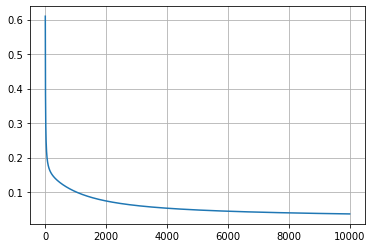

In [12]:
# Plot cost over training iterations
plot.figure()
plot.plot(cost_log)
plot.grid(True)
plot.show()

## Visualization routines

In [13]:
# Visualize data 
def vis_data(x, y = None, c='r'):
    if y is None: 
        y = [None] * len(x)
    for x_, y_ in zip(x, y):
        if y_ is None:
            plot.plot(x_[0], x_[1], 'o', markerfacecolor='none', markeredgecolor=c)
        else:
            plot.plot(x_[0], x_[1], c+'o' if y_ == 0 else c+'+')
    plot.grid('on')

# Visualize hyperplane
def vis_hyperplane(w, b, typ='k--'):

    lim0 = plot.gca().get_xlim()
    lim1 = plot.gca().get_ylim()
    m0, m1 = lim0[0], lim0[1]

    intercept0 = -(w[0] * m0 + b)/w[1]
    intercept1 = -(w[0] * m1 + b)/w[1]
    
    plt1, = plot.plot([m0, m1], [intercept0, intercept1], typ)

    plot.gca().set_xlim(lim0)
    plot.gca().set_ylim(lim1)
        
    return plt1

# Visualize decision boundary 
def vis_decision_boundary_contour(w, b, typ='k--'):
    
    lim0 = plot.gca().get_xlim()
    lim1 = plot.gca().get_ylim()
    
    x_ = numpy.linspace(lim0[0], lim0[1], 100)
    y_ = numpy.linspace(lim1[0], lim1[1], 100)
    xx, yy = numpy.meshgrid(x_, y_)
    
    x_tra_ = numpy.concatenate([xx.ravel()[:,None], yy.ravel()[:,None]], axis=1)
    
    pred = logistic_unit(x_tra_, w, b)
    plt1 = plot.contourf(xx, yy, pred.reshape(xx.shape), cmap=plot.cm.coolwarm, alpha=0.4)
    
    plot.colorbar(plt1)
    
    plot.gca().set_xlim(lim0)
    plot.gca().set_ylim(lim1)
        
    return plt1

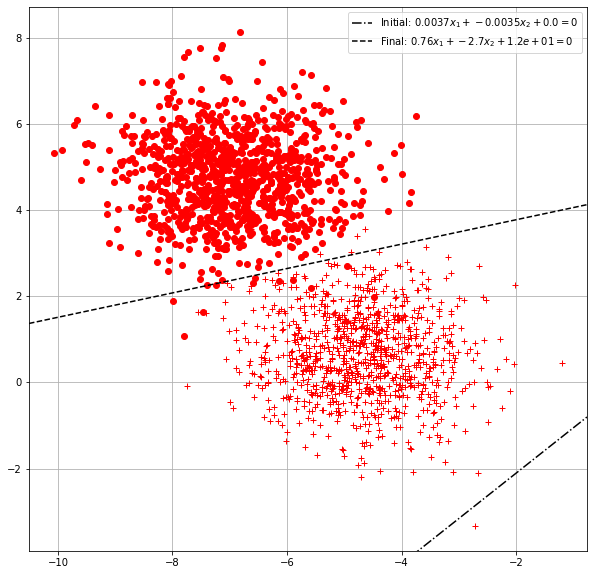

In [14]:
# Plot visualizations
plot.figure(figsize=(10,10))

vis_data(x, y, c='r')

plt0 = vis_hyperplane(w0, b0, 'k-.')
plt1 = vis_hyperplane(w, b, 'k--')
plot.legend([plt0, plt1], [
        'Initial: ${:.2} x_1 + {:.2} x_2 + {:.2} = 0$'.format(*list(w0)+[b0]),
        'Final: ${:.2} x_1 + {:.2} x_2 + {:.2} = 0$'.format(*list(w)+[b])],
           loc='best')

plot.show()

## Part 2: Learning with automatic differentiation 

**2. We use jax for automatic differentiation**

With jax, we do not need to comptue the gradient by hand and code it. This is very handy when we have huge DAG computations.
There is an active line of research in automatic differentiation, curious students are advised to read this:
http://jmlr.org/papers/volume18/17-468/17-468.pdf

## Introducing jax

Instead of writing the derivative on our own we can use the power of automatic differentiation!

Documentation: https://github.com/google/jax

Quickstart: https://jax.readthedocs.io/en/latest/notebooks/quickstart.html#Auto-vectorization-with-vmap

Helpful blog: https://colinraffel.com/blog/you-don-t-know-jax.html

In [15]:
# Install jax:
# !pip install jax
# !pip install jaxlib

import jax.numpy as numpy
from jax import grad, vmap, jit

In [16]:
# Vectorized function which returns the gradient of the distance function wrt the parameters (w,b)
# dist_grad_w_b = vmap(grad(distance_function, argnums=(2,3)), in_axes=(0, 0, None, None))
dist_grad_w_b = jit(vmap(grad(distance_function, argnums=(2,3)), in_axes=(0, 0, None, None)))


In [17]:
# It's a function! 
dist_grad_w_b

<function __main__.jit.<locals>.f_jitted(x, y, w, b)>

In [18]:
# Sanity check
dist_grad_w_b(x_train, y_train, w0, b0)[0].shape, dist_grad_w_b(x_train, y_train, w0, b0)[1].shape 

x is :
Traced<ShapedArray(float32[2])>with<BatchTrace(level=0/1)>
w is : 
Traced<ShapedArray(float32[2])>with<JVPTrace(level=2/1)>
and yet pre_sigmoid is
Traced<ShapedArray(float32[])>with<JVPTrace(level=2/1)>
finally logit is 
Traced<ShapedArray(float32[])>with<JVPTrace(level=2/1)>


/Users/owenjones/ML/jax/lib/xla_bridge.py:119: UserWarning: No GPU/TPU found, falling back to CPU.
  warnings.warn('No GPU/TPU found, falling back to CPU.')


((1500, 2), (1500,))

In [19]:
# Training loop
n_iter = 10000
eta = .0001   # Learning rate

w = numpy.array(w0)
b = numpy.array(b0)

cost_log = []

for ni in tqdm(range(n_iter)):
    dw, db = dist_grad_w_b(x_train, y_train, w, b)
    w -= eta * numpy.sum(dw, axis=0)
    b -= eta * numpy.sum(db, axis=0)

    cost = numpy.mean(distance_function(x_train, y_train, w, b))
    cost_log.append(cost)

  0%|          | 0/10000 [00:00<?, ?it/s]

x is :
Traced<ShapedArray(float32[2])>with<BatchTrace(level=0/1)>
w is : 
Traced<ShapedArray(float32[2])>with<JVPTrace(level=2/1)>
and yet pre_sigmoid is
Traced<ShapedArray(float32[])>with<JVPTrace(level=2/1)>
finally logit is 
Traced<ShapedArray(float32[])>with<JVPTrace(level=2/1)>
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07298124 -0.14796773]
and yet pre_sigmoid is
[-0.41334894 -0.2511494  -1.0482523  ... -0.29142174 -1.1648343
 -0.527222  ]
finally logit is 
[0.39810938 0.43754065 0.25956085 ... 0.42765585 0.23778997 0.37116507]


  0%|          | 17/10000 [00:00<1:00:59,  2.73it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03007091 -0.19172582]
and yet pre_sigmoid is
[-0.0559223   0.13496852 -0.59974945 ...  0.13188449 -0.6781353
 -0.06767733]
finally logit is 
[0.48602304 0.533691   0.354401   ... 0.5329234  0.3366776  0.48308712]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03173746 -0.2780205 ]
and yet pre_sigmoid is
[-0.12600379  0.1526414  -0.94115615 ...  0.14349395 -1.061743
 -0.15598044]
finally logit is 
[0.46854067 0.5380864  0.28066686 ... 0.535812   0.2569765  0.4610838 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07741865 -0.33

  0%|          | 29/10000 [00:01<31:17,  5.31it/s]  

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30792797 -0.88064843]
and yet pre_sigmoid is
[ 0.43872428  1.289276   -1.6793325  ...  1.3420019  -1.9403694
  0.5697372 ]
finally logit is 
[0.607955   0.78402466 0.15718387 ... 0.79281896 0.12560728 0.6387025 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3183143 -0.9059004]
and yet pre_sigmoid is
[ 0.45973086  1.3344307  -1.7155771  ...  1.3892817  -1.9831913
  0.59619653]
finally logit is 
[0.6129503  0.7915726  0.15244174 ... 0.80047756 0.12097905 0.64478564]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32823923 -0.930

  0%|          | 43/10000 [00:01<16:37,  9.98it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40847126 -1.1300006 ]
and yet pre_sigmoid is
[ 0.6482724   1.7375891  -2.0396266  ...  1.810505   -2.3667881
  0.83093154]
finally logit is 
[0.65662104 0.85038054 0.11510476 ... 0.8594229  0.08574058 0.69655186]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41504523 -1.1467247 ]
and yet pre_sigmoid is
[ 0.6625588   1.7679157  -2.0639389  ...  1.8421191  -2.3956342
  0.84849715]
finally logit is 
[0.6598349  0.8541983  0.1126515  ... 0.8631991  0.08350622 0.70025176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42141515 -1.1

  1%|          | 55/10000 [00:01<09:34, 17.31it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4851952 -1.3292624]
and yet pre_sigmoid is
[ 0.8213647  2.102043  -2.3300087 ...  2.1896663 -2.7121234  1.0413489]
finally logit is 
[0.69452596 0.89110154 0.08866796 ... 0.8993177  0.06226176 0.7391102 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4896621 -1.3411759]
and yet pre_sigmoid is
[ 0.83194464  2.1240828  -2.347408   ...  2.212538   -2.7328787
  1.0540295 ]
finally logit is 
[0.69676596 0.8932219  0.08727202 ... 0.9013698  0.06106091 0.74154794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.49402305 -1.3528455 ]
a

  1%|          | 68/10000 [00:01<06:00, 27.55it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5325982 -1.4579244]
and yet pre_sigmoid is
[ 0.9373646  2.3419342 -2.5180523 ...  2.4382122 -2.9368958  1.1791208]
finally logit is 
[0.718567   0.912291   0.0746023  ... 0.9196951  0.05035952 0.7647897 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5360188 -1.4674212]
and yet pre_sigmoid is
[ 0.94609284  2.3598194  -2.5319412  ...  2.4567053  -2.9535418
  1.1893709 ]
finally logit is 
[0.72032875 0.9137116  0.0736491  ... 0.9210505  0.04956938 0.7666285 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5393702 -1.4767573]
and

  1%|          | 83/10000 [00:01<04:07, 40.11it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5722149 -1.5701009]
and yet pre_sigmoid is
[ 1.0421965  2.5550482 -2.682138  ...  2.6581972 -3.1340034  1.3010694]
finally logit is 
[0.7392736  0.92791194 0.06403562 ... 0.9345144  0.04172624 0.7860149 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5748782 -1.5778342]
and yet pre_sigmoid is
[ 1.049575   2.569902  -2.6934505 ...  2.673498  -3.1476316  1.3095539]
finally logit is 
[0.74069333 0.92889917 0.06336094 ... 0.9354446  0.0411847  0.78743845]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57749385 -1.5854563 ]
and yet

  1%|          | 90/10000 [00:02<03:40, 44.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60766226 -1.6755532 ]
and yet pre_sigmoid is
[ 1.144783   2.7597036 -2.8363638 ...  2.8686047 -3.3203182  1.4177914]
finally logit is 
[0.7585567  0.9404591  0.05539048 ... 0.9462725  0.03488069 0.80499196]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.609721  -1.6818684]
and yet pre_sigmoid is
[ 1.1510735  2.7721167 -2.8455968 ...  2.881337  -3.33151    1.4248582]
finally logit is 
[0.7597069  0.9411503  0.05490937 ... 0.94691616 0.03450589 0.80609894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6117465 -1.6881052]
and yet

  1%|          | 109/10000 [00:02<02:43, 60.48it/s]

finally logit is 
[0.775361   0.9499566  0.04873176 ... 0.955074   0.02975389 0.82087725]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63856876 -1.7732483 ]
and yet pre_sigmoid is
[ 1.2442908  2.9540708 -2.979103  ...  3.0675392 -3.4939125  1.5282879]
finally logit is 
[0.77631    0.9504555  0.0483789  ... 0.95553374 0.02948594 0.82175565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64014494 -1.7784226 ]
and yet pre_sigmoid is
[ 1.2497033  2.9645166 -2.986657  ...  3.0782034 -3.5031354  1.5342162]
finally logit is 
[0.77724844 0.9509451  0.04803232 ... 0.9559847  0.02922315 0.8226224 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

  1%|▏         | 128/10000 [00:02<02:14, 73.45it/s]

finally logit is 
[0.79177064 0.9580527  0.04296547 ... 0.96249986 0.02542438 0.83577704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6648362 -1.862799 ]
and yet pre_sigmoid is
[ 1.3403631  3.1374137 -3.1096964 ...  3.2542565 -3.6539915  1.6321859]
finally logit is 
[0.79254967 0.9584099  0.04270906 ... 0.9628258  0.02523434 0.8364688 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6660254 -1.8670508]
and yet pre_sigmoid is
[ 1.3450625  3.1462655 -3.1158886 ...  3.2632456 -3.661617   1.6371937]
finally logit is 
[0.79332125 0.9587613  0.0424566  ... 0.96314615 0.02504744 0.83715266]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

  1%|▏         | 147/10000 [00:02<02:01, 80.83it/s]

finally logit is 
[0.8047428  0.9636967  0.03889344 ... 0.9676293  0.02243181 0.84711045]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6838105 -1.9334959]
and yet pre_sigmoid is
[ 1.4204191  3.2866387 -3.2125282 ...  3.405451  -3.7811298  1.7164993]
finally logit is 
[0.8054041  0.9639676  0.03869698 ... 0.9678745  0.0222888  0.8476774 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6847264 -1.9370909]
and yet pre_sigmoid is
[ 1.424608   3.2943525 -3.2177494 ...  3.4132457 -3.7876146  1.7208514]
finally logit is 
[0.80605984 0.96423453 0.03850322 ... 0.96811587 0.02214793 0.8482385 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

  2%|▏         | 167/10000 [00:02<01:57, 83.69it/s]

[0.81468976 0.96760577 0.03604921 ... 0.97115636 0.02037415 0.8555255 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69697565 -1.9874139 ]
and yet pre_sigmoid is
[ 1.4846226  3.4037976 -3.2907286 ...  3.5235972 -3.8786278  1.7825272]
finally logit is 
[0.8152698  0.967823   0.03589063 ... 0.9713518  0.02026022 0.85600865]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6977001 -1.9905453]
and yet pre_sigmoid is
[ 1.4884486  3.410705  -3.295263  ...  3.5305464 -3.8843062  1.7864153]
finally logit is 
[0.8158453  0.9680375  0.03573405 ... 0.97154456 0.02014781 0.8564872 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

  2%|▏         | 185/10000 [00:03<01:53, 86.49it/s]

[0.8249929  0.9712966  0.03334934 ... 0.97446525 0.01844549 0.8639825 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70903075 -2.0427454 ]
and yet pre_sigmoid is
[ 1.55404    3.5277832 -3.3707035 ...  3.648023  -3.979256   1.8522313]
finally logit is 
[0.8254965  0.97146803 0.03322371 ... 0.97461843 0.01835629 0.8643889 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7095725 -2.045431 ]
and yet pre_sigmoid is
[ 1.557515   3.5339134 -3.3745768 ...  3.6541574 -3.9841564  1.8556728]
finally logit is 
[0.82599646 0.9716375  0.03309952 ... 0.9747697  0.0182682  0.86479175]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

  2%|▏         | 204/10000 [00:03<01:49, 89.39it/s]

and yet pre_sigmoid is
[ 1.6109732  3.6272721 -3.4325395 ...  3.7473621 -4.0578527  1.9080276]
finally logit is 
[0.83354646 0.97410005 0.03129386 ... 0.97696334 0.01699236 0.8707974 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71755046 -2.0880592 ]
and yet pre_sigmoid is
[ 1.6141882  3.6328292 -3.4359274 ...  3.7528968 -4.0621824  1.9111402]
finally logit is 
[0.83399206 0.9742399  0.03119132 ... 0.9770876  0.01692019 0.87114716]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71795213 -2.0904    ]
and yet pre_sigmoid is
[ 1.6173894  3.6383557 -3.4392881 ...  3.7583992 -4.0664797  1.9142356]
finally logit is 
[0.8344348  0.97437817 0.03108992 ... 0.97721046 0.01684886 0.87149423]
x is :
[[-3.61780959  1.026

  2%|▏         | 224/10000 [00:03<01:50, 88.74it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7237621 -2.1276715]
and yet pre_sigmoid is
[ 1.6697943  3.7278752 -3.4926834 ...  3.847305  -4.1351347  1.9643161]
finally logit is 
[0.8415484  0.9765206  0.02952113 ... 0.97910863 0.01574853 0.8769993 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7240477 -2.1297243]
and yet pre_sigmoid is
[ 1.6727651  3.7328956 -3.495617  ...  3.852278  -4.1389284  1.9671214]
finally logit is 
[0.84194416 0.97663546 0.0294372  ... 0.9792101  0.01568983 0.87730163]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72432745 -2.1317625 ]
and yet

  2%|▏         | 243/10000 [00:03<01:49, 89.14it/s]

and yet pre_sigmoid is
[ 1.7187659  3.8098698 -3.539732  ...  3.928343  -4.1963043  2.0100873]
finally logit is 
[0.8479698  0.97832894 0.02820263 ... 0.9807035  0.01482792 0.88185215]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72805065 -2.1624928 ]
and yet pre_sigmoid is
[ 1.7215497  3.8144817 -3.5423222 ...  3.9328895 -4.199693   2.0126586]
finally logit is 
[0.8483283  0.9784265  0.02813173 ... 0.98078924 0.0147785  0.8821198 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7282389 -2.1643019]
and yet pre_sigmoid is
[ 1.7243235  3.8190718 -3.5448937 ...  3.9374127 -4.20306    2.0152178]
finally logit is 
[0.8486849  0.97852314 0.02806151 ... 0.98087436 0.01472955 0.8823856 ]
x is :
[[-3.61780959  1.02640

  3%|▎         | 263/10000 [00:04<01:46, 91.69it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73071724 -2.1932366 ]
and yet pre_sigmoid is
[ 1.769998   3.8938732 -3.5859003 ...  4.010937  -4.2570977  2.0568736]
finally logit is 
[0.8544574  0.9800402  0.02696448 ... 0.982206   0.01396555 0.88664037]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7308229 -2.194837 ]
and yet pre_sigmoid is
[ 1.7726018  3.8980932 -3.588161  ...  4.0150743 -4.260098   2.059221 ]
finally logit is 
[0.8547809  0.9801225  0.02690522 ... 0.9822781  0.01392429 0.8868761 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73092437 -2.1964269 ]
and y

  3%|▎         | 273/10000 [00:04<01:46, 91.16it/s]

and yet pre_sigmoid is
[ 1.8180292  3.9709277 -3.626258  ...  4.08628   -4.3110228  2.0996885]
finally logit is 
[0.86032945 0.98149306 0.02592557 ... 0.98347604 0.01324211 0.8908729 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73206806 -2.2233043 ]
and yet pre_sigmoid is
[ 1.8204768  3.9748092 -3.6282368 ...  4.090064  -4.3136897  2.1018424]
finally logit is 
[0.8606233  0.98156345 0.02587565 ... 0.9835374  0.01320731 0.8910821 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7320958 -2.224706 ]
and yet pre_sigmoid is
[ 1.8229165  3.9786742 -3.6302025 ...  4.093831  -4.3163404  2.103987 ]
finally logit is 
[0.8609157  0.98163325 0.02582614 ... 0.9835983  0.01317281 0.89129007]
x is :
[[-3.61780959  1.02640

  3%|▎         | 293/10000 [00:04<01:50, 88.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7320442 -2.2471862]
and yet pre_sigmoid is
[ 1.8632735  4.041967  -3.661614  ...  4.1553526 -4.3590283  2.139068 ]
finally logit is 
[0.865678   0.9827403  0.02504752 ... 0.98456174 0.01262927 0.8946428 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7320119 -2.248433 ]
and yet pre_sigmoid is
[ 1.8655841  4.045554  -3.66335   ...  4.1588297 -4.3614073  2.1410537]
finally logit is 
[0.8659465  0.98280096 0.02500516 ... 0.98461455 0.01259964 0.8948298 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73197657 -2.249672  ]
and yet

  3%|▎         | 313/10000 [00:04<01:45, 91.61it/s]

and yet pre_sigmoid is
[ 1.9016716  4.101058  -3.6895552 ...  4.2124996 -4.3976035  2.1717508]
finally logit is 
[0.8700806  0.9837144  0.02437417 ... 0.9854069  0.01215718 0.89768386]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.73101014 -2.268449  ]
and yet pre_sigmoid is
[ 1.9038739  4.1044135 -3.6911001 ...  4.2157354 -4.399755   2.1736045]
finally logit is 
[0.8703294  0.98376817 0.02433746 ... 0.9854533  0.01213137 0.89785403]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7309258 -2.26956  ]
and yet pre_sigmoid is
[ 1.9060701  4.1077557 -3.6926334 ...  4.2189584 -4.4018936  2.1754508]
finally logit is 
[0.870577   0.9838214  0.02430108 ... 0.9854994  0.01210577 0.8980232 ]
x is :
[[-3.61780959  1.02640

  3%|▎         | 333/10000 [00:04<01:44, 92.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7289671 -2.2883973]
and yet pre_sigmoid is
[ 1.9446126  4.1658134 -3.718514  ...  4.2747774 -4.4383407  2.2074852]
finally logit is 
[0.8748581  0.98472    0.02369493 ... 0.9862758  0.01167755 0.9009197 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7288349 -2.2893822]
and yet pre_sigmoid is
[ 1.9467009  4.1689267 -3.719861  ...  4.277762  -4.440257   2.2092009]
finally logit is 
[0.8750865  0.9847668  0.02366379 ... 0.98631614 0.01165545 0.90107274]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.72870046 -2.290361  ]
and yet

  4%|▎         | 352/10000 [00:05<01:51, 86.44it/s]

finally logit is 
[0.87883157 0.98551685 0.0231715  ... 0.98696196 0.01130421 0.90355945]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7260734 -2.3060875]
and yet pre_sigmoid is
[ 1.9834082  4.2230988 -3.742578  ...  4.329545  -4.4729424  2.2390203]
finally logit is 
[0.879044   0.9855584  0.02314458 ... 0.9869977  0.01128488 0.9036992 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7258997 -2.306961 ]
and yet pre_sigmoid is
[ 1.9854003  4.2260084 -3.7437584 ...  4.332319  -4.474661   2.2406206]
finally logit is 
[0.87925565 0.98559976 0.02311791 ... 0.98703325 0.01126572 0.9038384 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

  4%|▎         | 361/10000 [00:05<01:55, 83.56it/s]

[-0.7232607 -2.3186326]
and yet pre_sigmoid is
[ 2.012798   4.2657185 -3.7594664 ...  4.37008   -4.4977465  2.262433 ]
finally logit is 
[0.88213426 0.98615265 0.02276581 ... 0.98750776 0.01101146 0.9057176 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7230579 -2.3194275]
and yet pre_sigmoid is
[ 2.0147212  4.2684836 -3.7605305 ...  4.372703  -4.499327   2.2639506]
finally logit is 
[0.8823341  0.9861903  0.02274215 ... 0.9875401  0.01099426 0.90584713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7228533 -2.3202176]
and yet pre_sigmoid is
[ 2.0166395  4.2712393 -3.7615886 ...  4.375317  -4.5008993  2.2654624]
finally logit is 
[0.88253313 0.9862279  0.02271865 ... 0.9875722  0.01097718 0.90597594]
x is :


  4%|▍         | 379/10000 [00:05<02:00, 79.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7198041 -2.3307712]
and yet pre_sigmoid is
[ 2.0430489  4.3088837 -3.7756388 ...  4.4109387 -4.522008   2.2860992]
finally logit is 
[0.8852434  0.98672986 0.02240878 ... 0.98800194 0.01075035 0.9077192 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71957356 -2.33149   ]
and yet pre_sigmoid is
[ 2.0449042  4.311508  -3.776591  ...  4.413416  -4.5234537  2.2875361]
finally logit is 
[0.88543165 0.98676425 0.02238793 ... 0.98803127 0.01073499 0.90783954]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7193414 -2.3322043]
and yet

  4%|▍         | 398/10000 [00:05<01:54, 83.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7159249 -2.341744 ]
and yet pre_sigmoid is
[ 2.0722563  4.349882  -3.7900846 ...  4.4495544 -4.5442047  2.308532 ]
finally logit is 
[0.8881773  0.98725617 0.0220945  ... 0.9884511  0.01051684 0.9095812 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71566945 -2.3423936 ]
and yet pre_sigmoid is
[ 2.0740488  4.352377  -3.7909343 ...  4.4518976 -4.5455284  2.3098955]
finally logit is 
[0.88835514 0.9872875  0.02207614 ... 0.9884779  0.01050308 0.90969324]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.71541256 -2.343039  ]
and y

  4%|▍         | 416/10000 [00:05<01:54, 83.36it/s]

finally logit is 
[0.89128834 0.98779523 0.02178578 ... 0.98891    0.01028283 0.9115272 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7108302 -2.3534074]
and yet pre_sigmoid is
[ 2.1056972  4.3960066 -3.8052173 ...  4.4927635 -4.5681434  2.333714 ]
finally logit is 
[0.8914557  0.9878236  0.02176989 ... 0.9889341  0.01027063 0.911631  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7105486 -2.353983 ]
and yet pre_sigmoid is
[ 2.107422   4.398362  -3.805957  ...  4.4949636 -4.569335   2.3349986]
finally logit is 
[0.8916225  0.98785186 0.02175414 ... 0.9889581  0.01025852 0.91173446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

  4%|▍         | 435/10000 [00:06<01:48, 88.11it/s]

and yet pre_sigmoid is
[ 2.1328957  4.4328794 -3.8164194 ...  4.5271187 -4.5864525  2.3538008]
finally logit is 
[0.8940596  0.9882592  0.0215326  ... 0.9893038  0.01008617 0.91323584]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.70587236 -2.362706  ]
and yet pre_sigmoid is
[ 2.134568   4.435128  -3.8170762 ...  4.529207  -4.5875454  2.355024 ]
finally logit is 
[0.8942179  0.9882853  0.02151877 ... 0.9893259  0.01007527 0.91333276]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7055699 -2.363222 ]
and yet pre_sigmoid is
[ 2.1362371  4.43737   -3.8177283 ...  4.5312905 -4.5886316  2.3562438]
finally logit is 
[0.8943757  0.98831123 0.02150504 ... 0.98934793 0.01006444 0.91342926]
x is :
[[-3.61780959  1.02640

  5%|▍         | 455/10000 [00:06<01:43, 92.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.7002591 -2.3714964]
and yet pre_sigmoid is
[ 2.1641452  4.474539  -3.828076  ...  4.5657225 -4.6062155  2.376444 ]
finally logit is 
[0.89698327 0.98873293 0.02128838 ... 0.9897048  0.00989075 0.9150133 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6999371 -2.3719552]
and yet pre_sigmoid is
[ 2.1657598  4.476671  -3.8286436 ...  4.5676923 -4.6072006  2.3776016]
finally logit is 
[0.89713234 0.9887566  0.02127655 ... 0.98972476 0.00988111 0.91510326]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6996141 -2.3724108]
and yet p

  5%|▍         | 475/10000 [00:06<01:43, 92.46it/s]

[-0.69397384 -2.3797102 ]
and yet pre_sigmoid is
[ 2.194345   4.5140877 -3.838118  ...  4.602156  -4.6240315  2.397889 ]
finally logit is 
[0.8997406  0.9891651  0.02108015 ... 0.99006945 0.00971779 0.91666615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6936336 -2.3801143]
and yet pre_sigmoid is
[ 2.1959066  4.516114  -3.8386052 ...  4.6040173 -4.62492    2.3989863]
finally logit is 
[0.8998813  0.9891868  0.0210701  ... 0.9900877  0.00970925 0.91675   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.69329256 -2.3805158 ]
and yet pre_sigmoid is
[ 2.1974661  4.518136  -3.8390887 ...  4.605873  -4.625803   2.4000807]
finally logit is 
[0.9000218  0.9892084  0.02106013 ... 0.9901059  0.00970076 0.91683346]
x i

  5%|▍         | 496/10000 [00:06<01:39, 95.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.687363  -2.3869386]
and yet pre_sigmoid is
[ 2.2235801  4.5517178 -3.8467116 ...  4.6366186 -4.6400967  2.4182432]
finally logit is 
[0.90234715 0.9895611  0.02090354 ... 0.9904026  0.0095644  0.91820794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68700683 -2.3872936 ]
and yet pre_sigmoid is
[ 2.2250936  4.553648  -3.8471272 ...  4.6383815 -4.640897   2.419286 ]
finally logit is 
[0.9024804  0.989581   0.02089504 ... 0.9904193  0.00955683 0.9182862 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.68664986 -2.3876462 ]
and y

  5%|▌         | 506/10000 [00:06<01:42, 92.33it/s]

[-0.6800957 -2.3935878]
and yet pre_sigmoid is
[ 2.253395   4.589438  -3.8543496 ...  4.6709585 -4.6552987  2.4385958]
finally logit is 
[0.904943   0.9899436  0.02074779 ... 0.99072355 0.00942146 0.91972345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6797247 -2.3938963]
and yet pre_sigmoid is
[ 2.2548614  4.591276  -3.8546965 ...  4.6726265 -4.6560163  2.4395864]
finally logit is 
[0.90506905 0.98996186 0.02074074 ... 0.99073887 0.00941477 0.9197965 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67935306 -2.3942027 ]
and yet pre_sigmoid is
[ 2.256325   4.59311   -3.8550408 ...  4.67429   -4.6567307  2.440574 ]
finally logit is 
[0.90519476 0.98998004 0.02073375 ... 0.9907541  0.00940811 0.91986936]
x is 

  5%|▌         | 526/10000 [00:06<01:43, 91.95it/s]

finally logit is 
[0.90716076 0.9902614  0.02063101 ... 0.9909895  0.00930708 0.9210029 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.67293507 -2.3990839 ]
and yet pre_sigmoid is
[ 2.2808776  4.6236334 -3.8604047 ...  4.7019053 -4.6682787  2.4570005]
finally logit is 
[0.9072809  0.9902784  0.02062512 ... 0.99100375 0.00930109 0.9210719 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6725519 -2.3993526]
and yet pre_sigmoid is
[ 2.2823021  4.625391  -3.860694  ...  4.703491  -4.668926   2.4579453]
finally logit is 
[0.90740067 0.9902953  0.02061928 ... 0.9910178  0.00929513 0.92114055]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

  5%|▌         | 546/10000 [00:07<01:40, 94.13it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.66555625 -2.4038582 ]
and yet pre_sigmoid is
[ 2.307602   4.6563683 -3.8654058 ...  4.7313614 -4.6799707  2.474577 ]
finally logit is 
[0.90950465 0.99058855 0.02052434 ... 0.99126256 0.00919397 0.9223403 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6651624 -2.404091 ]
and yet pre_sigmoid is
[ 2.3089883  4.658053  -3.8656423 ...  4.732873  -4.6805525  2.4754803]
finally logit is 
[0.9096188  0.9906042  0.02051959 ... 0.99127567 0.00918867 0.92240494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.664768  -2.4043217]
and yet

  6%|▌         | 566/10000 [00:07<01:41, 93.40it/s]

[-0.65798706 -2.4079802 ]
and yet pre_sigmoid is
[ 2.3336215  4.6877623 -3.8694587 ...  4.759453  -4.6904993  2.4913921]
finally logit is 
[0.9116236  0.99087673 0.02044302 ... 0.9915025  0.00909856 0.9235361 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6575839 -2.4081802]
and yet pre_sigmoid is
[ 2.3349721  4.6893797 -3.8696473 ...  4.7608957 -4.691023   2.4922574]
finally logit is 
[0.91173226 0.9908914  0.02043925 ... 0.9915147  0.00909384 0.9235972 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65718025 -2.4083786 ]
and yet pre_sigmoid is
[ 2.3363214  4.6909933 -3.8698335 ...  4.762335  -4.691544   2.4931207]
finally logit is 
[0.9118408  0.9909059  0.02043552 ... 0.9915268  0.00908914 0.92365813]
x i

  6%|▌         | 586/10000 [00:07<01:41, 93.17it/s]

finally logit is 
[0.9135416  0.9911317  0.02038212 ... 0.9917143  0.0090178  0.92460865]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.65025246 -2.4115112 ]
and yet pre_sigmoid is
[ 2.358985   4.7179236 -3.8726532 ...  4.786292  -4.699971   2.507509 ]
finally logit is 
[0.91364574 0.99114543 0.02037915 ... 0.9917257  0.00901356 0.9246665 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64984125 -2.4116817 ]
and yet pre_sigmoid is
[ 2.3603032  4.7194786 -3.872799  ...  4.787672  -4.7004414  2.5083392]
finally logit is 
[0.9137497  0.991159   0.02037624 ... 0.99173707 0.00900936 0.92472434]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

  6%|▌         | 607/10000 [00:07<01:39, 94.30it/s]

[-0.6427929 -2.4143624]
and yet pre_sigmoid is
[ 2.38245    4.74545   -3.8749652 ...  4.810658  -4.7080584  2.5221846]
finally logit is 
[0.9154792  0.9913837  0.02033305 ... 0.9919233  0.0089416  0.9256825 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64237505 -2.4145076 ]
and yet pre_sigmoid is
[ 2.3837385  4.746951  -3.8750741 ...  4.811983  -4.7084837  2.522984 ]
finally logit is 
[0.9155788  0.9913966  0.02033088 ... 0.9919338  0.00893784 0.92573744]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.64195687 -2.4146516 ]
and yet pre_sigmoid is
[ 2.3850248  4.7484493 -3.8751826 ...  4.813305  -4.708908   2.5237813]
finally logit is 
[0.91567826 0.99140936 0.02032872 ... 0.99194443 0.00893408 0.9257922 ]
x i

  6%|▋         | 627/10000 [00:08<01:40, 93.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.63479877 -2.4168994 ]
and yet pre_sigmoid is
[ 2.406661   4.773485  -3.8767252 ...  4.835346  -4.7157493  2.5370965]
finally logit is 
[0.91733384 0.99161994 0.02029802 ... 0.9921186  0.00887371 0.92670184]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.634375  -2.4170203]
and yet pre_sigmoid is
[ 2.4079201  4.774933  -3.8767993 ...  4.836618  -4.7161303  2.537866 ]
finally logit is 
[0.91742927 0.9916319  0.02029654 ... 0.9921286  0.00887036 0.92675406]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6339509 -2.41714  ]
and yet

  6%|▋         | 647/10000 [00:08<01:39, 93.73it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.62669927 -2.4189963 ]
and yet pre_sigmoid is
[ 2.430336   4.8005514 -3.877854  ...  4.8590584 -4.7226496  2.55146  ]
finally logit is 
[0.91911155 0.9918419  0.02027558 ... 0.99230194 0.00881322 0.92767155]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6262704 -2.4190953]
and yet pre_sigmoid is
[ 2.431568   4.8019505 -3.8778968 ...  4.860281  -4.722992   2.5522017]
finally logit is 
[0.919203   0.9918532  0.02027473 ... 0.99231124 0.00881023 0.92772126]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6258413 -2.4191933]
and yet

  7%|▋         | 667/10000 [00:08<01:39, 93.89it/s]

[-0.6185115 -2.420695 ]
and yet pre_sigmoid is
[ 2.4535089  4.826723  -3.8784134 ...  4.881872  -4.728833   2.5653176]
finally logit is 
[0.9208176  0.99205095 0.02026447 ... 0.99247426 0.00875937 0.92859584]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6180784 -2.4207742]
and yet pre_sigmoid is
[ 2.454715   4.828077  -3.8784282 ...  4.88305   -4.7291403  2.5660336]
finally logit is 
[0.9209056  0.9920616  0.02026418 ... 0.9924831  0.00875671 0.92864335]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6176451 -2.4208524]
and yet pre_sigmoid is
[ 2.45592    4.8294287 -3.8784423 ...  4.884224  -4.729446   2.5667481]
finally logit is 
[0.9209933  0.9920723  0.0202639  ... 0.9924918  0.00875405 0.9286906 ]
x is :


  7%|▋         | 677/10000 [00:08<01:40, 92.40it/s]

and yet pre_sigmoid is
[ 2.4762092  4.852066  -3.878462  ...  4.9038568 -4.7343683  2.578706 ]
finally logit is 
[0.9224571  0.9922483  0.02026351 ... 0.9926367  0.00871144 0.9294785 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60981345 -2.4220948 ]
and yet pre_sigmoid is
[ 2.4773915  4.8533783 -3.8784518 ...  4.9049926 -4.7346435  2.5793984]
finally logit is 
[0.9225416  0.99225837 0.02026371 ... 0.992645   0.00870907 0.9295239 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6093767 -2.4221551]
and yet pre_sigmoid is
[ 2.4785724  4.8546886 -3.87844   ...  4.906126  -4.734916   2.5800896]
finally logit is 
[0.9226259  0.9922685  0.02026395 ... 0.99265325 0.00870671 0.92956907]
x is :
[[-3.61780959  1.02640

  7%|▋         | 697/10000 [00:08<01:41, 91.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6019291 -2.4230473]
and yet pre_sigmoid is
[ 2.4984672  4.876645  -3.8780508 ...  4.925079  -4.7393165  2.5916626]
finally logit is 
[0.9240343  0.99243504 0.02027167 ... 0.9927902  0.00866882 0.9303231 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.6014897 -2.4230924]
and yet pre_sigmoid is
[ 2.4996266  4.8779182 -3.8780181 ...  4.9261756 -4.739562   2.5923328]
finally logit is 
[0.92411566 0.9924447  0.02027232 ... 0.99279803 0.00866671 0.9303665 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.60105026 -2.4231365 ]
and yet

  7%|▋         | 717/10000 [00:09<01:40, 92.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.59356093 -2.423768  ]
and yet pre_sigmoid is
[ 2.5203075  4.9005146 -3.8772295 ...  4.9455957 -4.7437344  2.6042185]
finally logit is 
[0.9255532  0.99261224 0.02028799 ... 0.9929356  0.00863093 0.9311326 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5931194 -2.4237983]
and yet pre_sigmoid is
[ 2.5214458  4.901752  -3.8771753 ...  4.946657  -4.743953   2.6048687]
finally logit is 
[0.92563164 0.9926213  0.02028907 ... 0.992943   0.00862906 0.9311743 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5926778 -2.423828 ]
and yet

  7%|▋         | 736/10000 [00:09<01:47, 86.44it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5855995 -2.4242058]
and yet pre_sigmoid is
[ 2.5406346  4.922519  -3.8761086 ...  4.9644303 -4.747475   2.6157696]
finally logit is 
[0.92694175 0.9927719  0.02031028 ... 0.99306643 0.00859898 0.93186957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58515644 -2.4242237 ]
and yet pre_sigmoid is
[ 2.541754   4.9237256 -3.8760378 ...  4.965461  -4.747671   2.616402 ]
finally logit is 
[0.92701757 0.9927805  0.02031169 ... 0.9930736  0.00859731 0.93190974]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.58471334 -2.4242408 ]
and y

  8%|▊         | 754/10000 [00:09<01:53, 81.43it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57850295 -2.4244146 ]
and yet pre_sigmoid is
[ 2.5584216  4.941617  -3.8748636 ...  4.980716  -4.750473   2.6257763]
finally logit is 
[0.9281372  0.99290764 0.02033507 ... 0.99317765 0.00857346 0.9325022 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.57805896 -2.4244223 ]
and yet pre_sigmoid is
[ 2.559525   4.9427967 -3.8747783 ...  4.9817204 -4.7506495  2.626394 ]
finally logit is 
[0.92821085 0.99291587 0.02033677 ... 0.9931845  0.00857196 0.9325411 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5776149 -2.4244294]
and y

  8%|▊         | 763/10000 [00:09<01:56, 79.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5713934 -2.4244683]
and yet pre_sigmoid is
[ 2.5759578  4.960307  -3.8734047 ...  4.996602  -4.7531853  2.6355538]
finally logit is 
[0.92929816 0.993038   0.02036415 ... 0.9932846  0.00855044 0.933115  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5709487 -2.4244668]
and yet pre_sigmoid is
[ 2.5770457  4.9614625 -3.8733065 ...  4.997582  -4.7533464  2.6361578]
finally logit is 
[0.92936957 0.993046   0.02036611 ... 0.993291   0.00854907 0.93315274]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.570504 -2.424465]
and yet pre

  8%|▊         | 779/10000 [00:09<01:59, 77.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5642759 -2.4243808]
and yet pre_sigmoid is
[ 2.593253   4.978614  -3.8717537 ...  5.012111  -4.7556415  2.6451144]
finally logit is 
[0.93042606 0.99316347 0.02039712 ... 0.99338716 0.00852964 0.9337092 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5638309 -2.424371 ]
and yet pre_sigmoid is
[ 2.5943258  4.979746  -3.8716452 ...  5.013068  -4.755787   2.6457047]
finally logit is 
[0.93049556 0.9931712  0.02039929 ... 0.9933935  0.00852841 0.9337458 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.56338596 -2.4243605 ]
and yet

  8%|▊         | 795/10000 [00:10<02:03, 74.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55715525 -2.4241638 ]
and yet pre_sigmoid is
[ 2.6103177  4.9965587 -3.869928  ...  5.027268  -4.7578588  2.6544714]
finally logit is 
[0.9315227  0.9932842  0.02043363 ... 0.993486   0.00851091 0.93428606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55671024 -2.4241464 ]
and yet pre_sigmoid is
[ 2.611377   4.997669  -3.8698087 ...  5.028204  -4.7579904  2.6550498]
finally logit is 
[0.93159014 0.9932916  0.02043602 ... 0.99349207 0.0085098  0.9343216 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.55626523 -2.4241285 ]
and

  8%|▊         | 815/10000 [00:10<01:49, 83.62it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5495919 -2.4238067]
and yet pre_sigmoid is
[ 2.6282096  5.015256  -3.8678184 ...  5.0430136 -4.7599807  2.6642058]
finally logit is 
[0.93265516 0.99340785 0.0204759  ... 0.99358714 0.00849303 0.93488115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5491471 -2.4237819]
and yet pre_sigmoid is
[ 2.6292546  5.0163445 -3.8676894 ...  5.0439286 -4.7600985  2.664772 ]
finally logit is 
[0.9327208  0.9934149  0.02047849 ... 0.9935929  0.00849203 0.9349156 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5487024 -2.4237566]
and yet p

  8%|▊         | 833/10000 [00:10<01:50, 83.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5411465 -2.4232671]
and yet pre_sigmoid is
[ 2.647926   5.0357285 -3.8652763 ...  5.0602007 -4.762093   2.6748462]
finally logit is 
[0.933883   0.9935406  0.02052695 ... 0.9936957  0.00847526 0.935526  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5407024 -2.423235 ]
and yet pre_sigmoid is
[ 2.6489558  5.036794  -3.8651376 ...  5.0610943 -4.762197   2.6753995]
finally logit is 
[0.93394667 0.9935474  0.02052973 ... 0.99370134 0.00847438 0.9355593 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5402583 -2.4232023]
and yet p

  9%|▊         | 851/10000 [00:10<01:58, 77.36it/s]

[0.9348256  0.99364156 0.02056981 ... 0.9937784  0.00846273 0.9360209 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5340458 -2.42271  ]
and yet pre_sigmoid is
[ 2.6643114  5.052644  -3.8630009 ...  5.0743623 -4.763679   2.6836243]
finally logit is 
[0.9348876  0.99364823 0.02057274 ... 0.99378383 0.00846194 0.9360534 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5336024 -2.4226723]
and yet pre_sigmoid is
[ 2.665329   5.0536914 -3.862855  ...  5.075238  -4.763773   2.6841676]
finally logit is 
[0.93494946 0.99365485 0.02057569 ... 0.99378926 0.00846115 0.93608594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.7140815

  9%|▊         | 868/10000 [00:10<01:57, 77.86it/s]

finally logit is 
[0.9356848  0.9937331  0.02061163 ... 0.99385333 0.00845211 0.9364721 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.52784365 -2.422153  ]
and yet pre_sigmoid is
[ 2.678491   5.0672145 -3.8609216 ...  5.0865335 -4.7649374  2.691176 ]
finally logit is 
[0.9357455  0.9937395  0.02061468 ... 0.9938585  0.00845139 0.936504  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5274011 -2.422111 ]
and yet pre_sigmoid is
[ 2.6794982  5.0682473 -3.8607707 ...  5.0873947 -4.7650237  2.6917107]
finally logit is 
[0.935806   0.9937459  0.02061773 ... 0.9938638  0.00845066 0.9365358 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

  9%|▉         | 887/10000 [00:11<01:48, 84.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5207712 -2.4214454]
and yet pre_sigmoid is
[ 2.6945243  5.0836196 -3.8584554 ...  5.1002073 -4.766241   2.6996677]
finally logit is 
[0.9367028  0.9938407  0.02066453 ... 0.9939414  0.00844047 0.93700707]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5203298 -2.4213989]
and yet pre_sigmoid is
[ 2.6955204  5.0846367 -3.858299  ...  5.101054  -4.7663183  2.7001934]
finally logit is 
[0.9367618  0.99384695 0.0206677  ... 0.9939466  0.00843982 0.937038  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.51988846 -2.4213521 ]
and yet

  9%|▉         | 907/10000 [00:11<01:41, 89.77it/s]

[0.9377515  0.99395096 0.02072277 ... 0.9940317  0.00842949 0.9375587 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5123983 -2.4205172]
and yet pre_sigmoid is
[ 2.713334   5.102778  -3.8554192 ...  5.1161394 -4.7676225  2.7095706]
finally logit is 
[0.93780893 0.9939569  0.02072607 ... 0.9940367  0.00842892 0.937589  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5119585 -2.420466 ]
and yet pre_sigmoid is
[ 2.7143178  5.103777  -3.8552566 ...  5.1169696 -4.7676907  2.7100866]
finally logit is 
[0.9378663  0.99396294 0.02072937 ... 0.9940415  0.00842835 0.9376192 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.7140815

  9%|▉         | 917/10000 [00:11<01:40, 90.29it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5040572 -2.419505 ]
and yet pre_sigmoid is
[ 2.731906   5.1216073 -3.8522813 ...  5.131762  -4.7688427  2.7192898]
finally logit is 
[0.9388833  0.994069   0.02078985 ... 0.9941286  0.00841872 0.93815535]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5036192 -2.4194496]
and yet pre_sigmoid is
[ 2.732877   5.1225896 -3.8521142 ...  5.132576  -4.7689023  2.7197962]
finally logit is 
[0.93893903 0.99407476 0.02079325 ... 0.9941333  0.00841823 0.93818474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.5031813 -2.419394 ]
and yet p

  9%|▉         | 936/10000 [00:11<01:47, 84.21it/s]

[0.939819   0.9941659  0.02084855 ... 0.9942081  0.00841063 0.9386496 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.49618843 -2.4184787 ]
and yet pre_sigmoid is
[ 2.7492905  5.139162  -3.8492305 ...  5.146297  -4.769866   2.728339 ]
finally logit is 
[0.9398733  0.99417156 0.02085205 ... 0.9942128  0.00841019 0.93867826]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.49575227 -2.41842   ]
and yet pre_sigmoid is
[ 2.7502503  5.1401296 -3.8490593 ...  5.147097  -4.7699203  2.7288373]
finally logit is 
[0.93992746 0.9941771  0.02085554 ... 0.9942174  0.00840973 0.93870693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 10%|▉         | 953/10000 [00:11<01:59, 75.54it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48965785 -2.4175804 ]
and yet pre_sigmoid is
[ 2.763627   5.1535926 -3.8466406 ...  5.1582246 -4.770634   2.7357688]
finally logit is 
[0.9406783  0.99425465 0.020905   ... 0.99428105 0.00840378 0.93910456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4892234 -2.4175193]
and yet pre_sigmoid is
[ 2.7645779  5.154548  -3.8464675 ...  5.1590137 -4.7706842  2.7362604]
finally logit is 
[0.9407314  0.9942601  0.02090854 ... 0.9942855  0.00840336 0.93913263]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48878905 -2.417458  ]
and y

 10%|▉         | 961/10000 [00:12<02:05, 71.84it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4835864 -2.4167113]
and yet pre_sigmoid is
[ 2.7768893  5.1669073 -3.8441916 ...  5.169215  -4.771291   2.742618 ]
finally logit is 
[0.9414141  0.99433017 0.02095518 ... 0.99434316 0.00839831 0.9394951 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.48315364 -2.4166481 ]
and yet pre_sigmoid is
[ 2.7778325  5.1678534 -3.8440154 ...  5.169996  -4.7713346  2.7431042]
finally logit is 
[0.9414661  0.9943355  0.0209588  ... 0.9943475  0.00839795 0.9395228 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.482721 -2.416585]
and yet p

 10%|▉         | 977/10000 [00:12<02:08, 70.02it/s]

[ 2.790041   5.1800814 -3.8417163 ...  5.180077  -4.7718935  2.7493887]
finally logit is 
[0.94213533 0.99440396 0.02100602 ... 0.99440384 0.00839329 0.93987876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47710812 -2.4157515 ]
and yet pre_sigmoid is
[ 2.7909763  5.1810174 -3.8415384 ...  5.180848  -4.7719345  2.7498696]
finally logit is 
[0.94218624 0.99440914 0.02100968 ... 0.99440825 0.00839295 0.93990594]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47667724 -2.4156866 ]
and yet pre_sigmoid is
[ 2.7919111  5.1819525 -3.8413608 ...  5.1816187 -4.7719755  2.7503498]
finally logit is 
[0.94223714 0.9944143  0.02101333 ... 0.9944125  0.00839261 0.9399331 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 10%|▉         | 995/10000 [00:12<01:58, 76.09it/s]

[0.94284236 0.994476   0.02105743 ... 0.9944634  0.00838867 0.94025606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.47108793 -2.4148324 ]
and yet pre_sigmoid is
[ 2.8040128  5.194048  -3.8390408 ...  5.1915784 -4.772488   2.7565606]
finally logit is 
[0.94289225 0.9944811  0.02106111 ... 0.9944675  0.00838835 0.9402828 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4706589 -2.4147658]
and yet pre_sigmoid is
[ 2.8049402  5.1949735 -3.8388612 ...  5.1923404 -4.772525   2.7570357]
finally logit is 
[0.9429422  0.9944863  0.02106482 ... 0.9944718  0.00838804 0.94030946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 10%|█         | 1011/10000 [00:12<02:07, 70.27it/s]

[0.9436825  0.9945614  0.02112044 ... 0.9945339  0.00838351 0.94070584]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46381333 -2.4136908 ]
and yet pre_sigmoid is
[ 2.8197033  5.2096987 -3.8359866 ...  5.204453  -4.7731037  2.76459  ]
finally logit is 
[0.94373137 0.9945663  0.02112418 ... 0.9945379  0.00838323 0.9407321 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.46338665 -2.4136229 ]
and yet pre_sigmoid is
[ 2.8206217  5.210614  -3.8358064 ...  5.205205  -4.7731385  2.7650592]
finally logit is 
[0.94378006 0.99457127 0.0211279  ... 0.99454206 0.00838294 0.9407583 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 10%|█         | 1027/10000 [00:13<02:05, 71.45it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45870268 -2.4128711 ]
and yet pre_sigmoid is
[ 2.8306894  5.220639  -3.8338218 ...  5.2134438 -4.773509   2.770198 ]
finally logit is 
[0.9443118  0.99462515 0.02116899 ... 0.9945866  0.00837986 0.941044  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45827773 -2.4128025 ]
and yet pre_sigmoid is
[ 2.8316016  5.221547  -3.8336415 ...  5.2141895 -4.773542   2.7706633]
finally logit is 
[0.94435984 0.99463    0.02117272 ... 0.99459064 0.00837959 0.94106984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45785293 -2.4127336 ]
and

 10%|█         | 1043/10000 [00:13<02:00, 74.28it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4523437 -2.4118328]
and yet pre_sigmoid is
[ 2.844321   5.2341957 -3.8311067 ...  5.224576  -4.7739825  2.7771425]
finally logit is 
[0.9450244  0.9946971  0.02122532 ... 0.99464613 0.00837593 0.94142807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45192093 -2.4117632 ]
and yet pre_sigmoid is
[ 2.8452258  5.2350945 -3.830926  ...  5.225314  -4.7740135  2.777603 ]
finally logit is 
[0.9450714  0.9947019  0.02122908 ... 0.99465007 0.00837567 0.94145346]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.45149833 -2.4116936 ]
and y

 11%|█         | 1062/10000 [00:13<01:47, 83.48it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44559774 -2.4107125 ]
and yet pre_sigmoid is
[ 2.8587413  5.248516  -3.828208  ...  5.236326  -4.7744565  2.784473 ]
finally logit is 
[0.9457688  0.99477214 0.02128563 ... 0.9947084  0.00837199 0.941831  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4451774 -2.4106421]
and yet pre_sigmoid is
[ 2.8596385  5.249407  -3.8280268 ...  5.2370567 -4.7744856  2.7849286]
finally logit is 
[0.9458148  0.99477684 0.0212894  ... 0.99471223 0.00837175 0.94185597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.44475722 -2.4105718 ]
and y

 11%|█         | 1071/10000 [00:13<01:45, 84.58it/s]

[-0.4376379 -2.4093695]
and yet pre_sigmoid is
[ 2.8757095  5.265346  -3.824767  ...  5.250125  -4.774985   2.7930803]
finally logit is 
[0.94663256 0.994859   0.02135742 ... 0.9947805  0.0083676  0.94230074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4372205 -2.4092984]
and yet pre_sigmoid is
[ 2.876598   5.2662263 -3.824586  ...  5.2508464 -4.775012   2.793531 ]
finally logit is 
[0.94667745 0.99486345 0.02136121 ... 0.9947843  0.00836738 0.9423253 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.43680328 -2.4092274 ]
and yet pre_sigmoid is
[ 2.877486   5.2671065 -3.8244047 ...  5.251568  -4.7750382  2.7939806]
finally logit is 
[0.9467222  0.9948679  0.021365   ... 0.99478805 0.00836716 0.9423496 ]
x is 

 11%|█         | 1091/10000 [00:13<01:43, 86.29it/s]

[ 2.8925142  5.2819943 -3.821334  ...  5.2637653 -4.775484   2.8015885]
finally logit is 
[0.9474752  0.99494344 0.0214293  ... 0.9948508  0.00836346 0.9427616 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42932054 -2.4079463 ]
and yet pre_sigmoid is
[ 2.8933945  5.2828655 -3.8211536 ...  5.2644787 -4.77551    2.802034 ]
finally logit is 
[0.94751894 0.9949478  0.02143308 ... 0.99485445 0.00836325 0.9427857 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42890635 -2.407875  ]
and yet pre_sigmoid is
[ 2.8942738  5.283736  -3.8209736 ...  5.265192  -4.7755346  2.8024788]
finally logit is 
[0.94756263 0.9949522  0.02143686 ... 0.99485815 0.00836304 0.94280964]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 11%|█         | 1111/10000 [00:13<01:38, 90.11it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42230177 -2.4067345 ]
and yet pre_sigmoid is
[ 2.9082887  5.2976093 -3.8180993 ...  5.276552  -4.775941   2.8095624]
finally logit is 
[0.9482547  0.99502134 0.02149724 ... 0.99491596 0.00835968 0.9431904 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42189038 -2.4066632 ]
and yet pre_sigmoid is
[ 2.909161   5.2984724 -3.81792   ...  5.277259  -4.7759666  2.810003 ]
finally logit is 
[0.94829744 0.9950256  0.02150101 ... 0.9949195  0.00835946 0.94321394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.42147917 -2.406592  ]
and

 11%|█▏        | 1131/10000 [00:14<01:37, 91.39it/s]

[0.9490166  0.99509746 0.02156498 ... 0.99497956 0.00835598 0.9436119 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41451356 -2.4053807 ]
and yet pre_sigmoid is
[ 2.9247909  5.3139358 -3.8147058 ...  5.2899156 -4.7764115  2.8178935]
finally logit is 
[0.9490585  0.99510163 0.02156873 ... 0.9949831  0.00835577 0.94363517]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.41410536 -2.4053097 ]
and yet pre_sigmoid is
[ 2.9256554  5.3147907 -3.814528  ...  5.2906156 -4.776437   2.8183298]
finally logit is 
[0.9491002  0.99510574 0.02157249 ... 0.99498665 0.00835557 0.9436583 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 12%|█▏        | 1150/10000 [00:14<01:40, 87.90it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40719146 -2.4041035 ]
and yet pre_sigmoid is
[ 2.940289   5.329263  -3.8115182 ...  5.302459  -4.776854   2.8257103]
finally logit is 
[0.94980246 0.9951757  0.02163611 ... 0.9950453  0.00835211 0.9440494 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.4067863 -2.4040327]
and yet pre_sigmoid is
[ 2.9411464  5.330111  -3.8113415 ...  5.303152  -4.7768793  2.8261428]
finally logit is 
[0.94984335 0.9951799  0.02163985 ... 0.9950487  0.0083519  0.94407225]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40638128 -2.403962  ]
and y

 12%|█▏        | 1168/10000 [00:14<01:44, 84.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.40032673 -2.4029043 ]
and yet pre_sigmoid is
[ 2.9548078  5.343621  -3.8085346 ...  5.314205  -4.7772737  2.8330283]
finally logit is 
[0.9504903  0.9952442  0.02169935 ... 0.9951029  0.00834863 0.9444347 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39992446 -2.402834  ]
and yet pre_sigmoid is
[ 2.9556584  5.344462  -3.8083599 ...  5.3148932 -4.777298   2.833457 ]
finally logit is 
[0.95053023 0.99524814 0.02170306 ... 0.9951062  0.00834843 0.94445723]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39952236 -2.4027636 ]
and

 12%|█▏        | 1177/10000 [00:14<01:49, 80.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39391118 -2.4017842 ]
and yet pre_sigmoid is
[ 2.968371   5.3570337 -3.8057542 ...  5.3251777 -4.777674   2.8398614]
finally logit is 
[0.9511246  0.99530727 0.02175846 ... 0.99515617 0.00834532 0.9447922 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39351168 -2.4017146 ]
and yet pre_sigmoid is
[ 2.969215   5.3578687 -3.805582  ...  5.325861  -4.7777     2.8402867]
finally logit is 
[0.9511639  0.9953112  0.02176212 ... 0.9951593  0.00834511 0.9448144 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.39311236 -2.401645  ]
and

 12%|█▏        | 1195/10000 [00:14<01:53, 77.41it/s]

finally logit is 
[0.9517468  0.995369   0.02181708 ... 0.9952083  0.00834193 0.945145  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38714343 -2.4006057 ]
and yet pre_sigmoid is
[ 2.9826765  5.371184  -3.802833  ...  5.336754  -4.778109   2.847067 ]
finally logit is 
[0.9517854  0.99537295 0.02182072 ... 0.99521166 0.00834172 0.9451668 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3867469 -2.4005368]
and yet pre_sigmoid is
[ 2.9835148  5.372013  -3.8026628 ...  5.3374324 -4.778136   2.8474894]
finally logit is 
[0.95182383 0.9953767  0.02182435 ... 0.9952148  0.0083415  0.94518876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 12%|█▏        | 1211/10000 [00:15<01:56, 75.54it/s]

[0.95228165 0.9954222  0.02186793 ... 0.9952533  0.0083389  0.9454499 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38160804 -2.3996453 ]
and yet pre_sigmoid is
[ 2.9943779  5.382762  -3.8004546 ...  5.346226  -4.778478   2.8529606]
finally logit is 
[0.9523195  0.9954259  0.02187154 ... 0.9952565  0.00833867 0.9454715 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.38121396 -2.3995771 ]
and yet pre_sigmoid is
[ 2.9952106  5.3835864 -3.8002863 ...  5.3469005 -4.778505   2.8533802]
finally logit is 
[0.9523573  0.99542964 0.02187514 ... 0.9952597  0.00833845 0.94549316]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 12%|█▏        | 1228/10000 [00:15<01:53, 77.10it/s]

[-0.37610728 -2.3986952 ]
and yet pre_sigmoid is
[ 3.006009   5.3942747 -3.7981014 ...  5.355646  -4.7788568  2.858819 ]
finally logit is 
[0.95284486 0.9954781  0.02192194 ... 0.99530077 0.00833554 0.94577277]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37571567 -2.3986278 ]
and yet pre_sigmoid is
[ 3.0068374  5.395095  -3.7979345 ...  5.356317  -4.778884   2.8592362]
finally logit is 
[0.9528821  0.9954817  0.02192552 ... 0.99530387 0.00833531 0.94579417]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.37532422 -2.3985603 ]
and yet pre_sigmoid is
[ 3.0076652  5.3959146 -3.7977672 ...  5.356988  -4.778912   2.8596535]
finally logit is 
[0.95291924 0.99548537 0.02192911 ... 0.995307   0.00833508 0.9458155 ]
x

 12%|█▏        | 1245/10000 [00:15<01:50, 79.36it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3698629 -2.3976235]
and yet pre_sigmoid is
[ 3.0192175  5.4073563 -3.7954473 ...  5.366351  -4.779308   2.865473 ]
finally logit is 
[0.95343477 0.99553657 0.02197892 ... 0.9953506  0.00833181 0.94611305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36947417 -2.397557  ]
and yet pre_sigmoid is
[ 3.0200405  5.408171  -3.795282  ...  5.367018  -4.7793355  2.8658876]
finally logit is 
[0.9534713  0.9955401  0.02198248 ... 0.9953537  0.00833158 0.94613415]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36908558 -2.3974907 ]
and y

 13%|█▎        | 1264/10000 [00:15<01:45, 82.87it/s]

finally logit is 
[0.9540139  0.99559397 0.02203527 ... 0.99539953 0.00832795 0.94644916]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3632782 -2.3965027]
and yet pre_sigmoid is
[ 3.0331564  5.42117   -3.7926674 ...  5.3776584 -4.7798066  2.8724978]
finally logit is 
[0.9540497  0.99559754 0.02203876 ... 0.9954026  0.00832769 0.94646996]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.36289248 -2.3964374 ]
and yet pre_sigmoid is
[ 3.0339732  5.42198   -3.7925053 ...  5.378321  -4.7798367  2.8729095]
finally logit is 
[0.9540855  0.99560106 0.02204225 ... 0.9954057  0.00832744 0.94649094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 13%|█▎        | 1273/10000 [00:15<01:44, 83.90it/s]

[-0.35674497 -2.3954017 ]
and yet pre_sigmoid is
[ 3.0469983  5.4348993 -3.7899323 ...  5.3889    -4.7803297  2.8794773]
finally logit is 
[0.9546527  0.9956573  0.02209779 ... 0.9954537  0.00832337 0.9468225 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35636228 -2.3953376 ]
and yet pre_sigmoid is
[ 3.0478096  5.4357047 -3.7897725 ...  5.3895593 -4.7803617  2.8798866]
finally logit is 
[0.95468783 0.9956607  0.02210124 ... 0.9954568  0.00832311 0.94684315]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35597974 -2.3952734 ]
and yet pre_sigmoid is
[ 3.0486207  5.436509  -3.7896128 ...  5.3902183 -4.7803926  2.8802958]
finally logit is 
[0.95472294 0.9956642  0.02210469 ... 0.99545974 0.00832285 0.9468638 ]
x

 13%|█▎        | 1291/10000 [00:16<01:49, 79.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.35026333 -2.3943217 ]
and yet pre_sigmoid is
[ 3.060746   5.4485483 -3.7872434 ...  5.4000793 -4.7808795  2.8864138]
finally logit is 
[0.95524424 0.9957159  0.02215597 ... 0.9955041  0.00831883 0.94717073]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34988365 -2.3942587 ]
and yet pre_sigmoid is
[ 3.0615516  5.4493484 -3.7870865 ...  5.400735  -4.7809124  2.8868203]
finally logit is 
[0.9552786  0.99571925 0.02215936 ... 0.995507   0.00831856 0.94719106]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34950414 -2.394196  ]
and

 13%|█▎        | 1308/10000 [00:16<01:51, 78.17it/s]

[ 3.0727992  5.460526  -3.7849102 ...  5.409894  -4.781389   2.8924994]
finally logit is 
[0.9557567  0.99576664 0.02220657 ... 0.9955478  0.00831463 0.9474744 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34421   -2.3933253]
and yet pre_sigmoid is
[ 3.0736003  5.461323  -3.7847552 ...  5.4105463 -4.781423   2.8929043]
finally logit is 
[0.9557906  0.99577004 0.02220993 ... 0.99555075 0.00831435 0.94749457]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.34383318 -2.3932638 ]
and yet pre_sigmoid is
[ 3.0744011  5.462119  -3.7846017 ...  5.411199  -4.7814584  2.8933086]
finally logit is 
[0.9558244  0.9957734  0.02221327 ... 0.99555355 0.00831406 0.94751465]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 13%|█▎        | 1325/10000 [00:16<01:48, 79.75it/s]

and yet pre_sigmoid is
[ 3.0847826  5.4724464 -3.7826138 ...  5.4196653 -4.7819204  2.8985553]
finally logit is 
[0.9562606  0.99581665 0.02225649 ... 0.9955909  0.00831025 0.94777495]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3385765 -2.39241  ]
and yet pre_sigmoid is
[ 3.085579   5.473239  -3.782463  ...  5.420315  -4.7819576  2.8989577]
finally logit is 
[0.956294   0.9958199  0.02225977 ... 0.9955937  0.00830995 0.94779485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33820236 -2.3923497 ]
and yet pre_sigmoid is
[ 3.086375   5.4740314 -3.7823114 ...  5.4209647 -4.781994   2.89936  ]
finally logit is 
[0.95632726 0.99582326 0.02226307 ... 0.9955966  0.00830965 0.94781476]
x is :
[[-3.61780959  1.02640

 13%|█▎        | 1343/10000 [00:16<01:45, 82.02it/s]

[-0.33261177 -2.3914545 ]
and yet pre_sigmoid is
[ 3.0982804  5.4858885 -3.7800603 ...  5.430689  -4.782554   2.9053822]
finally logit is 
[0.9568218  0.9958722  0.02231212 ... 0.99563897 0.00830503 0.94811183]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33224046 -2.3913956 ]
and yet pre_sigmoid is
[ 3.0990715  5.4866767 -3.779912  ...  5.4313354 -4.7825937  2.9057822]
finally logit is 
[0.95685446 0.99587554 0.02231536 ... 0.9956418  0.0083047  0.94813156]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.33186936 -2.3913367 ]
and yet pre_sigmoid is
[ 3.0998626  5.487465  -3.7797632 ...  5.4319825 -4.782632   2.9061828]
finally logit is 
[0.95688707 0.9958787  0.02231861 ... 0.9956447  0.00830439 0.94815123]
x

 14%|█▎        | 1362/10000 [00:17<01:38, 87.36it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32632414 -2.3904634 ]
and yet pre_sigmoid is
[ 3.111692   5.4992614 -3.7775564 ...  5.4416623 -4.7832212  2.912173 ]
finally logit is 
[0.9573725  0.9959268  0.02236681 ... 0.9956864  0.00829954 0.9484449 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32595587 -2.390406  ]
and yet pre_sigmoid is
[ 3.1124778  5.500046  -3.777411  ...  5.442306  -4.783262   2.9125712]
finally logit is 
[0.9574045  0.99593    0.02236999 ... 0.9956892  0.0082992  0.9484644 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.32558778 -2.3903484 ]
and

 14%|█▍        | 1382/10000 [00:17<01:35, 90.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31935742 -2.389386  ]
and yet pre_sigmoid is
[ 3.1265798  5.5141277 -3.7748203 ...  5.453868  -4.784008   2.9197206]
finally logit is 
[0.9579759  0.99598676 0.02242672 ... 0.9957385  0.00829307 0.9488127 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31899253 -2.3893301 ]
and yet pre_sigmoid is
[ 3.1273603  5.514908  -3.7746782 ...  5.454509  -4.784051   2.920117 ]
finally logit is 
[0.95800734 0.99598986 0.02242983 ... 0.99574125 0.00829271 0.9488319 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3186278 -2.3892744]
and y

 14%|█▍        | 1392/10000 [00:17<01:39, 86.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3124546 -2.388341 ]
and yet pre_sigmoid is
[ 3.141364   5.528914  -3.7721481 ...  5.4660163 -4.7848387  2.9272268]
finally logit is 
[0.958567   0.9960454  0.02248538 ... 0.9957898  0.00828624 0.949176  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.31209308 -2.3882868 ]
and yet pre_sigmoid is
[ 3.1421394  5.5296903 -3.7720094 ...  5.466655  -4.784883   2.927621 ]
finally logit is 
[0.9585979  0.9960485  0.02248842 ... 0.9957924  0.00828587 0.949195  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.3117317 -2.388233 ]
and yet

 14%|█▍        | 1411/10000 [00:17<01:39, 86.63it/s]

[0.9590253  0.9960908  0.02253075 ... 0.99582964 0.00828059 0.94945973]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30669093 -2.387487  ]
and yet pre_sigmoid is
[ 3.1537354  5.5413055 -3.76995   ...  5.476204  -4.785573   2.933517 ]
finally logit is 
[0.9590557  0.9960939  0.02253374 ... 0.99583226 0.0082802  0.9494787 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.30633217 -2.3874345 ]
and yet pre_sigmoid is
[ 3.154506   5.542078  -3.769814  ...  5.4768395 -4.785621   2.9339085]
finally logit is 
[0.9590859  0.9960969  0.02253674 ... 0.9958348  0.00827981 0.9494974 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 14%|█▍        | 1430/10000 [00:17<01:36, 88.95it/s]

[ 3.1675677  5.555182  -3.7675328 ...  5.48762   -4.7864394  2.940559 ]
finally logit is 
[0.9595954  0.9961475  0.02258704 ... 0.9958794  0.00827309 0.9498154 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.29990482 -2.3865042 ]
and yet pre_sigmoid is
[ 3.1683335  5.555951  -3.7674007 ...  5.4882526 -4.7864895  2.9409494]
finally logit is 
[0.9596251  0.9961505  0.02258996 ... 0.99588203 0.00827268 0.949834  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2995494 -2.3864534]
and yet pre_sigmoid is
[ 3.1690993  5.55672   -3.7672687 ...  5.4888854 -4.7865386  2.9413397]
finally logit is 
[0.95965475 0.9961534  0.02259287 ... 0.9958846  0.00827228 0.9498526 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 14%|█▍        | 1449/10000 [00:18<01:34, 90.75it/s]

finally logit is 
[0.96012497 0.99620014 0.02263914 ... 0.9959258  0.00826563 0.95014846]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2935339 -2.3856046]
and yet pre_sigmoid is
[ 3.1820729  5.5697584 -3.765047  ...  5.4996204 -4.787401   2.9479563]
finally logit is 
[0.9601541  0.9962031  0.02264199 ... 0.99592835 0.0082652  0.95016676]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2931816 -2.3855555]
and yet pre_sigmoid is
[ 3.1828337  5.5705233 -3.7649179 ...  5.500251  -4.787452   2.948345 ]
finally logit is 
[0.9601831  0.9962059  0.02264485 ... 0.99593085 0.00826479 0.9501852 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 15%|█▍        | 1469/10000 [00:18<01:34, 90.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2872191 -2.3847368]
and yet pre_sigmoid is
[ 3.1957269  5.5835037 -3.762755  ...  5.5109453 -4.7883563  2.9549315]
finally logit is 
[0.9606732  0.9962547  0.02269276 ... 0.995974   0.00825738 0.9504961 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2868699 -2.3846896]
and yet pre_sigmoid is
[ 3.1964827  5.584265  -3.7626295 ...  5.5115733 -4.788411   2.955318 ]
finally logit is 
[0.9607017  0.99625754 0.02269555 ... 0.9959765  0.00825693 0.9505142 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2865209 -2.3846424]
and yet p

 15%|█▍        | 1489/10000 [00:18<01:34, 89.87it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28095993 -2.3839004 ]
and yet pre_sigmoid is
[ 3.2092953  5.597187  -3.7605233 ...  5.5222287 -4.7893558  2.9618747]
finally logit is 
[0.96118265 0.99630547 0.02274231 ... 0.99601895 0.0082492  0.95082176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.28061384 -2.3838549 ]
and yet pre_sigmoid is
[ 3.2100468  5.5979457 -3.7604012 ...  5.5228543 -4.789413   2.9622598]
finally logit is 
[0.9612106  0.9963082  0.02274502 ... 0.99602145 0.00824873 0.95083976]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2802679 -2.3838093]
and y

 15%|█▍        | 1499/10000 [00:18<01:39, 85.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27475604 -2.3830957 ]
and yet pre_sigmoid is
[ 3.2227807  5.610811  -3.7583528 ...  5.533471  -4.7904     2.9687877]
finally logit is 
[0.96168256 0.9963553  0.0227906  ... 0.9960633  0.00824066 0.95114404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27441302 -2.3830519 ]
and yet pre_sigmoid is
[ 3.2235277  5.6115665 -3.758233  ...  5.5340953 -4.7904587  2.969171 ]
finally logit is 
[0.96171016 0.996358   0.02279327 ... 0.9960658  0.00824018 0.9511618 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.27407014 -2.3830082 ]
and

 15%|█▌        | 1517/10000 [00:18<01:43, 82.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26894727 -2.382365  ]
and yet pre_sigmoid is
[ 3.2354417  5.6236253 -3.7563581 ...  5.544054  -4.7914267  2.9752893]
finally logit is 
[0.9621464  0.9964014  0.02283507 ... 0.9961046  0.00823227 0.9514452 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2686071 -2.3823228]
and yet pre_sigmoid is
[ 3.2361846  5.6243777 -3.7562418 ...  5.544676  -4.7914877  2.9756715]
finally logit is 
[0.9621735  0.9964042  0.02283766 ... 0.99610704 0.00823178 0.9514629 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2682671 -2.3822808]
and yet

 15%|█▌        | 1534/10000 [00:19<01:47, 78.64it/s]

finally logit is 
[0.96254903 0.99644166 0.02287337 ... 0.99614054 0.00822461 0.9517086 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.26352447 -2.3817031 ]
and yet pre_sigmoid is
[ 3.247292   5.6356397 -3.7545304 ...  5.5539837 -4.7924294  2.9813852]
finally logit is 
[0.9625756  0.9964443  0.02287588 ... 0.9961429  0.00822409 0.9517261 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.263187  -2.3816626]
and yet pre_sigmoid is
[ 3.2480307  5.636389  -3.754417  ...  5.554603  -4.7924933  2.9817655]
finally logit is 
[0.96260226 0.996447   0.02287842 ... 0.99614525 0.00822357 0.9517435 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 16%|█▌        | 1553/10000 [00:19<01:39, 85.07it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25847936 -2.3811054 ]
and yet pre_sigmoid is
[ 3.2583456  5.6468635 -3.7528586 ...  5.5632668 -4.7934012  2.9870806]
finally logit is 
[0.96297187 0.9964838  0.02291328 ... 0.9961784  0.00821617 0.951987  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25814432 -2.3810663 ]
and yet pre_sigmoid is
[ 3.2590804  5.6476107 -3.7527485 ...  5.5638847 -4.7934666  2.9874597]
finally logit is 
[0.962998   0.9964864  0.02291575 ... 0.9961808  0.00821564 0.9520043 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25780946 -2.3810275 ]
and

 16%|█▌        | 1572/10000 [00:19<01:35, 87.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2521422 -2.3803802]
and yet pre_sigmoid is
[ 3.272267   5.6610255 -3.750803  ...  5.574989  -4.7946777  2.994266 ]
finally logit is 
[0.96346503 0.99653304 0.02295935 ... 0.99622273 0.00820577 0.9523144 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2518103 -2.380343 ]
and yet pre_sigmoid is
[ 3.2729979  5.6617694 -3.7506962 ...  5.575605  -4.7947454  2.9946437]
finally logit is 
[0.9634907  0.99653566 0.02296175 ... 0.9962251  0.00820522 0.9523316 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.25147858 -2.3803058 ]
and yet

 16%|█▌        | 1592/10000 [00:19<01:32, 90.61it/s]

[-0.24619313 -2.3797255 ]
and yet pre_sigmoid is
[ 3.2853775  5.674388  -3.7489152 ...  5.5860586 -4.7959313  3.0010467]
finally logit is 
[0.96392375 0.996579   0.02300174 ... 0.9962643  0.00819558 0.9526214 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24586417 -2.37969   ]
and yet pre_sigmoid is
[ 3.2861032  5.675129  -3.7488122 ...  5.586673  -4.796002   3.0014224]
finally logit is 
[0.96394897 0.9965815  0.02300405 ... 0.99626654 0.008195   0.95263827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.24553537 -2.3796546 ]
and yet pre_sigmoid is
[ 3.2868295  5.6758695 -3.7487087 ...  5.5872865 -4.796073   3.0017986]
finally logit is 
[0.96397424 0.99658394 0.02300638 ... 0.99626875 0.00819443 0.95265526]
x

 16%|█▌        | 1613/10000 [00:19<01:31, 92.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23997052 -2.3790686 ]
and yet pre_sigmoid is
[ 3.2991333  5.6884365 -3.7469869 ...  5.597707  -4.7973027  3.0081754]
finally logit is 
[0.96439904 0.9966266  0.02304511 ... 0.9963074  0.00818444 0.9529421 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23964463 -2.379035  ]
and yet pre_sigmoid is
[ 3.2998552  5.6891747 -3.7468867 ...  5.598319  -4.797376   3.0085502]
finally logit is 
[0.9644239  0.99662906 0.02304737 ... 0.9963096  0.00818384 0.95295894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23931889 -2.3790016 ]
and

 16%|█▌        | 1623/10000 [00:20<01:32, 91.03it/s]

finally logit is 
[0.9648655  0.9966732  0.02308707 ... 0.9963498  0.00817291 0.95325947]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23348317 -2.3784153 ]
and yet pre_sigmoid is
[ 3.3135228  5.703163  -3.7450285 ...  5.609929  -4.7988005  3.0156484]
finally logit is 
[0.96488976 0.9966757  0.02308924 ... 0.9963521  0.00817229 0.95327604]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.23316047 -2.3783836 ]
and yet pre_sigmoid is
[ 3.31424    5.7038975 -3.7449322 ...  5.610539  -4.798877   3.0160213]
finally logit is 
[0.9649141  0.9966781  0.02309141 ... 0.9963542  0.00817167 0.9532927 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 16%|█▋        | 1642/10000 [00:20<01:35, 87.27it/s]

[0.9652995  0.9967167  0.02312556 ... 0.99638945 0.00816164 0.95355713]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22769867 -2.37786   ]
and yet pre_sigmoid is
[ 3.326396   5.7163644 -3.7433267 ...  5.6208944 -4.8001933  3.022348 ]
finally logit is 
[0.9653234  0.9967192  0.02312766 ... 0.9963916  0.00816101 0.9535736 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2273788 -2.37783  ]
and yet pre_sigmoid is
[ 3.327109   5.7170963 -3.7432332 ...  5.621503  -4.8002715  3.0227199]
finally logit is 
[0.9653472  0.99672157 0.02312977 ... 0.99639386 0.00816037 0.9535901 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 17%|█▋        | 1660/10000 [00:20<01:38, 84.36it/s]

finally logit is 
[0.9657023  0.9967572  0.02316077 ... 0.9964264  0.0081507  0.95383555]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22228217 -2.377364  ]
and yet pre_sigmoid is
[ 3.3384867  5.728787  -3.7417722 ...  5.6312222 -4.8015494  3.0286527]
finally logit is 
[0.9657258  0.9967595  0.02316281 ... 0.99642867 0.00815004 0.95385194]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.22196496 -2.3773355 ]
and yet pre_sigmoid is
[ 3.339196  5.729516 -3.741683 ...  5.631829 -4.80163   3.029023]
finally logit is 
[0.96574926 0.9967618  0.02316483 ... 0.99643075 0.00814939 0.9538682 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.438

 17%|█▋        | 1678/10000 [00:20<01:43, 80.16it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21754023 -2.3769488 ]
and yet pre_sigmoid is
[ 3.3491015  5.7397118 -3.7404432 ...  5.6403112 -4.8027773  3.0341976]
finally logit is 
[0.9660755  0.99679464 0.02319289 ... 0.99646086 0.00814012 0.95409536]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21722534 -2.376922  ]
and yet pre_sigmoid is
[ 3.3498077  5.7404394 -3.7403564 ...  5.640917  -4.8028603  3.0345669]
finally logit is 
[0.9660985  0.9967969  0.02319486 ... 0.996463   0.00813945 0.9541116 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2169106 -2.376895 ]
and y

 17%|█▋        | 1695/10000 [00:20<01:45, 78.50it/s]

[-0.21283287 -2.3765547 ]
and yet pre_sigmoid is
[ 3.3596673  5.7506037 -3.7391524 ...  5.6493797 -4.8040347  3.0397258]
finally logit is 
[0.96642005 0.9968292  0.02322216 ... 0.9964927  0.00812997 0.9543369 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21252027 -2.3765292 ]
and yet pre_sigmoid is
[ 3.36037    5.7513285 -3.7390685 ...  5.6499834 -4.8041196  3.040094 ]
finally logit is 
[0.96644276 0.9968315  0.02322406 ... 0.9964947  0.00812929 0.954353  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.21220784 -2.3765037 ]
and yet pre_sigmoid is
[ 3.3610725  5.7520533 -3.7389832 ...  5.650587  -4.804204   3.040462 ]
finally logit is 
[0.9664656  0.99683386 0.02322599 ... 0.99649686 0.00812861 0.95436895]
x

 17%|█▋        | 1704/10000 [00:21<01:42, 80.75it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20784953 -2.3761573 ]
and yet pre_sigmoid is
[ 3.3708835  5.762185  -3.7378187 ...  5.6590285 -4.8054075  3.0456047]
finally logit is 
[0.96678215 0.9968656  0.02325243 ... 0.9965262  0.00811891 0.95459247]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20753936 -2.3761332 ]
and yet pre_sigmoid is
[ 3.3715825  5.762908  -3.7377367 ...  5.6596313 -4.8054943  3.0459716]
finally logit is 
[0.9668045  0.99686784 0.02325429 ... 0.9965283  0.00811821 0.9546083 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20722935 -2.3761094 ]
and

 17%|█▋        | 1722/10000 [00:21<01:42, 80.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20290488 -2.3757837 ]
and yet pre_sigmoid is
[ 3.3820446  5.77373   -3.7365294 ...  5.668655  -4.806814   3.0514653]
finally logit is 
[0.9671387  0.9969015  0.02328173 ... 0.9965593  0.00810759 0.9548457 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.20259713 -2.375761  ]
and yet pre_sigmoid is
[ 3.3827405  5.7744503 -3.7364492 ...  5.6692557 -4.806902   3.0518312]
finally logit is 
[0.96716076 0.9969037  0.02328355 ... 0.99656147 0.00810688 0.95486146]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.2022895 -2.3757386]
and y

 17%|█▋        | 1740/10000 [00:21<01:38, 84.28it/s]

[-0.19738784 -2.375391  ]
and yet pre_sigmoid is
[ 3.3945363  5.7866745 -3.7351284 ...  5.679456  -4.8084335  3.058037 ]
finally logit is 
[0.96753335 0.99694115 0.02331361 ... 0.99659616 0.00809458 0.95512825]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19708274 -2.37537   ]
and yet pre_sigmoid is
[ 3.3952284  5.787392  -3.7350526 ...  5.6800556 -4.8085246  3.0584016]
finally logit is 
[0.9675551  0.9969434  0.02331533 ... 0.9965983  0.00809385 0.9551438 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19677779 -2.375349  ]
and yet pre_sigmoid is
[ 3.3959203  5.78811   -3.7349753 ...  5.680655  -4.808615   3.0587664]
finally logit is 
[0.96757674 0.99694556 0.02331709 ... 0.99660033 0.00809312 0.9551595 ]
x

 18%|█▊        | 1758/10000 [00:21<01:35, 86.64it/s]

[-0.19191843 -2.3750272 ]
and yet pre_sigmoid is
[ 3.4069602  5.799573  -3.7337813 ...  5.690229  -4.8100934  3.0645866]
finally logit is 
[0.9679213  0.99698025 0.0233443  ... 0.9966325  0.00808126 0.9554081 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19161595 -2.3750079 ]
and yet pre_sigmoid is
[ 3.407648   5.800288  -3.7337089 ...  5.6908264 -4.810188   3.0649493]
finally logit is 
[0.9679427  0.9969824  0.02334595 ... 0.99663454 0.0080805  0.95542353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.19131364 -2.3749886 ]
and yet pre_sigmoid is
[ 3.4083362  5.8010035 -3.733635  ...  5.691424  -4.810281   3.0653126]
finally logit is 
[0.96796405 0.99698466 0.02334764 ... 0.9966365  0.00807976 0.9554391 ]
x

 18%|█▊        | 1776/10000 [00:21<01:35, 86.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1864963 -2.3746922]
and yet pre_sigmoid is
[ 3.4193165  5.812426  -3.7324882 ...  5.700972  -4.811794   3.0711129]
finally logit is 
[0.96830285 0.9970188  0.0233738  ... 0.9966684  0.00806764 0.9556853 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18619645 -2.3746743 ]
and yet pre_sigmoid is
[ 3.420001   5.813139  -3.7324176 ...  5.701568  -4.811889   3.0714748]
finally logit is 
[0.96832377 0.9970209  0.02337541 ... 0.9966704  0.00806688 0.95570064]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18589672 -2.3746567 ]
and y

 18%|█▊        | 1795/10000 [00:22<01:32, 88.57it/s]

finally logit is 
[0.9686572  0.99705446 0.02340062 ... 0.9967019  0.00805451 0.95594484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18112084 -2.3743856 ]
and yet pre_sigmoid is
[ 3.4316063  5.825235  -3.7312465 ...  5.711687  -4.8135333  3.0776174]
finally logit is 
[0.9686779  0.9970566  0.02340216 ... 0.9967038  0.00805373 0.95596   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.18082356 -2.3743694 ]
and yet pre_sigmoid is
[ 3.4322872  5.825945  -3.7311797 ...  5.712281  -4.8136315  3.077978 ]
finally logit is 
[0.96869844 0.99705863 0.02340369 ... 0.99670583 0.00805295 0.9559751 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 18%|█▊        | 1813/10000 [00:22<01:33, 87.41it/s]

[0.9690263  0.99709177 0.0234279  ... 0.9967368  0.00804033 0.95621705]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17579147 -2.3741066 ]
and yet pre_sigmoid is
[ 3.4438305  5.837999  -3.7300563 ...  5.7223735 -4.815311   3.0840998]
finally logit is 
[0.9690466  0.9970938  0.02342938 ... 0.99673873 0.00803954 0.9562321 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17549674 -2.3740919 ]
and yet pre_sigmoid is
[ 3.444508   5.8387065 -3.729991  ...  5.722966  -4.8154106  3.0844595]
finally logit is 
[0.969067   0.9970958  0.02343087 ... 0.99674064 0.00803875 0.9562471 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 18%|█▊        | 1832/10000 [00:22<01:32, 88.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17079996 -2.3738685 ]
and yet pre_sigmoid is
[ 3.4553165  5.8500137 -3.7289786 ...  5.7324405 -4.8170247  3.0902026]
finally logit is 
[0.96938926 0.9971284  0.02345405 ... 0.9967713  0.00802589 0.95648676]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1705076 -2.373855 ]
and yet pre_sigmoid is
[ 3.4559906  5.8507195 -3.7289162 ...  5.733032  -4.8171263  3.0905612]
finally logit is 
[0.9694093  0.99713045 0.02345548 ... 0.9967732  0.00802508 0.9565017 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.17021537 -2.373842  ]
and y

 19%|█▊        | 1851/10000 [00:22<01:31, 88.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16555853 -2.3736422 ]
and yet pre_sigmoid is
[ 3.4674153  5.8626924 -3.7278843 ...  5.743072  -4.8188744  3.0966432]
finally logit is 
[0.9697463  0.9971644  0.02347913 ... 0.9968053  0.00801118 0.956754  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16526864 -2.3736305 ]
and yet pre_sigmoid is
[ 3.4680855  5.8633957 -3.727826  ...  5.743662  -4.8189783  3.0970004]
finally logit is 
[0.9697659  0.99716645 0.02348046 ... 0.9968072  0.00801035 0.9567689 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1649789 -2.3736188]
and y

 19%|█▊        | 1870/10000 [00:22<01:30, 90.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16036154 -2.3734426 ]
and yet pre_sigmoid is
[ 3.4794502  5.8753276 -3.72684   ...  5.7536755 -4.82076    3.1030624]
finally logit is 
[0.9700974  0.9972     0.02350308 ... 0.9968389  0.00799621 0.95701885]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.16007411 -2.3734324 ]
and yet pre_sigmoid is
[ 3.480117   5.8760285 -3.7267842 ...  5.754264  -4.820866   3.1034184]
finally logit is 
[0.97011673 0.9972019  0.02350436 ... 0.9968407  0.00799536 0.9570336 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15978682 -2.3734221 ]
and

 19%|█▉        | 1890/10000 [00:23<01:27, 92.30it/s]

and yet pre_sigmoid is
[ 3.4914231  5.88792   -3.725843  ...  5.764251  -4.82268    3.1094606]
finally logit is 
[0.9704428  0.997235   0.02352598 ... 0.9968721  0.00798099 0.9572813 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.15492319 -2.37326   ]
and yet pre_sigmoid is
[ 3.492086   5.888618  -3.7257895 ...  5.7648377 -4.8227887  3.1098151]
finally logit is 
[0.9704617  0.99723685 0.0235272  ... 0.99687386 0.00798013 0.95729584]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1546383 -2.3732512]
and yet pre_sigmoid is
[ 3.492749   5.889316  -3.7257357 ...  5.7654243 -4.822897   3.11017  ]
finally logit is 
[0.9704808  0.99723876 0.02352844 ... 0.99687576 0.00797927 0.9573103 ]
x is :
[[-3.61780959  1.02640

 19%|█▉        | 1900/10000 [00:23<01:29, 90.37it/s]

[ 3.5039923  5.901165  -3.7248425 ...  5.775384  -4.8247466  3.1161904]
finally logit is 
[0.9708011  0.99727124 0.02354897 ... 0.9969066  0.00796464 0.95755565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14953305 -2.373106  ]
and yet pre_sigmoid is
[ 3.504652   5.9018607 -3.7247915 ...  5.775969  -4.8248568  3.1165442]
finally logit is 
[0.9708199  0.99727315 0.02355014 ... 0.99690837 0.00796377 0.9575701 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14925069 -2.3730986 ]
and yet pre_sigmoid is
[ 3.5053117  5.9025564 -3.72474   ...  5.776554  -4.8249655  3.116898 ]
finally logit is 
[0.97083855 0.99727505 0.02355133 ... 0.9969103  0.00796291 0.95758444]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 19%|█▉        | 1920/10000 [00:23<01:29, 90.05it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14447065 -2.3729863 ]
and yet pre_sigmoid is
[ 3.5164938  5.914363  -3.7238936 ...  5.7864866 -4.8268514  3.1228979]
finally logit is 
[0.97115344 0.99730694 0.0235708  ... 0.99694073 0.00794803 0.95782745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14419064 -2.3729804 ]
and yet pre_sigmoid is
[ 3.51715    5.9150567 -3.723845  ...  5.7870703 -4.826962   3.1232505]
finally logit is 
[0.9711718  0.99730873 0.02357192 ... 0.99694246 0.00794716 0.9578417 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.14391075 -2.3729744 ]
and

 19%|█▉        | 1940/10000 [00:23<01:36, 83.30it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13917261 -2.3728864 ]
and yet pre_sigmoid is
[ 3.5289268  5.927514  -3.7229953 ...  5.797558  -4.8289914  3.129582 ]
finally logit is 
[0.97149974 0.99734205 0.02359148 ... 0.99697423 0.00793117 0.95809656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13889505 -2.372882  ]
and yet pre_sigmoid is
[ 3.5295796  5.928205  -3.722949  ...  5.79814   -4.8291044  3.1299334]
finally logit is 
[0.97151774 0.99734384 0.02359255 ... 0.996976   0.00793028 0.9581107 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1386176 -2.3728774]
and y

 19%|█▉        | 1949/10000 [00:23<01:43, 77.51it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1352984 -2.3728302]
and yet pre_sigmoid is
[ 3.538045   5.937174  -3.7223654 ...  5.805696  -4.830592   3.1344922]
finally logit is 
[0.97175103 0.99736744 0.023606   ... 0.99699867 0.00791859 0.95829326]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13502264 -2.3728266 ]
and yet pre_sigmoid is
[ 3.5386953  5.937863  -3.7223206 ...  5.806277  -4.8307066  3.1348426]
finally logit is 
[0.971769   0.9973693  0.02360703 ... 0.9970004  0.00791769 0.95830727]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13474698 -2.3728232 ]
and y

 20%|█▉        | 1965/10000 [00:24<02:13, 60.32it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13199748 -2.3727934 ]
and yet pre_sigmoid is
[ 3.5458322  5.945434  -3.7218456 ...  5.812659  -4.831979   3.1386912]
finally logit is 
[0.97196406 0.99738914 0.02361798 ... 0.99701935 0.0079077  0.9584608 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13172323 -2.3727908 ]
and yet pre_sigmoid is
[ 3.54648    5.9461217 -3.7218027 ...  5.8132386 -4.832095   3.139041 ]
finally logit is 
[0.97198176 0.9973909  0.02361897 ... 0.99702114 0.00790679 0.9584747 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.13144909 -2.3727882 ]
and

 20%|█▉        | 1972/10000 [00:24<02:34, 52.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12926053 -2.3727708 ]
and yet pre_sigmoid is
[ 3.552301   5.952303  -3.7214274 ...  5.8184514 -4.8331456  3.1421833]
finally logit is 
[0.97213984 0.9974069  0.02362763 ... 0.9970366  0.00789855 0.95859957]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12898752 -2.3727689 ]
and yet pre_sigmoid is
[ 3.552947   5.952989  -3.7213864 ...  5.8190303 -4.833263   3.1425323]
finally logit is 
[0.97215724 0.9974087  0.02362857 ... 0.99703836 0.00789763 0.95861346]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12871464 -2.372767  ]
and

 20%|█▉        | 1978/10000 [00:24<03:08, 42.59it/s]

[ 3.5581074  5.958474  -3.7210631 ...  5.8236575 -4.834204   3.145321 ]
finally logit is 
[0.97229666 0.9974228  0.02363603 ... 0.99705195 0.00789026 0.9587239 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12653606 -2.3727553 ]
and yet pre_sigmoid is
[ 3.5587513  5.959159  -3.7210236 ...  5.8242354 -4.834322   3.145669 ]
finally logit is 
[0.972314   0.9974246  0.02363694 ... 0.9970536  0.00788934 0.95873773]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1262643 -2.372754 ]
and yet pre_sigmoid is
[ 3.5593953  5.9598436 -3.7209835 ...  5.8248134 -4.83444    3.1460173]
finally logit is 
[0.97233135 0.99742633 0.02363787 ... 0.9970553  0.00788842 0.9587515 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 20%|█▉        | 1994/10000 [00:24<03:00, 44.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12409465 -2.3727474 ]
and yet pre_sigmoid is
[ 3.5645413  5.9653187 -3.7206702 ...  5.829434  -4.8353887  3.1488008]
finally logit is 
[0.97246945 0.99744034 0.0236451  ... 0.99706894 0.007881   0.9588615 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12382401 -2.372747  ]
and yet pre_sigmoid is
[ 3.565184   5.9660025 -3.7206311 ...  5.8300114 -4.835508   3.1491487]
finally logit is 
[0.97248656 0.9974421  0.023646   ... 0.99707055 0.00788006 0.9588751 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12355348 -2.3727465 ]
and

 20%|██        | 2004/10000 [00:25<02:52, 46.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1213937 -2.3727455]
and yet pre_sigmoid is
[ 3.5709577  5.972151  -3.7202907 ...  5.835202  -4.8365827  3.1522748]
finally logit is 
[0.9726407  0.9974578  0.02365386 ... 0.99708575 0.00787167 0.95899826]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.12112429 -2.3727458 ]
and yet pre_sigmoid is
[ 3.5715983  5.972833  -3.7202535 ...  5.835778  -4.836703   3.152622 ]
finally logit is 
[0.97265774 0.9974595  0.02365472 ... 0.9970874  0.00787073 0.959012  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.120855 -2.372746]
and yet p

 20%|██        | 2009/10000 [00:25<03:10, 42.05it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11870503 -2.3727505 ]
and yet pre_sigmoid is
[ 3.5773563  5.97897   -3.719923  ...  5.840962  -4.8377857  3.155743 ]
finally logit is 
[0.9728105  0.99747497 0.02366236 ... 0.9971023  0.00786228 0.95913446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11843681 -2.3727515 ]
and yet pre_sigmoid is
[ 3.5779953  5.9796515 -3.7198873 ...  5.8415375 -4.8379064  3.1560895]
finally logit is 
[0.9728273  0.99747664 0.02366318 ... 0.997104   0.00786134 0.95914805]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11816872 -2.3727524 ]
and

 20%|██        | 2026/10000 [00:25<02:24, 55.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1157614 -2.372764 ]
and yet pre_sigmoid is
[ 3.5843735  5.9864564 -3.7195344 ...  5.8472877 -4.8391204  3.15955  ]
finally logit is 
[0.9729954  0.99749374 0.02367134 ... 0.9971206  0.00785187 0.9592834 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11549453 -2.3727658 ]
and yet pre_sigmoid is
[ 3.5850105  5.9871364 -3.7195    ...  5.8478622 -4.8392425  3.1598957]
finally logit is 
[0.97301215 0.9974955  0.02367213 ... 0.9971222  0.00785092 0.9592969 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11522778 -2.3727674 ]
and y

 20%|██        | 2042/10000 [00:25<02:11, 60.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11150577 -2.3727982 ]
and yet pre_sigmoid is
[ 3.5945425  5.9973183 -3.718995  ...  5.8564706 -4.8410788  3.165074 ]
finally logit is 
[0.97326136 0.99752074 0.02368381 ... 0.9971468  0.00783663 0.9594985 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1112408 -2.3728008]
and yet pre_sigmoid is
[ 3.5951767  5.9979963 -3.7189617 ...  5.8570437 -4.841202   3.165419 ]
finally logit is 
[0.97327787 0.9975224  0.02368457 ... 0.99714845 0.00783568 0.95951194]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.11097594 -2.3728037 ]
and y

 21%|██        | 2056/10000 [00:25<02:03, 64.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10728052 -2.3728492 ]
and yet pre_sigmoid is
[ 3.604666   6.0081472 -3.7184868 ...  5.865631  -4.8430605  3.1705825]
finally logit is 
[0.97352356 0.9975473  0.02369556 ... 0.9971727  0.00782124 0.9597121 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10701744 -2.372853  ]
and yet pre_sigmoid is
[ 3.6052973  6.0088234 -3.7184563 ...  5.866203  -4.8431854  3.170926 ]
finally logit is 
[0.9735398  0.997549   0.02369627 ... 0.9971744  0.00782027 0.9597253 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10675447 -2.3728569 ]
and

 21%|██        | 2063/10000 [00:26<02:09, 61.38it/s]

finally logit is 
[0.9737017  0.9975655  0.02370322 ... 0.9971904  0.00781057 0.9598579 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1041313 -2.3728988]
and yet pre_sigmoid is
[ 3.6122296  6.0162487 -3.7181263 ...  5.872488  -4.8445616  3.1747031]
finally logit is 
[0.9737178 0.9975672 0.0237039 ... 0.9971921 0.0078096 0.9598712]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10386962 -2.3729033 ]
and yet pre_sigmoid is
[ 3.612859   6.016923  -3.7180972 ...  5.873059  -4.844687   3.1750464]
finally logit is 
[0.97373396 0.9975688  0.02370457 ... 0.99719363 0.00780863 0.95988435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810

 21%|██        | 2076/10000 [00:26<02:35, 50.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10178044 -2.372942  ]
and yet pre_sigmoid is
[ 3.6178858  6.022312  -3.7178674 ...  5.877622  -4.845694   3.177788 ]
finally logit is 
[0.9738622  0.99758184 0.02370989 ... 0.9972064  0.00780083 0.95998985]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.1015198 -2.372947 ]
and yet pre_sigmoid is
[ 3.6185136  6.0229855 -3.7178383 ...  5.8781924 -4.8458204  3.1781309]
finally logit is 
[0.9738781  0.9975834  0.02371057 ... 0.99720794 0.00779985 0.960003  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.10125927 -2.3729522 ]
and y

 21%|██        | 2090/10000 [00:26<02:19, 56.73it/s]

and yet pre_sigmoid is
[ 3.6229014  6.0276933 -3.7176456 ...  5.8821797 -4.8467073  3.1805255]
finally logit is 
[0.9739896  0.9975948  0.02371503 ... 0.9972191  0.00779299 0.96009487]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09943894 -2.3729904 ]
and yet pre_sigmoid is
[ 3.6235275  6.0283656 -3.717618  ...  5.882749  -4.846835   3.1808674]
finally logit is 
[0.9740054  0.9975963  0.02371567 ... 0.99722064 0.007792   0.9601079 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09917935 -2.372996  ]
and yet pre_sigmoid is
[ 3.6241536  6.029038  -3.7175908 ...  5.883319  -4.8469615  3.1812096]
finally logit is 
[0.97402126 0.997598   0.0237163  ... 0.9972222  0.00779102 0.96012104]
x is :
[[-3.61780959  1.026

 21%|██        | 2106/10000 [00:26<02:04, 63.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09581505 -2.3730755 ]
and yet pre_sigmoid is
[ 3.6322765  6.0377617 -3.717248  ...  5.8907113 -4.8486204  3.1856484]
finally logit is 
[0.974226   0.99761873 0.02372424 ... 0.99724257 0.00777821 0.9602906 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09555704 -2.3730822 ]
and yet pre_sigmoid is
[ 3.6328998  6.038432  -3.7172236 ...  5.891279  -4.8487487  3.185989 ]
finally logit is 
[0.9742416  0.9976204  0.0237248  ... 0.99724424 0.00777722 0.9603036 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09529917 -2.3730888 ]
and

 21%|██        | 2114/10000 [00:26<01:59, 65.73it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09195709 -2.3731806 ]
and yet pre_sigmoid is
[ 3.6416125  6.047802  -3.716878  ...  5.8992233 -4.8505526  3.1907566]
finally logit is 
[0.97445935 0.99764246 0.02373281 ... 0.99726593 0.00776331 0.96048486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0917008 -2.373188 ]
and yet pre_sigmoid is
[ 3.6422336  6.04847   -3.7168536 ...  5.89979   -4.850682   3.1910968]
finally logit is 
[0.97447485 0.9976441  0.02373337 ... 0.9972675  0.00776232 0.96049786]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.09144461 -2.3731956 ]
and y

 21%|██▏       | 2132/10000 [00:27<01:45, 74.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08761521 -2.3733158 ]
and yet pre_sigmoid is
[ 3.6521478  6.0591464 -3.7164874 ...  5.908847  -4.852761   3.1965296]
finally logit is 
[0.97472024 0.99766904 0.02374186 ... 0.997292   0.00774632 0.96070343]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08736081 -2.3733244 ]
and yet pre_sigmoid is
[ 3.6527658  6.0598125 -3.716466  ...  5.909412  -4.852892   3.1968687]
finally logit is 
[0.9747355  0.9976706  0.02374236 ... 0.99729353 0.00774531 0.96071625]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08710652 -2.373333  ]
and

 21%|██▏       | 2149/10000 [00:27<01:43, 76.01it/s]

[0.9749774  0.99769515 0.02375014 ... 0.99731785 0.00772918 0.96092016]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0830529 -2.3734782]
and yet pre_sigmoid is
[ 3.6632493  6.0711193 -3.7161107 ...  5.9190097 -4.855126   3.202623 ]
finally logit is 
[0.97499233 0.9976967  0.02375059 ... 0.9973194  0.00772816 0.9609329 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.08280049 -2.3734877 ]
and yet pre_sigmoid is
[ 3.6638646  6.071783  -3.7160907 ...  5.919574  -4.8552575  3.202961 ]
finally logit is 
[0.9750074  0.99769825 0.02375105 ... 0.99732083 0.00772715 0.96094555]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 22%|██▏       | 2166/10000 [00:27<01:41, 76.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07927804 -2.373628  ]
and yet pre_sigmoid is
[ 3.6724591  6.0810657 -3.7158232 ...  5.9274573 -4.857114   3.207685 ]
finally logit is 
[0.975216   0.99771947 0.02375726 ... 0.9973418  0.00771293 0.9611225 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07902727 -2.3736384 ]
and yet pre_sigmoid is
[ 3.6730719  6.0817275 -3.715805  ...  5.92802   -4.8572474  3.208022 ]
finally logit is 
[0.97523075 0.997721   0.02375768 ... 0.99734336 0.00771191 0.961135  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07877661 -2.373649  ]
and

 22%|██▏       | 2183/10000 [00:27<01:40, 77.71it/s]

[0.97543675 0.99774194 0.02376342 ... 0.9973641  0.00769762 0.96131074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07527838 -2.3738017 ]
and yet pre_sigmoid is
[ 3.6822438  6.091646  -3.71554   ...  5.9364486 -4.85925    3.2130718]
finally logit is 
[0.9754514  0.9977435  0.02376383 ... 0.99736553 0.0076966  0.9613232 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07502928 -2.3738132 ]
and yet pre_sigmoid is
[ 3.6828535  6.0923057 -3.7155242 ...  5.9370093 -4.859386   3.2134073]
finally logit is 
[0.97546595 0.9977449  0.02376419 ... 0.9973671  0.00769556 0.9613357 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 22%|██▏       | 2202/10000 [00:28<01:32, 83.97it/s]

[0.9756835  0.9977671  0.02376967 ... 0.997389   0.00768014 0.9615223 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07105884 -2.3740022 ]
and yet pre_sigmoid is
[ 3.692591   6.1028504 -3.7152724 ...  5.945975  -4.861543   3.2187748]
finally logit is 
[0.97569793 0.9977685  0.02377003 ... 0.99739045 0.00767911 0.96153474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.07081158 -2.3740146 ]
and yet pre_sigmoid is
[ 3.6931982  6.1035085 -3.7152581 ...  5.9465346 -4.8616786  3.2191098]
finally logit is 
[0.97571236 0.99776995 0.02377037 ... 0.99739194 0.00767808 0.9615471 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 22%|██▏       | 2220/10000 [00:28<01:33, 82.79it/s]

[0.975941   0.9977932  0.02377559 ... 0.99741507 0.00766151 0.96174455]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06662418 -2.374232  ]
and yet pre_sigmoid is
[ 3.7034981  6.1146774 -3.7150192 ...  5.9560375 -4.863991   3.224797 ]
finally logit is 
[0.9759552  0.99779475 0.02377591 ... 0.9974165  0.00766048 0.9617569 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06637878 -2.3742454 ]
and yet pre_sigmoid is
[ 3.7041025  6.1153336 -3.7150059 ...  5.956596  -4.864127   3.2251308]
finally logit is 
[0.9759694  0.9977962  0.02377622 ... 0.9974179  0.00765944 0.9617691 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 22%|██▏       | 2238/10000 [00:28<01:37, 79.87it/s]

[ 3.7125463  6.1245027 -3.7148352 ...  5.964401  -4.866049   3.229799 ]
finally logit is 
[0.97616667 0.9978162  0.02378018 ... 0.99743795 0.00764485 0.9619404 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06271032 -2.3744512 ]
and yet pre_sigmoid is
[ 3.713148   6.1251564 -3.7148237 ...  5.9649577 -4.866187   3.2301319]
finally logit is 
[0.9761806  0.99781764 0.02378045 ... 0.9974394  0.0076438  0.9619525 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.06246662 -2.3744652 ]
and yet pre_sigmoid is
[ 3.71375    6.12581   -3.7148118 ...  5.965514  -4.866324   3.2304647]
finally logit is 
[0.97619456 0.99781907 0.02378073 ... 0.9974408  0.00764276 0.9619648 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 22%|██▏       | 2247/10000 [00:28<01:39, 77.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05906575 -2.3746684 ]
and yet pre_sigmoid is
[ 3.722156   6.1349497 -3.7146616 ...  5.973298  -4.8682585  3.2351184]
finally logit is 
[0.9763892  0.9978389  0.02378421 ... 0.9974606  0.0076281  0.9621347 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0588236 -2.3746831]
and yet pre_sigmoid is
[ 3.722756   6.135602  -3.7146506 ...  5.9738536 -4.8683963  3.235451 ]
finally logit is 
[0.976403   0.9978403  0.02378447 ... 0.99746203 0.00762706 0.9621468 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05858153 -2.3746982 ]
and y

 23%|██▎       | 2266/10000 [00:28<01:34, 82.22it/s]

and yet pre_sigmoid is
[ 3.731729   6.1453695 -3.7145114 ...  5.9821773 -4.870483   3.2404258]
finally logit is 
[0.9766088  0.9978612  0.0237877  ... 0.9974831  0.00761128 0.96232754]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.0549623 -2.374929 ]
and yet pre_sigmoid is
[ 3.7323258  6.14602   -3.7145023 ...  5.9827313 -4.8706226  3.240757 ]
finally logit is 
[0.97662246 0.99786264 0.02378791 ... 0.99748445 0.00761023 0.9623395 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05472182 -2.3749447 ]
and yet pre_sigmoid is
[ 3.7329226  6.14667   -3.7144938 ...  5.9832854 -4.870762   3.2410882]
finally logit is 
[0.9766361  0.99786395 0.02378811 ... 0.99748576 0.00760918 0.96235156]
x is :
[[-3.61780959  1.02640

 23%|██▎       | 2285/10000 [00:29<01:28, 87.53it/s]

[-0.05088785 -2.3752043 ]
and yet pre_sigmoid is
[ 3.742448   6.157053  -3.7143736 ...  5.9921384 -4.873007   3.246376 ]
finally logit is 
[0.9768524  0.997886   0.0237909  ... 0.9975079  0.00759224 0.9625427 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05064908 -2.375221  ]
and yet pre_sigmoid is
[ 3.743042   6.157701  -3.7143674 ...  5.9926906 -4.8731484  3.246706 ]
finally logit is 
[0.9768659  0.9978873  0.02379104 ... 0.99750924 0.00759118 0.9625546 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.05041043 -2.3752377 ]
and yet pre_sigmoid is
[ 3.743636   6.1583486 -3.7143607 ...  5.993243  -4.8732886  3.247036 ]
finally logit is 
[0.9768793  0.99788874 0.0237912  ... 0.9975107  0.00759012 0.9625665 ]
x

 23%|██▎       | 2304/10000 [00:29<01:26, 89.40it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04636846 -2.3755286 ]
and yet pre_sigmoid is
[ 3.7537067  6.169341  -3.7142591 ...  6.0026207 -4.8756905  3.2526352]
finally logit is 
[0.97710574 0.99791175 0.02379356 ... 0.9975338  0.00757205 0.96276766]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04613156 -2.3755462 ]
and yet pre_sigmoid is
[ 3.754298   6.169987  -3.7142549 ...  6.003172  -4.875832   3.2529643]
finally logit is 
[0.9771189  0.99791306 0.02379366 ... 0.9975352  0.00757099 0.96277946]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04589476 -2.3755639 ]
and

 23%|██▎       | 2324/10000 [00:29<01:24, 90.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04188397 -2.3758702 ]
and yet pre_sigmoid is
[ 3.7649097  6.1815863 -3.714178  ...  6.0130725 -4.878395   3.258873 ]
finally logit is 
[0.97735494 0.9979372  0.02379544 ... 0.9975594  0.00755175 0.9629907 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04164892 -2.3758886 ]
and yet pre_sigmoid is
[ 3.7654977  6.1822295 -3.7141743 ...  6.013622  -4.878537   3.2592006]
finally logit is 
[0.977368   0.99793845 0.02379553 ... 0.99756074 0.00755069 0.96300226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.04141398 -2.3759072 ]
and

 23%|██▎       | 2344/10000 [00:29<01:24, 90.34it/s]

and yet pre_sigmoid is
[ 3.7754717  6.1931467 -3.7141309 ...  6.0229454 -4.8809752  3.2647624]
finally logit is 
[0.9775875  0.9979608  0.02379654 ... 0.99758327 0.00753244 0.9632    ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03743453 -2.376229  ]
and yet pre_sigmoid is
[ 3.7760568  6.1937876 -3.7141294 ...  6.0234933 -4.8811197  3.265089 ]
finally logit is 
[0.9776004  0.9979621  0.02379657 ... 0.9975847  0.00753136 0.9632115 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03720132 -2.3762484 ]
and yet pre_sigmoid is
[ 3.776642   6.1944284 -3.7141275 ...  6.0240407 -4.8812637  3.2654154]
finally logit is 
[0.97761315 0.9979634  0.02379662 ... 0.997586   0.00753028 0.9632231 ]
x is :
[[-3.61780959  1.026

 24%|██▎       | 2364/10000 [00:29<01:24, 90.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03348265 -2.376564  ]
and yet pre_sigmoid is
[ 3.785984   6.2046676 -3.7141109 ...  6.03279   -4.883573   3.2706327]
finally logit is 
[0.97781676 0.99798405 0.02379701 ... 0.9976069  0.00751305 0.9634075 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03325104 -2.376584  ]
and yet pre_sigmoid is
[ 3.7865665  6.205306  -3.71411   ...  6.033336  -4.883718   3.2709582]
finally logit is 
[0.97782934 0.99798536 0.02379703 ... 0.9976082  0.00751196 0.9634189 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.03301952 -2.3766043 ]
and

 24%|██▎       | 2374/10000 [00:30<01:24, 90.11it/s]

and yet pre_sigmoid is
[ 3.796447   6.2161493 -3.714119  ...  6.042607  -4.8861885  3.2764833]
finally logit is 
[0.9780425  0.9980071  0.02379682 ... 0.99763024 0.00749357 0.96361315]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02909805 -2.376954  ]
and yet pre_sigmoid is
[ 3.797027   6.2167864 -3.71412   ...  6.043152  -4.8863344  3.276808 ]
finally logit is 
[0.97805506 0.9980083  0.02379679 ... 0.99763155 0.00749248 0.96362454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02886822 -2.376975  ]
and yet pre_sigmoid is
[ 3.797607   6.2174234 -3.7141213 ...  6.0436964 -4.88648    3.2771325]
finally logit is 
[0.97806746 0.9980096  0.02379676 ... 0.99763286 0.0074914  0.9636359 ]
x is :
[[-3.61780959  1.026

 24%|██▍       | 2394/10000 [00:30<01:23, 91.43it/s]

[0.9782774  0.99803096 0.02379596 ... 0.9976546  0.00747294 0.9638284 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02474675 -2.3773596 ]
and yet pre_sigmoid is
[ 3.8080163  6.2288623 -3.7141585 ...  6.053482  -4.889113   3.2829623]
finally logit is 
[0.97828966 0.99803215 0.0237959  ... 0.99765587 0.00747185 0.96383965]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02451865 -2.3773813 ]
and yet pre_sigmoid is
[ 3.8085933  6.2294965 -3.714161  ...  6.0540247 -4.8892593  3.2832856]
finally logit is 
[0.9783019  0.99803346 0.02379584 ... 0.99765706 0.00747076 0.963851  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 24%|██▍       | 2414/10000 [00:30<01:22, 92.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02065493 -2.377758  ]
and yet pre_sigmoid is
[ 3.8183777  6.240263  -3.7142215 ...  6.0632396 -4.8917603  3.288773 ]
finally logit is 
[0.97850865 0.9980545  0.02379443 ... 0.9976786  0.00745224 0.9640416 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02042845 -2.3777807 ]
and yet pre_sigmoid is
[ 3.8189518  6.2408953 -3.7142258 ...  6.063781  -4.8919086  3.2890952]
finally logit is 
[0.97852063 0.9980557  0.02379433 ... 0.9976799  0.00745114 0.9640528 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.02020207 -2.3778033 ]
and

 24%|██▍       | 2433/10000 [00:30<01:29, 84.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01659237 -2.37817   ]
and yet pre_sigmoid is
[ 3.8286903  6.251624  -3.7143106 ...  6.072968  -4.8944244  3.2945638]
finally logit is 
[0.9787244  0.9980763  0.02379236 ... 0.997701   0.00743256 0.96424186]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01636751 -2.3781934 ]
and yet pre_sigmoid is
[ 3.829262   6.252254  -3.7143168 ...  6.073508  -4.8945737  3.294885 ]
finally logit is 
[0.97873634 0.99807763 0.02379222 ... 0.9977022  0.00743146 0.96425295]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01614275 -2.3782167 ]
and

 25%|██▍       | 2451/10000 [00:30<01:33, 80.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01322889 -2.3785236 ]
and yet pre_sigmoid is
[ 3.837248   6.2610626 -3.7144046 ...  6.081054  -4.8966575  3.2993748]
finally logit is 
[0.9789019  0.9980944  0.02379018 ... 0.99771947 0.00741611 0.9644073 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01300538 -2.3785474 ]
and yet pre_sigmoid is
[ 3.8378174  6.2616906 -3.7144108 ...  6.0815926 -4.896806   3.299695 ]
finally logit is 
[0.97891366 0.9980956  0.02379004 ... 0.99772066 0.00741501 0.96441835]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.01278195 -2.3785713 ]
and

 25%|██▍       | 2460/10000 [00:31<01:35, 78.91it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00966301 -2.37891   ]
and yet pre_sigmoid is
[ 3.8463407  6.2711005 -3.7145214 ...  6.0896573 -4.899047   3.3044925]
finally logit is 
[0.97908884 0.9981134  0.02378747 ... 0.99773896 0.00739854 0.96458256]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00944087 -2.3789346 ]
and yet pre_sigmoid is
[ 3.8469076  6.271727  -3.7145295 ...  6.090194  -4.899197   3.3048115]
finally logit is 
[0.9791005  0.9981146  0.02378728 ... 0.99774015 0.00739743 0.9645935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00921884 -2.3789592 ]
and

 25%|██▍       | 2478/10000 [00:31<01:35, 78.52it/s]

[ 3.855396   6.281109  -3.7146587 ...  6.0982385 -4.9014482  3.3095946]
finally logit is 
[0.97927344 0.99813217 0.02378428 ... 0.9977582  0.00738092 0.9647565 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00589866 -2.3793318 ]
and yet pre_sigmoid is
[ 3.8559606  6.281733  -3.7146678 ...  6.098774  -4.9015985  3.3099132]
finally logit is 
[0.9792849  0.99813336 0.02378407 ... 0.99775934 0.00737982 0.9647674 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00567799 -2.379357  ]
and yet pre_sigmoid is
[ 3.856525   6.282357  -3.7146773 ...  6.0993094 -4.90175    3.310231 ]
finally logit is 
[0.9792964  0.9981345  0.02378385 ... 0.99776053 0.00737871 0.9647781 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 25%|██▍       | 2494/10000 [00:31<01:37, 76.83it/s]

finally logit is 
[0.9794444  0.9981495  0.02378091 ... 0.9977761  0.00736438 0.9649183 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-0.00259786 -2.3797133 ]
and yet pre_sigmoid is
[ 3.8644142  6.291086  -3.7148142 ...  6.106797  -4.903861   3.3146818]
finally logit is 
[0.9794557  0.99815065 0.02378067 ... 0.9977773  0.00736327 0.96492904]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[-2.3784887e-03 -2.3797390e+00]
and yet pre_sigmoid is
[ 3.8649766  6.2917085 -3.7148252 ...  6.1073313 -4.904012   3.314999 ]
finally logit is 
[0.97946703 0.99815184 0.02378042 ... 0.9977785  0.00736216 0.96493983]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.084379

 25%|██▌       | 2510/10000 [00:31<01:39, 75.43it/s]

[ 3.8722756  6.2997923 -3.7149658 ...  6.1142683 -4.90598    3.3191211]
finally logit is 
[0.9796133  0.9981667  0.02377715 ... 0.9977938  0.00734779 0.96507895]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 6.837833e-04 -2.380103e+00]
and yet pre_sigmoid is
[ 3.872836   6.300413  -3.7149768 ...  6.114801  -4.906132   3.3194375]
finally logit is 
[0.9796245  0.99816775 0.0237769  ... 0.997795   0.00734669 0.9650896 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 9.0188161e-04 -2.3801293e+00]
and yet pre_sigmoid is
[ 3.8733962  6.301034  -3.7149882 ...  6.1153336 -4.906284   3.3197541]
finally logit is 
[0.9796357  0.99816895 0.02377663 ... 0.9977962  0.00734558 0.96510035]
x is :
[[-3.61780959  1.02640984]
 [-3.4

 25%|██▌       | 2526/10000 [00:31<01:38, 76.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00372959 -2.3804743 ]
and yet pre_sigmoid is
[ 3.8806677  6.3090944 -3.7151427 ...  6.1222534 -4.908259   3.3238645]
finally logit is 
[0.97978026 0.99818355 0.02377305 ... 0.9978114  0.00733119 0.9652385 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00394652 -2.380501  ]
and yet pre_sigmoid is
[ 3.8812258  6.3097134 -3.7151542 ...  6.122785  -4.9084115  3.3241801]
finally logit is 
[0.97979134 0.99818474 0.02377278 ... 0.9978124  0.00733008 0.96524906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00416336 -2.3805277 ]
and

 25%|██▌       | 2542/10000 [00:32<01:41, 73.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00719056 -2.380907  ]
and yet pre_sigmoid is
[ 3.8895845  6.318988  -3.7153478 ...  6.1307497 -4.9106994  3.3289099]
finally logit is 
[0.97995615 0.9982015  0.02376829 ... 0.99782974 0.00731345 0.9654074 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00740617 -2.3809345 ]
and yet pre_sigmoid is
[ 3.8901405  6.3196054 -3.7153616 ...  6.13128   -4.9108524  3.3292248]
finally logit is 
[0.97996706 0.99820256 0.02376796 ... 0.9978309  0.00731234 0.9654179 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.00762169 -2.380962  ]
and

 26%|██▌       | 2550/10000 [00:32<01:53, 65.69it/s]

finally logit is 
[0.9801082  0.9982169  0.02376378 ... 0.99784577 0.00729792 0.9655542 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01041608 -2.381321  ]
and yet pre_sigmoid is
[ 3.8979113  6.3282356 -3.7155566 ...  6.138695  -4.912996   3.3336265]
finally logit is 
[0.9801191  0.998218   0.02376344 ... 0.99784696 0.0072968  0.9655646 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01063046 -2.3813488 ]
and yet pre_sigmoid is
[ 3.8984652  6.328851  -3.715571  ...  6.1392236 -4.9131494  3.3339403]
finally logit is 
[0.98012984 0.9982191  0.02376311 ... 0.99784803 0.00729569 0.9655749 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 26%|██▌       | 2564/10000 [00:32<01:59, 62.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01276985 -2.3816292 ]
and yet pre_sigmoid is
[ 3.9039981  6.335001  -3.7157183 ...  6.144509  -4.9146833  3.3370771]
finally logit is 
[0.9802373  0.99823004 0.02375969 ... 0.9978594  0.00728459 0.9656791 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01298335 -2.3816574 ]
and yet pre_sigmoid is
[ 3.9045508  6.335615  -3.715733  ...  6.1450367 -4.9148374  3.3373904]
finally logit is 
[0.98024803 0.9982311  0.02375935 ... 0.9978605  0.00728347 0.9656894 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01319678 -2.3816857 ]
and

 26%|██▌       | 2571/10000 [00:32<02:04, 59.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01511386 -2.3819418 ]
and yet pre_sigmoid is
[ 3.9100678  6.341752  -3.715889  ...  6.150312  -4.916378   3.3405204]
finally logit is 
[0.9803546  0.9982419  0.02375573 ... 0.99787176 0.00727234 0.9657931 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01532646 -2.3819704 ]
and yet pre_sigmoid is
[ 3.9106188  6.342365  -3.7159042 ...  6.150839  -4.9165316  3.340833 ]
finally logit is 
[0.98036516 0.998243   0.02375538 ... 0.9978728  0.00727123 0.9658034 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01553899 -2.381999  ]
and

 26%|██▌       | 2585/10000 [00:32<02:01, 61.25it/s]

[ 3.9166706  6.3491006 -3.716083  ...  6.156631  -4.9182296  3.344269 ]
finally logit is 
[0.9804813  0.9982547  0.02375123 ... 0.99788505 0.00725899 0.9659167 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01787147 -2.3823164 ]
and yet pre_sigmoid is
[ 3.9172196  6.3497124 -3.7161002 ...  6.157157  -4.918384   3.344581 ]
finally logit is 
[0.98049176 0.9982558  0.02375084 ... 0.99788624 0.00725787 0.96592695]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.01808303 -2.3823454 ]
and yet pre_sigmoid is
[ 3.9177687  6.3503237 -3.716117  ...  6.1576824 -4.918539   3.3448925]
finally logit is 
[0.9805023  0.99825686 0.02375045 ... 0.9978873  0.00725676 0.9659372 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 26%|██▌       | 2592/10000 [00:32<01:59, 62.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0206156 -2.3826962]
and yet pre_sigmoid is
[ 3.9243486  6.357653  -3.7163205 ...  6.163987  -4.9203954  3.3486319]
finally logit is 
[0.9806277  0.99826956 0.02374573 ... 0.9979006  0.0072434  0.96606   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02082614 -2.3827257 ]
and yet pre_sigmoid is
[ 3.924896   6.358263  -3.716339  ...  6.1645117 -4.9205503  3.3489428]
finally logit is 
[0.98063815 0.99827063 0.02374529 ... 0.9979017  0.00724228 0.96607023]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02103661 -2.3827553 ]
and y

 26%|██▌       | 2605/10000 [00:33<02:39, 46.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02166748 -2.382844  ]
and yet pre_sigmoid is
[ 3.9270842  6.360702  -3.7164092 ...  6.1666102 -4.9211717  3.350187 ]
finally logit is 
[0.98067963 0.9982748  0.02374367 ... 0.9979061  0.00723782 0.96611094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02187762 -2.3828735 ]
and yet pre_sigmoid is
[ 3.9276311  6.3613114 -3.7164268 ...  6.167135  -4.9213257  3.3504982]
finally logit is 
[0.98068994 0.9982759  0.02374326 ... 0.99790716 0.00723671 0.9661212 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02208769 -2.382903  ]
and

 26%|██▌       | 2611/10000 [00:33<02:35, 47.59it/s]

and yet pre_sigmoid is
[ 3.9320004  6.3661833 -3.7165723 ...  6.1713266 -4.922569   3.3529835]
finally logit is 
[0.9807725  0.99828416 0.02373989 ... 0.9979159  0.00722778 0.96620244]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02376539 -2.3831415 ]
and yet pre_sigmoid is
[ 3.9325457  6.3667912 -3.71659   ...  6.17185   -4.922724   3.3532937]
finally logit is 
[0.9807828  0.99828523 0.02373948 ... 0.997917   0.00722667 0.9662125 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02397475 -2.3831716 ]
and yet pre_sigmoid is
[ 3.9330912  6.3673997 -3.7166085 ...  6.172374  -4.9228797  3.353604 ]
finally logit is 
[0.9807931  0.9982863  0.02373905 ... 0.99791807 0.00722555 0.96622264]
x is :
[[-3.61780959  1.026

 26%|██▌       | 2617/10000 [00:33<02:33, 48.08it/s]

and yet pre_sigmoid is
[ 3.9379933  6.372869  -3.7167778 ...  6.177081  -4.92428    3.356394 ]
finally logit is 
[0.9808852  0.9982957  0.02373513 ... 0.9979278  0.00721551 0.9663136 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02606408 -2.3834727 ]
and yet pre_sigmoid is
[ 3.9385376  6.3734765 -3.7167964 ...  6.1776037 -4.924436   3.356704 ]
finally logit is 
[0.98089546 0.9982967  0.0237347  ... 0.99792886 0.0072144  0.96632373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02627258 -2.383503  ]
and yet pre_sigmoid is
[ 3.9390817  6.3740835 -3.7168155 ...  6.1781263 -4.9245915  3.357014 ]
finally logit is 
[0.98090565 0.99829775 0.02373426 ... 0.99792993 0.00721328 0.96633375]
x is :
[[-3.61780959  1.026

 26%|██▋       | 2630/10000 [00:33<02:58, 41.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02668937 -2.3835635 ]
and yet pre_sigmoid is
[ 3.940169   6.375297  -3.7168531 ...  6.179171  -4.924903   3.357633 ]
finally logit is 
[0.980926   0.9982998  0.02373338 ... 0.9979322  0.00721105 0.9663539 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02689765 -2.3835938 ]
and yet pre_sigmoid is
[ 3.9407125  6.3759036 -3.7168727 ...  6.179693  -4.925059   3.3579426]
finally logit is 
[0.98093617 0.99830085 0.02373293 ... 0.99793327 0.00720994 0.9663639 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02710585 -2.383624  ]
and

 26%|██▋       | 2644/10000 [00:34<02:23, 51.39it/s]

[ 3.9461398  6.381964  -3.7170691 ...  6.184911  -4.92662    3.3610344]
finally logit is 
[0.9810373  0.99831104 0.02372838 ... 0.99794394 0.00719877 0.96646434]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.02918366 -2.38393   ]
and yet pre_sigmoid is
[ 3.946682   6.38257   -3.7170887 ...  6.1854324 -4.926776   3.3613434]
finally logit is 
[0.98104745 0.9983121  0.02372793 ... 0.997945   0.00719766 0.96647435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.029391  -2.3839607]
and yet pre_sigmoid is
[ 3.9472241  6.3831754 -3.7171087 ...  6.185954  -4.9269323  3.3616524]
finally logit is 
[0.9810575  0.99831307 0.02372746 ... 0.9979461  0.00719654 0.96648437]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 27%|██▋       | 2656/10000 [00:34<02:13, 54.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03187325 -2.3843317 ]
and yet pre_sigmoid is
[ 3.9537163  6.39043   -3.7173524 ...  6.1922016 -4.9288087  3.365354 ]
finally logit is 
[0.9811778  0.9983253  0.02372182 ... 0.9979589  0.00718315 0.966604  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03207962 -2.384363  ]
and yet pre_sigmoid is
[ 3.9542565  6.391034  -3.7173734 ...  6.1927223 -4.928966   3.3656623]
finally logit is 
[0.98118776 0.99832624 0.02372133 ... 0.99796    0.00718202 0.966614  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03228591 -2.3843942 ]
and

 27%|██▋       | 2671/10000 [00:34<01:55, 63.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03434462 -2.3847075 ]
and yet pre_sigmoid is
[ 3.9601898  6.397669  -3.7176056 ...  6.1984377 -4.930691   3.3690476]
finally logit is 
[0.98129696 0.99833727 0.02371595 ... 0.9979715  0.00716974 0.9667231 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03455007 -2.384739  ]
and yet pre_sigmoid is
[ 3.9607284  6.398271  -3.7176266 ...  6.198957  -4.930848   3.369355 ]
finally logit is 
[0.9813068  0.99833834 0.02371547 ... 0.99797255 0.00716862 0.966733  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03475545 -2.3847704 ]
and

 27%|██▋       | 2686/10000 [00:34<01:51, 65.48it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03741862 -2.3851826 ]
and yet pre_sigmoid is
[ 3.9682548  6.4066935 -3.7179322 ...  6.206215  -4.933048   3.373653 ]
finally logit is 
[0.9814445  0.9983523  0.02370839 ... 0.99798715 0.00715298 0.96687096]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03762296 -2.3852146 ]
and yet pre_sigmoid is
[ 3.968791   6.4072943 -3.717955  ...  6.2067323 -4.933206   3.3739593]
finally logit is 
[0.9814542  0.99835324 0.02370786 ... 0.9979882  0.00715185 0.96688074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.03782721 -2.3852465 ]
and

 27%|██▋       | 2693/10000 [00:34<01:50, 66.06it/s]

[ 0.04027256 -2.3856318 ]
and yet pre_sigmoid is
[ 3.9757555  6.415094  -3.718248  ...  6.2134557 -4.9352527  3.37794  ]
finally logit is 
[0.98158056 0.99836606 0.02370109 ... 0.99800164 0.00713734 0.96700794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04047587 -2.385664  ]
and yet pre_sigmoid is
[ 3.9762905  6.4156933 -3.7182708 ...  6.2139726 -4.93541    3.378246 ]
finally logit is 
[0.9815902  0.998367   0.02370056 ... 0.9980027  0.00713622 0.9670177 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04067912 -2.3856964 ]
and yet pre_sigmoid is
[ 3.976825   6.416292  -3.7182941 ...  6.214489  -4.935568   3.3785517]
finally logit is 
[0.98159987 0.99836797 0.02370002 ... 0.9980038  0.0071351  0.9670274 ]
x

 27%|██▋       | 2708/10000 [00:35<01:48, 67.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04331443 -2.3861194 ]
and yet pre_sigmoid is
[ 3.9837637  6.42407   -3.7185993 ...  6.221195  -4.937621   3.3825207]
finally logit is 
[0.98172474 0.99838054 0.02369296 ... 0.9980171  0.00712057 0.9671537 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04351664 -2.386152  ]
and yet pre_sigmoid is
[ 3.9842966  6.4246674 -3.7186232 ...  6.2217107 -4.9377794  3.3828259]
finally logit is 
[0.9817344  0.9983815  0.0236924  ... 0.99801815 0.00711945 0.96716344]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04371877 -2.3861847 ]
and

 27%|██▋       | 2726/10000 [00:35<01:38, 74.18it/s]

and yet pre_sigmoid is
[ 3.9917421  6.4330196 -3.7189622 ...  6.2289147 -4.9399953  3.3870883]
finally logit is 
[0.9818673  0.998395   0.02368456 ... 0.9980323  0.00710381 0.9672986 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04654101 -2.386646  ]
and yet pre_sigmoid is
[ 3.9922733  6.4336157 -3.7189865 ...  6.2294292 -4.940154   3.3873928]
finally logit is 
[0.98187685 0.998396   0.023684   ... 0.99803334 0.00710269 0.9673082 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04674205 -2.3866792 ]
and yet pre_sigmoid is
[ 3.992804   6.4342113 -3.7190113 ...  6.2299433 -4.9403124  3.3876967]
finally logit is 
[0.98188627 0.99839693 0.02368343 ... 0.9980343  0.00710157 0.9673178 ]
x is :
[[-3.61780959  1.026

 27%|██▋       | 2745/10000 [00:35<01:29, 80.94it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.04994904 -2.3872132 ]
and yet pre_sigmoid is
[ 4.001279   6.4437265 -3.7194138 ...  6.2381535 -4.942852   3.3925533]
finally logit is 
[0.9820364  0.998412   0.02367412 ... 0.99805033 0.00708369 0.96747094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05014885 -2.3872468 ]
and yet pre_sigmoid is
[ 4.001807   6.4443207 -3.719439  ...  6.238666  -4.943011   3.3928564]
finally logit is 
[0.9820457  0.99841297 0.02367354 ... 0.9980514  0.00708257 0.96748054]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0503486 -2.3872805]
and y

 28%|██▊       | 2763/10000 [00:35<01:30, 80.03it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05333637 -2.3877878 ]
and yet pre_sigmoid is
[ 4.010247   6.453805  -3.7198548 ...  6.246853  -4.945555   3.3976977]
finally logit is 
[0.98219395 0.998428   0.02366393 ... 0.9980672  0.0070647  0.9676325 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05353498 -2.387822  ]
and yet pre_sigmoid is
[ 4.0107737  6.4543967 -3.7198815 ...  6.2473636 -4.9457145  3.3979998]
finally logit is 
[0.9822031  0.9984289  0.02366331 ... 0.99806815 0.00706358 0.96764195]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05373352 -2.387856  ]
and

 28%|██▊       | 2780/10000 [00:36<01:37, 73.69it/s]

[ 0.05630825 -2.3883011 ]
and yet pre_sigmoid is
[ 4.018131   6.4626718 -3.7202563 ...  6.254509  -4.947946   3.402224 ]
finally logit is 
[0.9823313  0.9984419  0.02365466 ... 0.9980819  0.00704795 0.96777403]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05650583 -2.3883355 ]
and yet pre_sigmoid is
[ 4.0186553  6.463262  -3.7202826 ...  6.255018  -4.948106   3.4025254]
finally logit is 
[0.98234034 0.9984427  0.02365405 ... 0.9980829  0.00704683 0.9677834 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05670334 -2.3883698 ]
and yet pre_sigmoid is
[ 4.0191793  6.463852  -3.7203102 ...  6.255528  -4.948265   3.4028265]
finally logit is 
[0.98234946 0.99844366 0.02365341 ... 0.99808383 0.00704571 0.96779275]
x

 28%|██▊       | 2788/10000 [00:36<01:39, 72.50it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05906795 -2.3887851 ]
and yet pre_sigmoid is
[ 4.0254626  6.470924  -3.7206407 ...  6.2616363 -4.9501824  3.406437 ]
finally logit is 
[0.98245806 0.9984546  0.02364578 ... 0.9980956  0.00703231 0.9679051 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05926456 -2.38882   ]
and yet pre_sigmoid is
[ 4.0259857  6.471513  -3.7206688 ...  6.262145  -4.950342   3.4067373]
finally logit is 
[0.982467   0.9984555  0.02364513 ... 0.9980965  0.0070312  0.96791446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.05946109 -2.3888547 ]
and

 28%|██▊       | 2804/10000 [00:36<01:40, 71.83it/s]

[ 0.06200968 -2.3893092 ]
and yet pre_sigmoid is
[ 4.0332913  6.479742  -3.7210636 ...  6.2692547 -4.9525824  3.4109387]
finally logit is 
[0.98259246 0.9984681  0.02363602 ... 0.99810994 0.00701557 0.96804464]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06220526 -2.3893442 ]
and yet pre_sigmoid is
[ 4.0338125  6.480329  -3.7210922 ...  6.269762  -4.9527426  3.4112387]
finally logit is 
[0.98260134 0.99846905 0.02363536 ... 0.9981109  0.00701446 0.9680539 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06240077 -2.3893793 ]
and yet pre_sigmoid is
[ 4.034333   6.480916  -3.7211204 ...  6.270269  -4.9529023  3.4115381]
finally logit is 
[0.9826103  0.9984699  0.02363471 ... 0.99811184 0.00701335 0.9680632 ]
x

 28%|██▊       | 2820/10000 [00:36<01:35, 75.29it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06493603 -2.3898387 ]
and yet pre_sigmoid is
[ 4.041092   6.4885354 -3.721498  ...  6.2768536 -4.954988   3.415428 ]
finally logit is 
[0.98272544 0.9984816  0.023626   ... 0.9981242  0.00699884 0.9681833 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06513057 -2.3898742 ]
and yet pre_sigmoid is
[ 4.0416107  6.4891205 -3.721527  ...  6.2773595 -4.9551487  3.4157267]
finally logit is 
[0.98273414 0.9984824  0.02362533 ... 0.99812514 0.00699772 0.96819246]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06532504 -2.3899097 ]
and

 28%|██▊       | 2837/10000 [00:36<01:33, 76.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0680407 -2.390409 ]
and yet pre_sigmoid is
[ 4.049382   6.497887  -3.7219715 ...  6.2849383 -4.9575567  3.4202032]
finally logit is 
[0.9828655  0.9984957  0.02361508 ... 0.99813926 0.00698101 0.96833   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06823418 -2.3904448 ]
and yet pre_sigmoid is
[ 4.049899   6.498471  -3.7220016 ...  6.285443  -4.9577174  3.420501 ]
finally logit is 
[0.9828743  0.99849653 0.02361439 ... 0.9981402  0.00697989 0.96833915]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.06842759 -2.3904805 ]
and y

 29%|██▊       | 2853/10000 [00:37<01:36, 74.07it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0709358 -2.390949 ]
and yet pre_sigmoid is
[ 4.057125   6.506629  -3.7224264 ...  6.292497  -4.9599705  3.4246664]
finally logit is 
[0.98299545 0.99850875 0.02360459 ... 0.99815327 0.00696429 0.96846664]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07112826 -2.3909853 ]
and yet pre_sigmoid is
[ 4.05764    6.5072107 -3.7224574 ...  6.2930007 -4.960132   3.4249637]
finally logit is 
[0.9830041  0.9985096  0.02360388 ... 0.9981542  0.00696318 0.9684757 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07132066 -2.3910215 ]
and y

 29%|██▊       | 2869/10000 [00:37<01:39, 71.51it/s]

and yet pre_sigmoid is
[ 4.0643272  6.514766  -3.7228603 ...  6.2995358 -4.962227   3.4288216]
finally logit is 
[0.9831155  0.9985208  0.02359459 ... 0.99816626 0.00694871 0.9685932 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07381586 -2.3914943 ]
and yet pre_sigmoid is
[ 4.0648413  6.5153465 -3.7228913 ...  6.300038  -4.9623876  3.4291182]
finally logit is 
[0.983124   0.9985216  0.02359388 ... 0.99816716 0.0069476  0.96860224]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07400734 -2.3915308 ]
and yet pre_sigmoid is
[ 4.0653543  6.515927  -3.7229228 ...  6.30054   -4.9625487  3.4294143]
finally logit is 
[0.9831324  0.9985226  0.02359315 ... 0.998168   0.00694649 0.96861124]
x is :
[[-3.61780959  1.026

 29%|██▉       | 2877/10000 [00:37<01:43, 68.75it/s]

and yet pre_sigmoid is
[ 4.0715065  6.5228815 -3.7233024 ...  6.306557  -4.9644856  3.4329658]
finally logit is 
[0.98323417 0.9985328  0.02358441 ... 0.9981791  0.00693314 0.96871907]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0764906 -2.3920074]
and yet pre_sigmoid is
[ 4.072018   6.5234604 -3.7233343 ...  6.3070583 -4.9646463  3.4332616]
finally logit is 
[0.98324263 0.9985336  0.02358368 ... 0.9981799  0.00693203 0.968728  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07668118 -2.392044  ]
and yet pre_sigmoid is
[ 4.07253    6.524039  -3.7233658 ...  6.307559  -4.9648075  3.433557 ]
finally logit is 
[0.98325104 0.99853444 0.02358295 ... 0.99818087 0.00693092 0.96873695]
x is :
[[-3.61780959  1.02640

 29%|██▉       | 2893/10000 [00:37<01:37, 72.75it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07915261 -2.3925247 ]
and yet pre_sigmoid is
[ 4.079171   6.531553  -3.7237854 ...  6.314062  -4.9669085  3.4373944]
finally logit is 
[0.98336005 0.9985454  0.02357329 ... 0.9981926  0.00691648 0.96885294]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07934228 -2.392562  ]
and yet pre_sigmoid is
[ 4.0796814  6.5321302 -3.7238183 ...  6.314562  -4.967071   3.4376893]
finally logit is 
[0.98336846 0.99854624 0.02357253 ... 0.99819356 0.00691536 0.96886194]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.07953189 -2.392599  ]
and

 29%|██▉       | 2909/10000 [00:37<01:35, 74.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08217952 -2.3931212 ]
and yet pre_sigmoid is
[ 4.087318   6.5407763 -3.7243118 ...  6.3220463 -4.9694986  3.4421043]
finally logit is 
[0.98349285 0.9985587  0.02356118 ... 0.998207   0.00689871 0.96899474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08236816 -2.3931587 ]
and yet pre_sigmoid is
[ 4.087826   6.5413513 -3.7243457 ...  6.322544  -4.969661   3.442398 ]
finally logit is 
[0.9835012  0.99855953 0.0235604  ... 0.9982078  0.00689759 0.9690036 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08255672 -2.393196  ]
and

 29%|██▉       | 2926/10000 [00:38<01:32, 76.52it/s]

[ 0.0850024 -2.3936849]
and yet pre_sigmoid is
[ 4.094928   6.5493975 -3.7248135 ...  6.3295116 -4.9719286  3.446508 ]
finally logit is 
[0.98361593 0.99857104 0.02354964 ... 0.99822026 0.00688208 0.9691269 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0851901 -2.3937225]
and yet pre_sigmoid is
[ 4.095434   6.549971  -3.7248473 ...  6.3300085 -4.9720902  3.446801 ]
finally logit is 
[0.9836241  0.9985719  0.02354886 ... 0.9982211  0.00688097 0.9691356 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08537773 -2.3937602 ]
and yet pre_sigmoid is
[ 4.0959406  6.5505447 -3.7248816 ...  6.3305054 -4.9722524  3.447094 ]
finally logit is 
[0.98363227 0.9985727  0.02354807 ... 0.99822205 0.00687987 0.96914434]
x is 

 29%|██▉       | 2943/10000 [00:38<01:30, 78.04it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08799788 -2.394291  ]
and yet pre_sigmoid is
[ 4.103015   6.558566  -3.72536   ...  6.337453  -4.9745245  3.451191 ]
finally logit is 
[0.9837458  0.99858415 0.02353708 ... 0.9982343  0.00686436 0.9692666 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08818457 -2.394329  ]
and yet pre_sigmoid is
[ 4.1035194  6.5591383 -3.7253952 ...  6.337949  -4.9746876  3.451483 ]
finally logit is 
[0.98375386 0.99858487 0.02353626 ... 0.9982352  0.00686325 0.96927536]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.08837118 -2.3943672 ]
and

 30%|██▉       | 2961/10000 [00:38<01:25, 82.26it/s]

finally logit is 
[0.9838741  0.99859697 0.02352427 ... 0.9982482  0.00684665 0.9694054 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09116301 -2.3949409 ]
and yet pre_sigmoid is
[ 4.111575   6.5682783 -3.725953  ...  6.3458676 -4.9772882  3.4561512]
finally logit is 
[0.98388207 0.9985978  0.02352345 ... 0.9982492  0.00684554 0.969414  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09134861 -2.3949792 ]
and yet pre_sigmoid is
[ 4.1120777  6.5688486 -3.725988  ...  6.346362  -4.977451   3.4564426]
finally logit is 
[0.98389006 0.9985985  0.02352265 ... 0.99824995 0.00684444 0.96942264]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 30%|██▉       | 2980/10000 [00:38<01:22, 85.32it/s]

[ 0.09431012 -2.3955958 ]
and yet pre_sigmoid is
[ 4.1201015  6.5779595 -3.7265544 ...  6.3542585 -4.9800525  3.461097 ]
finally logit is 
[0.9840168  0.9986112  0.02350964 ... 0.99826366 0.00682678 0.9695603 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.0944947 -2.3956344]
and yet pre_sigmoid is
[ 4.1206017  6.578528  -3.7265902 ...  6.354751  -4.980215   3.4613872]
finally logit is 
[0.9840246  0.99861205 0.02350882 ... 0.9982646  0.00682567 0.96956897]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09467922 -2.395673  ]
and yet pre_sigmoid is
[ 4.1211023  6.5790963 -3.726625  ...  6.3552437 -4.9803777  3.4616778]
finally logit is 
[0.98403245 0.99861276 0.02350802 ... 0.99826545 0.00682457 0.9695775 ]
x i

 30%|██▉       | 2998/10000 [00:38<01:26, 80.84it/s]

[ 4.1285944  6.58761   -3.7271676 ...  6.362624  -4.982821   3.4660268]
finally logit is 
[0.98414975 0.99862456 0.02349557 ... 0.99827814 0.00680803 0.96970546]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09762316 -2.3962953 ]
and yet pre_sigmoid is
[ 4.1290927  6.5881767 -3.7272048 ...  6.363116  -4.982985   3.466316 ]
finally logit is 
[0.9841576  0.9986254  0.02349471 ... 0.998279   0.00680692 0.969714  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.09780664 -2.3963344 ]
and yet pre_sigmoid is
[ 4.129591   6.588743  -3.7272415 ...  6.363607  -4.9831476  3.4666052]
finally logit is 
[0.9841653  0.9986261  0.02349387 ... 0.9982798  0.00680582 0.9697225 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 30%|███       | 3007/10000 [00:39<01:28, 79.28it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10036912 -2.3968828 ]
and yet pre_sigmoid is
[ 4.1365576  6.5966654 -3.7277555 ...  6.3704767 -4.9854307  3.4706526]
finally logit is 
[0.98427355 0.9986369  0.02348208 ... 0.99829155 0.00679041 0.9698411 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10055169 -2.396922  ]
and yet pre_sigmoid is
[ 4.1370544  6.5972304 -3.7277927 ...  6.370967  -4.985594   3.4709413]
finally logit is 
[0.9842812  0.99863774 0.02348123 ... 0.9982924  0.00678931 0.9698495 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10073422 -2.3969615 ]
and

 30%|███       | 3023/10000 [00:39<01:35, 73.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10328329 -2.3975139 ]
and yet pre_sigmoid is
[ 4.144491   6.6056933 -3.728353  ...  6.378308  -4.9880433  3.4752648]
finally logit is 
[0.98439586 0.9986492  0.02346838 ... 0.99830484 0.00677281 0.9699757 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1034649 -2.3975534]
and yet pre_sigmoid is
[ 4.144986   6.6062565 -3.7283907 ...  6.3787966 -4.988206   3.4755526]
finally logit is 
[0.9844035  0.99865    0.02346752 ... 0.9983057  0.00677172 0.9699841 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10364646 -2.397593  ]
and y

 30%|███       | 3039/10000 [00:39<01:40, 69.50it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10563992 -2.3980298 ]
and yet pre_sigmoid is
[ 4.150916   6.613009  -3.7288446 ...  6.384655  -4.9901667  3.4790025]
finally logit is 
[0.98449427 0.998659   0.02345712 ... 0.9983156  0.00675854 0.9700844 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10582077 -2.3980696 ]
and yet pre_sigmoid is
[ 4.15141    6.613571  -3.7288823 ...  6.385143  -4.99033    3.4792898]
finally logit is 
[0.9845018  0.99865973 0.02345626 ... 0.9983164  0.00675744 0.9700927 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10600156 -2.3981094 ]
and

 31%|███       | 3054/10000 [00:39<01:43, 67.03it/s]

finally logit is 
[0.9845917  0.9986688  0.02344572 ... 0.99832624 0.00674429 0.97019243]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10816668 -2.3985887 ]
and yet pre_sigmoid is
[ 4.1578145  6.6208677 -3.7293806 ...  6.391475  -4.9924555  3.4830177]
finally logit is 
[0.98459923 0.9986695  0.02344484 ... 0.9983271  0.00674319 0.97020066]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.10834671 -2.3986287 ]
and yet pre_sigmoid is
[ 4.1583066  6.6214285 -3.7294197 ...  6.3919616 -4.9926195  3.4833043]
finally logit is 
[0.9846066  0.9986702  0.02344395 ... 0.9983278  0.0067421  0.97020894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 31%|███       | 3062/10000 [00:39<01:39, 69.69it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11050277 -2.3991103 ]
and yet pre_sigmoid is
[ 4.1642003  6.628147  -3.7298846 ...  6.3977933 -4.9945827  3.486737 ]
finally logit is 
[0.98469573 0.9986791  0.02343331 ... 0.9983375  0.00672896 0.97030807]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11068206 -2.3991506 ]
and yet pre_sigmoid is
[ 4.1646905  6.628706  -3.7299232 ...  6.3982787 -4.994746   3.4870226]
finally logit is 
[0.9847031  0.9986798  0.02343242 ... 0.99833834 0.00672787 0.97031623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11086128 -2.399191  ]
and

 31%|███       | 3079/10000 [00:40<01:34, 73.32it/s]

finally logit is 
[0.9848133  0.9986909  0.02341896 ... 0.9983504  0.00671148 0.97043926]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11354296 -2.3997967 ]
and yet pre_sigmoid is
[ 4.172522   6.637639  -3.7305522 ...  6.4060345 -4.9973655  3.4915872]
finally logit is 
[0.98482066 0.9986916  0.02341804 ... 0.9983512  0.00671039 0.9704475 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11372127 -2.3998373 ]
and yet pre_sigmoid is
[ 4.173011   6.638197  -3.7305908 ...  6.4065185 -4.997529   3.4918723]
finally logit is 
[0.98482794 0.99869233 0.02341715 ... 0.99835193 0.0067093  0.97045565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 31%|███       | 3089/10000 [00:40<01:28, 77.80it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11638919 -2.400447  ]
and yet pre_sigmoid is
[ 4.180325   6.6465454 -3.7311883 ...  6.413769  -4.999988   3.496138 ]
finally logit is 
[0.9849369  0.9987031  0.02340349 ... 0.9983638  0.00669293 0.9705777 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11656658 -2.4004877 ]
and yet pre_sigmoid is
[ 4.180812   6.6471014 -3.7312288 ...  6.414252  -5.0001516  3.4964225]
finally logit is 
[0.98494405 0.99870384 0.02340257 ... 0.9983646  0.00669184 0.97058576]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11674392 -2.4005284 ]
and

 31%|███       | 3097/10000 [00:40<02:00, 57.49it/s]

and yet pre_sigmoid is
[ 4.1847024  6.651544  -3.7315493 ...  6.4181104 -5.001462   3.4986928]
finally logit is 
[0.9850017  0.9987097  0.02339524 ... 0.99837095 0.00668314 0.9706506 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11816072 -2.400855  ]
and yet pre_sigmoid is
[ 4.1851883  6.6520987 -3.7315898 ...  6.4185925 -5.0016265  3.4989762]
finally logit is 
[0.98500884 0.9987104  0.02339432 ... 0.9983718  0.00668205 0.97065866]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11833757 -2.400896  ]
and yet pre_sigmoid is
[ 4.1856737  6.652653  -3.7316308 ...  6.419074  -5.0017905  3.4992595]
finally logit is 
[0.985016   0.9987111  0.02339338 ... 0.9983725  0.00668096 0.97066665]
x is :
[[-3.61780959  1.026

 31%|███       | 3104/10000 [00:40<02:50, 40.38it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11886773 -2.401019  ]
and yet pre_sigmoid is
[ 4.18713    6.654317  -3.7317533 ...  6.4205194 -5.002283   3.5001094]
finally logit is 
[0.9850375  0.99871325 0.02339058 ... 0.9983748  0.00667769 0.9706909 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11904433 -2.40106   ]
and yet pre_sigmoid is
[ 4.187615   6.6548715 -3.7317934 ...  6.421001  -5.002447   3.500393 ]
finally logit is 
[0.98504454 0.99871397 0.02338967 ... 0.99837565 0.0066766  0.970699  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.11922088 -2.401101  ]
and

 31%|███       | 3118/10000 [00:40<02:19, 49.43it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12063134 -2.4014292 ]
and yet pre_sigmoid is
[ 4.1919775  6.659856  -3.7321577 ...  6.4253316 -5.0039215  3.5029407]
finally logit is 
[0.9851088  0.9987203  0.02338135 ... 0.99838257 0.00666683 0.9707714 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12080742 -2.4014704 ]
and yet pre_sigmoid is
[ 4.192462   6.660409  -3.7321987 ...  6.4258122 -5.0040865  3.5032234]
finally logit is 
[0.9851158  0.99872094 0.02338041 ... 0.9983834  0.00666574 0.9707793 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12098343 -2.4015117 ]
and

 31%|███▏      | 3134/10000 [00:41<01:56, 59.05it/s]

[ 0.1229157 -2.4019654]
and yet pre_sigmoid is
[ 4.1982627  6.6670413 -3.7326922 ...  6.4315753 -5.0060563  3.5066125]
finally logit is 
[0.98520064 0.9987294  0.02336914 ... 0.99839264 0.00665271 0.9708754 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12309103 -2.4020066 ]
and yet pre_sigmoid is
[ 4.1987457  6.6675935 -3.7327332 ...  6.432055  -5.0062203  3.5068948]
finally logit is 
[0.9852077  0.9987301  0.02336821 ... 0.9983935  0.00665162 0.97088337]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12326633 -2.4020479 ]
and yet pre_sigmoid is
[ 4.1992283  6.668145  -3.7327738 ...  6.4325347 -5.006384   3.5071769]
finally logit is 
[0.98521477 0.99873084 0.02336728 ... 0.9983942  0.00665054 0.97089124]
x i

 32%|███▏      | 3150/10000 [00:41<01:43, 66.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12554003 -2.4025867 ]
and yet pre_sigmoid is
[ 4.205492   6.67531   -3.733314  ...  6.438762  -5.0085196  3.5108385]
finally logit is 
[0.9853057  0.9987399  0.02335496 ... 0.9984042  0.00663645 0.97099465]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12571454 -2.4026282 ]
and yet pre_sigmoid is
[ 4.2059736  6.6758604 -3.733356  ...  6.4392405 -5.0086837  3.5111196]
finally logit is 
[0.98531264 0.9987406  0.023354   ... 0.9984049  0.00663537 0.9710025 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.125889  -2.4026697]
and y

 32%|███▏      | 3158/10000 [00:41<01:52, 60.94it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12815198 -2.4032114 ]
and yet pre_sigmoid is
[ 4.2126975  6.6835566 -3.7339435 ...  6.4459305 -5.010984   3.5150528]
finally logit is 
[0.9854096  0.9987502  0.02334061 ... 0.9984156  0.00662022 0.9711131 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12832567 -2.403253  ]
and yet pre_sigmoid is
[ 4.2131767  6.6841054 -3.733986  ...  6.446408  -5.0111485  3.5153332]
finally logit is 
[0.9854166  0.9987509  0.02333964 ... 0.9984163  0.00661914 0.97112083]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1284993 -2.4032948]
and y

 32%|███▏      | 3173/10000 [00:41<01:56, 58.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12954003 -2.4035451 ]
and yet pre_sigmoid is
[ 4.216531   6.687945  -3.7342796 ...  6.4497466 -5.0122967  3.5172963]
finally logit is 
[0.98546463 0.9987557  0.02333294 ... 0.99842155 0.0066116  0.97117597]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12971331 -2.403587  ]
and yet pre_sigmoid is
[ 4.217009   6.688493  -3.7343225 ...  6.450223  -5.0124617  3.517576 ]
finally logit is 
[0.9854715  0.9987564  0.02333196 ... 0.9984224  0.00661051 0.9711837 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.12988652 -2.403629  ]
and

 32%|███▏      | 3188/10000 [00:41<01:45, 64.44it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13178816 -2.4040906 ]
and yet pre_sigmoid is
[ 4.2227445  6.6950626 -3.7348337 ...  6.455936  -5.014435   3.5209339]
finally logit is 
[0.98555344 0.9987645  0.02332032 ... 0.99843127 0.00659757 0.9712776 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13196072 -2.4041326 ]
and yet pre_sigmoid is
[ 4.223222   6.69561   -3.7348762 ...  6.456412  -5.0145984  3.5212138]
finally logit is 
[0.9855601  0.99876523 0.02331935 ... 0.998432   0.0065965  0.97128534]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13213325 -2.4041746 ]
and

 32%|███▏      | 3204/10000 [00:42<01:36, 70.20it/s]

and yet pre_sigmoid is
[ 4.2294164  6.702709  -3.7354364 ...  6.462587  -5.016738   3.524842 ]
finally logit is 
[0.98564804 0.9987739  0.0233066  ... 0.99844164 0.00658249 0.9713864 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13437095 -2.4047227 ]
and yet pre_sigmoid is
[ 4.2298923  6.7032547 -3.7354794 ...  6.463061  -5.016902   3.5251207]
finally logit is 
[0.9856549  0.9987746  0.02330562 ... 0.9984425  0.00658142 0.9713941 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1345427 -2.404765 ]
and yet pre_sigmoid is
[ 4.230368   6.7038    -3.7355223 ...  6.463536  -5.017066   3.5253997]
finally logit is 
[0.98566157 0.9987753  0.02330464 ... 0.9984432  0.00658035 0.9714019 ]
x is :
[[-3.61780959  1.02640

 32%|███▏      | 3221/10000 [00:42<01:29, 75.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13694187 -2.4053574 ]
and yet pre_sigmoid is
[ 4.237016   6.7114234 -3.7361298 ...  6.4701676 -5.019369   3.5292962]
finally logit is 
[0.9857552  0.9987846  0.02329082 ... 0.9984534  0.00656531 0.9715099 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13711283 -2.4053998 ]
and yet pre_sigmoid is
[ 4.2374907  6.7119675 -3.7361732 ...  6.470641  -5.0195336  3.5295744]
finally logit is 
[0.9857619  0.9987852  0.02328983 ... 0.9984541  0.00656423 0.9715176 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13728373 -2.4054422 ]
and

 32%|███▏      | 3240/10000 [00:42<01:20, 83.87it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.13984127 -2.4060802 ]
and yet pre_sigmoid is
[ 4.245062   6.7206545 -3.736875  ...  6.4782004 -5.0221667  3.5340152]
finally logit is 
[0.9858678  0.9987956  0.02327387 ... 0.9984658  0.00654709 0.9716403 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14001134 -2.406123  ]
and yet pre_sigmoid is
[ 4.245534   6.721197  -3.7369194 ...  6.4786725 -5.022331   3.5342922]
finally logit is 
[0.9858743  0.99879634 0.02327286 ... 0.9984665  0.00654601 0.97164786]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14018136 -2.4061656 ]
and

 33%|███▎      | 3259/10000 [00:42<01:17, 87.31it/s]

[ 0.14306396 -2.4068923 ]
and yet pre_sigmoid is
[ 4.2540183  6.730938  -3.7377162 ...  6.487151  -5.025294   3.5392718]
finally logit is 
[0.985992   0.998808   0.02325476 ... 0.9984794  0.00652678 0.9717847 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14323305 -2.4069352 ]
and yet pre_sigmoid is
[ 4.254489   6.731478  -3.737761  ...  6.4876213 -5.025459   3.5395482]
finally logit is 
[0.9859985  0.9988086  0.02325374 ... 0.99848014 0.00652571 0.9717924 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14340208 -2.4069781 ]
and yet pre_sigmoid is
[ 4.254959   6.7320185 -3.7378063 ...  6.4880915 -5.0256233  3.5398242]
finally logit is 
[0.986005   0.99880934 0.02325271 ... 0.99848086 0.00652464 0.9717999 ]
x

 33%|███▎      | 3268/10000 [00:42<01:18, 85.31it/s]

[0.98610824 0.99881953 0.02323646 ... 0.99849224 0.00650759 0.9719205 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14626814 -2.4077086 ]
and yet pre_sigmoid is
[ 4.2629375  6.741185  -3.7385674 ...  6.496073  -5.0284214  3.5445106]
finally logit is 
[0.9861146  0.9988201  0.02323543 ... 0.99849296 0.00650653 0.97192806]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14643626 -2.4077518 ]
and yet pre_sigmoid is
[ 4.2634063  6.741724  -3.7386127 ...  6.4965415 -5.028587   3.544786 ]
finally logit is 
[0.986121   0.9988207  0.0232344  ... 0.9984937  0.00650546 0.9719356 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 33%|███▎      | 3286/10000 [00:43<01:21, 82.22it/s]

[ 4.270421   6.749788  -3.7392898 ...  6.503564  -5.031054   3.5489092]
finally logit is 
[0.9862168  0.99883026 0.02321904 ... 0.99850416 0.00648953 0.97204775]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14911944 -2.4084425 ]
and yet pre_sigmoid is
[ 4.2708874  6.7503242 -3.739336  ...  6.504031  -5.0312195  3.5491831]
finally logit is 
[0.98622304 0.99883085 0.02321799 ... 0.9985049  0.00648847 0.9720552 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.14928672 -2.408486  ]
and yet pre_sigmoid is
[ 4.2713537  6.750861  -3.7393823 ...  6.5044985 -5.031385   3.5494573]
finally logit is 
[0.9862294  0.99883145 0.02321694 ... 0.9985056  0.0064874  0.97206265]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 33%|███▎      | 3304/10000 [00:43<01:23, 80.08it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15162304 -2.4090934 ]
and yet pre_sigmoid is
[ 4.277877   6.758365  -3.7400222 ...  6.5110354 -5.033691   3.5532942]
finally logit is 
[0.98631775 0.9988403  0.02320244 ... 0.9985153  0.00647255 0.9721667 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15178956 -2.4091368 ]
and yet pre_sigmoid is
[ 4.2783422  6.7589    -3.740068  ...  6.5115013 -5.033856   3.5535676]
finally logit is 
[0.986324   0.99884087 0.0232014  ... 0.9985159  0.00647149 0.97217405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15195604 -2.4091802 ]
and

 33%|███▎      | 3323/10000 [00:43<01:20, 82.50it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15411562 -2.4097464 ]
and yet pre_sigmoid is
[ 4.2848434  6.7663827 -3.7407136 ...  6.51802   -5.036163   3.5573928]
finally logit is 
[0.9864114  0.9988495  0.02318677 ... 0.99852556 0.00645668 0.9722774 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15428136 -2.40979   ]
and yet pre_sigmoid is
[ 4.285307   6.7669168 -3.7407603 ...  6.518485  -5.036328   3.5576658]
finally logit is 
[0.98641765 0.9988501  0.02318571 ... 0.9985262  0.00645562 0.97228473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15444706 -2.4098337 ]
and

 33%|███▎      | 3342/10000 [00:43<01:16, 86.84it/s]

[0.9865165  0.9988599  0.02316892 ... 0.9985372  0.00643874 0.97240204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15709196 -2.410533  ]
and yet pre_sigmoid is
[ 4.293174   6.7759757 -3.7415495 ...  6.526379  -5.0391273  3.5622978]
finally logit is 
[0.9865226  0.9988605  0.02316785 ... 0.9985379  0.00643769 0.97240925]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.15725683 -2.4105768 ]
and yet pre_sigmoid is
[ 4.2936354  6.776508  -3.7415962 ...  6.526843  -5.0392923  3.5625699]
finally logit is 
[0.98652875 0.9988611  0.02316679 ... 0.9985385  0.00643663 0.9724166 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 34%|███▎      | 3360/10000 [00:44<01:18, 84.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16021642 -2.4113667 ]
and yet pre_sigmoid is
[ 4.301932   6.7860675 -3.7424383 ...  6.5351753 -5.0422554  3.5674584]
finally logit is 
[0.98663855 0.99887186 0.02314774 ... 0.9985506  0.00641771 0.9725475 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1603804 -2.4114108]
and yet pre_sigmoid is
[ 4.302392   6.7865977 -3.7424855 ...  6.5356374 -5.042421   3.5677292]
finally logit is 
[0.9866447  0.99887246 0.02314667 ... 0.9985513  0.00641666 0.9725547 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1605443 -2.411455 ]
and yet

 34%|███▎      | 3369/10000 [00:44<01:20, 81.94it/s]

[0.9867351  0.9988814  0.02313061 ... 0.9985613  0.00640092 0.9726628 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16299704 -2.4121165 ]
and yet pre_sigmoid is
[ 4.309738   6.7950683 -3.7432427 ...  6.543022  -5.045057   3.5720606]
finally logit is 
[0.9867411  0.998882   0.02312956 ... 0.9985619  0.00639987 0.97267   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16316018 -2.4121606 ]
and yet pre_sigmoid is
[ 4.3101964  6.795597  -3.7432904 ...  6.5434833 -5.045221   3.572331 ]
finally logit is 
[0.986747   0.9988826  0.02312848 ... 0.99856263 0.00639883 0.9726772 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 34%|███▍      | 3386/10000 [00:44<01:36, 68.89it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16511422 -2.4126916 ]
and yet pre_sigmoid is
[ 4.315687   6.801932  -3.7438636 ...  6.549007  -5.047199   3.5755699]
finally logit is 
[0.9868187  0.9988896  0.02311553 ... 0.99857044 0.00638627 0.9727631 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16527672 -2.412736  ]
and yet pre_sigmoid is
[ 4.3161445  6.8024592 -3.7439108 ...  6.549467  -5.047364   3.5758395]
finally logit is 
[0.9868247  0.9988902  0.02311447 ... 0.99857116 0.00638522 0.97277033]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16543917 -2.4127803 ]
and

 34%|███▍      | 3394/10000 [00:44<01:38, 67.21it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16706116 -2.4132237 ]
and yet pre_sigmoid is
[ 4.321166   6.808254  -3.7444367 ...  6.5545206 -5.049174   3.5788033]
finally logit is 
[0.98688984 0.9988966  0.02310259 ... 0.9985783  0.00637375 0.9728487 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16722313 -2.413268  ]
and yet pre_sigmoid is
[ 4.3216214  6.8087797 -3.7444844 ...  6.5549793 -5.049339   3.5790722]
finally logit is 
[0.9868956  0.9988972  0.02310152 ... 0.998579   0.0063727  0.9728558 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16738504 -2.4133124 ]
and yet p

 34%|███▍      | 3410/10000 [00:44<01:34, 70.09it/s]

[ 4.327538   6.8156114 -3.7451124 ...  6.5609384 -5.0514812  3.5825653]
finally logit is 
[0.9869719  0.9989047  0.02308735 ... 0.9985875  0.00635915 0.9729479 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.16948557 -2.413891  ]
and yet pre_sigmoid is
[ 4.3279924  6.8161364 -3.7451606 ...  6.5613966 -5.0516458  3.582834 ]
finally logit is 
[0.9869779  0.9989053  0.02308626 ... 0.998588   0.00635811 0.9729549 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1696468 -2.4139357]
and yet pre_sigmoid is
[ 4.3284473  6.8166614 -3.7452092 ...  6.561854  -5.0518107  3.5831022]
finally logit is 
[0.98698366 0.9989058  0.02308517 ... 0.99858874 0.00635707 0.972962  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 34%|███▍      | 3426/10000 [00:45<01:35, 68.96it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17173873 -2.4145153 ]
and yet pre_sigmoid is
[ 4.334346   6.823475  -3.7458377 ...  6.567798  -5.053949   3.5865872]
finally logit is 
[0.98705924 0.9989133  0.023071   ... 0.9985971  0.00634358 0.9730535 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17189933 -2.4145598 ]
and yet pre_sigmoid is
[ 4.334799   6.8239985 -3.7458858 ...  6.568255  -5.0541124  3.5868552]
finally logit is 
[0.98706496 0.9989139  0.02306991 ... 0.9985977  0.00634254 0.97306055]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17205991 -2.4146044 ]
and

 34%|███▍      | 3441/10000 [00:45<01:36, 67.93it/s]

and yet pre_sigmoid is
[ 4.339775   6.8297496 -3.7464256 ...  6.5732737 -5.0559263  3.5897956]
finally logit is 
[0.9871284  0.9989201  0.02305775 ... 0.9986047  0.00633112 0.9731375 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17382284 -2.4150972 ]
and yet pre_sigmoid is
[ 4.340227   6.8302717 -3.7464743 ...  6.573729  -5.0560913  3.5900626]
finally logit is 
[0.98713416 0.9989207  0.02305665 ... 0.99860543 0.00633009 0.97314453]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.1739828 -2.415142 ]
and yet pre_sigmoid is
[ 4.340679   6.8307943 -3.746523  ...  6.5741854 -5.0562563  3.59033  ]
finally logit is 
[0.9871399  0.99892116 0.02305556 ... 0.998606   0.00632905 0.9731515 ]
x is :
[[-3.61780959  1.02640

 35%|███▍      | 3458/10000 [00:45<01:26, 75.29it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17589907 -2.41568   ]
and yet pre_sigmoid is
[ 4.3460937  6.837054  -3.7471094 ...  6.579648  -5.0582294  3.5935318]
finally logit is 
[0.9872084  0.9989279  0.02304235 ... 0.9986136  0.00631665 0.9732351 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17605847 -2.4157248 ]
and yet pre_sigmoid is
[ 4.3465443  6.837575  -3.7471585 ...  6.5801024 -5.058393   3.5937984]
finally logit is 
[0.9872141  0.9989285  0.02304125 ... 0.9986142  0.00631562 0.973242  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17621784 -2.4157696 ]
and

 35%|███▍      | 3467/10000 [00:45<01:24, 77.31it/s]

and yet pre_sigmoid is
[ 4.3537397  6.8458977 -3.74795   ...  6.5873675 -5.061029   3.5980544]
finally logit is 
[0.9873046  0.9989373  0.02302343 ... 0.9986242  0.0062991  0.9733526 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17876123 -2.4164898 ]
and yet pre_sigmoid is
[ 4.354189   6.8464174 -3.7479997 ...  6.587821  -5.061193   3.5983202]
finally logit is 
[0.9873102  0.9989379  0.02302232 ... 0.9986249  0.00629808 0.9733595 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.17891978 -2.416535  ]
and yet pre_sigmoid is
[ 4.354637   6.8469367 -3.7480497 ...  6.588274  -5.0613575  3.5985858]
finally logit is 
[0.9873159  0.9989384  0.02302119 ... 0.9986255  0.00629705 0.97336644]
x is :
[[-3.61780959  1.026

 35%|███▍      | 3485/10000 [00:45<01:24, 77.38it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18145093 -2.4172564 ]
and yet pre_sigmoid is
[ 4.361807   6.855233  -3.7488422 ...  6.595517  -5.0639877  3.6028297]
finally logit is 
[0.98740536 0.9989472  0.02300338 ... 0.99863535 0.00628061 0.97347623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18160875 -2.4173017 ]
and yet pre_sigmoid is
[ 4.362254   6.855751  -3.7488923 ...  6.5959697 -5.0641522  3.6030946]
finally logit is 
[0.98741084 0.9989478  0.02300225 ... 0.99863595 0.00627958 0.97348297]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18176652 -2.417347  ]
and

 35%|███▌      | 3501/10000 [00:46<01:24, 77.25it/s]

[ 0.18381311 -2.4179358 ]
and yet pre_sigmoid is
[ 4.3685045  6.86299   -3.7495947 ...  6.6022906 -5.066457   3.6067965]
finally logit is 
[0.9874884  0.99895525 0.02298647 ... 0.99864465 0.00626522 0.97357845]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18397023 -2.4179811 ]
and yet pre_sigmoid is
[ 4.368951   6.8635063 -3.7496448 ...  6.6027417 -5.0666213  3.607061 ]
finally logit is 
[0.9874938  0.99895585 0.02298535 ... 0.99864525 0.00626419 0.97358525]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18412732 -2.4180264 ]
and yet pre_sigmoid is
[ 4.369396   6.8640223 -3.7496943 ...  6.6031923 -5.0667853  3.6073248]
finally logit is 
[0.9874994  0.9989563  0.02298423 ... 0.99864584 0.00626317 0.973592  ]
x

 35%|███▌      | 3518/10000 [00:46<01:22, 78.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18632218 -2.4186614 ]
and yet pre_sigmoid is
[ 4.3756275  6.8712406 -3.7503977 ...  6.6094966 -5.069086   3.6110172]
finally logit is 
[0.987576   0.99896383 0.02296844 ... 0.99865425 0.00624887 0.9736867 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18647861 -2.418707  ]
and yet pre_sigmoid is
[ 4.376072   6.8717556 -3.7504478 ...  6.6099463 -5.0692506  3.6112807]
finally logit is 
[0.9875815  0.9989644  0.02296732 ... 0.99865484 0.00624785 0.9736935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.186635  -2.4187524]
and y

 35%|███▌      | 3537/10000 [00:46<01:15, 85.26it/s]

finally logit is 
[0.98766285 0.9989724  0.02295025 ... 0.9986639  0.00623255 0.97379434]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18897517 -2.4194355 ]
and yet pre_sigmoid is
[ 4.383168   6.879981  -3.7512593 ...  6.6171317 -5.0718827  3.6154878]
finally logit is 
[0.9876682  0.9989729  0.02294912 ... 0.9986645  0.00623153 0.9738011 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.18913084 -2.419481  ]
and yet pre_sigmoid is
[ 4.3836117  6.8804946 -3.7513099 ...  6.6175804 -5.0720468  3.6157506]
finally logit is 
[0.9876736  0.9989735  0.02294798 ... 0.9986651  0.00623051 0.97380775]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 36%|███▌      | 3556/10000 [00:46<01:12, 89.01it/s]

finally logit is 
[0.9877648  0.99898225 0.02292859 ... 0.99867517 0.00621325 0.9739212 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19192582 -2.4203022 ]
and yet pre_sigmoid is
[ 4.3915653  6.8897185 -3.7522264 ...  6.625639  -5.075003   3.6204686]
finally logit is 
[0.9877701  0.99898285 0.02292744 ... 0.99867576 0.00621223 0.97392786]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19208066 -2.420348  ]
and yet pre_sigmoid is
[ 4.3920064  6.89023   -3.7522779 ...  6.6260858 -5.075167   3.6207302]
finally logit is 
[0.98777544 0.9989833  0.02292629 ... 0.99867636 0.00621122 0.97393453]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 36%|███▌      | 3575/10000 [00:46<01:11, 90.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19470647 -2.4211261 ]
and yet pre_sigmoid is
[ 4.3994913  6.8989143 -3.7531476 ...  6.6336756 -5.0779586  3.6251733]
finally logit is 
[0.9878655  0.99899215 0.02290681 ... 0.9986864  0.00619401 0.974047  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19486056 -2.421172  ]
and yet pre_sigmoid is
[ 4.3999305  6.8994246 -3.7531986 ...  6.634121  -5.078122   3.6254342]
finally logit is 
[0.98787075 0.9989926  0.02290567 ... 0.99868697 0.00619301 0.9740536 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19501461 -2.4212177 ]
and

 36%|███▌      | 3595/10000 [00:47<01:10, 90.94it/s]

finally logit is 
[0.98795974 0.9990013  0.02288603 ... 0.99869686 0.00617585 0.97416526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19762696 -2.4219983 ]
and yet pre_sigmoid is
[ 4.4078236  6.9085884 -3.754129  ...  6.642131  -5.081078   3.6301215]
finally logit is 
[0.987965   0.9990018  0.02288486 ... 0.99869746 0.00617484 0.9741718 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.19778022 -2.4220443 ]
and yet pre_sigmoid is
[ 4.4082613  6.9090967 -3.7541804 ...  6.6425753 -5.081243   3.6303816]
finally logit is 
[0.9879702  0.9990024  0.02288371 ... 0.998698   0.00617383 0.9741784 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 36%|███▌      | 3615/10000 [00:47<01:11, 89.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20037925 -2.4228265 ]
and yet pre_sigmoid is
[ 4.4156885  6.9177237 -3.7550611 ...  6.6501174 -5.08403    3.6347954]
finally logit is 
[0.9880581  0.9990109  0.02286403 ... 0.9987078  0.00615675 0.9742891 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20053178 -2.4228725 ]
and yet pre_sigmoid is
[ 4.416125   6.9182305 -3.7551131 ...  6.6505604 -5.0841937  3.6350548]
finally logit is 
[0.9880633  0.9990114  0.02286286 ... 0.99870837 0.00615575 0.9742957 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20068426 -2.4229186 ]
and

 36%|███▋      | 3633/10000 [00:47<01:13, 86.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2031182 -2.423657 ]
and yet pre_sigmoid is
[ 4.4235234  6.926829  -3.756001  ...  6.658079  -5.0869823  3.6394534]
finally logit is 
[0.98815024 0.99901986 0.02284304 ... 0.998718   0.00613871 0.9744056 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20326996 -2.4237032 ]
and yet pre_sigmoid is
[ 4.423958   6.9273343 -3.7560534 ...  6.658521  -5.0871463  3.6397119]
finally logit is 
[0.98815525 0.99902034 0.02284187 ... 0.9987186  0.00613771 0.974412  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20342165 -2.4237494 ]
and y

 36%|███▋      | 3642/10000 [00:47<01:20, 78.61it/s]

[ 0.20569246 -2.4244432 ]
and yet pre_sigmoid is
[ 4.4308987  6.9354043 -3.7568917 ...  6.665579  -5.089767   3.6438408]
finally logit is 
[0.98823625 0.9990282  0.02282316 ... 0.9987276  0.00612175 0.97451484]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20584352 -2.4244895 ]
and yet pre_sigmoid is
[ 4.4313316  6.935908  -3.7569432 ...  6.6660194 -5.08993    3.6440988]
finally logit is 
[0.98824126 0.9990287  0.02282201 ... 0.9987281  0.00612076 0.97452116]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20599456 -2.4245358 ]
and yet pre_sigmoid is
[ 4.4317646  6.936411  -3.7569962 ...  6.6664596 -5.0900946  3.6443563]
finally logit is 
[0.98824626 0.99902916 0.02282083 ... 0.9987287  0.00611976 0.9745276 ]
x

 37%|███▋      | 3659/10000 [00:47<01:26, 73.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20780385 -2.425091  ]
and yet pre_sigmoid is
[ 4.4369507  6.942444  -3.7576265 ...  6.6717367 -5.092058   3.6474428]
finally logit is 
[0.98830634 0.999035   0.02280678 ... 0.99873537 0.00610782 0.97460407]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.20795435 -2.4251373 ]
and yet pre_sigmoid is
[ 4.4373827  6.9429464 -3.7576795 ...  6.672176  -5.092221   3.6476998]
finally logit is 
[0.98831135 0.9990355  0.0228056  ... 0.99873596 0.00610684 0.9746105 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2081048 -2.4251838]
and y

 37%|███▋      | 3675/10000 [00:48<01:27, 72.49it/s]

finally logit is 
[0.988371   0.99904126 0.02279141 ... 0.99874264 0.00609491 0.9746866 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2099069 -2.4257417]
and yet pre_sigmoid is
[ 4.4429874  6.949469  -3.7583694 ...  6.6778827 -5.094352   3.6510367]
finally logit is 
[0.988376   0.99904174 0.02279023 ... 0.9987431  0.00609392 0.97469294]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21005681 -2.4257882 ]
and yet pre_sigmoid is
[ 4.443418   6.9499702 -3.7584229 ...  6.678321  -5.094516   3.6512928]
finally logit is 
[0.9883809  0.9990422  0.02278904 ... 0.9987437  0.00609292 0.97469914]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 37%|███▋      | 3683/10000 [00:48<01:26, 72.91it/s]

[ 4.449007   6.9564767 -3.7591114 ...  6.6840143 -5.0966415  3.6546226]
finally logit is 
[0.9884449  0.9990484  0.02277371 ... 0.9987508  0.00608006 0.97478116]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21215129 -2.426439  ]
and yet pre_sigmoid is
[ 4.449436   6.9569764 -3.7591648 ...  6.6844516 -5.0968046  3.6548786]
finally logit is 
[0.9884498  0.9990489  0.02277252 ... 0.9987514  0.00607908 0.97478753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21230061 -2.4264855 ]
and yet pre_sigmoid is
[ 4.4498653  6.957476  -3.7592177 ...  6.684889  -5.096968   3.6551342]
finally logit is 
[0.9884547  0.99904937 0.02277135 ... 0.9987519  0.00607809 0.97479373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 37%|███▋      | 3700/10000 [00:48<01:26, 73.17it/s]

[0.988523   0.99905604 0.02275478 ... 0.9987595  0.00606429 0.9748814 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21453588 -2.4271836 ]
and yet pre_sigmoid is
[ 4.4562926  6.964961  -3.760016  ...  6.6914387 -5.099419   3.6589637]
finally logit is 
[0.9885279  0.9990565  0.02275359 ... 0.9987601  0.0060633  0.97488767]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21468456 -2.4272304 ]
and yet pre_sigmoid is
[ 4.4567204  6.9654593 -3.7600703 ...  6.691875  -5.099583   3.6592188]
finally logit is 
[0.98853266 0.999057   0.02275238 ... 0.9987606  0.00606231 0.97489387]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 37%|███▋      | 3716/10000 [00:48<01:28, 71.09it/s]

finally logit is 
[0.9885954  0.9990631  0.02273685 ... 0.9987676  0.00604951 0.9749748 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21676159 -2.4278846 ]
and yet pre_sigmoid is
[ 4.462701   6.972428  -3.7608218 ...  6.697974  -5.101874   3.6627836]
finally logit is 
[0.9886002  0.99906355 0.02273568 ... 0.99876803 0.00604853 0.974981  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21690965 -2.4279313 ]
and yet pre_sigmoid is
[ 4.463127   6.972925  -3.7608757 ...  6.6984096 -5.1020365  3.6630383]
finally logit is 
[0.98860514 0.999064   0.02273448 ... 0.9987686  0.00604755 0.97498727]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 37%|███▋      | 3733/10000 [00:48<01:24, 74.05it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21853586 -2.4284453 ]
and yet pre_sigmoid is
[ 4.4678135  6.978388  -3.7614655 ...  6.7031913 -5.103832   3.665834 ]
finally logit is 
[0.9886578  0.99906904 0.02272138 ... 0.99877447 0.00603677 0.97505534]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21868347 -2.428492  ]
and yet pre_sigmoid is
[ 4.46824    6.9788837 -3.7615194 ...  6.7036257 -5.1039953  3.6660876]
finally logit is 
[0.98866254 0.9990695  0.02272018 ... 0.99877506 0.00603579 0.9750615 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.21883103 -2.4285388 ]
and

 38%|███▊      | 3751/10000 [00:49<01:18, 79.43it/s]

finally logit is 
[0.98873377 0.99907637 0.0227023  ... 0.99878293 0.00602113 0.97515374]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22104017 -2.4292402 ]
and yet pre_sigmoid is
[ 4.475035   6.986807  -3.7623801 ...  6.710562  -5.106605   3.6701422]
finally logit is 
[0.9887384  0.99907684 0.02270108 ... 0.9987835  0.00602015 0.9751599 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22118711 -2.429287  ]
and yet pre_sigmoid is
[ 4.475459   6.987302  -3.762434  ...  6.7109957 -5.1067677  3.6703954]
finally logit is 
[0.9887432  0.9990773  0.02269988 ... 0.998784   0.00601918 0.97516596]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 38%|███▊      | 3760/10000 [00:49<01:20, 77.17it/s]

finally logit is 
[0.9888136  0.9990841  0.02268181 ... 0.9987919  0.00600454 0.9752577 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22353268 -2.4300385 ]
and yet pre_sigmoid is
[ 4.482233   6.9952044 -3.7633033 ...  6.7179155 -5.1093802  3.674439 ]
finally logit is 
[0.9888182  0.9990846  0.02268061 ... 0.9987924  0.00600356 0.9752637 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22367895 -2.4300854 ]
and yet pre_sigmoid is
[ 4.4826555  6.9956975 -3.7633572 ...  6.7183475 -5.109544   3.6746912]
finally logit is 
[0.98882306 0.99908507 0.02267941 ... 0.9987929  0.00600259 0.97526985]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 38%|███▊      | 3776/10000 [00:49<01:23, 74.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22572276 -2.430743  ]
and yet pre_sigmoid is
[ 4.488564   7.0025926 -3.7641168 ...  6.724386  -5.1118245  3.6782203]
finally logit is 
[0.9888881  0.99909127 0.02266258 ... 0.99880016 0.005989   0.9753548 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22586848 -2.43079   ]
and yet pre_sigmoid is
[ 4.488985   7.003084  -3.764172  ...  6.7248173 -5.1119876  3.6784716]
finally logit is 
[0.98889273 0.99909174 0.02266136 ... 0.99880064 0.00598803 0.9753609 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22601415 -2.430837  ]
and

 38%|███▊      | 3793/10000 [00:49<01:26, 71.78it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2280498 -2.4314945]
and yet pre_sigmoid is
[ 4.495296   7.010451  -3.764987  ...  6.7312694 -5.1144266  3.6822424]
finally logit is 
[0.9889619  0.9990984  0.02264332 ... 0.9988084  0.00597353 0.9754513 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22819494 -2.4315414 ]
and yet pre_sigmoid is
[ 4.495716   7.0109415 -3.7650409 ...  6.731699  -5.114589   3.6824932]
finally logit is 
[0.9889664  0.9990989  0.02264212 ... 0.998809   0.00597256 0.9754573 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22834004 -2.4315886 ]
and y

 38%|███▊      | 3809/10000 [00:49<01:25, 72.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.22993316 -2.4321077 ]
and yet pre_sigmoid is
[ 4.500749   7.016821  -3.7657018 ...  6.73685   -5.116546   3.685501 ]
finally logit is 
[0.98902124 0.9991041  0.0226275  ... 0.99881506 0.00596095 0.97552925]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23007774 -2.432155  ]
and yet pre_sigmoid is
[ 4.5011683  7.01731   -3.7657566 ...  6.737278  -5.1167097  3.6857514]
finally logit is 
[0.9890258  0.99910456 0.02262629 ... 0.99881554 0.00595998 0.9755352 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23022228 -2.432202  ]
and

 38%|███▊      | 3825/10000 [00:50<01:23, 73.64it/s]

[0.98908466 0.99911016 0.02261049 ... 0.99882203 0.00594747 0.9756127 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23209801 -2.4328158 ]
and yet pre_sigmoid is
[ 4.5070252  7.0241537 -3.7665262 ...  6.7432747 -5.118987   3.6892538]
finally logit is 
[0.9890891  0.99911064 0.02260928 ... 0.9988226  0.00594651 0.9756186 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23224203 -2.432863  ]
and yet pre_sigmoid is
[ 4.5074425  7.0246415 -3.7665806 ...  6.743702  -5.11915    3.6895037]
finally logit is 
[0.98909366 0.9991111  0.02260808 ... 0.9988231  0.00594554 0.9756246 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 38%|███▊      | 3841/10000 [00:50<01:23, 73.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23425467 -2.433524  ]
and yet pre_sigmoid is
[ 4.513283   7.031467  -3.7673502 ...  6.7496834 -5.1214237  3.6929975]
finally logit is 
[0.9891565  0.9991172  0.02259108 ... 0.99883014 0.00593212 0.9757076 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23439817 -2.433571  ]
and yet pre_sigmoid is
[ 4.5136995  7.031954  -3.7674055 ...  6.7501097 -5.121586   3.6932464]
finally logit is 
[0.98916095 0.99911755 0.02258985 ... 0.9988306  0.00593116 0.9757135 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23454164 -2.4336183 ]
and

 39%|███▊      | 3857/10000 [00:50<01:22, 74.11it/s]

[ 0.23640342 -2.434232  ]
and yet pre_sigmoid is
[ 4.5195208  7.03876   -3.768176  ...  6.7560744 -5.1238565  3.6967301]
finally logit is 
[0.9892231  0.9991235  0.02257285 ... 0.99883753 0.00591779 0.9757959 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23654638 -2.4342792 ]
and yet pre_sigmoid is
[ 4.5199366  7.0392456 -3.768231  ...  6.7565002 -5.124018   3.6969786]
finally logit is 
[0.98922753 0.999124   0.02257164 ... 0.9988381  0.00591684 0.9758017 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23668931 -2.4343266 ]
and yet pre_sigmoid is
[ 4.5203514  7.039731  -3.7682867 ...  6.7569256 -5.124181   3.697227 ]
finally logit is 
[0.989232   0.99912447 0.02257041 ... 0.9988386  0.00591588 0.9758076 ]
x

 39%|███▊      | 3865/10000 [00:50<01:24, 72.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23854347 -2.4349432 ]
and yet pre_sigmoid is
[ 4.52574    7.0460353 -3.7690115 ...  6.7624516 -5.126295   3.7004523]
finally logit is 
[0.9892893  0.99912995 0.02255442 ... 0.99884486 0.00590346 0.97588366]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23868582 -2.4349906 ]
and yet pre_sigmoid is
[ 4.5261545  7.04652   -3.7690673 ...  6.7628765 -5.1264577  3.7007008]
finally logit is 
[0.9892937  0.9991303  0.02255319 ... 0.99884546 0.00590251 0.97588944]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.23882814 -2.435038  ]
and

 39%|███▉      | 3883/10000 [00:50<01:17, 78.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24081677 -2.4357023 ]
and yet pre_sigmoid is
[ 4.5323563  7.0537767 -3.7699013 ...  6.7692385 -5.12889    3.7044153]
finally logit is 
[0.98935914 0.9991366  0.02253481 ... 0.9988527  0.00588825 0.97597677]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24095856 -2.4357498 ]
and yet pre_sigmoid is
[ 4.532769   7.0542603 -3.7699566 ...  6.7696624 -5.129052   3.7046628]
finally logit is 
[0.9893635  0.9991371  0.0225336  ... 0.9988532  0.00588731 0.97598255]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24110031 -2.4357972 ]
and

 39%|███▉      | 3901/10000 [00:51<01:13, 83.20it/s]

and yet pre_sigmoid is
[ 4.539774   7.0624595 -3.770903  ...  6.776851  -5.131805   3.70886  ]
finally logit is 
[0.989437   0.9991441  0.02251276 ... 0.99886143 0.00587122 0.97608066]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2435047 -2.4366038]
and yet pre_sigmoid is
[ 4.540185   7.062941  -3.7709584 ...  6.7772737 -5.131966   3.7091064]
finally logit is 
[0.9894413  0.99914443 0.02251154 ... 0.9988619  0.00587028 0.97608644]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24364583 -2.4366512 ]
and yet pre_sigmoid is
[ 4.540596   7.0634227 -3.7710152 ...  6.7776957 -5.132128   3.7093525]
finally logit is 
[0.9894455  0.9991449  0.02251029 ... 0.9988624  0.00586933 0.9760922 ]
x is :
[[-3.61780959  1.02640

 39%|███▉      | 3920/10000 [00:51<01:09, 87.13it/s]

[ 4.547165   7.071114  -3.7719069 ...  6.78444   -5.134714   3.7132897]
finally logit is 
[0.9895139  0.99915147 0.02249068 ... 0.99886996 0.00585426 0.9761839 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24603976 -2.437458  ]
and yet pre_sigmoid is
[ 4.5475745  7.0715938 -3.771964  ...  6.784861  -5.134877   3.7135353]
finally logit is 
[0.9895182  0.9991518  0.02248942 ... 0.99887043 0.00585331 0.9761896 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24618025 -2.4375055 ]
and yet pre_sigmoid is
[ 4.547984   7.072074  -3.7720194 ...  6.785282  -5.1350384  3.7137814]
finally logit is 
[0.9895224  0.9991523  0.0224882  ... 0.9988709  0.00585237 0.9761954 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 39%|███▉      | 3938/10000 [00:51<01:14, 81.62it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24842283 -2.4382682 ]
and yet pre_sigmoid is
[ 4.55453    7.0797443 -3.772922  ...  6.7920094 -5.13763    3.7177062]
finally logit is 
[0.9895901  0.99915874 0.02246837 ... 0.99887854 0.00583731 0.9762864 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24856268 -2.4383159 ]
and yet pre_sigmoid is
[ 4.5549383  7.0802226 -3.7729783 ...  6.792429  -5.137792   3.7179508]
finally logit is 
[0.98959434 0.9991591  0.02246714 ... 0.998879   0.00583637 0.9762921 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.24870248 -2.4383636 ]
and

 40%|███▉      | 3955/10000 [00:51<01:17, 77.50it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25051674 -2.4389834 ]
and yet pre_sigmoid is
[ 4.560649   7.0869164 -3.7737675 ...  6.798301  -5.1400537  3.7213778]
finally logit is 
[0.98965293 0.9991647  0.02244981 ... 0.9988856  0.00582327 0.9763713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25065607 -2.4390311 ]
and yet pre_sigmoid is
[ 4.561056   7.087394  -3.7738237 ...  6.7987204 -5.140215   3.7216225]
finally logit is 
[0.9896571  0.9991652  0.02244858 ... 0.99888605 0.00582233 0.97637683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25079536 -2.4390788 ]
and

 40%|███▉      | 3972/10000 [00:52<01:18, 76.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25260305 -2.4396987 ]
and yet pre_sigmoid is
[ 4.5667505  7.09407   -3.7746134 ...  6.804577  -5.142474   3.72504  ]
finally logit is 
[0.98971516 0.99917066 0.02243125 ... 0.9988926  0.00580927 0.9764556 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25274187 -2.4397464 ]
and yet pre_sigmoid is
[ 4.567157   7.0945463 -3.7746696 ...  6.804995  -5.1426353  3.725284 ]
finally logit is 
[0.9897194  0.99917114 0.02243002 ... 0.9988931  0.00580834 0.9764612 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25288066 -2.439794  ]
and

 40%|███▉      | 3991/10000 [00:52<01:11, 83.70it/s]

finally logit is 
[0.98977697 0.99917656 0.02241269 ... 0.99889946 0.00579533 0.9765394 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25482017 -2.4404616 ]
and yet pre_sigmoid is
[ 4.5732393  7.10168   -3.7755165 ...  6.8112545 -5.145052   3.7289362]
finally logit is 
[0.989781   0.9991769  0.02241146 ... 0.99889994 0.0057944  0.9765449 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25495848 -2.4405093 ]
and yet pre_sigmoid is
[ 4.5736437  7.1021543 -3.7755737 ...  6.8116703 -5.145213   3.7291784]
finally logit is 
[0.98978513 0.9991773  0.0224102  ... 0.9989003  0.00579347 0.9765505 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 40%|████      | 4000/10000 [00:52<01:11, 84.25it/s]

[ 0.25730425 -2.4413202 ]
and yet pre_sigmoid is
[ 4.580513   7.1102138 -3.776536  ...  6.8187428 -5.147949   3.7333045]
finally logit is 
[0.9898544  0.99918395 0.02238913 ... 0.99890804 0.00577773 0.9766449 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25744194 -2.441368  ]
and yet pre_sigmoid is
[ 4.5809164  7.1106877 -3.7765932 ...  6.8191586 -5.1481113  3.7335467]
finally logit is 
[0.9898583  0.9991843  0.02238788 ... 0.9989085  0.0057768  0.97665036]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25757957 -2.441416  ]
and yet pre_sigmoid is
[ 4.58132    7.1111603 -3.7766514 ...  6.8195734 -5.1482735  3.7337885]
finally logit is 
[0.98986244 0.99918467 0.02238661 ... 0.998909   0.00577587 0.9766559 ]
x

 40%|████      | 4019/10000 [00:52<01:08, 87.17it/s]

finally logit is 
[0.98992693 0.99919087 0.02236662 ... 0.99891627 0.00576109 0.97674394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.25991344 -2.4422302 ]
and yet pre_sigmoid is
[ 4.5881653  7.1191974 -3.7776222 ...  6.8266277 -5.1510124  3.7379022]
finally logit is 
[0.98993087 0.9991912  0.02236537 ... 0.9989166  0.00576016 0.9767495 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26005042 -2.4422781 ]
and yet pre_sigmoid is
[ 4.5885673  7.1196694 -3.7776794 ...  6.827042  -5.1511726  3.738144 ]
finally logit is 
[0.989935   0.9991916  0.02236412 ... 0.9989171  0.00575925 0.97675496]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 40%|████      | 4038/10000 [00:52<01:08, 87.41it/s]

[0.98999876 0.99919766 0.02234413 ... 0.9989242  0.00574453 0.9768424 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26237383 -2.4430928 ]
and yet pre_sigmoid is
[ 4.5953903  7.1276827 -3.7786512 ...  6.8340764 -5.153908   3.7422462]
finally logit is 
[0.99000275 0.999198   0.02234288 ... 0.9989247  0.00574361 0.9768479 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26251018 -2.4431407 ]
and yet pre_sigmoid is
[ 4.595791   7.1281533 -3.7787085 ...  6.83449   -5.154068   3.742487 ]
finally logit is 
[0.99000657 0.9991985  0.02234163 ... 0.99892515 0.00574269 0.9768534 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 41%|████      | 4056/10000 [00:52<01:07, 88.18it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26468766 -2.4439075 ]
and yet pre_sigmoid is
[ 4.602191   7.1356726 -3.779623  ...  6.8410916 -5.156636   3.746337 ]
finally logit is 
[0.9900698  0.99920446 0.02232166 ... 0.9989322  0.00572805 0.9769403 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26482347 -2.4439554 ]
and yet pre_sigmoid is
[ 4.602591   7.1361423 -3.7796803 ...  6.841504  -5.1567965  3.7465777]
finally logit is 
[0.9900737  0.9992048  0.02232042 ... 0.99893266 0.00572713 0.97694576]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26495928 -2.4440033 ]
and

 41%|████      | 4075/10000 [00:53<01:07, 88.26it/s]

and yet pre_sigmoid is
[ 4.6089706  7.143639  -3.7805967 ...  6.8480864 -5.159361   3.7504163]
finally logit is 
[0.9901362  0.9992107  0.02230043 ... 0.9989397  0.00571255 0.977032  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26712757 -2.44477   ]
and yet pre_sigmoid is
[ 4.6093683  7.144107  -3.780654  ...  6.8484974 -5.159521   3.7506557]
finally logit is 
[0.99014    0.9992111  0.02229918 ... 0.99894005 0.00571164 0.9770373 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26726282 -2.444818  ]
and yet pre_sigmoid is
[ 4.6097665  7.1445746 -3.7807112 ...  6.848908  -5.1596813  3.750895 ]
finally logit is 
[0.990144   0.99921143 0.02229793 ... 0.9989405  0.00571073 0.9770427 ]
x is :
[[-3.61780959  1.026

 41%|████      | 4094/10000 [00:53<01:06, 89.30it/s]

finally logit is 
[0.9902058  0.9992174  0.02227792 ... 0.99894744 0.00569621 0.9771284 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.26955724 -2.4456327 ]
and yet pre_sigmoid is
[ 4.6165214  7.1525154 -3.7816858 ...  6.8558817 -5.162401   3.754961 ]
finally logit is 
[0.9902097  0.99921775 0.02227669 ... 0.9989479  0.00569531 0.97713375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2696919 -2.4456806]
and yet pre_sigmoid is
[ 4.6169176  7.1529813 -3.781744  ...  6.856291  -5.1625614  3.7551994]
finally logit is 
[0.9902136  0.9992181  0.02227542 ... 0.9989483  0.0056944  0.97713906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 41%|████      | 4113/10000 [00:53<01:04, 90.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2719764 -2.4464965]
and yet pre_sigmoid is
[ 4.6236486  7.1608973 -3.7827244 ...  6.863243  -5.165283   3.7592516]
finally logit is 
[0.99027854 0.9992242  0.02225408 ... 0.9989556  0.00567901 0.9772295 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27211046 -2.4465446 ]
and yet pre_sigmoid is
[ 4.6240435  7.1613626 -3.7827826 ...  6.863652  -5.1654434  3.75949  ]
finally logit is 
[0.9902823  0.99922454 0.02225281 ... 0.99895597 0.00567811 0.9772347 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27224448 -2.4465928 ]
and y

 41%|████▏     | 4133/10000 [00:53<01:04, 91.12it/s]

[0.9903467  0.99923074 0.02223135 ... 0.99896324 0.00566276 0.9773244 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2745176 -2.4474113]
and yet pre_sigmoid is
[ 4.6311464  7.1697216 -3.7838278 ...  6.8709955 -5.1683254  3.7637687]
finally logit is 
[0.9903504  0.9992311  0.02223009 ... 0.9989636  0.00566186 0.97732973]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.274651  -2.4474595]
and yet pre_sigmoid is
[ 4.6315403  7.170185  -3.783886  ...  6.8714027 -5.1684847  3.7640061]
finally logit is 
[0.9903542  0.99923146 0.02222882 ... 0.9989641  0.00566096 0.977335  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.7140815

 42%|████▏     | 4153/10000 [00:54<01:03, 92.32it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27691394 -2.4482782 ]
and yet pre_sigmoid is
[ 4.6382265  7.1780567 -3.784871  ...  6.878319  -5.1712     3.7680368]
finally logit is 
[0.9904179  0.9992374  0.02220742 ... 0.9989712  0.0056457  0.977424  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27704677 -2.4483263 ]
and yet pre_sigmoid is
[ 4.63862    7.1785192 -3.7849293 ...  6.8787255 -5.171359   3.7682743]
finally logit is 
[0.99042153 0.9992378  0.02220616 ... 0.9989716  0.0056448  0.9774293 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2771796 -2.4483745]
and y

 42%|████▏     | 4173/10000 [00:54<01:03, 92.47it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27943274 -2.4491932 ]
and yet pre_sigmoid is
[ 4.6456747  7.1868277 -3.7859755 ...  6.8860264 -5.1742296  3.7725282]
finally logit is 
[0.9904883  0.9992441  0.02218345 ... 0.9989791  0.00562871 0.977523  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.279565  -2.4492414]
and yet pre_sigmoid is
[ 4.6460667  7.1872888 -3.7860327 ...  6.8864317 -5.174389   3.7727642]
finally logit is 
[0.9904919  0.99924445 0.02218221 ... 0.9989795  0.00562782 0.97752815]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.27969724 -2.4492896 ]
and y

 42%|████▏     | 4183/10000 [00:54<01:05, 88.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28194028 -2.4501083 ]
and yet pre_sigmoid is
[ 4.653096   7.19557   -3.7870808 ...  6.8937097 -5.1772556  3.7770047]
finally logit is 
[0.9905579  0.9992506  0.02215949 ... 0.9989869  0.0056118  0.97762114]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28207195 -2.4501565 ]
and yet pre_sigmoid is
[ 4.6534863  7.196029  -3.787139  ...  6.894113  -5.177414   3.7772403]
finally logit is 
[0.99056166 0.99925095 0.02215823 ... 0.99898726 0.00561092 0.97762626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28220358 -2.4502046 ]
and

 42%|████▏     | 4201/10000 [00:54<01:06, 87.63it/s]

finally logit is 
[0.99061966 0.99925643 0.02213803 ... 0.9989938  0.00559674 0.9777083 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28430575 -2.4509752 ]
and yet pre_sigmoid is
[ 4.6601024  7.203826  -3.7881298 ...  6.900966  -5.1801176  3.7812324]
finally logit is 
[0.9906233  0.9992568  0.02213677 ... 0.9989942  0.00559585 0.9777134 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28443688 -2.4510233 ]
and yet pre_sigmoid is
[ 4.660491   7.204284  -3.788188  ...  6.901369  -5.180276   3.7814674]
finally logit is 
[0.99062693 0.99925715 0.02213551 ... 0.99899465 0.00559497 0.97771853]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 42%|████▏     | 4220/10000 [00:54<01:05, 88.02it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2866613 -2.451842 ]
and yet pre_sigmoid is
[ 4.667085   7.212057  -3.7891798 ...  6.908202  -5.182975   3.7854476]
finally logit is 
[0.9906879  0.99926287 0.02211405 ... 0.99900144 0.00557998 0.97780514]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28679186 -2.4518902 ]
and yet pre_sigmoid is
[ 4.6674724  7.212514  -3.789238  ...  6.908603  -5.183133   3.7856812]
finally logit is 
[0.9906915  0.9992632  0.02211279 ... 0.9990019  0.0055791  0.97781014]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2869224 -2.4519384]
and yet

 42%|████▏     | 4240/10000 [00:54<01:03, 91.13it/s]

and yet pre_sigmoid is
[ 4.6740446  7.2202635 -3.7902308 ...  6.9154167 -5.1858273  3.78965  ]
finally logit is 
[0.99075186 0.99926895 0.02209134 ... 0.9990086  0.00556417 0.9778961 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28913704 -2.4527571 ]
and yet pre_sigmoid is
[ 4.674431   7.220719  -3.790289  ...  6.9158173 -5.1859856  3.7898831]
finally logit is 
[0.9907554  0.9992693  0.02209008 ... 0.999009   0.0055633  0.9779011 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.28926706 -2.4528053 ]
and yet pre_sigmoid is
[ 4.674817   7.2211742 -3.790347  ...  6.916218  -5.186144   3.7901168]
finally logit is 
[0.990759   0.99926955 0.02208882 ... 0.9990094  0.00556242 0.97790617]
x is :
[[-3.61780959  1.026

 43%|████▎     | 4260/10000 [00:55<01:02, 92.47it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29147258 -2.4536242 ]
and yet pre_sigmoid is
[ 4.681366   7.2288995 -3.7913437 ...  6.9230103 -5.188835   3.7940722]
finally logit is 
[0.9908187  0.99927527 0.02206731 ... 0.99901605 0.00554755 0.9779915 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29160205 -2.4536724 ]
and yet pre_sigmoid is
[ 4.6817503  7.229353  -3.7914019 ...  6.923409  -5.1889935  3.7943044]
finally logit is 
[0.9908222  0.9992755  0.02206605 ... 0.9990165  0.00554668 0.97799647]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29173148 -2.4537206 ]
and

 43%|████▎     | 4280/10000 [00:55<01:01, 92.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29392686 -2.4545412 ]
and yet pre_sigmoid is
[ 4.6886606  7.2375097 -3.7924614 ...  6.930582  -5.191843   3.7984805]
finally logit is 
[0.99088484 0.99928147 0.0220432  ... 0.99902356 0.00553099 0.9780862 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29405573 -2.4545894 ]
and yet pre_sigmoid is
[ 4.6890445  7.2379622 -3.7925196 ...  6.93098   -5.1920004  3.7987127]
finally logit is 
[0.99088836 0.9992817  0.02204194 ... 0.9990239  0.00553012 0.9780912 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29418457 -2.4546378 ]
and

 43%|████▎     | 4300/10000 [00:55<01:02, 91.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29636982 -2.4554596 ]
and yet pre_sigmoid is
[ 4.6959324  7.2460957 -3.793582  ...  6.9381347 -5.194848   3.8028774]
finally logit is 
[0.9909503  0.99928755 0.02201906 ... 0.9990308  0.00551448 0.9781803 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.2964981 -2.455508 ]
and yet pre_sigmoid is
[ 4.696315   7.2465467 -3.793642  ...  6.9385314 -5.1950064  3.8031082]
finally logit is 
[0.99095374 0.9992879  0.02201776 ... 0.9990313  0.00551361 0.9781852 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29662633 -2.4555564 ]
and y

 43%|████▎     | 4319/10000 [00:55<01:05, 86.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.298674  -2.4563308]
and yet pre_sigmoid is
[ 4.7028     7.2542076 -3.7946472 ...  6.9452705 -5.197692   3.8070316]
finally logit is 
[0.99101174 0.9992933  0.02199613 ... 0.99903774 0.00549891 0.9782687 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29880172 -2.4563792 ]
and yet pre_sigmoid is
[ 4.7031803  7.2546577 -3.7947063 ...  6.9456663 -5.19785    3.807262 ]
finally logit is 
[0.99101514 0.99929357 0.02199486 ... 0.9990381  0.00549804 0.9782736 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.29892942 -2.4564276 ]
and y

 43%|████▎     | 4328/10000 [00:55<01:08, 82.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30084133 -2.4571536 ]
and yet pre_sigmoid is
[ 4.709264   7.2618465 -3.7956543 ...  6.9519916 -5.2003746  3.8109436]
finally logit is 
[0.9910691  0.9992987  0.02197447 ... 0.9990441  0.00548426 0.9783518 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30096856 -2.457202  ]
and yet pre_sigmoid is
[ 4.709644   7.2622952 -3.7957134 ...  6.952387  -5.200532   3.811174 ]
finally logit is 
[0.9910725  0.99929893 0.0219732  ... 0.9990446  0.0054834  0.97835666]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30109575 -2.4572504 ]
and

 43%|████▎     | 4346/10000 [00:56<01:10, 80.04it/s]

finally logit is 
[0.9911226  0.9993037  0.02195413 ... 0.9990502  0.00547053 0.9784293 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30300024 -2.4579763 ]
and yet pre_sigmoid is
[ 4.7157097  7.269465  -3.7966614 ...  6.958696  -5.2030516  3.814846 ]
finally logit is 
[0.991126   0.99930394 0.02195284 ... 0.99905056 0.00546967 0.97843426]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.303127  -2.4580247]
and yet pre_sigmoid is
[ 4.7160883  7.2699127 -3.7967205 ...  6.9590898 -5.203209   3.8150754]
finally logit is 
[0.9911293  0.9993043  0.02195157 ... 0.9990509  0.00546882 0.97843903]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 44%|████▎     | 4355/10000 [00:56<01:19, 71.09it/s]

[ 4.720626   7.275277  -3.797432  ...  6.963811  -5.2050962  3.817823 ]
finally logit is 
[0.9911691  0.999308   0.0219363  ... 0.99905545 0.00545856 0.9784969 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30477205 -2.458654  ]
and yet pre_sigmoid is
[ 4.7210026  7.2757235 -3.797491  ...  6.9642034 -5.2052546  3.8180513]
finally logit is 
[0.9911724  0.99930835 0.02193503 ... 0.9990558  0.0054577  0.9785017 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30489838 -2.4587023 ]
and yet pre_sigmoid is
[ 4.72138    7.2761693 -3.7975512 ...  6.964596  -5.205412   3.8182797]
finally logit is 
[0.99117565 0.9993087  0.02193374 ... 0.99905616 0.00545685 0.9785066 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 44%|████▎     | 4371/10000 [00:56<01:22, 67.83it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3062863 -2.4592347]
and yet pre_sigmoid is
[ 4.7255287  7.2810755 -3.7982044 ...  6.9689136 -5.207141   3.8207922]
finally logit is 
[0.99121183 0.99931204 0.02191973 ... 0.9990602  0.00544747 0.9785593 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30641228 -2.459283  ]
and yet pre_sigmoid is
[ 4.7259054  7.281521  -3.7982645 ...  6.969306  -5.2072983  3.8210206]
finally logit is 
[0.9912151  0.9993123  0.02191845 ... 0.9990606  0.00544662 0.97856414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.30653822 -2.4593315 ]
and y

 44%|████▍     | 4387/10000 [00:56<01:18, 71.93it/s]

finally logit is 
[0.99125767 0.99931633 0.02190191 ... 0.99906534 0.00543558 0.97862625]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3081733 -2.4599607]
and yet pre_sigmoid is
[ 4.7311735  7.2877526 -3.7990952 ...  6.974791  -5.2094955  3.824213 ]
finally logit is 
[0.99126095 0.9993166  0.02190064 ... 0.9990657  0.00543473 0.978631  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3082989 -2.460009 ]
and yet pre_sigmoid is
[ 4.7315483  7.2881966 -3.7991552 ...  6.975182  -5.209653   3.82444  ]
finally logit is 
[0.9912642  0.99931693 0.02189936 ... 0.99906605 0.00543388 0.9786357 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 44%|████▍     | 4404/10000 [00:57<01:14, 74.69it/s]

and yet pre_sigmoid is
[ 4.7364264  7.2939687 -3.7999296 ...  6.9802628 -5.211692   3.827396 ]
finally logit is 
[0.99130625 0.99932086 0.02188278 ... 0.99907076 0.00542287 0.9786975 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3100539 -2.4606867]
and yet pre_sigmoid is
[ 4.736801   7.294412  -3.7999887 ...  6.980653  -5.2118483  3.8276234]
finally logit is 
[0.9913095  0.9993211  0.02188151 ... 0.9990711  0.00542203 0.9787022 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31017905 -2.460735  ]
and yet pre_sigmoid is
[ 4.7371764  7.2948556 -3.8000479 ...  6.981044  -5.2120047  3.8278508]
finally logit is 
[0.9913128  0.99932146 0.02188025 ... 0.9990715  0.00542119 0.97870696]
x is :
[[-3.61780959  1.02640

 44%|████▍     | 4422/10000 [00:57<01:09, 80.07it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31192824 -2.4614127 ]
and yet pre_sigmoid is
[ 4.742416   7.301057  -3.8008814 ...  6.986503  -5.214197   3.831027 ]
finally logit is 
[0.9913578  0.99932563 0.02186242 ... 0.9990766  0.00540938 0.978773  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31205297 -2.461461  ]
and yet pre_sigmoid is
[ 4.7427893  7.3014994 -3.8009405 ...  6.986892  -5.2143536  3.8312535]
finally logit is 
[0.99136096 0.999326   0.02186115 ... 0.99907696 0.00540854 0.97877777]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3121777 -2.4615095]
and y

 44%|████▍     | 4441/10000 [00:57<01:06, 83.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31416923 -2.4622838 ]
and yet pre_sigmoid is
[ 4.749133   7.3090086 -3.8019552 ...  6.9935045 -5.2170134  3.8351002]
finally logit is 
[0.9914151  0.999331   0.02183946 ... 0.99908304 0.00539425 0.97885746]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31429347 -2.4623322 ]
and yet pre_sigmoid is
[ 4.749505   7.30945   -3.8020144 ...  6.9938927 -5.21717    3.8353257]
finally logit is 
[0.99141824 0.99933124 0.0218382  ... 0.9990834  0.00539341 0.97886217]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3144177 -2.4623806]
and y

 44%|████▍     | 4450/10000 [00:57<01:11, 77.15it/s]

[ 0.31627738 -2.4631066 ]
and yet pre_sigmoid is
[ 4.755457   7.316498  -3.80297   ...  7.0000987 -5.2196693  3.8389359]
finally logit is 
[0.9914688  0.99933594 0.0218178  ... 0.999089   0.00538002 0.9789368 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31640115 -2.463155  ]
and yet pre_sigmoid is
[ 4.755828   7.316938  -3.80303   ...  7.0004864 -5.2198257  3.8391614]
finally logit is 
[0.99147195 0.9993362  0.02181652 ... 0.99908936 0.00537918 0.9789413 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3165249 -2.4632034]
and yet pre_sigmoid is
[ 4.7561994  7.317378  -3.8030891 ...  7.0008736 -5.219981   3.8393865]
finally logit is 
[0.9914751  0.99933654 0.02181525 ... 0.9990897  0.00537835 0.97894603]
x i

 45%|████▍     | 4466/10000 [00:57<01:13, 74.82it/s]

finally logit is 
[0.9915126  0.99934    0.02179997 ... 0.999094   0.00536834 0.97900164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.318131  -2.4638326]
and yet pre_sigmoid is
[ 4.7610226  7.3230906 -3.8038654 ...  7.0059047 -5.2220087  3.8423133]
finally logit is 
[0.99151576 0.99934036 0.02179869 ... 0.99909437 0.00536751 0.97900623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.31825435 -2.463881  ]
and yet pre_sigmoid is
[ 4.761392   7.3235292 -3.8039255 ...  7.006291  -5.222165   3.8425379]
finally logit is 
[0.9915188  0.9993406  0.02179741 ... 0.9990947  0.00536668 0.97901094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 45%|████▍     | 4482/10000 [00:58<01:13, 74.57it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3199784 -2.4645586]
and yet pre_sigmoid is
[ 4.766571   7.3296657 -3.8047628 ...  7.0116954 -5.224347   3.8456807]
finally logit is 
[0.9915623  0.99934465 0.02177957 ... 0.9990996  0.00535504 0.9790754 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32010132 -2.464607  ]
and yet pre_sigmoid is
[ 4.766941   7.330104  -3.804823  ...  7.012081  -5.2245026  3.8459053]
finally logit is 
[0.99156535 0.9993449  0.02177829 ... 0.99909985 0.00535421 0.9790799 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32022423 -2.4646554 ]
and y

 45%|████▍     | 4499/10000 [00:58<01:09, 78.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32181972 -2.4652846 ]
and yet pre_sigmoid is
[ 4.7721076  7.3362274 -3.8056602 ...  7.017475  -5.2266808  3.849043 ]
finally logit is 
[0.99160844 0.99934894 0.02176045 ... 0.9991047  0.00534263 0.97914416]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32194227 -2.465333  ]
and yet pre_sigmoid is
[ 4.772476   7.3366637 -3.8057203 ...  7.0178595 -5.226837   3.849266 ]
finally logit is 
[0.99161154 0.9993492  0.02175918 ... 0.99910504 0.0053418  0.97914875]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3220648 -2.4653814]
and y

 45%|████▌     | 4517/10000 [00:58<01:05, 83.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32402125 -2.4661558 ]
and yet pre_sigmoid is
[ 4.7787294  7.3440785 -3.8067398 ...  7.024391  -5.22948    3.853064 ]
finally logit is 
[0.99166346 0.99935406 0.02173749 ... 0.9991109  0.00532777 0.9792261 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3241433 -2.4662042]
and yet pre_sigmoid is
[ 4.7790966  7.344514  -3.8068    ...  7.024775  -5.229636   3.8532867]
finally logit is 
[0.9916665  0.9993543  0.02173621 ... 0.99911124 0.00532695 0.9792306 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3242653 -2.4662526]
and yet

 45%|████▌     | 4536/10000 [00:58<01:03, 86.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.326214 -2.467027]
and yet pre_sigmoid is
[ 4.785332   7.3519087 -3.8078203 ...  7.0312896 -5.232275   3.8570747]
finally logit is 
[0.9917178  0.9993591  0.02171452 ... 0.99911696 0.00531298 0.9793075 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32633555 -2.4670753 ]
and yet pre_sigmoid is
[ 4.785698   7.3523426 -3.8078804 ...  7.0316725 -5.2324305  3.8572974]
finally logit is 
[0.9917208  0.9993593  0.02171324 ... 0.9991173  0.00531216 0.97931206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32645708 -2.4671237 ]
and yet

 46%|████▌     | 4555/10000 [00:58<01:02, 86.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3283981 -2.4678981]
and yet pre_sigmoid is
[ 4.791914   7.359717  -3.8089008 ...  7.03817   -5.2350655  3.861075 ]
finally logit is 
[0.99177164 0.9993641  0.02169158 ... 0.99912304 0.00529826 0.9793885 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3285192 -2.4679465]
and yet pre_sigmoid is
[ 4.7922792  7.36015   -3.8089619 ...  7.0385513 -5.23522    3.8612967]
finally logit is 
[0.9917747  0.9993643  0.02169028 ... 0.9991234  0.00529744 0.9793929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.32864025 -2.467995  ]
and yet

 46%|████▌     | 4574/10000 [00:59<01:01, 88.04it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33057368 -2.4687693 ]
and yet pre_sigmoid is
[ 4.7984757  7.367503  -3.8099842 ...  7.0450315 -5.237852   3.8650641]
finally logit is 
[0.9918251  0.99936897 0.0216686  ... 0.999129   0.00528359 0.9794688 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3306943 -2.4688177]
and yet pre_sigmoid is
[ 4.7988396  7.367935  -3.8100443 ...  7.045412  -5.2380066  3.865285 ]
finally logit is 
[0.9918281  0.9993692  0.02166733 ... 0.99912935 0.00528278 0.9794732 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33081487 -2.468866  ]
and y

 46%|████▌     | 4593/10000 [00:59<01:02, 87.14it/s]

[ 0.33262053 -2.469592  ]
and yet pre_sigmoid is
[ 4.804654   7.374838  -3.8110065 ...  7.0514956 -5.2404804  3.8688211]
finally logit is 
[0.991875   0.9993736  0.02164694 ... 0.9991347  0.00526979 0.9795442 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3327407 -2.4696405]
and yet pre_sigmoid is
[ 4.8050165  7.375268  -3.8110676 ...  7.0518746 -5.240635   3.8690414]
finally logit is 
[0.9918779  0.99937385 0.02164565 ... 0.99913496 0.00526898 0.9795487 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33286083 -2.469689  ]
and yet pre_sigmoid is
[ 4.8053794  7.3756986 -3.8111286 ...  7.052254  -5.2407904  3.8692622]
finally logit is 
[0.99188083 0.9993741  0.02164435 ... 0.9991353  0.00526817 0.97955304]
x i

 46%|████▌     | 4611/10000 [00:59<01:02, 86.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33477947 -2.4704633 ]
and yet pre_sigmoid is
[ 4.811176   7.3825817 -3.8120918 ...  7.058321  -5.2432604  3.8727884]
finally logit is 
[0.9919274  0.9993783  0.02162397 ... 0.9991405  0.00525524 0.9796236 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33489916 -2.4705117 ]
and yet pre_sigmoid is
[ 4.8115377  7.383012  -3.812152  ...  7.0587    -5.243414   3.8730087]
finally logit is 
[0.9919303  0.9993787  0.0216227  ... 0.99914086 0.00525444 0.97962797]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33501884 -2.47056   ]
and

 46%|████▋     | 4629/10000 [00:59<01:02, 85.96it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33693016 -2.4713345 ]
and yet pre_sigmoid is
[ 4.8176785  7.3903055 -3.813178  ...  7.0651298 -5.2460356  3.8767457]
finally logit is 
[0.99197936 0.9993831  0.021601   ... 0.99914634 0.00524075 0.9797024 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3370494 -2.4713829]
and yet pre_sigmoid is
[ 4.81804    7.390734  -3.8132381 ...  7.065508  -5.246189   3.8769655]
finally logit is 
[0.99198216 0.99938345 0.02159973 ... 0.9991467  0.00523995 0.97970676]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3371686 -2.4714313]
and yet

 46%|████▋     | 4638/10000 [00:59<01:08, 77.99it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33895364 -2.472157  ]
and yet pre_sigmoid is
[ 4.823801   7.3975797 -3.8142042 ...  7.0715427 -5.2486534  3.8804722]
finally logit is 
[0.99202794 0.9993876  0.02157932 ... 0.9991518  0.00522712 0.9797763 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33907244 -2.4722054 ]
and yet pre_sigmoid is
[ 4.8241606  7.398007  -3.8142643 ...  7.0719194 -5.248808   3.880691 ]
finally logit is 
[0.99203074 0.99938786 0.02157805 ... 0.99915206 0.00522632 0.9797807 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.33919123 -2.4722538 ]
and

 47%|████▋     | 4654/10000 [01:00<01:11, 75.13it/s]

and yet pre_sigmoid is
[ 4.8288307  7.403557  -3.8150501 ...  7.0768127 -5.250806   3.883535 ]
finally logit is 
[0.9920676  0.9993913  0.02156147 ... 0.99915624 0.00521594 0.979837  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34073308 -2.4728827 ]
and yet pre_sigmoid is
[ 4.8291893  7.4039836 -3.8151102 ...  7.0771894 -5.2509594  3.8837533]
finally logit is 
[0.9920704  0.99939156 0.0215602  ... 0.9991566  0.00521515 0.97984123]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34085152 -2.4729311 ]
and yet pre_sigmoid is
[ 4.829548   7.4044094 -3.8151712 ...  7.0775647 -5.251114   3.8839712]
finally logit is 
[0.99207324 0.9993918  0.02155891 ... 0.99915683 0.00521434 0.9798456 ]
x is :
[[-3.61780959  1.026

 47%|████▋     | 4670/10000 [01:00<01:12, 73.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34238896 -2.473559  ]
and yet pre_sigmoid is
[ 4.8342047  7.4099445 -3.8159542 ...  7.082445  -5.253108   3.8868074]
finally logit is 
[0.9921097  0.99939513 0.0215424  ... 0.999161   0.00520401 0.97990155]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34250703 -2.473607  ]
and yet pre_sigmoid is
[ 4.8345623  7.41037   -3.8160143 ...  7.08282   -5.2532616  3.8870254]
finally logit is 
[0.9921125  0.9993954  0.02154114 ... 0.99916136 0.00520322 0.9799058 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3426251 -2.4736555]
and y

 47%|████▋     | 4688/10000 [01:00<01:08, 77.86it/s]

[ 0.34415781 -2.474283  ]
and yet pre_sigmoid is
[ 4.8395653  7.4163175 -3.8168592 ...  7.088065  -5.2554064  3.8900733]
finally logit is 
[0.9921516  0.99939895 0.02152334 ... 0.99916565 0.00519213 0.9799658 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34427553 -2.4743311 ]
and yet pre_sigmoid is
[ 4.839923   7.416742  -3.8169184 ...  7.0884395 -5.255558   3.8902907]
finally logit is 
[0.9921544  0.9993993  0.02152209 ... 0.999166   0.00519134 0.97997004]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34439325 -2.4743795 ]
and yet pre_sigmoid is
[ 4.8402796  7.4171667 -3.8169794 ...  7.088814  -5.2557116  3.8905082]
finally logit is 
[0.9921571  0.99939954 0.0215208  ... 0.99916637 0.00519055 0.97997427]
x

 47%|████▋     | 4696/10000 [01:00<01:12, 73.43it/s]

[ 0.3460387 -2.475055 ]
and yet pre_sigmoid is
[ 4.8452682  7.4230986 -3.8178244 ...  7.094045  -5.2578545  3.8935475]
finally logit is 
[0.99219584 0.9994031  0.02150302 ... 0.99917066 0.0051795  0.98003376]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34615603 -2.4751031 ]
and yet pre_sigmoid is
[ 4.845624   7.4235215 -3.8178844 ...  7.094418  -5.258008   3.893764 ]
finally logit is 
[0.99219865 0.99940336 0.02150176 ... 0.999171   0.00517871 0.98003805]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34627333 -2.4751513 ]
and yet pre_sigmoid is
[ 4.84598    7.4239445 -3.8179445 ...  7.0947914 -5.2581606  3.893981 ]
finally logit is 
[0.9922013  0.9994036  0.02150049 ... 0.99917126 0.00517792 0.9800423 ]
x i

 47%|████▋     | 4711/10000 [01:00<01:24, 62.40it/s]

[ 4.84918    7.4277506 -3.8184862 ...  7.0981474 -5.259534   3.8959312]
finally logit is 
[0.9922261  0.99940586 0.0214891  ... 0.99917406 0.00517085 0.98008037]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34744525 -2.4756334 ]
and yet pre_sigmoid is
[ 4.849536   7.4281735 -3.8185472 ...  7.0985208 -5.2596874  3.8961477]
finally logit is 
[0.9922288  0.9994061  0.02148782 ... 0.9991743  0.00517006 0.9800846 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3475623 -2.4756815]
and yet pre_sigmoid is
[ 4.8498907  7.4285955 -3.8186083 ...  7.0988927 -5.25984    3.8963642]
finally logit is 
[0.9922316  0.99940634 0.02148653 ... 0.99917465 0.00516928 0.9800889 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 47%|████▋     | 4718/10000 [01:01<01:29, 58.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34861475 -2.4761152 ]
and yet pre_sigmoid is
[ 4.8530846  7.432394  -3.819151  ...  7.1022434 -5.2612143  3.8983102]
finally logit is 
[0.99225616 0.9994086  0.02147513 ... 0.9991774  0.00516221 0.98012674]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34873158 -2.4761634 ]
and yet pre_sigmoid is
[ 4.853439   7.432816  -3.819211  ...  7.1026154 -5.261367   3.8985267]
finally logit is 
[0.99225885 0.99940884 0.02147386 ... 0.99917775 0.00516143 0.98013103]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.34884837 -2.4762115 ]
and

 47%|████▋     | 4732/10000 [01:01<01:29, 58.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3501315 -2.4767413]
and yet pre_sigmoid is
[ 4.857689   7.437872  -3.8199358 ...  7.1070747 -5.263196   3.9011168]
finally logit is 
[0.9922915  0.9994118  0.02145864 ... 0.99918133 0.00515205 0.9801814 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.350248  -2.4767895]
and yet pre_sigmoid is
[ 4.8580427  7.438293  -3.8199959 ...  7.107446  -5.2633476  3.9013329]
finally logit is 
[0.9922942  0.99941206 0.02145738 ... 0.9991817  0.00515127 0.9801856 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3503645 -2.4768376]
and yet p

 47%|████▋     | 4744/10000 [01:01<01:47, 48.81it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35152796 -2.4773192 ]
and yet pre_sigmoid is
[ 4.8619304  7.442919  -3.8206606 ...  7.1115265 -5.265024   3.9037027]
finally logit is 
[0.9923239  0.9994148  0.02144342 ... 0.999185   0.00514268 0.9802316 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35164416 -2.4773674 ]
and yet pre_sigmoid is
[ 4.8622837  7.443339  -3.8207207 ...  7.1118975 -5.265176   3.9039183]
finally logit is 
[0.9923266  0.99941504 0.02144216 ... 0.99918526 0.00514191 0.9802358 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35176036 -2.4774156 ]
and yet pr

 48%|████▊     | 4750/10000 [01:01<01:58, 44.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3523409 -2.4776564]
and yet pre_sigmoid is
[ 4.864401   7.4458585 -3.821083  ...  7.1141195 -5.2660904  3.905209 ]
finally logit is 
[0.99234265 0.9994165  0.02143456 ... 0.9991872  0.00513723 0.9802608 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35245696 -2.4777045 ]
and yet pre_sigmoid is
[ 4.8647532  7.4462786 -3.821144  ...  7.11449   -5.266242   3.905424 ]
finally logit is 
[0.9923454  0.9994167  0.02143328 ... 0.9991874  0.00513646 0.9802649 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35257298 -2.4777527 ]
and y

 48%|████▊     | 4760/10000 [01:02<02:04, 42.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35315275 -2.4779935 ]
and yet pre_sigmoid is
[ 4.866868   7.4487953 -3.8215065 ...  7.1167107 -5.2671547  3.9067135]
finally logit is 
[0.9923613  0.99941826 0.02142568 ... 0.9991892  0.0051318  0.9802899 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35326862 -2.4780416 ]
and yet pre_sigmoid is
[ 4.8672204  7.449215  -3.8215666 ...  7.1170807 -5.2673073  3.906929 ]
finally logit is 
[0.99236405 0.9994185  0.02142442 ... 0.99918956 0.00513102 0.980294  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35338446 -2.4780898 ]
and

 48%|████▊     | 4772/10000 [01:02<01:48, 48.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3541947 -2.478427 ]
and yet pre_sigmoid is
[ 4.870036   7.4525666 -3.822051  ...  7.1200376 -5.268524   3.9086456]
finally logit is 
[0.99238527 0.9994204  0.02141427 ... 0.99919194 0.00512481 0.98032707]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35431033 -2.478475  ]
and yet pre_sigmoid is
[ 4.870387   7.452985  -3.822112  ...  7.1204066 -5.2686768  3.9088602]
finally logit is 
[0.992388   0.99942064 0.02141299 ... 0.9991922  0.00512403 0.98033124]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35442594 -2.4785233 ]
and y

 48%|████▊     | 4778/10000 [01:02<01:44, 50.06it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35558078 -2.4790049 ]
and yet pre_sigmoid is
[ 4.8742533  7.4575872 -3.8227777 ...  7.1244674 -5.2703476  3.9112182]
finally logit is 
[0.9924171  0.99942327 0.02139904 ... 0.9991955  0.00511552 0.9803767 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35569614 -2.479053  ]
and yet pre_sigmoid is
[ 4.874604   7.458006  -3.8228378 ...  7.1248364 -5.270499   3.9114332]
finally logit is 
[0.9924198  0.9994235  0.02139778 ... 0.99919575 0.00511475 0.98038083]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35581148 -2.4791012 ]
and

 48%|████▊     | 4793/10000 [01:02<01:28, 58.64it/s]

[0.99245137 0.9994265  0.02138257 ... 0.99919933 0.00510548 0.9804301 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35719353 -2.479679  ]
and yet pre_sigmoid is
[ 4.879163   7.463434  -3.8236246 ...  7.1296263 -5.2724724  3.9142146]
finally logit is 
[0.992454   0.9994267  0.02138132 ... 0.9991997  0.00510472 0.98043424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35730857 -2.4797273 ]
and yet pre_sigmoid is
[ 4.879513   7.463851  -3.8236856 ...  7.129994  -5.272625   3.9144278]
finally logit is 
[0.9924567  0.99942696 0.02138004 ... 0.9991999  0.00510394 0.98043835]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 48%|████▊     | 4808/10000 [01:02<01:21, 63.70it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35880157 -2.4803534 ]
and yet pre_sigmoid is
[ 4.88406    7.469268  -3.8244743 ...  7.1347737 -5.274597   3.9172034]
finally logit is 
[0.9924906  0.99943    0.02136354 ... 0.99920374 0.00509394 0.9804915 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.35891625 -2.4804015 ]
and yet pre_sigmoid is
[ 4.884409   7.4696836 -3.8245354 ...  7.135141  -5.274749   3.917416 ]
finally logit is 
[0.9924932  0.99943024 0.02136227 ... 0.9992041  0.00509317 0.9804955 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3590309 -2.4804497]
and y

 48%|████▊     | 4824/10000 [01:03<01:15, 68.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3604048 -2.4810276]
and yet pre_sigmoid is
[ 4.888946   7.4750896 -3.825324  ...  7.1399117 -5.276719   3.920186 ]
finally logit is 
[0.9925269  0.9994332  0.02134578 ... 0.9992078  0.0050832  0.9805485 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3605191 -2.4810758]
and yet pre_sigmoid is
[ 4.8892946  7.475505  -3.8253841 ...  7.140278  -5.2768707  3.9203987]
finally logit is 
[0.99252945 0.99943346 0.02134453 ... 0.99920815 0.00508243 0.9805525 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3606334 -2.481124 ]
and yet p

 48%|████▊     | 4839/10000 [01:03<01:13, 70.35it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36211735 -2.48175   ]
and yet pre_sigmoid is
[ 4.8941693  7.481314  -3.8262348 ...  7.1454053 -5.27899    3.9233756]
finally logit is 
[0.9925655  0.9994368  0.02132677 ... 0.99921215 0.00507172 0.98060924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3622313 -2.4817982]
and yet pre_sigmoid is
[ 4.894517   7.481729  -3.826295  ...  7.1457715 -5.2791405  3.9235883]
finally logit is 
[0.99256814 0.99943703 0.02132551 ... 0.9992124  0.00507096 0.98061323]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36234525 -2.4818463 ]
and y

 49%|████▊     | 4856/10000 [01:03<01:08, 75.12it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3638245 -2.4824724]
and yet pre_sigmoid is
[ 4.8993807  7.4875264 -3.8271456 ...  7.1508884 -5.2812567  3.926559 ]
finally logit is 
[0.99260396 0.99944025 0.02130777 ... 0.99921644 0.0050603  0.9806697 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36393812 -2.4825206 ]
and yet pre_sigmoid is
[ 4.899728   7.4879403 -3.8272057 ...  7.151254  -5.2814083  3.9267712]
finally logit is 
[0.9926065  0.9994405  0.02130651 ... 0.9992167  0.00505954 0.9806737 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36405173 -2.4825687 ]
and y

 49%|████▊     | 4872/10000 [01:03<01:13, 70.02it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3656396 -2.483243 ]
and yet pre_sigmoid is
[ 4.9049244  7.494137  -3.8281183 ...  7.156724  -5.2836742  3.929946 ]
finally logit is 
[0.9926444  0.99944395 0.02128749 ... 0.99922097 0.00504814 0.98073375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36575285 -2.4832911 ]
and yet pre_sigmoid is
[ 4.9052696  7.494549  -3.8281794 ...  7.1570883 -5.283826   3.9301572]
finally logit is 
[0.99264705 0.9994442  0.02128622 ... 0.9992213  0.00504738 0.98073775]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36586607 -2.4833393 ]
and y

 49%|████▉     | 4888/10000 [01:03<01:11, 71.48it/s]

[ 0.3672229 -2.4839172]
and yet pre_sigmoid is
[ 4.9097633  7.499908  -3.828971  ...  7.1618195 -5.2857866  3.9329033]
finally logit is 
[0.9926797  0.99944717 0.02126973 ... 0.9992249  0.00503754 0.9807896 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36733583 -2.4839654 ]
and yet pre_sigmoid is
[ 4.910108   7.5003195 -3.829032  ...  7.162183  -5.2859383  3.933114 ]
finally logit is 
[0.9926823  0.9994474  0.02126846 ... 0.99922526 0.00503678 0.9807935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36744872 -2.4840136 ]
and yet pre_sigmoid is
[ 4.910453   7.5007315 -3.829093  ...  7.162546  -5.286089   3.9333253]
finally logit is 
[0.9926847  0.99944764 0.0212672  ... 0.9992255  0.00503603 0.98079747]
x i

 49%|████▉     | 4906/10000 [01:04<01:06, 76.55it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36891413 -2.4846396 ]
and yet pre_sigmoid is
[ 4.9149356  7.5060787 -3.8298845 ...  7.167268  -5.2880487  3.9360657]
finally logit is 
[0.99271727 0.9994506  0.02125072 ... 0.9992292  0.00502622 0.98084897]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3690267 -2.4846878]
and yet pre_sigmoid is
[ 4.9152803  7.5064898 -3.8299456 ...  7.16763   -5.2881985  3.936276 ]
finally logit is 
[0.99271977 0.99945074 0.02124946 ... 0.99922943 0.00502547 0.980853  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.36913922 -2.484736  ]
and y

 49%|████▉     | 4915/10000 [01:04<01:05, 78.17it/s]

and yet pre_sigmoid is
[ 4.920784   7.5130577 -3.8309193 ...  7.1734304 -5.2906075  3.9396424]
finally logit is 
[0.99275935 0.99945444 0.02122921 ... 0.99923396 0.00501344 0.9809161 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37093672 -2.4855065 ]
and yet pre_sigmoid is
[ 4.921127   7.5134673 -3.8309813 ...  7.173792  -5.290758   3.9398518]
finally logit is 
[0.9927618  0.99945456 0.02122793 ... 0.9992342  0.00501269 0.98091996]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37104887 -2.4855547 ]
and yet pre_sigmoid is
[ 4.92147    7.513877  -3.8310423 ...  7.1741533 -5.290909   3.9400616]
finally logit is 
[0.9927643  0.9994548  0.02122666 ... 0.99923444 0.00501193 0.980924  ]
x is :
[[-3.61780959  1.026

 49%|████▉     | 4933/10000 [01:04<01:02, 81.32it/s]

[ 0.37272862 -2.4862752 ]
and yet pre_sigmoid is
[ 4.9266148  7.5200157 -3.831952  ...  7.1795745 -5.2931585  3.9432087]
finally logit is 
[0.9928012  0.99945813 0.02120776 ... 0.9992386  0.00500073 0.9809827 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37284043 -2.486323  ]
and yet pre_sigmoid is
[ 4.926957   7.520425  -3.8320131 ...  7.1799355 -5.2933083  3.9434185]
finally logit is 
[0.99280363 0.9994584  0.0212065  ... 0.99923885 0.00499998 0.98098665]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37295222 -2.486371  ]
and yet pre_sigmoid is
[ 4.9272995  7.5208335 -3.8320732 ...  7.180297  -5.293458   3.9436283]
finally logit is 
[0.99280614 0.9994586  0.02120525 ... 0.9992392  0.00499924 0.9809905 ]
x

 50%|████▉     | 4951/10000 [01:04<01:03, 79.09it/s]

and yet pre_sigmoid is
[ 4.9324293  7.526956  -3.832983  ...  7.1857033 -5.295704   3.9467664]
finally logit is 
[0.9928427  0.99946195 0.02118637 ... 0.99924326 0.00498808 0.98104906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37473828 -2.4871385 ]
and yet pre_sigmoid is
[ 4.9327717  7.5273643 -3.833043  ...  7.186064  -5.2958536  3.9469757]
finally logit is 
[0.992845   0.9994622  0.02118513 ... 0.9992435  0.00498734 0.98105294]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37484974 -2.4871864 ]
and yet pre_sigmoid is
[ 4.933112   7.5277715 -3.8331041 ...  7.1864233 -5.2960033  3.947184 ]
finally logit is 
[0.99284744 0.9994623  0.02118386 ... 0.99924386 0.00498659 0.98105675]
x is :
[[-3.61780959  1.026

 50%|████▉     | 4967/10000 [01:04<01:07, 74.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37618548 -2.4877615 ]
and yet pre_sigmoid is
[ 4.9372053  7.5326576 -3.8338327 ...  7.1907387 -5.297798   3.9496884]
finally logit is 
[0.99287647 0.9994649  0.02116876 ... 0.9992471  0.0049777  0.9811033 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37629664 -2.4878094 ]
and yet pre_sigmoid is
[ 4.9375467  7.533065  -3.8338928 ...  7.191098  -5.297947   3.9498973]
finally logit is 
[0.99287885 0.99946517 0.02116751 ... 0.9992473  0.00497696 0.9811071 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3764078 -2.4878573]
and y

 50%|████▉     | 4984/10000 [01:05<01:05, 76.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37785068 -2.4884803 ]
and yet pre_sigmoid is
[ 4.9423113  7.5387535 -3.8347435 ...  7.1961226 -5.3000402  3.9528127]
finally logit is 
[0.9929125  0.99946827 0.0211499  ... 0.99925107 0.0049666  0.9811612 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37796152 -2.4885283 ]
and yet pre_sigmoid is
[ 4.9426503  7.539159  -3.8348055 ...  7.1964808 -5.30019    3.95302  ]
finally logit is 
[0.9929149  0.9994685  0.02114861 ... 0.9992513  0.00496586 0.98116493]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37807232 -2.4885762 ]
and

 50%|████▉     | 4992/10000 [01:05<01:14, 67.45it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37962127 -2.489247  ]
and yet pre_sigmoid is
[ 4.947742   7.5452404 -3.8357182 ...  7.2018523 -5.30243    3.9561362]
finally logit is 
[0.9929507  0.9994717  0.02112973 ... 0.99925536 0.00495481 0.98122245]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.37973174 -2.489295  ]
and yet pre_sigmoid is
[ 4.948081   7.545645  -3.8357792 ...  7.20221   -5.302579   3.9563437]
finally logit is 
[0.992953   0.99947184 0.02112847 ... 0.9992556  0.00495407 0.9812262 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3798422 -2.489343 ]
and y

 50%|█████     | 5009/10000 [01:05<01:09, 72.06it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3810556 -2.48987  ]
and yet pre_sigmoid is
[ 4.9521456  7.5505013 -3.8365088 ...  7.2064996 -5.304369   3.9588323]
finally logit is 
[0.9929813  0.99947447 0.02111338 ... 0.9992588  0.00494526 0.98127204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38116577 -2.489918  ]
and yet pre_sigmoid is
[ 4.952483   7.550905  -3.8365698 ...  7.2068563 -5.3045187  3.9590392]
finally logit is 
[0.9929837  0.9994747  0.02111212 ... 0.99925905 0.00494452 0.9812758 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38127592 -2.489966  ]
and y

 50%|█████     | 5025/10000 [01:05<01:08, 72.69it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3827058 -2.490589 ]
and yet pre_sigmoid is
[ 4.9572144  7.5565586 -3.8374233 ...  7.2118506 -5.3066053  3.9619365]
finally logit is 
[0.9930166  0.9994777  0.02109449 ... 0.99926275 0.00493426 0.98132896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38281563 -2.4906368 ]
and yet pre_sigmoid is
[ 4.957552   7.556962  -3.8374844 ...  7.212207  -5.306754   3.9621434]
finally logit is 
[0.9930189  0.9994778  0.02109323 ... 0.999263   0.00493353 0.9813328 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38292542 -2.4906847 ]
and y

 50%|█████     | 5041/10000 [01:05<01:07, 73.04it/s]

[ 0.38424143 -2.4912598 ]
and yet pre_sigmoid is
[ 4.9619346  7.5622005 -3.8382769 ...  7.2168355 -5.30869    3.964828 ]
finally logit is 
[0.99304926 0.99948055 0.02107687 ... 0.99926645 0.00492404 0.9813819 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38435096 -2.4913077 ]
and yet pre_sigmoid is
[ 4.962271  7.562603 -3.838338 ...  7.217191 -5.308839  3.965034]
finally logit is 
[0.99305165 0.9994808  0.02107561 ... 0.9992667  0.00492331 0.98138565]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38446045 -2.4913557 ]
and yet pre_sigmoid is
[ 4.962608   7.5630054 -3.838399  ...  7.2175465 -5.3089876  3.96524  ]
finally logit is 
[0.993054   0.999481   0.02107435 ... 0.9992669  0.00492258 0.98138946]
x is :


 51%|█████     | 5058/10000 [01:06<01:03, 77.38it/s]

and yet pre_sigmoid is
[ 4.9669814  7.568234  -3.8391914 ...  7.222167  -5.3109207  3.9679203]
finally logit is 
[0.9930841  0.9994836  0.02105801 ... 0.99927026 0.00491312 0.9814384 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38599113 -2.4920266 ]
and yet pre_sigmoid is
[ 4.9673176  7.568636  -3.8392525 ...  7.222522  -5.3110695  3.9681263]
finally logit is 
[0.99308634 0.9994838  0.02105675 ... 0.9992706  0.00491239 0.98144203]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3861003 -2.4920745]
and yet pre_sigmoid is
[ 4.9676533  7.5690374 -3.8393135 ...  7.222877  -5.3112183  3.9683323]
finally logit is 
[0.99308866 0.99948406 0.02105549 ... 0.99927086 0.00491167 0.98144585]
x is :
[[-3.61780959  1.02640

 51%|█████     | 5076/10000 [01:06<01:00, 81.55it/s]

[ 0.38773516 -2.4927933 ]
and yet pre_sigmoid is
[ 4.9726863  7.575056  -3.840229  ...  7.2281957 -5.313447   3.971417 ]
finally logit is 
[0.9931231  0.99948716 0.02103663 ... 0.9992747  0.00490079 0.9815019 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38784397 -2.4928412 ]
and yet pre_sigmoid is
[ 4.9730215  7.5754576 -3.84029   ...  7.22855   -5.313595   3.9716225]
finally logit is 
[0.9931253  0.9994874  0.02103537 ... 0.9992749  0.00490006 0.9815057 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38795274 -2.4928892 ]
and yet pre_sigmoid is
[ 4.973357   7.5758586 -3.840351  ...  7.2289047 -5.3137426  3.9718285]
finally logit is 
[0.9931277  0.9994875  0.02103412 ... 0.99927527 0.00489934 0.9815093 ]
x

 51%|█████     | 5094/10000 [01:06<00:59, 83.10it/s]

[0.9931619  0.9994906  0.02101527 ... 0.9992791  0.0048885  0.9815652 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38969043 -2.493656  ]
and yet pre_sigmoid is
[ 4.9787107  7.582263  -3.8413286 ...  7.234565  -5.3161173  3.9751105]
finally logit is 
[0.9931641  0.99949086 0.021014   ... 0.9992793  0.00488778 0.9815688 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.38979885 -2.4937036 ]
and yet pre_sigmoid is
[ 4.979045   7.5826626 -3.8413887 ...  7.234918  -5.316265   3.9753156]
finally logit is 
[0.9931664  0.999491   0.02101276 ... 0.99927956 0.00488706 0.9815726 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 51%|█████     | 5103/10000 [01:06<01:01, 79.56it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3915313 -2.4944677]
and yet pre_sigmoid is
[ 4.984384   7.5890493 -3.8423615 ...  7.2405624 -5.31863    3.97859  ]
finally logit is 
[0.9932025  0.9994943  0.02099276 ... 0.9992836  0.00487557 0.98163164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3916394 -2.4945154]
and yet pre_sigmoid is
[ 4.9847174  7.589448  -3.8424215 ...  7.240915  -5.318777   3.978794 ]
finally logit is 
[0.99320483 0.99949443 0.02099152 ... 0.99928385 0.00487486 0.98163533]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3917475 -2.494563 ]
and yet p

 51%|█████     | 5121/10000 [01:06<01:03, 77.26it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3931511 -2.495183 ]
and yet pre_sigmoid is
[ 4.989377   7.5950217 -3.8432722 ...  7.245842  -5.3208427  3.9816518]
finally logit is 
[0.9932361  0.9994973  0.02097405 ... 0.9992874  0.00486485 0.98168683]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39325893 -2.4952307 ]
and yet pre_sigmoid is
[ 4.9897094  7.59542   -3.8433332 ...  7.2461934 -5.3209906  3.9818559]
finally logit is 
[0.99323833 0.99949753 0.0209728  ... 0.99928766 0.00486413 0.98169047]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39336672 -2.4952784 ]
and y

 51%|█████▏    | 5138/10000 [01:07<01:03, 76.94it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3947662 -2.4958982]
and yet pre_sigmoid is
[ 4.994357   7.6009817 -3.8441849 ...  7.251109  -5.3230553  3.9847064]
finally logit is 
[0.9932695  0.9995003  0.02095532 ... 0.99929106 0.00485415 0.9817416 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3948737 -2.495946 ]
and yet pre_sigmoid is
[ 4.994689   7.6013784 -3.844246  ...  7.25146   -5.323202   3.98491  ]
finally logit is 
[0.99327177 0.9995005  0.02095407 ... 0.9992913  0.00485344 0.9817453 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39498118 -2.4959936 ]
and yet

 52%|█████▏    | 5156/10000 [01:07<00:59, 81.51it/s]

[0.9933027  0.99950325 0.02093658 ... 0.99929476 0.00484348 0.9817962 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39648372 -2.4966612 ]
and yet pre_sigmoid is
[ 4.999657   7.607325  -3.8451595 ...  7.2567167 -5.3254128  3.987958 ]
finally logit is 
[0.9933049  0.9995035  0.02093533 ... 0.9992951  0.00484278 0.98179984]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.3965909 -2.4967089]
and yet pre_sigmoid is
[ 4.9999886  7.6077213 -3.8452196 ...  7.257067  -5.3255596  3.988161 ]
finally logit is 
[0.99330705 0.9995036  0.0209341  ... 0.99929535 0.00484207 0.98180354]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 52%|█████▏    | 5175/10000 [01:07<00:56, 85.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39830256 -2.4974718 ]
and yet pre_sigmoid is
[ 5.005274   7.61405   -3.8461952 ...  7.262662  -5.327915   3.9914045]
finally logit is 
[0.9933421  0.9995067  0.02091411 ... 0.9992993  0.00483073 0.98186135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39840937 -2.4975195 ]
and yet pre_sigmoid is
[ 5.0056033  7.6144447 -3.8462563 ...  7.263011  -5.328062   3.9916067]
finally logit is 
[0.9933443  0.99950695 0.02091286 ... 0.9992995  0.00483002 0.9818649 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.39851615 -2.4975672 ]
and

 52%|█████▏    | 5184/10000 [01:07<00:56, 85.00it/s]

[ 0.4002216 -2.49833  ]
and yet pre_sigmoid is
[ 5.0112042  7.6211524 -3.8472939 ...  7.268942  -5.3305616  3.9950447]
finally logit is 
[0.99338126 0.9995103  0.02089163 ... 0.9993036  0.00481802 0.981926  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40032798 -2.4983778 ]
and yet pre_sigmoid is
[ 5.0115333  7.6215467 -3.847355  ...  7.2692904 -5.3307085  3.995247 ]
finally logit is 
[0.99338335 0.9995104  0.02089038 ... 0.9993038  0.00481732 0.9819296 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40043437 -2.4984255 ]
and yet pre_sigmoid is
[ 5.0118623  7.6219406 -3.847416  ...  7.269639  -5.3308554  3.995449 ]
finally logit is 
[0.9933856  0.99951065 0.02088913 ... 0.99930406 0.00481662 0.9819332 ]
x i

 52%|█████▏    | 5202/10000 [01:07<00:59, 80.06it/s]

[ 5.0164623  7.627452  -3.8482714 ...  7.274512  -5.3329124  3.9982734]
finally logit is 
[0.9934157  0.9995134  0.02087164 ... 0.9993075  0.00480677 0.9819833 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40202773 -2.4991407 ]
and yet pre_sigmoid is
[ 5.016791   7.627845  -3.8483324 ...  7.27486   -5.3330584  3.9984756]
finally logit is 
[0.99341786 0.9995135  0.02087039 ... 0.99930775 0.00480607 0.9819869 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40213376 -2.4991884 ]
and yet pre_sigmoid is
[ 5.017119   7.6282387 -3.8483925 ...  7.2752075 -5.333205   3.9986773]
finally logit is 
[0.99341995 0.99951375 0.02086917 ... 0.999308   0.00480537 0.9819904 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 52%|█████▏    | 5219/10000 [01:08<01:01, 77.68it/s]

finally logit is 
[0.99344784 0.99951625 0.02085294 ... 0.9993111  0.00479625 0.98203665]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40361637 -2.499856  ]
and yet pre_sigmoid is
[ 5.0217085  7.633738  -3.849248  ...  7.2800713 -5.3352594  4.001496 ]
finally logit is 
[0.99345    0.99951637 0.02085169 ... 0.9993113  0.00479555 0.9820402 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4037221 -2.4999037]
and yet pre_sigmoid is
[ 5.022036   7.6341305 -3.849309  ...  7.2804184 -5.3354053  4.0016975]
finally logit is 
[0.9934521  0.9995166  0.02085045 ... 0.99931157 0.00479486 0.98204374]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 52%|█████▏    | 5235/10000 [01:08<01:03, 75.37it/s]

and yet pre_sigmoid is
[ 5.0262885  7.639226  -3.8500996 ...  7.284925  -5.337306   4.00431  ]
finally logit is 
[0.9934797  0.999519   0.02083431 ... 0.99931467 0.00478579 0.98208976]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4052006 -2.5005696]
and yet pre_sigmoid is
[ 5.026615   7.6396174 -3.8501596 ...  7.285271  -5.337452   4.004511 ]
finally logit is 
[0.99348176 0.9995192  0.02083309 ... 0.9993149  0.0047851  0.98209333]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40530607 -2.5006173 ]
and yet pre_sigmoid is
[ 5.026942   7.640009  -3.8502216 ...  7.285618  -5.337598   4.0047116]
finally logit is 
[0.99348384 0.99951947 0.02083182 ... 0.99931514 0.0047844  0.9820968 ]
x is :
[[-3.61780959  1.02640

 53%|█████▎    | 5251/10000 [01:08<01:04, 74.13it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40667573 -2.5012345 ]
and yet pre_sigmoid is
[ 5.0311837  7.645092  -3.8510113 ...  7.290113  -5.3394957  4.007318 ]
finally logit is 
[0.99351126 0.99952185 0.02081572 ... 0.99931824 0.00477538 0.9821426 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40678096 -2.501282  ]
and yet pre_sigmoid is
[ 5.0315094  7.645483  -3.8510723 ...  7.2904587 -5.3396416  4.0075183]
finally logit is 
[0.9935134  0.9995221  0.02081448 ... 0.9993185  0.00477468 0.9821461 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40688616 -2.5013294 ]
and yet p

 53%|█████▎    | 5259/10000 [01:08<01:04, 73.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.40825206 -2.5019462 ]
and yet pre_sigmoid is
[ 5.0360665  7.6509447 -3.851923  ...  7.295289  -5.3416834  4.0103183]
finally logit is 
[0.9935427  0.9995246  0.02079715 ... 0.9993217  0.00476499 0.9821951 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.408357  -2.5019937]
and yet pre_sigmoid is
[ 5.0363917  7.651335  -3.851984  ...  7.295634  -5.3418293  4.010518 ]
finally logit is 
[0.9935448  0.99952483 0.02079591 ... 0.99932194 0.0047643  0.98219866]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4084619 -2.502041 ]
and yet

 53%|█████▎    | 5276/10000 [01:08<01:03, 74.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4099285 -2.5027053]
and yet pre_sigmoid is
[ 5.0412626  7.657174  -3.8528976 ...  7.3007994 -5.344014   4.013511 ]
finally logit is 
[0.993576   0.9995276  0.02077731 ... 0.9993255  0.00475395 0.98225087]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4100331 -2.5027528]
and yet pre_sigmoid is
[ 5.041587   7.657563  -3.8529587 ...  7.301143  -5.34416    4.0137105]
finally logit is 
[0.99357796 0.9995278  0.02077607 ... 0.99932575 0.00475326 0.9822543 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41013768 -2.5028002 ]
and yet

 53%|█████▎    | 5292/10000 [01:09<01:07, 69.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4114954 -2.503417 ]
and yet pre_sigmoid is
[ 5.0461226  7.6630025 -3.8538113 ...  7.3059545 -5.346198   4.0164986]
finally logit is 
[0.9936069  0.9995303  0.02075873 ... 0.999329   0.00474363 0.98230284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41159967 -2.5034645 ]
and yet pre_sigmoid is
[ 5.046446   7.6633906 -3.8538723 ...  7.306298  -5.346344   4.016698 ]
finally logit is 
[0.99360895 0.99953055 0.02075749 ... 0.9993292  0.00474294 0.9823064 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41170394 -2.503512  ]
and y

 53%|█████▎    | 5307/10000 [01:09<01:11, 65.22it/s]

finally logit is 
[0.9936335  0.9995327  0.02074264 ... 0.9993319  0.00473471 0.98234785]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41295373 -2.5040812 ]
and yet pre_sigmoid is
[ 5.050649   7.668432  -3.8546648 ...  7.310758  -5.348233   4.0192823]
finally logit is 
[0.99363565 0.99953294 0.02074138 ... 0.99933213 0.00473403 0.9823513 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41305774 -2.5041287 ]
and yet pre_sigmoid is
[ 5.050972   7.6688194 -3.8547258 ...  7.311101  -5.348379   4.0194807]
finally logit is 
[0.9936376  0.99953306 0.02074015 ... 0.99933237 0.00473334 0.98235464]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 53%|█████▎    | 5314/10000 [01:09<01:16, 61.63it/s]

and yet pre_sigmoid is
[ 5.054199   7.6726913 -3.8553352 ...  7.314526  -5.3498325  4.021466 ]
finally logit is 
[0.993658   0.99953485 0.02072777 ... 0.99933463 0.0047265  0.98238903]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41420057 -2.5046506 ]
and yet pre_sigmoid is
[ 5.0545216  7.673078  -3.8553963 ...  7.3148685 -5.3499775  4.021664 ]
finally logit is 
[0.99366003 0.9995351  0.02072653 ... 0.9993349  0.00472582 0.9823925 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41430435 -2.504698  ]
and yet pre_sigmoid is
[ 5.0548444  7.673465  -3.8554573 ...  7.315211  -5.3501225  4.0218625]
finally logit is 
[0.993662   0.9995352  0.02072529 ... 0.9993351  0.00472514 0.9823959 ]
x is :
[[-3.61780959  1.026

 53%|█████▎    | 5328/10000 [01:09<01:11, 64.89it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4154445 -2.50522  ]
and yet pre_sigmoid is
[ 5.0583863  7.677716  -3.8561296 ...  7.3189716 -5.351721   4.024041 ]
finally logit is 
[0.99368435 0.9995372  0.02071165 ... 0.9993376  0.00471763 0.98243356]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41554803 -2.5052674 ]
and yet pre_sigmoid is
[ 5.0587077  7.6781015 -3.8561907 ...  7.319313  -5.351866   4.024239 ]
finally logit is 
[0.9936864  0.99953735 0.02071042 ... 0.99933785 0.00471695 0.982437  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41565153 -2.5053148 ]
and y

 53%|█████▎    | 5344/10000 [01:09<01:06, 69.96it/s]

[0.9937125  0.99953973 0.02069435 ... 0.9993407  0.0047081  0.9824813 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41699523 -2.5059316 ]
and yet pre_sigmoid is
[ 5.063208   7.683503  -3.8570452 ...  7.324093  -5.353896   4.0270085]
finally logit is 
[0.9937145  0.99953985 0.02069309 ... 0.99934095 0.00470742 0.98248464]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41709846 -2.5059788 ]
and yet pre_sigmoid is
[ 5.063529   7.6838884 -3.8571053 ...  7.324434  -5.354041   4.027206 ]
finally logit is 
[0.99371654 0.9995401  0.02069188 ... 0.9993412  0.00470674 0.9824881 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 54%|█████▎    | 5360/10000 [01:10<01:04, 72.31it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.41854212 -2.5066407 ]
and yet pre_sigmoid is
[ 5.06802    7.6892776 -3.857954  ...  7.3292027 -5.356062   4.02997  ]
finally logit is 
[0.99374455 0.9995425  0.02067468 ... 0.9993443  0.00469729 0.9825356 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4186451 -2.5066879]
and yet pre_sigmoid is
[ 5.06834    7.689662  -3.858015  ...  7.3295426 -5.356207   4.030167 ]
finally logit is 
[0.9937465  0.9995427  0.02067344 ... 0.9993445  0.00469661 0.98253894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4187481 -2.506735 ]
and yet

 54%|█████▍    | 5376/10000 [01:10<01:05, 70.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42008525 -2.5073488 ]
and yet pre_sigmoid is
[ 5.0728188  7.6950374 -3.8588648 ...  7.3342996 -5.358227   4.032923 ]
finally logit is 
[0.9937743  0.99954516 0.02065625 ... 0.9993476  0.00468718 0.98258615]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42018798 -2.507396  ]
and yet pre_sigmoid is
[ 5.0731387  7.695421  -3.8589249 ...  7.3346395 -5.358371   4.0331206]
finally logit is 
[0.9937762  0.9995453  0.02065504 ... 0.99934787 0.0046865  0.9825896 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4202907 -2.5074432]
and y

 54%|█████▍    | 5391/10000 [01:10<01:09, 66.76it/s]

and yet pre_sigmoid is
[ 5.076968   7.700019  -3.8596554 ...  7.338708  -5.3601027  4.0354767]
finally logit is 
[0.99379987 0.9995473  0.02064026 ... 0.9993505  0.00467843 0.9826298 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4215217 -2.5080097]
and yet pre_sigmoid is
[ 5.077287   7.7004023 -3.8597164 ...  7.3390465 -5.3602467  4.035673 ]
finally logit is 
[0.9938019  0.99954754 0.02063903 ... 0.9993507  0.00467776 0.98263323]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42162415 -2.5080569 ]
and yet pre_sigmoid is
[ 5.077606   7.700785  -3.8597765 ...  7.339386  -5.3603907  4.0358696]
finally logit is 
[0.99380386 0.99954766 0.02063781 ... 0.99935097 0.00467709 0.9826366 ]
x is :
[[-3.61780959  1.02640

 54%|█████▍    | 5398/10000 [01:10<01:10, 65.08it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42274985 -2.5085762 ]
and yet pre_sigmoid is
[ 5.081111   7.7049932 -3.860446  ...  7.34311   -5.3619757  4.0380273]
finally logit is 
[0.99382544 0.99954957 0.02062429 ... 0.99935335 0.00466972 0.9826733 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42285207 -2.5086234 ]
and yet pre_sigmoid is
[ 5.081429   7.705375  -3.860507  ...  7.343448  -5.3621206  4.038223 ]
finally logit is 
[0.9938273  0.9995498  0.02062305 ... 0.9993536  0.00466905 0.9826766 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42295426 -2.5086706 ]
and

 54%|█████▍    | 5413/10000 [01:10<01:08, 66.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42407712 -2.5091898 ]
and yet pre_sigmoid is
[ 5.0852447  7.709958  -3.8612375 ...  7.347504  -5.3638487  4.040572 ]
finally logit is 
[0.9938507  0.99955183 0.02060831 ... 0.9993562  0.00466102 0.98271656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42417908 -2.509237  ]
and yet pre_sigmoid is
[ 5.0855627  7.71034   -3.8612986 ...  7.347842  -5.3639927  4.040768 ]
finally logit is 
[0.9938526  0.99955195 0.02060707 ... 0.99935645 0.00466035 0.9827199 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42428103 -2.5092843 ]
and

 54%|█████▍    | 5429/10000 [01:11<01:04, 70.87it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4256044 -2.509898 ]
and yet pre_sigmoid is
[ 5.0900044  7.7156763 -3.862152  ...  7.352566  -5.366008   4.0435038]
finally logit is 
[0.9938797  0.99955434 0.02058985 ... 0.9993594  0.00465102 0.9827663 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42570606 -2.5099452 ]
and yet pre_sigmoid is
[ 5.0903215  7.7160573 -3.8622122 ...  7.352903  -5.366151   4.0436993]
finally logit is 
[0.9938816  0.9995546  0.02058864 ... 0.99935967 0.00465035 0.9827696 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42580768 -2.5099924 ]
and y

 54%|█████▍    | 5444/10000 [01:11<01:10, 64.33it/s]

[0.9939067  0.9995567  0.02057269 ... 0.9993625  0.00464171 0.98281246]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4271274 -2.510606 ]
and yet pre_sigmoid is
[ 5.094755   7.7213845 -3.8630657 ...  7.3576193 -5.368163   4.0464306]
finally logit is 
[0.9939085  0.99955696 0.02057144 ... 0.99936265 0.00464105 0.9828158 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42722878 -2.5106533 ]
and yet pre_sigmoid is
[ 5.0950713  7.7217646 -3.8631268 ...  7.3579555 -5.368307   4.046625 ]
finally logit is 
[0.99391043 0.9995571  0.02057021 ... 0.9993629  0.00464038 0.982819  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 55%|█████▍    | 5451/10000 [01:11<01:16, 59.56it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4282415 -2.5111253]
and yet pre_sigmoid is
[ 5.098232   7.7255635 -3.8637362 ...  7.3613186 -5.3697433  4.048573 ]
finally logit is 
[0.9939295  0.99955875 0.02055793 ... 0.99936503 0.00463375 0.982852  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42834264 -2.5111725 ]
and yet pre_sigmoid is
[ 5.098548   7.7259436 -3.8637972 ...  7.3616548 -5.3698864  4.0487676]
finally logit is 
[0.9939314  0.999559   0.02055671 ... 0.99936527 0.00463309 0.9828552 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4284438 -2.5112197]
and yet

 55%|█████▍    | 5465/10000 [01:11<01:15, 60.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42945436 -2.5116906 ]
and yet pre_sigmoid is
[ 5.1020184  7.730114  -3.8644648 ...  7.3653474 -5.371462   4.0509067]
finally logit is 
[0.99395233 0.9995608  0.02054327 ... 0.99936765 0.00462583 0.9828912 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42955533 -2.5117376 ]
and yet pre_sigmoid is
[ 5.1023335  7.7304926 -3.8645248 ...  7.3656826 -5.371605   4.051101 ]
finally logit is 
[0.99395424 0.9995609  0.02054206 ... 0.9993678  0.00462518 0.9828944 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.42965627 -2.5117846 ]
and

 55%|█████▍    | 5480/10000 [01:12<01:08, 66.07it/s]

and yet pre_sigmoid is
[ 5.1057982  7.7346563 -3.8651905 ...  7.3693686 -5.3731766  4.0532365]
finally logit is 
[0.993975   0.9995628  0.02052867 ... 0.99937016 0.00461795 0.98293036]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4307658 -2.5123014]
and yet pre_sigmoid is
[ 5.106113   7.7350345 -3.8652506 ...  7.369704  -5.3733187  4.0534306]
finally logit is 
[0.99397683 0.9995629  0.02052746 ... 0.9993704  0.00461729 0.9829336 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43086657 -2.5123484 ]
and yet pre_sigmoid is
[ 5.106428   7.735413  -3.8653116 ...  7.3700385 -5.373461   4.053625 ]
finally logit is 
[0.99397874 0.99956316 0.02052624 ... 0.9993705  0.00461664 0.98293686]
x is :
[[-3.61780959  1.02640

 55%|█████▍    | 5496/10000 [01:12<01:02, 71.53it/s]

[ 5.110512   7.740322  -3.8661013 ...  7.3743844 -5.3753195  4.0561414]
finally logit is 
[0.99400324 0.9995653  0.02051036 ... 0.99937326 0.00460811 0.982979  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4322755 -2.513006 ]
and yet pre_sigmoid is
[ 5.1108255  7.7406993 -3.8661613 ...  7.3747187 -5.3754616  4.056335 ]
finally logit is 
[0.994005   0.9995654  0.02050916 ... 0.9993735  0.00460745 0.9829822 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.432376 -2.513053]
and yet pre_sigmoid is
[ 5.11114    7.7410765 -3.8662224 ...  7.375053  -5.3756046  4.0565286]
finally logit is 
[0.9940069  0.99956554 0.02050793 ... 0.99937373 0.0046068  0.98298556]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650

 55%|█████▌    | 5513/10000 [01:12<00:59, 75.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43378103 -2.5137105 ]
and yet pre_sigmoid is
[ 5.1155286  7.7463536 -3.867072  ...  7.379725  -5.3776026  4.059234 ]
finally logit is 
[0.99403304 0.9995678  0.02049087 ... 0.9993766  0.00459765 0.98303074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43388125 -2.5137575 ]
and yet pre_sigmoid is
[ 5.115842   7.7467303 -3.8671331 ...  7.3800583 -5.3777456  4.0594273]
finally logit is 
[0.99403495 0.99956805 0.02048965 ... 0.99937683 0.00459699 0.98303396]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43398145 -2.5138044 ]
and

 55%|█████▌    | 5532/10000 [01:12<00:54, 81.94it/s]

finally logit is 
[0.9940626  0.9995704  0.02047138 ... 0.9993799  0.00458721 0.9830821 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43548205 -2.514509  ]
and yet pre_sigmoid is
[ 5.1208463  7.7527485 -3.868105  ...  7.385388  -5.380028   4.0625124]
finally logit is 
[0.9940645  0.99957067 0.02047015 ... 0.9993801  0.00458656 0.98308533]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43558195 -2.514556  ]
and yet pre_sigmoid is
[ 5.1211586  7.753124  -3.868166  ...  7.3857203 -5.38017    4.0627055]
finally logit is 
[0.99406636 0.9995708  0.02046893 ... 0.99938035 0.00458591 0.98308855]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 55%|█████▌    | 5541/10000 [01:12<01:01, 72.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4371777 -2.5153074]
and yet pre_sigmoid is
[ 5.1261506  7.7591295 -3.8691387 ...  7.391039  -5.382449   4.0657845]
finally logit is 
[0.9940957  0.9995734  0.02044943 ... 0.99938357 0.00457552 0.9831396 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43727726 -2.5153544 ]
and yet pre_sigmoid is
[ 5.1264625  7.7595043 -3.8692007 ...  7.391371  -5.382592   4.0659766]
finally logit is 
[0.9940975  0.9995735  0.02044819 ... 0.9993838  0.00457487 0.9831428 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4373768 -2.5154014]
and yet

 56%|█████▌    | 5556/10000 [01:13<01:06, 66.98it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4383713 -2.515871 ]
and yet pre_sigmoid is
[ 5.1298876  7.763626  -3.8698692 ...  7.395021  -5.384157   4.06809  ]
finally logit is 
[0.9941176  0.9995753  0.0204348  ... 0.9993861  0.00456775 0.98317784]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43847066 -2.515918  ]
and yet pre_sigmoid is
[ 5.130199   7.764001  -3.8699303 ...  7.395353  -5.3842993  4.068282 ]
finally logit is 
[0.9941194  0.99957544 0.02043358 ... 0.9993863  0.0045671  0.98318094]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43857  -2.515965]
and yet p

 56%|█████▌    | 5570/10000 [01:13<01:06, 66.42it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4396614 -2.5164812]
and yet pre_sigmoid is
[ 5.1339283  7.768489  -3.8706589 ...  7.3993278 -5.3860054  4.0705833]
finally logit is 
[0.99414116 0.99957734 0.02041901 ... 0.9993887  0.00455935 0.98321897]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43976054 -2.516528  ]
and yet pre_sigmoid is
[ 5.134239   7.7688622 -3.870719  ...  7.3996587 -5.3861465  4.0707755]
finally logit is 
[0.99414295 0.99957746 0.0204178  ... 0.99938893 0.00455871 0.9832222 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.43985966 -2.5165749 ]
and y

 56%|█████▌    | 5584/10000 [01:13<01:08, 64.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44094896 -2.5170894 ]
and yet pre_sigmoid is
[ 5.1379623  7.773342  -3.8714447 ...  7.403627  -5.387845   4.073074 ]
finally logit is 
[0.99416465 0.99957937 0.02040329 ... 0.9993913  0.00455101 0.98326   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4410479 -2.517136 ]
and yet pre_sigmoid is
[ 5.138273   7.7737155 -3.8715038 ...  7.4039574 -5.387986   4.073265 ]
finally logit is 
[0.9941664  0.9995795  0.02040211 ... 0.99939156 0.00455037 0.98326313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44114685 -2.5171828 ]
and y

 56%|█████▌    | 5598/10000 [01:13<01:08, 64.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44223392 -2.5176969 ]
and yet pre_sigmoid is
[ 5.141987   7.778185  -3.8722315 ...  7.407916  -5.3896847  4.0755568]
finally logit is 
[0.99418795 0.9995814  0.02038757 ... 0.99939394 0.00454268 0.9833008 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44233263 -2.5177436 ]
and yet pre_sigmoid is
[ 5.142296   7.778557  -3.8722916 ...  7.4082456 -5.389827   4.0757475]
finally logit is 
[0.99418974 0.9995815  0.02038637 ... 0.9993942  0.00454204 0.9833039 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44243133 -2.5177903 ]
and

 56%|█████▌    | 5612/10000 [01:13<01:07, 64.83it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44361433 -2.518351  ]
and yet pre_sigmoid is
[ 5.1463127  7.7833915 -3.8730783 ...  7.412528  -5.3916645  4.078227 ]
finally logit is 
[0.9942128  0.99958354 0.02037067 ... 0.9993967  0.00453374 0.9833446 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4437128 -2.5183978]
and yet pre_sigmoid is
[ 5.146621   7.7837625 -3.8731394 ...  7.4128566 -5.3918066  4.078417 ]
finally logit is 
[0.9942146  0.9995838  0.02036945 ... 0.9993969  0.0045331  0.9833477 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44381127 -2.5184445 ]
and y

 56%|█████▋    | 5627/10000 [01:14<01:04, 67.53it/s]

and yet pre_sigmoid is
[ 5.1503205  7.7882166 -3.873868  ...  7.4168024 -5.393503   4.0807004]
finally logit is 
[0.99423593 0.99958557 0.02035491 ... 0.9993993  0.00452545 0.9833851 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4449912 -2.5190053]
and yet pre_sigmoid is
[ 5.1506286  7.7885876 -3.873928  ...  7.4171305 -5.3936443  4.0808907]
finally logit is 
[0.99423766 0.9995857  0.02035372 ... 0.99939954 0.00452481 0.9833882 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4450894 -2.519052 ]
and yet pre_sigmoid is
[ 5.150937   7.7889585 -3.8739882 ...  7.4174595 -5.3937855  4.0810814]
finally logit is 
[0.99423945 0.9995859  0.02035252 ... 0.99939966 0.00452418 0.9833913 ]
x is :
[[-3.61780959  1.0264098

 56%|█████▋    | 5641/10000 [01:14<01:04, 68.02it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44636446 -2.5196595 ]
and yet pre_sigmoid is
[ 5.154937   7.7937756 -3.8747778 ...  7.421726  -5.3956223  4.083551 ]
finally logit is 
[0.99426234 0.99958783 0.02033678 ... 0.9994023  0.00451591 0.98343164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44646242 -2.5197062 ]
and yet pre_sigmoid is
[ 5.155244   7.7941456 -3.8748388 ...  7.4220543 -5.3957634  4.08374  ]
finally logit is 
[0.99426407 0.9995881  0.02033556 ... 0.9994024  0.00451528 0.9834346 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44656035 -2.519753  ]
and

 56%|█████▋    | 5648/10000 [01:14<01:14, 58.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44773412 -2.5203137 ]
and yet pre_sigmoid is
[ 5.159237   7.7989545 -3.8756266 ...  7.4263153 -5.3975973  4.086207 ]
finally logit is 
[0.9942867  0.99959    0.02031988 ... 0.999405   0.00450704 0.98347485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4478318 -2.5203605]
and yet pre_sigmoid is
[ 5.159544   7.7993245 -3.8756876 ...  7.426643  -5.3977375  4.0863967]
finally logit is 
[0.99428844 0.9995902  0.02031866 ... 0.99940515 0.00450641 0.9834779 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4479295 -2.5204072]
and yet

 57%|█████▋    | 5663/10000 [01:14<01:10, 61.55it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4486128 -2.5207343]
and yet pre_sigmoid is
[ 5.161997   7.8022795 -3.876173  ...  7.429261  -5.3988667  4.0879116]
finally logit is 
[0.9943024  0.9995914  0.020309   ... 0.9994067  0.00450135 0.98350257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.44871035 -2.520781  ]
and yet pre_sigmoid is
[ 5.162304   7.8026485 -3.876234  ...  7.4295883 -5.399007   4.0881014]
finally logit is 
[0.9943041  0.9995915  0.02030779 ... 0.99940693 0.00450072 0.98350555]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4488079 -2.5208278]
and yet

 57%|█████▋    | 5679/10000 [01:14<01:03, 68.32it/s]

and yet pre_sigmoid is
[ 5.1662827  7.807442  -3.8770208 ...  7.4338355 -5.400837   4.0905595]
finally logit is 
[0.99432665 0.99959344 0.02029214 ... 0.99940944 0.00449253 0.9835454 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45007405 -2.521434  ]
and yet pre_sigmoid is
[ 5.1665883  7.807811  -3.877081  ...  7.434162  -5.400976   4.090749 ]
finally logit is 
[0.9943283  0.9995937  0.02029094 ... 0.9994097  0.00449191 0.98354846]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45017135 -2.5214806 ]
and yet pre_sigmoid is
[ 5.1668944  7.808179  -3.877141  ...  7.434489  -5.4011164  4.090938 ]
finally logit is 
[0.99433005 0.9995938  0.02028975 ... 0.9994098  0.00449128 0.98355156]
x is :
[[-3.61780959  1.026

 57%|█████▋    | 5695/10000 [01:15<01:01, 70.13it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45153216 -2.522132  ]
and yet pre_sigmoid is
[ 5.17117    7.8133297 -3.877986  ...  7.4390526 -5.40308    4.09358  ]
finally logit is 
[0.9943541  0.9995958  0.02027296 ... 0.99941254 0.00448251 0.98359424]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45162925 -2.5221784 ]
and yet pre_sigmoid is
[ 5.1714754  7.813697  -3.878046  ...  7.439378  -5.403221   4.093768 ]
finally logit is 
[0.99435586 0.99959606 0.02027177 ... 0.99941266 0.00448188 0.9835972 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45172632 -2.522225  ]
and

 57%|█████▋    | 5703/10000 [01:15<01:00, 71.57it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45298672 -2.5228293 ]
and yet pre_sigmoid is
[ 5.1757417  7.818837  -3.878891  ...  7.443933  -5.405183   4.0964046]
finally logit is 
[0.9943797  0.9995981  0.02025499 ... 0.9994154  0.00447313 0.9836398 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45308354 -2.5228758 ]
and yet pre_sigmoid is
[ 5.176046   7.8192034 -3.878952  ...  7.4442577 -5.405323   4.096592 ]
finally logit is 
[0.9943815  0.9995982  0.02025378 ... 0.9994155  0.00447251 0.9836428 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45318037 -2.5229223 ]
and

 57%|█████▋    | 5722/10000 [01:15<00:54, 79.06it/s]

[ 0.4546303 -2.5236197]
and yet pre_sigmoid is
[ 5.180909   7.825065  -3.87992   ...  7.4494514 -5.407565   4.0995975]
finally logit is 
[0.99440855 0.9996006  0.02023458 ... 0.9994186  0.00446254 0.983691  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45472682 -2.5236661 ]
and yet pre_sigmoid is
[ 5.1812134  7.8254313 -3.87998   ...  7.449776  -5.4077053  4.099786 ]
finally logit is 
[0.9944102  0.9996007  0.02023339 ... 0.99941874 0.00446191 0.98369414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45482334 -2.5237126 ]
and yet pre_sigmoid is
[ 5.181516   7.8257966 -3.8800411 ...  7.4501    -5.4078455  4.0999727]
finally logit is 
[0.9944119  0.9996008  0.02023218 ... 0.999419   0.00446129 0.9836971 ]
x i

 57%|█████▋    | 5740/10000 [01:15<00:53, 79.78it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45626873 -2.52441   ]
and yet pre_sigmoid is
[ 5.1860647  7.8312798 -3.880949  ...  7.4549594 -5.4099455  4.1027846]
finally logit is 
[0.9944371  0.9996031  0.02021419 ... 0.99942183 0.00445198 0.9837421 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45636496 -2.5244565 ]
and yet pre_sigmoid is
[ 5.186368   7.8316455 -3.88101   ...  7.4552836 -5.4100847  4.102972 ]
finally logit is 
[0.9944389  0.9996032  0.02021298 ... 0.99942195 0.00445136 0.9837451 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45646116 -2.524503  ]
and

 58%|█████▊    | 5759/10000 [01:15<00:49, 85.30it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45790204 -2.5252004 ]
and yet pre_sigmoid is
[ 5.1912084  7.837482  -3.881979  ...  7.460457  -5.412323   4.105965 ]
finally logit is 
[0.99446553 0.9996055  0.0201938  ... 0.99942493 0.00444145 0.98379284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45799795 -2.5252469 ]
and yet pre_sigmoid is
[ 5.1915107  7.8378468 -3.882039  ...  7.46078   -5.412462   4.106152 ]
finally logit is 
[0.99446714 0.9996057  0.02019262 ... 0.9994252  0.00444083 0.9837959 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45809385 -2.5252934 ]
and

 58%|█████▊    | 5777/10000 [01:16<00:51, 82.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45962602 -2.5260363 ]
and yet pre_sigmoid is
[ 5.1966424  7.8440356 -3.8830662 ...  7.466266  -5.414833   4.109327 ]
finally logit is 
[0.99449533 0.9996081  0.0201723  ... 0.9994282  0.00443037 0.9838464 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.45972165 -2.5260825 ]
and yet pre_sigmoid is
[ 5.196944   7.8443995 -3.8831253 ...  7.4665885 -5.4149714  4.1095138]
finally logit is 
[0.994497   0.9996082  0.02017114 ... 0.99942845 0.00442976 0.9838494 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4598173 -2.526129 ]
and y

 58%|█████▊    | 5796/10000 [01:16<00:49, 84.84it/s]

[ 0.46115485 -2.5267768 ]
and yet pre_sigmoid is
[ 5.201461   7.849846  -3.8840284 ...  7.471416  -5.417057   4.1123075]
finally logit is 
[0.9945216  0.99961036 0.02015329 ... 0.9994312  0.00442057 0.9838937 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46125028 -2.526823  ]
and yet pre_sigmoid is
[ 5.2017612  7.8502083 -3.8840885 ...  7.4717374 -5.4171963  4.1124935]
finally logit is 
[0.9945233  0.9996105  0.02015211 ... 0.9994313  0.00441995 0.9838966 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46134567 -2.5268693 ]
and yet pre_sigmoid is
[ 5.202062   7.8505707 -3.8841486 ...  7.472059  -5.4173355  4.1126795]
finally logit is 
[0.99452496 0.9996106  0.02015092 ... 0.99943155 0.00441934 0.9838996 ]
x

 58%|█████▊    | 5815/10000 [01:16<00:48, 85.79it/s]

[0.99454945 0.99961275 0.02013308 ... 0.9994343  0.00441018 0.9839437 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46286997 -2.5276093 ]
and yet pre_sigmoid is
[ 5.2068667  7.856366  -3.8851128 ...  7.4771957 -5.4195595  4.1156516]
finally logit is 
[0.994551   0.99961287 0.02013189 ... 0.9994344  0.00440957 0.98394656]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4629651 -2.5276556]
and yet pre_sigmoid is
[ 5.2071667  7.8567276 -3.8851738 ...  7.477516  -5.4196978  4.115837 ]
finally logit is 
[0.9945527  0.999613   0.02013069 ... 0.99943465 0.00440896 0.9839496 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 58%|█████▊    | 5824/10000 [01:16<00:50, 83.45it/s]

and yet pre_sigmoid is
[ 5.2119594  7.86251   -3.886139  ...  7.482643  -5.42192    4.118802 ]
finally logit is 
[0.9945786  0.9996152  0.02011166 ... 0.9994375  0.00439922 0.98399633]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46457955 -2.528442  ]
and yet pre_sigmoid is
[ 5.2122583  7.862871  -3.8862    ...  7.4829626 -5.422059   4.118987 ]
finally logit is 
[0.9945802  0.9996153  0.02011046 ... 0.99943775 0.00439861 0.9839992 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46467435 -2.5284882 ]
and yet pre_sigmoid is
[ 5.2125573  7.863232  -3.88626   ...  7.483283  -5.4221983  4.119172 ]
finally logit is 
[0.99458176 0.99961555 0.02010927 ... 0.99943787 0.004398   0.9840021 ]
x is :
[[-3.61780959  1.026

 58%|█████▊    | 5842/10000 [01:16<00:49, 84.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4660944 -2.529182 ]
and yet pre_sigmoid is
[ 5.217042   7.8686438 -3.887164  ...  7.488081  -5.4242773  4.1219482]
finally logit is 
[0.99460596 0.9996176  0.02009146 ... 0.9994406  0.0043889  0.98404574]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46618897 -2.5292282 ]
and yet pre_sigmoid is
[ 5.21734    7.8690033 -3.8872252 ...  7.4884    -5.4244165  4.122133 ]
finally logit is 
[0.9946075  0.9996177  0.02009027 ... 0.9994407  0.0043883  0.9840486 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4662835 -2.5292745]
and yet

 59%|█████▊    | 5861/10000 [01:17<00:47, 86.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4677934 -2.5300145]
and yet pre_sigmoid is
[ 5.222409   7.8751225 -3.8882523 ...  7.493826  -5.426772   4.125271 ]
finally logit is 
[0.9946346  0.9996201  0.02007005 ... 0.9994438  0.00437802 0.9840979 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46788764 -2.5300608 ]
and yet pre_sigmoid is
[ 5.2227073  7.8754826 -3.8883123 ...  7.4941454 -5.4269104  4.125456 ]
finally logit is 
[0.99463624 0.9996202  0.02006887 ... 0.99944395 0.00437741 0.9841008 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46798187 -2.530107  ]
and y

 59%|█████▉    | 5879/10000 [01:17<00:48, 84.26it/s]

finally logit is 
[0.9946615  0.99962234 0.02004997 ... 0.9994468  0.0043678  0.9841467 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46948746 -2.5308447 ]
and yet pre_sigmoid is
[ 5.2277637  7.881586  -3.8893328 ...  7.4995575 -5.4292564  4.1285872]
finally logit is 
[0.9946631  0.99962246 0.02004881 ... 0.9994469  0.0043672  0.98414963]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.46958145 -2.5308907 ]
and yet pre_sigmoid is
[ 5.228061   7.881945  -3.8893929 ...  7.4998755 -5.429394   4.128772 ]
finally logit is 
[0.99466467 0.9996226  0.02004763 ... 0.99944717 0.0043666  0.9841525 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 59%|█████▉    | 5897/10000 [01:17<00:50, 81.35it/s]

and yet pre_sigmoid is
[ 5.232214   7.886958  -3.890234  ...  7.5043206 -5.431323   4.1313424]
finally logit is 
[0.9946867  0.9996245  0.02003112 ... 0.99944955 0.00435822 0.9841926 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47098964 -2.531581  ]
and yet pre_sigmoid is
[ 5.23251    7.8873158 -3.890294  ...  7.5046377 -5.4314613  4.131526 ]
finally logit is 
[0.9946883  0.9996246  0.02002994 ... 0.9994498  0.00435762 0.9841955 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4710834 -2.531627 ]
and yet pre_sigmoid is
[ 5.2328067  7.8876734 -3.8903542 ...  7.5049553 -5.4315987  4.1317096]
finally logit is 
[0.9946898  0.9996247  0.02002876 ... 0.9994499  0.00435703 0.9841982 ]
x is :
[[-3.61780959  1.02640

 59%|█████▉    | 5914/10000 [01:17<00:53, 77.03it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47239426 -2.5322711 ]
and yet pre_sigmoid is
[ 5.2369514  7.892678  -3.8911953 ...  7.5093927 -5.433527   4.1342764]
finally logit is 
[0.99471164 0.99962664 0.02001225 ... 0.9994524  0.00434867 0.9842382 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47248778 -2.5323172 ]
and yet pre_sigmoid is
[ 5.2372465  7.893035  -3.8912563 ...  7.5097094 -5.4336653  4.134459 ]
finally logit is 
[0.99471325 0.99962676 0.02001106 ... 0.99945253 0.00434807 0.98424095]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47258127 -2.5323632 ]
and

 59%|█████▉    | 5922/10000 [01:17<00:54, 74.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47379506 -2.5329614 ]
and yet pre_sigmoid is
[ 5.241382   7.8980293 -3.8920984 ...  7.514139  -5.4355917  4.137021 ]
finally logit is 
[0.994735   0.99962866 0.01999455 ... 0.99945503 0.00433974 0.9842807 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4738883 -2.5330074]
and yet pre_sigmoid is
[ 5.2416773  7.898386  -3.8921585 ...  7.5144553 -5.435729   4.137204 ]
finally logit is 
[0.9947365  0.9996288  0.01999337 ... 0.99945515 0.00433915 0.98428345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47398156 -2.5330534 ]
and y

 59%|█████▉    | 5938/10000 [01:18<00:53, 76.06it/s]

and yet pre_sigmoid is
[ 5.2458043  7.903372  -3.8930016 ...  7.518877  -5.4376554  4.1397605]
finally logit is 
[0.99475807 0.9996306  0.01997686 ... 0.99945754 0.00433083 0.98432297]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47528514 -2.5336976 ]
and yet pre_sigmoid is
[ 5.246099   7.9037275 -3.8930626 ...  7.5191927 -5.437793   4.139943 ]
finally logit is 
[0.9947596  0.9996308  0.01997567 ... 0.9994578  0.00433024 0.9843258 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47537813 -2.5337436 ]
and yet pre_sigmoid is
[ 5.246393   7.9040833 -3.8931227 ...  7.5195084 -5.43793    4.1401258]
finally logit is 
[0.99476117 0.9996309  0.01997449 ... 0.9994579  0.00432965 0.9843286 ]
x is :
[[-3.61780959  1.026

 60%|█████▉    | 5956/10000 [01:18<00:50, 80.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47677094 -2.5344338 ]
and yet pre_sigmoid is
[ 5.2508063  7.9094157 -3.8940258 ...  7.524238  -5.439991   4.142861 ]
finally logit is 
[0.99478406 0.99963284 0.01995682 ... 0.9994604  0.00432077 0.98437077]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47686365 -2.5344799 ]
and yet pre_sigmoid is
[ 5.2511     7.9097705 -3.894086  ...  7.524553  -5.4401283  4.1430426]
finally logit is 
[0.9947856  0.99963295 0.01995564 ... 0.99946064 0.00432018 0.98437357]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47695637 -2.5345259 ]
and

 60%|█████▉    | 5974/10000 [01:18<00:48, 83.84it/s]

[0.99480987 0.9996351  0.01993696 ... 0.9994634  0.00431079 0.9844183 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47843805 -2.535259  ]
and yet pre_sigmoid is
[ 5.25609    7.915799  -3.8951015 ...  7.5299006 -5.4424515  4.1461368]
finally logit is 
[0.9948114  0.9996352  0.01993579 ... 0.9994635  0.0043102  0.98442113]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.47853056 -2.5353048 ]
and yet pre_sigmoid is
[ 5.256384   7.9161534 -3.8951607 ...  7.5302153 -5.442588   4.146319 ]
finally logit is 
[0.99481297 0.99963534 0.01993463 ... 0.9994636  0.00430961 0.98442394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 60%|█████▉    | 5992/10000 [01:18<00:48, 82.53it/s]

and yet pre_sigmoid is
[ 5.261066   7.921811  -3.89612   ...  7.5352335 -5.4447756  4.1492205]
finally logit is 
[0.99483705 0.99963737 0.0199159  ... 0.99946636 0.00430024 0.9844683 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4801009 -2.536083 ]
and yet pre_sigmoid is
[ 5.2613587  7.922165  -3.8961792 ...  7.5355473 -5.444912   4.149402 ]
finally logit is 
[0.99483854 0.9996375  0.01991474 ... 0.9994665  0.00429965 0.9844711 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48019314 -2.5361288 ]
and yet pre_sigmoid is
[ 5.261651   7.9225183 -3.8962393 ...  7.535861  -5.4450483  4.1495833]
finally logit is 
[0.9948401  0.9996376  0.01991357 ... 0.9994667  0.00429907 0.9844738 ]
x is :
[[-3.61780959  1.02640

 60%|██████    | 6011/10000 [01:19<00:46, 86.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48148268 -2.5367696 ]
and yet pre_sigmoid is
[ 5.265739   7.9274592 -3.8970785 ...  7.5402436 -5.4469604  4.1521173]
finally logit is 
[0.99486095 0.9996394  0.0198972  ... 0.999469   0.00429089 0.98451257]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48157468 -2.5368154 ]
and yet pre_sigmoid is
[ 5.2660303  7.9278116 -3.8971395 ...  7.540556  -5.447097   4.152298 ]
finally logit is 
[0.9948625  0.9996395  0.01989601 ... 0.9994692  0.00429031 0.9845153 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48166665 -2.5368612 ]
and

 60%|██████    | 6030/10000 [01:19<00:45, 87.90it/s]

[ 0.48313606 -2.5375936 ]
and yet pre_sigmoid is
[ 5.270984   7.9338007 -3.898159  ...  7.54587   -5.449416   4.1553698]
finally logit is 
[0.99488777 0.99964166 0.01987614 ... 0.99947196 0.00428041 0.9845621 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48322776 -2.5376394 ]
and yet pre_sigmoid is
[ 5.2712746  7.934152  -3.898219  ...  7.5461817 -5.4495535  4.15555  ]
finally logit is 
[0.99488914 0.9996418  0.01987497 ... 0.9994722  0.00427983 0.9845648 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48331943 -2.5376852 ]
and yet pre_sigmoid is
[ 5.2715654  7.9345036 -3.8982792 ...  7.5464935 -5.44969    4.1557302]
finally logit is 
[0.9948907  0.9996419  0.0198738  ... 0.9994723  0.00427925 0.9845675 ]
x

 60%|██████    | 6039/10000 [01:19<00:49, 80.07it/s]

and yet pre_sigmoid is
[ 5.2759266  7.9397774 -3.8991795 ...  7.5511727 -5.4517336  4.158436 ]
finally logit is 
[0.99491274 0.9996438  0.01985627 ... 0.9994748  0.00427055 0.9846086 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.484784  -2.5384176]
and yet pre_sigmoid is
[ 5.2762175  7.9401293 -3.8992386 ...  7.551485  -5.45187    4.1586165]
finally logit is 
[0.9949143  0.9996439  0.01985512 ... 0.99947494 0.00426997 0.98461133]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48487544 -2.5384634 ]
and yet pre_sigmoid is
[ 5.2765074  7.9404798 -3.8992996 ...  7.551796  -5.4520063  4.1587963]
finally logit is 
[0.9949157  0.99964404 0.01985393 ... 0.9994752  0.00426939 0.98461413]
x is :
[[-3.61780959  1.02640

 61%|██████    | 6056/10000 [01:19<00:51, 77.19it/s]

[ 0.4859711 -2.539012 ]
and yet pre_sigmoid is
[ 5.2799883  7.9446898 -3.9000187 ...  7.5555315 -5.453638   4.160956 ]
finally logit is 
[0.9949333  0.9996456  0.01983994 ... 0.9994771  0.00426246 0.9846467 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48606232 -2.5390575 ]
and yet pre_sigmoid is
[ 5.280278   7.94504   -3.9000778 ...  7.5558424 -5.4537735  4.1611357]
finally logit is 
[0.99493474 0.9996457  0.01983879 ... 0.9994772  0.00426188 0.9846495 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4861535 -2.539103 ]
and yet pre_sigmoid is
[ 5.280568   7.9453907 -3.900137  ...  7.5561533 -5.453909   4.161316 ]
finally logit is 
[0.9949362  0.9996458  0.01983764 ... 0.99947745 0.00426131 0.98465216]
x is 

 61%|██████    | 6075/10000 [01:19<00:47, 82.85it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4875204 -2.5397863]
and yet pre_sigmoid is
[ 5.284911   7.950642  -3.9010296 ...  7.560813  -5.4559402  4.1640115]
finally logit is 
[0.9949581  0.99964774 0.01982029 ... 0.99947983 0.0042527  0.9846928 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48761144 -2.5398319 ]
and yet pre_sigmoid is
[ 5.2852     7.950991  -3.9010897 ...  7.561123  -5.4560766  4.16419  ]
finally logit is 
[0.9949595  0.99964786 0.01981913 ... 0.99947995 0.00425212 0.9846956 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48770246 -2.5398774 ]
and y

 61%|██████    | 6092/10000 [01:20<00:49, 78.36it/s]

[ 0.48906568 -2.5405605 ]
and yet pre_sigmoid is
[ 5.2898197  7.956579  -3.9020462 ...  7.566081  -5.4582453  4.167056 ]
finally logit is 
[0.9949826  0.99964976 0.01980055 ... 0.9994825  0.00424295 0.9847387 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48915642 -2.540606  ]
and yet pre_sigmoid is
[ 5.290108   7.9569283 -3.9021053 ...  7.566391  -5.4583807  4.1672354]
finally logit is 
[0.99498403 0.9996499  0.0197994  ... 0.99948263 0.00424237 0.9847414 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.48924717 -2.5406516 ]
and yet pre_sigmoid is
[ 5.290397   7.9572773 -3.9021645 ...  7.566701  -5.458515   4.1674147]
finally logit is 
[0.99498546 0.99965    0.01979826 ... 0.99948287 0.00424181 0.984744  ]
x

 61%|██████    | 6108/10000 [01:20<00:50, 76.47it/s]

[ 0.49033487 -2.541198  ]
and yet pre_sigmoid is
[ 5.2938547  7.9614606 -3.9028826 ...  7.570413  -5.460141   4.1695604]
finally logit is 
[0.9950027  0.99965143 0.01978433 ... 0.9994848  0.00423494 0.98477626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4904254 -2.5412436]
and yet pre_sigmoid is
[ 5.2941422  7.9618087 -3.9029427 ...  7.5707216 -5.4602766  4.169739 ]
finally logit is 
[0.9950041  0.99965155 0.01978316 ... 0.9994849  0.00423437 0.98477894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49051592 -2.541289  ]
and yet pre_sigmoid is
[ 5.29443    7.962157  -3.9030027 ...  7.5710306 -5.460412   4.169917 ]
finally logit is 
[0.99500567 0.9996517  0.019782   ... 0.99948514 0.0042338  0.9847816 ]
x i

 61%|██████    | 6124/10000 [01:20<00:51, 75.92it/s]

[ 0.49169126 -2.541881  ]
and yet pre_sigmoid is
[ 5.2981687  7.9666805 -3.90378   ...  7.5750456 -5.4621716  4.172238 ]
finally logit is 
[0.99502414 0.99965334 0.01976693 ... 0.99948716 0.00422639 0.9848164 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49178156 -2.5419266 ]
and yet pre_sigmoid is
[ 5.2984557  7.9670286 -3.90384   ...  7.5753546 -5.462306   4.172416 ]
finally logit is 
[0.9950256  0.99965346 0.01976577 ... 0.9994873  0.00422582 0.98481905]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49187183 -2.5419722 ]
and yet pre_sigmoid is
[ 5.2987437  7.9673767 -3.9038992 ...  7.5756636 -5.4624414  4.172595 ]
finally logit is 
[0.995027   0.9996536  0.01976462 ... 0.9994874  0.00422525 0.98482174]
x

 61%|██████▏   | 6132/10000 [01:20<00:52, 73.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49313414 -2.5426097 ]
and yet pre_sigmoid is
[ 5.3027616  7.9722404 -3.9047375 ...  7.57998   -5.4643345  4.1750894]
finally logit is 
[0.99504685 0.99965525 0.01974839 ... 0.99948967 0.0042173  0.98485893]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49322417 -2.5426552 ]
and yet pre_sigmoid is
[ 5.303048   7.972587  -3.9047976 ...  7.580288  -5.46447    4.175267 ]
finally logit is 
[0.9950482  0.99965537 0.01974722 ... 0.9994898  0.00421673 0.9848616 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4933142 -2.5427008]
and y

 61%|██████▏   | 6147/10000 [01:20<00:56, 68.24it/s]

[0.9950665  0.9996569  0.01973224 ... 0.9994918  0.00420938 0.98489606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49448326 -2.5432913 ]
and yet pre_sigmoid is
[ 5.3070593  7.977442  -3.905631  ...  7.5845966 -5.4663553  4.177759 ]
finally logit is 
[0.99506795 0.99965703 0.0197311  ... 0.99949205 0.00420882 0.98489875]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49457312 -2.5433366 ]
and yet pre_sigmoid is
[ 5.307346   7.9777884 -3.9056902 ...  7.5849047 -5.46649    4.177937 ]
finally logit is 
[0.9950694  0.99965715 0.01972995 ... 0.99949217 0.00420826 0.98490137]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 62%|██████▏   | 6163/10000 [01:21<00:54, 70.42it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4955607 -2.5438354]
and yet pre_sigmoid is
[ 5.3104906  7.9815946 -3.9063444 ...  7.588283  -5.467969   4.17989  ]
finally logit is 
[0.9950847  0.99965847 0.0197173  ... 0.99949384 0.00420206 0.9849304 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4956504 -2.5438807]
and yet pre_sigmoid is
[ 5.3107767  7.9819407 -3.9064035 ...  7.5885906 -5.4681034  4.180068 ]
finally logit is 
[0.99508613 0.9996586  0.01971616 ... 0.9994941  0.0042015  0.9849331 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49574012 -2.543926  ]
and yet

 62%|██████▏   | 6171/10000 [01:21<01:00, 63.77it/s]

[ 5.314486   7.986431  -3.907177  ...  7.592576  -5.4698505  4.1823716]
finally logit is 
[0.9951043  0.99966    0.01970122 ... 0.9994961  0.0041942  0.9849672 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4969049 -2.544515 ]
and yet pre_sigmoid is
[ 5.314771   7.9867764 -3.907237  ...  7.592882  -5.469985   4.1825485]
finally logit is 
[0.9951056  0.99966013 0.01970006 ... 0.9994962  0.00419363 0.98496974]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4969944 -2.5445602]
and yet pre_sigmoid is
[ 5.315056   7.987121  -3.9072962 ...  7.5931883 -5.4701204  4.1827254]
finally logit is 
[0.99510705 0.99966025 0.01969892 ... 0.99949634 0.00419307 0.9849724 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 62%|██████▏   | 6186/10000 [01:21<00:57, 66.86it/s]

[ 5.317904   7.9905696 -3.9078922 ...  7.5962496 -5.471464   4.184494 ]
finally logit is 
[0.9951208  0.99966145 0.01968741 ... 0.9994979  0.00418746 0.9849985 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49797782 -2.5450585 ]
and yet pre_sigmoid is
[ 5.3181887  7.9909143 -3.9079523 ...  7.596555  -5.4715977  4.184671 ]
finally logit is 
[0.99512225 0.99966156 0.01968625 ... 0.999498   0.00418691 0.9850012 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4980671 -2.5451038]
and yet pre_sigmoid is
[ 5.3184733  7.9912586 -3.9080114 ...  7.596861  -5.471732   4.184848 ]
finally logit is 
[0.9951237  0.9996617  0.01968511 ... 0.99949825 0.00418634 0.9850037 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 62%|██████▏   | 6203/10000 [01:21<00:51, 73.78it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.4992267 -2.5456927]
and yet pre_sigmoid is
[ 5.3221703  7.995735  -3.9087858 ...  7.600835  -5.4734774  4.1871443]
finally logit is 
[0.9951416  0.99966323 0.01967017 ... 0.99950016 0.00417908 0.9850376 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49931577 -2.545738  ]
and yet pre_sigmoid is
[ 5.322455  7.99608  -3.908845 ...  7.601141 -5.473611  4.187321]
finally logit is 
[0.99514294 0.99966335 0.01966903 ... 0.9995004  0.00417852 0.9850403 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.49940485 -2.5457833 ]
and yet pre

 62%|██████▏   | 6221/10000 [01:21<00:48, 77.88it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50082797 -2.546508  ]
and yet pre_sigmoid is
[ 5.327278   8.001923  -3.9098597 ...  7.606328  -5.475893   4.190318 ]
finally logit is 
[0.9951662  0.99966526 0.01964947 ... 0.9995029  0.00416903 0.98508435]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5009168 -2.5465534]
and yet pre_sigmoid is
[ 5.3275614  8.002266  -3.9099188 ...  7.606633  -5.4760265  4.1904945]
finally logit is 
[0.9951676  0.9996654  0.01964834 ... 0.99950314 0.00416848 0.98508704]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5010056 -2.5465987]
and yet

 62%|██████▏   | 6237/10000 [01:22<00:49, 75.52it/s]

[ 0.5022473 -2.5472326]
and yet pre_sigmoid is
[ 5.33181    8.007413  -3.9108124 ...  7.6112027 -5.478036   4.1931353]
finally logit is 
[0.9951879  0.99966717 0.01963113 ... 0.9995054  0.00416015 0.98512566]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50233585 -2.5472777 ]
and yet pre_sigmoid is
[ 5.332093   8.007755  -3.9108715 ...  7.6115065 -5.4781694  4.193311 ]
finally logit is 
[0.9951893  0.9996673  0.01962999 ... 0.9995055  0.00415959 0.98512834]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5024244 -2.5473228]
and yet pre_sigmoid is
[ 5.3323755  8.008098  -3.9109306 ...  7.6118107 -5.478302   4.1934867]
finally logit is 
[0.9951906  0.9996674  0.01962885 ... 0.99950564 0.00415905 0.98513085]
x is 

 63%|██████▎   | 6253/10000 [01:22<00:49, 75.15it/s]

[ 5.335766   8.012204  -3.9116402 ...  7.6154566 -5.4799023  4.1955943]
finally logit is 
[0.9952069  0.9996687  0.0196152  ... 0.9995074  0.00415242 0.9851618 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5035751 -2.5479088]
and yet pre_sigmoid is
[ 5.336048   8.012547  -3.9116993 ...  7.61576   -5.480036   4.19577  ]
finally logit is 
[0.9952082  0.99966884 0.01961407 ... 0.99950767 0.00415187 0.9851643 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5036635 -2.5479538]
and yet pre_sigmoid is
[ 5.3363304  8.012888  -3.9117584 ...  7.616064  -5.4801683  4.1959457]
finally logit is 
[0.9952095  0.99966896 0.01961293 ... 0.9995078  0.00415132 0.98516685]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 63%|██████▎   | 6269/10000 [01:22<00:50, 73.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5048118 -2.5485396]
and yet pre_sigmoid is
[ 5.339997   8.017329  -3.912529  ...  7.6200075 -5.481901   4.1982245]
finally logit is 
[0.995227   0.9996704  0.01959812 ... 0.9995097  0.00414417 0.98520005]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50490004 -2.5485847 ]
and yet pre_sigmoid is
[ 5.340279   8.017672  -3.9125881 ...  7.620311  -5.4820347  4.1984   ]
finally logit is 
[0.9952284  0.9996705  0.01959698 ... 0.9995098  0.00414361 0.9852027 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50498825 -2.5486298 ]
and y

 63%|██████▎   | 6286/10000 [01:22<00:47, 78.91it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5061338 -2.5492156]
and yet pre_sigmoid is
[ 5.3442173  8.022444  -3.9134197 ...  7.624548  -5.483902   4.2008476]
finally logit is 
[0.99524707 0.99967206 0.01958101 ... 0.99951196 0.00413592 0.9852384 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5062218 -2.5492606]
and yet pre_sigmoid is
[ 5.344498   8.022784  -3.9134798 ...  7.6248503 -5.4840355  4.2010226]
finally logit is 
[0.9952484  0.9996722  0.01957986 ... 0.9995121  0.00413537 0.9852409 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50630975 -2.5493057 ]
and yet

 63%|██████▎   | 6303/10000 [01:22<00:46, 79.01it/s]

and yet pre_sigmoid is
[ 5.348712   8.027891  -3.9143696 ...  7.6293855 -5.4860315  4.203643 ]
finally logit is 
[0.99526817 0.99967384 0.01956278 ... 0.9995142  0.00412715 0.98527884]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5076279 -2.5499816]
and yet pre_sigmoid is
[ 5.348993   8.028232  -3.9144287 ...  7.629688  -5.486165   4.203818 ]
finally logit is 
[0.9952695  0.99967396 0.01956165 ... 0.99951446 0.00412661 0.9852814 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.50771564 -2.5500267 ]
and yet pre_sigmoid is
[ 5.3492737  8.028572  -3.9144878 ...  7.6299906 -5.4862976  4.2039924]
finally logit is 
[0.9952709  0.9996741  0.01956052 ... 0.9995146  0.00412606 0.985284  ]
x is :
[[-3.61780959  1.02640

 63%|██████▎   | 6311/10000 [01:23<00:49, 74.76it/s]

[ 0.5090302 -2.5507026]
and yet pre_sigmoid is
[ 5.3534765  8.033668  -3.9153805 ...  7.634515  -5.4882956  4.206606 ]
finally logit is 
[0.99529064 0.99967575 0.01954341 ... 0.9995167  0.00411786 0.98532176]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5091177 -2.5507476]
and yet pre_sigmoid is
[ 5.3537564  8.034007  -3.9154406 ...  7.634816  -5.488428   4.20678  ]
finally logit is 
[0.99529195 0.99967587 0.01954225 ... 0.99951696 0.00411732 0.9853243 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5092052 -2.5507927]
and yet pre_sigmoid is
[ 5.3540363  8.034347  -3.9154997 ...  7.635118  -5.4885607  4.206954 ]
finally logit is 
[0.9952932  0.999676   0.01954112 ... 0.9995171  0.00411677 0.9853269 ]
x is :


 63%|██████▎   | 6327/10000 [01:23<00:51, 71.76it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5101668 -2.5512877]
and yet pre_sigmoid is
[ 5.3571143  8.038077  -3.91615   ...  7.638432  -5.4900208  4.2088695]
finally logit is 
[0.9953076  0.9996772  0.01952866 ... 0.99951863 0.00411079 0.98535454]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5102542 -2.5513325]
and yet pre_sigmoid is
[ 5.3573937  8.038417  -3.9162092 ...  7.638733  -5.4901524  4.2090435]
finally logit is 
[0.99530894 0.9996773  0.01952753 ... 0.99951875 0.00411025 0.985357  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5103415 -2.5513773]
and yet p

 63%|██████▎   | 6343/10000 [01:23<00:50, 72.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.511476  -2.5519605]
and yet pre_sigmoid is
[ 5.3613043  8.043157  -3.9170341 ...  7.6429424 -5.4920034  4.211477 ]
finally logit is 
[0.9953271  0.99967885 0.01951174 ... 0.9995208  0.00410268 0.98539203]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5115632 -2.5520053]
and yet pre_sigmoid is
[ 5.3615828  8.043494  -3.9170933 ...  7.6432424 -5.492137   4.21165  ]
finally logit is 
[0.9953284  0.99967897 0.01951061 ... 0.999521   0.00410214 0.9853946 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5116504 -2.55205  ]
and yet p

 64%|██████▎   | 6359/10000 [01:23<00:48, 75.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51278245 -2.5526328 ]
and yet pre_sigmoid is
[ 5.3654823  8.048223  -3.917921  ...  7.6474414 -5.49399    4.2140756]
finally logit is 
[0.9953466  0.9996804  0.01949478 ... 0.9995229  0.00409457 0.9854294 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5128694 -2.5526776]
and yet pre_sigmoid is
[ 5.365761   8.04856   -3.9179811 ...  7.6477413 -5.4941216  4.2142487]
finally logit is 
[0.9953478  0.9996805  0.01949363 ... 0.99952316 0.00409404 0.98543197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5129564 -2.5527225]
and yet

 64%|██████▍   | 6375/10000 [01:23<00:50, 71.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5140857 -2.5533051]
and yet pre_sigmoid is
[ 5.369654   8.053282  -3.918808  ...  7.6519346 -5.4959726  4.216671 ]
finally logit is 
[0.99536586 0.99968207 0.01947784 ... 0.99952507 0.0040865  0.9854667 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5141725 -2.55335  ]
and yet pre_sigmoid is
[ 5.369932   8.053618  -3.918867  ...  7.652234  -5.496105   4.2168446]
finally logit is 
[0.99536717 0.9996822  0.01947671 ... 0.9995253  0.00408596 0.98546916]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5142592 -2.5533948]
and yet p

 64%|██████▍   | 6383/10000 [01:24<00:50, 70.94it/s]

[ 5.3735404  8.057995  -3.9196367 ...  7.6561217 -5.4978228  4.2190895]
finally logit is 
[0.9953837  0.9996835  0.01946202 ... 0.9995271  0.00407897 0.98550135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51538557 -2.5539775 ]
and yet pre_sigmoid is
[ 5.3738174  8.0583315 -3.9196968 ...  7.65642   -5.4979553  4.219262 ]
finally logit is 
[0.995385   0.9996836  0.01946087 ... 0.9995272  0.00407843 0.98550373]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5154721 -2.5540223]
and yet pre_sigmoid is
[ 5.374094   8.058667  -3.919756  ...  7.6567187 -5.498087   4.2194343]
finally logit is 
[0.9953863  0.99968374 0.01945974 ... 0.99952734 0.0040779  0.9855062 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 64%|██████▍   | 6400/10000 [01:24<00:50, 71.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5166821 -2.5546498]
and yet pre_sigmoid is
[ 5.3779726  8.063373  -3.9205847 ...  7.660898  -5.499936   4.2218485]
finally logit is 
[0.995404   0.9996853  0.01944393 ... 0.99952936 0.0040704  0.9855407 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5167684 -2.5546947]
and yet pre_sigmoid is
[ 5.378249   8.063708  -3.9206438 ...  7.6611967 -5.5000677  4.2220206]
finally logit is 
[0.9954053  0.9996854  0.01944281 ... 0.9995295  0.00406986 0.98554313]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5168547 -2.5547395]
and yet p

 64%|██████▍   | 6416/10000 [01:24<00:48, 73.19it/s]

[ 0.51788944 -2.5552762 ]
and yet pre_sigmoid is
[ 5.381845   8.06807   -3.9214096 ...  7.6650724 -5.5017776  4.2242603]
finally logit is 
[0.9954217  0.9996867  0.01942821 ... 0.99953127 0.00406294 0.98557496]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5179756 -2.5553207]
and yet pre_sigmoid is
[ 5.3821216  8.068406  -3.9214678 ...  7.66537   -5.5019093  4.2244325]
finally logit is 
[0.995423   0.99968684 0.0194271  ... 0.9995315  0.00406241 0.9855774 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5180618 -2.5553656]
and yet pre_sigmoid is
[ 5.382398   8.068742  -3.9215279 ...  7.6656685 -5.502041   4.2246046]
finally logit is 
[0.9954242  0.99968696 0.01942596 ... 0.9995316  0.00406187 0.98557985]
x is 

 64%|██████▍   | 6432/10000 [01:24<00:49, 72.36it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5191808 -2.5559452]
and yet pre_sigmoid is
[ 5.385985   8.073093  -3.9222908 ...  7.6695337 -5.503747   4.226838 ]
finally logit is 
[0.9954405  0.99968827 0.01941143 ... 0.9995334  0.00405498 0.98561156]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5192668 -2.5559897]
and yet pre_sigmoid is
[ 5.3862605  8.073427  -3.92235   ...  7.6698303 -5.5038786  4.2270093]
finally logit is 
[0.9954418  0.9996884  0.01941031 ... 0.99953353 0.00405445 0.985614  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.51935273 -2.5560343 ]
and yet

 64%|██████▍   | 6448/10000 [01:24<00:48, 72.82it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5203835 -2.5565693]
and yet pre_sigmoid is
[ 5.3898406  8.077771  -3.9231157 ...  7.673689  -5.5055857  4.229238 ]
finally logit is 
[0.995458   0.9996897  0.01939574 ... 0.9995353  0.00404756 0.9856456 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52046925 -2.556614  ]
and yet pre_sigmoid is
[ 5.3901157  8.078105  -3.9231749 ...  7.673986  -5.5057163  4.2294097]
finally logit is 
[0.99545926 0.9996898  0.01939461 ... 0.99953544 0.00404703 0.98564804]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.520555  -2.5566585]
and yet

 65%|██████▍   | 6464/10000 [01:25<00:48, 73.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.521669 -2.557238]
and yet pre_sigmoid is
[ 5.393965   8.082776  -3.9239988 ...  7.678136  -5.507553   4.2318063]
finally logit is 
[0.99547666 0.99969125 0.01937895 ... 0.99953735 0.00403963 0.98568183]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52175456 -2.5572827 ]
and yet pre_sigmoid is
[ 5.39424    8.08311   -3.924058  ...  7.6784325 -5.5076838  4.231978 ]
finally logit is 
[0.99547786 0.99969137 0.01937782 ... 0.9995376  0.00403911 0.9856843 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52184016 -2.5573273 ]
and yet

 65%|██████▍   | 6483/10000 [01:25<00:43, 81.27it/s]

and yet pre_sigmoid is
[ 5.398082   8.087773  -3.924883  ...  7.6825757 -5.5095186  4.2343707]
finally logit is 
[0.9954951  0.9996928  0.01936215 ... 0.9995395  0.00403174 0.985718  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5230367 -2.5579515]
and yet pre_sigmoid is
[ 5.3983555  8.088106  -3.924942  ...  7.682871  -5.50965    4.234541 ]
finally logit is 
[0.9954964  0.9996929  0.01936103 ... 0.9995396  0.00403121 0.98572046]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5231221 -2.557996 ]
and yet pre_sigmoid is
[ 5.398629   8.088438  -3.9250011 ...  7.6831665 -5.509782   4.2347116]
finally logit is 
[0.9954976  0.99969304 0.01935991 ... 0.99953973 0.00403068 0.98572284]
x is :
[[-3.61780959  1.0264098

 65%|██████▌   | 6502/10000 [01:25<00:41, 84.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5245711 -2.558754 ]
and yet pre_sigmoid is
[ 5.403284   8.09409   -3.9260035 ...  7.6881886 -5.5120077  4.237612 ]
finally logit is 
[0.9955183  0.9996948  0.01934089 ... 0.999542   0.00402175 0.9857635 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52465624 -2.5587986 ]
and yet pre_sigmoid is
[ 5.4035583  8.094423  -3.9260626 ...  7.688484  -5.5121393  4.237783 ]
finally logit is 
[0.99551964 0.9996948  0.01933977 ... 0.9995421  0.00402123 0.98576593]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52474135 -2.5588431 ]
and y

 65%|██████▌   | 6511/10000 [01:25<00:43, 80.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52610147 -2.5595539 ]
and yet pre_sigmoid is
[ 5.408202   8.10006   -3.9270592 ...  7.693494  -5.5143566  4.2406764]
finally logit is 
[0.9955403  0.9996966  0.01932088 ... 0.99954444 0.00401235 0.9858065 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5261864 -2.5595982]
and yet pre_sigmoid is
[ 5.408475   8.100391  -3.9271183 ...  7.6937885 -5.5144863  4.2408466]
finally logit is 
[0.9955415  0.99969673 0.01931976 ... 0.99954456 0.00401184 0.9858089 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5262713 -2.5596426]
and yet

 65%|██████▌   | 6528/10000 [01:25<00:45, 76.13it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.527374 -2.560219]
and yet pre_sigmoid is
[ 5.412291   8.105024  -3.9279375 ...  7.697905  -5.516309   4.2432246]
finally logit is 
[0.9955584  0.99969804 0.01930424 ... 0.99954635 0.00400456 0.98584205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5274588 -2.5602634]
and yet pre_sigmoid is
[ 5.4125633  8.105356  -3.9279966 ...  7.6981993 -5.5164394  4.2433944]
finally logit is 
[0.9955596  0.99969816 0.01930312 ... 0.9995466  0.00400404 0.9858445 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52754354 -2.5603077 ]
and yet p

 65%|██████▌   | 6544/10000 [01:26<00:45, 75.27it/s]

finally logit is 
[0.9955752  0.9996995  0.0192887  ... 0.99954826 0.0039973  0.9858752 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5286438 -2.5608842]
and yet pre_sigmoid is
[ 5.416372   8.109981  -3.9288177 ...  7.7023087 -5.518262   4.2457676]
finally logit is 
[0.9955764  0.9996996  0.01928758 ... 0.9995484  0.00399678 0.9858775 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5287283 -2.5609286]
and yet pre_sigmoid is
[ 5.416643   8.110311  -3.9288769 ...  7.7026014 -5.5183926  4.245937 ]
finally logit is 
[0.9955777  0.9996997  0.01928646 ... 0.9995485  0.00399626 0.98587996]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 66%|██████▌   | 6562/10000 [01:26<00:43, 78.49it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.529826 -2.561505]
and yet pre_sigmoid is
[ 5.420173   8.114598  -3.9296398 ...  7.7064123 -5.5200844  4.248137 ]
finally logit is 
[0.99559313 0.999701   0.01927204 ... 0.9995503  0.00398953 0.98591053]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5299103 -2.5615494]
and yet pre_sigmoid is
[ 5.4204445  8.114927  -3.929699  ...  7.706705  -5.520215   4.248306 ]
finally logit is 
[0.9955943  0.999701   0.01927092 ... 0.9995504  0.00398901 0.98591286]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.52999467 -2.5615938 ]
and yet p

 66%|██████▌   | 6581/10000 [01:26<00:41, 83.38it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53134197 -2.5623033 ]
and yet pre_sigmoid is
[ 5.425052   8.120525  -3.9306965 ...  7.7116804 -5.5224247  4.2511787]
finally logit is 
[0.9956145  0.99970263 0.01925208 ... 0.99955267 0.00398024 0.98595273]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5314261 -2.5623477]
and yet pre_sigmoid is
[ 5.4253235  8.120855  -3.9307556 ...  7.711973  -5.5225544  4.251348 ]
finally logit is 
[0.9956157  0.99970275 0.01925096 ... 0.9995528  0.00397973 0.98595506]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5315102 -2.562392 ]
and yet

 66%|██████▌   | 6590/10000 [01:26<00:41, 81.97it/s]

[ 0.53285366 -2.5631006 ]
and yet pre_sigmoid is
[ 5.42992    8.12644   -3.9317522 ...  7.7169375 -5.5247602  4.2542143]
finally logit is 
[0.9956357  0.9997044  0.01923215 ... 0.99955493 0.00397099 0.9859947 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5329375 -2.5631447]
and yet pre_sigmoid is
[ 5.43019    8.126768  -3.9318104 ...  7.717229  -5.52489    4.254383 ]
finally logit is 
[0.9956369  0.99970454 0.01923106 ... 0.99955505 0.00397048 0.98599696]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5330214 -2.5631888]
and yet pre_sigmoid is
[ 5.4304605  8.127097  -3.9318686 ...  7.717521  -5.5250187  4.254552 ]
finally logit is 
[0.9956381  0.99970466 0.01922996 ... 0.9995552  0.00396997 0.9859993 ]
x is 

 66%|██████▌   | 6609/10000 [01:26<00:40, 83.72it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53436214 -2.5638947 ]
and yet pre_sigmoid is
[ 5.4347777  8.132341  -3.9328003 ...  7.7221823 -5.5270853  4.257244 ]
finally logit is 
[0.9956567  0.9997062  0.01921239 ... 0.9995573  0.00396181 0.98603654]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5344458 -2.5639389]
and yet pre_sigmoid is
[ 5.4350467  8.1326685 -3.9328594 ...  7.722473  -5.527215   4.257412 ]
finally logit is 
[0.9956579  0.9997063  0.01921128 ... 0.99955744 0.0039613  0.9860388 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5345295 -2.563983 ]
and yet

 66%|██████▋   | 6627/10000 [01:27<00:39, 84.47it/s]

and yet pre_sigmoid is
[ 5.4393525  8.1379    -3.933795  ...  7.7271233 -5.5292835  4.2600965]
finally logit is 
[0.99567646 0.99970776 0.01919366 ... 0.99955946 0.00395314 0.9860757 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5358665 -2.5646887]
and yet pre_sigmoid is
[ 5.4396214  8.138227  -3.9338531 ...  7.727414  -5.529413   4.2602644]
finally logit is 
[0.99567765 0.9997079  0.01919257 ... 0.9995596  0.00395263 0.986078  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53594995 -2.5647328 ]
and yet pre_sigmoid is
[ 5.43989    8.138554  -3.9339113 ...  7.727704  -5.529542   4.2604322]
finally logit is 
[0.99567884 0.999708   0.01919147 ... 0.9995597  0.00395213 0.98608035]
x is :
[[-3.61780959  1.02640

 66%|██████▋   | 6645/10000 [01:27<00:39, 84.22it/s]

[ 5.4439187  8.143451  -3.9347887 ...  7.732057  -5.531479   4.262945 ]
finally logit is 
[0.99569607 0.9997094  0.01917496 ... 0.9995616  0.00394451 0.98611474]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53728336 -2.5654385 ]
and yet pre_sigmoid is
[ 5.4441876  8.143777  -3.9348469 ...  7.7323475 -5.5316076  4.2631125]
finally logit is 
[0.99569726 0.99970955 0.01917387 ... 0.9995617  0.003944   0.98611706]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53736657 -2.5654826 ]
and yet pre_sigmoid is
[ 5.444455   8.144103  -3.934906  ...  7.732637  -5.5317373  4.26328  ]
finally logit is 
[0.99569845 0.99970967 0.01917276 ... 0.99956185 0.00394349 0.9861193 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 67%|██████▋   | 6663/10000 [01:27<00:40, 81.42it/s]

finally logit is 
[0.99571556 0.999711   0.01915625 ... 0.99956375 0.0039359  0.9861536 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5386962 -2.5661883]
and yet pre_sigmoid is
[ 5.4487424  8.149316  -3.9358425 ...  7.7372704 -5.533803   4.265954 ]
finally logit is 
[0.99571675 0.9997111  0.01915515 ... 0.9995639  0.00393539 0.9861559 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5387792 -2.5662324]
and yet pre_sigmoid is
[ 5.4490104  8.149641  -3.9359016 ...  7.7375603 -5.5339317  4.2661214]
finally logit is 
[0.9957178  0.9997112  0.01915404 ... 0.999564   0.00393488 0.98615825]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 67%|██████▋   | 6680/10000 [01:27<00:43, 76.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.53985685 -2.5668054 ]
and yet pre_sigmoid is
[ 5.4524884  8.153871  -3.9366598 ...  7.7413206 -5.5356054  4.2682924]
finally logit is 
[0.9957327  0.9997124  0.0191398  ... 0.99956566 0.00392833 0.9861878 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5399397 -2.5668495]
and yet pre_sigmoid is
[ 5.452756   8.154196  -3.936719  ...  7.7416096 -5.535734   4.2684593]
finally logit is 
[0.9957338  0.9997125  0.01913869 ... 0.9995658  0.00392782 0.98618996]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5400225 -2.5668933]
and yet

 67%|██████▋   | 6688/10000 [01:27<00:44, 73.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5410982 -2.567464 ]
and yet pre_sigmoid is
[ 5.456495   8.158741  -3.9375305 ...  7.7456503 -5.537529   4.2707934]
finally logit is 
[0.9957496  0.99971384 0.01912346 ... 0.99956757 0.00392081 0.98622173]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54118085 -2.567508  ]
and yet pre_sigmoid is
[ 5.4567623  8.159065  -3.9375877 ...  7.7459393 -5.537657   4.2709603]
finally logit is 
[0.9957508  0.99971396 0.01912239 ... 0.9995677  0.00392031 0.98622406]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5412635 -2.5675519]
and yet

 67%|██████▋   | 6705/10000 [01:28<00:43, 75.31it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5424197 -2.568166 ]
and yet pre_sigmoid is
[ 5.4607573  8.163923  -3.9384623 ...  7.7502575 -5.5395823  4.2734528]
finally logit is 
[0.9957677  0.99971527 0.019106   ... 0.9995696  0.0039128  0.9862579 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54250216 -2.56821   ]
and yet pre_sigmoid is
[ 5.4610233  8.164247  -3.9385204 ...  7.750545  -5.53971    4.2736187]
finally logit is 
[0.9957688  0.9997154  0.01910491 ... 0.9995697  0.0039123  0.9862601 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54258466 -2.5682538 ]
and y

 67%|██████▋   | 6722/10000 [01:28<00:41, 78.50it/s]

finally logit is 
[0.99578553 0.9997168  0.01908854 ... 0.9995715  0.00390481 0.9862939 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5438201 -2.5689118]
and yet pre_sigmoid is
[ 5.4652777  8.16942   -3.9394512 ...  7.755145  -5.5417614  4.276274 ]
finally logit is 
[0.9957866  0.9997168  0.01908747 ... 0.9995716  0.00390431 0.98629606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54390234 -2.5689557 ]
and yet pre_sigmoid is
[ 5.4655433  8.169744  -3.9395094 ...  7.755433  -5.541889   4.27644  ]
finally logit is 
[0.9957878  0.99971694 0.01908638 ... 0.99957174 0.00390382 0.98629826]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 67%|██████▋   | 6741/10000 [01:28<00:39, 82.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54521674 -2.5696576 ]
and yet pre_sigmoid is
[ 5.4697895  8.17491   -3.9404411 ...  7.7600255 -5.5439386  4.2790914]
finally logit is 
[0.9958055  0.9997185  0.01906895 ... 0.99957377 0.00389586 0.98633415]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5452988 -2.5697014]
and yet pre_sigmoid is
[ 5.470054   8.175231  -3.9405003 ...  7.760312  -5.5440674  4.279256 ]
finally logit is 
[0.9958067  0.9997185  0.01906784 ... 0.9995739  0.00389536 0.98633635]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54538083 -2.5697453 ]
and y

 68%|██████▊   | 6759/10000 [01:28<00:41, 78.43it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5466096 -2.5704033]
and yet pre_sigmoid is
[ 5.4742904  8.180386  -3.941434  ...  7.7648954 -5.546116   4.2819014]
finally logit is 
[0.99582434 0.9997199  0.01905038 ... 0.9995758  0.00388741 0.98637193]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54669136 -2.5704472 ]
and yet pre_sigmoid is
[ 5.474555   8.180708  -3.941492  ...  7.7651825 -5.5462437  4.282067 ]
finally logit is 
[0.9958254  0.99972004 0.0190493  ... 0.9995759  0.00388692 0.98637414]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54677314 -2.570491  ]
and y

 68%|██████▊   | 6775/10000 [01:29<00:42, 75.75it/s]

[0.9958397  0.9997212  0.01903528 ... 0.99957746 0.00388052 0.986403  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54783577 -2.571059  ]
and yet pre_sigmoid is
[ 5.478256   8.18521   -3.9423008 ...  7.769186  -5.548026   4.2843795]
finally logit is 
[0.9958407  0.99972135 0.01903419 ... 0.9995776  0.00388003 0.9864052 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5479174 -2.5711026]
and yet pre_sigmoid is
[ 5.478521   8.185532  -3.942358  ...  7.769472  -5.548153   4.2845445]
finally logit is 
[0.9958418  0.99972135 0.01903312 ... 0.9995777  0.00387954 0.9864074 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 68%|██████▊   | 6791/10000 [01:29<00:42, 75.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54905987 -2.5717134 ]
and yet pre_sigmoid is
[ 5.482214   8.190025  -3.9431677 ...  7.773467  -5.5499344  4.2868514]
finally logit is 
[0.99585706 0.99972266 0.01901801 ... 0.99957937 0.00387266 0.9864383 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5491414 -2.571757 ]
and yet pre_sigmoid is
[ 5.482477   8.190345  -3.9432259 ...  7.7737517 -5.550062   4.2870154]
finally logit is 
[0.99585825 0.9997228  0.01901692 ... 0.9995795  0.00387216 0.9864405 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.54922295 -2.5718007 ]
and y

 68%|██████▊   | 6799/10000 [01:29<00:49, 64.54it/s]

[ 5.485899   8.194509  -3.9439802 ...  7.7774544 -5.5517178  4.289152 ]
finally logit is 
[0.9958723  0.99972385 0.01900286 ... 0.99958116 0.00386578 0.98646903]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5502813 -2.572368 ]
and yet pre_sigmoid is
[ 5.486161   8.194829  -3.9440384 ...  7.777739  -5.5518456  4.2893157]
finally logit is 
[0.9958734  0.999724   0.01900177 ... 0.9995813  0.00386529 0.98647124]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5503626 -2.5724115]
and yet pre_sigmoid is
[ 5.4864244  8.195148  -3.9440966 ...  7.7780232 -5.5519724  4.28948  ]
finally logit is 
[0.99587446 0.9997241  0.01900069 ... 0.9995814  0.0038648  0.98647344]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 68%|██████▊   | 6816/10000 [01:29<00:44, 72.14it/s]

and yet pre_sigmoid is
[ 5.4890537  8.198349  -3.9446764 ...  7.7808695 -5.5532436  4.291123 ]
finally logit is 
[0.9958852  0.9997249  0.01898988 ... 0.9995826  0.00385991 0.9864954 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5512563 -2.5728915]
and yet pre_sigmoid is
[ 5.489316   8.198668  -3.9447346 ...  7.7811537 -5.5533714  4.2912865]
finally logit is 
[0.99588627 0.99972504 0.0189888  ... 0.9995827  0.00385942 0.9864976 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5513375 -2.572935 ]
and yet pre_sigmoid is
[ 5.4895782  8.198987  -3.9447927 ...  7.7814374 -5.553499   4.2914505]
finally logit is 
[0.99588746 0.99972516 0.01898772 ... 0.9995827  0.00385893 0.98649967]
x is :
[[-3.61780959  1.0264098

 68%|██████▊   | 6833/10000 [01:29<00:41, 77.05it/s]

and yet pre_sigmoid is
[ 5.493514   8.203778  -3.9456635 ...  7.785699  -5.5554056  4.293909 ]
finally logit is 
[0.99590355 0.9997265  0.0189715  ... 0.9995845  0.00385161 0.9865324 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55263436 -2.5736332 ]
and yet pre_sigmoid is
[ 5.4937763  8.204098  -3.9457207 ...  7.7859826 -5.5555325  4.294073 ]
finally logit is 
[0.9959046  0.9997265  0.01897044 ... 0.9995846  0.00385112 0.9865346 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5527153 -2.5736768]
and yet pre_sigmoid is
[ 5.4940386  8.204417  -3.9457788 ...  7.786267  -5.5556593  4.294237 ]
finally logit is 
[0.99590564 0.9997266  0.01896936 ... 0.99958473 0.00385063 0.9865368 ]
x is :
[[-3.61780959  1.02640

 68%|██████▊   | 6850/10000 [01:30<00:39, 80.21it/s]

finally logit is 
[0.99592054 0.9997278  0.01895424 ... 0.9995864  0.00384382 0.9865672 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5539279 -2.5743313]
and yet pre_sigmoid is
[ 5.4979672  8.209201  -3.9466496 ...  7.7905216 -5.557564   4.296693 ]
finally logit is 
[0.9959216  0.9997279  0.01895316 ... 0.9995865  0.00384334 0.9865694 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55400866 -2.574375  ]
and yet pre_sigmoid is
[ 5.498229   8.20952   -3.9467068 ...  7.790806  -5.5576906  4.2968564]
finally logit is 
[0.9959227  0.999728   0.0189521  ... 0.99958664 0.00384285 0.9865715 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 69%|██████▊   | 6868/10000 [01:30<00:37, 82.58it/s]

finally logit is 
[0.99593854 0.99972934 0.01893605 ... 0.99958843 0.0038356  0.986604  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55529964 -2.5750697 ]
and yet pre_sigmoid is
[ 5.502411   8.21461   -3.947628  ...  7.795333  -5.5597124  4.2994704]
finally logit is 
[0.9959396  0.99972934 0.01893497 ... 0.99958855 0.00383512 0.98660606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5553802 -2.575113 ]
and yet pre_sigmoid is
[ 5.5026717  8.214928  -3.9476852 ...  7.795615  -5.5598383  4.2996335]
finally logit is 
[0.9959407  0.99972945 0.01893391 ... 0.99958867 0.00383464 0.98660827]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 69%|██████▉   | 6887/10000 [01:30<00:36, 84.22it/s]

and yet pre_sigmoid is
[ 5.506583   8.219689  -3.9485512 ...  7.7998505 -5.5617332  4.302078 ]
finally logit is 
[0.9959565  0.99973077 0.01891783 ... 0.99959034 0.00382741 0.9866405 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5566683 -2.5758073]
and yet pre_sigmoid is
[ 5.5068436  8.220007  -3.9486084 ...  7.8001328 -5.561859   4.302241 ]
finally logit is 
[0.99595743 0.9997309  0.01891677 ... 0.99959046 0.00382693 0.9866426 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5567487 -2.5758507]
and yet pre_sigmoid is
[ 5.5071044  8.220324  -3.9486656 ...  7.800415  -5.561986   4.3024035]
finally logit is 
[0.9959585  0.9997309  0.01891571 ... 0.9995906  0.00382644 0.9866448 ]
x is :
[[-3.61780959  1.0264098

 69%|██████▉   | 6905/10000 [01:30<00:37, 83.31it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5579533 -2.5765016]
and yet pre_sigmoid is
[ 5.5110083  8.225079  -3.9495316 ...  7.804644  -5.563879   4.304844 ]
finally logit is 
[0.99597424 0.9997322  0.01889965 ... 0.99959236 0.00381923 0.98667693]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5580335 -2.576545 ]
and yet pre_sigmoid is
[ 5.5112686  8.225395  -3.9495888 ...  7.804926  -5.564006   4.305007 ]
finally logit is 
[0.9959753  0.9997323  0.01889859 ... 0.9995925  0.00381875 0.986679  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55811375 -2.5765884 ]
and yet pre_si

 69%|██████▉   | 6914/10000 [01:30<00:39, 78.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5593151 -2.5772393]
and yet pre_sigmoid is
[ 5.515423   8.230455  -3.9505148 ...  7.809428  -5.5660257  4.307604 ]
finally logit is 
[0.9959919  0.9997336  0.01888142 ... 0.9995943  0.00381107 0.9867132 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5593951 -2.5772827]
and yet pre_sigmoid is
[ 5.515682   8.230772  -3.950572  ...  7.8097086 -5.5661516  4.307766 ]
finally logit is 
[0.9959929  0.99973375 0.01888036 ... 0.9995944  0.0038106  0.98671526]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.55947506 -2.577326  ]
and yet

 69%|██████▉   | 6930/10000 [01:31<00:40, 74.91it/s]

finally logit is 
[0.9960064  0.9997348  0.01886645 ... 0.99959594 0.00380438 0.98674285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5605136 -2.5778902]
and yet pre_sigmoid is
[ 5.519312   8.235194  -3.9513817 ...  7.813643  -5.567917   4.3100357]
finally logit is 
[0.9960074  0.99973494 0.01886537 ... 0.99959594 0.0038039  0.98674494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5605934 -2.5779335]
and yet pre_sigmoid is
[ 5.519571   8.23551   -3.9514399 ...  7.813924  -5.5680437  4.3101974]
finally logit is 
[0.9960084  0.99973494 0.01886429 ... 0.99959606 0.00380342 0.986747  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 69%|██████▉   | 6946/10000 [01:31<00:40, 74.49it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5616299 -2.578496 ]
and yet pre_sigmoid is
[ 5.5229363  8.239609  -3.9521856 ...  7.8175707 -5.5696754  4.312303 ]
finally logit is 
[0.9960218  0.99973613 0.0188505  ... 0.9995976  0.00379724 0.98677456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5617096 -2.5785391]
and yet pre_sigmoid is
[ 5.523195   8.2399235 -3.9522429 ...  7.817851  -5.5698004  4.3124647]
finally logit is 
[0.9960228  0.99973613 0.01884944 ... 0.9995977  0.00379677 0.98677677]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5617893 -2.5785823]
and yet p

 70%|██████▉   | 6965/10000 [01:31<00:37, 80.96it/s]

and yet pre_sigmoid is
[ 5.5268116  8.244329  -3.9530458 ...  7.8217707 -5.571555   4.314727 ]
finally logit is 
[0.9960372  0.9997373  0.01883459 ... 0.9995993  0.00379014 0.9868063 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5629037 -2.5791864]
and yet pre_sigmoid is
[ 5.52707    8.244644  -3.953102  ...  7.8220506 -5.57168    4.3148885]
finally logit is 
[0.9960381  0.99973744 0.01883355 ... 0.9995994  0.00378967 0.98680836]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5629832 -2.5792296]
and yet pre_sigmoid is
[ 5.5273285  8.244958  -3.9531593 ...  7.8223305 -5.571805   4.31505  ]
finally logit is 
[0.99603915 0.99973744 0.0188325  ... 0.9995995  0.0037892  0.98681045]
x is :
[[-3.61780959  1.0264098

 70%|██████▉   | 6974/10000 [01:31<00:38, 77.94it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56425405 -2.57992   ]
and yet pre_sigmoid is
[ 5.5314517  8.249983  -3.9540796 ...  7.8268003 -5.5738115  4.3176293]
finally logit is 
[0.99605536 0.99973875 0.0188155  ... 0.9996013  0.00378163 0.986844  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5643334 -2.5799632]
and yet pre_sigmoid is
[ 5.5317087  8.250296  -3.9541378 ...  7.8270793 -5.5739374  4.31779  ]
finally logit is 
[0.99605644 0.9997389  0.01881442 ... 0.9996014  0.00378115 0.9868461 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56441265 -2.5800064 ]
and y

 70%|██████▉   | 6992/10000 [01:31<00:37, 79.27it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5655216 -2.5806105]
and yet pre_sigmoid is
[ 5.5355673  8.254998  -3.9550009 ...  7.831263  -5.575817   4.3202033]
finally logit is 
[0.9960716  0.99974006 0.0187985  ... 0.9996031  0.00377408 0.9868773 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5656007 -2.5806537]
and yet pre_sigmoid is
[ 5.5358243  8.255312  -3.955058  ...  7.8315415 -5.575943   4.320364 ]
finally logit is 
[0.99607253 0.9997402  0.01879744 ... 0.9996032  0.00377361 0.9868794 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5656798 -2.5806968]
and yet p

 70%|███████   | 7010/10000 [01:32<00:38, 77.42it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56686485 -2.5813441 ]
and yet pre_sigmoid is
[ 5.5399327  8.26032   -3.9559784 ...  7.8359985 -5.5779457  4.322935 ]
finally logit is 
[0.9960886  0.9997415  0.01878048 ... 0.9996049  0.00376609 0.9869126 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56694376 -2.5813873 ]
and yet pre_sigmoid is
[ 5.5401897  8.260633  -3.9560356 ...  7.836277  -5.5780706  4.323096 ]
finally logit is 
[0.9960896  0.9997416  0.01877942 ... 0.999605   0.00376562 0.9869147 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5670227 -2.5814304]
and y

 70%|███████   | 7026/10000 [01:32<00:42, 70.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5678897 -2.581905 ]
and yet pre_sigmoid is
[ 5.543266   8.264383  -3.956726  ...  7.839614  -5.579571   4.3250213]
finally logit is 
[0.9961015  0.99974257 0.0187667  ... 0.9996063  0.00375999 0.98693955]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5679684 -2.5819478]
and yet pre_sigmoid is
[ 5.5435224  8.264696  -3.9567823 ...  7.8398924 -5.5796947  4.325182 ]
finally logit is 
[0.9961026  0.99974257 0.01876567 ... 0.99960643 0.00375953 0.98694164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56804717 -2.581991  ]
and yet

 70%|███████   | 7034/10000 [01:32<00:42, 70.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56899154 -2.5825067 ]
and yet pre_sigmoid is
[ 5.54685    8.268751  -3.9575253 ...  7.843502  -5.581313   4.3272653]
finally logit is 
[0.99611545 0.99974364 0.01875199 ... 0.99960786 0.00375347 0.98696846]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5690702 -2.5825496]
and yet pre_sigmoid is
[ 5.5471063  8.269064  -3.9575815 ...  7.843779  -5.581438   4.327425 ]
finally logit is 
[0.9961164  0.99974376 0.01875096 ... 0.999608   0.00375301 0.98697054]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.56914884 -2.5825925 ]
and y

 71%|███████   | 7052/10000 [01:32<00:38, 75.69it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5702488 -2.5831933]
and yet pre_sigmoid is
[ 5.550938   8.273734  -3.958438  ...  7.8479357 -5.5833035  4.329824 ]
finally logit is 
[0.9961312  0.99974495 0.01873521 ... 0.99960965 0.00374604 0.9870013 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5703273 -2.5832362]
and yet pre_sigmoid is
[ 5.5511928  8.274045  -3.958496  ...  7.848212  -5.5834284  4.329983 ]
finally logit is 
[0.99613225 0.99974495 0.01873414 ... 0.99960977 0.00374557 0.9870034 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5704058 -2.5832791]
and yet p

 71%|███████   | 7070/10000 [01:32<00:36, 80.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5716596 -2.5839658]
and yet pre_sigmoid is
[ 5.555525   8.279327  -3.9594698 ...  7.8529124 -5.5855436  4.332694 ]
finally logit is 
[0.9961488  0.9997464  0.01871625 ... 0.99961156 0.00373769 0.98703814]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5717379 -2.5840087]
and yet pre_sigmoid is
[ 5.5557795  8.279637  -3.959527  ...  7.8531885 -5.5856686  4.3328533]
finally logit is 
[0.9961499  0.9997464  0.01871519 ... 0.9996117  0.00373722 0.9870401 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57181615 -2.5840516 ]
and yet

 71%|███████   | 7089/10000 [01:33<00:37, 78.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57306653 -2.5847383 ]
and yet pre_sigmoid is
[ 5.560104   8.284912  -3.9605007 ...  7.8578825 -5.587782   4.335561 ]
finally logit is 
[0.99616635 0.9997478  0.01869732 ... 0.99961346 0.00372936 0.98707473]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57314456 -2.5847812 ]
and yet pre_sigmoid is
[ 5.5603585  8.285222  -3.960558  ...  7.858159  -5.587906   4.3357205]
finally logit is 
[0.99616736 0.9997478  0.01869627 ... 0.9996136  0.0037289  0.9870768 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5732226 -2.584824 ]
and y

 71%|███████   | 7105/10000 [01:33<00:40, 71.68it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.574158 -2.585339]
and yet pre_sigmoid is
[ 5.563659   8.289248  -3.9613028 ...  7.8617425 -5.5895205  4.337787 ]
finally logit is 
[0.99617994 0.9997489  0.01868261 ... 0.99961495 0.00372291 0.98710304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5742359 -2.585382 ]
and yet pre_sigmoid is
[ 5.563913   8.289558  -3.96136   ...  7.862018  -5.5896444  4.3379464]
finally logit is 
[0.9961809  0.9997489  0.01868156 ... 0.9996151  0.00372245 0.98710513]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5743138 -2.585425 ]
and yet pre

 71%|███████   | 7113/10000 [01:33<00:41, 69.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5751697 -2.585896 ]
and yet pre_sigmoid is
[ 5.5669556  8.293269  -3.9620447 ...  7.8653216 -5.591131   4.3398523]
finally logit is 
[0.99619246 0.99974984 0.01866901 ... 0.99961627 0.00371694 0.9871294 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57524747 -2.5859387 ]
and yet pre_sigmoid is
[ 5.5672092  8.293579  -3.962101  ...  7.865597  -5.591254   4.340011 ]
finally logit is 
[0.9961934  0.99974996 0.01866798 ... 0.9996164  0.00371648 0.9871314 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57532525 -2.5859814 ]
and y

 71%|███████▏  | 7128/10000 [01:33<00:47, 60.46it/s]

[ 5.5702467  8.297283  -3.9627829 ...  7.868894  -5.5927362  4.3419137]
finally logit is 
[0.9962049  0.9997509  0.01865549 ... 0.9996177  0.003711   0.98715556]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57625765 -2.5864937 ]
and yet pre_sigmoid is
[ 5.5705     8.297591  -3.9628391 ...  7.8691688 -5.5928593  4.3420725]
finally logit is 
[0.9962058  0.9997509  0.01865446 ... 0.9996178  0.00371054 0.9871575 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5763353 -2.5865364]
and yet pre_sigmoid is
[ 5.570753   8.2979    -3.9628954 ...  7.8694434 -5.5929823  4.342231 ]
finally logit is 
[0.99620676 0.99975103 0.01865344 ... 0.9996178  0.00371009 0.9871595 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 71%|███████▏  | 7142/10000 [01:34<00:47, 60.67it/s]

[ 0.5769561 -2.5868778]
and yet pre_sigmoid is
[ 5.5727735  8.3003645 -3.9633522 ...  7.8716373 -5.593972   4.343496 ]
finally logit is 
[0.99621445 0.9997516  0.01864507 ... 0.99961877 0.00370643 0.9871755 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57703364 -2.5869205 ]
and yet pre_sigmoid is
[ 5.573026   8.300673  -3.9634094 ...  7.871911  -5.594095   4.3436537]
finally logit is 
[0.9962154  0.99975175 0.01864403 ... 0.99961877 0.00370598 0.9871776 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5771112 -2.5869632]
and yet pre_sigmoid is
[ 5.573279   8.3009815 -3.9634666 ...  7.8721857 -5.594219   4.343812 ]
finally logit is 
[0.99621636 0.99975175 0.01864298 ... 0.9996189  0.00370552 0.9871796 ]
x is 

 71%|███████▏  | 7149/10000 [01:34<00:49, 57.49it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57796323 -2.5874326 ]
and yet pre_sigmoid is
[ 5.576054   8.304367  -3.9640932 ...  7.8751993 -5.5955772  4.3455505]
finally logit is 
[0.9962268  0.9997526  0.01863152 ... 0.9996201  0.00370051 0.9872016 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5780406 -2.5874753]
and yet pre_sigmoid is
[ 5.5763063  8.304675  -3.9641495 ...  7.8754735 -5.5957003  4.345709 ]
finally logit is 
[0.99622774 0.9997527  0.01863049 ... 0.9996202  0.00370006 0.98720354]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57811797 -2.587518  ]
and y

 72%|███████▏  | 7161/10000 [01:34<00:51, 55.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57881397 -2.587902  ]
and yet pre_sigmoid is
[ 5.578827   8.307751  -3.9647198 ...  7.878211  -5.5969353  4.3472877]
finally logit is 
[0.99623716 0.9997534  0.01862007 ... 0.99962115 0.00369551 0.9872235 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5788912 -2.5879447]
and yet pre_sigmoid is
[ 5.5790787  8.308058  -3.964777  ...  7.8784847 -5.5970583  4.347445 ]
finally logit is 
[0.9962381  0.99975353 0.01861902 ... 0.9996213  0.00369505 0.9872255 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.57896847 -2.5879874 ]
and y

 72%|███████▏  | 7173/10000 [01:34<00:52, 54.01it/s]

[ 0.5795861 -2.5883288]
and yet pre_sigmoid is
[ 5.5813456  8.310823  -3.965289  ...  7.880946  -5.5981684  4.3488655]
finally logit is 
[0.99624664 0.99975425 0.01860967 ... 0.9996222  0.00369097 0.98724335]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5796633 -2.5883715]
and yet pre_sigmoid is
[ 5.5815964  8.31113   -3.9653473 ...  7.8812194 -5.5982924  4.3490224]
finally logit is 
[0.9962476  0.99975425 0.0186086  ... 0.99962234 0.00369051 0.9872454 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5797404 -2.5884142]
and yet pre_sigmoid is
[ 5.5818477  8.311437  -3.9654045 ...  7.8814926 -5.5984163  4.3491797]
finally logit is 
[0.99624854 0.99975437 0.01860756 ... 0.99962246 0.00369006 0.98724735]
x is :


 72%|███████▏  | 7185/10000 [01:34<00:51, 54.41it/s]


[ 5.5838594  8.313892  -3.9658604 ...  7.883678  -5.5994024  4.3504405]
finally logit is 
[0.996256   0.99975497 0.01859924 ... 0.9996233  0.00368643 0.98726314]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.580434  -2.5887983]
and yet pre_sigmoid is
[ 5.584111   8.314199  -3.9659166 ...  7.8839517 -5.5995255  4.3505983]
finally logit is 
[0.99625695 0.9997551  0.01859821 ... 0.9996234  0.00368598 0.9872652 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58051103 -2.588841  ]
and yet pre_sigmoid is
[ 5.584363   8.314507  -3.9659739 ...  7.884225  -5.5996475  4.350756 ]
finally logit is 
[0.9962579  0.9997551  0.01859717 ... 0.99962354 0.00368553 0.9872672 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.

 72%|███████▏  | 7192/10000 [01:34<00:49, 56.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5812805 -2.5892677]
and yet pre_sigmoid is
[ 5.5868735  8.317572  -3.966545  ...  7.8869534 -5.6008816  4.3523293]
finally logit is 
[0.99626726 0.9997559  0.01858674 ... 0.9996245  0.00368101 0.9872869 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5813574 -2.5893104]
and yet pre_sigmoid is
[ 5.5871243  8.317878  -3.9666014 ...  7.8872266 -5.6010046  4.3524866]
finally logit is 
[0.9962682  0.9997559  0.01858572 ... 0.9996246  0.00368055 0.98728895]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5814343 -2.589353 ]
and yet p

 72%|███████▏  | 7207/10000 [01:35<00:44, 62.59it/s]

and yet pre_sigmoid is
[ 5.5903854  8.3218565 -3.9673367 ...  7.890769  -5.602598   4.354531 ]
finally logit is 
[0.99628025 0.9997569  0.01857231 ... 0.9996259  0.00367472 0.9873145 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.582433  -2.5899055]
and yet pre_sigmoid is
[ 5.5906363  8.322163  -3.967393  ...  7.8910418 -5.6027203  4.3546886]
finally logit is 
[0.9962812  0.999757   0.01857128 ... 0.99962604 0.00367427 0.9873165 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58250976 -2.589948  ]
and yet pre_sigmoid is
[ 5.590887   8.322469  -3.9674492 ...  7.891314  -5.6028423  4.354846 ]
finally logit is 
[0.99628216 0.9997571  0.01857026 ... 0.99962616 0.00367382 0.98731846]
x is :
[[-3.61780959  1.02640

 72%|███████▏  | 7221/10000 [01:35<00:43, 64.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5834304 -2.5904574]
and yet pre_sigmoid is
[ 5.59389    8.326134  -3.9681292 ...  7.894577  -5.604315   4.3567276]
finally logit is 
[0.99629325 0.99975795 0.01855787 ... 0.99962735 0.00366844 0.98734206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58350706 -2.5904999 ]
and yet pre_sigmoid is
[ 5.5941405  8.326439  -3.9681854 ...  7.894849  -5.604437   4.3568845]
finally logit is 
[0.9962942  0.99975806 0.01855684 ... 0.9996275  0.00366799 0.987344  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5835837 -2.5905423]
and yet

 72%|███████▏  | 7236/10000 [01:35<00:40, 68.00it/s]

and yet pre_sigmoid is
[ 5.5973883  8.330404  -3.9689236 ...  7.898378  -5.6060314  4.358919 ]
finally logit is 
[0.9963062  0.999759   0.01854341 ... 0.9996288  0.00366217 0.98736936]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5845791 -2.591094 ]
and yet pre_sigmoid is
[ 5.5976386  8.330709  -3.9689798 ...  7.8986497 -5.6061535  4.3590765]
finally logit is 
[0.99630713 0.999759   0.01854238 ... 0.9996289  0.00366172 0.9873713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5846556 -2.5911365]
and yet pre_sigmoid is
[ 5.5978885  8.331015  -3.969036  ...  7.8989215 -5.6062756  4.3592334]
finally logit is 
[0.9963081  0.99975914 0.01854136 ... 0.999629   0.00366128 0.9873733 ]
x is :
[[-3.61780959  1.0264098

 73%|███████▎  | 7251/10000 [01:35<00:39, 68.80it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5856489 -2.5916882]
and yet pre_sigmoid is
[ 5.6011314  8.334973  -3.9697752 ...  7.902446  -5.607869   4.3612657]
finally logit is 
[0.9963199  0.9997601  0.01852791 ... 0.99963033 0.00365547 0.9873986 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58572525 -2.5917306 ]
and yet pre_sigmoid is
[ 5.601381   8.335278  -3.9698315 ...  7.9027176 -5.607992   4.361422 ]
finally logit is 
[0.99632084 0.9997602  0.01852689 ... 0.99963033 0.00365502 0.9874005 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5858016 -2.591773 ]
and yet

 73%|███████▎  | 7269/10000 [01:35<00:35, 76.91it/s]

[ 0.5868687 -2.5923672]
and yet pre_sigmoid is
[ 5.6051164  8.33984   -3.970683  ...  7.9067793 -5.609828   4.363764 ]
finally logit is 
[0.99633443 0.9997613  0.01851141 ... 0.9996319  0.00364834 0.9874297 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5869449 -2.5924096]
and yet pre_sigmoid is
[ 5.605365   8.340143  -3.9707403 ...  7.907049  -5.609951   4.3639193]
finally logit is 
[0.9963354  0.9997613  0.01851037 ... 0.999632   0.00364789 0.9874315 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.587021 -2.592452]
and yet pre_sigmoid is
[ 5.605613   8.340446  -3.9707975 ...  7.9073195 -5.610074   4.364075 ]
finally logit is 
[0.99633634 0.9997614  0.01850933 ... 0.9996321  0.00364745 0.9874335 ]
x is :
[[

 73%|███████▎  | 7286/10000 [01:36<00:34, 79.06it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58816147 -2.5930884 ]
and yet pre_sigmoid is
[ 5.6093416  8.345     -3.9716482 ...  7.911375  -5.611908   4.366413 ]
finally logit is 
[0.9963498  0.9997625  0.01849388 ... 0.99963355 0.00364079 0.98746246]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5882374 -2.5931308]
and yet pre_sigmoid is
[ 5.60959    8.345304  -3.9717054 ...  7.911645  -5.612032   4.366569 ]
finally logit is 
[0.99635077 0.9997626  0.01849284 ... 0.99963367 0.00364034 0.9874644 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.58831334 -2.593173  ]
and y

 73%|███████▎  | 7304/10000 [01:36<00:33, 81.13it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5894517 -2.5938067]
and yet pre_sigmoid is
[ 5.61356    8.350151  -3.9726057 ...  7.9159613 -5.6139784  4.3690596]
finally logit is 
[0.9963652  0.99976367 0.01847651 ... 0.9996352  0.00363328 0.98749524]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5895275 -2.593849 ]
and yet pre_sigmoid is
[ 5.613808   8.350454  -3.972662  ...  7.91623   -5.6140995  4.369215 ]
finally logit is 
[0.996366   0.9997638  0.01847549 ... 0.99963534 0.00363285 0.9874971 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5896033 -2.5938911]
and yet p

 73%|███████▎  | 7323/10000 [01:36<00:31, 85.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59073937 -2.5945241 ]
and yet pre_sigmoid is
[ 5.6177697  8.355291  -3.9735641 ...  7.920538  -5.616045   4.3716993]
finally logit is 
[0.9963804  0.99976486 0.01845914 ... 0.9996369  0.00362581 0.9875278 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.590815  -2.5945663]
and yet pre_sigmoid is
[ 5.618017   8.355594  -3.9736204 ...  7.920808  -5.616167   4.371855 ]
finally logit is 
[0.9963813  0.999765   0.01845812 ... 0.999637   0.00362537 0.98752964]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59089065 -2.5946085 ]
and y

 73%|███████▎  | 7342/10000 [01:36<00:30, 86.99it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5920995 -2.5952837]
and yet pre_sigmoid is
[ 5.622218   8.360725  -3.9745798 ...  7.925377  -5.6182346  4.37449  ]
finally logit is 
[0.9963965  0.9997662  0.01844074 ... 0.9996387  0.00361791 0.98756206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59217495 -2.595326  ]
and yet pre_sigmoid is
[ 5.6224647  8.361026  -3.974636  ...  7.925645  -5.6183567  4.374644 ]
finally logit is 
[0.9963973  0.9997663  0.01843973 ... 0.9996388  0.00361747 0.9875639 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5922504 -2.5953681]
and yet

 74%|███████▎  | 7361/10000 [01:37<00:29, 88.44it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59345603 -2.5960433 ]
and yet pre_sigmoid is
[ 5.626655   8.366146  -3.9755983 ...  7.930205  -5.6204243  4.377272 ]
finally logit is 
[0.99641234 0.9997675  0.01842232 ... 0.99964046 0.00361002 0.9875963 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59353125 -2.5960855 ]
and yet pre_sigmoid is
[ 5.6269016  8.366447  -3.9756556 ...  7.930473  -5.6205454  4.3774266]
finally logit is 
[0.9964132  0.9997675  0.01842128 ... 0.99964046 0.00360959 0.9875981 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5936065 -2.5961277]
and y

 74%|███████▍  | 7380/10000 [01:37<00:29, 88.65it/s]

and yet pre_sigmoid is
[ 5.6310854  8.37156   -3.976615  ...  7.935027  -5.622608   4.3800526]
finally logit is 
[0.9964282  0.9997687  0.01840394 ... 0.99964213 0.00360218 0.9876302 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5948837 -2.596845 ]
and yet pre_sigmoid is
[ 5.6313314  8.3718605 -3.9766712 ...  7.9352946 -5.6227303  4.380207 ]
finally logit is 
[0.996429   0.9997688  0.01840293 ... 0.99964225 0.00360174 0.98763204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5949587 -2.596887 ]
and yet pre_sigmoid is
[ 5.6315775  8.372162  -3.9767275 ...  7.935562  -5.6228523  4.380361 ]
finally logit is 
[0.99642986 0.9997688  0.01840191 ... 0.9996424  0.0036013  0.98763406]
x is :
[[-3.61780959  1.0264098

 74%|███████▍  | 7389/10000 [01:37<00:31, 82.22it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5961585 -2.597559 ]
and yet pre_sigmoid is
[ 5.635508   8.376963  -3.977623  ...  7.9398384 -5.6247826  4.3828287]
finally logit is 
[0.9964438  0.99977    0.01838574 ... 0.9996438  0.00359438 0.98766404]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5962334 -2.597601 ]
and yet pre_sigmoid is
[ 5.6357536  8.377263  -3.9776783 ...  7.9401064 -5.6249037  4.3829827]
finally logit is 
[0.99644476 0.99977    0.01838474 ... 0.9996439  0.00359395 0.987666  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59630835 -2.597643  ]
and yet

 74%|███████▍  | 7407/10000 [01:37<00:36, 71.73it/s]

[ 5.6391845  8.381454  -3.978465  ...  7.943839  -5.6265945  4.385135 ]
finally logit is 
[0.9964568  0.99977094 0.01837055 ... 0.99964523 0.0035879  0.9876922 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5973562 -2.5982304]
and yet pre_sigmoid is
[ 5.6394296  8.381754  -3.9785204 ...  7.944106  -5.6267147  4.385289 ]
finally logit is 
[0.99645764 0.99977106 0.01836955 ... 0.99964535 0.00358747 0.987694  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.597431  -2.5982723]
and yet pre_sigmoid is
[ 5.6396737  8.382053  -3.9785776 ...  7.944372  -5.626836   4.3854423]
finally logit is 
[0.9964586  0.9997712  0.01836852 ... 0.9996455  0.00358704 0.98769593]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 74%|███████▍  | 7415/10000 [01:37<00:36, 70.00it/s]

[ 0.59817797 -2.598692  ]
and yet pre_sigmoid is
[ 5.6421194  8.385042  -3.9791403 ...  7.9470344 -5.628045   4.3869767]
finally logit is 
[0.9964671  0.9997718  0.01835838 ... 0.9996464  0.00358272 0.9877145 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5982526 -2.598734 ]
and yet pre_sigmoid is
[ 5.6423645  8.385342  -3.9791956 ...  7.947301  -5.6281643  4.3871307]
finally logit is 
[0.99646807 0.9997719  0.01835738 ... 0.99964654 0.00358229 0.9877164 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5983272 -2.5987759]
and yet pre_sigmoid is
[ 5.642609   8.385641  -3.9792519 ...  7.9475675 -5.6282854  4.3872843]
finally logit is 
[0.9964689  0.9997719  0.01835637 ... 0.99964654 0.00358186 0.9877182 ]
x is 

 74%|███████▍  | 7433/10000 [01:38<00:33, 76.13it/s]

and yet pre_sigmoid is
[ 5.645785   8.389523  -3.9799833 ...  7.951025  -5.629855   4.3892775]
finally logit is 
[0.99648005 0.99977285 0.01834319 ... 0.99964786 0.00357626 0.9877424 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.59937096 -2.5993633 ]
and yet pre_sigmoid is
[ 5.646029   8.389821  -3.9800396 ...  7.951291  -5.6299753  4.389431 ]
finally logit is 
[0.99648094 0.99977285 0.01834218 ... 0.99964786 0.00357583 0.9877443 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.5994454 -2.5994053]
and yet pre_sigmoid is
[ 5.646274   8.3901205 -3.980095  ...  7.951557  -5.6300955  4.3895845]
finally logit is 
[0.9964818  0.99977297 0.01834118 ... 0.999648   0.0035754  0.9877461 ]
x is :
[[-3.61780959  1.02640

 75%|███████▍  | 7452/10000 [01:38<00:31, 81.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6006354 -2.6000767]
and yet pre_sigmoid is
[ 5.650176   8.394892  -3.9809952 ...  7.9558077 -5.632025   4.3920345]
finally logit is 
[0.9964954  0.99977404 0.01832498 ... 0.9996495  0.00356854 0.9877758 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60070974 -2.6001186 ]
and yet pre_sigmoid is
[ 5.6504197  8.395189  -3.9810514 ...  7.956073  -5.632147   4.392187 ]
finally logit is 
[0.99649626 0.99977416 0.01832397 ... 0.99964964 0.0035681  0.98777753]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.600784  -2.6001606]
and yet

 75%|███████▍  | 7470/10000 [01:38<00:29, 84.74it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60197085 -2.600831  ]
and yet pre_sigmoid is
[ 5.6545577  8.400249  -3.982006  ...  7.96058   -5.6341915  4.394786 ]
finally logit is 
[0.9965107  0.99977523 0.0183068  ... 0.9996512  0.00356084 0.98780894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60204494 -2.6008728 ]
and yet pre_sigmoid is
[ 5.654801   8.400546  -3.9820614 ...  7.960845  -5.6343107  4.3949385]
finally logit is 
[0.9965115  0.99977535 0.01830581 ... 0.9996513  0.00356042 0.9878108 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.602119  -2.6009145]
and y

 75%|███████▍  | 7488/10000 [01:38<00:34, 73.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6033039 -2.601582 ]
and yet pre_sigmoid is
[ 5.65893    8.405593  -3.9830093 ...  7.9653406 -5.6363487  4.397531 ]
finally logit is 
[0.9965258  0.9997764  0.01828878 ... 0.99965286 0.00355319 0.98784196]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6033779 -2.6016238]
and yet pre_sigmoid is
[ 5.6591725  8.4058895 -3.9830656 ...  7.9656053 -5.636469   4.3976836]
finally logit is 
[0.99652666 0.99977654 0.01828777 ... 0.99965286 0.00355277 0.98784375]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60345185 -2.6016655 ]
and yet

 75%|███████▌  | 7505/10000 [01:38<00:33, 73.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.604191  -2.6020827]
and yet pre_sigmoid is
[ 5.6618395  8.40915   -3.9836807 ...  7.9685097 -5.637788   4.399358 ]
finally logit is 
[0.9965359  0.99977726 0.01827673 ... 0.99965394 0.0035481  0.98786384]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60426486 -2.6021245 ]
and yet pre_sigmoid is
[ 5.6620817  8.409447  -3.983737  ...  7.968774  -5.637907   4.39951  ]
finally logit is 
[0.99653673 0.99977726 0.01827572 ... 0.99965405 0.00354768 0.98786575]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6043387 -2.6021662]
and yet

 75%|███████▌  | 7513/10000 [01:39<00:34, 71.77it/s]

[ 0.6053714 -2.6027503]
and yet pre_sigmoid is
[ 5.665713   8.413887  -3.9845762 ...  7.9727297 -5.6397047  4.40179  ]
finally logit is 
[0.99654925 0.99977833 0.01826067 ... 0.99965537 0.00354133 0.9878929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6054451 -2.602792 ]
and yet pre_sigmoid is
[ 5.6659546  8.414183  -3.9846315 ...  7.972993  -5.639825   4.4019423]
finally logit is 
[0.9965501  0.99977833 0.01825968 ... 0.9996555  0.00354091 0.98789483]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60551876 -2.6028337 ]
and yet pre_sigmoid is
[ 5.6661963  8.414478  -3.9846878 ...  7.973257  -5.639945   4.4020944]
finally logit is 
[0.9965509  0.99977845 0.01825867 ... 0.9996556  0.00354048 0.9878967 ]
x is 

 75%|███████▌  | 7529/10000 [01:39<00:34, 70.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6064755 -2.6033762]
and yet pre_sigmoid is
[ 5.6693377  8.418322  -3.9854155 ...  7.97668   -5.6415005  4.404067 ]
finally logit is 
[0.9965617  0.9997793  0.01824563 ... 0.9996568  0.003535   0.98792017]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60654896 -2.6034179 ]
and yet pre_sigmoid is
[ 5.6695795  8.418617  -3.9854717 ...  7.976943  -5.6416216  4.4042187]
finally logit is 
[0.99656254 0.9997793  0.01824462 ... 0.9996568  0.00353457 0.987922  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60662246 -2.6034596 ]
and y

 75%|███████▌  | 7545/10000 [01:39<00:35, 69.25it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6075037 -2.6039603]
and yet pre_sigmoid is
[ 5.672716   8.422455  -3.9861994 ...  7.980363  -5.643177   4.40619  ]
finally logit is 
[0.9965733  0.99978024 0.01823159 ... 0.999658   0.0035291  0.98794556]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6075771 -2.604002 ]
and yet pre_sigmoid is
[ 5.6729574  8.4227495 -3.9862556 ...  7.9806256 -5.643297   4.406341 ]
finally logit is 
[0.99657416 0.99978024 0.01823059 ... 0.9996581  0.00352868 0.9879473 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60765046 -2.6040437 ]
and yet

 76%|███████▌  | 7562/10000 [01:39<00:32, 74.53it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60853   -2.6045434]
and yet pre_sigmoid is
[ 5.6760907  8.426582  -3.9869795 ...  7.9840407 -5.644847   4.4083104]
finally logit is 
[0.9965848  0.9997811  0.01821764 ... 0.9996593  0.00352323 0.98797077]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60860324 -2.604585  ]
and yet pre_sigmoid is
[ 5.6763315  8.426877  -3.9870348 ...  7.9843035 -5.644966   4.4084616]
finally logit is 
[0.9965856  0.9997812  0.01821665 ... 0.9996593  0.00352281 0.98797256]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6086765 -2.6046264]
and yet

 76%|███████▌  | 7579/10000 [01:39<00:32, 75.44it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6097745 -2.6052487]
and yet pre_sigmoid is
[ 5.680179   8.431582  -3.9879236 ...  7.988496  -5.6468697  4.410879 ]
finally logit is 
[0.99659866 0.99978215 0.01820076 ... 0.99966073 0.00351614 0.9880013 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6098476 -2.6052902]
and yet pre_sigmoid is
[ 5.6804194  8.431876  -3.987979  ...  7.9887576 -5.646988   4.41103  ]
finally logit is 
[0.9965995  0.99978226 0.01819977 ... 0.99966085 0.00351572 0.988003  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.60992074 -2.6053317 ]
and yet

 76%|███████▌  | 7595/10000 [01:40<00:32, 73.92it/s]

and yet pre_sigmoid is
[ 5.6837792  8.4359865 -3.988758  ...  7.99242   -5.648655   4.413141 ]
finally logit is 
[0.9966108  0.9997831  0.01818585 ... 0.99966216 0.00350989 0.98802805]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61094326 -2.6059124 ]
and yet pre_sigmoid is
[ 5.684019   8.43628   -3.9888134 ...  7.9926815 -5.648774   4.4132915]
finally logit is 
[0.99661165 0.9997832  0.01818486 ... 0.99966216 0.00350947 0.9880298 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6110162 -2.605954 ]
and yet pre_sigmoid is
[ 5.684259   8.436574  -3.9888687 ...  7.992943  -5.6488914  4.4134426]
finally logit is 
[0.9966125  0.9997832  0.01818388 ... 0.9996623  0.00350906 0.9880315 ]
x is :
[[-3.61780959  1.02640

 76%|███████▌  | 7603/10000 [01:40<00:32, 73.44it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6119638 -2.6064932]
and yet pre_sigmoid is
[ 5.6873736  8.440385  -3.9895935 ...  7.996339  -5.6504393  4.4153996]
finally logit is 
[0.9966229  0.99978405 0.01817094 ... 0.9996635  0.00350365 0.9880547 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6120366 -2.6065347]
and yet pre_sigmoid is
[ 5.6876135  8.440678  -3.9896488 ...  7.9966    -5.6505575  4.41555  ]
finally logit is 
[0.99662375 0.9997842  0.01816995 ... 0.9996635  0.00350324 0.9880564 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61210936 -2.6065762 ]
and yet

 76%|███████▌  | 7619/10000 [01:40<00:33, 71.75it/s]

[ 0.6130549 -2.6071155]
and yet pre_sigmoid is
[ 5.690963   8.4447775 -3.990429  ...  8.000253  -5.6522226  4.417655 ]
finally logit is 
[0.996635   0.999785   0.01815604 ... 0.9996648  0.00349743 0.98808134]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6131275 -2.607157 ]
and yet pre_sigmoid is
[ 5.6912017  8.44507   -3.9904842 ...  8.000514  -5.65234    4.417805 ]
finally logit is 
[0.99663585 0.9997851  0.01815506 ... 0.9996648  0.00349702 0.98808306]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6132002 -2.6071985]
and yet pre_sigmoid is
[ 5.691441   8.445362  -3.9905405 ...  8.000774  -5.652459   4.4179554]
finally logit is 
[0.9966366  0.9997851  0.01815405 ... 0.9996649  0.00349661 0.98808485]
x is :


 76%|███████▋  | 7635/10000 [01:40<00:34, 69.07it/s]

and yet pre_sigmoid is
[ 5.694307   8.448872  -3.99121   ...  8.0039015 -5.653885   4.4197574]
finally logit is 
[0.9966462  0.99978596 0.01814212 ... 0.999666   0.00349164 0.988106  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6141436 -2.6077378]
and yet pre_sigmoid is
[ 5.6945457  8.449163  -3.9912653 ...  8.004162  -5.654005   4.4199076]
finally logit is 
[0.99664694 0.99978596 0.01814114 ... 0.9996661  0.00349123 0.98810774]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6142161 -2.6077793]
and yet pre_sigmoid is
[ 5.6947846  8.449455  -3.9913206 ...  8.004422  -5.6541233  4.4200573]
finally logit is 
[0.9966478  0.9997861  0.01814016 ... 0.9996661  0.00349081 0.9881095 ]
x is :
[[-3.61780959  1.0264098

 77%|███████▋  | 7651/10000 [01:40<00:33, 70.79it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61501306 -2.6082344 ]
and yet pre_sigmoid is
[ 5.6974087  8.452667  -3.99193   ...  8.007284  -5.655425   4.421708 ]
finally logit is 
[0.99665654 0.9997867  0.0181293  ... 0.99966705 0.00348629 0.98812896]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6150855 -2.6082757]
and yet pre_sigmoid is
[ 5.697647   8.452959  -3.9919853 ...  8.0075445 -5.6555424  4.421858 ]
finally logit is 
[0.9966574  0.9997868  0.01812832 ... 0.99966717 0.00348588 0.9881307 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6151579 -2.608317 ]
and yet

 77%|███████▋  | 7668/10000 [01:41<00:30, 77.36it/s]

finally logit is 
[0.9966685  0.9997876  0.01811456 ... 0.99966836 0.00348014 0.98815525]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61617076 -2.6088946 ]
and yet pre_sigmoid is
[ 5.7012196  8.457331  -3.992814  ...  8.01144   -5.6573133  4.4241037]
finally logit is 
[0.99666923 0.99978775 0.01811357 ... 0.9996685  0.00347973 0.988157  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61624306 -2.6089358 ]
and yet pre_sigmoid is
[ 5.701457   8.457622  -3.9928694 ...  8.0117    -5.6574316  4.4242535]
finally logit is 
[0.99667007 0.99978775 0.01811259 ... 0.9996686  0.00347932 0.98815876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 77%|███████▋  | 7685/10000 [01:41<00:29, 79.18it/s]

and yet pre_sigmoid is
[ 5.7050223  8.461986  -3.9937    ...  8.015589  -5.6592035  4.4264946]
finally logit is 
[0.99668187 0.9997887  0.01809782 ... 0.9996698  0.00347319 0.9881849 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6173985 -2.6095958]
and yet pre_sigmoid is
[ 5.70526    8.462276  -3.9937553 ...  8.015847  -5.659321   4.426644 ]
finally logit is 
[0.9966826  0.9997888  0.01809684 ... 0.9996699  0.00347278 0.98818666]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6174706 -2.609637 ]
and yet pre_sigmoid is
[ 5.7054973  8.462566  -3.9938107 ...  8.016107  -5.65944    4.426793 ]
finally logit is 
[0.9966834  0.9997888  0.01809586 ... 0.99967    0.00347237 0.98818845]
x is :
[[-3.61780959  1.0264098

 77%|███████▋  | 7703/10000 [01:41<00:28, 80.85it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6185514 -2.6102557]
and yet pre_sigmoid is
[ 5.709056   8.466924  -3.9946423 ...  8.019989  -5.661211   4.4290304]
finally logit is 
[0.99669516 0.9997898  0.01808109 ... 0.99967134 0.00346625 0.9882145 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6186233 -2.610297 ]
and yet pre_sigmoid is
[ 5.709293   8.467214  -3.9946976 ...  8.020248  -5.6613293  4.4291797]
finally logit is 
[0.996696   0.9997898  0.0180801  ... 0.99967134 0.00346584 0.9882162 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61869526 -2.6103382 ]
and yet

 77%|███████▋  | 7712/10000 [01:41<00:29, 76.27it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6197733 -2.610957 ]
and yet pre_sigmoid is
[ 5.713082   8.471853  -3.9955845 ...  8.024384  -5.6632156  4.4315624]
finally logit is 
[0.9967084  0.9997907  0.01806436 ... 0.9996728  0.00345933 0.98824394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6198451 -2.6109982]
and yet pre_sigmoid is
[ 5.713319   8.472144  -3.9956398 ...  8.024642  -5.663335   4.4317117]
finally logit is 
[0.9967091  0.99979085 0.01806339 ... 0.9996728  0.00345892 0.9882457 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.61991686 -2.6110394 ]
and yet

 77%|███████▋  | 7728/10000 [01:41<00:30, 73.89it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6207774 -2.6115344]
and yet pre_sigmoid is
[ 5.7163925  8.475908  -3.9963608 ...  8.027998  -5.6648674  4.433645 ]
finally logit is 
[0.9967192  0.9997917  0.0180506  ... 0.99967396 0.00345364 0.9882682 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6208491 -2.6115756]
and yet pre_sigmoid is
[ 5.716629   8.476198  -3.996416  ...  8.028255  -5.6649857  4.433794 ]
finally logit is 
[0.99672    0.9997917  0.01804962 ... 0.99967396 0.00345323 0.9882698 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6209207 -2.6116168]
and yet p

 77%|███████▋  | 7744/10000 [01:42<00:32, 69.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62177974 -2.6121101 ]
and yet pre_sigmoid is
[ 5.719699   8.479958  -3.9971323 ...  8.031607  -5.6665106  4.4357257]
finally logit is 
[0.9967301  0.9997925  0.01803693 ... 0.99967504 0.00344799 0.9882923 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62185127 -2.6121511 ]
and yet pre_sigmoid is
[ 5.719935   8.480246  -3.9971867 ...  8.031864  -5.666628   4.435874 ]
finally logit is 
[0.9967308  0.9997925  0.01803597 ... 0.99967515 0.00344758 0.9882939 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6219228 -2.6121922]
and y

 78%|███████▊  | 7752/10000 [01:42<00:33, 67.68it/s]

[0.99674004 0.99979323 0.01802428 ... 0.9996762  0.00344275 0.9883145 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62278086 -2.6126842 ]
and yet pre_sigmoid is
[ 5.722999  8.483997 -3.997901 ...  8.035208 -5.668151  4.437802]
finally logit is 
[0.99674076 0.99979335 0.01802332 ... 0.9996762  0.00344236 0.98831624]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6228523 -2.6127253]
and yet pre_sigmoid is
[ 5.723234   8.484285  -3.9979563 ...  8.035465  -5.668269   4.4379497]
finally logit is 
[0.9967416  0.99979335 0.01802234 ... 0.99967635 0.00344195 0.9883179 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 

 78%|███████▊  | 7769/10000 [01:42<00:30, 74.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62385166 -2.6132994 ]
and yet pre_sigmoid is
[ 5.7265286  8.488319  -3.9987288 ...  8.039061  -5.6699104  4.4400215]
finally logit is 
[0.99675226 0.9997942  0.01800868 ... 0.99967754 0.00343633 0.98834187]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62392294 -2.6133404 ]
and yet pre_sigmoid is
[ 5.7267632  8.488607  -3.998783  ...  8.039317  -5.6700277  4.4401693]
finally logit is 
[0.9967529  0.9997943  0.01800772 ... 0.99967754 0.00343592 0.9883435 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62399423 -2.6133814 ]
and

 78%|███████▊  | 7786/10000 [01:42<00:28, 77.54it/s]

[ 0.62506235 -2.6139965 ]
and yet pre_sigmoid is
[ 5.730521   8.493212  -3.9996662 ...  8.043421  -5.6719036  4.4425335]
finally logit is 
[0.99676514 0.99979526 0.01799211 ... 0.99967897 0.00342951 0.9883708 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62513345 -2.6140375 ]
and yet pre_sigmoid is
[ 5.730756   8.493499  -3.9997215 ...  8.043676  -5.67202    4.4426813]
finally logit is 
[0.99676585 0.99979526 0.01799113 ... 0.99967897 0.00342911 0.9883724 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62520456 -2.6140785 ]
and yet pre_sigmoid is
[ 5.7309904  8.493786  -3.999776  ...  8.043934  -5.6721363  4.442829 ]
finally logit is 
[0.9967667  0.9997954  0.01799017 ... 0.9996791  0.00342871 0.9883741 ]
x

 78%|███████▊  | 7802/10000 [01:42<00:29, 73.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6261992 -2.6146526]
and yet pre_sigmoid is
[ 5.7342734  8.497808  -4.0005484 ...  8.047519  -5.6737776  4.4448943]
finally logit is 
[0.99677724 0.9997961  0.01797653 ... 0.9996803  0.00342311 0.9883979 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6262701 -2.6146936]
and yet pre_sigmoid is
[ 5.7345076  8.4980955 -4.0006037 ...  8.047775  -5.673893   4.445042 ]
finally logit is 
[0.99677795 0.9997962  0.01797555 ... 0.9996803  0.00342271 0.9883995 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62634104 -2.6147346 ]
and yet

 78%|███████▊  | 7818/10000 [01:43<00:30, 71.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62712103 -2.6151857 ]
and yet pre_sigmoid is
[ 5.7373176  8.501538  -4.0012655 ...  8.050844  -5.6752987  4.4468107]
finally logit is 
[0.99678695 0.9997969  0.01796387 ... 0.99968123 0.00341792 0.9884198 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62719184 -2.6152267 ]
and yet pre_sigmoid is
[ 5.737551   8.501825  -4.001321  ...  8.0511    -5.675415   4.4469576]
finally logit is 
[0.99678767 0.9997969  0.0179629  ... 0.99968135 0.00341753 0.98842156]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62726265 -2.6152678 ]
and

 78%|███████▊  | 7826/10000 [01:43<00:33, 65.46it/s]

[0.99679667 0.99979764 0.01795129 ... 0.9996823  0.00341276 0.9884417 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6281121 -2.6157584]
and yet pre_sigmoid is
[ 5.7405925  8.505551  -4.002033  ...  8.054422  -5.6769295  4.448873 ]
finally logit is 
[0.9967975  0.99979776 0.01795033 ... 0.9996824  0.00341237 0.98844343]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6281828 -2.6157992]
and yet pre_sigmoid is
[ 5.740826   8.5058365 -4.0020885 ...  8.054677  -5.677047   4.4490194]
finally logit is 
[0.9967982  0.99979776 0.01794936 ... 0.99968255 0.00341197 0.98844504]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.7140815

 78%|███████▊  | 7840/10000 [01:43<00:36, 59.76it/s]

finally logit is 
[0.99680567 0.99979836 0.01793974 ... 0.99968326 0.00340803 0.98846185]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6289605 -2.6162477]
and yet pre_sigmoid is
[ 5.7433953  8.508984  -4.0026884 ...  8.057483  -5.6783237  4.450638 ]
finally logit is 
[0.9968064  0.99979836 0.01793879 ... 0.9996834  0.00340763 0.9884636 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6290312 -2.6162884]
and yet pre_sigmoid is
[ 5.743629   8.50927   -4.002743  ...  8.057737  -5.678441   4.4507847]
finally logit is 
[0.9968071  0.9997985  0.01793783 ... 0.9996835  0.00340724 0.9884652 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 79%|███████▊  | 7853/10000 [01:43<00:36, 58.25it/s]

and yet pre_sigmoid is
[ 5.745492   8.511553  -4.0031834 ...  8.0597725 -5.6793737  4.4519567]
finally logit is 
[0.996813   0.99979895 0.01793007 ... 0.9996841  0.00340407 0.9884786 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6296667 -2.6166553]
and yet pre_sigmoid is
[ 5.745725   8.511839  -4.0032377 ...  8.060028  -5.67949    4.4521036]
finally logit is 
[0.99681383 0.99979895 0.01792911 ... 0.9996842  0.00340368 0.9884802 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.62973726 -2.6166961 ]
and yet pre_sigmoid is
[ 5.7459583  8.512125  -4.003292  ...  8.060282  -5.6796045  4.45225  ]
finally logit is 
[0.99681455 0.9997991  0.01792816 ... 0.99968433 0.00340329 0.9884819 ]
x is :
[[-3.61780959  1.02640

 79%|███████▊  | 7859/10000 [01:43<00:37, 56.71it/s]

and yet pre_sigmoid is
[ 5.748287   8.514978  -4.0038404 ...  8.062826  -5.68077    4.453716 ]
finally logit is 
[0.9968219  0.99979967 0.0179185  ... 0.99968505 0.00339934 0.9884985 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63051295 -2.6171446 ]
and yet pre_sigmoid is
[ 5.74852    8.515264  -4.0038958 ...  8.063081  -5.6808853  4.453862 ]
finally logit is 
[0.9968226  0.99979967 0.01791753 ... 0.99968517 0.00339895 0.98850024]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6305834 -2.6171854]
and yet pre_sigmoid is
[ 5.748752   8.515549  -4.003951  ...  8.063334  -5.6810026  4.4540086]
finally logit is 
[0.99682343 0.9997998  0.01791655 ... 0.9996853  0.00339855 0.9885019 ]
x is :
[[-3.61780959  1.02640

 79%|███████▊  | 7871/10000 [01:44<00:38, 55.77it/s]

[ 0.631217  -2.6175523]
and yet pre_sigmoid is
[ 5.750847  8.518115 -4.004443 ...  8.065623 -5.682049  4.455328]
finally logit is 
[0.99683005 0.99980026 0.0179079  ... 0.999686   0.00339501 0.9885169 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6312874 -2.617593 ]
and yet pre_sigmoid is
[ 5.7510796  8.5184    -4.0044975 ...  8.065878  -5.682164   4.4554744]
finally logit is 
[0.99683076 0.99980026 0.01790694 ... 0.999686   0.00339462 0.98851854]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6313578 -2.6176338]
and yet pre_sigmoid is
[ 5.751312   8.518684  -4.004554  ...  8.066132  -5.6822805  4.45562  ]
finally logit is 
[0.9968315  0.9998004  0.01790595 ... 0.9996861  0.00339422 0.9885202 ]
x is :
[[-3.6

 79%|███████▉  | 7884/10000 [01:44<00:39, 54.24it/s]

[0.9968381  0.99980086 0.01789725 ... 0.99968684 0.00339068 0.9885351 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63206065 -2.6180415 ]
and yet pre_sigmoid is
[ 5.7536335  8.521531  -4.005103  ...  8.068669  -5.683444   4.457082 ]
finally logit is 
[0.9968388  0.999801   0.0178963  ... 0.99968696 0.00339029 0.9885367 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63213086 -2.6180823 ]
and yet pre_sigmoid is
[ 5.753866   8.521816  -4.0051575 ...  8.068923  -5.6835604  4.457228 ]
finally logit is 
[0.9968395  0.999801   0.01789534 ... 0.99968696 0.0033899  0.9885385 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 79%|███████▉  | 7899/10000 [01:44<00:34, 61.51it/s]

[ 0.63269246 -2.6184084 ]
and yet pre_sigmoid is
[ 5.7557225  8.524092  -4.005597  ...  8.070952  -5.684491   4.458397 ]
finally logit is 
[0.9968453  0.99980146 0.01788762 ... 0.9996877  0.00338675 0.9885516 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6327626 -2.6184492]
and yet pre_sigmoid is
[ 5.7559543  8.524376  -4.0056524 ...  8.071205  -5.6846066  4.458543 ]
finally logit is 
[0.996846   0.99980146 0.01788664 ... 0.9996877  0.00338636 0.9885533 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6328327 -2.61849  ]
and yet pre_sigmoid is
[ 5.756186   8.52466   -4.0057077 ...  8.071459  -5.684724   4.458689 ]
finally logit is 
[0.99684685 0.9998016  0.01788567 ... 0.9996878  0.00338597 0.988555  ]
x is 

 79%|███████▉  | 7917/10000 [01:44<00:29, 71.27it/s]

[ 5.7592     8.528356  -4.006421  ...  8.074755  -5.6862326  4.460587 ]
finally logit is 
[0.9968562  0.9998023  0.01787315 ... 0.99968886 0.00338088 0.9885765 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63381356 -2.6190608 ]
and yet pre_sigmoid is
[ 5.7594314  8.52864   -4.0064764 ...  8.075007  -5.686349   4.460733 ]
finally logit is 
[0.99685705 0.9998023  0.01787218 ... 0.99968886 0.00338049 0.9885781 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63388354 -2.6191013 ]
and yet pre_sigmoid is
[ 5.759663   8.528923  -4.00653   ...  8.07526   -5.6864634  4.460879 ]
finally logit is 
[0.99685776 0.9998024  0.01787124 ... 0.999689   0.0033801  0.9885797 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0

 79%|███████▉  | 7925/10000 [01:44<00:28, 71.72it/s]

and yet pre_sigmoid is
[ 5.7631345  8.533178  -4.007346  ...  8.079054  -5.688197   4.4630656]
finally logit is 
[0.99686855 0.99980325 0.01785691 ... 0.9996902  0.00337427 0.9886044 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63500285 -2.6197505 ]
and yet pre_sigmoid is
[ 5.7633653  8.533461  -4.0074015 ...  8.079307  -5.6883125  4.4632106]
finally logit is 
[0.99686927 0.99980325 0.01785595 ... 0.9996902  0.00337388 0.98860604]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6350727 -2.619791 ]
and yet pre_sigmoid is
[ 5.7635965  8.533744  -4.007456  ...  8.079559  -5.688428   4.4633565]
finally logit is 
[0.99687    0.99980336 0.01785499 ... 0.9996903  0.00337349 0.9886077 ]
x is :
[[-3.61780959  1.02640

 79%|███████▉  | 7942/10000 [01:45<00:28, 72.84it/s]

finally logit is 
[0.99688005 0.9998041  0.01784162 ... 0.99969137 0.00336806 0.98863065]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63612014 -2.620399  ]
and yet pre_sigmoid is
[ 5.7670603  8.537991  -4.008273  ...  8.083345  -5.69016    4.465538 ]
finally logit is 
[0.9968809  0.9998042  0.01784067 ... 0.9996915  0.00336767 0.98863226]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6361899 -2.6204395]
and yet pre_sigmoid is
[ 5.767291   8.538273  -4.0083275 ...  8.083597  -5.690276   4.4656835]
finally logit is 
[0.9968816  0.9998042  0.01783971 ... 0.9996916  0.00336728 0.9886339 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 80%|███████▉  | 7958/10000 [01:45<00:28, 71.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63709587 -2.6209664 ]
and yet pre_sigmoid is
[ 5.770288   8.541947  -4.009036  ...  8.086874  -5.6917763  4.4675713]
finally logit is 
[0.99689084 0.9998049  0.0178273  ... 0.99969256 0.00336225 0.988655  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6371655 -2.621007 ]
and yet pre_sigmoid is
[ 5.7705183  8.54223   -4.0090914 ...  8.087126  -5.6918917  4.467716 ]
finally logit is 
[0.99689156 0.99980503 0.01782633 ... 0.9996927  0.00336187 0.98865664]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6372351 -2.6210475]
and yet

 80%|███████▉  | 7974/10000 [01:45<00:28, 70.02it/s]

and yet pre_sigmoid is
[ 5.773513  8.545901 -4.009799 ...  8.0904   -5.693392  4.469603]
finally logit is 
[0.9969008  0.99980575 0.01781395 ... 0.99969363 0.00335684 0.9886778 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6381392 -2.6215744]
and yet pre_sigmoid is
[ 5.773742   8.546184  -4.0098543 ...  8.0906515 -5.693508   4.469747 ]
finally logit is 
[0.9969015  0.99980575 0.01781298 ... 0.99969375 0.00335645 0.98867947]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6382087 -2.621615 ]
and yet pre_sigmoid is
[ 5.773972   8.546465  -4.0099096 ...  8.090902  -5.6936226  4.4698915]
finally logit is 
[0.9969022  0.99980587 0.01781201 ... 0.99969375 0.00335607 0.9886811 ]
x is :
[[-3.61780959  1.02640984]
 [-

 80%|███████▉  | 7982/10000 [01:45<00:29, 67.43it/s]

[0.99691004 0.99980646 0.0178015  ... 0.9996947  0.00335182 0.9886988 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63904166 -2.6221013 ]
and yet pre_sigmoid is
[ 5.7767305  8.549849  -4.010565  ...  8.09392   -5.6950073  4.47163  ]
finally logit is 
[0.99691075 0.99980646 0.01780055 ... 0.9996947  0.00335144 0.98870045]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.63911104 -2.6221418 ]
and yet pre_sigmoid is
[ 5.7769604  8.550131  -4.010619  ...  8.094172  -5.695122   4.471775 ]
finally logit is 
[0.99691147 0.9998066  0.0177996  ... 0.9996948  0.00335106 0.98870206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.714

 80%|███████▉  | 7999/10000 [01:45<00:27, 73.13it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6400118 -2.6226687]
and yet pre_sigmoid is
[ 5.7799435  8.55379   -4.0113306 ...  8.097435  -5.696623   4.4736543]
finally logit is 
[0.9969207  0.9998073  0.01778717 ... 0.9996958  0.00334605 0.98872304]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.640081  -2.6227093]
and yet pre_sigmoid is
[ 5.7801733  8.554071  -4.011385  ...  8.097687  -5.6967382  4.4737988]
finally logit is 
[0.9969213  0.9998073  0.01778622 ... 0.9996959  0.00334567 0.98872465]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6401502 -2.6227498]
and yet p

 80%|████████  | 8015/10000 [01:46<00:26, 73.60it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6411876 -2.6233552]
and yet pre_sigmoid is
[ 5.7838416  8.558571  -4.012251  ...  8.101699  -5.698573   4.476112 ]
finally logit is 
[0.9969325  0.99980813 0.0177711  ... 0.9996971  0.00333955 0.9887504 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64125675 -2.6233954 ]
and yet pre_sigmoid is
[ 5.784071   8.558851  -4.0123043 ...  8.10195   -5.6986856  4.4762564]
finally logit is 
[0.9969332  0.99980825 0.01777017 ... 0.9996972  0.00333918 0.98875207]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6413259 -2.6234357]
and yet

 80%|████████  | 8031/10000 [01:46<00:28, 68.64it/s]

finally logit is 
[0.99694234 0.99980897 0.01775784 ... 0.99969816 0.00333422 0.9887728 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6422239 -2.6239595]
and yet pre_sigmoid is
[ 5.7872725  8.5627775 -4.0130653 ...  8.105452  -5.7002926  4.4782734]
finally logit is 
[0.99694306 0.99980897 0.01775689 ... 0.9996983  0.00333383 0.9887744 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6422929 -2.6239998]
and yet pre_sigmoid is
[ 5.787501   8.563059  -4.0131187 ...  8.105701  -5.700408   4.4784174]
finally logit is 
[0.9969438  0.99980897 0.01775596 ... 0.9996983  0.00333345 0.9887761 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 80%|████████  | 8046/10000 [01:46<00:28, 69.48it/s]

and yet pre_sigmoid is
[ 5.789785   8.565859  -4.0136623 ...  8.108199  -5.7015543  4.479856 ]
finally logit is 
[0.9969506  0.99980956 0.01774648 ... 0.9996991  0.00332965 0.988792  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6430514 -2.624443 ]
and yet pre_sigmoid is
[ 5.790013   8.566139  -4.0137167 ...  8.108449  -5.7016687  4.4799995]
finally logit is 
[0.99695134 0.99980956 0.01774553 ... 0.9996991  0.00332927 0.98879355]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6431203 -2.6244833]
and yet pre_sigmoid is
[ 5.7902412  8.56642   -4.013771  ...  8.108698  -5.701783   4.4801435]
finally logit is 
[0.99695206 0.9998097  0.01774458 ... 0.99969923 0.00332889 0.98879516]
x is :
[[-3.61780959  1.0264098

 81%|████████  | 8064/10000 [01:46<00:26, 74.29it/s]

[ 0.6440151 -2.6250072]
and yet pre_sigmoid is
[ 5.7932067  8.570057  -4.014477  ...  8.111943  -5.703273   4.4820127]
finally logit is 
[0.99696106 0.9998104  0.01773229 ... 0.9997002  0.00332395 0.9888159 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64408386 -2.6250474 ]
and yet pre_sigmoid is
[ 5.793434   8.570337  -4.014531  ...  8.112192  -5.703388   4.4821563]
finally logit is 
[0.9969618  0.9998104  0.01773134 ... 0.9997003  0.00332356 0.98881745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6441526 -2.6250877]
and yet pre_sigmoid is
[ 5.793662   8.570617  -4.0145855 ...  8.112442  -5.7035036  4.4823   ]
finally logit is 
[0.9969625  0.9998105  0.01773039 ... 0.9997003  0.00332318 0.98881906]
x is 

 81%|████████  | 8082/10000 [01:47<00:23, 79.95it/s]

[ 5.7968516  8.57453   -4.0153456 ...  8.115932  -5.705105   4.48431  ]
finally logit is 
[0.9969721  0.99981123 0.01771716 ... 0.9997013  0.00331788 0.98884124]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6451827 -2.6256921]
and yet pre_sigmoid is
[ 5.797079   8.574809  -4.0154    ...  8.116181  -5.7052193  4.4844537]
finally logit is 
[0.9969728  0.99981123 0.01771622 ... 0.99970144 0.00331751 0.98884284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64525133 -2.6257324 ]
and yet pre_sigmoid is
[ 5.797306   8.575088  -4.0154552 ...  8.11643   -5.7053356  4.4845967]
finally logit is 
[0.9969735  0.99981135 0.01771525 ... 0.99970144 0.00331712 0.98884434]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 81%|████████  | 8091/10000 [01:47<00:24, 78.06it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6463477 -2.626377 ]
and yet pre_sigmoid is
[ 5.8009443  8.579554  -4.016324  ...  8.120414  -5.7071667  4.486891 ]
finally logit is 
[0.9969844  0.9998122  0.01770014 ... 0.99970263 0.00331107 0.98886967]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6464161 -2.6264174]
and yet pre_sigmoid is
[ 5.801172   8.579832  -4.0163784 ...  8.120663  -5.70728    4.487034 ]
finally logit is 
[0.99698514 0.9998122  0.0176992  ... 0.99970275 0.0033107  0.9888713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64648455 -2.6264577 ]
and yet

 81%|████████  | 8107/10000 [01:47<00:28, 65.80it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6473737 -2.6269798]
and yet pre_sigmoid is
[ 5.8043504  8.583733  -4.0171347 ...  8.124142  -5.7088776  4.489039 ]
finally logit is 
[0.9969946  0.9998129  0.01768605 ... 0.9997037  0.00330543 0.98889333]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64744204 -2.62702   ]
and yet pre_sigmoid is
[ 5.804577   8.58401   -4.017189  ...  8.12439   -5.70899    4.4891815]
finally logit is 
[0.99699533 0.999813   0.01768511 ... 0.9997038  0.00330506 0.9888948 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64751035 -2.62706   ]
and y

 81%|████████  | 8114/10000 [01:47<00:34, 55.27it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6481251 -2.6274204]
and yet pre_sigmoid is
[ 5.806844  8.586792 -4.017726 ...  8.126871 -5.710127  4.490612]
finally logit is 
[0.99700207 0.9998135  0.01767578 ... 0.99970454 0.00330132 0.98891056]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6481934 -2.6274605]
and yet pre_sigmoid is
[ 5.807071   8.58707   -4.0177803 ...  8.127119  -5.7102394  4.490755 ]
finally logit is 
[0.9970028  0.9998136  0.01767484 ... 0.99970466 0.00330095 0.9889121 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6482617 -2.6275005]
and yet pre_sig

 81%|████████  | 8121/10000 [01:47<00:42, 44.33it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64873946 -2.627781  ]
and yet pre_sigmoid is
[ 5.808881   8.589291  -4.0182133 ...  8.1291    -5.711151   4.491895 ]
finally logit is 
[0.99700826 0.999814   0.01766732 ... 0.99970526 0.00329795 0.9889247 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64880764 -2.627821  ]
and yet pre_sigmoid is
[ 5.8091073  8.589569  -4.0182676 ...  8.129348  -5.7112665  4.4920382]
finally logit is 
[0.99700886 0.999814   0.01766638 ... 0.99970526 0.00329757 0.9889262 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64887583 -2.627861  ]
and

 81%|████████▏ | 8127/10000 [01:48<00:46, 40.03it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6490804 -2.6279812]
and yet pre_sigmoid is
[ 5.810012   8.590679  -4.018483  ...  8.130339  -5.7117205  4.4926085]
finally logit is 
[0.99701154 0.9998142  0.01766264 ... 0.9997056  0.00329608 0.9889325 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6491485 -2.6280212]
and yet pre_sigmoid is
[ 5.8102384  8.590958  -4.0185366 ...  8.130587  -5.711834   4.4927516]
finally logit is 
[0.99701226 0.99981433 0.01766171 ... 0.9997056  0.00329571 0.988934  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64921665 -2.6280613 ]
and yet

 81%|████████▏ | 8142/10000 [01:48<00:36, 51.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6496935 -2.6283417]
and yet pre_sigmoid is
[ 5.8120475  8.593177  -4.0189686 ...  8.132566  -5.7127447  4.493892 ]
finally logit is 
[0.9970176  0.9998147  0.01765422 ... 0.9997062  0.00329271 0.9889465 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.64976156 -2.6283817 ]
and yet pre_sigmoid is
[ 5.812273   8.593454  -4.019023  ...  8.132814  -5.7128572  4.4940343]
finally logit is 
[0.99701834 0.9998147  0.01765328 ... 0.9997063  0.00329235 0.988948  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6498296 -2.6284218]
and yet

 82%|████████▏ | 8158/10000 [01:48<00:30, 60.84it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65071374 -2.6289425 ]
and yet pre_sigmoid is
[ 5.815435   8.597336  -4.0197783 ...  8.136276  -5.714451   4.4960284]
finally logit is 
[0.9970277  0.9998154  0.01764018 ... 0.9997073  0.00328712 0.9889698 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6507817 -2.6289825]
and yet pre_sigmoid is
[ 5.81566    8.597612  -4.0198336 ...  8.136522  -5.7145643  4.4961705]
finally logit is 
[0.9970284  0.9998155  0.01763922 ... 0.9997074  0.00328675 0.9889713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65084964 -2.6290226 ]
and y

 82%|████████▏ | 8176/10000 [01:48<00:25, 70.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65173185 -2.6295433 ]
and yet pre_sigmoid is
[ 5.8188167  8.601487  -4.02059   ...  8.13998   -5.716155   4.498162 ]
finally logit is 
[0.99703765 0.99981624 0.01762612 ... 0.9997085  0.00328154 0.9889931 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6517997 -2.6295834]
and yet pre_sigmoid is
[ 5.819042   8.601765  -4.020643  ...  8.140227  -5.7162685  4.498304 ]
finally logit is 
[0.99703836 0.99981624 0.0176252  ... 0.9997085  0.00328117 0.98899466]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6518675 -2.6296234]
and yet

 82%|████████▏ | 8196/10000 [01:48<00:22, 80.27it/s]

and yet pre_sigmoid is
[ 5.8226438  8.606187  -4.021508  ...  8.144173  -5.7180862  4.500576 ]
finally logit is 
[0.99704903 0.9998171  0.01761023 ... 0.99970967 0.00327523 0.98901933]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65295076 -2.6302643 ]
and yet pre_sigmoid is
[ 5.822869   8.606463  -4.0215626 ...  8.14442   -5.718199   4.500718 ]
finally logit is 
[0.99704957 0.9998172  0.01760929 ... 0.99970967 0.00327486 0.9890209 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6530184 -2.6303043]
and yet pre_sigmoid is
[ 5.8230934  8.606739  -4.021617  ...  8.144666  -5.718314   4.5008597]
finally logit is 
[0.9970503  0.9998172  0.01760835 ... 0.9997098  0.00327449 0.9890224 ]
x is :
[[-3.61780959  1.02640

 82%|████████▏ | 8206/10000 [01:49<00:21, 83.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6541676 -2.6309817]
and yet pre_sigmoid is
[ 5.8269134  8.611427  -4.0225267 ...  8.1488495 -5.720233   4.50327  ]
finally logit is 
[0.99706143 0.999818   0.01759262 ... 0.999711   0.00326823 0.9890485 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6542351 -2.6310215]
and yet pre_sigmoid is
[ 5.8271375  8.611703  -4.022581  ...  8.149095  -5.7203455  4.503412 ]
finally logit is 
[0.99706215 0.99981815 0.01759168 ... 0.9997111  0.00326786 0.98905003]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65430266 -2.6310613 ]
and yet

 82%|████████▏ | 8226/10000 [01:49<00:20, 87.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6554496 -2.6317382]
and yet pre_sigmoid is
[ 5.8311715  8.616655  -4.023548  ...  8.153513  -5.7223797  4.5059566]
finally logit is 
[0.9970739  0.999819   0.01757497 ... 0.9997123  0.00326125 0.98907757]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65551704 -2.631778  ]
and yet pre_sigmoid is
[ 5.831395   8.61693   -4.0236015 ...  8.153758  -5.722493   4.5060973]
finally logit is 
[0.9970746  0.9998191  0.01757405 ... 0.9997124  0.00326088 0.98907906]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6555844 -2.6318178]
and yet

 82%|████████▏ | 8246/10000 [01:49<00:19, 89.19it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65672845 -2.6324947 ]
and yet pre_sigmoid is
[ 5.8354225  8.621876  -4.0245695 ...  8.158171  -5.7245245  4.5086384]
finally logit is 
[0.99708635 0.99981993 0.01755735 ... 0.9997137  0.00325428 0.9891066 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6567957 -2.6325345]
and yet pre_sigmoid is
[ 5.835646  8.62215  -4.024623 ...  8.158416 -5.724637  4.508779]
finally logit is 
[0.99708694 0.99981993 0.01755643 ... 0.9997137  0.00325392 0.9891081 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6568629 -2.6325743]
and yet pre_s

 83%|████████▎ | 8266/10000 [01:49<00:19, 89.99it/s]

finally logit is 
[0.99709797 0.99982077 0.01754066 ... 0.9997149  0.0032477  0.9891339 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65800405 -2.6332512 ]
and yet pre_sigmoid is
[ 5.8396654  8.627088  -4.025592  ...  8.162821  -5.7266684  4.5113153]
finally logit is 
[0.9970987  0.9998209  0.01753972 ... 0.99971503 0.00324733 0.9891354 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6580711 -2.633291 ]
and yet pre_sigmoid is
[ 5.839888   8.627361  -4.0256453 ...  8.163065  -5.726782   4.511456 ]
finally logit is 
[0.9970993  0.9998209  0.0175388  ... 0.99971503 0.00324697 0.9891368 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 83%|████████▎ | 8286/10000 [01:49<00:18, 90.57it/s]

[ 0.6591426 -2.633928 ]
and yet pre_sigmoid is
[ 5.843456   8.631744  -4.0265055 ...  8.166977  -5.728587   4.513708 ]
finally logit is 
[0.9971096  0.9998217  0.01752399 ... 0.9997162  0.00324113 0.9891611 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6592095 -2.6339679]
and yet pre_sigmoid is
[ 5.843678  8.632018 -4.02656  ...  8.167221 -5.728698  4.513849]
finally logit is 
[0.9971102  0.9998217  0.01752305 ... 0.9997162  0.00324077 0.98916256]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.65927637 -2.6340075 ]
and yet pre_sigmoid is
[ 5.843901   8.632292  -4.026613  ...  8.167465  -5.7288103  4.5139894]
finally logit is 
[0.99711084 0.99982184 0.01752213 ... 0.99971634 0.00324041 0.9891641 ]
x is :
[[-3

 83%|████████▎ | 8306/10000 [01:50<00:18, 91.17it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6604127 -2.6346812]
and yet pre_sigmoid is
[ 5.8476844  8.636938  -4.027519  ...  8.171611  -5.7307167  4.516378 ]
finally logit is 
[0.99712175 0.9998227  0.01750654 ... 0.99971753 0.00323426 0.9891896 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6604795 -2.6347208]
and yet pre_sigmoid is
[ 5.8479066  8.637211  -4.0275726 ...  8.171854  -5.7308283  4.5165186]
finally logit is 
[0.99712235 0.9998227  0.01750562 ... 0.99971753 0.0032339  0.9891912 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66054624 -2.6347604 ]
and yet

 83%|████████▎ | 8326/10000 [01:50<00:18, 92.06it/s]

finally logit is 
[0.99713314 0.9998235  0.01749003 ... 0.9997187  0.00322776 0.98921657]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6616805 -2.6354332]
and yet pre_sigmoid is
[ 5.8519034  8.64212   -4.028533  ...  8.176235  -5.7328463  4.5190415]
finally logit is 
[0.99713385 0.9998235  0.01748911 ... 0.99971884 0.0032274  0.9892181 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66174716 -2.6354728 ]
and yet pre_sigmoid is
[ 5.8521256  8.642392  -4.0285864 ...  8.176478  -5.732959   4.5191817]
finally logit is 
[0.99713445 0.99982363 0.01748819 ... 0.99971884 0.00322704 0.9892195 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 83%|████████▎ | 8346/10000 [01:50<00:17, 94.74it/s]

[ 0.6628788 -2.6361456]
and yet pre_sigmoid is
[ 5.855892   8.64702   -4.029496  ...  8.180608  -5.734865   4.5215592]
finally logit is 
[0.99714524 0.99982446 0.01747257 ... 0.99972004 0.00322091 0.98924494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6629453 -2.6361852]
and yet pre_sigmoid is
[ 5.856114   8.647293  -4.0295496 ...  8.180851  -5.734977   4.5216994]
finally logit is 
[0.99714583 0.99982446 0.01747165 ... 0.99972004 0.00322055 0.9892463 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6630117 -2.6362247]
and yet pre_sigmoid is
[ 5.856335   8.647565  -4.029603  ...  8.181094  -5.7350883  4.521839 ]
finally logit is 
[0.9971464  0.99982446 0.01747073 ... 0.99972016 0.00322019 0.98924786]
x is :


 84%|████████▎ | 8356/10000 [01:50<00:17, 95.69it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6642068 -2.6369371]
and yet pre_sigmoid is
[ 5.8603168  8.652457  -4.0305653 ...  8.185461  -5.7371035  4.524353 ]
finally logit is 
[0.9971578  0.9998254  0.01745422 ... 0.99972135 0.00321373 0.98927456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6642731 -2.6369767]
and yet pre_sigmoid is
[ 5.860538   8.652729  -4.0306187 ...  8.185703  -5.737216   4.5244927]
finally logit is 
[0.9971584  0.9998254  0.01745331 ... 0.99972147 0.00321337 0.98927605]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66433936 -2.6370163 ]
and yet

 84%|████████▍ | 8376/10000 [01:50<00:18, 88.99it/s]

[ 0.66533285 -2.63761   ]
and yet pre_sigmoid is
[ 5.8640704  8.657072  -4.031476  ...  8.189579  -5.739007   4.526724 ]
finally logit is 
[0.99716836 0.99982613 0.01743861 ... 0.99972254 0.00320764 0.98929965]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.665399  -2.6376495]
and yet pre_sigmoid is
[ 5.864291   8.657343  -4.0315285 ...  8.189821  -5.7391186  4.526863 ]
finally logit is 
[0.99716896 0.99982625 0.01743771 ... 0.99972254 0.00320728 0.98930115]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6654652 -2.637689 ]
and yet pre_sigmoid is
[ 5.864512  8.657615 -4.031583 ...  8.190063 -5.73923   4.527003]
finally logit is 
[0.9971697  0.99982625 0.01743678 ... 0.99972266 0.00320693 0.9893027 ]
x is :
[[-3

 84%|████████▍ | 8394/10000 [01:51<00:19, 82.85it/s]

[ 0.66645664 -2.6382806 ]
and yet pre_sigmoid is
[ 5.8678193  8.661678  -4.032378  ...  8.19369   -5.740901   4.5290923]
finally logit is 
[0.9971789  0.99982697 0.01742316 ... 0.9997236  0.00320159 0.98932475]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6665227 -2.63832  ]
and yet pre_sigmoid is
[ 5.8680396  8.661949  -4.0324316 ...  8.193932  -5.7410116  4.529232 ]
finally logit is 
[0.9971796  0.99982697 0.01742225 ... 0.99972373 0.00320124 0.98932624]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6665887 -2.6383593]
and yet pre_sigmoid is
[ 5.8682604  8.66222   -4.032484  ...  8.194174  -5.7411222  4.5293713]
finally logit is 
[0.9971802  0.9998271  0.01742135 ... 0.99972385 0.00320088 0.98932767]
x is 

 84%|████████▍ | 8413/10000 [01:51<00:18, 85.02it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6675131 -2.63891  ]
and yet pre_sigmoid is
[ 5.8713403  8.666005  -4.033227  ...  8.197552  -5.7426815  4.5313163]
finally logit is 
[0.99718887 0.9998276  0.01740864 ... 0.9997247  0.00319591 0.9893482 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66757905 -2.6389494 ]
and yet pre_sigmoid is
[ 5.87156    8.666275  -4.0332804 ...  8.197792  -5.742791   4.531455 ]
finally logit is 
[0.99718946 0.99982774 0.01740772 ... 0.9997248  0.00319556 0.9893497 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.667645  -2.6389887]
and yet

 84%|████████▍ | 8431/10000 [01:51<00:18, 83.60it/s]

and yet pre_sigmoid is
[ 5.8752933  8.670864  -4.0341845 ...  8.201888  -5.7446833  4.5338125]
finally logit is 
[0.9971999  0.99982846 0.01739226 ... 0.9997259  0.00318954 0.98937446]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.668765  -2.6396575]
and yet pre_sigmoid is
[ 5.875513   8.671133  -4.034238  ...  8.202128  -5.744796   4.5339513]
finally logit is 
[0.9972005  0.9998286  0.01739135 ... 0.999726   0.00318918 0.98937595]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6688308 -2.6396968]
and yet pre_sigmoid is
[ 5.8757324  8.671403  -4.0342913 ...  8.20237   -5.7449064  4.5340896]
finally logit is 
[0.9972011  0.9998286  0.01739044 ... 0.999726   0.00318883 0.9893773 ]
x is :
[[-3.61780959  1.0264098

 84%|████████▍ | 8440/10000 [01:51<00:18, 84.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6698168 -2.640287 ]
and yet pre_sigmoid is
[ 5.879021   8.675446  -4.0350885 ...  8.205978  -5.7465734  4.536167 ]
finally logit is 
[0.9972103  0.9998293  0.01737682 ... 0.9997271  0.00318354 0.9893992 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6698824 -2.6403263]
and yet pre_sigmoid is
[ 5.87924   8.675715 -4.035142 ...  8.206219 -5.746685  4.536306]
finally logit is 
[0.9972109  0.9998293  0.01737591 ... 0.9997271  0.00318318 0.9894007 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.66994804 -2.6403656 ]
and yet pre_s

 85%|████████▍ | 8458/10000 [01:51<00:19, 80.40it/s]

finally logit is 
[0.99722004 0.99983    0.01736228 ... 0.99972814 0.0031779  0.9894224 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67093176 -2.6409557 ]
and yet pre_sigmoid is
[ 5.882743   8.680022  -4.0359936 ...  8.210063  -5.7484636  4.538519 ]
finally logit is 
[0.99722064 0.99983    0.01736137 ... 0.99972814 0.00317755 0.9894238 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67099726 -2.640995  ]
and yet pre_sigmoid is
[ 5.8829613  8.680291  -4.036047  ...  8.210303  -5.7485743  4.538657 ]
finally logit is 
[0.99722123 0.9998301  0.01736046 ... 0.99972826 0.0031772  0.9894253 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 85%|████████▍ | 8476/10000 [01:52<00:18, 80.81it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67197895 -2.6415849 ]
and yet pre_sigmoid is
[ 5.8862405  8.684323  -4.0368443 ...  8.213902  -5.7502403  4.5407295]
finally logit is 
[0.99723023 0.9998307  0.01734687 ... 0.9997292  0.00317192 0.9894469 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67204434 -2.641624  ]
and yet pre_sigmoid is
[ 5.8864584  8.684591  -4.0368967 ...  8.214142  -5.75035    4.5408673]
finally logit is 
[0.99723095 0.99983084 0.01734597 ... 0.9997292  0.00317158 0.9894484 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6721097 -2.641663 ]
and y

 85%|████████▍ | 8494/10000 [01:52<00:18, 80.11it/s]

[ 5.889733   8.688616  -4.0376863 ...  8.217735  -5.7520056  4.5429373]
finally logit is 
[0.99723995 0.99983156 0.01733252 ... 0.9997303  0.00316635 0.98947   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6730899 -2.64225  ]
and yet pre_sigmoid is
[ 5.8899508  8.688884  -4.0377398 ...  8.217974  -5.752116   4.5430746]
finally logit is 
[0.99724054 0.99983156 0.01733161 ... 0.9997303  0.003166   0.98947144]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67315525 -2.6422892 ]
and yet pre_sigmoid is
[ 5.8901677  8.689152  -4.037793  ...  8.218212  -5.752227   4.543212 ]
finally logit is 
[0.99724114 0.99983156 0.0173307  ... 0.9997304  0.00316565 0.9894728 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 85%|████████▌ | 8511/10000 [01:52<00:18, 79.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67406857 -2.6428366 ]
and yet pre_sigmoid is
[ 5.893218   8.692901  -4.0385303 ...  8.22156   -5.753772   4.54514  ]
finally logit is 
[0.9972494  0.9998323  0.01731815 ... 0.99973124 0.00316078 0.9894929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6741338 -2.6428757]
and yet pre_sigmoid is
[ 5.893436   8.693169  -4.0385838 ...  8.221799  -5.7538805  4.5452776]
finally logit is 
[0.99725014 0.9998323  0.01731724 ... 0.99973136 0.00316043 0.98949426]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.674199  -2.6429148]
and yet

 85%|████████▌ | 8519/10000 [01:52<00:23, 63.85it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67511076 -2.6434622 ]
and yet pre_sigmoid is
[ 5.896696  8.697178 -4.039378 ...  8.225378 -5.75554   4.547337]
finally logit is 
[0.997259   0.999833   0.01730373 ... 0.9997323  0.00315521 0.98951566]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6751758 -2.6435013]
and yet pre_sigmoid is
[ 5.8969135  8.697446  -4.0394306 ...  8.225616  -5.7556496  4.547475 ]
finally logit is 
[0.9972596  0.999833   0.01730284 ... 0.9997323  0.00315487 0.98951715]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6752408 -2.6435404]
and yet pre_s

 85%|████████▌ | 8526/10000 [01:52<00:27, 53.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.675631 -2.643775]
and yet pre_sigmoid is
[ 5.8984337  8.699315  -4.0398016 ...  8.227285  -5.756423   4.548435 ]
finally logit is 
[0.9972638  0.99983335 0.01729653 ... 0.9997328  0.00315243 0.9895271 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67569596 -2.643814  ]
and yet pre_sigmoid is
[ 5.8986506  8.699582  -4.039855  ...  8.227524  -5.7565336  4.548572 ]
finally logit is 
[0.9972644  0.99983335 0.01729562 ... 0.9997329  0.00315209 0.9895285 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6757609 -2.6438532]
and yet p

 85%|████████▌ | 8539/10000 [01:53<00:28, 51.01it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67621547 -2.644127  ]
and yet pre_sigmoid is
[ 5.900387   8.701717  -4.0402775 ...  8.22943   -5.757415   4.5496697]
finally logit is 
[0.9972691  0.9998337  0.01728844 ... 0.9997334  0.00314932 0.9895399 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6762804 -2.644166 ]
and yet pre_sigmoid is
[ 5.900604   8.701984  -4.040331  ...  8.229669  -5.7575254  4.549807 ]
finally logit is 
[0.9972697  0.9998337  0.01728753 ... 0.9997334  0.00314897 0.98954135]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6763453 -2.644205 ]
and yet

 86%|████████▌ | 8552/10000 [01:53<00:25, 56.15it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6768644 -2.644518 ]
and yet pre_sigmoid is
[ 5.902555   8.704385  -4.0408077 ...  8.231812  -5.758519   4.55104  ]
finally logit is 
[0.99727505 0.9998342  0.01727943 ... 0.999734   0.00314585 0.98955405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6769292 -2.644557 ]
and yet pre_sigmoid is
[ 5.9027715  8.704651  -4.040861  ...  8.232049  -5.758629   4.551177 ]
finally logit is 
[0.99727553 0.9998342  0.01727853 ... 0.9997341  0.00314551 0.9895555 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67699397 -2.644596  ]
and yet pre_s

 86%|████████▌ | 8564/10000 [01:53<00:26, 54.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6777063 -2.6450262]
and yet pre_sigmoid is
[ 5.905372   8.707851  -4.0414944 ...  8.234905  -5.7599506  4.552822 ]
finally logit is 
[0.9972826  0.9998348  0.01726778 ... 0.9997348  0.00314137 0.98957247]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67777103 -2.6450653 ]
and yet pre_sigmoid is
[ 5.905589   8.7081175 -4.041547  ...  8.235144  -5.7600603  4.5529594]
finally logit is 
[0.9972832  0.9998348  0.01726689 ... 0.99973494 0.00314102 0.9895739 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67783576 -2.6451044 ]
and y

 86%|████████▌ | 8570/10000 [01:53<00:27, 51.42it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67841786 -2.6454551 ]
and yet pre_sigmoid is
[ 5.9077506  8.710777  -4.042075  ...  8.237518  -5.761161   4.5543256]
finally logit is 
[0.99728906 0.99983525 0.01725793 ... 0.99973553 0.00313758 0.9895879 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67848253 -2.645494  ]
and yet pre_sigmoid is
[ 5.9079666  8.711042  -4.0421267 ...  8.237756  -5.7612696  4.5544624]
finally logit is 
[0.99728966 0.99983525 0.01725705 ... 0.99973553 0.00313724 0.9895894 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.67854714 -2.6455328 ]
and

 86%|████████▌ | 8583/10000 [01:54<00:25, 54.85it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6790641 -2.6458447]
and yet pre_sigmoid is
[ 5.9099135  8.713437  -4.0425997 ...  8.239893  -5.7622566  4.555694 ]
finally logit is 
[0.99729496 0.9998356  0.01724903 ... 0.99973613 0.00313415 0.989602  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6791287 -2.6458836]
and yet pre_sigmoid is
[ 5.910129   8.713702  -4.042652  ...  8.24013   -5.762368   4.5558305]
finally logit is 
[0.99729544 0.9998357  0.01724814 ... 0.99973625 0.00313381 0.9896034 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6791933 -2.6459224]
and yet pre_sigm

 86%|████████▌ | 8599/10000 [01:54<00:22, 63.58it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6799034 -2.64635  ]
and yet pre_sigmoid is
[ 5.912719   8.716887  -4.0432825 ...  8.242973  -5.7636824  4.5574675]
finally logit is 
[0.9973024  0.9998362  0.01723746 ... 0.99973696 0.0031297  0.98962027]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6799679 -2.6463888]
and yet pre_sigmoid is
[ 5.912935   8.717153  -4.043334  ...  8.243211  -5.763792   4.5576043]
finally logit is 
[0.997303   0.9998362  0.01723659 ... 0.99973696 0.00312936 0.98962164]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6800324 -2.6464276]
and yet p

 86%|████████▌ | 8614/10000 [01:54<00:21, 63.67it/s]

and yet pre_sigmoid is
[ 5.915735   8.720598  -4.0440187 ...  8.246286  -5.765218   4.5593743]
finally logit is 
[0.99731064 0.9998368  0.01722499 ... 0.9997378  0.00312492 0.9896399 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68087023 -2.6469328 ]
and yet pre_sigmoid is
[ 5.915951   8.720863  -4.044071  ...  8.246523  -5.7653265  4.5595107]
finally logit is 
[0.99731123 0.9998368  0.01722411 ... 0.9997379  0.00312458 0.98964125]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6809346 -2.6469717]
and yet pre_sigmoid is
[ 5.9161663  8.721128  -4.0441236 ...  8.24676   -5.765435   4.559647 ]
finally logit is 
[0.9973117  0.9998369  0.01722322 ... 0.9997379  0.00312424 0.9896427 ]
x is :
[[-3.61780959  1.02640

 86%|████████▌ | 8621/10000 [01:54<00:21, 64.69it/s]

[ 5.9185333  8.724041  -4.0447025 ...  8.249361  -5.7666426  4.561144 ]
finally logit is 
[0.9973181  0.9998374  0.01721342 ... 0.99973863 0.00312048 0.98965794]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68170685 -2.647438  ]
and yet pre_sigmoid is
[ 5.9187484  8.724306  -4.044756  ...  8.249597  -5.7667522  4.5612793]
finally logit is 
[0.9973187  0.9998374  0.01721252 ... 0.99973875 0.00312014 0.98965937]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6817711 -2.647477 ]
and yet pre_sigmoid is
[ 5.9189634  8.72457   -4.0448084 ...  8.249833  -5.766862   4.561415 ]
finally logit is 
[0.9973193  0.9998374  0.01721163 ... 0.99973875 0.0031198  0.98966074]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 86%|████████▋ | 8635/10000 [01:54<00:21, 63.88it/s]

[ 5.921329   8.727481  -4.0453854 ...  8.252432  -5.7680645  4.5629125]
finally logit is 
[0.99732554 0.9998379  0.01720187 ... 0.99973947 0.00311606 0.98967606]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6825418 -2.6479433]
and yet pre_sigmoid is
[ 5.921544   8.727746  -4.045438  ...  8.252669  -5.768174   4.5630484]
finally logit is 
[0.99732614 0.999838   0.01720099 ... 0.99973947 0.00311572 0.9896774 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.682606  -2.6479821]
and yet pre_sigmoid is
[ 5.9217596  8.728011  -4.0454903 ...  8.252905  -5.768282   4.5631847]
finally logit is 
[0.99732673 0.999838   0.0172001  ... 0.9997396  0.00311539 0.98967886]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 86%|████████▋ | 8650/10000 [01:55<00:20, 65.93it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6834395 -2.6484873]
and yet pre_sigmoid is
[ 5.924548   8.731443  -4.046176  ...  8.255971  -5.7697086  4.564948 ]
finally logit is 
[0.9973341  0.9998386  0.01718851 ... 0.9997403  0.00311096 0.98969686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68350357 -2.6485262 ]
and yet pre_sigmoid is
[ 5.924763   8.731709  -4.0462284 ...  8.2562065 -5.7698174  4.565084 ]
finally logit is 
[0.9973347  0.9998386  0.01718763 ... 0.9997404  0.00311062 0.98969823]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68356764 -2.648565  ]
and y

 87%|████████▋ | 8665/10000 [01:55<00:20, 66.74it/s]

finally logit is 
[0.9973416  0.99983907 0.01717694 ... 0.99974114 0.00310655 0.9897148 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68433565 -2.6490312 ]
and yet pre_sigmoid is
[ 5.92755    8.735138  -4.046913  ...  8.25927   -5.7712383  4.566847 ]
finally logit is 
[0.99734205 0.9998392  0.01717606 ... 0.99974126 0.00310622 0.98971623]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6843996 -2.6490698]
and yet pre_sigmoid is
[ 5.927764   8.735402  -4.0469656 ...  8.259505  -5.771348   4.5669823]
finally logit is 
[0.99734265 0.9998392  0.01717518 ... 0.99974126 0.00310588 0.9897176 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 87%|████████▋ | 8679/10000 [01:55<00:19, 67.55it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6851668 -2.6495345]
and yet pre_sigmoid is
[ 5.9303346  8.738565  -4.047592  ...  8.26233   -5.7726545  4.568609 ]
finally logit is 
[0.9973494  0.99983966 0.01716461 ... 0.999742   0.00310184 0.98973405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6852307 -2.649573 ]
and yet pre_sigmoid is
[ 5.9305487  8.738829  -4.0476446 ...  8.262566  -5.7727633  4.5687447]
finally logit is 
[0.99735    0.9998398  0.01716372 ... 0.9997421  0.0031015  0.9897355 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68529457 -2.6496117 ]
and yet

 87%|████████▋ | 8686/10000 [01:55<00:19, 65.81it/s]

and yet pre_sigmoid is
[ 5.9331145  8.741985  -4.04827   ...  8.265385  -5.774068   4.5703683]
finally logit is 
[0.9973568  0.99984026 0.01715317 ... 0.9997428  0.00309747 0.98975194]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68606067 -2.6500752 ]
and yet pre_sigmoid is
[ 5.933328   8.742249  -4.0483217 ...  8.265619  -5.7741766  4.5705037]
finally logit is 
[0.9973573  0.99984026 0.0171523  ... 0.9997428  0.00309713 0.98975337]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6861245 -2.6501138]
and yet pre_sigmoid is
[ 5.9335423  8.742512  -4.048373  ...  8.265854  -5.7742853  4.5706387]
finally logit is 
[0.9973579  0.9998404  0.01715143 ... 0.9997429  0.0030968  0.98975474]
x is :
[[-3.61780959  1.02640

 87%|████████▋ | 8700/10000 [01:55<00:23, 56.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68657106 -2.6503842 ]
and yet pre_sigmoid is
[ 5.9350357  8.74435   -4.0487413 ...  8.267496  -5.7750473  4.5715833]
finally logit is 
[0.99736184 0.9998406  0.01714523 ... 0.9997433  0.00309445 0.98976433]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6866348 -2.6504228]
and yet pre_sigmoid is
[ 5.935249  8.744613 -4.048794 ...  8.26773  -5.775155  4.571718]
finally logit is 
[0.99736243 0.99984074 0.01714435 ... 0.9997434  0.00309411 0.9897656 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6866985 -2.6504614]
and yet pre_s

 87%|████████▋ | 8715/10000 [01:56<00:20, 62.37it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.687399  -2.6508863]
and yet pre_sigmoid is
[ 5.9378104  8.747765  -4.0494194 ...  8.270545  -5.7764597  4.573339 ]
finally logit is 
[0.99736917 0.9998412  0.01713381 ... 0.9997441  0.00309009 0.9897821 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6874627 -2.650925 ]
and yet pre_sigmoid is
[ 5.938024   8.748028  -4.049471  ...  8.270781  -5.7765675  4.5734744]
finally logit is 
[0.99736965 0.9998412  0.01713294 ... 0.9997441  0.00308976 0.98978335]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68752635 -2.6509635 ]
and yet

 87%|████████▋ | 8730/10000 [01:56<00:18, 67.38it/s]

[ 0.6882893 -2.651427 ]
and yet pre_sigmoid is
[ 5.9407916  8.751435  -4.050153  ...  8.273823  -5.7779827  4.575225 ]
finally logit is 
[0.9973769  0.9998418  0.01712146 ... 0.99974495 0.0030854  0.9898011 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6883528 -2.6514657]
and yet pre_sigmoid is
[ 5.9410043  8.751698  -4.050205  ...  8.274057  -5.7780914  4.5753593]
finally logit is 
[0.9973775  0.9998418  0.01712058 ... 0.99974495 0.00308507 0.98980254]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68841636 -2.6515043 ]
and yet pre_sigmoid is
[ 5.9412174  8.75196   -4.0502577 ...  8.274291  -5.7782     4.5754943]
finally logit is 
[0.9973781  0.9998418  0.0171197  ... 0.9997451  0.00308473 0.9898038 ]
x is 

 87%|████████▋ | 8748/10000 [01:56<00:16, 74.07it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6892415 -2.6520064]
and yet pre_sigmoid is
[ 5.9439826  8.755364  -4.0509396 ...  8.277332  -5.7796135  4.577244 ]
finally logit is 
[0.9973853  0.9998424  0.01710823 ... 0.9997458  0.00308039 0.98982143]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.68930495 -2.652045  ]
and yet pre_sigmoid is
[ 5.9441953  8.755627  -4.050992  ...  8.277565  -5.779723   4.5773783]
finally logit is 
[0.9973858  0.9998424  0.01710735 ... 0.9997459  0.00308005 0.98982286]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6893683 -2.6520836]
and yet

 88%|████████▊ | 8766/10000 [01:56<00:15, 80.35it/s]

[ 0.6903184 -2.652663 ]
and yet pre_sigmoid is
[ 5.947594   8.759812  -4.0518293 ...  8.281304  -5.781461   4.57953  ]
finally logit is 
[0.9973947  0.9998431  0.01709327 ... 0.99974686 0.00307472 0.98984444]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69038165 -2.6527016 ]
and yet pre_sigmoid is
[ 5.9478064  8.760074  -4.051882  ...  8.281538  -5.7815695  4.5796638]
finally logit is 
[0.9973953  0.9998431  0.01709239 ... 0.99974686 0.00307439 0.9898459 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6904449 -2.6527402]
and yet pre_sigmoid is
[ 5.9480186  8.760335  -4.0519342 ...  8.281771  -5.781678   4.579798 ]
finally logit is 
[0.99739575 0.9998431  0.01709151 ... 0.999747   0.00307406 0.9898471 ]
x is 

 88%|████████▊ | 8785/10000 [01:56<00:14, 82.92it/s]

[ 5.951201   8.764253  -4.0527124 ...  8.285271  -5.7832975  4.5818133]
finally logit is 
[0.99740404 0.99984384 0.01707844 ... 0.9997478  0.0030691  0.98986745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6914565 -2.6533556]
and yet pre_sigmoid is
[ 5.951413   8.764513  -4.052765  ...  8.285503  -5.7834053  4.5819473]
finally logit is 
[0.9974045  0.99984384 0.01707756 ... 0.99974793 0.00306877 0.98986876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6915197 -2.653394 ]
and yet pre_sigmoid is
[ 5.9516244  8.764774  -4.0528164 ...  8.285736  -5.783515   4.5820813]
finally logit is 
[0.9974051  0.99984384 0.0170767  ... 0.99974793 0.00306843 0.98987013]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 88%|████████▊ | 8794/10000 [01:57<00:15, 79.27it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69252974 -2.6540082 ]
and yet pre_sigmoid is
[ 5.9550133  8.768946  -4.053645  ...  8.289461  -5.785239   4.584227 ]
finally logit is 
[0.9974139  0.99984455 0.01706279 ... 0.9997489  0.00306316 0.98989165]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69259286 -2.6540465 ]
and yet pre_sigmoid is
[ 5.955224   8.769205  -4.0536976 ...  8.289694  -5.785348   4.58436  ]
finally logit is 
[0.99741447 0.99984455 0.01706191 ... 0.999749   0.00306283 0.9898929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6926559 -2.654085 ]
and y

 88%|████████▊ | 8811/10000 [01:57<00:15, 76.89it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6934752 -2.654584 ]
and yet pre_sigmoid is
[ 5.9581833  8.772848  -4.0544252 ...  8.292948  -5.7868586  4.5862327]
finally logit is 
[0.9974221  0.99984515 0.01704971 ... 0.99974984 0.00305822 0.9899116 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6935382 -2.6546223]
and yet pre_sigmoid is
[ 5.9583945  8.773109  -4.0544777 ...  8.2931795 -5.7869673  4.586367 ]
finally logit is 
[0.9974226  0.99984515 0.01704883 ... 0.99974984 0.00305789 0.989913  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69360113 -2.6546607 ]
and yet

 88%|████████▊ | 8828/10000 [01:57<00:15, 76.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69441867 -2.6551597 ]
and yet pre_sigmoid is
[ 5.9613476  8.776746  -4.0552073 ...  8.296429  -5.788479   4.588236 ]
finally logit is 
[0.99743015 0.99984574 0.01703661 ... 0.9997507  0.00305329 0.9899316 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6944815 -2.655198 ]
and yet pre_sigmoid is
[ 5.961559   8.777006  -4.0552597 ...  8.29666   -5.7885866  4.5883694]
finally logit is 
[0.99743074 0.99984574 0.01703573 ... 0.9997507  0.00305296 0.989933  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6945443 -2.6552365]
and yet

 88%|████████▊ | 8845/10000 [01:57<00:14, 77.86it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69542325 -2.6557739 ]
and yet pre_sigmoid is
[ 5.964719   8.780899  -4.056041  ...  8.3001375 -5.790206   4.59037  ]
finally logit is 
[0.9974388  0.99984634 0.01702266 ... 0.9997516  0.00304803 0.98995286]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69548595 -2.6558123 ]
and yet pre_sigmoid is
[ 5.9649296  8.781158  -4.056093  ...  8.300369  -5.790313   4.590503 ]
finally logit is 
[0.9974394  0.99984646 0.01702178 ... 0.9997516  0.00304771 0.9899541 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69554865 -2.6558506 ]
and

 89%|████████▊ | 8864/10000 [01:57<00:13, 82.88it/s]

[ 0.6964257 -2.656388 ]
and yet pre_sigmoid is
[ 5.9680862  8.7850485 -4.0568733 ...  8.303844  -5.7919292  4.5925026]
finally logit is 
[0.9974474  0.99984705 0.01700873 ... 0.99975246 0.0030428  0.9899741 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69648826 -2.6564264 ]
and yet pre_sigmoid is
[ 5.9682965  8.785307  -4.056926  ...  8.304075  -5.792037   4.5926356]
finally logit is 
[0.99744797 0.99984705 0.01700786 ... 0.9997526  0.00304247 0.9899754 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69655085 -2.6564648 ]
and yet pre_sigmoid is
[ 5.9685063  8.785566  -4.056978  ...  8.304307  -5.7921467  4.5927687]
finally logit is 
[0.99744844 0.99984705 0.01700698 ... 0.9997526  0.00304214 0.9899767 ]
x i

 89%|████████▉ | 8883/10000 [01:58<00:13, 85.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69755125 -2.6570776 ]
and yet pre_sigmoid is
[ 5.9718695  8.789709  -4.057806  ...  8.308008  -5.7938643  4.5948997]
finally logit is 
[0.99745697 0.99984765 0.01699315 ... 0.99975353 0.00303694 0.9899978 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6976137 -2.6571157]
and yet pre_sigmoid is
[ 5.9720793  8.789968  -4.0578575 ...  8.308238  -5.793971   4.595032 ]
finally logit is 
[0.99745756 0.99984777 0.01699229 ... 0.99975353 0.00303661 0.9899991 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6976762 -2.6571538]
and yet

 89%|████████▉ | 8892/10000 [01:58<00:12, 86.28it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6986753 -2.6577642]
and yet pre_sigmoid is
[ 5.975645   8.794358  -4.058734  ...  8.312161  -5.7957907  4.597291 ]
finally logit is 
[0.99746656 0.99984837 0.01697765 ... 0.9997545  0.00303111 0.9900214 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6987377 -2.6578023]
and yet pre_sigmoid is
[ 5.9758544  8.794616  -4.0587864 ...  8.312391  -5.7958984  4.597423 ]
finally logit is 
[0.99746716 0.9998485  0.01697678 ... 0.9997546  0.00303078 0.99002284]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6988001 -2.6578405]
and yet p

 89%|████████▉ | 8911/10000 [01:58<00:12, 86.48it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6998594 -2.658489 ]
and yet pre_sigmoid is
[ 5.979622   8.799257  -4.059716  ...  8.316537  -5.797826   4.5998096]
finally logit is 
[0.99747664 0.9998492  0.01696127 ... 0.99975556 0.00302497 0.9900463 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.69992167 -2.6585271 ]
and yet pre_sigmoid is
[ 5.9798307  8.799515  -4.0597687 ...  8.316767  -5.7979345  4.5999413]
finally logit is 
[0.9974771  0.9998492  0.01696039 ... 0.9997557  0.00302464 0.9900476 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.6999839 -2.6585653]
and yet

 89%|████████▉ | 8929/10000 [01:58<00:12, 85.45it/s]

finally logit is 
[0.9974855  0.9998498  0.0169466  ... 0.9997565  0.00301948 0.9900685 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70097846 -2.6591756 ]
and yet pre_sigmoid is
[ 5.983383  8.803892 -4.060648 ...  8.320677 -5.799752  4.602192]
finally logit is 
[0.997486   0.9998498  0.01694574 ... 0.99975663 0.00301916 0.9900698 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70104057 -2.6592138 ]
and yet pre_sigmoid is
[ 5.983592   8.80415   -4.0606995 ...  8.320908  -5.799859   4.602324 ]
finally logit is 
[0.9974866  0.9998499  0.01694488 ... 0.99975663 0.00301884 0.9900711 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.438

 89%|████████▉ | 8947/10000 [01:58<00:13, 80.81it/s]

finally logit is 
[0.99749446 0.9998505  0.01693192 ... 0.99975747 0.00301401 0.9900905 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7020332 -2.6598241]
and yet pre_sigmoid is
[ 5.9869285  8.808262  -4.061529  ...  8.324581  -5.801573   4.6044374]
finally logit is 
[0.99749494 0.9998505  0.01693106 ... 0.9997576  0.00301369 0.9900918 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7020952 -2.6598623]
and yet pre_sigmoid is
[ 5.9871373  8.808519  -4.0615807 ...  8.324811  -5.8016806  4.60457  ]
finally logit is 
[0.9974955  0.9998505  0.01693021 ... 0.9997576  0.00301336 0.9900932 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 90%|████████▉ | 8964/10000 [01:59<00:13, 76.23it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7029002 -2.6603582]
and yet pre_sigmoid is
[ 5.9898443  8.811856  -4.062255  ...  8.327793  -5.803073   4.6062846]
finally logit is 
[0.99750215 0.999851   0.01691899 ... 0.9997583  0.00300918 0.99010986]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70296204 -2.6603963 ]
and yet pre_sigmoid is
[ 5.990052   8.812113  -4.0623064 ...  8.328022  -5.8031797  4.6064167]
finally logit is 
[0.99750274 0.9998511  0.01691813 ... 0.9997584  0.00300886 0.9901112 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7030239 -2.6604342]
and yet

 90%|████████▉ | 8980/10000 [01:59<00:13, 75.13it/s]


[ 5.9927588  8.815448  -4.062974  ...  8.331001  -5.8045616  4.6081324]
finally logit is 
[0.9975095  0.9998516  0.01690703 ... 0.99975914 0.00300472 0.990128  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70382774 -2.6609282 ]
and yet pre_sigmoid is
[ 5.992966   8.815703  -4.0630255 ...  8.33123   -5.8046694  4.6082635]
finally logit is 
[0.99750996 0.9998516  0.01690618 ... 0.99975914 0.0030044  0.9901293 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70388955 -2.6609662 ]
and yet pre_sigmoid is
[ 5.993174  8.81596  -4.063077 ...  8.331459 -5.804775  4.608395]
finally logit is 
[0.99751043 0.9998517  0.01690532 ... 0.99975926 0.00300408 0.99013054]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0065

 90%|████████▉ | 8988/10000 [01:59<00:13, 74.77it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70469236 -2.661459  ]
and yet pre_sigmoid is
[ 5.995876   8.819288  -4.0637417 ...  8.334433  -5.806155   4.610108 ]
finally logit is 
[0.9975172  0.9998522  0.01689428 ... 0.99976    0.00299995 0.9901473 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7047541 -2.6614969]
and yet pre_sigmoid is
[ 5.9960837  8.819544  -4.063793  ...  8.3346615 -5.806261   4.6102395]
finally logit is 
[0.9975177  0.9998522  0.01689342 ... 0.99976    0.00299963 0.99014854]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70481586 -2.6615348 ]
and yet pre

 90%|█████████ | 9007/10000 [01:59<00:12, 79.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7058024 -2.6621413]
and yet pre_sigmoid is
[ 5.999607   8.823887  -4.0646687 ...  8.338541  -5.80807    4.6124716]
finally logit is 
[0.99752647 0.9998528  0.01687889 ... 0.9997609  0.00299423 0.9901703 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70586395 -2.6621792 ]
and yet pre_sigmoid is
[ 5.9998145  8.824142  -4.06472   ...  8.33877   -5.808177   4.612603 ]
finally logit is 
[0.99752694 0.9998529  0.01687803 ... 0.99976104 0.00299391 0.9901716 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7059255 -2.6622171]
and yet

 90%|█████████ | 9025/10000 [01:59<00:11, 82.03it/s]

[ 6.003126   8.828225  -4.065544  ...  8.342417  -5.8098783  4.6147013]
finally logit is 
[0.9975351  0.9998535  0.01686437 ... 0.9997619  0.00298883 0.99019206]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7069099 -2.6628237]
and yet pre_sigmoid is
[ 6.0033336  8.828481  -4.0655956 ...  8.342646  -5.809984   4.6148324]
finally logit is 
[0.9975356  0.9998535  0.01686351 ... 0.9997619  0.00298852 0.9901933 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.70697135 -2.6628616 ]
and yet pre_sigmoid is
[ 6.0035405  8.828735  -4.065646  ...  8.342873  -5.81009    4.614964 ]
finally logit is 
[0.99753606 0.9998535  0.01686268 ... 0.999762   0.0029882  0.9901945 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

 90%|█████████ | 9044/10000 [02:00<00:11, 83.97it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7079537 -2.6634681]
and yet pre_sigmoid is
[ 6.0068464  8.832812  -4.066471  ...  8.346516  -5.8117914  4.6170588]
finally logit is 
[0.9975442  0.9998541  0.01684901 ... 0.99976283 0.00298314 0.9902148 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.708015 -2.663506]
and yet pre_sigmoid is
[ 6.007053   8.833067  -4.0665226 ...  8.346743  -5.811898   4.61719  ]
finally logit is 
[0.9975447  0.9998542  0.01684815 ... 0.99976283 0.00298282 0.99021614]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7080763 -2.663544 ]
and yet pre

 91%|█████████ | 9062/10000 [02:00<00:10, 85.36it/s]

and yet pre_sigmoid is
[ 6.0103555  8.837139  -4.0673456 ...  8.350382  -5.813596   4.6192837]
finally logit is 
[0.9975528  0.9998548  0.01683453 ... 0.9997638  0.00297778 0.99023646]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7090563 -2.6641505]
and yet pre_sigmoid is
[ 6.010562   8.837394  -4.067397  ...  8.35061   -5.8137016  4.6194143]
finally logit is 
[0.9975533  0.9998548  0.01683367 ... 0.9997638  0.00297746 0.99023765]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7091175 -2.6641884]
and yet pre_sigmoid is
[ 6.010768   8.837648  -4.0674486 ...  8.350837  -5.8138075  4.619545 ]
finally logit is 
[0.99755377 0.9998548  0.01683282 ... 0.9997639  0.00297715 0.9902389 ]
x is :
[[-3.61780959  1.0264098

 91%|█████████ | 9080/10000 [02:00<00:11, 80.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7100958 -2.6647928]
and yet pre_sigmoid is
[ 6.0140657  8.841714  -4.068266  ...  8.35447   -5.8154974  4.6216364]
finally logit is 
[0.9975618  0.9998554  0.0168193  ... 0.99976474 0.00297214 0.9902592 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7101569 -2.6648304]
and yet pre_sigmoid is
[ 6.0142717  8.841968  -4.0683174 ...  8.354696  -5.815604   4.621767 ]
finally logit is 
[0.9975623  0.9998555  0.01681845 ... 0.99976474 0.00297182 0.9902604 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.710218 -2.664868]
and yet pre

 91%|█████████ | 9097/10000 [02:00<00:11, 76.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71101177 -2.6653578 ]
and yet pre_sigmoid is
[ 6.017153   8.845519  -4.06903   ...  8.35787   -5.8170786  4.6235948]
finally logit is 
[0.99756926 0.999856   0.01680667 ... 0.9997656  0.00296746 0.99027795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7110728 -2.6653955]
and yet pre_sigmoid is
[ 6.017359   8.845773  -4.0690804 ...  8.358097  -5.8171835  4.6237254]
finally logit is 
[0.99756986 0.999856   0.01680584 ... 0.9997656  0.00296715 0.99027926]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71113384 -2.6654332 ]
and y

 91%|█████████ | 9113/10000 [02:01<00:11, 75.57it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7119265 -2.6659229]
and yet pre_sigmoid is
[ 6.020232   8.849316  -4.0697975 ...  8.361263  -5.8186626  4.625546 ]
finally logit is 
[0.9975768  0.9998565  0.01679399 ... 0.9997663  0.00296277 0.9902968 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71198744 -2.6659606 ]
and yet pre_sigmoid is
[ 6.0204372  8.849569  -4.069849  ...  8.361489  -5.8187685  4.625676 ]
finally logit is 
[0.99757725 0.9998566  0.01679314 ... 0.9997664  0.00296246 0.9902981 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71204835 -2.6659982 ]
and y

 91%|█████████ | 9121/10000 [02:01<00:11, 76.60it/s]

and yet pre_sigmoid is
[ 6.0233083  8.853109  -4.070566  ...  8.364653  -5.8202457  4.627496 ]
finally logit is 
[0.9975842  0.99985707 0.0167813  ... 0.9997671  0.0029581  0.9903155 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7129006 -2.6665256]
and yet pre_sigmoid is
[ 6.023513   8.853362  -4.0706167 ...  8.364879  -5.8203506  4.6276255]
finally logit is 
[0.9975847  0.99985707 0.01678047 ... 0.9997671  0.00295779 0.99031675]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7129614 -2.6665633]
and yet pre_sigmoid is
[ 6.023718   8.853615  -4.070668  ...  8.365105  -5.8204575  4.6277556]
finally logit is 
[0.9975852  0.9998572  0.01677962 ... 0.99976724 0.00295748 0.99031794]
x is :
[[-3.61780959  1.0264098

 92%|█████████▏| 9150/10000 [02:01<00:09, 87.03it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7139332 -2.667166 ]
and yet pre_sigmoid is
[ 6.026995   8.8576565 -4.0714865 ...  8.368717  -5.8221436  4.6298337]
finally logit is 
[0.9975931  0.99985766 0.01676613 ... 0.9997681  0.00295251 0.99033797]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7139939 -2.6672037]
and yet pre_sigmoid is
[ 6.0271997  8.857909  -4.071538  ...  8.368942  -5.8222494  4.6299634]
finally logit is 
[0.9975936  0.9998578  0.01676528 ... 0.9997681  0.0029522  0.9903391 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7140546 -2.6672413]
and yet p

 92%|█████████▏| 9159/10000 [02:01<00:09, 85.22it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7150848 -2.6678817]
and yet pre_sigmoid is
[ 6.0308805  8.862451  -4.0724583 ...  8.373001  -5.8241453  4.6322985]
finally logit is 
[0.9976024  0.9998584  0.01675011 ... 0.99976903 0.00294662 0.99036145]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71514535 -2.6679194 ]
and yet pre_sigmoid is
[ 6.031084   8.862702  -4.0725107 ...  8.373226  -5.82425    4.6324277]
finally logit is 
[0.9976029  0.9998584  0.01674925 ... 0.99976903 0.00294631 0.9903627 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7152059 -2.667957 ]
and yet

 92%|█████████▏| 9178/10000 [02:01<00:10, 80.00it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7161737 -2.6685576]
and yet pre_sigmoid is
[ 6.034556   8.866983  -4.073374  ...  8.377052  -5.8260336  4.63463  ]
finally logit is 
[0.99761117 0.999859   0.01673504 ... 0.99977    0.00294108 0.9903837 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71623415 -2.668595  ]
and yet pre_sigmoid is
[ 6.0347605  8.867235  -4.0734243 ...  8.377277  -5.8261366  4.6347604]
finally logit is 
[0.99761164 0.9998591  0.01673421 ... 0.99977    0.00294078 0.99038494]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71629465 -2.6686327 ]
and y

 92%|█████████▏| 9195/10000 [02:02<00:10, 76.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71701944 -2.669082  ]
and yet pre_sigmoid is
[ 6.037408   8.870501  -4.074085  ...  8.380196  -5.8274994  4.636439 ]
finally logit is 
[0.9976179  0.9998596  0.01672334 ... 0.9997707  0.00293678 0.99040085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7170798 -2.6691194]
and yet pre_sigmoid is
[ 6.037611   8.870752  -4.074136  ...  8.380421  -5.8276052  4.636568 ]
finally logit is 
[0.9976184  0.9998596  0.01672251 ... 0.9997707  0.00293647 0.9904021 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7171402 -2.6691568]
and yet

 92%|█████████▏| 9211/10000 [02:02<00:10, 73.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7179246 -2.6696434]
and yet pre_sigmoid is
[ 6.040459   8.874266  -4.074848  ...  8.38356   -5.829071   4.6383743]
finally logit is 
[0.9976252  0.99986005 0.0167108  ... 0.9997714  0.00293218 0.9904193 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71798486 -2.6696808 ]
and yet pre_sigmoid is
[ 6.0406623  8.874516  -4.0748997 ...  8.383783  -5.829176   4.638503 ]
finally logit is 
[0.99762565 0.99986005 0.01670995 ... 0.99977154 0.00293188 0.99042046]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7180451 -2.6697183]
and yet

 92%|█████████▏| 9227/10000 [02:02<00:10, 76.15it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7188279 -2.6702049]
and yet pre_sigmoid is
[ 6.043509   8.878027  -4.075609  ...  8.386923  -5.83064    4.6403093]
finally logit is 
[0.9976324  0.9998605  0.0166983  ... 0.99977225 0.0029276  0.99043757]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7188881 -2.6702423]
and yet pre_sigmoid is
[ 6.0437117  8.878277  -4.0756607 ...  8.387146  -5.8307457  4.6404376]
finally logit is 
[0.99763286 0.99986064 0.01669745 ... 0.99977225 0.00292729 0.9904389 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7189483 -2.6702797]
and yet p

 92%|█████████▏| 9243/10000 [02:02<00:09, 76.41it/s]

[0.99763954 0.9998611  0.01668574 ... 0.99977297 0.00292301 0.9904559 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7197897 -2.6708038]
and yet pre_sigmoid is
[ 6.0467544  8.882032  -4.0764246 ...  8.390502  -5.8323164  4.642368 ]
finally logit is 
[0.99764013 0.9998611  0.01668491 ... 0.9997731  0.00292271 0.9904571 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.71984977 -2.6708412 ]
and yet pre_sigmoid is
[ 6.0469575  8.882282  -4.076475  ...  8.390726  -5.8324203  4.642496 ]
finally logit is 
[0.9976406  0.9998611  0.01668409 ... 0.9997731  0.00292241 0.99045825]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 93%|█████████▎| 9251/10000 [02:02<00:10, 72.64it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7206897 -2.6713653]
and yet pre_sigmoid is
[ 6.0497932  8.885783  -4.0771885 ...  8.393854  -5.833885   4.644295 ]
finally logit is 
[0.9976472  0.9998617  0.01667239 ... 0.9997738  0.00291814 0.99047536]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7207496 -2.6714027]
and yet pre_sigmoid is
[ 6.049996  8.886033 -4.07724  ...  8.394077 -5.83399   4.644424]
finally logit is 
[0.9976477  0.9998617  0.01667154 ... 0.9997738  0.00291784 0.9904765 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7208095 -2.6714401]
and yet pre_sig

 93%|█████████▎| 9267/10000 [02:03<00:10, 72.55it/s]

[ 6.0526276  8.889281  -4.077901  ...  8.396981  -5.835349   4.646095 ]
finally logit is 
[0.9976539  0.9998622  0.01666071 ... 0.9997745  0.00291389 0.9904923 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7215881 -2.6719267]
and yet pre_sigmoid is
[ 6.0528293  8.88953   -4.0779524 ...  8.397204  -5.835453   4.6462226]
finally logit is 
[0.9976544  0.9998622  0.01665987 ... 0.9997745  0.00291359 0.9904935 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7216479 -2.6719642]
and yet pre_sigmoid is
[ 6.053031   8.88978   -4.078004  ...  8.397427  -5.835559   4.6463504]
finally logit is 
[0.9976548  0.9998622  0.01665902 ... 0.99977463 0.00291328 0.9904946 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.006

 93%|█████████▎| 9284/10000 [02:03<00:09, 74.44it/s]

finally logit is 
[0.9976604  0.9998627  0.01664917 ... 0.99977523 0.00290966 0.99050915]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72242516 -2.6724486 ]
and yet pre_sigmoid is
[ 6.0556607  8.8930235 -4.078657  ...  8.400327  -5.8369083  4.6480207]
finally logit is 
[0.9976609  0.9998627  0.01664833 ... 0.99977523 0.00290936 0.9905104 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72248495 -2.6724858 ]
and yet pre_sigmoid is
[ 6.055863   8.893273  -4.0787067 ...  8.40055   -5.8370123  4.648149 ]
finally logit is 
[0.99766135 0.9998627  0.01664751 ... 0.99977535 0.00290906 0.9905116 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [

 93%|█████████▎| 9302/10000 [02:03<00:08, 79.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72332144 -2.673007  ]
and yet pre_sigmoid is
[ 6.0586867  8.896758  -4.0794163 ...  8.403665  -5.8384686  4.6499405]
finally logit is 
[0.99766797 0.99986315 0.0166359  ... 0.99977607 0.00290484 0.9905284 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7233811 -2.6730442]
and yet pre_sigmoid is
[ 6.0588884  8.897007  -4.079466  ...  8.403887  -5.8385735  4.6500683]
finally logit is 
[0.99766845 0.99986315 0.01663509 ... 0.99977607 0.00290453 0.9905296 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72344077 -2.6730814 ]
and y

 93%|█████████▎| 9311/10000 [02:03<00:09, 73.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7242759 -2.673602 ]
and yet pre_sigmoid is
[ 6.0619106  8.900737  -4.080224  ...  8.407221  -5.8401318  4.6519866]
finally logit is 
[0.9976755  0.99986374 0.01662269 ... 0.9997768  0.00290002 0.9905476 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7243355 -2.6736393]
and yet pre_sigmoid is
[ 6.062112   8.900985  -4.0802746 ...  8.407442  -5.8402357  4.652114 ]
finally logit is 
[0.99767596 0.99986374 0.01662187 ... 0.9997769  0.00289972 0.9905488 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7243951 -2.6736765]
and yet p

 93%|█████████▎| 9327/10000 [02:03<00:09, 70.78it/s]

and yet pre_sigmoid is
[ 6.0649304  8.904463  -4.0809813 ...  8.410552  -5.841687   4.6539035]
finally logit is 
[0.99768245 0.9998642  0.01661032 ... 0.9997775  0.00289553 0.99056554]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72522855 -2.6741972 ]
and yet pre_sigmoid is
[ 6.0651317  8.904712  -4.081031  ...  8.410774  -5.841791   4.6540313]
finally logit is 
[0.9976829  0.9998642  0.01660951 ... 0.9997776  0.00289523 0.9905667 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72528803 -2.6742344 ]
and yet pre_sigmoid is
[ 6.0653324  8.90496   -4.0810814 ...  8.4109955 -5.841896   4.6541586]
finally logit is 
[0.9976834  0.99986434 0.01660869 ... 0.9997776  0.00289493 0.99056786]
x is :
[[-3.61780959  1.026

 93%|█████████▎| 9343/10000 [02:04<00:09, 67.98it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72600114 -2.6746807 ]
and yet pre_sigmoid is
[ 6.067742   8.907934  -4.081691  ...  8.413655  -5.8431435  4.6556873]
finally logit is 
[0.997689   0.9998647  0.01659874 ... 0.9997782  0.00289133 0.9905821 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7260605 -2.674718 ]
and yet pre_sigmoid is
[ 6.0679426  8.908182  -4.0817413 ...  8.4138775 -5.8432465  4.655815 ]
finally logit is 
[0.9976895  0.9998647  0.01659791 ... 0.99977833 0.00289103 0.9905834 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7261199 -2.674755 ]
and yet

 94%|█████████▎| 9350/10000 [02:04<00:10, 61.71it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7267135 -2.675127 ]
and yet pre_sigmoid is
[ 6.070151   8.910909  -4.0822973 ...  8.416314  -5.84439    4.657217 ]
finally logit is 
[0.99769443 0.99986506 0.01658884 ... 0.9997788  0.00288774 0.9905964 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7267728 -2.6751642]
and yet pre_sigmoid is
[ 6.070351  8.911157 -4.082348 ...  8.416535 -5.844494  4.657344]
finally logit is 
[0.9976949  0.9998652  0.01658801 ... 0.9997789  0.00288744 0.99059755]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7268321 -2.6752014]
and yet pre_sig

 94%|█████████▎| 9364/10000 [02:04<00:10, 59.67it/s]

[ 0.72736526 -2.6755362 ]
and yet pre_sigmoid is
[ 6.072356   8.913632  -4.0828543 ...  8.418749  -5.8455315  4.6586165]
finally logit is 
[0.99769956 0.9998654  0.01657975 ... 0.9997794  0.00288445 0.99060947]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72742444 -2.6755733 ]
and yet pre_sigmoid is
[ 6.072557   8.913879  -4.082905  ...  8.41897   -5.8456335  4.6587443]
finally logit is 
[0.99770004 0.99986553 0.01657893 ... 0.9997794  0.00288416 0.99061066]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72748363 -2.6756105 ]
and yet pre_sigmoid is
[ 6.0727572  8.914127  -4.0829554 ...  8.419192  -5.8457375  4.6588717]
finally logit is 
[0.9977005  0.99986553 0.0165781  ... 0.9997795  0.00288386 0.99061185]
x

 94%|█████████▎| 9371/10000 [02:04<00:11, 52.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72807544 -2.6759822 ]
and yet pre_sigmoid is
[ 6.074761   8.916602  -4.083461  ...  8.421404  -5.846773   4.6601443]
finally logit is 
[0.99770516 0.9998659  0.01656987 ... 0.99978    0.00288088 0.99062365]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7281346 -2.6760192]
and yet pre_sigmoid is
[ 6.074961   8.916849  -4.0835104 ...  8.421625  -5.846876   4.6602716]
finally logit is 
[0.9977055  0.9998659  0.01656906 ... 0.99978    0.00288059 0.99062485]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7281937 -2.6760561]
and yet

 94%|█████████▍| 9383/10000 [02:04<00:11, 53.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7286076 -2.676315 ]
and yet pre_sigmoid is
[ 6.0765624  8.918825  -4.08391   ...  8.423391  -5.8477     4.6612887]
finally logit is 
[0.99770916 0.9998661  0.01656255 ... 0.99978036 0.00287822 0.9906343 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7286667 -2.676352 ]
and yet pre_sigmoid is
[ 6.0767627  8.919072  -4.0839605 ...  8.423613  -5.847803   4.661416 ]
finally logit is 
[0.99770963 0.99986625 0.01656173 ... 0.9997805  0.00287793 0.99063545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72872585 -2.676389  ]
and yet

 94%|█████████▍| 9389/10000 [02:04<00:12, 49.98it/s]

and yet pre_sigmoid is
[ 6.0785637  8.921294  -4.0844097 ...  8.4256    -5.848729   4.6625595]
finally logit is 
[0.9977138  0.9998665  0.01655441 ... 0.99978083 0.00287527 0.9906461 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.729258  -2.6767216]
and yet pre_sigmoid is
[ 6.0787625  8.92154   -4.084461  ...  8.425819  -5.848833   4.662686 ]
finally logit is 
[0.9977143  0.9998665  0.01655357 ... 0.99978095 0.00287497 0.99064726]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72931707 -2.6767585 ]
and yet pre_sigmoid is
[ 6.0789623  8.921787  -4.084511  ...  8.42604   -5.848937   4.6628127]
finally logit is 
[0.99771464 0.9998666  0.01655276 ... 0.99978095 0.00287467 0.99064845]
x is :
[[-3.61780959  1.02640

 94%|█████████▍| 9395/10000 [02:05<00:16, 35.71it/s]

and yet pre_sigmoid is
[ 6.0795608  8.922525  -4.0846624 ...  8.4267    -5.849247   4.6631923]
finally logit is 
[0.99771607 0.9998666  0.0165503  ... 0.9997811  0.00287379 0.99065197]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72955334 -2.6769063 ]
and yet pre_sigmoid is
[ 6.07976    8.922771  -4.084713  ...  8.42692   -5.849351   4.6633186]
finally logit is 
[0.99771655 0.9998667  0.01654947 ... 0.9997812  0.00287349 0.99065316]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7296124 -2.6769433]
and yet pre_sigmoid is
[ 6.0799594  8.923018  -4.0847635 ...  8.42714   -5.849455   4.663445 ]
finally logit is 
[0.997717   0.9998667  0.01654865 ... 0.9997812  0.00287319 0.9906543 ]
x is :
[[-3.61780959  1.02640

 94%|█████████▍| 9400/10000 [02:05<00:17, 33.81it/s]


x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72978944 -2.6770542 ]
and yet pre_sigmoid is
[ 6.080559   8.923758  -4.084914  ...  8.427801  -5.849763   4.6638255]
finally logit is 
[0.99771833 0.99986684 0.0165462  ... 0.9997813  0.00287231 0.9906578 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72984844 -2.6770911 ]
and yet pre_sigmoid is
[ 6.080758   8.924004  -4.084964  ...  8.428021  -5.849867   4.6639524]
finally logit is 
[0.9977188  0.99986684 0.01654539 ... 0.9997814  0.00287201 0.990659  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.72990745 -2.677128  ]
an

 94%|█████████▍| 9410/10000 [02:05<00:16, 35.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73032045 -2.6773868 ]
and yet pre_sigmoid is
[ 6.082356   8.925976  -4.0853653 ...  8.429785  -5.850691   4.664967 ]
finally logit is 
[0.99772245 0.9998671  0.01653886 ... 0.9997818  0.00286965 0.99066836]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7303794 -2.6774237]
and yet pre_sigmoid is
[ 6.082556   8.926223  -4.085415  ...  8.430006  -5.850793   4.6650944]
finally logit is 
[0.9977228  0.9998671  0.01653805 ... 0.9997818  0.00286936 0.9906695 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73043835 -2.6774607 ]
and y

 94%|█████████▍| 9416/10000 [02:05<00:14, 40.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7308509 -2.6777194]
and yet pre_sigmoid is
[ 6.084149   8.92819   -4.0858192 ...  8.431764  -5.8516197  4.666105 ]
finally logit is 
[0.9977265  0.99986744 0.01653148 ... 0.99978226 0.00286699 0.99067885]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73090976 -2.6777563 ]
and yet pre_sigmoid is
[ 6.0843477  8.928436  -4.085869  ...  8.431984  -5.8517227  4.666231 ]
finally logit is 
[0.997727   0.99986744 0.01653067 ... 0.99978226 0.0028667  0.99068004]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73096865 -2.6777933 ]
and y

 94%|█████████▍| 9421/10000 [02:06<00:17, 32.46it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7312041 -2.677941 ]
and yet pre_sigmoid is
[ 6.085344   8.9296665 -4.0861206 ...  8.433084  -5.8522377  4.6668634]
finally logit is 
[0.99772924 0.99986756 0.01652658 ... 0.9997825  0.00286523 0.9906859 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7312629 -2.677978 ]
and yet pre_sigmoid is
[ 6.085543   8.929913  -4.08617   ...  8.433304  -5.8523407  4.6669903]
finally logit is 
[0.9977296  0.9998677  0.01652578 ... 0.9997825  0.00286493 0.9906871 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73132175 -2.678015  ]
and yet

 94%|█████████▍| 9428/10000 [02:06<00:30, 18.65it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73149824 -2.6781259 ]
and yet pre_sigmoid is
[ 6.086341   8.930897  -4.0863705 ...  8.434184  -5.8527527  4.667497 ]
finally logit is 
[0.9977315  0.9998678  0.01652252 ... 0.99978274 0.00286376 0.9906917 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7315571 -2.6781628]
and yet pre_sigmoid is
[ 6.08654    8.931144  -4.086421  ...  8.434404  -5.8528557  4.667624 ]
finally logit is 
[0.9977319  0.9998678  0.0165217  ... 0.99978274 0.00286346 0.9906929 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7316159 -2.6781998]
and yet

 94%|█████████▍| 9443/10000 [02:06<00:18, 29.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7318512 -2.6783476]
and yet pre_sigmoid is
[ 6.087535   8.932372  -4.086673  ...  8.435503  -5.8533707  4.6682553]
finally logit is 
[0.99773407 0.9998679  0.01651761 ... 0.999783   0.00286199 0.99069864]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73191   -2.6783845]
and yet pre_sigmoid is
[ 6.0877337  8.932617  -4.0867233 ...  8.435722  -5.8534746  4.668381 ]
finally logit is 
[0.99773455 0.99986804 0.01651679 ... 0.9997831  0.0028617  0.9906998 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73196876 -2.6784215 ]
and yet

 94%|█████████▍| 9450/10000 [02:06<00:15, 35.30it/s]

[0.9977404  0.9998684  0.01650616 ... 0.9997837  0.00285788 0.990715  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73273194 -2.678902  ]
and yet pre_sigmoid is
[ 6.0905175  8.936056  -4.087427  ...  8.438797  -5.8549166  4.6701493]
finally logit is 
[0.99774086 0.9998684  0.01650536 ... 0.9997837  0.00285759 0.9907161 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7327906 -2.6789389]
and yet pre_sigmoid is
[ 6.090717   8.936302  -4.0874777 ...  8.439016  -5.8550186  4.670276 ]
finally logit is 
[0.99774134 0.9998685  0.01650454 ... 0.9997838  0.00285729 0.99071723]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 95%|█████████▍| 9456/10000 [02:07<00:17, 31.98it/s]

and yet pre_sigmoid is
[ 6.0921082  8.938021  -4.0878286 ...  8.440554  -5.8557405  4.67116  ]
finally logit is 
[0.99774444 0.99986875 0.01649884 ... 0.9997842  0.00285524 0.99072546]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7332598 -2.6792345]
and yet pre_sigmoid is
[ 6.092306   8.938266  -4.08788   ...  8.440773  -5.8558435  4.6712856]
finally logit is 
[0.9977449  0.99986875 0.01649801 ... 0.9997842  0.00285495 0.9907266 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7333184 -2.6792715]
and yet pre_sigmoid is
[ 6.0925045  8.938511  -4.0879307 ...  8.440991  -5.8559465  4.671412 ]
finally logit is 
[0.99774534 0.99986875 0.01649719 ... 0.9997842  0.00285465 0.9907278 ]


 95%|█████████▍| 9461/10000 [02:07<00:20, 26.59it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.733377  -2.6793084]
and yet pre_sigmoid is
[ 6.092703   8.938756  -4.087981  ...  8.441211  -5.8560495  4.671538 ]
finally logit is 
[0.9977458  0.99986875 0.01649637 ... 0.9997843  0.00285436 0.990729  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7334356 -2.6793454]
and yet pre_sigmoid is
[ 6.092901   8.939001  -4.088032  ...  8.44143   -5.8561525  4.6716638]
finally logit is 
[0.99774617 0.99986887 0.01649555 ... 0.9997843  0.00285407 0.99073   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73349416 -2.6793823 ]
and yet

 95%|█████████▍| 9465/10000 [02:07<00:21, 24.53it/s]

and yet pre_sigmoid is
[ 6.0936947  8.939981  -4.088233  ...  8.4423065 -5.8565645  4.672168 ]
finally logit is 
[0.99774796 0.999869   0.01649228 ... 0.9997845  0.00285289 0.9907347 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7337284 -2.6795301]
and yet pre_sigmoid is
[ 6.0938935  8.9402275 -4.0882835 ...  8.442526  -5.8566675  4.6722937]
finally logit is 
[0.99774843 0.999869   0.01649146 ... 0.9997845  0.0028526  0.9907358 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73378694 -2.679567  ]
and yet pre_sigmoid is
[ 6.094092   8.940473  -4.088333  ...  8.442745  -5.8567705  4.67242  ]
finally logit is 
[0.9977489  0.999869   0.01649066 ... 0.99978465 0.00285231 0.990737  ]
x is :
[[-3.61780959  1.02640

 95%|█████████▍| 9479/10000 [02:07<00:14, 35.03it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73413813 -2.6797888 ]
and yet pre_sigmoid is
[ 6.095283   8.941944  -4.0886354 ...  8.444061  -5.8573885  4.6731772]
finally logit is 
[0.99775165 0.9998692  0.01648575 ... 0.9997849  0.00285055 0.99074394]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73419666 -2.6798255 ]
and yet pre_sigmoid is
[ 6.095482   8.942189  -4.088684  ...  8.444281  -5.8574896  4.6733036]
finally logit is 
[0.997752   0.9998692  0.01648497 ... 0.9997849  0.00285026 0.99074507]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7342552 -2.6798625]
and y

 95%|█████████▍| 9494/10000 [02:08<00:10, 46.95it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73484004 -2.6802301 ]
and yet pre_sigmoid is
[ 6.097662   8.944881  -4.0892334 ...  8.446688  -5.858617   4.674689 ]
finally logit is 
[0.9977569  0.9998696  0.01647606 ... 0.9997855  0.00284706 0.9907577 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7348985 -2.6802669]
and yet pre_sigmoid is
[ 6.09786    8.945126  -4.089283  ...  8.446907  -5.858719   4.6748147]
finally logit is 
[0.9977574  0.9998696  0.01647526 ... 0.9997855  0.00284677 0.9907589 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.734957  -2.6803036]
and yet

 95%|█████████▌| 9508/10000 [02:08<00:09, 53.21it/s]

and yet pre_sigmoid is
[ 6.100436   8.948306  -4.0899277 ...  8.449751  -5.8600454  4.676452 ]
finally logit is 
[0.99776316 0.99987006 0.01646482 ... 0.9997861  0.00284301 0.99077386]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7357167 -2.680781 ]
and yet pre_sigmoid is
[ 6.100633   8.94855   -4.089978  ...  8.449968  -5.8601484  4.6765766]
finally logit is 
[0.9977635  0.99987006 0.016464   ... 0.9997862  0.00284272 0.99077505]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7357751 -2.6808176]
and yet pre_sigmoid is
[ 6.1008306  8.948793  -4.090029  ...  8.450186  -5.8602514  4.676702 ]
finally logit is 
[0.997764   0.99987006 0.01646318 ... 0.9997862  0.00284242 0.99077624]
x is :
[[-3.61780959  1.0264098

 95%|█████████▌| 9514/10000 [02:08<00:10, 44.88it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73635876 -2.6811848 ]
and yet pre_sigmoid is
[ 6.102805   8.951233  -4.0905304 ...  8.452368  -5.8612757  4.6779556]
finally logit is 
[0.9977684  0.9998704  0.01645506 ... 0.9997867  0.00283952 0.9907877 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73641706 -2.6812215 ]
and yet pre_sigmoid is
[ 6.103003   8.951477  -4.09058   ...  8.452585  -5.8613787  4.678081 ]
finally logit is 
[0.9977689  0.9998704  0.01645426 ... 0.9997867  0.00283923 0.99078876]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73647535 -2.6812582 ]
and

 95%|█████████▌| 9529/10000 [02:08<00:08, 55.34it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7368251 -2.6814785]
and yet pre_sigmoid is
[ 6.1043873  8.953187  -4.090928  ...  8.454114  -5.862092   4.6789613]
finally logit is 
[0.9977719  0.99987066 0.01644862 ... 0.99978703 0.00283721 0.9907968 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7368834 -2.6815152]
and yet pre_sigmoid is
[ 6.1045847  8.953431  -4.0909777 ...  8.454332  -5.862195   4.679087 ]
finally logit is 
[0.9977724  0.99987066 0.01644782 ... 0.99978703 0.00283692 0.990798  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7369417 -2.681552 ]
and yet p

 95%|█████████▌| 9546/10000 [02:08<00:06, 66.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73769855 -2.6820292 ]
and yet pre_sigmoid is
[ 6.107345   8.956842  -4.0916796 ...  8.457382  -5.8636293  4.6808395]
finally logit is 
[0.9977785  0.99987113 0.01643647 ... 0.99978775 0.00283287 0.9908139 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7377567 -2.682066 ]
and yet pre_sigmoid is
[ 6.1075425  8.957086  -4.091729  ...  8.4576    -5.8637314  4.680965 ]
finally logit is 
[0.99777895 0.99987113 0.01643567 ... 0.99978775 0.00283258 0.99081504]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7378149 -2.6821027]
and yet

 96%|█████████▌| 9564/10000 [02:09<00:05, 75.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73868656 -2.6826534 ]
and yet pre_sigmoid is
[ 6.110696   8.960981  -4.0925283 ...  8.461084  -5.865366   4.6829686]
finally logit is 
[0.9977859  0.99987173 0.01642275 ... 0.99978846 0.00282796 0.99083334]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7387446 -2.6826901]
and yet pre_sigmoid is
[ 6.1108923  8.961225  -4.092579  ...  8.461302  -5.865469   4.6830935]
finally logit is 
[0.9977863  0.99987173 0.01642194 ... 0.9997886  0.00282767 0.99083436]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7388027 -2.6827269]
and yet

 96%|█████████▌| 9580/10000 [02:09<00:05, 73.83it/s]

finally logit is 
[0.9977933  0.9998722  0.01640905 ... 0.9997893  0.00282307 0.99085265]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.73973054 -2.6833143 ]
and yet pre_sigmoid is
[ 6.1142387  8.965361  -4.0934277 ...  8.465     -5.8672056  4.685221 ]
finally logit is 
[0.9977937  0.9998722  0.01640823 ... 0.9997893  0.00282278 0.99085367]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7397885 -2.683351 ]
and yet pre_sigmoid is
[ 6.114435   8.965603  -4.093478  ...  8.465218  -5.8673077  4.6853456]
finally logit is 
[0.99779415 0.9998723  0.01640742 ... 0.9997894  0.00282249 0.99085486]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 96%|█████████▌| 9588/10000 [02:09<00:08, 47.80it/s]

and yet pre_sigmoid is
[ 6.1181684  8.970216  -4.0944233 ...  8.469342  -5.8692408  4.687719 ]
finally logit is 
[0.9978023  0.9998728  0.01639217 ... 0.99979025 0.00281706 0.99087626]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74094605 -2.6840835 ]
and yet pre_sigmoid is
[ 6.118365  8.970459 -4.094473 ...  8.46956  -5.869343  4.687844]
finally logit is 
[0.9978028  0.9998729  0.01639137 ... 0.99979025 0.00281677 0.99087745]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7410039 -2.68412  ]
and yet pre_sigmoid is
[ 6.1185613  8.970701  -4.0945215 ...  8.469777  -5.869445   4.687969 ]
finally logit is 
[0.99780315 0.9998729  0.01639059 ... 0.9997904  0.00281649 0.99087864]
x is :
[[-3.61780959  1.02640984]
 

 96%|█████████▌| 9595/10000 [02:09<00:09, 41.73it/s]

finally logit is 
[0.9978041  0.9998729  0.01638896 ... 0.9997905  0.00281591 0.99088085]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7411774 -2.6842296]
and yet pre_sigmoid is
[ 6.1191487  8.971428  -4.094672  ...  8.470426  -5.869752   4.6883416]
finally logit is 
[0.99780446 0.99987304 0.01638816 ... 0.9997905  0.00281562 0.99088204]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7412352 -2.684266 ]
and yet pre_sigmoid is
[ 6.1193447  8.971669  -4.094722  ...  8.470642  -5.869853   4.6884665]
finally logit is 
[0.99780494 0.99987304 0.01638736 ... 0.9997905  0.00281534 0.99088305]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 96%|█████████▌| 9610/10000 [02:10<00:07, 52.45it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74181294 -2.6846309 ]
and yet pre_sigmoid is
[ 6.121305   8.974092  -4.0952168 ...  8.472808  -5.8708677  4.6897125]
finally logit is 
[0.99780923 0.9998734  0.01637938 ... 0.99979097 0.00281249 0.9908943 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7418707 -2.6846673]
and yet pre_sigmoid is
[ 6.121501   8.974334  -4.0952663 ...  8.473024  -5.870969   4.6898375]
finally logit is 
[0.9978097  0.9998734  0.01637859 ... 0.9997911  0.00281221 0.99089545]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74192846 -2.6847038 ]
and y

 96%|█████████▋| 9625/10000 [02:10<00:06, 60.18it/s]

[ 6.124046   8.977478  -4.095912  ...  8.475837  -5.8722887  4.691454 ]
finally logit is 
[0.99781513 0.99987376 0.01636819 ... 0.99979156 0.00280851 0.99091   ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74267894 -2.685178  ]
and yet pre_sigmoid is
[ 6.1242414  8.977719  -4.0959616 ...  8.476053  -5.8723907  4.6915784]
finally logit is 
[0.9978156  0.99987376 0.01636739 ... 0.9997917  0.00280822 0.9909112 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7427366 -2.6852145]
and yet pre_sigmoid is
[ 6.124437  8.977962 -4.096011 ...  8.476269 -5.872493  4.691703]
finally logit is 
[0.9978161  0.9998739  0.01636659 ... 0.9997917  0.00280794 0.9909123 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0065081

 96%|█████████▋| 9633/10000 [02:10<00:05, 62.96it/s]

[ 0.74342805 -2.6856523 ]
and yet pre_sigmoid is
[ 6.1267843  8.980863  -4.0966063 ...  8.478864  -5.8737097  4.6931953]
finally logit is 
[0.9978212  0.99987423 0.01635701 ... 0.9997923  0.00280453 0.99092567]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7434856 -2.6856887]
and yet pre_sigmoid is
[ 6.1269803  8.981104  -4.096655  ...  8.47908   -5.87381    4.69332  ]
finally logit is 
[0.99782157 0.99987423 0.01635623 ... 0.9997923  0.00280425 0.99092686]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7435432 -2.6857252]
and yet pre_sigmoid is
[ 6.1271763  8.981346  -4.0967045 ...  8.479296  -5.873912   4.6934447]
finally logit is 
[0.99782205 0.99987423 0.01635543 ... 0.9997923  0.00280397 0.990928  ]
x is 

 96%|█████████▋| 9640/10000 [02:10<00:08, 40.46it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7438311 -2.6859076]
and yet pre_sigmoid is
[ 6.1281524  8.982553  -4.0969534 ...  8.480375  -5.874419   4.6940646]
finally logit is 
[0.9978242  0.9998745  0.01635143 ... 0.9997925  0.00280255 0.99093354]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7438887 -2.685944 ]
and yet pre_sigmoid is
[ 6.1283474  8.982794  -4.097004  ...  8.480591  -5.874522   4.6941886]
finally logit is 
[0.99782455 0.9998745  0.01635062 ... 0.99979264 0.00280226 0.99093467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7439462 -2.6859806]
and yet p

 96%|█████████▋| 9646/10000 [02:11<00:12, 29.20it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74429125 -2.6861994 ]
and yet pre_sigmoid is
[ 6.129713   8.984482  -4.097353  ...  8.4821005 -5.8752337  4.695056 ]
finally logit is 
[0.9978275  0.9998747  0.016345   ... 0.9997929  0.00280027 0.9909424 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7443487 -2.686236 ]
and yet pre_sigmoid is
[ 6.129908   8.984724  -4.0974026 ...  8.482317  -5.8753347  4.6951804]
finally logit is 
[0.99782795 0.9998747  0.01634421 ... 0.999793   0.00279999 0.9909436 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74440616 -2.6862724 ]
and y

 97%|█████████▋| 9657/10000 [02:11<00:10, 31.95it/s]

finally logit is 
[0.9978296  0.99987483 0.01634102 ... 0.9997931  0.00279886 0.990948  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.744636  -2.6864183]
and yet pre_sigmoid is
[ 6.1308846  8.98593   -4.0976505 ...  8.483397  -5.87584    4.6958013]
finally logit is 
[0.9978301  0.99987483 0.01634022 ... 0.99979323 0.00279858 0.9909491 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74469346 -2.6864548 ]
and yet pre_sigmoid is
[ 6.1310797  8.986172  -4.097699  ...  8.483612  -5.875943   4.6959257]
finally logit is 
[0.99783045 0.99987483 0.01633944 ... 0.99979323 0.00279829 0.9909503 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 97%|█████████▋| 9662/10000 [02:11<00:11, 28.39it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74509555 -2.6867101 ]
and yet pre_sigmoid is
[ 6.1324453  8.98786   -4.0980473 ...  8.485122  -5.8766527  4.6967936]
finally logit is 
[0.99783343 0.99987507 0.01633384 ... 0.9997936  0.00279631 0.990958  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74515295 -2.6867466 ]
and yet pre_sigmoid is
[ 6.13264    8.9881    -4.098098  ...  8.485337  -5.8767548  4.696917 ]
finally logit is 
[0.9978339  0.99987507 0.01633303 ... 0.9997936  0.00279603 0.99095917]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74521035 -2.686783  ]
and

 97%|█████████▋| 9672/10000 [02:11<00:09, 35.41it/s]

[ 0.74538237 -2.6868925 ]
and yet pre_sigmoid is
[ 6.1334186  8.989063  -4.098297  ...  8.486198  -5.877161   4.697412 ]
finally logit is 
[0.9978356  0.9998752  0.01632983 ... 0.9997937  0.0027949  0.9909636 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7454397 -2.686929 ]
and yet pre_sigmoid is
[ 6.1336136  8.989305  -4.0983467 ...  8.486414  -5.877261   4.697536 ]
finally logit is 
[0.99783593 0.9998753  0.01632904 ... 0.9997938  0.00279462 0.99096465]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74549705 -2.6869655 ]
and yet pre_sigmoid is
[ 6.133808   8.989545  -4.0983963 ...  8.4866295 -5.877363   4.69766  ]
finally logit is 
[0.9978364  0.9998753  0.01632824 ... 0.9997938  0.00279433 0.99096584]
x i

 97%|█████████▋| 9677/10000 [02:12<00:10, 30.49it/s]

[ 0.7458982 -2.6872208]
and yet pre_sigmoid is
[ 6.1351724  8.991232  -4.0987444 ...  8.488138  -5.878072   4.698528 ]
finally logit is 
[0.99783933 0.99987555 0.01632265 ... 0.9997942  0.00279236 0.99097353]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74595547 -2.6872573 ]
and yet pre_sigmoid is
[ 6.1353674  8.991473  -4.098793  ...  8.488354  -5.878174   4.698652 ]
finally logit is 
[0.9978397  0.99987555 0.01632187 ... 0.9997942  0.00279208 0.9909746 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74601275 -2.6872938 ]
and yet pre_sigmoid is
[ 6.1355624  8.9917145 -4.0988426 ...  8.488569  -5.878274   4.698776 ]
finally logit is 
[0.99784017 0.99987555 0.01632107 ... 0.9997943  0.0027918  0.9909758 ]
x i

 97%|█████████▋| 9681/10000 [02:12<00:13, 23.98it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7461846 -2.6874032]
and yet pre_sigmoid is
[ 6.136147   8.992437  -4.0989914 ...  8.489216  -5.878578   4.699148 ]
finally logit is 
[0.99784136 0.99987566 0.01631868 ... 0.9997944  0.00279095 0.9909791 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74624187 -2.6874397 ]
and yet pre_sigmoid is
[ 6.136342   8.992678  -4.099041  ...  8.489431  -5.8786783  4.699272 ]
finally logit is 
[0.99784184 0.99987566 0.01631789 ... 0.9997944  0.00279067 0.9909802 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74629915 -2.6874762 ]
and y

 97%|█████████▋| 9688/10000 [02:12<00:12, 25.14it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7464137 -2.687549 ]
and yet pre_sigmoid is
[ 6.136925   8.993399  -4.0991907 ...  8.490077  -5.8789845  4.6996427]
finally logit is 
[0.99784315 0.9998758  0.01631548 ... 0.99979454 0.00278982 0.9909835 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7464709 -2.6875856]
and yet pre_sigmoid is
[ 6.1371193  8.993639  -4.0992403 ...  8.490292  -5.8790855  4.699766 ]
finally logit is 
[0.9978435  0.9998758  0.01631469 ... 0.99979466 0.00278954 0.99098456]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74652815 -2.687622  ]
and yet

 97%|█████████▋| 9694/10000 [02:12<00:10, 30.41it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74681425 -2.6878033 ]
and yet pre_sigmoid is
[ 6.138286  8.995081 -4.099536 ...  8.491581 -5.87969   4.700508]
finally logit is 
[0.997846   0.999876   0.01630994 ... 0.9997949  0.00278786 0.99099123]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7468715 -2.6878395]
and yet pre_sigmoid is
[ 6.1384807  8.995321  -4.0995855 ...  8.4917965 -5.8797913  4.7006316]
finally logit is 
[0.9978465  0.999876   0.01630915 ... 0.9997949  0.00278758 0.9909923 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7469287 -2.6878757]
and yet pre_s

 97%|█████████▋| 9700/10000 [02:12<00:08, 33.80it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7474437 -2.688202 ]
and yet pre_sigmoid is
[ 6.140425   8.997725  -4.1000757 ...  8.493945  -5.8807964  4.701869 ]
finally logit is 
[0.99785066 0.99987626 0.01630129 ... 0.9997954  0.00278478 0.9910034 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7475009 -2.6882381]
and yet pre_sigmoid is
[ 6.1406198  8.997965  -4.1001244 ...  8.49416   -5.8808956  4.7019925]
finally logit is 
[0.997851   0.9998764  0.01630051 ... 0.9997954  0.00278451 0.99100447]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7475581 -2.6882744]
and yet p

 97%|█████████▋| 9709/10000 [02:13<00:11, 24.42it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7477297 -2.688383 ]
and yet pre_sigmoid is
[ 6.141396   8.998924  -4.1003227 ...  8.495018  -5.8813     4.702486 ]
finally logit is 
[0.9978527  0.9998765  0.01629733 ... 0.9997956  0.00278339 0.99100894]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7477869 -2.6884193]
and yet pre_sigmoid is
[ 6.14159    8.999164  -4.1003723 ...  8.495233  -5.881402   4.702609 ]
finally logit is 
[0.9978531  0.9998765  0.01629653 ... 0.9997956  0.0027831  0.99100995]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74784404 -2.6884556 ]
and yet

 97%|█████████▋| 9712/10000 [02:13<00:14, 19.40it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7481296 -2.6886368]
and yet pre_sigmoid is
[ 6.142753   9.000602  -4.100669  ...  8.496519  -5.8820066  4.7033486]
finally logit is 
[0.9978556  0.9998766  0.01629177 ... 0.99979585 0.00278142 0.9910165 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7481867 -2.688673 ]
and yet pre_sigmoid is
[ 6.142947   9.000841  -4.1007175 ...  8.496733  -5.882107   4.7034717]
finally logit is 
[0.99785596 0.99987674 0.016291   ... 0.999796   0.00278115 0.9910177 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7482438 -2.6887093]
and yet p

 97%|█████████▋| 9715/10000 [02:13<00:16, 16.77it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7483009 -2.6887455]
and yet pre_sigmoid is
[ 6.143335   9.001321  -4.1008167 ...  8.497162  -5.882309   4.703718 ]
finally logit is 
[0.9978568  0.99987674 0.01628941 ... 0.999796   0.00278059 0.9910198 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.748358  -2.6887817]
and yet pre_sigmoid is
[ 6.143529   9.00156   -4.1008663 ...  8.497376  -5.882409   4.7038417]
finally logit is 
[0.9978573  0.99987674 0.01628861 ... 0.9997961  0.00278031 0.991021  ]
x is :


 97%|█████████▋| 9718/10000 [02:14<00:30,  9.22it/s]

[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7484151 -2.688818 ]
and yet pre_sigmoid is
[ 6.143723  9.001801 -4.100915 ...  8.497591 -5.882509  4.703965]
finally logit is 
[0.99785763 0.99987686 0.01628783 ... 0.9997961  0.00278003 0.99102205]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7484722 -2.6888542]
and yet pre_sigmoid is
[ 6.1439166  9.002041  -4.1009645 ...  8.497806  -5.8826113  4.704088 ]
finally logit is 
[0.9978581  0.99987686 0.01628704 ... 0.9997961  0.00277975 0.9910232 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7485293 -2.6888905]
and yet pre_sigmoid is

 97%|█████████▋| 9722/10000 [02:14<00:22, 12.11it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74858636 -2.6889267 ]
and yet pre_sigmoid is
[ 6.1443048  9.00252   -4.101063  ...  8.498234  -5.8828115  4.704335 ]
finally logit is 
[0.99785894 0.99987686 0.01628546 ... 0.9997962  0.00277919 0.9910253 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7486434 -2.688963 ]
and yet pre_sigmoid is
[ 6.1444993  9.00276   -4.1011114 ...  8.498449  -5.8829117  4.7044587]
finally logit is 
[0.9978593  0.999877   0.01628469 ... 0.99979633 0.00277892 0.99102646]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74870044 -2.6889992 ]
and y

 97%|█████████▋| 9726/10000 [02:14<00:19, 14.32it/s]

finally logit is 
[0.99786013 0.999877   0.01628311 ... 0.99979633 0.00277836 0.9910287 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7488145 -2.6890717]
and yet pre_sigmoid is
[ 6.1450815  9.00348   -4.1012583 ...  8.499093  -5.883212   4.7048297]
finally logit is 
[0.9978606  0.999877   0.01628233 ... 0.99979645 0.00277808 0.99102974]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7488716 -2.689108 ]
and yet pre_sigmoid is
[ 6.1452756  9.003719  -4.101308  ...  8.499308  -5.883314   4.704953 ]
finally logit is 
[0.99786097 0.9998771  0.01628154 ... 0.99979645 0.0027778  0.9910308 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 97%|█████████▋| 9730/10000 [02:15<00:17, 15.40it/s]

finally logit is 
[0.9978618  0.9998771  0.01627998 ... 0.99979657 0.00277725 0.991033  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74904275 -2.6892166 ]
and yet pre_sigmoid is
[ 6.1458573  9.004438  -4.1014557 ...  8.49995   -5.8836155  4.7053227]
finally logit is 
[0.9978623  0.9998771  0.01627917 ... 0.99979657 0.00277697 0.9910341 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7490998 -2.6892529]
and yet pre_sigmoid is
[ 6.1460505  9.004678  -4.1015053 ...  8.500164  -5.8837166  4.705446 ]
finally logit is 
[0.99786264 0.9998772  0.01627838 ... 0.99979657 0.00277669 0.9910353 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 97%|█████████▋| 9733/10000 [02:15<00:16, 16.32it/s]


and yet pre_sigmoid is
[ 6.1464367  9.005156  -4.1016054 ...  8.500591  -5.883919   4.705691 ]
finally logit is 
[0.9978635  0.9998772  0.01627677 ... 0.9997967  0.00277613 0.99103737]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74927086 -2.6893616 ]
and yet pre_sigmoid is
[ 6.1466303  9.005395  -4.101655  ...  8.500805  -5.88402    4.705814 ]
finally logit is 
[0.99786395 0.9998772  0.01627598 ... 0.9997968  0.00277585 0.99103856]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74932784 -2.6893978 ]
and yet pre_sigmoid is
[ 6.146824   9.005634  -4.1017046 ...  8.5010195 -5.884121   4.705937 ]
finally logit is 
[0.9978643  0.99987733 0.01627519 ... 0.9997968  0.00277557 0.9910396 ]
x is :
[[-3.61780959  1.02

 97%|█████████▋| 9738/10000 [02:15<00:15, 16.70it/s]

finally logit is 
[0.9978648  0.99987733 0.01627439 ... 0.9997968  0.00277529 0.99104065]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7494418 -2.6894703]
and yet pre_sigmoid is
[ 6.1472106  9.006112  -4.101803  ...  8.501448  -5.884323   4.706183 ]
finally logit is 
[0.99786514 0.99987733 0.01627361 ... 0.9997969  0.00277501 0.99104184]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7494988 -2.6895065]
and yet pre_sigmoid is
[ 6.147404   9.006351  -4.1018534 ...  8.501661  -5.884424   4.706306 ]
finally logit is 
[0.9978656  0.99987733 0.0162728  ... 0.9997969  0.00277473 0.99104285]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 97%|█████████▋| 9740/10000 [02:15<00:16, 15.91it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7496127 -2.689579 ]
and yet pre_sigmoid is
[ 6.147791   9.00683   -4.1019516 ...  8.5020895 -5.8846264  4.706552 ]
finally logit is 
[0.99786633 0.99987745 0.01627123 ... 0.99979705 0.00277417 0.9910451 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7496696 -2.6896152]
and yet pre_sigmoid is
[ 6.147985   9.00707   -4.102001  ...  8.502303  -5.8847256  4.706675 ]
finally logit is 
[0.9978668  0.99987745 0.01627044 ... 0.99979705 0.00277389 0.99104613]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.74972653 -2.6896515 ]
and yet

 97%|█████████▋| 9744/10000 [02:15<00:16, 15.24it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7498404 -2.689724 ]
and yet pre_sigmoid is
[ 6.148566   9.007788  -4.102149  ...  8.502946  -5.885027   4.7070446]
finally logit is 
[0.99786794 0.9998776  0.01626807 ... 0.99979717 0.00277306 0.9910494 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7498973 -2.6897602]
and yet pre_sigmoid is
[ 6.1487594  9.008028  -4.1021976 ...  8.50316   -5.885128   4.7071676]
finally logit is 
[0.9978684  0.9998776  0.01626729 ... 0.9997973  0.00277278 0.9910505 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7499542 -2.6897964]
and yet p

 97%|█████████▋| 9749/10000 [02:16<00:14, 17.46it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75001115 -2.6898327 ]
and yet pre_sigmoid is
[ 6.1491466  9.008507  -4.102296  ...  8.503589  -5.8853283  4.707414 ]
finally logit is 
[0.99786925 0.9998777  0.01626572 ... 0.9997973  0.00277223 0.9910527 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75006807 -2.689869  ]
and yet pre_sigmoid is
[ 6.14934    9.008745  -4.1023455 ...  8.503803  -5.8854294  4.7075377]
finally logit is 
[0.9978696  0.9998777  0.01626493 ... 0.9997974  0.00277195 0.99105376]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.750125  -2.6899052]
and y

 98%|█████████▊| 9753/10000 [02:16<00:14, 16.56it/s]

finally logit is 
[0.9978713  0.9998778  0.01626179 ... 0.9997975  0.00277084 0.99105823]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7503527 -2.6900501]
and yet pre_sigmoid is
[ 6.1503086  9.009943  -4.1025915 ...  8.504873  -5.885933   4.7081537]
finally logit is 
[0.99787176 0.9998778  0.01626099 ... 0.9997975  0.00277056 0.99105924]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7504096 -2.6900864]
and yet pre_sigmoid is
[ 6.1505013  9.010181  -4.102642  ...  8.505087  -5.886033   4.708276 ]
finally logit is 
[0.9978721  0.9998778  0.01626018 ... 0.99979764 0.00277028 0.9910603 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 98%|█████████▊| 9756/10000 [02:16<00:13, 18.35it/s]

finally logit is 
[0.99787295 0.9998779  0.0162586  ... 0.99979776 0.00276972 0.9910625 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7505802 -2.690195 ]
and yet pre_sigmoid is
[ 6.15108    9.010897  -4.102791  ...  8.505727  -5.8863373  4.7086434]
finally logit is 
[0.9978733  0.9998779  0.0162578  ... 0.99979776 0.00276944 0.9910636 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75063705 -2.6902313 ]
and yet pre_sigmoid is
[ 6.151273   9.011136  -4.1028414 ...  8.50594   -5.8864374  4.708766 ]
finally logit is 
[0.9978738  0.9998779  0.016257   ... 0.99979776 0.00276916 0.99106467]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 98%|█████████▊| 9760/10000 [02:16<00:14, 16.99it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75075066 -2.6903038 ]
and yet pre_sigmoid is
[ 6.1516595  9.011614  -4.1029396 ...  8.506368  -5.8866396  4.7090116]
finally logit is 
[0.9978746  0.99987805 0.01625543 ... 0.9997979  0.0027686  0.9910669 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75080746 -2.69034   ]
and yet pre_sigmoid is
[ 6.1518526  9.011852  -4.102989  ...  8.506582  -5.8867397  4.7091346]
finally logit is 
[0.997875   0.99987805 0.01625463 ... 0.9997979  0.00276833 0.99106795]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75086427 -2.6903763 ]
and

 98%|█████████▊| 9766/10000 [02:17<00:11, 19.61it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7510347 -2.690485 ]
and yet pre_sigmoid is
[ 6.152625   9.012808  -4.1031866 ...  8.507437  -5.887144   4.7096257]
finally logit is 
[0.99787664 0.99987817 0.01625147 ... 0.9997981  0.00276721 0.99107224]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7510914 -2.6905212]
and yet pre_sigmoid is
[ 6.152818   9.013047  -4.103236  ...  8.50765   -5.887244   4.7097487]
finally logit is 
[0.997877   0.99987817 0.01625068 ... 0.9997981  0.00276694 0.9910733 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75114816 -2.6905575 ]
and yet

 98%|█████████▊| 9769/10000 [02:17<00:11, 19.44it/s]

and yet pre_sigmoid is
[ 6.1533985  9.013764  -4.103383  ...  8.508292  -5.8875446  4.7101183]
finally logit is 
[0.9978783  0.9998783  0.01624833 ... 0.99979824 0.00276611 0.9910766 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7513184 -2.6906662]
and yet pre_sigmoid is
[ 6.1535916  9.014004  -4.1034327 ...  8.508506  -5.887645   4.7102413]
finally logit is 
[0.9978787  0.9998783  0.01624754 ... 0.99979836 0.00276583 0.9910778 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75137514 -2.6907024 ]
and yet pre_sigmoid is
[ 6.153785   9.014242  -4.1034822 ...  8.50872   -5.887745   4.7103643]
finally logit is 
[0.99787915 0.9998783  0.01624675 ... 0.99979836 0.00276555 0.9910788 ]
x is :
[[-3.61780959  1.02640

 98%|█████████▊| 9775/10000 [02:17<00:11, 19.58it/s]

and yet pre_sigmoid is
[ 6.154172   9.014721  -4.1035795 ...  8.509148  -5.887945   4.710611 ]
finally logit is 
[0.99788    0.9998784  0.0162452  ... 0.9997985  0.002765   0.99108106]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75154537 -2.6908112 ]
and yet pre_sigmoid is
[ 6.154365   9.014959  -4.103629  ...  8.509361  -5.8880453  4.710734 ]
finally logit is 
[0.99788034 0.9998784  0.0162444  ... 0.9997985  0.00276473 0.9910821 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7516021 -2.6908474]
and yet pre_sigmoid is
[ 6.154558   9.015199  -4.1036787 ...  8.509575  -5.8881474  4.710857 ]
finally logit is 
[0.9978807  0.9998784  0.01624361 ... 0.9997985  0.00276444 0.99108315]
x is :
[[-3.61780959  1.02640

 98%|█████████▊| 9778/10000 [02:17<00:11, 18.79it/s]


finally logit is 
[0.9978815  0.9998785  0.01624206 ... 0.9997986  0.00276389 0.99108535]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75177234 -2.690956  ]
and yet pre_sigmoid is
[ 6.1551375  9.015915  -4.1038265 ...  8.510216  -5.8884487  4.711225 ]
finally logit is 
[0.99788195 0.9998785  0.01624125 ... 0.9997987  0.00276361 0.9910864 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7518291 -2.6909924]
and yet pre_sigmoid is
[ 6.1553297  9.016153  -4.103877  ...  8.510429  -5.88855    4.7113476]
finally logit is 
[0.9978823  0.9998785  0.01624044 ... 0.9997987  0.00276334 0.9910875 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-

 98%|█████████▊| 9782/10000 [02:17<00:12, 16.92it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7519425 -2.6910648]
and yet pre_sigmoid is
[ 6.155715   9.01663   -4.1039762 ...  8.510855  -5.888752   4.7115917]
finally logit is 
[0.99788314 0.99987864 0.01623886 ... 0.99979883 0.00276278 0.9910897 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7519992 -2.691101 ]
and yet pre_sigmoid is
[ 6.1559076  9.016868  -4.104026  ...  8.511068  -5.888853   4.7117143]
finally logit is 
[0.9978835  0.99987864 0.01623806 ... 0.99979883 0.0027625  0.9910908 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7520559 -2.6911373]
and yet p

 98%|█████████▊| 9785/10000 [02:18<00:14, 15.21it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7521692 -2.6912098]
and yet pre_sigmoid is
[ 6.1564856  9.017583  -4.1041746 ...  8.511708  -5.8891544  4.712082 ]
finally logit is 
[0.9978848  0.99987876 0.01623569 ... 0.99979895 0.00276167 0.99109405]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7522258 -2.691246 ]
and yet pre_sigmoid is
[ 6.156678   9.017822  -4.104224  ...  8.511922  -5.8892555  4.712205 ]
finally logit is 
[0.99788517 0.99987876 0.0162349  ... 0.99979895 0.00276139 0.99109507]


 98%|█████████▊| 9787/10000 [02:18<00:14, 15.10it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75228244 -2.6912823 ]
and yet pre_sigmoid is
[ 6.156871   9.018061  -4.104274  ...  8.512135  -5.8893566  4.7123275]
finally logit is 
[0.99788564 0.99987876 0.0162341  ... 0.9997991  0.00276111 0.99109614]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75233907 -2.6913185 ]
and yet pre_sigmoid is
[ 6.157064   9.018299  -4.1043234 ...  8.512348  -5.889456   4.71245  ]
finally logit is 
[0.997886   0.9998789  0.01623331 ... 0.9997991  0.00276084 0.9910972 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7523957 -2.6913548]
and y

 98%|█████████▊| 9799/10000 [02:18<00:08, 23.91it/s]

finally logit is 
[0.9978877  0.999879   0.01623016 ... 0.9997993  0.00275973 0.9911015 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7526222 -2.6914997]
and yet pre_sigmoid is
[ 6.158028   9.019491  -4.1045694 ...  8.513415  -5.8899593  4.7130637]
finally logit is 
[0.997888   0.999879   0.01622938 ... 0.9997993  0.00275945 0.9911027 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7526788 -2.691536 ]
and yet pre_sigmoid is
[ 6.158221   9.01973   -4.104619  ...  8.513629  -5.8900604  4.7131863]
finally logit is 
[0.9978885  0.999879   0.01622859 ... 0.9997993  0.00275918 0.99110377]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.4

 98%|█████████▊| 9813/10000 [02:18<00:05, 35.52it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75335765 -2.6919696 ]
and yet pre_sigmoid is
[ 6.1605325  9.022589  -4.1052084 ...  8.516187  -5.891262   4.714658 ]
finally logit is 
[0.9978934  0.99987936 0.01621918 ... 0.9997999  0.00275587 0.99111664]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7534142 -2.6920056]
and yet pre_sigmoid is
[ 6.1607246  9.022827  -4.105257  ...  8.516399  -5.891362   4.7147803]
finally logit is 
[0.99789375 0.99987936 0.01621841 ... 0.9997999  0.0027556  0.9911178 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7534708 -2.6920416]
and yet

 98%|█████████▊| 9820/10000 [02:18<00:04, 41.04it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.754149  -2.6924736]
and yet pre_sigmoid is
[ 6.163227  9.02592  -4.105891 ...  8.519167 -5.892658  4.716373]
finally logit is 
[0.99789894 0.9998797  0.01620829 ... 0.9998005  0.00275204 0.9911317 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7542055 -2.6925097]
and yet pre_sigmoid is
[ 6.1634197  9.026157  -4.10594   ...  8.51938   -5.8927584  4.716496 ]
finally logit is 
[0.9978994  0.9998797  0.01620752 ... 0.9998005  0.00275176 0.9911329 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75426203 -2.6925457 ]
and yet pre_s

 98%|█████████▊| 9831/10000 [02:19<00:04, 40.15it/s]

finally logit is 
[0.9979018  0.99987996 0.01620282 ... 0.99980074 0.00275012 0.99113935]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75460106 -2.6927617 ]
and yet pre_sigmoid is
[ 6.164764   9.027821  -4.106283  ...  8.520866  -5.8934574  4.7173505]
finally logit is 
[0.99790215 0.99987996 0.01620204 ... 0.99980074 0.00274984 0.9911404 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7546575 -2.6927977]
and yet pre_sigmoid is
[ 6.1649556  9.028057  -4.106333  ...  8.521078  -5.8935585  4.7174726]
finally logit is 
[0.99790263 0.99987996 0.01620125 ... 0.99980086 0.00274957 0.99114144]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

 98%|█████████▊| 9847/10000 [02:19<00:02, 53.63it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7552217 -2.6931577]
and yet pre_sigmoid is
[ 6.1668744  9.030431  -4.106824  ...  8.523202  -5.894558   4.718693 ]
finally logit is 
[0.9979067  0.9998803  0.01619343 ... 0.9998012  0.00274683 0.9911521 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7552781 -2.6931937]
and yet pre_sigmoid is
[ 6.1670666  9.030668  -4.1068726 ...  8.523415  -5.894657   4.718815 ]
finally logit is 
[0.99790704 0.9998803  0.01619265 ... 0.99980134 0.00274656 0.9911532 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7553345 -2.6932297]
and yet p

 99%|█████████▊| 9865/10000 [02:19<00:02, 65.56it/s]

[0.99791294 0.9998808  0.01618091 ... 0.99980193 0.00274245 0.9911692 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75617975 -2.6937697 ]
and yet pre_sigmoid is
[ 6.170133   9.034462  -4.1076593 ...  8.526808  -5.8962593  4.7207656]
finally logit is 
[0.9979134  0.9998808  0.01618012 ... 0.99980193 0.00274217 0.9911703 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.756236  -2.6938057]
and yet pre_sigmoid is
[ 6.170325   9.0346985 -4.107708  ...  8.5270195 -5.8963594  4.720887 ]
finally logit is 
[0.9979138  0.9998808  0.01617935 ... 0.99980205 0.0027419  0.9911713 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

 99%|█████████▉| 9882/10000 [02:19<00:01, 72.09it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75707936 -2.6943457 ]
and yet pre_sigmoid is
[ 6.1731997  9.038255  -4.1084414 ...  8.530201  -5.897854   4.7227182]
finally logit is 
[0.99791974 0.99988127 0.01616768 ... 0.99980265 0.00273781 0.9911874 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75713557 -2.6943817 ]
and yet pre_sigmoid is
[ 6.1733904  9.038491  -4.108491  ...  8.530413  -5.897955   4.7228394]
finally logit is 
[0.9979202  0.99988127 0.01616689 ... 0.99980265 0.00273754 0.9911884 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7571918 -2.6944177]
and y

 99%|█████████▉| 9901/10000 [02:20<00:01, 79.51it/s]

and yet pre_sigmoid is
[ 6.176256  9.042038 -4.109229 ...  8.533586 -5.899454  4.724663]
finally logit is 
[0.9979261  0.9998816  0.01615515 ... 0.99980336 0.00273345 0.9912043 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7580335 -2.6949577]
and yet pre_sigmoid is
[ 6.1764474  9.042274  -4.1092787 ...  8.533798  -5.8995533  4.7247844]
finally logit is 
[0.9979265  0.99988174 0.01615437 ... 0.99980336 0.00273318 0.9912054 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7580896 -2.6949937]
and yet pre_sigmoid is
[ 6.1766386  9.042511  -4.1093283 ...  8.53401   -5.8996525  4.724906 ]
finally logit is 
[0.99792695 0.99988174 0.01615358 ... 0.99980336 0.00273291 0.99120647]
x is :
[[-3.61780959  1.02640984]
 [-

 99%|█████████▉| 9918/10000 [02:20<00:01, 75.83it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7589859 -2.6955695]
and yet pre_sigmoid is
[ 6.1796937  9.046291  -4.110113  ...  8.537392  -5.90125    4.7268505]
finally logit is 
[0.99793327 0.9998822  0.01614111 ... 0.9998041  0.00272856 0.99122345]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.75904185 -2.6956053 ]
and yet pre_sigmoid is
[ 6.1798844  9.046528  -4.110162  ...  8.537603  -5.901348   4.726972 ]
finally logit is 
[0.9979336  0.9998822  0.01614034 ... 0.9998041  0.00272829 0.99122447]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7590978 -2.695641 ]
and yet

 99%|█████████▉| 9934/10000 [02:20<00:00, 74.66it/s]

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7598254 -2.6961067]
and yet pre_sigmoid is
[ 6.1825566  9.049832  -4.110841  ...  8.54056   -5.9027348  4.7286744]
finally logit is 
[0.99793905 0.9998826  0.01612956 ... 0.9998047  0.00272452 0.99123925]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7598814 -2.6961424]
and yet pre_sigmoid is
[ 6.1827464  9.050068  -4.1108904 ...  8.540771  -5.902834   4.728795 ]
finally logit is 
[0.9979395  0.9998826  0.01612877 ... 0.9998047  0.00272425 0.9912403 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7599373 -2.6961782]
and yet p

 99%|█████████▉| 9942/10000 [02:20<00:00, 72.46it/s]


[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7606637 -2.696643 ]
and yet pre_sigmoid is
[ 6.1854105  9.053364  -4.1115723 ...  8.543719  -5.9042244  4.73049  ]
finally logit is 
[0.997945   0.99988306 0.01611795 ... 0.9998053  0.00272048 0.9912549 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76071954 -2.6966789 ]
and yet pre_sigmoid is
[ 6.1856008  9.053598  -4.11162   ...  8.54393   -5.9043236  4.730612 ]
finally logit is 
[0.99794537 0.99988306 0.0161172  ... 0.9998054  0.00272021 0.991256  ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7607754 -2.6967146]
and yet pre_s

100%|█████████▉| 9958/10000 [02:20<00:00, 74.78it/s]

[0.9979505  0.9998834  0.01610714 ... 0.99980587 0.00271671 0.9912697 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7615012 -2.6971796]
and yet pre_sigmoid is
[ 6.1882625  9.056892  -4.1123037 ...  8.546876  -5.905711   4.7323055]
finally logit is 
[0.99795085 0.9998834  0.01610636 ... 0.99980587 0.00271644 0.9912708 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7615569 -2.6972153]
and yet pre_sigmoid is
[ 6.1884522  9.057127  -4.1123524 ...  8.547087  -5.9058113  4.732426 ]
finally logit is 
[0.9979512  0.9998834  0.01610559 ... 0.999806   0.00271617 0.9912718 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.7140815

100%|█████████▉| 9977/10000 [02:21<00:00, 80.49it/s]

[0.997957   0.9998839  0.01609403 ... 0.9998066  0.00271215 0.9912875 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76244813 -2.6977875 ]
and yet pre_sigmoid is
[ 6.191492   9.060888  -4.1131306 ...  8.550451  -5.9073944  4.7343616]
finally logit is 
[0.99795735 0.9998839  0.01609326 ... 0.9998066  0.00271189 0.9912884 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7625038 -2.6978233]
and yet pre_sigmoid is
[ 6.191682   9.061123  -4.1131783 ...  8.550662  -5.9074926  4.7344832]
finally logit is 
[0.9979578  0.9998839  0.01609251 ... 0.9998067  0.00271162 0.9912895 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408

100%|█████████▉| 9995/10000 [02:21<00:00, 78.56it/s]

finally logit is 
[0.99796355 0.99988437 0.01608087 ... 0.9998073  0.00270759 0.9913052 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76339346 -2.6983955 ]
and yet pre_sigmoid is
[ 6.194713   9.064876  -4.113962  ...  8.554019  -5.9090824  4.736412 ]
finally logit is 
[0.997964   0.99988437 0.0160801  ... 0.9998073  0.00270733 0.9913061 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.763449  -2.6984313]
and yet pre_sigmoid is
[ 6.1949024  9.06511   -4.114011  ...  8.554229  -5.9091816  4.7365327]
finally logit is 
[0.9979644  0.99988437 0.01607933 ... 0.9998073  0.00270706 0.9913072 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6

100%|██████████| 10000/10000 [02:21<00:00, 70.72it/s]

[ 6.1971755  9.067924  -4.1145954 ...  8.556747  -5.910369   4.7379804]
finally logit is 
[0.997969   0.9998847  0.01607008 ... 0.9998078  0.00270386 0.9913197 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76417077 -2.6988962 ]
and yet pre_sigmoid is
[ 6.1973643  9.068157  -4.114645  ...  8.556956  -5.910469   4.7381005]
finally logit is 
[0.9979693  0.9998847  0.0160693  ... 0.9998079  0.00270359 0.9913208 ]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.7642262 -2.698932 ]
and yet pre_sigmoid is
[ 6.1975536  9.068392  -4.1146936 ...  8.557166  -5.910569   4.7382207]
finally logit is 
[0.9979697  0.9998847  0.01606853 ... 0.9998079  0.00270332 0.99132174]
x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.0

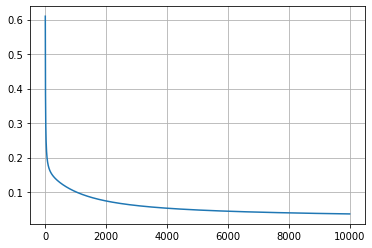

In [20]:
# Plot cost over training iterations
plot.figure()
plot.plot(cost_log)
plot.grid(True)
plot.show()

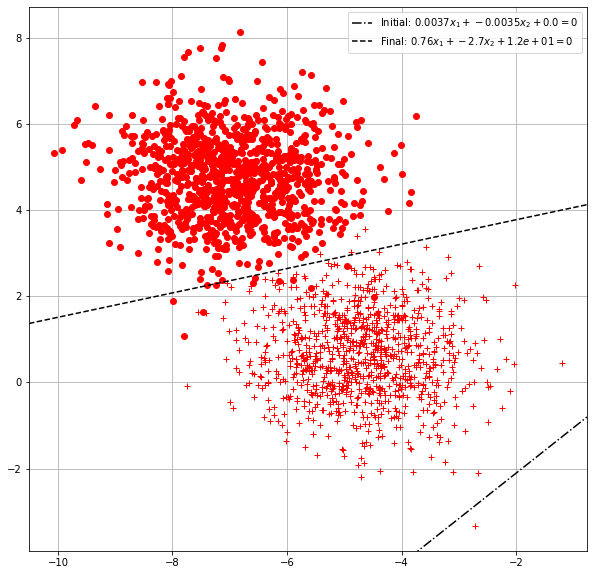

In [21]:
# Plot data and decision boundaries
plot.figure(figsize=(10,10))

vis_data(x, y, c='r')

plt0 = vis_hyperplane(w0, b0, 'k-.')
plt1 = vis_hyperplane(w, b, 'k--')
plot.legend([plt0, plt1], [
        'Initial: ${:.2} x_1 + {:.2} x_2 + {:.2} = 0$'.format(*list(w0)+[b0]),
        'Final: ${:.2} x_1 + {:.2} x_2 + {:.2} = 0$'.format(*list(w)+[b])],
           loc='best')

plot.show()

## Evaluate model with validation data

We'll evaluate the model performance on the validation set. This can inform us how well the model generalizes to unseen data. Validation accuracy can be used to further tune the model, e.g. add more regularization.

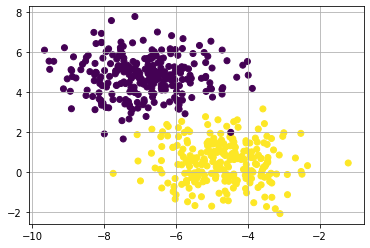

In [22]:
# Plot validation data
plot.figure()
plot.scatter(x_val[:,0], x_val[:,1], c=y_val)
plot.grid(True)
plot.show()

In [23]:
# Function returning labels from the logit
def get_label_from_logit(logits):
    results = [0 if i < 0.5 else 1 for i in logits]    
    return results

train_predictions = get_label_from_logit(logistic_unit(x_train, w, b))
val_predictions = get_label_from_logit(logistic_unit(x_val, w, b))

x is :
[[-3.61780959  1.02640984]
 [-3.46315271  0.00650812]
 [-5.85502359  4.21378564]
 ...
 [-3.85708752  0.08437987]
 [-6.43810862  4.71408156]
 [-4.7073406   1.2586072 ]]
w is : 
[ 0.76428163 -2.6989677 ]
and yet pre_sigmoid is
[ 6.1977425  9.068626  -4.114743  ...  8.557375  -5.9106674  4.738341 ]
finally logit is 
[0.99797004 0.9998847  0.01606775 ... 0.9998079  0.00270305 0.99132276]
x is :
[[-4.48527183e+00  1.29961377e+00]
 [-2.33709747e+00  3.12628964e-01]
 [-4.96984711e+00  1.40943892e+00]
 [-7.45227695e+00  4.49965925e+00]
 [-5.84181526e+00  3.55036210e-01]
 [-8.07673285e+00  6.46470519e+00]
 [-5.01280535e+00  4.14861581e+00]
 [-6.78013781e+00  5.34301639e+00]
 [-6.68152147e+00  3.96994820e+00]
 [-5.42606529e+00  3.70495520e-01]
 [-5.84000316e+00  5.25868447e+00]
 [-5.75733151e+00 -6.91331733e-02]
 [-8.60389072e+00  5.38123394e+00]
 [-8.26493437e+00  4.85224783e+00]
 [-7.94627336e+00  6.01079038e+00]
 [-4.00635431e+00 -1.60049112e-01]
 [-5.09536224e+00  1.53242549e+00]
 [-5

finally logit is 
[9.91816223e-01 9.99888659e-01 9.84181404e-01 2.22214544e-03
 9.98185217e-01 6.87293277e-06 3.57375927e-02 3.82061466e-04
 1.64910126e-02 9.98622417e-01 9.83496662e-04 9.99457777e-01
 8.55299804e-05 4.61861782e-04 2.58517957e-05 9.99888659e-01
 9.75937784e-01 9.98233676e-01 1.24762449e-02 9.86046255e-01
 3.71924136e-03 9.99930024e-01 1.49738989e-04 9.99756753e-01
 9.99873996e-01 1.52937268e-04 3.59179947e-04 2.82321387e-04
 4.53995999e-05 4.51248772e-02 9.97482598e-01 9.99998927e-01
 6.64969593e-06 1.47492573e-01 2.11853459e-02 1.00320566e-03
 9.99004900e-01 1.65474776e-03 9.98147845e-01 1.28095597e-02
 4.09194194e-02 1.93986256e-04 6.73709065e-02 3.81027758e-02
 2.59784004e-03 9.92268503e-01 9.77723658e-01 9.91248846e-01
 9.99724805e-01 9.99937534e-01 1.44813632e-04 9.67881560e-01
 9.93907630e-01 9.99203026e-01 7.19616562e-03 9.86321390e-01
 1.15891953e-03 3.32980650e-03 7.33601395e-03 8.55512568e-04
 9.99006569e-01 9.73027229e-01 9.99941826e-01 3.62922059e-04
 9.986

In [24]:
print('Training accuracy {:2}'.format(numpy.sum(train_predictions == y_train)/len(y_train)))
print('Validation accuracy {:2}'.format(numpy.sum(val_predictions == y_val)/len(y_val)))

Training accuracy 0.9906666874885559
Validation accuracy 0.9940000176429749


# SciKit Learn: training a logistic regression

The goal of this part of the lab is to introduce sckikit learn package. This package should be used in the first homework assignment.

Here we will train an off-the-shelf logistic regression model.

Scikit learn doc: https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html

In [25]:
# Load logistic regression model with desired parameters
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(tol=1e-3, random_state=random_seed)
model.fit(x_train, y_train)

/Users/owenjones/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=12, solver='warn', tol=0.001, verbose=0,
                   warm_start=False)

In [26]:
# Obtain model score on the training data
model.score(x_train, y_train)

0.9873333333333333

In [27]:
# Obtain model score on the validation data 
model.score(x_val, y_val)

0.992